In [1]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [2]:
listeners = []
strings = """[
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.00025 ,11],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.00025 ,21]
]"""

In [3]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.01,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.7,
    risk_tolerance_stdev = 0.2,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.7,
    herding_behavior_stdev = 0.2,
    allowed_restaurant_capacity = 0.25, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 40 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[2435, 9879, 8505, 1322, 5559, 6738, 300, 7017, 636, 4717, 6278, 8275, 5498, 1789, 4867, 2730, 7538, 5783, 3153, 2699]
log initialized
Average similarity between family members is 0.971751456907206 at temperature -1
Average similarity between family and home is 0.999852006633986 at temperature -1
Average similarity between students and their classroom is 0.971307619474209 at temperature -1
Average classroom occupancy is 1.6484848484848484 and number classrooms is 165
Average similarity between workers is 0.9662894144953652 at temperature -1
Average office occupancy is 3.6149732620320854 and number offices is 187
Average friend similarity for adults: 0.8616400880157975 for kids: 0.7444771393627447
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.6506125943183766
avg restaurant similarity 0.6051395418664245
avg restaurant similarity 0.6837198786161235
avg restaurant similarity 0.6905168646643827
avg restaurant similarity 0.7051802224060327
avg restaurant similarity 0.6417980189435191
avg restaurant similarity 0.6928550130560683
avg restaurant similarity 0.7039544739599543
avg restaurant similarity 0.7003255711080859
avg restaurant similarity 0.6595411680894107
avg restaurant similarity 0.6710897397716625
avg restaurant similarity 0.6832547572693658
avg restaurant similarity 0.703352268243666
avg restaurant similarity 0.6585048243566817
avg restaurant similarity 0.6775061425388493
avg restaurant similarity 0.7098185734543839
avg restaurant similarity 0.6605841180650881
avg restaurant similarity 0.7398099155661698
avg restaurant similarity 0.6808547897237843
avg restaurant similarity 0.6595438806112968
avg restaurant similarity 0.7055531320285925
avg restaurant similarity 0.6635014008121043
avg restaur

avg restaurant similarity 0.644904085777022
avg restaurant similarity 0.693284736291674
avg restaurant similarity 0.6711608642759641
avg restaurant similarity 0.6772049965520864
avg restaurant similarity 0.6095806909438959
avg restaurant similarity 0.6646970318329419
avg restaurant similarity 0.6506401149449014
avg restaurant similarity 0.6772657867358349
avg restaurant similarity 0.6137872690420301
avg restaurant similarity 0.6379287812174866
avg restaurant similarity 0.7269785442221424
avg restaurant similarity 0.6433620246200346
avg restaurant similarity 0.6220866716334366
avg restaurant similarity 0.6861831253897208
avg restaurant similarity 0.7216836560900912
avg restaurant similarity 0.6761127666618774
avg restaurant similarity 0.6950484069794935
avg restaurant similarity 0.6333775573193438
avg restaurant similarity 0.7007567547000627
avg restaurant similarity 0.7142316213367628
avg restaurant similarity 0.7036565387249794
avg restaurant similarity 0.6956898996249096
avg restaura

Average friend similarity for adults: 0.8647478714920425 for kids: 0.7431613845078615
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.7656806899558052
avg restaurant similarity 0.6860052115969265
avg restaurant similarity 0.6252520930724736
avg restaurant similarity 0.7229214974456482
avg restaurant similarity 0.7703776299471727
avg restaurant similarity 0.7010325508472713
avg restaurant similarity 0.6926871496281061
avg restaurant similarity 0.7530809688550787
avg restaurant similarity 0.6518931193038884
avg restaurant similarity 0.7138110998462168
avg restaurant similarity 0.7473458902621176
avg restaurant similarity 0.7125721146116598
avg restaurant similarity 0.7241111762679223
avg restaurant similarity 0.8136381176321105
avg restaurant similarity 0.6903475588830675
avg restaurant similarity 0.7460506635351074
avg restaurant similarity 0.7306368020373312
avg restaurant similarity 0.724595391174617
avg restaurant similarity 0.7356081209861018
avg restaurant similarity 0.7328523376075826
avg restaurant similarity 0.7458371440406509
avg restaurant similarity 0.7225971996422945
avg restaur

avg restaurant similarity 0.7301424407758111
avg restaurant similarity 0.7059171090255998
avg restaurant similarity 0.7121676543111607
avg restaurant similarity 0.691481280602462
avg restaurant similarity 0.7172956086217643
avg restaurant similarity 0.7661670415824072
avg restaurant similarity 0.7083500976577638
avg restaurant similarity 0.6868904150395597
avg restaurant similarity 0.726485849054255
avg restaurant similarity 0.7710184373827393
avg restaurant similarity 0.7919273325209633
avg restaurant similarity 0.7354361411984556
avg restaurant similarity 0.7609729830294594
avg restaurant similarity 0.7536492076547286
avg restaurant similarity 0.754603870953048
avg restaurant similarity 0.7153260521616014
avg restaurant similarity 0.7707702900726164
avg restaurant similarity 0.7699745168493489
avg restaurant similarity 0.7847830869587992
avg restaurant similarity 0.7543131111933913
avg restaurant similarity 0.7307527009678547
avg restaurant similarity 0.7527390595324812
avg restauran

Average friend similarity for adults: 0.8594924491880557 for kids: 0.7492152261675312
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.6568251185531827
avg restaurant similarity 0.6360557429816496
avg restaurant similarity 0.6040295086604903
avg restaurant similarity 0.7042180781958491
avg restaurant similarity 0.6743111656235057
avg restaurant similarity 0.6637359694747125
avg restaurant similarity 0.6198444973094099
avg restaurant similarity 0.6167421911097973
avg restaurant similarity 0.6362321476123927
avg restaurant similarity 0.7143517311282427
avg restaurant similarity 0.6295548644328411
avg restaurant similarity 0.632915383915111
avg restaurant similarity 0.6841459602050675
avg restaurant similarity 0.6948969462832769
avg restaurant similarity 0.6347196382556354
avg restaurant similarity 0.6641882696286097
avg restaurant similarity 0.6498638791069464
avg restaurant similarity 0.6479713323114932
avg restaurant similarity 0.6097371156774177
avg restaurant similarity 0.6528712793804575
avg restaurant similarity 0.6647534297399663
avg restaurant similarity 0.6370518097954994
avg restaur

avg restaurant similarity 0.6351482286850175
avg restaurant similarity 0.6190602248416198
avg restaurant similarity 0.7148017021548896
avg restaurant similarity 0.6678034953521778
avg restaurant similarity 0.6375108050293877
avg restaurant similarity 0.6186847609126346
avg restaurant similarity 0.6741173021060681
avg restaurant similarity 0.6768194500199977
avg restaurant similarity 0.7226788719590603
avg restaurant similarity 0.6443386090354425
avg restaurant similarity 0.6688040496173966
avg restaurant similarity 0.6814259308184112
avg restaurant similarity 0.6216658253982625
avg restaurant similarity 0.7049446041342672
avg restaurant similarity 0.616588537055043
avg restaurant similarity 0.6695777824489102
avg restaurant similarity 0.676277772191654
avg restaurant similarity 0.6677511350176495
avg restaurant similarity 0.6863951345587541
avg restaurant similarity 0.6248655286195808
avg restaurant similarity 0.6576181108877092
avg restaurant similarity 0.6345004139826048
avg restaura

Average similarity between workers is 0.9612189154336896 at temperature -1
Average office occupancy is 3.481675392670157 and number offices is 191
Average friend similarity for adults: 0.8656902992391279 for kids: 0.7304964939575308
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 pe

avg restaurant similarity 0.6940961543380362
avg restaurant similarity 0.6703047859173623
avg restaurant similarity 0.6911698894498504
avg restaurant similarity 0.6373308624668897
avg restaurant similarity 0.707100187891542
avg restaurant similarity 0.6318065060032586
avg restaurant similarity 0.653097393764543
avg restaurant similarity 0.6696130740500942
avg restaurant similarity 0.7028160723813555
avg restaurant similarity 0.6989689208484582
avg restaurant similarity 0.6869500601578754
avg restaurant similarity 0.6660121163239517
avg restaurant similarity 0.6861897946681399
avg restaurant similarity 0.6960195479307971
avg restaurant similarity 0.6988496701190108
avg restaurant similarity 0.6604295364912366
avg restaurant similarity 0.669002512762112
avg restaurant similarity 0.771906809548904
avg restaurant similarity 0.6923733547724442
avg restaurant similarity 0.6778370402971777
avg restaurant similarity 0.7071980340691547
avg restaurant similarity 0.654136240465887
avg restaurant 

avg restaurant similarity 0.6818837029590381
avg restaurant similarity 0.6185081877962642
avg restaurant similarity 0.6706399079721562
avg restaurant similarity 0.6706299702612859
avg restaurant similarity 0.6552743981657084
avg restaurant similarity 0.6319174566880585
avg restaurant similarity 0.7172728106944632
avg restaurant similarity 0.6661168214971562
avg restaurant similarity 0.7147065555777634
avg restaurant similarity 0.6674857447354997
avg restaurant similarity 0.6775746178077177
avg restaurant similarity 0.6870864098525528
avg restaurant similarity 0.6628604306698882
avg restaurant similarity 0.6882657021039282
avg restaurant similarity 0.6623230813187135
avg restaurant similarity 0.6489821022461497
avg restaurant similarity 0.6805585352937341
avg restaurant similarity 0.6105596488028964
avg restaurant similarity 0.6845873721671564
avg restaurant similarity 0.6373760618717991
avg restaurant similarity 0.7052161379937394
avg restaurant similarity 0.6189686421319807
avg restau

Average friend similarity for adults: 0.8633750692603325 for kids: 0.748042672341458
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocate

avg restaurant similarity 0.6739160288779331
avg restaurant similarity 0.6756994794091611
avg restaurant similarity 0.7120644274741237
avg restaurant similarity 0.7123668118170892
avg restaurant similarity 0.690281920713591
avg restaurant similarity 0.65901957173066
avg restaurant similarity 0.7169092067435067
avg restaurant similarity 0.6717607962928128
avg restaurant similarity 0.6924496551929625
avg restaurant similarity 0.7006239454989299
avg restaurant similarity 0.6379473422233457
avg restaurant similarity 0.6824647477182368
avg restaurant similarity 0.7182759096331794
avg restaurant similarity 0.6886965524713272
avg restaurant similarity 0.6377439806652241
avg restaurant similarity 0.6526543912823901
avg restaurant similarity 0.7018533995466447
avg restaurant similarity 0.6833983021315998
avg restaurant similarity 0.7290156983252754
avg restaurant similarity 0.7126101750483489
avg restaurant similarity 0.6861767565773936
avg restaurant similarity 0.7055669063276246
avg restauran

avg restaurant similarity 0.6665208599500004
avg restaurant similarity 0.6714090794320742
avg restaurant similarity 0.706177655502874
avg restaurant similarity 0.6854812161572013
avg restaurant similarity 0.6721517212272029
avg restaurant similarity 0.7228952510804056
avg restaurant similarity 0.6518709149636487
avg restaurant similarity 0.663064332685632
avg restaurant similarity 0.6731556907310496
avg restaurant similarity 0.7055825935183537
avg restaurant similarity 0.6946135477150592
avg restaurant similarity 0.7301984259139053
avg restaurant similarity 0.6672214465603792
avg restaurant similarity 0.6765602688133171
avg restaurant similarity 0.6620826683688806
avg restaurant similarity 0.6631491113366824
avg restaurant similarity 0.6586705596169953
avg restaurant similarity 0.6761247979164932
avg restaurant similarity 0.6811509862613198
avg restaurant similarity 0.6777044467800453
avg restaurant similarity 0.6952823816689576
avg restaurant similarity 0.6776190818724214
avg restaura

Average similarity between workers is 0.9580696568009824 at temperature -1
Average office occupancy is 3.5628415300546448 and number offices is 183
Average friend similarity for adults: 0.8564548059178968 for kids: 0.7442294351272316
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.6992850195704993
avg restaurant similarity 0.6232446894238283
avg restaurant similarity 0.6187708451715492
avg restaurant similarity 0.6423054729920862
avg restaurant similarity 0.6667078458520918
avg restaurant similarity 0.656490033820405
avg restaurant similarity 0.6793808605354092
avg restaurant similarity 0.6441637915502249
avg restaurant similarity 0.6311012875354997
avg restaurant similarity 0.6394337773161425
avg restaurant similarity 0.6683028476363111
avg restaurant similarity 0.6418649481131266
avg restaurant similarity 0.7246492034890142
avg restaurant similarity 0.6622441682143082
avg restaurant similarity 0.6341645209949752
avg restaurant similarity 0.6441972849756336
avg restaurant similarity 0.6462468676829685
avg restaurant similarity 0.6492646961248064
avg restaurant similarity 0.6542736005658203
avg restaurant similarity 0.6619829322501654
avg restaurant similarity 0.6302958745558495
avg restaurant similarity 0.6251597370377375
avg restaur

avg restaurant similarity 0.6554046634149351
avg restaurant similarity 0.62813786073016
avg restaurant similarity 0.6119705111542012
avg restaurant similarity 0.6471806738063237
avg restaurant similarity 0.6511436151365173
avg restaurant similarity 0.6090090018009413
avg restaurant similarity 0.6149369028260772
avg restaurant similarity 0.6466305732859242
avg restaurant similarity 0.6426779504479814
avg restaurant similarity 0.6687650030745175
avg restaurant similarity 0.6557180033681236
avg restaurant similarity 0.6230125356334054
avg restaurant similarity 0.654426451511474
avg restaurant similarity 0.5934296061877391
avg restaurant similarity 0.6894142845172766
avg restaurant similarity 0.6029639314900825
avg restaurant similarity 0.6652917753839849
avg restaurant similarity 0.6280831509001432
avg restaurant similarity 0.6743487068071157
avg restaurant similarity 0.6647838212482481
avg restaurant similarity 0.6609992046282875
avg restaurant similarity 0.6600366178235273
avg restauran

Average similarity between workers is 0.9680452772910013 at temperature -1
Average office occupancy is 3.5380434782608696 and number offices is 184
Average friend similarity for adults: 0.8567619860672507 for kids: 0.7292819287259146
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 peo

avg restaurant similarity 0.7242832592822744
avg restaurant similarity 0.7973151337836984
avg restaurant similarity 0.6827706329326284
avg restaurant similarity 0.7241712776153931
avg restaurant similarity 0.756273382219777
avg restaurant similarity 0.7330335993094775
avg restaurant similarity 0.7063959579479434
avg restaurant similarity 0.7611642424398889
avg restaurant similarity 0.7214313034120324
avg restaurant similarity 0.7293832510227968
avg restaurant similarity 0.7373836233576436
avg restaurant similarity 0.7100601398842235
avg restaurant similarity 0.7404663194085791
avg restaurant similarity 0.6460589138002396
avg restaurant similarity 0.6913299936993831
avg restaurant similarity 0.7546157269588774
avg restaurant similarity 0.7575203259952255
avg restaurant similarity 0.7616226254289878
avg restaurant similarity 0.7953127289444538
avg restaurant similarity 0.7970812960936388
avg restaurant similarity 0.7145022157212068
avg restaurant similarity 0.6977512008836452
avg restaur

avg restaurant similarity 0.6804126355261203
avg restaurant similarity 0.7221078642267781
avg restaurant similarity 0.7154069437004992
avg restaurant similarity 0.6931994160844371
avg restaurant similarity 0.7123887920544613
avg restaurant similarity 0.6481132702707353
avg restaurant similarity 0.6884275508052453
avg restaurant similarity 0.729850947005459
avg restaurant similarity 0.6973851554645335
avg restaurant similarity 0.7546546121035386
avg restaurant similarity 0.6837352057514049
avg restaurant similarity 0.7513998900724174
avg restaurant similarity 0.6236807422225857
avg restaurant similarity 0.7223931606040462
avg restaurant similarity 0.7194814724225362
avg restaurant similarity 0.6850739654637441
avg restaurant similarity 0.7083596025940386
avg restaurant similarity 0.7136496841484357
avg restaurant similarity 0.7127956577218417
avg restaurant similarity 0.660001542491433
avg restaurant similarity 0.7100128571300357
avg restaurant similarity 0.7438786700300747
avg restaura

Average friend similarity for adults: 0.8615026146437965 for kids: 0.7328783835688844
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.6465624085878524
avg restaurant similarity 0.683816666209405
avg restaurant similarity 0.6625194583829211
avg restaurant similarity 0.6180569147424708
avg restaurant similarity 0.6473855023870237
avg restaurant similarity 0.6225375858080001
avg restaurant similarity 0.6784274855983495
avg restaurant similarity 0.6596122026036546
avg restaurant similarity 0.6392425079163441
avg restaurant similarity 0.6236208188487293
avg restaurant similarity 0.6756416868305722
avg restaurant similarity 0.7054073191624692
avg restaurant similarity 0.6789461664811254
avg restaurant similarity 0.672830989144473
avg restaurant similarity 0.7402151161506573
avg restaurant similarity 0.7242841224772749
avg restaurant similarity 0.6797279914064711
avg restaurant similarity 0.6590314805295883
avg restaurant similarity 0.6820311496878805
avg restaurant similarity 0.7133763194179934
avg restaurant similarity 0.6259671354097396
avg restaurant similarity 0.6686426668099635
avg restaura

avg restaurant similarity 0.6208816764701585
avg restaurant similarity 0.6548191050243629
avg restaurant similarity 0.6366705789793682
avg restaurant similarity 0.6390035513760736
avg restaurant similarity 0.5782818731460158
avg restaurant similarity 0.6289855952941397
avg restaurant similarity 0.6722561258419556
avg restaurant similarity 0.6291962725269952
avg restaurant similarity 0.614228625130395
avg restaurant similarity 0.6781613260367743
avg restaurant similarity 0.6202650864373497
avg restaurant similarity 0.6380778241690225
avg restaurant similarity 0.6101586264729858
avg restaurant similarity 0.618235989950275
avg restaurant similarity 0.6000159343623502
avg restaurant similarity 0.5917002397800585
avg restaurant similarity 0.6311963869355995
avg restaurant similarity 0.669984175490375
avg restaurant similarity 0.660650554693291
avg restaurant similarity 0.6367358140610646
avg restaurant similarity 0.6988008362992593
avg restaurant similarity 0.6286159696012112
avg restaurant

Average similarity between workers is 0.9586955110246119 at temperature -1
Average office occupancy is 3.405263157894737 and number offices is 190
Average friend similarity for adults: 0.8555808060466423 for kids: 0.7421923559656547
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.6862772485435952
avg restaurant similarity 0.6909205742091123
avg restaurant similarity 0.6244744201513291
avg restaurant similarity 0.679824975993754
avg restaurant similarity 0.6588690392263092
avg restaurant similarity 0.6617980938667561
avg restaurant similarity 0.6813682880783661
avg restaurant similarity 0.7130522089871776
avg restaurant similarity 0.7325777296773496
avg restaurant similarity 0.6810081618625313
avg restaurant similarity 0.6759062387612891
avg restaurant similarity 0.6415231005865251
avg restaurant similarity 0.711920514204089
avg restaurant similarity 0.6675637314293756
avg restaurant similarity 0.6439673962084632
avg restaurant similarity 0.6763629454637714
avg restaurant similarity 0.6507938349511107
avg restaurant similarity 0.6475680420045347
avg restaurant similarity 0.6817468848432627
avg restaurant similarity 0.6803145507268027
avg restaurant similarity 0.7349323240216608
avg restaurant similarity 0.6519051141178156
avg restaura

avg restaurant similarity 0.6520683253061289
avg restaurant similarity 0.6754326577656447
avg restaurant similarity 0.6828881418421908
avg restaurant similarity 0.655058492924416
avg restaurant similarity 0.644441743235751
avg restaurant similarity 0.662329260987659
avg restaurant similarity 0.6524113352113832
avg restaurant similarity 0.649031298740897
avg restaurant similarity 0.6461695068513406
avg restaurant similarity 0.6682816550875718
avg restaurant similarity 0.6782136173809984
avg restaurant similarity 0.6668602287082863
avg restaurant similarity 0.6678360393940468
avg restaurant similarity 0.683937664382542
avg restaurant similarity 0.6945317230837581
avg restaurant similarity 0.6724894915962233
avg restaurant similarity 0.718432953330709
avg restaurant similarity 0.6592278357369902
avg restaurant similarity 0.6269747232094126
avg restaurant similarity 0.6415319148576397
avg restaurant similarity 0.6336407347717348
avg restaurant similarity 0.6407531244512905
avg restaurant s

Average similarity between workers is 0.9635873786507413 at temperature -1
Average office occupancy is 3.5081081081081082 and number offices is 185
Average friend similarity for adults: 0.863009167778218 for kids: 0.7615979370147926
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 pe

avg restaurant similarity 0.6657318081410498
avg restaurant similarity 0.671884767652486
avg restaurant similarity 0.7047867155567161
avg restaurant similarity 0.7284220206695072
avg restaurant similarity 0.6725067234200118
avg restaurant similarity 0.678057195007245
avg restaurant similarity 0.6619985724919292
avg restaurant similarity 0.6770383087983948
avg restaurant similarity 0.6723167527497447
avg restaurant similarity 0.654363982355694
avg restaurant similarity 0.7058513516678194
avg restaurant similarity 0.7052084050217853
avg restaurant similarity 0.710070330754669
avg restaurant similarity 0.7031459841372935
avg restaurant similarity 0.6958778848738019
avg restaurant similarity 0.6477961431747842
avg restaurant similarity 0.696445384374168
avg restaurant similarity 0.7240261181774553
avg restaurant similarity 0.6910159410720129
avg restaurant similarity 0.6872644783120313
avg restaurant similarity 0.6309936187240028
avg restaurant similarity 0.7081269196594823
avg restaurant 

avg restaurant similarity 0.6299101454209395
avg restaurant similarity 0.6434673654859925
avg restaurant similarity 0.705438772453135
avg restaurant similarity 0.6332929906339233
avg restaurant similarity 0.6482384101831427
avg restaurant similarity 0.6714225378224905
avg restaurant similarity 0.6738868997380959
avg restaurant similarity 0.6772164041763982
avg restaurant similarity 0.667318528119811
avg restaurant similarity 0.6751396769100275
avg restaurant similarity 0.6453861838067843
avg restaurant similarity 0.6309176464707792
avg restaurant similarity 0.6944976244356625
avg restaurant similarity 0.6205107949993726
avg restaurant similarity 0.6906224508244413
avg restaurant similarity 0.6939526559948781
avg restaurant similarity 0.6951315049095866
avg restaurant similarity 0.6120639715748835
avg restaurant similarity 0.6644270054687995
avg restaurant similarity 0.6667963432883041
avg restaurant similarity 0.6427534114931042
avg restaurant similarity 0.6417747333419607
avg restaura

Average similarity between workers is 0.9649767103421152 at temperature -1
Average office occupancy is 3.67027027027027 and number offices is 185
Average friend similarity for adults: 0.858119526778468 for kids: 0.7114805270406804
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people

avg restaurant similarity 0.5969516048197389
avg restaurant similarity 0.6552537838428226
avg restaurant similarity 0.6575127042211935
avg restaurant similarity 0.6309567957839926
avg restaurant similarity 0.6227486629580986
avg restaurant similarity 0.6627038549737656
avg restaurant similarity 0.6137728659363038
avg restaurant similarity 0.6328733957045951
avg restaurant similarity 0.6124772537158751
avg restaurant similarity 0.6817285166263426
avg restaurant similarity 0.6754484886293725
avg restaurant similarity 0.6609938123636429
avg restaurant similarity 0.6626182835488739
avg restaurant similarity 0.5930753049634557
avg restaurant similarity 0.6774841507554977
avg restaurant similarity 0.6450894646130784
avg restaurant similarity 0.6733375804661438
avg restaurant similarity 0.6381781294988087
avg restaurant similarity 0.622425531973963
avg restaurant similarity 0.6716943858466442
avg restaurant similarity 0.6917926170733361
avg restaurant similarity 0.6618298205592703
avg restaur

avg restaurant similarity 0.6806378762207359
avg restaurant similarity 0.6708023135443185
avg restaurant similarity 0.6757635400276388
avg restaurant similarity 0.6393052590795636
avg restaurant similarity 0.7077490511966079
avg restaurant similarity 0.7127800403880105
avg restaurant similarity 0.625674362217734
avg restaurant similarity 0.6558465577817462
avg restaurant similarity 0.6578611488091843
avg restaurant similarity 0.6880754635448109
avg restaurant similarity 0.6866668966544177
avg restaurant similarity 0.6597691575658314
avg restaurant similarity 0.6381698743887531
avg restaurant similarity 0.6790834856085393
avg restaurant similarity 0.651080573955245
avg restaurant similarity 0.7494898230761757
avg restaurant similarity 0.6739380475115139
avg restaurant similarity 0.6440019694078905
avg restaurant similarity 0.6678489376367461
avg restaurant similarity 0.6497528370656375
avg restaurant similarity 0.6779209326267779
avg restaurant similarity 0.6606211718290983
avg restaura

Average similarity between workers is 0.9623901175627431 at temperature -1
Average office occupancy is 3.5193370165745854 and number offices is 181
Average friend similarity for adults: 0.8486529738951236 for kids: 0.743969130362358
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 pe

avg restaurant similarity 0.6585484643461899
avg restaurant similarity 0.6638363257488157
avg restaurant similarity 0.6856745040941036
avg restaurant similarity 0.6647123322492907
avg restaurant similarity 0.6306342215418852
avg restaurant similarity 0.6987365566630063
avg restaurant similarity 0.6338028301825839
avg restaurant similarity 0.6581672940771899
avg restaurant similarity 0.6561522706552685
avg restaurant similarity 0.6613812578396476
avg restaurant similarity 0.6696927452247301
avg restaurant similarity 0.6221798807717863
avg restaurant similarity 0.6311427360016757
avg restaurant similarity 0.6555467797514146
avg restaurant similarity 0.6862522302074688
avg restaurant similarity 0.6936690154343438
avg restaurant similarity 0.6679927575675811
avg restaurant similarity 0.6388328557324543
avg restaurant similarity 0.6452932534270897
avg restaurant similarity 0.6713732783724784
avg restaurant similarity 0.6409758229771761
avg restaurant similarity 0.6392745315927955
avg restau

avg restaurant similarity 0.6313547762511191
avg restaurant similarity 0.6468272740281282
avg restaurant similarity 0.6351992351160123
avg restaurant similarity 0.6658481679766087
avg restaurant similarity 0.6538662701604172
avg restaurant similarity 0.6602802042321583
avg restaurant similarity 0.6715866155071553
avg restaurant similarity 0.661167792374861
avg restaurant similarity 0.6402757278211281
avg restaurant similarity 0.6683731603860898
avg restaurant similarity 0.6647500328671311
avg restaurant similarity 0.6487719287300371
avg restaurant similarity 0.6500294823325148
avg restaurant similarity 0.6326713018430498
avg restaurant similarity 0.6549248052469108
avg restaurant similarity 0.6286875778600197
avg restaurant similarity 0.6944160681154091
avg restaurant similarity 0.6717606479811996
avg restaurant similarity 0.630793599183636
avg restaurant similarity 0.7071303506633644
avg restaurant similarity 0.646010742302648
avg restaurant similarity 0.6573313124262116
avg restauran

Average similarity between workers is 0.9600968684752208 at temperature -1
Average office occupancy is 3.5164835164835164 and number offices is 182
Average friend similarity for adults: 0.8469617035026799 for kids: 0.7378692034497062
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.6433712440545362
avg restaurant similarity 0.7033456846077949
avg restaurant similarity 0.6314081673343692
avg restaurant similarity 0.6217335684426714
avg restaurant similarity 0.6063952910312308
avg restaurant similarity 0.7035541194530497
avg restaurant similarity 0.6809602276580872
avg restaurant similarity 0.6207178162643651
avg restaurant similarity 0.6069728572527446
avg restaurant similarity 0.6670064467772924
avg restaurant similarity 0.6471316532544182
avg restaurant similarity 0.6332741726727028
avg restaurant similarity 0.6184987448644494
avg restaurant similarity 0.70213804277764
avg restaurant similarity 0.66126716080056
avg restaurant similarity 0.6490338656536122
avg restaurant similarity 0.6679865303553975
avg restaurant similarity 0.699536651848014
avg restaurant similarity 0.6713054570963459
avg restaurant similarity 0.6039618178399176
avg restaurant similarity 0.6449189647548512
avg restaurant similarity 0.6531406645540669
avg restaurant 

avg restaurant similarity 0.6164776425123385
avg restaurant similarity 0.6697996801967512
avg restaurant similarity 0.6183190710095597
avg restaurant similarity 0.5993288869434846
avg restaurant similarity 0.6237284291722269
avg restaurant similarity 0.6614602884431994
avg restaurant similarity 0.6274771237212846
avg restaurant similarity 0.634997965883003
avg restaurant similarity 0.5932740700292842
avg restaurant similarity 0.6766888231777118
avg restaurant similarity 0.6424165687558007
avg restaurant similarity 0.6958416617642725
avg restaurant similarity 0.6655364410236363
avg restaurant similarity 0.6566688728627238
avg restaurant similarity 0.6349660315650163
avg restaurant similarity 0.626964908256758
avg restaurant similarity 0.5805204682802984
avg restaurant similarity 0.6071862294779393
avg restaurant similarity 0.5790748652009596
avg restaurant similarity 0.6483363110207493
avg restaurant similarity 0.6079377145045428
avg restaurant similarity 0.664907159977313
avg restauran

Average similarity between workers is 0.9691565955947736 at temperature -1
Average office occupancy is 3.6906077348066297 and number offices is 181
Average friend similarity for adults: 0.8597422538872419 for kids: 0.7361743533640004
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.6547657458891479
avg restaurant similarity 0.6457383954712542
avg restaurant similarity 0.6462241353492713
avg restaurant similarity 0.663932162945157
avg restaurant similarity 0.6723547772012455
avg restaurant similarity 0.6346466690491639
avg restaurant similarity 0.6237487907284535
avg restaurant similarity 0.7182653446389867
avg restaurant similarity 0.6680452221574079
avg restaurant similarity 0.6722622582967048
avg restaurant similarity 0.6290445938700295
avg restaurant similarity 0.6225198205646256
avg restaurant similarity 0.6743659165539218
avg restaurant similarity 0.5591706556146036
avg restaurant similarity 0.6327109232914749
avg restaurant similarity 0.6461280910595993
avg restaurant similarity 0.617338050587845
avg restaurant similarity 0.6446135598659607
avg restaurant similarity 0.6448222677107183
avg restaurant similarity 0.6109704894010655
avg restaurant similarity 0.6497318814337085
avg restaurant similarity 0.6644298602024771
avg restaura

avg restaurant similarity 0.643395162159565
avg restaurant similarity 0.6396209593565889
avg restaurant similarity 0.7001175497759784
avg restaurant similarity 0.717570093355412
avg restaurant similarity 0.7018599294653023
avg restaurant similarity 0.6618411002371204
avg restaurant similarity 0.7024886047869652
avg restaurant similarity 0.7190662003575462
avg restaurant similarity 0.6407926253740647
avg restaurant similarity 0.7113043560921758
avg restaurant similarity 0.6116870870782581
avg restaurant similarity 0.5764471039949438
avg restaurant similarity 0.7134828747161026
avg restaurant similarity 0.6152381555104438
avg restaurant similarity 0.6553553653025174
avg restaurant similarity 0.6619917969528608
avg restaurant similarity 0.6534789027206859
avg restaurant similarity 0.6937390380157331
avg restaurant similarity 0.6220073511088335
avg restaurant similarity 0.6514067212862958
avg restaurant similarity 0.6473386891641392
avg restaurant similarity 0.6629202093239087
avg restaura

Average similarity between workers is 0.958594708509796 at temperature -1
Average office occupancy is 3.502702702702703 and number offices is 185
Average friend similarity for adults: 0.8565564233222239 for kids: 0.7303155620212362
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 peo

avg restaurant similarity 0.7026777187729937
avg restaurant similarity 0.6592109309661477
avg restaurant similarity 0.6783113121455926
avg restaurant similarity 0.6790073459697464
avg restaurant similarity 0.6470217110607247
avg restaurant similarity 0.6857887805279063
avg restaurant similarity 0.7054393292731088
avg restaurant similarity 0.6378366462037226
avg restaurant similarity 0.6819169342704324
avg restaurant similarity 0.6374624780293127
avg restaurant similarity 0.6160247778989205
avg restaurant similarity 0.6975200923470988
avg restaurant similarity 0.638619238564767
avg restaurant similarity 0.6326584928969267
avg restaurant similarity 0.706115127636663
avg restaurant similarity 0.616475722165133
avg restaurant similarity 0.6611848668648843
avg restaurant similarity 0.6986206206357913
avg restaurant similarity 0.7269250699559456
avg restaurant similarity 0.6385055627017991
avg restaurant similarity 0.6468618857937969
avg restaurant similarity 0.7070062783846883
avg restauran

avg restaurant similarity 0.6972387292016758
avg restaurant similarity 0.6449464496711734
avg restaurant similarity 0.7125020919445774
avg restaurant similarity 0.6589027641612394
avg restaurant similarity 0.6285616785620296
avg restaurant similarity 0.6614845298157098
avg restaurant similarity 0.6797902421233044
avg restaurant similarity 0.6391321149243313
avg restaurant similarity 0.6861724794122274
avg restaurant similarity 0.6699691310957114
avg restaurant similarity 0.6762359914279041
avg restaurant similarity 0.6384108483206477
avg restaurant similarity 0.6602681954354597
avg restaurant similarity 0.6472587705477101
avg restaurant similarity 0.6587386018365685
avg restaurant similarity 0.7007104023428471
avg restaurant similarity 0.6812669027712938
avg restaurant similarity 0.7126287379177023
avg restaurant similarity 0.6485441536464154
avg restaurant similarity 0.6537990106558943
avg restaurant similarity 0.6686193770687541
avg restaurant similarity 0.6785453945791224
avg restau

Average similarity between workers is 0.9717311143661377 at temperature -1
Average office occupancy is 3.424083769633508 and number offices is 191
Average friend similarity for adults: 0.854511468030855 for kids: 0.7262507786987498
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people 

avg restaurant similarity 0.6827246447029841
avg restaurant similarity 0.6575447300423848
avg restaurant similarity 0.6794030867291759
avg restaurant similarity 0.6453545443323423
avg restaurant similarity 0.6716377936058747
avg restaurant similarity 0.6245945164722615
avg restaurant similarity 0.6513452446714423
avg restaurant similarity 0.6097414067294112
avg restaurant similarity 0.6921786750903716
avg restaurant similarity 0.659427820571422
avg restaurant similarity 0.670197706200956
avg restaurant similarity 0.6448179984419901
avg restaurant similarity 0.6675897732249286
avg restaurant similarity 0.6417488532585537
avg restaurant similarity 0.6899811543299282
avg restaurant similarity 0.6806166728086969
avg restaurant similarity 0.6595533748817806
avg restaurant similarity 0.63999577288714
avg restaurant similarity 0.6555609987471596
avg restaurant similarity 0.6648996992482897
avg restaurant similarity 0.6766019470782471
avg restaurant similarity 0.6498967120341747
avg restaurant

avg restaurant similarity 0.6237603228853889
avg restaurant similarity 0.6659912985404094
avg restaurant similarity 0.691221326641034
avg restaurant similarity 0.6932171007708154
avg restaurant similarity 0.6946753392691517
avg restaurant similarity 0.6485085937976506
avg restaurant similarity 0.6739112138490365
avg restaurant similarity 0.6405288981826903
avg restaurant similarity 0.64192427017724
avg restaurant similarity 0.6782625095058953
avg restaurant similarity 0.6509930461902461
avg restaurant similarity 0.6276470520936611
avg restaurant similarity 0.648771607822471
avg restaurant similarity 0.663957440877165
avg restaurant similarity 0.666434439894585
avg restaurant similarity 0.6921198929734609
avg restaurant similarity 0.6654554440542484
avg restaurant similarity 0.6794101900861993
avg restaurant similarity 0.7050487112691185
avg restaurant similarity 0.6632571514488106
avg restaurant similarity 0.6727766010591375
avg restaurant similarity 0.6472997116989879
avg restaurant s

Average similarity between workers is 0.9709818320410668 at temperature -1
Average office occupancy is 3.60989010989011 and number offices is 182
Average friend similarity for adults: 0.8587617525475171 for kids: 0.7290933446888702
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 p

avg restaurant similarity 0.6324118485338232
avg restaurant similarity 0.650947972974748
avg restaurant similarity 0.7022156698791449
avg restaurant similarity 0.6981542981501091
avg restaurant similarity 0.6595106471733116
avg restaurant similarity 0.6428465717244239
avg restaurant similarity 0.6678971743612946
avg restaurant similarity 0.6788297959979874
avg restaurant similarity 0.673702901934146
avg restaurant similarity 0.6628162591421864
avg restaurant similarity 0.630165470113046
avg restaurant similarity 0.6380259489181219
avg restaurant similarity 0.6360921386717153
avg restaurant similarity 0.6336226094833391
avg restaurant similarity 0.6885707480833982
avg restaurant similarity 0.6526999151928333
avg restaurant similarity 0.6469386196452229
avg restaurant similarity 0.6511207042714687
avg restaurant similarity 0.6587756570139156
avg restaurant similarity 0.6992891018351404
avg restaurant similarity 0.670196393050441
avg restaurant similarity 0.6423368140495617
avg restaurant

avg restaurant similarity 0.6588406255244579
avg restaurant similarity 0.6960976579041711
avg restaurant similarity 0.679086387928017
avg restaurant similarity 0.6742994141347336
avg restaurant similarity 0.6670257527756703
avg restaurant similarity 0.6653887615632651
avg restaurant similarity 0.6750621314144349
avg restaurant similarity 0.6499447278140973
avg restaurant similarity 0.657083019984389
avg restaurant similarity 0.6607597290874175
avg restaurant similarity 0.6195724112606259
avg restaurant similarity 0.6853759115350868
avg restaurant similarity 0.60227676481651
avg restaurant similarity 0.6419589676795331
avg restaurant similarity 0.6722753200037868
avg restaurant similarity 0.6460710378414752
avg restaurant similarity 0.6893191622374787
avg restaurant similarity 0.6747491974252896
avg restaurant similarity 0.6572973999791093
avg restaurant similarity 0.6609957873498291
avg restaurant similarity 0.6521498358800804
avg restaurant similarity 0.6910688729739877
avg restaurant

Average similarity between workers is 0.9726125769554511 at temperature -1
Average office occupancy is 3.4479166666666665 and number offices is 192
Average friend similarity for adults: 0.8676342991656149 for kids: 0.7311294484043608
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peo

avg restaurant similarity 0.7096154156806601
avg restaurant similarity 0.6647671405111936
avg restaurant similarity 0.6826477887490614
avg restaurant similarity 0.6805250905264363
avg restaurant similarity 0.7034552156368601
avg restaurant similarity 0.6752374805316156
avg restaurant similarity 0.6616013854041871
avg restaurant similarity 0.6902885543123521
avg restaurant similarity 0.7540345563937365
avg restaurant similarity 0.7260717302238762
avg restaurant similarity 0.7060882199641805
avg restaurant similarity 0.6594644090635621
avg restaurant similarity 0.704093840674495
avg restaurant similarity 0.6819331331783905
avg restaurant similarity 0.7140323252571049
avg restaurant similarity 0.7227727649747411
avg restaurant similarity 0.7135370810722977
avg restaurant similarity 0.715934808442926
avg restaurant similarity 0.7136390583168997
avg restaurant similarity 0.7351303279285116
avg restaurant similarity 0.735717572101196
avg restaurant similarity 0.6769930313155298
avg restauran

avg restaurant similarity 0.6580219490257098
avg restaurant similarity 0.701807909425979
avg restaurant similarity 0.6733761525869799
avg restaurant similarity 0.7124558029365631
avg restaurant similarity 0.7295508215570552
avg restaurant similarity 0.6630481973851806
avg restaurant similarity 0.7094766527827077
avg restaurant similarity 0.7252788095776004
avg restaurant similarity 0.6609236582500174
avg restaurant similarity 0.7211204197875742
avg restaurant similarity 0.6802184742839188
avg restaurant similarity 0.7297367638358023
avg restaurant similarity 0.7129289592739252
avg restaurant similarity 0.7252652822717748
avg restaurant similarity 0.7010449443606735
avg restaurant similarity 0.6920770168672921
avg restaurant similarity 0.67923911964789
avg restaurant similarity 0.694684379283779
avg restaurant similarity 0.67613607107559
avg restaurant similarity 0.69648940958846
avg restaurant similarity 0.6963403242553611
avg restaurant similarity 0.7269998678827373
avg restaurant sim

Average similarity between workers is 0.9579109806197312 at temperature -1
Average office occupancy is 3.4148936170212765 and number offices is 188
Average friend similarity for adults: 0.8539485467727252 for kids: 0.7519010384742434
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 peo

avg restaurant similarity 0.6106117646589629
avg restaurant similarity 0.6618889909949611
avg restaurant similarity 0.7365304745941431
avg restaurant similarity 0.730618861020549
avg restaurant similarity 0.6597855161622375
avg restaurant similarity 0.6503979944865027
avg restaurant similarity 0.6834930724253447
avg restaurant similarity 0.6527882249338569
avg restaurant similarity 0.6732090742710115
avg restaurant similarity 0.6963369153720966
avg restaurant similarity 0.7020474348073494
avg restaurant similarity 0.6919585296902604
avg restaurant similarity 0.6870491968326462
avg restaurant similarity 0.677904928780522
avg restaurant similarity 0.6560527199425905
avg restaurant similarity 0.6245349837643137
avg restaurant similarity 0.6649568778398743
avg restaurant similarity 0.6893967437082703
avg restaurant similarity 0.6887943751963785
avg restaurant similarity 0.6696102884734082
avg restaurant similarity 0.6788979509225573
avg restaurant similarity 0.6807127139309134
avg restaura

avg restaurant similarity 0.6631688623964593
avg restaurant similarity 0.6723006656359904
avg restaurant similarity 0.7098714168411309
avg restaurant similarity 0.6764166558004179
avg restaurant similarity 0.6496245576362438
avg restaurant similarity 0.6488353449775852
avg restaurant similarity 0.6659521550823468
avg restaurant similarity 0.6789228802760682
avg restaurant similarity 0.6653244389736636
avg restaurant similarity 0.634220978130547
avg restaurant similarity 0.6797155915855146
avg restaurant similarity 0.677064422940789
avg restaurant similarity 0.6723137386476321
avg restaurant similarity 0.696953825737699
avg restaurant similarity 0.6839795007386419
avg restaurant similarity 0.692958933889623
avg restaurant similarity 0.6493798732529515
avg restaurant similarity 0.7269568683713235
avg restaurant similarity 0.6878809580989724
avg restaurant similarity 0.7045557157508314
avg restaurant similarity 0.6770710772172344
avg restaurant similarity 0.7090852312821875
avg restaurant

Average similarity between workers is 0.9696013377751297 at temperature -1
Average office occupancy is 3.6810810810810812 and number offices is 185
Average friend similarity for adults: 0.8648568519586213 for kids: 0.737144290867358
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 pe

avg restaurant similarity 0.653447276501992
avg restaurant similarity 0.7158560129751402
avg restaurant similarity 0.7232246074606055
avg restaurant similarity 0.7313057375878391
avg restaurant similarity 0.6565470579596452
avg restaurant similarity 0.6367162827831404
avg restaurant similarity 0.7043173233373122
avg restaurant similarity 0.6558065398256543
avg restaurant similarity 0.6696853099066317
avg restaurant similarity 0.6768255650515076
avg restaurant similarity 0.679078149577941
avg restaurant similarity 0.6911588204758858
avg restaurant similarity 0.6932233955199087
avg restaurant similarity 0.6157680515878382
avg restaurant similarity 0.654648448440561
avg restaurant similarity 0.6427548208323751
avg restaurant similarity 0.6613675162887797
avg restaurant similarity 0.6886029094481699
avg restaurant similarity 0.6694688393082533
avg restaurant similarity 0.659128066771757
avg restaurant similarity 0.6456878611116115
avg restaurant similarity 0.6941651822006909
avg restaurant

avg restaurant similarity 0.6782875953037993
avg restaurant similarity 0.683125413935646
avg restaurant similarity 0.7056427672169181
avg restaurant similarity 0.6680919870324539
avg restaurant similarity 0.7034990026625162
avg restaurant similarity 0.6811913863941181
avg restaurant similarity 0.6619195391004922
avg restaurant similarity 0.7084958723444931
avg restaurant similarity 0.6678654779546788
avg restaurant similarity 0.6805554492157604
avg restaurant similarity 0.7370443514277173
avg restaurant similarity 0.7148841814959144
avg restaurant similarity 0.5901729432846889
avg restaurant similarity 0.670215370891596
avg restaurant similarity 0.6769869233874469
avg restaurant similarity 0.6247990203682072
avg restaurant similarity 0.662082869365509
avg restaurant similarity 0.6875890293642637
avg restaurant similarity 0.609294655484236
avg restaurant similarity 0.6572678739802974
avg restaurant similarity 0.6208919566582529
avg restaurant similarity 0.6409905912495407
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

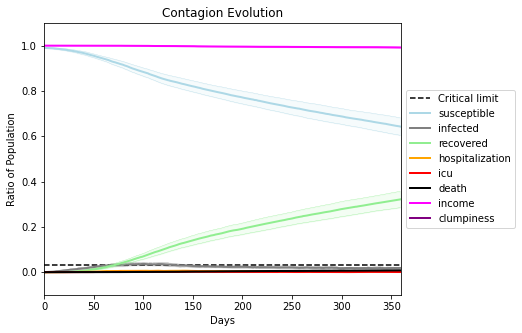

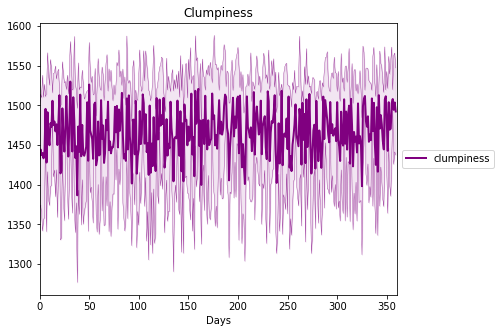

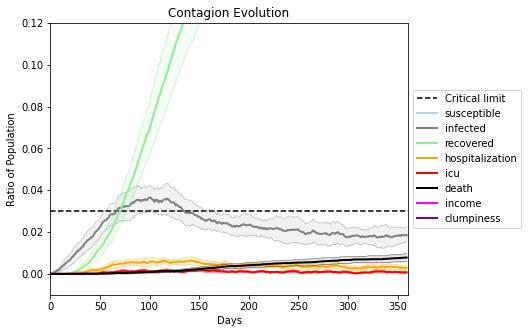

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8358, 2930, 152, 8611, 3455, 9396, 4708, 9105, 1194, 2835, 807, 9507, 4509, 470, 8284, 5719, 2684, 5141, 5660, 7308]
Average similarity between family members is 0.9676851460271783 at temperature -0.999
Average similarity between family and home is 0.9998553939827383 at temperature -1
Average similarity between students and their classroom is 0.9671290472174453 at temperature -0.999
Average classroom occupancy is 1.6703296703296704 and number classrooms is 182
Average similarity between workers is 0.974730121680199 at temperature -0.999
Average office occupancy is 3.468421052631579 and number offices is 190
Average friend similarity for adults: 0.8653782556264206 for kids: 0.7465956778222866
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.6075543317782107
avg restaurant similarity 0.6796043610325343
avg restaurant similarity 0.6461093999949189
avg restaurant similarity 0.666954252184511
avg restaurant similarity 0.7013395019914307
avg restaurant similarity 0.683684547434576
avg restaurant similarity 0.6302649616502928
avg restaurant similarity 0.7054357237822786
avg restaurant similarity 0.6880412716817256
avg restaurant similarity 0.705144748501599
avg restaurant similarity 0.6715423760900238
avg restaurant similarity 0.6188101666621172
avg restaurant similarity 0.6657219017620298
avg restaurant similarity 0.7511745784656543
avg restaurant similarity 0.6806787263096674
avg restaurant similarity 0.668175038977782
avg restaurant similarity 0.6612800095787866
avg restaurant similarity 0.6949760320149796
avg restaurant similarity 0.7122643119783145
avg restaurant similarity 0.6248251012116891
avg restaurant similarity 0.6125259062757392
avg restaurant similarity 0.6197097975026644
avg restaurant

avg restaurant similarity 0.6450055952538808
avg restaurant similarity 0.6680336333184901
avg restaurant similarity 0.6127719998935395
avg restaurant similarity 0.6442008841406692
avg restaurant similarity 0.6818564776056478
avg restaurant similarity 0.6929393748626294
avg restaurant similarity 0.6899810209552649
avg restaurant similarity 0.6894850387435592
avg restaurant similarity 0.5805551857770207
avg restaurant similarity 0.6947647641946773
avg restaurant similarity 0.6300449609642774
avg restaurant similarity 0.6674687544730652
avg restaurant similarity 0.584841928690375
avg restaurant similarity 0.6671072414668126
avg restaurant similarity 0.7001084617341339
avg restaurant similarity 0.7199149767962623
avg restaurant similarity 0.6282913220933378
avg restaurant similarity 0.6978623692947256
avg restaurant similarity 0.6951358854476406
avg restaurant similarity 0.6613270290332108
avg restaurant similarity 0.6699877246759132
avg restaurant similarity 0.6371577608825434
avg restaur

Average similarity between workers is 0.9671082758125623 at temperature -0.999
Average office occupancy is 3.4623655913978495 and number offices is 186
Average friend similarity for adults: 0.8477937466422596 for kids: 0.7286520276839612
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.5687519529944921
avg restaurant similarity 0.6412950577218267
avg restaurant similarity 0.6774345755664469
avg restaurant similarity 0.6153256595211436
avg restaurant similarity 0.6175194134218706
avg restaurant similarity 0.6708217560510863
avg restaurant similarity 0.6588195163802701
avg restaurant similarity 0.6482929127217741
avg restaurant similarity 0.661915640126893
avg restaurant similarity 0.642629142297571
avg restaurant similarity 0.6209920411440591
avg restaurant similarity 0.6879619944340837
avg restaurant similarity 0.6156267857550719
avg restaurant similarity 0.6152580294585155
avg restaurant similarity 0.6158044925510121
avg restaurant similarity 0.6404176794367865
avg restaurant similarity 0.6065716275148247
avg restaurant similarity 0.6435629640455036
avg restaurant similarity 0.6903362637859142
avg restaurant similarity 0.6045308416133791
avg restaurant similarity 0.6786801606403413
avg restaurant similarity 0.7113683894838726
avg restaura

avg restaurant similarity 0.6456770302804891
avg restaurant similarity 0.6590588840077206
avg restaurant similarity 0.6367619935885875
avg restaurant similarity 0.6145371715462734
avg restaurant similarity 0.5773196257217494
avg restaurant similarity 0.7088182468902549
avg restaurant similarity 0.6828514947334594
avg restaurant similarity 0.6047922337803062
avg restaurant similarity 0.6569470019178008
avg restaurant similarity 0.619565390783284
avg restaurant similarity 0.6104644078278487
avg restaurant similarity 0.678014075257346
avg restaurant similarity 0.6079742749000652
avg restaurant similarity 0.5958137001301841
avg restaurant similarity 0.6908722004531523
avg restaurant similarity 0.6899283747929273
avg restaurant similarity 0.6489567511242481
avg restaurant similarity 0.6361871904695733
avg restaurant similarity 0.6142056730454227
avg restaurant similarity 0.6191927962675641
avg restaurant similarity 0.6406807565661851
avg restaurant similarity 0.6817749190965092
avg restaura

Average similarity between workers is 0.9697829938600089 at temperature -0.999
Average office occupancy is 3.5483870967741935 and number offices is 186
Average friend similarity for adults: 0.856969342327745 for kids: 0.7404601437880842
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 

avg restaurant similarity 0.6558193884192859
avg restaurant similarity 0.6652790428748274
avg restaurant similarity 0.6631722749215948
avg restaurant similarity 0.649949701263753
avg restaurant similarity 0.6303096356448171
avg restaurant similarity 0.679865068780107
avg restaurant similarity 0.6503363024078456
avg restaurant similarity 0.651183675166183
avg restaurant similarity 0.6718736499472923
avg restaurant similarity 0.5826066509561383
avg restaurant similarity 0.6196520409173001
avg restaurant similarity 0.6162022651970324
avg restaurant similarity 0.6699688867582106
avg restaurant similarity 0.646853812242835
avg restaurant similarity 0.6663613337770831
avg restaurant similarity 0.6281362841707332
avg restaurant similarity 0.6549105972618281
avg restaurant similarity 0.6889038916258594
avg restaurant similarity 0.650582545177484
avg restaurant similarity 0.6712406377869151
avg restaurant similarity 0.6397085787306097
avg restaurant similarity 0.6531391776682253
avg restaurant 

avg restaurant similarity 0.6098401811535151
avg restaurant similarity 0.6178413400768489
avg restaurant similarity 0.6494600255857224
avg restaurant similarity 0.6638242918329266
avg restaurant similarity 0.638128103601597
avg restaurant similarity 0.6468412360006495
avg restaurant similarity 0.6491759091820588
avg restaurant similarity 0.6008112144032147
avg restaurant similarity 0.6186271937557024
avg restaurant similarity 0.6413329711788545
avg restaurant similarity 0.6315379719773784
avg restaurant similarity 0.6323970365261964
avg restaurant similarity 0.6213708044895505
avg restaurant similarity 0.6274396443259521
avg restaurant similarity 0.6633410280460694
avg restaurant similarity 0.6332878165328902
avg restaurant similarity 0.5862044687787978
avg restaurant similarity 0.632371519473465
avg restaurant similarity 0.6441864252535682
avg restaurant similarity 0.5475612999266242
avg restaurant similarity 0.6577247504688559
avg restaurant similarity 0.6196710742367603
avg restaura

Average similarity between workers is 0.9762314621799641 at temperature -0.999
Average office occupancy is 3.4731182795698925 and number offices is 186
Average friend similarity for adults: 0.8631913093484781 for kids: 0.7429815833075015
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total o

avg restaurant similarity 0.6707179462050801
avg restaurant similarity 0.6801267499387537
avg restaurant similarity 0.6689088860091076
avg restaurant similarity 0.682183159409236
avg restaurant similarity 0.673260338915658
avg restaurant similarity 0.6962991328132806
avg restaurant similarity 0.6837021817214577
avg restaurant similarity 0.7001370480435958
avg restaurant similarity 0.7011781627278509
avg restaurant similarity 0.715152812857568
avg restaurant similarity 0.7173333064446666
avg restaurant similarity 0.7352316122735373
avg restaurant similarity 0.6922236087477918
avg restaurant similarity 0.6743573867535151
avg restaurant similarity 0.7052576446738157
avg restaurant similarity 0.7020421627673756
avg restaurant similarity 0.6558020643389555
avg restaurant similarity 0.7127123660906758
avg restaurant similarity 0.7133982729884452
avg restaurant similarity 0.7365601947541218
avg restaurant similarity 0.6874203179047518
avg restaurant similarity 0.7344298826162572
avg restauran

avg restaurant similarity 0.7228208480585854
avg restaurant similarity 0.7711822791939397
avg restaurant similarity 0.683454561737669
avg restaurant similarity 0.6945798146256701
avg restaurant similarity 0.7028893390141874
avg restaurant similarity 0.7527486118165955
avg restaurant similarity 0.6846346530542978
avg restaurant similarity 0.7244309562032717
avg restaurant similarity 0.6714757124150618
avg restaurant similarity 0.7470292436898811
avg restaurant similarity 0.6573952498023388
avg restaurant similarity 0.706689229555536
avg restaurant similarity 0.6645125517513664
avg restaurant similarity 0.7460135215984394
avg restaurant similarity 0.6930948947948864
avg restaurant similarity 0.6716955690633929
avg restaurant similarity 0.7014906705059889
avg restaurant similarity 0.7136240334623957
avg restaurant similarity 0.6983916862783185
avg restaurant similarity 0.6503964394521633
avg restaurant similarity 0.671185449405383
avg restaurant similarity 0.6938567444280548
avg restauran

Average similarity between workers is 0.9779404891872711 at temperature -0.999
Average office occupancy is 3.6222222222222222 and number offices is 180
Average friend similarity for adults: 0.851450830470758 for kids: 0.7272943535752459
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.6463861470742877
avg restaurant similarity 0.6817080225032273
avg restaurant similarity 0.6330139192924209
avg restaurant similarity 0.6732327995154606
avg restaurant similarity 0.6632514935349244
avg restaurant similarity 0.7303615374673985
avg restaurant similarity 0.7097267410312379
avg restaurant similarity 0.6399974821097487
avg restaurant similarity 0.6454517393135926
avg restaurant similarity 0.6621309104223477
avg restaurant similarity 0.679049623127152
avg restaurant similarity 0.7063945948370471
avg restaurant similarity 0.6775683709082725
avg restaurant similarity 0.6875609385934371
avg restaurant similarity 0.6866150913851765
avg restaurant similarity 0.6734994050589239
avg restaurant similarity 0.6725048632450206
avg restaurant similarity 0.6641146880531348
avg restaurant similarity 0.6405979964563768
avg restaurant similarity 0.7016765787102767
avg restaurant similarity 0.6688894029808885
avg restaurant similarity 0.6778219583232277
avg restaur

avg restaurant similarity 0.6500221986836379
avg restaurant similarity 0.7034986965358438
avg restaurant similarity 0.6391770577933005
avg restaurant similarity 0.6755725533291324
avg restaurant similarity 0.6718323160495822
avg restaurant similarity 0.671814656630046
avg restaurant similarity 0.6952400587860457
avg restaurant similarity 0.654623384514997
avg restaurant similarity 0.6834623778306005
avg restaurant similarity 0.7051600431500418
avg restaurant similarity 0.6485420086977606
avg restaurant similarity 0.6544439482917627
avg restaurant similarity 0.6905715692206438
avg restaurant similarity 0.6358601195098877
avg restaurant similarity 0.6943686047309275
avg restaurant similarity 0.7042887422768723
avg restaurant similarity 0.6807431104746596
avg restaurant similarity 0.6546580761425004
avg restaurant similarity 0.6332755632244016
avg restaurant similarity 0.6589318876026273
avg restaurant similarity 0.6932473360874283
avg restaurant similarity 0.6558338558296656
avg restaura

Average similarity between workers is 0.9686493581892858 at temperature -0.999
Average office occupancy is 3.3617021276595747 and number offices is 188
Average friend similarity for adults: 0.8611040425932392 for kids: 0.7379447167198359
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.6447017884318611
avg restaurant similarity 0.7019726595776946
avg restaurant similarity 0.7142050650908192
avg restaurant similarity 0.7047683068414364
avg restaurant similarity 0.6843546451649993
avg restaurant similarity 0.6173731706859062
avg restaurant similarity 0.7028250334818625
avg restaurant similarity 0.7047741166487447
avg restaurant similarity 0.6446613045269872
avg restaurant similarity 0.6626749372674756
avg restaurant similarity 0.6800227959114948
avg restaurant similarity 0.7083136384961903
avg restaurant similarity 0.7310098421803941
avg restaurant similarity 0.6256819127647115
avg restaurant similarity 0.7393247972267825
avg restaurant similarity 0.69476919799327
avg restaurant similarity 0.6956805339491622
avg restaurant similarity 0.7037779771407715
avg restaurant similarity 0.6977493336715405
avg restaurant similarity 0.6722710808930253
avg restaurant similarity 0.7029515775727349
avg restaurant similarity 0.7120390157693287
avg restaura

avg restaurant similarity 0.6339726896414383
avg restaurant similarity 0.6373524610787623
avg restaurant similarity 0.6593958051221562
avg restaurant similarity 0.6776931184906375
avg restaurant similarity 0.659867925554976
avg restaurant similarity 0.6944813974619816
avg restaurant similarity 0.7285006860657519
avg restaurant similarity 0.6746899992652239
avg restaurant similarity 0.6564730531699916
avg restaurant similarity 0.7185940615644016
avg restaurant similarity 0.6340085220163828
avg restaurant similarity 0.7457812742593911
avg restaurant similarity 0.6827670454550191
avg restaurant similarity 0.637490464135744
avg restaurant similarity 0.664800805839972
avg restaurant similarity 0.7506310111696052
avg restaurant similarity 0.6453980114624909
avg restaurant similarity 0.6965987732654217
avg restaurant similarity 0.6655160514143181
avg restaurant similarity 0.6297818381453475
avg restaurant similarity 0.6746296182224641
avg restaurant similarity 0.6753171207635451
avg restauran

Average similarity between workers is 0.977255115624195 at temperature -0.999
Average office occupancy is 3.5157894736842104 and number offices is 190
Average friend similarity for adults: 0.8605777626220492 for kids: 0.7236940756124417
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.6260037194447988
avg restaurant similarity 0.6961846751915236
avg restaurant similarity 0.6950083582219937
avg restaurant similarity 0.6700233273888737
avg restaurant similarity 0.7433166855773476
avg restaurant similarity 0.6642795848623302
avg restaurant similarity 0.6742038249530128
avg restaurant similarity 0.6612528401150407
avg restaurant similarity 0.684494767159848
avg restaurant similarity 0.741448626665021
avg restaurant similarity 0.7013034625477426
avg restaurant similarity 0.6840330654400849
avg restaurant similarity 0.6775832327088491
avg restaurant similarity 0.6897504183868245
avg restaurant similarity 0.7340673257918621
avg restaurant similarity 0.7164429472847351
avg restaurant similarity 0.666793596536554
avg restaurant similarity 0.7178833843893807
avg restaurant similarity 0.6721573102539714
avg restaurant similarity 0.6459666644860109
avg restaurant similarity 0.6626591863360599
avg restaurant similarity 0.6790878350687876
avg restauran

avg restaurant similarity 0.7202526562668986
avg restaurant similarity 0.6936815598468354
avg restaurant similarity 0.7393383060613554
avg restaurant similarity 0.6813481452971584
avg restaurant similarity 0.6246567257408012
avg restaurant similarity 0.6051564106914976
avg restaurant similarity 0.712870689606444
avg restaurant similarity 0.6787002254504139
avg restaurant similarity 0.652968324769022
avg restaurant similarity 0.7040998614464734
avg restaurant similarity 0.6570772028770681
avg restaurant similarity 0.6270258649532742
avg restaurant similarity 0.6535367216981922
avg restaurant similarity 0.6587725647261252
avg restaurant similarity 0.7106320655303007
avg restaurant similarity 0.6662518193047945
avg restaurant similarity 0.6295251964593815
avg restaurant similarity 0.6893372262183572
avg restaurant similarity 0.6422138804288677
avg restaurant similarity 0.6493518788156438
avg restaurant similarity 0.6873109796445196
avg restaurant similarity 0.677807874976185
avg restauran

Average similarity between workers is 0.9755595551400306 at temperature -0.999
Average office occupancy is 3.5025906735751295 and number offices is 193
Average friend similarity for adults: 0.8697043689188071 for kids: 0.7321748843366184
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6153272507239564
avg restaurant similarity 0.7265592451650684
avg restaurant similarity 0.6501448491788401
avg restaurant similarity 0.5960803120988993
avg restaurant similarity 0.6569918052575326
avg restaurant similarity 0.6760383755658123
avg restaurant similarity 0.6574895363562082
avg restaurant similarity 0.6109436713893563
avg restaurant similarity 0.6271432447603501
avg restaurant similarity 0.6409643807688333
avg restaurant similarity 0.7215562666723447
avg restaurant similarity 0.6792912352536746
avg restaurant similarity 0.6103355563033656
avg restaurant similarity 0.6938348491630199
avg restaurant similarity 0.6451065661415805
avg restaurant similarity 0.630314632809152
avg restaurant similarity 0.661322270097953
avg restaurant similarity 0.6918517884302058
avg restaurant similarity 0.628614117122824
avg restaurant similarity 0.6620318186394084
avg restaurant similarity 0.6598957672373216
avg restaurant similarity 0.6317483096406122
avg restauran

avg restaurant similarity 0.6969204829570758
avg restaurant similarity 0.6567967618839985
avg restaurant similarity 0.6504542233269948
avg restaurant similarity 0.6748905230236145
avg restaurant similarity 0.6152979431960596
avg restaurant similarity 0.6981510616428097
avg restaurant similarity 0.7111030750834402
avg restaurant similarity 0.6581731289503504
avg restaurant similarity 0.6728789797478455
avg restaurant similarity 0.703066188163767
avg restaurant similarity 0.7572831442567267
avg restaurant similarity 0.6732777515524015
avg restaurant similarity 0.7008107025944896
avg restaurant similarity 0.6689279641840337
avg restaurant similarity 0.7121747122904011
avg restaurant similarity 0.7073180828734619
avg restaurant similarity 0.6843976074057816
avg restaurant similarity 0.6228820635077948
avg restaurant similarity 0.59980906444938
avg restaurant similarity 0.6570212604727459
avg restaurant similarity 0.631161917826535
avg restaurant similarity 0.6483883193713078
avg restaurant

Average similarity between workers is 0.9590504975484284 at temperature -0.999
Average office occupancy is 3.601092896174863 and number offices is 183
Average friend similarity for adults: 0.8586549739176442 for kids: 0.7360601614101733
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.6712757792517704
avg restaurant similarity 0.7046251110226673
avg restaurant similarity 0.6953351637364124
avg restaurant similarity 0.673391641205394
avg restaurant similarity 0.7565219088677073
avg restaurant similarity 0.6655172753891648
avg restaurant similarity 0.6340571396613208
avg restaurant similarity 0.6160714424906132
avg restaurant similarity 0.667925844535646
avg restaurant similarity 0.6563184098239232
avg restaurant similarity 0.654985763148817
avg restaurant similarity 0.6058700104991492
avg restaurant similarity 0.6365036590439468
avg restaurant similarity 0.6178647652197558
avg restaurant similarity 0.6278607992266442
avg restaurant similarity 0.7069357381299005
avg restaurant similarity 0.6233596307718493
avg restaurant similarity 0.634460889566824
avg restaurant similarity 0.7243904790866248
avg restaurant similarity 0.6302416544733659
avg restaurant similarity 0.6885639493451101
avg restaurant similarity 0.6104164109652326
avg restaurant

avg restaurant similarity 0.6370165256058592
avg restaurant similarity 0.6465494531990853
avg restaurant similarity 0.6915710609057921
avg restaurant similarity 0.6658631041817091
avg restaurant similarity 0.6187416288575796
avg restaurant similarity 0.6737911298561514
avg restaurant similarity 0.6974827552457935
avg restaurant similarity 0.6440031650636221
avg restaurant similarity 0.6405627599474192
avg restaurant similarity 0.6536878096936072
avg restaurant similarity 0.6830126838185198
avg restaurant similarity 0.7265963413245458
avg restaurant similarity 0.6850162332971252
avg restaurant similarity 0.6685561288255902
avg restaurant similarity 0.6158793227004811
avg restaurant similarity 0.6384398068982325
avg restaurant similarity 0.7053253671841193
avg restaurant similarity 0.6741147094730829
avg restaurant similarity 0.6837524897256184
avg restaurant similarity 0.7129023133771673
avg restaurant similarity 0.6727349746307092
avg restaurant similarity 0.6235314671858911
avg restau

Average similarity between workers is 0.9836576458276748 at temperature -0.999
Average office occupancy is 3.4285714285714284 and number offices is 189
Average friend similarity for adults: 0.8633263458278695 for kids: 0.7353690385416419
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total o

avg restaurant similarity 0.619043925029371
avg restaurant similarity 0.6093112176769231
avg restaurant similarity 0.7124319048223561
avg restaurant similarity 0.6076152571298561
avg restaurant similarity 0.6551510364600006
avg restaurant similarity 0.6623991437070051
avg restaurant similarity 0.691454194763918
avg restaurant similarity 0.6626593024130205
avg restaurant similarity 0.6356395861094475
avg restaurant similarity 0.6119624330848686
avg restaurant similarity 0.6386258021856726
avg restaurant similarity 0.6977769600818404
avg restaurant similarity 0.6494664502045708
avg restaurant similarity 0.6677888482091734
avg restaurant similarity 0.649855221366852
avg restaurant similarity 0.6516209546443833
avg restaurant similarity 0.6426831926014592
avg restaurant similarity 0.7014322529538887
avg restaurant similarity 0.6935250584458135
avg restaurant similarity 0.6741697862252001
avg restaurant similarity 0.7054047661225296
avg restaurant similarity 0.659847867070885
avg restaurant

avg restaurant similarity 0.6595947627275345
avg restaurant similarity 0.6560288705224545
avg restaurant similarity 0.6429036751721435
avg restaurant similarity 0.6481429130766333
avg restaurant similarity 0.6510402887942065
avg restaurant similarity 0.6524360598540021
avg restaurant similarity 0.6513516204706125
avg restaurant similarity 0.6694864758950865
avg restaurant similarity 0.6264398359048475
avg restaurant similarity 0.6883129419934552
avg restaurant similarity 0.6689978934390665
avg restaurant similarity 0.6558558489885635
avg restaurant similarity 0.6522419013323193
avg restaurant similarity 0.6705165048809726
avg restaurant similarity 0.6527820927991504
avg restaurant similarity 0.6504968872852096
avg restaurant similarity 0.6703180902579282
avg restaurant similarity 0.6633200606304646
avg restaurant similarity 0.6484631141639761
avg restaurant similarity 0.6865569710424234
avg restaurant similarity 0.6932882152534868
avg restaurant similarity 0.6150036768041257
avg restau

Average similarity between workers is 0.9749440637287708 at temperature -0.999
Average office occupancy is 3.585635359116022 and number offices is 181
Average friend similarity for adults: 0.8568183983318087 for kids: 0.7545483287743743
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.6504455165635601
avg restaurant similarity 0.7061636463796765
avg restaurant similarity 0.7445353915698598
avg restaurant similarity 0.7043199043054603
avg restaurant similarity 0.6552942963850878
avg restaurant similarity 0.6836360655052751
avg restaurant similarity 0.6818767977964652
avg restaurant similarity 0.6318719180826121
avg restaurant similarity 0.6566296371131021
avg restaurant similarity 0.6870208506084728
avg restaurant similarity 0.6953837437809878
avg restaurant similarity 0.6668020409940755
avg restaurant similarity 0.696796184013292
avg restaurant similarity 0.6506523131687394
avg restaurant similarity 0.6855464110299441
avg restaurant similarity 0.6751892181402507
avg restaurant similarity 0.7230436284808511
avg restaurant similarity 0.6506140789589963
avg restaurant similarity 0.6955426828148692
avg restaurant similarity 0.6629850665581163
avg restaurant similarity 0.7100341141654228
avg restaurant similarity 0.6761829547017343
avg restaur

avg restaurant similarity 0.6738836099716229
avg restaurant similarity 0.6826934253032045
avg restaurant similarity 0.7325046853119495
avg restaurant similarity 0.7107117227354821
avg restaurant similarity 0.6780628532626105
avg restaurant similarity 0.7132720452153156
avg restaurant similarity 0.6857045718169894
avg restaurant similarity 0.6624789428800008
avg restaurant similarity 0.6959582889261141
avg restaurant similarity 0.7188427721493338
avg restaurant similarity 0.6675771304628025
avg restaurant similarity 0.725804284171332
avg restaurant similarity 0.6905055034338146
avg restaurant similarity 0.7149729058866384
avg restaurant similarity 0.6548251663199273
avg restaurant similarity 0.686772608745423
avg restaurant similarity 0.6954075780083179
avg restaurant similarity 0.6461434184011893
avg restaurant similarity 0.6511371201484212
avg restaurant similarity 0.6711974144622231
avg restaurant similarity 0.7233420167517614
avg restaurant similarity 0.6808917442692054
avg restaura

Average similarity between workers is 0.9736981797352602 at temperature -0.999
Average office occupancy is 3.4725274725274726 and number offices is 182
Average friend similarity for adults: 0.8701767938321502 for kids: 0.7551357406116967
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.677789591146513
avg restaurant similarity 0.6928340580626033
avg restaurant similarity 0.68976787333053
avg restaurant similarity 0.6796035961556144
avg restaurant similarity 0.684675942323975
avg restaurant similarity 0.7162575444095299
avg restaurant similarity 0.6456950665902034
avg restaurant similarity 0.7034690093091681
avg restaurant similarity 0.6869219699719307
avg restaurant similarity 0.702331778957199
avg restaurant similarity 0.7085841343945315
avg restaurant similarity 0.6928635470746474
avg restaurant similarity 0.7126790051874441
avg restaurant similarity 0.7096478043564216
avg restaurant similarity 0.6954520091534305
avg restaurant similarity 0.6840588580883217
avg restaurant similarity 0.7064653472810374
avg restaurant similarity 0.6519832900312703
avg restaurant similarity 0.6903242873911102
avg restaurant similarity 0.7125474377587827
avg restaurant similarity 0.6281867403980516
avg restaurant similarity 0.7048034755651256
avg restaurant 

avg restaurant similarity 0.7331053096499421
avg restaurant similarity 0.6966152851420796
avg restaurant similarity 0.6828406654207004
avg restaurant similarity 0.6881235120243976
avg restaurant similarity 0.655856016654696
avg restaurant similarity 0.7155852786053415
avg restaurant similarity 0.6504396719642469
avg restaurant similarity 0.7018865770590527
avg restaurant similarity 0.6788697038638831
avg restaurant similarity 0.674175704836784
avg restaurant similarity 0.7213785680386131
avg restaurant similarity 0.7506261607174783
avg restaurant similarity 0.7149400150980588
avg restaurant similarity 0.7801484717203127
avg restaurant similarity 0.7191064870391342
avg restaurant similarity 0.6208817093503236
avg restaurant similarity 0.6751560807556845
avg restaurant similarity 0.6836378594542741
avg restaurant similarity 0.7187839342263482
avg restaurant similarity 0.6757206264474757
avg restaurant similarity 0.6920622425762675
avg restaurant similarity 0.7281954961463958
avg restaura

Average similarity between workers is 0.9516502991349682 at temperature -0.999
Average office occupancy is 3.5775401069518717 and number offices is 187
Average friend similarity for adults: 0.8540765400178051 for kids: 0.735222169618938
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.6861890123061649
avg restaurant similarity 0.686799305379681
avg restaurant similarity 0.6411939992438396
avg restaurant similarity 0.6788927183112171
avg restaurant similarity 0.6732742886202833
avg restaurant similarity 0.7033426778016899
avg restaurant similarity 0.7196885046445357
avg restaurant similarity 0.6713715685303241
avg restaurant similarity 0.7253767270707794
avg restaurant similarity 0.6814580776080648
avg restaurant similarity 0.6701536299842001
avg restaurant similarity 0.746231813561035
avg restaurant similarity 0.6960964632334976
avg restaurant similarity 0.7109634675627995
avg restaurant similarity 0.6883973266704535
avg restaurant similarity 0.6406848583743443
avg restaurant similarity 0.7440210005259983
avg restaurant similarity 0.6980237749617162
avg restaurant similarity 0.6604110957262945
avg restaurant similarity 0.6910452067484488
avg restaurant similarity 0.7026924264765017
avg restaurant similarity 0.7203426123675815
avg restaura

avg restaurant similarity 0.7371000289099875
avg restaurant similarity 0.6849617873711066
avg restaurant similarity 0.6805433268991986
avg restaurant similarity 0.7048193255447639
avg restaurant similarity 0.6958277648525478
avg restaurant similarity 0.6801509034019091
avg restaurant similarity 0.7169227569733785
avg restaurant similarity 0.6657140754262727
avg restaurant similarity 0.7055289808225569
avg restaurant similarity 0.6677173756714023
avg restaurant similarity 0.7275752752983787
avg restaurant similarity 0.7052001622360912
avg restaurant similarity 0.6737274264942371
avg restaurant similarity 0.6888866935453966
avg restaurant similarity 0.7727134484795914
avg restaurant similarity 0.6873424237106008
avg restaurant similarity 0.7108243195248003
avg restaurant similarity 0.7205670957066622
avg restaurant similarity 0.6840434234046952
avg restaurant similarity 0.7071020186127248
avg restaurant similarity 0.7080644741468842
avg restaurant similarity 0.6974547170590351
avg restau

Average similarity between workers is 0.9652315435210677 at temperature -0.999
Average office occupancy is 3.5934065934065935 and number offices is 182
Average friend similarity for adults: 0.8653614493487096 for kids: 0.7576732983061142
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total o

avg restaurant similarity 0.6800702916527955
avg restaurant similarity 0.664478275749237
avg restaurant similarity 0.750579483079301
avg restaurant similarity 0.6686706904526478
avg restaurant similarity 0.6945956319429867
avg restaurant similarity 0.6855265668496807
avg restaurant similarity 0.7204726869426336
avg restaurant similarity 0.7184276844123355
avg restaurant similarity 0.6878804107883382
avg restaurant similarity 0.6794666234535788
avg restaurant similarity 0.6687015378422625
avg restaurant similarity 0.6917980082352932
avg restaurant similarity 0.6783475879586995
avg restaurant similarity 0.7179108065554765
avg restaurant similarity 0.6939721901425107
avg restaurant similarity 0.6094018799311404
avg restaurant similarity 0.7120910207826113
avg restaurant similarity 0.7290921762127115
avg restaurant similarity 0.6406251249920129
avg restaurant similarity 0.7137055543347769
avg restaurant similarity 0.7024151126821585
avg restaurant similarity 0.6724912961760613
avg restaura

avg restaurant similarity 0.6961845597090637
avg restaurant similarity 0.6709979949469816
avg restaurant similarity 0.7303028760594574
avg restaurant similarity 0.6296397979193075
avg restaurant similarity 0.6567527467563977
avg restaurant similarity 0.706566826402227
avg restaurant similarity 0.6585730513425924
avg restaurant similarity 0.627711639163179
avg restaurant similarity 0.7368061990529514
avg restaurant similarity 0.7025760334792286
avg restaurant similarity 0.6856109519473856
avg restaurant similarity 0.6868805778932713
avg restaurant similarity 0.7313948043137105
avg restaurant similarity 0.7059155947996177
avg restaurant similarity 0.6718084339362673
avg restaurant similarity 0.6505035456304836
avg restaurant similarity 0.672724594802515
avg restaurant similarity 0.6745828730059577
avg restaurant similarity 0.5979213579528446
avg restaurant similarity 0.7182150252614339
avg restaurant similarity 0.7286473137851388
avg restaurant similarity 0.7084732584218115
avg restauran

Average similarity between workers is 0.9572902650047279 at temperature -0.999
Average office occupancy is 3.5245901639344264 and number offices is 183
Average friend similarity for adults: 0.8510356104719152 for kids: 0.7437909852099396
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of

avg restaurant similarity 0.7052088648868206
avg restaurant similarity 0.6414835780125133
avg restaurant similarity 0.6510446839780067
avg restaurant similarity 0.6692361920192004
avg restaurant similarity 0.6282196507689818
avg restaurant similarity 0.6101857839599406
avg restaurant similarity 0.6407942528874236
avg restaurant similarity 0.6561983083704196
avg restaurant similarity 0.5799587974984843
avg restaurant similarity 0.6589814813053132
avg restaurant similarity 0.6726011640663364
avg restaurant similarity 0.650414993375114
avg restaurant similarity 0.5909802677211315
avg restaurant similarity 0.6303619494186402
avg restaurant similarity 0.6137367595826921
avg restaurant similarity 0.6026498512575902
avg restaurant similarity 0.5830349043147133
avg restaurant similarity 0.6316709087774037
avg restaurant similarity 0.6092149264124028
avg restaurant similarity 0.6066556937608764
avg restaurant similarity 0.6057010304330378
avg restaurant similarity 0.5948969705014825
avg restaur

avg restaurant similarity 0.6625415687400562
avg restaurant similarity 0.6464984096774026
avg restaurant similarity 0.6219976090364269
avg restaurant similarity 0.6245592118477735
avg restaurant similarity 0.6676420827290512
avg restaurant similarity 0.7111781843096835
avg restaurant similarity 0.6358100848118642
avg restaurant similarity 0.6222446061622017
avg restaurant similarity 0.6208570348701257
avg restaurant similarity 0.7656279276176784
avg restaurant similarity 0.6653528157927764
avg restaurant similarity 0.6518331733182331
avg restaurant similarity 0.6581152175868683
avg restaurant similarity 0.5951930322286073
avg restaurant similarity 0.6619833807319248
avg restaurant similarity 0.6638026040151671
avg restaurant similarity 0.6422027546713144
avg restaurant similarity 0.690697329130486
avg restaurant similarity 0.6495548432121451
avg restaurant similarity 0.5846021263675876
avg restaurant similarity 0.6605849745701637
avg restaurant similarity 0.64009821852698
avg restauran

Average similarity between workers is 0.9728896833550814 at temperature -0.999
Average office occupancy is 3.4368421052631577 and number offices is 190
Average friend similarity for adults: 0.8578265149005833 for kids: 0.7415212828699449
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.6945923508921142
avg restaurant similarity 0.6629268417760247
avg restaurant similarity 0.7118514911840778
avg restaurant similarity 0.6505699877934218
avg restaurant similarity 0.6982302240255536
avg restaurant similarity 0.6529852211129769
avg restaurant similarity 0.6811045547193586
avg restaurant similarity 0.6424075928240203
avg restaurant similarity 0.6545369007953029
avg restaurant similarity 0.6673324399317423
avg restaurant similarity 0.5825145608996234
avg restaurant similarity 0.6587715735065516
avg restaurant similarity 0.7174961007794223
avg restaurant similarity 0.6917432027295285
avg restaurant similarity 0.7196277671100807
avg restaurant similarity 0.6260669733773071
avg restaurant similarity 0.6727880043427586
avg restaurant similarity 0.7086124411144895
avg restaurant similarity 0.6887972115996409
avg restaurant similarity 0.6344308371362578
avg restaurant similarity 0.6607261492024208
avg restaurant similarity 0.6395679734603457
avg restau

avg restaurant similarity 0.687086318650143
avg restaurant similarity 0.6580909126423573
avg restaurant similarity 0.653945245587463
avg restaurant similarity 0.6644133496130674
avg restaurant similarity 0.6260515868592881
avg restaurant similarity 0.6551750821621825
avg restaurant similarity 0.6876419025773743
avg restaurant similarity 0.6565339890846486
avg restaurant similarity 0.6669789798455733
avg restaurant similarity 0.6666455962947389
avg restaurant similarity 0.6566800368143278
avg restaurant similarity 0.6566808642153559
avg restaurant similarity 0.6759638250973428
avg restaurant similarity 0.6240087737621953
avg restaurant similarity 0.6675404117309591
avg restaurant similarity 0.6315355817846098
avg restaurant similarity 0.6724328407426101
avg restaurant similarity 0.5828477014977793
avg restaurant similarity 0.6879148984310647
avg restaurant similarity 0.6092652750797586
avg restaurant similarity 0.6349468013878661
avg restaurant similarity 0.7129784273288785
avg restaura

Average similarity between workers is 0.9605223205725811 at temperature -0.999
Average office occupancy is 3.6043956043956045 and number offices is 182
Average friend similarity for adults: 0.8513959473929117 for kids: 0.7201088418187812
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.6277786983083906
avg restaurant similarity 0.6419231478620996
avg restaurant similarity 0.6412635582345074
avg restaurant similarity 0.6472071562099877
avg restaurant similarity 0.661851910435021
avg restaurant similarity 0.6330633737232437
avg restaurant similarity 0.6440520668902666
avg restaurant similarity 0.6694138873423675
avg restaurant similarity 0.66689579325168
avg restaurant similarity 0.6474423516084736
avg restaurant similarity 0.6210722742191074
avg restaurant similarity 0.6590489583874545
avg restaurant similarity 0.6503226516234633
avg restaurant similarity 0.6607850944212446
avg restaurant similarity 0.6407424155573944
avg restaurant similarity 0.6341014174896813
avg restaurant similarity 0.6460818425911843
avg restaurant similarity 0.6442704684229441
avg restaurant similarity 0.6703924208058146
avg restaurant similarity 0.6577913799698235
avg restaurant similarity 0.6210651471295576
avg restaurant similarity 0.6773943750961746
avg restauran

avg restaurant similarity 0.6717213587666808
avg restaurant similarity 0.623384403916058
avg restaurant similarity 0.6535783801984786
avg restaurant similarity 0.6673713481662477
avg restaurant similarity 0.6764286988547785
avg restaurant similarity 0.6210934456095343
avg restaurant similarity 0.5995010867545394
avg restaurant similarity 0.7028255612679136
avg restaurant similarity 0.6106123516200442
avg restaurant similarity 0.6252044555389948
avg restaurant similarity 0.6778921676971023
avg restaurant similarity 0.6338522061632569
avg restaurant similarity 0.6712660207547877
avg restaurant similarity 0.6106045658081383
avg restaurant similarity 0.648159242207873
avg restaurant similarity 0.686144293020185
avg restaurant similarity 0.6783736404209644
avg restaurant similarity 0.6148193497538924
avg restaurant similarity 0.6229349994486268
avg restaurant similarity 0.6939706252629445
avg restaurant similarity 0.6412861733867703
avg restaurant similarity 0.6298590779417185
avg restauran

Average similarity between workers is 0.9836015861605738 at temperature -0.999
Average office occupancy is 3.497354497354497 and number offices is 189
Average friend similarity for adults: 0.8552507056495264 for kids: 0.7372008108976167
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.7083330940133994
avg restaurant similarity 0.6558098300816372
avg restaurant similarity 0.6575129570856042
avg restaurant similarity 0.7037416062593291
avg restaurant similarity 0.6689868108256841
avg restaurant similarity 0.674706532856715
avg restaurant similarity 0.7091824904068619
avg restaurant similarity 0.6259402520625929
avg restaurant similarity 0.6806739143598975
avg restaurant similarity 0.6435772162283172
avg restaurant similarity 0.6552738279946421
avg restaurant similarity 0.6238000300589878
avg restaurant similarity 0.6309957346414248
avg restaurant similarity 0.6582881559087237
avg restaurant similarity 0.6893774235743929
avg restaurant similarity 0.6682973694322069
avg restaurant similarity 0.6870560006055012
avg restaurant similarity 0.6916522093002396
avg restaurant similarity 0.6637850028683193
avg restaurant similarity 0.6370696283691201
avg restaurant similarity 0.6877057144825611
avg restaurant similarity 0.6386325758212607
avg restaur

avg restaurant similarity 0.6418813917614473
avg restaurant similarity 0.6451863058588836
avg restaurant similarity 0.6424176874065538
avg restaurant similarity 0.6998063291636414
avg restaurant similarity 0.631398438414194
avg restaurant similarity 0.6417345818661551
avg restaurant similarity 0.7009446318751209
avg restaurant similarity 0.6640594143650012
avg restaurant similarity 0.6457177914818695
avg restaurant similarity 0.6652883741609876
avg restaurant similarity 0.6650131422729242
avg restaurant similarity 0.6268309791952384
avg restaurant similarity 0.6949877257054289
avg restaurant similarity 0.6159041006496776
avg restaurant similarity 0.6662059829829463
avg restaurant similarity 0.6695511075199256
avg restaurant similarity 0.6210390638366317
avg restaurant similarity 0.6173451515587474
avg restaurant similarity 0.6372146657078429
avg restaurant similarity 0.6941325948559385
avg restaurant similarity 0.632598230725358
avg restaurant similarity 0.6196219513535384
avg restaura

Average similarity between workers is 0.9732973544988971 at temperature -0.999
Average office occupancy is 3.502645502645503 and number offices is 189
Average friend similarity for adults: 0.8568785519964079 for kids: 0.724307793219157
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.647369694151778
avg restaurant similarity 0.6962741293807994
avg restaurant similarity 0.705256706341336
avg restaurant similarity 0.6423433099216689
avg restaurant similarity 0.6495947834097664
avg restaurant similarity 0.6898936996846106
avg restaurant similarity 0.6838206452895257
avg restaurant similarity 0.6809064378934548
avg restaurant similarity 0.678733164580883
avg restaurant similarity 0.6809431829010641
avg restaurant similarity 0.6733155156523541
avg restaurant similarity 0.6725853917123531
avg restaurant similarity 0.6734043980633398
avg restaurant similarity 0.6541801414642849
avg restaurant similarity 0.621254873141475
avg restaurant similarity 0.6392029808627374
avg restaurant similarity 0.6446069575559646
avg restaurant similarity 0.6978700589423561
avg restaurant similarity 0.6826229123232537
avg restaurant similarity 0.6886591834076872
avg restaurant similarity 0.6750413785000904
avg restaurant similarity 0.6707774272316335
avg restaurant

avg restaurant similarity 0.651575778300086
avg restaurant similarity 0.6315037519620967
avg restaurant similarity 0.6563677947155173
avg restaurant similarity 0.6669405574762994
avg restaurant similarity 0.6873616369286653
avg restaurant similarity 0.6677338472829818
avg restaurant similarity 0.6818219978376301
avg restaurant similarity 0.6348206515093316
avg restaurant similarity 0.6928121420230017
avg restaurant similarity 0.5769330096701566
avg restaurant similarity 0.7074993154095347
avg restaurant similarity 0.6592363524174151
avg restaurant similarity 0.6707775429649171
avg restaurant similarity 0.6465986444004344
avg restaurant similarity 0.6471750232018719
avg restaurant similarity 0.675385019880767
avg restaurant similarity 0.6766442269369494
avg restaurant similarity 0.7196506002048344
avg restaurant similarity 0.678317791145674
avg restaurant similarity 0.7005650804049088
avg restaurant similarity 0.6360010196189568
avg restaurant similarity 0.6768613671453949
avg restauran

Average similarity between workers is 0.9711051311803691 at temperature -0.999
Average office occupancy is 3.5081081081081082 and number offices is 185
Average friend similarity for adults: 0.8549894921987438 for kids: 0.7284244699598216
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total o

avg restaurant similarity 0.6825581828633986
avg restaurant similarity 0.6664178635019036
avg restaurant similarity 0.7203093947414798
avg restaurant similarity 0.6690902988500056
avg restaurant similarity 0.7131193909544484
avg restaurant similarity 0.7538049511488627
avg restaurant similarity 0.6658069962012696
avg restaurant similarity 0.7251405972355691
avg restaurant similarity 0.7288870661873966
avg restaurant similarity 0.7182588146921136
avg restaurant similarity 0.6814567771906246
avg restaurant similarity 0.6788957245841115
avg restaurant similarity 0.7166945640192736
avg restaurant similarity 0.7333481391465424
avg restaurant similarity 0.7000437897109317
avg restaurant similarity 0.6704250426774728
avg restaurant similarity 0.644886672967355
avg restaurant similarity 0.7297699034766204
avg restaurant similarity 0.7352342861371811
avg restaurant similarity 0.7073283141163662
avg restaurant similarity 0.6929573134273455
avg restaurant similarity 0.6897737601994601
avg restaur

avg restaurant similarity 0.6879749079454692
avg restaurant similarity 0.7860923107322888
avg restaurant similarity 0.6875749666116917
avg restaurant similarity 0.6727818886619351
avg restaurant similarity 0.6846404686968544
avg restaurant similarity 0.7085422672861424
avg restaurant similarity 0.6615464270971062
avg restaurant similarity 0.6391033584754537
avg restaurant similarity 0.686664697632189
avg restaurant similarity 0.7049519875482975
avg restaurant similarity 0.7030082958523935
avg restaurant similarity 0.7347349918505525
avg restaurant similarity 0.71965423708606
avg restaurant similarity 0.7445363015137966
avg restaurant similarity 0.7690873280575145
avg restaurant similarity 0.6672014270244835
avg restaurant similarity 0.7359756326783501
avg restaurant similarity 0.6921658720570478
avg restaurant similarity 0.7381644804916692
avg restaurant similarity 0.7350281128711504
avg restaurant similarity 0.6873632307934204
avg restaurant similarity 0.7301529665903237
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

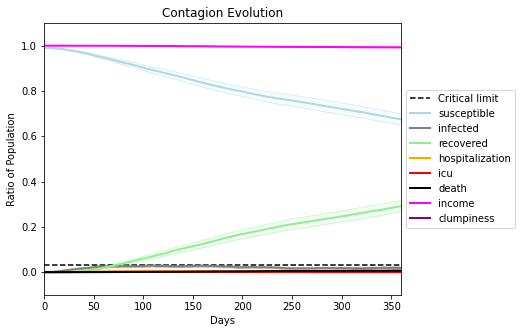

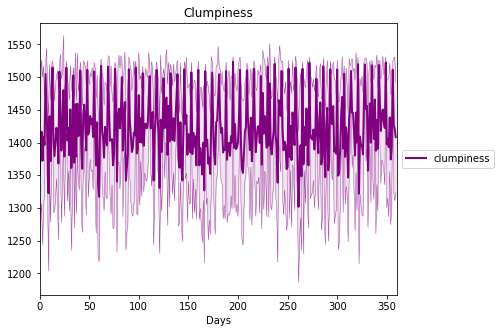

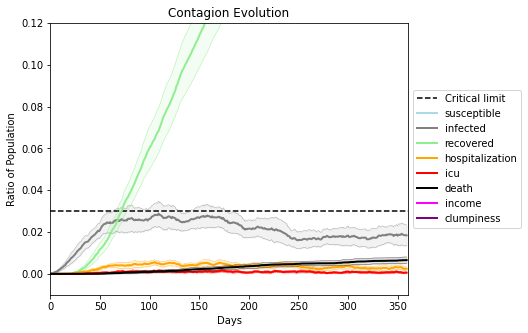

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[619, 7055, 4176, 7060, 5929, 85, 8372, 1921, 5092, 3711, 9351, 768, 2207, 3303, 4303, 5423, 2468, 8610, 3027, 7378]
Average similarity between family members is 0.9742015220881175 at temperature -0.998
Average similarity between family and home is 0.9998387541893575 at temperature -1
Average similarity between students and their classroom is 0.9652838642568037 at temperature -0.998
Average classroom occupancy is 1.7515151515151515 and number classrooms is 165
Average similarity between workers is 0.9726144355796553 at temperature -0.998
Average office occupancy is 3.5652173913043477 and number offices is 184
Average friend similarity for adults: 0.8488053282278583 for kids: 0.7379811811226104
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.6036268798167985
avg restaurant similarity 0.6010906486388818
avg restaurant similarity 0.5833555062292625
avg restaurant similarity 0.600022864314099
avg restaurant similarity 0.610182202441158
avg restaurant similarity 0.6390722081020199
avg restaurant similarity 0.6259572189911392
avg restaurant similarity 0.5642387777279414
avg restaurant similarity 0.5903751575950855
avg restaurant similarity 0.5908161496441093
avg restaurant similarity 0.5979599137037005
avg restaurant similarity 0.6310755829726201
avg restaurant similarity 0.5838783914286014
avg restaurant similarity 0.5961194793842378
avg restaurant similarity 0.5884783895334574
avg restaurant similarity 0.6038258228611544
avg restaurant similarity 0.6123126142780252
avg restaurant similarity 0.5803586450368047
avg restaurant similarity 0.5960461993927942
avg restaurant similarity 0.607665510676272
avg restaurant similarity 0.6361343420858635
avg restaurant similarity 0.5830641735443203
avg restauran

avg restaurant similarity 0.5857202102032738
avg restaurant similarity 0.6474613683827323
avg restaurant similarity 0.5802355532483847
avg restaurant similarity 0.5898966021037867
avg restaurant similarity 0.5738801254245474
avg restaurant similarity 0.6506753124886895
avg restaurant similarity 0.6253328775894615
avg restaurant similarity 0.656673473567621
avg restaurant similarity 0.5636272062171912
avg restaurant similarity 0.6017418795023047
avg restaurant similarity 0.6182743398496985
avg restaurant similarity 0.6014721485778035
avg restaurant similarity 0.5638369417878675
avg restaurant similarity 0.5932337477355745
avg restaurant similarity 0.6253549486396696
avg restaurant similarity 0.5786348564545615
avg restaurant similarity 0.5953919258640628
avg restaurant similarity 0.6201376181206596
avg restaurant similarity 0.6223330311082874
avg restaurant similarity 0.6157116691787488
avg restaurant similarity 0.627836187276132
avg restaurant similarity 0.6132547200248243
avg restaura

Average similarity between workers is 0.9599871240735014 at temperature -0.998
Average office occupancy is 3.518918918918919 and number offices is 185
Average friend similarity for adults: 0.8484229079844311 for kids: 0.7378559597073249
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.6615089144611193
avg restaurant similarity 0.6669492924931207
avg restaurant similarity 0.6178065935049027
avg restaurant similarity 0.6178221519334275
avg restaurant similarity 0.6595294037888353
avg restaurant similarity 0.6533679046455004
avg restaurant similarity 0.6610895595101723
avg restaurant similarity 0.6568150749388316
avg restaurant similarity 0.6609690566763519
avg restaurant similarity 0.682819257972083
avg restaurant similarity 0.6583007096261698
avg restaurant similarity 0.6530599453067436
avg restaurant similarity 0.6128065963576477
avg restaurant similarity 0.6434505392757571
avg restaurant similarity 0.6155016632787014
avg restaurant similarity 0.6350044539979551
avg restaurant similarity 0.6234225541037804
avg restaurant similarity 0.6587072951400572
avg restaurant similarity 0.6619869783718334
avg restaurant similarity 0.6686567756759404
avg restaurant similarity 0.6590873862874299
avg restaurant similarity 0.645091393557167
avg restaura

avg restaurant similarity 0.6918907149562451
avg restaurant similarity 0.650271109447484
avg restaurant similarity 0.5853650784923046
avg restaurant similarity 0.6704628237932396
avg restaurant similarity 0.6399802087865092
avg restaurant similarity 0.6153878093785177
avg restaurant similarity 0.6613357525857012
avg restaurant similarity 0.627798285073759
avg restaurant similarity 0.6167829346044277
avg restaurant similarity 0.620622837622265
avg restaurant similarity 0.6294774050007833
avg restaurant similarity 0.6647264091513277
avg restaurant similarity 0.6483814572262278
avg restaurant similarity 0.625835372399006
avg restaurant similarity 0.6453108812380293
avg restaurant similarity 0.6089199998759505
avg restaurant similarity 0.64073160893853
avg restaurant similarity 0.6361514343132579
avg restaurant similarity 0.6079715962368328
avg restaurant similarity 0.6457763821453222
avg restaurant similarity 0.649474526592691
avg restaurant similarity 0.6477053696101268
avg restaurant si

Average similarity between workers is 0.9533788983431334 at temperature -0.998
Average office occupancy is 3.6793478260869565 and number offices is 184
Average friend similarity for adults: 0.8542389383737845 for kids: 0.7146686638349584
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13

avg restaurant similarity 0.6025109055809978
avg restaurant similarity 0.6555673873055708
avg restaurant similarity 0.6310333239630395
avg restaurant similarity 0.6870328903180147
avg restaurant similarity 0.6671795453770052
avg restaurant similarity 0.6859526206133117
avg restaurant similarity 0.6535592632865254
avg restaurant similarity 0.6875554967098458
avg restaurant similarity 0.7004913225984171
avg restaurant similarity 0.6914900136210791
avg restaurant similarity 0.6528117675888994
avg restaurant similarity 0.6412931168969335
avg restaurant similarity 0.6379249946945108
avg restaurant similarity 0.6620619965765872
avg restaurant similarity 0.6712468976310774
avg restaurant similarity 0.6563063782980325
avg restaurant similarity 0.6641414056001128
avg restaurant similarity 0.6469660216333283
avg restaurant similarity 0.6307817903098458
avg restaurant similarity 0.660059568562354
avg restaurant similarity 0.6792851437721614
avg restaurant similarity 0.6570429548962528
avg restaur

avg restaurant similarity 0.6029607989428847
avg restaurant similarity 0.644352536493856
avg restaurant similarity 0.6183177458277029
avg restaurant similarity 0.6159818328908205
avg restaurant similarity 0.646286896705493
avg restaurant similarity 0.6298089606555042
avg restaurant similarity 0.6481950654113686
avg restaurant similarity 0.6544040051849747
avg restaurant similarity 0.6405767628244269
avg restaurant similarity 0.6414706897064358
avg restaurant similarity 0.693366477221828
avg restaurant similarity 0.6117476379900001
avg restaurant similarity 0.6350579007446092
avg restaurant similarity 0.5987799550164966
avg restaurant similarity 0.5904659631782225
avg restaurant similarity 0.6174354639288313
avg restaurant similarity 0.6413226087588475
avg restaurant similarity 0.5976600606390031
avg restaurant similarity 0.6367299806404133
avg restaurant similarity 0.6393789342336399
avg restaurant similarity 0.6022232102215236
avg restaurant similarity 0.6116524914517055
avg restauran

Average similarity between workers is 0.9612747154797845 at temperature -0.998
Average office occupancy is 3.227272727272727 and number offices is 198
Average friend similarity for adults: 0.851520596382405 for kids: 0.7396406930504981
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.6455686425668201
avg restaurant similarity 0.6569869653078699
avg restaurant similarity 0.626800017963874
avg restaurant similarity 0.6794010631874866
avg restaurant similarity 0.6283615831275592
avg restaurant similarity 0.6185824959928633
avg restaurant similarity 0.5976675889798424
avg restaurant similarity 0.6409254731535421
avg restaurant similarity 0.6624149287874749
avg restaurant similarity 0.6356363781504927
avg restaurant similarity 0.6309415370475725
avg restaurant similarity 0.661894759819724
avg restaurant similarity 0.6304211860342015
avg restaurant similarity 0.6369975669060122
avg restaurant similarity 0.6216061178493649
avg restaurant similarity 0.6479213516193368
avg restaurant similarity 0.6699584388452473
avg restaurant similarity 0.6466896704269823
avg restaurant similarity 0.6446797056858985
avg restaurant similarity 0.6708507808640519
avg restaurant similarity 0.6402980634423109
avg restaurant similarity 0.6884352602907681
avg restaura

avg restaurant similarity 0.6462950705235465
avg restaurant similarity 0.6217063936081437
avg restaurant similarity 0.6380392703855082
avg restaurant similarity 0.580396923652503
avg restaurant similarity 0.6439058559431076
avg restaurant similarity 0.6585264639361289
avg restaurant similarity 0.6103982862415492
avg restaurant similarity 0.6793514574358772
avg restaurant similarity 0.6563303611012761
avg restaurant similarity 0.6413830286219957
avg restaurant similarity 0.628877131008863
avg restaurant similarity 0.6399863906153656
avg restaurant similarity 0.6401814643857012
avg restaurant similarity 0.6770126644149871
avg restaurant similarity 0.6022867765639293
avg restaurant similarity 0.5944044747615903
avg restaurant similarity 0.6558238916774056
avg restaurant similarity 0.6155608892619738
avg restaurant similarity 0.6444329960125721
avg restaurant similarity 0.6331618999086315
avg restaurant similarity 0.6460902251256616
avg restaurant similarity 0.6704906740373596
avg restaura

Average similarity between workers is 0.9693567912133053 at temperature -0.998
Average office occupancy is 3.612021857923497 and number offices is 183
Average friend similarity for adults: 0.8527257741104445 for kids: 0.7210051275743279
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.6561530408006978
avg restaurant similarity 0.6064883598602899
avg restaurant similarity 0.6159172013448196
avg restaurant similarity 0.6276535627770504
avg restaurant similarity 0.6090363206527962
avg restaurant similarity 0.6220454840294822
avg restaurant similarity 0.6609541990448151
avg restaurant similarity 0.6383864967037869
avg restaurant similarity 0.6329259913301131
avg restaurant similarity 0.6617126471302628
avg restaurant similarity 0.648640267217877
avg restaurant similarity 0.6486704316904224
avg restaurant similarity 0.6424722311758223
avg restaurant similarity 0.6366405568142861
avg restaurant similarity 0.6901588834681599
avg restaurant similarity 0.632680243935443
avg restaurant similarity 0.659783313009844
avg restaurant similarity 0.6549177828525079
avg restaurant similarity 0.6179762664652974
avg restaurant similarity 0.6254508506177087
avg restaurant similarity 0.6590430284516802
avg restaurant similarity 0.6601101472291165
avg restauran

avg restaurant similarity 0.6813820149455825
avg restaurant similarity 0.7046092670295445
avg restaurant similarity 0.6596858555011326
avg restaurant similarity 0.6325630588721327
avg restaurant similarity 0.6233041258151338
avg restaurant similarity 0.6446585922107994
avg restaurant similarity 0.6995923658852126
avg restaurant similarity 0.6483251183818366
avg restaurant similarity 0.6213444738764263
avg restaurant similarity 0.6234959232641879
avg restaurant similarity 0.6660949425726007
avg restaurant similarity 0.6537549516151191
avg restaurant similarity 0.6897061254034029
avg restaurant similarity 0.6596134528411546
avg restaurant similarity 0.698005061028204
avg restaurant similarity 0.6739369548536173
avg restaurant similarity 0.6852746072709809
avg restaurant similarity 0.7277432283168629
avg restaurant similarity 0.6669030011028881
avg restaurant similarity 0.6970801917456323
avg restaurant similarity 0.649495222781459
avg restaurant similarity 0.6590494389455969
avg restaura

Average similarity between workers is 0.9617016369269386 at temperature -0.998
Average office occupancy is 3.392670157068063 and number offices is 191
Average friend similarity for adults: 0.8498431437341883 for kids: 0.7343096175386913
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 

avg restaurant similarity 0.6190110995340083
avg restaurant similarity 0.6273808664213454
avg restaurant similarity 0.6673715951711193
avg restaurant similarity 0.6004328266535467
avg restaurant similarity 0.6390055998178342
avg restaurant similarity 0.6060677160437121
avg restaurant similarity 0.6137792602489179
avg restaurant similarity 0.5719389529352047
avg restaurant similarity 0.6244876767902533
avg restaurant similarity 0.6419300039223479
avg restaurant similarity 0.6522512399838606
avg restaurant similarity 0.6037090226703554
avg restaurant similarity 0.6488987625572459
avg restaurant similarity 0.6412687374077521
avg restaurant similarity 0.6675522153008487
avg restaurant similarity 0.6645396572954939
avg restaurant similarity 0.6059444961592296
avg restaurant similarity 0.6538175911320149
avg restaurant similarity 0.6307684059036822
avg restaurant similarity 0.6427536861504156
avg restaurant similarity 0.6214583112105208
avg restaurant similarity 0.621051101802113
avg restaur

avg restaurant similarity 0.6439688383973332
avg restaurant similarity 0.5908142885452019
avg restaurant similarity 0.6339820507595764
avg restaurant similarity 0.5885739799865356
avg restaurant similarity 0.646811179671799
avg restaurant similarity 0.6314027249702997
avg restaurant similarity 0.663963622076073
avg restaurant similarity 0.6403660224534581
avg restaurant similarity 0.6411322484770077
avg restaurant similarity 0.6285028244148035
avg restaurant similarity 0.6553270620174351
avg restaurant similarity 0.6244938539091769
avg restaurant similarity 0.5977925312328968
avg restaurant similarity 0.632377796338534
avg restaurant similarity 0.6217330385917298
avg restaurant similarity 0.6196845298936116
avg restaurant similarity 0.6591298935678815
avg restaurant similarity 0.6182543009833316
avg restaurant similarity 0.6155499902141536
avg restaurant similarity 0.6521402762178712
avg restaurant similarity 0.6264801044131427
avg restaurant similarity 0.6180275903684115
avg restauran

Average similarity between workers is 0.9605643566161042 at temperature -0.998
Average office occupancy is 3.568306010928962 and number offices is 183
Average friend similarity for adults: 0.8539954296357936 for kids: 0.7458700785512652
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.6699678275538771
avg restaurant similarity 0.654926739528418
avg restaurant similarity 0.6605001032157566
avg restaurant similarity 0.7122590901589008
avg restaurant similarity 0.7407273825808427
avg restaurant similarity 0.7175863133523074
avg restaurant similarity 0.7565605140835255
avg restaurant similarity 0.65654329034512
avg restaurant similarity 0.6774129307862768
avg restaurant similarity 0.7064756544699712
avg restaurant similarity 0.691748132486149
avg restaurant similarity 0.676509975798531
avg restaurant similarity 0.6706572338973428
avg restaurant similarity 0.7042112521425961
avg restaurant similarity 0.670330577595336
avg restaurant similarity 0.7144416918806232
avg restaurant similarity 0.6434000740244319
avg restaurant similarity 0.6679298344283157
avg restaurant similarity 0.6694654072974996
avg restaurant similarity 0.6688648886387477
avg restaurant similarity 0.6903159987803893
avg restaurant similarity 0.6412377070310351
avg restaurant s

avg restaurant similarity 0.6472960668880762
avg restaurant similarity 0.6852711307882499
avg restaurant similarity 0.6358197329592946
avg restaurant similarity 0.6691427204641421
avg restaurant similarity 0.6297207743464359
avg restaurant similarity 0.6689916419080911
avg restaurant similarity 0.6851350084199412
avg restaurant similarity 0.6698900354250112
avg restaurant similarity 0.6655487881257917
avg restaurant similarity 0.7172356494809122
avg restaurant similarity 0.684124323173005
avg restaurant similarity 0.6485641777306457
avg restaurant similarity 0.664111429299601
avg restaurant similarity 0.6820297447335478
avg restaurant similarity 0.6663949032043133
avg restaurant similarity 0.6422364004272894
avg restaurant similarity 0.6896051165203333
avg restaurant similarity 0.7138461383693839
avg restaurant similarity 0.7145693726790151
avg restaurant similarity 0.7255498843930925
avg restaurant similarity 0.6770224112443141
avg restaurant similarity 0.6872476596625804
avg restaura

Average similarity between workers is 0.9622946820377014 at temperature -0.998
Average office occupancy is 3.708791208791209 and number offices is 182
Average friend similarity for adults: 0.8526928185375732 for kids: 0.7187195796938827
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.6582967234076997
avg restaurant similarity 0.6247196599314294
avg restaurant similarity 0.7118873997009284
avg restaurant similarity 0.7116687737661962
avg restaurant similarity 0.6540808732549747
avg restaurant similarity 0.6145119013714856
avg restaurant similarity 0.6132444925793776
avg restaurant similarity 0.6771610562841158
avg restaurant similarity 0.6053896164023234
avg restaurant similarity 0.657429016737843
avg restaurant similarity 0.698311661298197
avg restaurant similarity 0.6769778033497365
avg restaurant similarity 0.6545353919169578
avg restaurant similarity 0.7025353218902463
avg restaurant similarity 0.6458377073503038
avg restaurant similarity 0.6661976600026639
avg restaurant similarity 0.6327475644075384
avg restaurant similarity 0.671934659419509
avg restaurant similarity 0.6857417916390092
avg restaurant similarity 0.624409537569293
avg restaurant similarity 0.67503794285536
avg restaurant similarity 0.6389056810317926
avg restaurant s

avg restaurant similarity 0.6736198708466755
avg restaurant similarity 0.6796465305958777
avg restaurant similarity 0.6197933198198229
avg restaurant similarity 0.6584159804074645
avg restaurant similarity 0.6617766759011537
avg restaurant similarity 0.6849143026840178
avg restaurant similarity 0.6874968742341511
avg restaurant similarity 0.6621088343764759
avg restaurant similarity 0.6509947555527593
avg restaurant similarity 0.6642223102898809
avg restaurant similarity 0.667375675796444
avg restaurant similarity 0.6694446652368152
avg restaurant similarity 0.6702176227077269
avg restaurant similarity 0.6894131030640988
avg restaurant similarity 0.6310545123948411
avg restaurant similarity 0.6730417881745829
avg restaurant similarity 0.6486181355292309
avg restaurant similarity 0.6815348249727086
avg restaurant similarity 0.6955303506078524
avg restaurant similarity 0.6751682972124413
avg restaurant similarity 0.6383831696141644
avg restaurant similarity 0.678350518046549
avg restaura

Average similarity between workers is 0.9646455849936386 at temperature -0.998
Average office occupancy is 3.507936507936508 and number offices is 189
Average friend similarity for adults: 0.8669434486593647 for kids: 0.7313994205094139
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.644028723204974
avg restaurant similarity 0.6551278600985864
avg restaurant similarity 0.6361977347433024
avg restaurant similarity 0.6608793931523695
avg restaurant similarity 0.6251235631824589
avg restaurant similarity 0.6573435352337221
avg restaurant similarity 0.6714722510252634
avg restaurant similarity 0.6685430081870051
avg restaurant similarity 0.667076235339224
avg restaurant similarity 0.64148617245649
avg restaurant similarity 0.6698268138542369
avg restaurant similarity 0.6836716650368537
avg restaurant similarity 0.670314879723519
avg restaurant similarity 0.6594211695600732
avg restaurant similarity 0.6433704627047222
avg restaurant similarity 0.7092712509796096
avg restaurant similarity 0.6489116637242833
avg restaurant similarity 0.6689260210972766
avg restaurant similarity 0.6254357667195019
avg restaurant similarity 0.6671126833707619
avg restaurant similarity 0.6496753191047345
avg restaurant similarity 0.6103625556100459
avg restaurant 

avg restaurant similarity 0.6701821345810741
avg restaurant similarity 0.6497899477428101
avg restaurant similarity 0.6566662714125278
avg restaurant similarity 0.5933180430804277
avg restaurant similarity 0.6610421703503947
avg restaurant similarity 0.6412860395487382
avg restaurant similarity 0.6497148085601722
avg restaurant similarity 0.6611359463229578
avg restaurant similarity 0.7058877234712213
avg restaurant similarity 0.683770942801618
avg restaurant similarity 0.6793707165027197
avg restaurant similarity 0.7076520981970919
avg restaurant similarity 0.6010655560227837
avg restaurant similarity 0.6172059807421033
avg restaurant similarity 0.6982878804429014
avg restaurant similarity 0.6555237145370599
avg restaurant similarity 0.6939817386049344
avg restaurant similarity 0.6715028753963853
avg restaurant similarity 0.6157877304423842
avg restaurant similarity 0.6771394849682795
avg restaurant similarity 0.6258201719078602
avg restaurant similarity 0.6485788117191306
avg restaur

Average similarity between workers is 0.9648485188243637 at temperature -0.998
Average office occupancy is 3.3612565445026177 and number offices is 191
Average friend similarity for adults: 0.8627343059740714 for kids: 0.7576153517260789
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.71475758409535
avg restaurant similarity 0.7194074880832343
avg restaurant similarity 0.6777453250287255
avg restaurant similarity 0.7116416398290466
avg restaurant similarity 0.6540168368313654
avg restaurant similarity 0.6892540624023686
avg restaurant similarity 0.72996366755439
avg restaurant similarity 0.6997651274830253
avg restaurant similarity 0.7059258342303546
avg restaurant similarity 0.6953486015656873
avg restaurant similarity 0.6977686130860022
avg restaurant similarity 0.7186256713881141
avg restaurant similarity 0.7182383492187233
avg restaurant similarity 0.6700925848224752
avg restaurant similarity 0.6863827476767557
avg restaurant similarity 0.6907716599849989
avg restaurant similarity 0.7231681715322977
avg restaurant similarity 0.6999902715845363
avg restaurant similarity 0.7023503933841783
avg restaurant similarity 0.689295214990348
avg restaurant similarity 0.6788488325277643
avg restaurant similarity 0.7169545096378808
avg restaurant 

avg restaurant similarity 0.6803188658407034
avg restaurant similarity 0.6913068133454888
avg restaurant similarity 0.6817146226222537
avg restaurant similarity 0.7240059805991306
avg restaurant similarity 0.7169402779274776
avg restaurant similarity 0.6791905283960297
avg restaurant similarity 0.6942333820773858
avg restaurant similarity 0.6641367747322025
avg restaurant similarity 0.7086586569427431
avg restaurant similarity 0.7295532851046096
avg restaurant similarity 0.6721431555302391
avg restaurant similarity 0.6965391875473967
avg restaurant similarity 0.6991302008663817
avg restaurant similarity 0.6828770682377127
avg restaurant similarity 0.6810556567569266
avg restaurant similarity 0.7147585895415421
avg restaurant similarity 0.7262943063190328
avg restaurant similarity 0.745025689222802
avg restaurant similarity 0.7238696775249162
avg restaurant similarity 0.6274854430094728
avg restaurant similarity 0.6751353823601973
avg restaurant similarity 0.7259562703809035
avg restaur

Average similarity between workers is 0.9702698908210742 at temperature -0.998
Average office occupancy is 3.502645502645503 and number offices is 189
Average friend similarity for adults: 0.8634027807955756 for kids: 0.7346690983266202
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.6174895651629861
avg restaurant similarity 0.662672810751855
avg restaurant similarity 0.7174622632405805
avg restaurant similarity 0.6687133846942749
avg restaurant similarity 0.6363854798492866
avg restaurant similarity 0.6955019513767894
avg restaurant similarity 0.6864633455771236
avg restaurant similarity 0.6962454143085761
avg restaurant similarity 0.7122544999879822
avg restaurant similarity 0.6837013566533194
avg restaurant similarity 0.7092311328426131
avg restaurant similarity 0.6715526303764601
avg restaurant similarity 0.6765959485651911
avg restaurant similarity 0.6998813605131966
avg restaurant similarity 0.727630767161463
avg restaurant similarity 0.7074766943211981
avg restaurant similarity 0.6652497759019799
avg restaurant similarity 0.6829932453920167
avg restaurant similarity 0.6696734911525801
avg restaurant similarity 0.7025911850434207
avg restaurant similarity 0.7242020334172302
avg restaurant similarity 0.7055935930447423
avg restaura

avg restaurant similarity 0.628001617997955
avg restaurant similarity 0.6676729480726727
avg restaurant similarity 0.6253959115663341
avg restaurant similarity 0.608095456791105
avg restaurant similarity 0.6611692374249458
avg restaurant similarity 0.6732944641140899
avg restaurant similarity 0.6729182896682872
avg restaurant similarity 0.7055760549211563
avg restaurant similarity 0.7014381283600105
avg restaurant similarity 0.6655860592486026
avg restaurant similarity 0.6783764150569347
avg restaurant similarity 0.7346782084727699
avg restaurant similarity 0.7066865417789073
avg restaurant similarity 0.6972671446565014
avg restaurant similarity 0.6779261163260619
avg restaurant similarity 0.6267894361076446
avg restaurant similarity 0.7166476564729657
avg restaurant similarity 0.690762261451611
avg restaurant similarity 0.6817435776014833
avg restaurant similarity 0.7041708524335569
avg restaurant similarity 0.6753715343693895
avg restaurant similarity 0.6417556619712269
avg restauran

Average similarity between workers is 0.9554061810877241 at temperature -0.998
Average office occupancy is 3.374331550802139 and number offices is 187
Average friend similarity for adults: 0.8506584532033153 for kids: 0.7451056218264538
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.6054012390097423
avg restaurant similarity 0.598338274568707
avg restaurant similarity 0.6550078901114255
avg restaurant similarity 0.6402202952521534
avg restaurant similarity 0.6296322972603087
avg restaurant similarity 0.649468904629
avg restaurant similarity 0.6513091163732251
avg restaurant similarity 0.641370344431364
avg restaurant similarity 0.6273549100399215
avg restaurant similarity 0.6292858764894175
avg restaurant similarity 0.6218675399841405
avg restaurant similarity 0.6050890451192208
avg restaurant similarity 0.5945097594481964
avg restaurant similarity 0.6127837519757935
avg restaurant similarity 0.6460029617615204
avg restaurant similarity 0.6296777114492548
avg restaurant similarity 0.6502610957784128
avg restaurant similarity 0.6192311978038648
avg restaurant similarity 0.6326894440886576
avg restaurant similarity 0.6410958481129713
avg restaurant similarity 0.6350930997954245
avg restaurant similarity 0.6473459759212186
avg restaurant s

avg restaurant similarity 0.6335005667409246
avg restaurant similarity 0.5832384912369696
avg restaurant similarity 0.6314631622441894
avg restaurant similarity 0.5960629287645205
avg restaurant similarity 0.6287196599256418
avg restaurant similarity 0.6498951481707027
avg restaurant similarity 0.6701440668228714
avg restaurant similarity 0.6043410264429554
avg restaurant similarity 0.6646931205381732
avg restaurant similarity 0.633172499506034
avg restaurant similarity 0.6629743894235892
avg restaurant similarity 0.6621696553325932
avg restaurant similarity 0.6143791575885691
avg restaurant similarity 0.6394433581592673
avg restaurant similarity 0.6246223796866578
avg restaurant similarity 0.6162562253764395
avg restaurant similarity 0.6750928095626727
avg restaurant similarity 0.6155147220385614
avg restaurant similarity 0.5999265638638104
avg restaurant similarity 0.6507153780922909
avg restaurant similarity 0.5903754168371202
avg restaurant similarity 0.5854594494158409
avg restaur

Average similarity between workers is 0.9737387241426446 at temperature -0.998
Average office occupancy is 3.657458563535912 and number offices is 181
Average friend similarity for adults: 0.8644374307468078 for kids: 0.7421170640589119
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.6512037614097843
avg restaurant similarity 0.7056040163245354
avg restaurant similarity 0.6183999268523418
avg restaurant similarity 0.6674459410383858
avg restaurant similarity 0.6240953314530898
avg restaurant similarity 0.6505174851328624
avg restaurant similarity 0.6547755940015918
avg restaurant similarity 0.6615815123965917
avg restaurant similarity 0.6462259589985258
avg restaurant similarity 0.6871616256131758
avg restaurant similarity 0.66708630462903
avg restaurant similarity 0.6281752885112667
avg restaurant similarity 0.6806377931443071
avg restaurant similarity 0.6242537188460082
avg restaurant similarity 0.6884503413729688
avg restaurant similarity 0.6183667688447851
avg restaurant similarity 0.6707107234276721
avg restaurant similarity 0.5994733369742575
avg restaurant similarity 0.6526721612894617
avg restaurant similarity 0.652739965256407
avg restaurant similarity 0.6241089950196438
avg restaurant similarity 0.5932378781920774
avg restauran

avg restaurant similarity 0.6615285157195515
avg restaurant similarity 0.6556880493263341
avg restaurant similarity 0.6355275914541041
avg restaurant similarity 0.6386165528857634
avg restaurant similarity 0.6054690473681418
avg restaurant similarity 0.6121731231202413
avg restaurant similarity 0.6540175863787653
avg restaurant similarity 0.606632223727143
avg restaurant similarity 0.6177655941136567
avg restaurant similarity 0.6522506117428086
avg restaurant similarity 0.6452122315177873
avg restaurant similarity 0.6838729278414779
avg restaurant similarity 0.6409209484128808
avg restaurant similarity 0.6557857478966842
avg restaurant similarity 0.6734986963951867
avg restaurant similarity 0.6299170319329437
avg restaurant similarity 0.6340515625593741
avg restaurant similarity 0.6653532691146742
avg restaurant similarity 0.6790002698573564
avg restaurant similarity 0.6173048783594162
avg restaurant similarity 0.6874906134596033
avg restaurant similarity 0.6442977350090221
avg restaur

Average similarity between workers is 0.9643263303481708 at temperature -0.998
Average office occupancy is 3.6077348066298343 and number offices is 181
Average friend similarity for adults: 0.8604987483207804 for kids: 0.7493235032128104
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total o

avg restaurant similarity 0.6516998621988828
avg restaurant similarity 0.6643589126320274
avg restaurant similarity 0.6694144860722288
avg restaurant similarity 0.6548564225780854
avg restaurant similarity 0.6721913796438034
avg restaurant similarity 0.681850173475832
avg restaurant similarity 0.6881601421306692
avg restaurant similarity 0.742213911783984
avg restaurant similarity 0.6455110910159257
avg restaurant similarity 0.645678623526691
avg restaurant similarity 0.6579109772039604
avg restaurant similarity 0.6589265006402604
avg restaurant similarity 0.7007694784079478
avg restaurant similarity 0.6794769070917589
avg restaurant similarity 0.6871613408304069
avg restaurant similarity 0.6269307817284304
avg restaurant similarity 0.6887063701700971
avg restaurant similarity 0.6494334291667523
avg restaurant similarity 0.6828286777509295
avg restaurant similarity 0.6172867966706322
avg restaurant similarity 0.6402416219961145
avg restaurant similarity 0.6550288807750249
avg restauran

avg restaurant similarity 0.6236779773810195
avg restaurant similarity 0.5944280955517132
avg restaurant similarity 0.6551992019740783
avg restaurant similarity 0.6146966669012099
avg restaurant similarity 0.6341808997481906
avg restaurant similarity 0.6409330889751832
avg restaurant similarity 0.659642420321448
avg restaurant similarity 0.6562896930147363
avg restaurant similarity 0.6936327046206482
avg restaurant similarity 0.6460133304030649
avg restaurant similarity 0.6786210762126843
avg restaurant similarity 0.6436599344857019
avg restaurant similarity 0.6553022581517426
avg restaurant similarity 0.6293321956124007
avg restaurant similarity 0.6453062848954176
avg restaurant similarity 0.6591528211016301
avg restaurant similarity 0.6388414417862146
avg restaurant similarity 0.6889953222946772
avg restaurant similarity 0.6640712550687146
avg restaurant similarity 0.6203001921793652
avg restaurant similarity 0.6522977135944998
avg restaurant similarity 0.6198807954066211
avg restaur

Average similarity between workers is 0.9609617183480085 at temperature -0.998
Average office occupancy is 3.66120218579235 and number offices is 183
Average friend similarity for adults: 0.8592973604641865 for kids: 0.7346908673839639
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.716642661573298
avg restaurant similarity 0.6713438880567665
avg restaurant similarity 0.7012204211365837
avg restaurant similarity 0.7073742997364204
avg restaurant similarity 0.6924961423943098
avg restaurant similarity 0.7060499306722665
avg restaurant similarity 0.6796705354564858
avg restaurant similarity 0.6912822910606334
avg restaurant similarity 0.6771719329148245
avg restaurant similarity 0.7210221118636595
avg restaurant similarity 0.6643126022155863
avg restaurant similarity 0.6692922400096795
avg restaurant similarity 0.6796878370191524
avg restaurant similarity 0.6648809510117561
avg restaurant similarity 0.6791925415879049
avg restaurant similarity 0.6380375132748273
avg restaurant similarity 0.6771274311925484
avg restaurant similarity 0.7228266538266217
avg restaurant similarity 0.7010732435504817
avg restaurant similarity 0.677350209280921
avg restaurant similarity 0.6854319307469305
avg restaurant similarity 0.70705547913941
avg restaurant

avg restaurant similarity 0.6732176304308024
avg restaurant similarity 0.6574964015238699
avg restaurant similarity 0.6557815314777962
avg restaurant similarity 0.703907719045356
avg restaurant similarity 0.670659377087063
avg restaurant similarity 0.7106478274565062
avg restaurant similarity 0.6779570192135019
avg restaurant similarity 0.6667141527975738
avg restaurant similarity 0.6691381874915158
avg restaurant similarity 0.6621812208097507
avg restaurant similarity 0.6823789883360842
avg restaurant similarity 0.7099807864629574
avg restaurant similarity 0.7442116871559579
avg restaurant similarity 0.6335871409115179
avg restaurant similarity 0.6522798587606117
avg restaurant similarity 0.6521692029032806
avg restaurant similarity 0.6945308317395972
avg restaurant similarity 0.7177342568607304
avg restaurant similarity 0.6966510947395191
avg restaurant similarity 0.6825637464997777
avg restaurant similarity 0.6955179940251739
avg restaurant similarity 0.676229978743894
avg restauran

Average similarity between workers is 0.9735275567292347 at temperature -0.998
Average office occupancy is 3.6235955056179776 and number offices is 178
Average friend similarity for adults: 0.8528118434734836 for kids: 0.7382639650753876
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total o

avg restaurant similarity 0.6963730572307043
avg restaurant similarity 0.668714317221814
avg restaurant similarity 0.7352051160091205
avg restaurant similarity 0.7285343171530556
avg restaurant similarity 0.649631904527644
avg restaurant similarity 0.6725368105526105
avg restaurant similarity 0.7031662198237593
avg restaurant similarity 0.6807020118912507
avg restaurant similarity 0.6652443582768005
avg restaurant similarity 0.6873427611199429
avg restaurant similarity 0.6737620077882577
avg restaurant similarity 0.6699867679272067
avg restaurant similarity 0.7267071874939389
avg restaurant similarity 0.6690135261307462
avg restaurant similarity 0.6998179795687821
avg restaurant similarity 0.6337722510362996
avg restaurant similarity 0.68923558017464
avg restaurant similarity 0.6846334156919572
avg restaurant similarity 0.6809867230166506
avg restaurant similarity 0.655261861242207
avg restaurant similarity 0.6695168825911106
avg restaurant similarity 0.7086094655724323
avg restaurant 

avg restaurant similarity 0.6705216244715421
avg restaurant similarity 0.6974822590069052
avg restaurant similarity 0.6837808366736589
avg restaurant similarity 0.6197498758818581
avg restaurant similarity 0.6750308807454127
avg restaurant similarity 0.7023457405257654
avg restaurant similarity 0.6356220425715745
avg restaurant similarity 0.7066446816625738
avg restaurant similarity 0.7001223831092548
avg restaurant similarity 0.6420600024604309
avg restaurant similarity 0.6584801860717274
avg restaurant similarity 0.6837358251210582
avg restaurant similarity 0.7019829399071058
avg restaurant similarity 0.6741107249833752
avg restaurant similarity 0.7109126103382855
avg restaurant similarity 0.682111658078626
avg restaurant similarity 0.6577903861326198
avg restaurant similarity 0.7194599531211875
avg restaurant similarity 0.7220239986127703
avg restaurant similarity 0.6892395554993977
avg restaurant similarity 0.6628441939136581
avg restaurant similarity 0.7409885191764602
avg restaur

Average similarity between workers is 0.9578368562829631 at temperature -0.998
Average office occupancy is 3.5319148936170213 and number offices is 188
Average friend similarity for adults: 0.8601297797735132 for kids: 0.7326961650987196
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.6569858665486291
avg restaurant similarity 0.7119411053558296
avg restaurant similarity 0.7050570430389173
avg restaurant similarity 0.7163499340748579
avg restaurant similarity 0.6614705923691362
avg restaurant similarity 0.6914091723870435
avg restaurant similarity 0.6856444771176421
avg restaurant similarity 0.6883192422382447
avg restaurant similarity 0.7140677432083312
avg restaurant similarity 0.6824689087246723
avg restaurant similarity 0.6746374842589336
avg restaurant similarity 0.7077552786301429
avg restaurant similarity 0.7029524136078474
avg restaurant similarity 0.698817632851238
avg restaurant similarity 0.6559299908554111
avg restaurant similarity 0.6891245635091895
avg restaurant similarity 0.6813084403919869
avg restaurant similarity 0.6568856045529959
avg restaurant similarity 0.7260751566702404
avg restaurant similarity 0.7242846575085425
avg restaurant similarity 0.7078720936161101
avg restaurant similarity 0.7290001846382029
avg restaur

avg restaurant similarity 0.7626614250201091
avg restaurant similarity 0.7228698063682545
avg restaurant similarity 0.7085332539716735
avg restaurant similarity 0.6976328652482561
avg restaurant similarity 0.6883604629825903
avg restaurant similarity 0.6884334391341383
avg restaurant similarity 0.710998007848412
avg restaurant similarity 0.6560513539534469
avg restaurant similarity 0.6593847249903545
avg restaurant similarity 0.7085736394036898
avg restaurant similarity 0.6650521217729571
avg restaurant similarity 0.6897029410671458
avg restaurant similarity 0.6927310453808485
avg restaurant similarity 0.7077342075183258
avg restaurant similarity 0.7242850030382112
avg restaurant similarity 0.694628310732086
avg restaurant similarity 0.74609649437202
avg restaurant similarity 0.6964692891031884
avg restaurant similarity 0.661350023632139
avg restaurant similarity 0.7092652915403342
avg restaurant similarity 0.6967182924103318
avg restaurant similarity 0.7128406973071101
avg restaurant 

Average similarity between workers is 0.9636007434975156 at temperature -0.998
Average office occupancy is 3.329842931937173 and number offices is 191
Average friend similarity for adults: 0.8493556744449847 for kids: 0.7409152101762805
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.6760989558735793
avg restaurant similarity 0.6274364430274503
avg restaurant similarity 0.6570923791800193
avg restaurant similarity 0.6980867048476165
avg restaurant similarity 0.672456884191389
avg restaurant similarity 0.6483611514480826
avg restaurant similarity 0.6237728148190566
avg restaurant similarity 0.6481665644419734
avg restaurant similarity 0.6011310956451414
avg restaurant similarity 0.6349692088276343
avg restaurant similarity 0.6092791699956535
avg restaurant similarity 0.662637789550196
avg restaurant similarity 0.630078038254466
avg restaurant similarity 0.6510041236762485
avg restaurant similarity 0.6478636436472477
avg restaurant similarity 0.6801654004856139
avg restaurant similarity 0.6453728310230509
avg restaurant similarity 0.6122353884202735
avg restaurant similarity 0.6503476082884841
avg restaurant similarity 0.6552446540152229
avg restaurant similarity 0.6606940864910589
avg restaurant similarity 0.6460624804045902
avg restauran

avg restaurant similarity 0.6607253471920996
avg restaurant similarity 0.623052701525047
avg restaurant similarity 0.6710340342018055
avg restaurant similarity 0.6404302217421297
avg restaurant similarity 0.6515646582831421
avg restaurant similarity 0.7121494241963533
avg restaurant similarity 0.6627504143261205
avg restaurant similarity 0.655301595908116
avg restaurant similarity 0.6645649422386289
avg restaurant similarity 0.6811810746945997
avg restaurant similarity 0.6313629958985567
avg restaurant similarity 0.6555458159575991
avg restaurant similarity 0.6293848201341397
avg restaurant similarity 0.6539059266500936
avg restaurant similarity 0.6429171247879353
avg restaurant similarity 0.6455114104428847
avg restaurant similarity 0.6230136136175836
avg restaurant similarity 0.6314227962660648
avg restaurant similarity 0.6191423309337175
avg restaurant similarity 0.6414847895617324
avg restaurant similarity 0.6461722657395417
avg restaurant similarity 0.6495588429845633
avg restaura

Average similarity between workers is 0.957857342051254 at temperature -0.998
Average office occupancy is 3.6898395721925135 and number offices is 187
Average friend similarity for adults: 0.8640430377376385 for kids: 0.7363122880780593
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 

avg restaurant similarity 0.7124010483503818
avg restaurant similarity 0.6513779089824212
avg restaurant similarity 0.642012615651615
avg restaurant similarity 0.6422403062933688
avg restaurant similarity 0.6677022823532327
avg restaurant similarity 0.6512281035618335
avg restaurant similarity 0.6887365189259177
avg restaurant similarity 0.633932155095349
avg restaurant similarity 0.6877228178483693
avg restaurant similarity 0.6250147234395727
avg restaurant similarity 0.6424715610375403
avg restaurant similarity 0.6528274053004298
avg restaurant similarity 0.6670978742019118
avg restaurant similarity 0.6473782056968799
avg restaurant similarity 0.6794532490468336
avg restaurant similarity 0.7466325605441959
avg restaurant similarity 0.6570227681608015
avg restaurant similarity 0.6731040006272905
avg restaurant similarity 0.6443849924939575
avg restaurant similarity 0.6585672175233324
avg restaurant similarity 0.7517868835005083
avg restaurant similarity 0.7268820419356131
avg restaura

avg restaurant similarity 0.6538830903511497
avg restaurant similarity 0.6610759115607086
avg restaurant similarity 0.6318063631593736
avg restaurant similarity 0.5912249530118512
avg restaurant similarity 0.666761091978585
avg restaurant similarity 0.6914142214281052
avg restaurant similarity 0.6651174489964873
avg restaurant similarity 0.5725746261630477
avg restaurant similarity 0.6128026268237351
avg restaurant similarity 0.6300583766422148
avg restaurant similarity 0.6090228171025952
avg restaurant similarity 0.6373384478663852
avg restaurant similarity 0.6557355864365237
avg restaurant similarity 0.6958893080116915
avg restaurant similarity 0.614182264130737
avg restaurant similarity 0.6866454434714528
avg restaurant similarity 0.6336734198190146
avg restaurant similarity 0.632725300998049
avg restaurant similarity 0.6063292269562178
avg restaurant similarity 0.7392638691711201
avg restaurant similarity 0.6168041358539752
avg restaurant similarity 0.621726264158747
avg restaurant

Average similarity between workers is 0.9717825712267049 at temperature -0.998
Average office occupancy is 3.659340659340659 and number offices is 182
Average friend similarity for adults: 0.8597624387526842 for kids: 0.7247558231137726
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.6225862150471729
avg restaurant similarity 0.6124207436526885
avg restaurant similarity 0.6250929007520385
avg restaurant similarity 0.6506963369856328
avg restaurant similarity 0.6211238868483009
avg restaurant similarity 0.6849844946321233
avg restaurant similarity 0.6333221237474795
avg restaurant similarity 0.666901947463229
avg restaurant similarity 0.6716840824179464
avg restaurant similarity 0.6541115689764158
avg restaurant similarity 0.6923980381409475
avg restaurant similarity 0.6680189858565764
avg restaurant similarity 0.6397148188758804
avg restaurant similarity 0.6416535237260476
avg restaurant similarity 0.6827129167853284
avg restaurant similarity 0.6590030171329494
avg restaurant similarity 0.7054631930066195
avg restaurant similarity 0.6704866230604426
avg restaurant similarity 0.6150411049856187
avg restaurant similarity 0.6532160591247608
avg restaurant similarity 0.6471306633761953
avg restaurant similarity 0.6030359886349507
avg restaur

avg restaurant similarity 0.621789010901586
avg restaurant similarity 0.6449453897546251
avg restaurant similarity 0.6265639132771335
avg restaurant similarity 0.6764371966011545
avg restaurant similarity 0.6597035203330864
avg restaurant similarity 0.6571112544964279
avg restaurant similarity 0.6424220859188633
avg restaurant similarity 0.7082742312744079
avg restaurant similarity 0.6360188692821542
avg restaurant similarity 0.6521519066098386
avg restaurant similarity 0.6050012394361609
avg restaurant similarity 0.6549282621595408
avg restaurant similarity 0.6460018723543909
avg restaurant similarity 0.6321992886595892
avg restaurant similarity 0.6203970800425811
avg restaurant similarity 0.6272048263108088
avg restaurant similarity 0.6944722976133748
avg restaurant similarity 0.6270363075388369
avg restaurant similarity 0.5973509161372929
avg restaurant similarity 0.6495805960453215
avg restaurant similarity 0.6266706364870905
avg restaurant similarity 0.6420941034219909
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

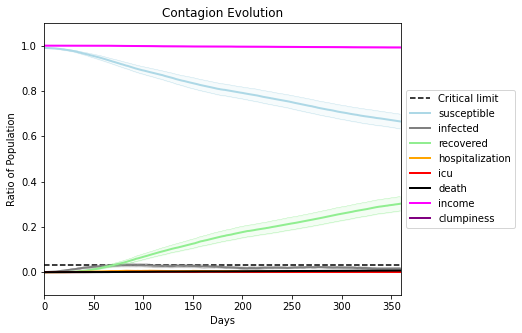

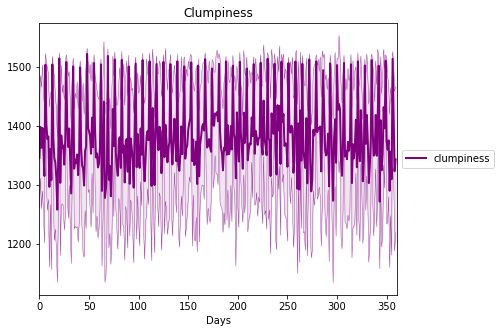

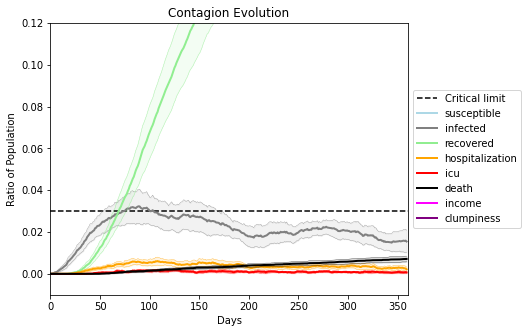

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7483, 8350, 264, 5570, 5313, 8224, 6921, 983, 3692, 7070, 9620, 5839, 2430, 836, 7244, 5404, 3874, 1001, 1285, 4891]
Average similarity between family members is 0.9546555330093197 at temperature -0.9975
Average similarity between family and home is 0.9998561569383921 at temperature -1
Average similarity between students and their classroom is 0.9307308099053214 at temperature -0.9975
Average classroom occupancy is 1.6484848484848484 and number classrooms is 165
Average similarity between workers is 0.9343012606285207 at temperature -0.9975
Average office occupancy is 3.6923076923076925 and number offices is 182
Average friend similarity for adults: 0.8584024734594699 for kids: 0.7216033550542603
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.6071508307094704
avg restaurant similarity 0.6383505580783586
avg restaurant similarity 0.6311335253305942
avg restaurant similarity 0.6257350841102227
avg restaurant similarity 0.6586985404279821
avg restaurant similarity 0.640678336365706
avg restaurant similarity 0.6717173824685188
avg restaurant similarity 0.5862064308123589
avg restaurant similarity 0.6496768663670526
avg restaurant similarity 0.6102384961411249
avg restaurant similarity 0.6429498149316387
avg restaurant similarity 0.6366229262451102
avg restaurant similarity 0.6549475732702383
avg restaurant similarity 0.6283352056931799
avg restaurant similarity 0.6755387574704057
avg restaurant similarity 0.6607491824691782
avg restaurant similarity 0.6337681173175262
avg restaurant similarity 0.6772352328533693
avg restaurant similarity 0.6543530750890592
avg restaurant similarity 0.6530785605583966
avg restaurant similarity 0.6450850462678135
avg restaurant similarity 0.666267525859471
avg restaura

avg restaurant similarity 0.5938113947430002
avg restaurant similarity 0.6470079099727096
avg restaurant similarity 0.6140892182419307
avg restaurant similarity 0.6645389221991784
avg restaurant similarity 0.6500869284027913
avg restaurant similarity 0.661881581606131
avg restaurant similarity 0.6829807789362027
avg restaurant similarity 0.6182844650635605
avg restaurant similarity 0.6734703711056943
avg restaurant similarity 0.650151398679552
avg restaurant similarity 0.6473793876684504
avg restaurant similarity 0.6765956803706473
avg restaurant similarity 0.6458073477301971
avg restaurant similarity 0.6290206035446578
avg restaurant similarity 0.6486791871342823
avg restaurant similarity 0.6277129754837405
avg restaurant similarity 0.619220574414577
avg restaurant similarity 0.6378102479781805
avg restaurant similarity 0.638749927948088
avg restaurant similarity 0.5988012342027998
avg restaurant similarity 0.6747832639924274
avg restaurant similarity 0.646073311285467
avg restaurant 

Average similarity between workers is 0.9283077306224029 at temperature -0.9975
Average office occupancy is 3.41025641025641 and number offices is 195
Average friend similarity for adults: 0.8611466005646311 for kids: 0.729405690223695
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peo

avg restaurant similarity 0.6091280937627601
avg restaurant similarity 0.5932476675888306
avg restaurant similarity 0.6148091466866603
avg restaurant similarity 0.6391617213805535
avg restaurant similarity 0.630780979748426
avg restaurant similarity 0.6167847728875314
avg restaurant similarity 0.5744853964073392
avg restaurant similarity 0.5866319660164909
avg restaurant similarity 0.6255532362823325
avg restaurant similarity 0.5751311281051116
avg restaurant similarity 0.5968289819961665
avg restaurant similarity 0.6404804892927585
avg restaurant similarity 0.6071674427663443
avg restaurant similarity 0.6391640232215265
avg restaurant similarity 0.6260688301886448
avg restaurant similarity 0.6169542550758323
avg restaurant similarity 0.5869317237095857
avg restaurant similarity 0.6606335412745248
avg restaurant similarity 0.6166529701810693
avg restaurant similarity 0.5921420381561255
avg restaurant similarity 0.6172139632264666
avg restaurant similarity 0.6233878263447046
avg restaur

avg restaurant similarity 0.6299472737719426
avg restaurant similarity 0.6166823653016239
avg restaurant similarity 0.6321707172017546
avg restaurant similarity 0.6391692480964402
avg restaurant similarity 0.6176260057119708
avg restaurant similarity 0.566351550930564
avg restaurant similarity 0.5761192164986978
avg restaurant similarity 0.6236803907220259
avg restaurant similarity 0.606696417434654
avg restaurant similarity 0.6132086109168321
avg restaurant similarity 0.602327095769566
avg restaurant similarity 0.5500603658269195
avg restaurant similarity 0.6165081325288383
avg restaurant similarity 0.634949496524139
avg restaurant similarity 0.5942911401662819
avg restaurant similarity 0.5944239138270329
avg restaurant similarity 0.6086754979658956
avg restaurant similarity 0.6375720337665456
avg restaurant similarity 0.5469155070144059
avg restaurant similarity 0.5834405192837306
avg restaurant similarity 0.6036941446423799
avg restaurant similarity 0.6158586797169152
avg restaurant

Average similarity between workers is 0.9269598246114992 at temperature -0.9975
Average office occupancy is 3.4193548387096775 and number offices is 186
Average friend similarity for adults: 0.8423700848246892 for kids: 0.7231090170160839
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6203408214093852
avg restaurant similarity 0.6674109243220667
avg restaurant similarity 0.635881774343552
avg restaurant similarity 0.7047868449414023
avg restaurant similarity 0.6497013417492368
avg restaurant similarity 0.6758753053984821
avg restaurant similarity 0.6363028265300553
avg restaurant similarity 0.6916342283975851
avg restaurant similarity 0.661171967816936
avg restaurant similarity 0.6734456309771377
avg restaurant similarity 0.6480808154611734
avg restaurant similarity 0.6756326092356653
avg restaurant similarity 0.6663338102801564
avg restaurant similarity 0.6673893425929432
avg restaurant similarity 0.6815370144915613
avg restaurant similarity 0.6659517042588483
avg restaurant similarity 0.6403645269410674
avg restaurant similarity 0.6150488171540397
avg restaurant similarity 0.6517108014495753
avg restaurant similarity 0.6642743936262386
avg restaurant similarity 0.6642371376486114
avg restaurant similarity 0.6644796900146998
avg restaura

avg restaurant similarity 0.5802202363400301
avg restaurant similarity 0.6060929211385828
avg restaurant similarity 0.6607736894644791
avg restaurant similarity 0.6573385688573739
avg restaurant similarity 0.6447282088678362
avg restaurant similarity 0.6365126020286044
avg restaurant similarity 0.7076371961929555
avg restaurant similarity 0.6362155025363206
avg restaurant similarity 0.6304362686340114
avg restaurant similarity 0.6433503838691642
avg restaurant similarity 0.6132425180927059
avg restaurant similarity 0.6227686318703519
avg restaurant similarity 0.6752039297156651
avg restaurant similarity 0.5981979222395872
avg restaurant similarity 0.6329508067944175
avg restaurant similarity 0.6520754769605926
avg restaurant similarity 0.6206221903350722
avg restaurant similarity 0.6333529817408741
avg restaurant similarity 0.6224893023387919
avg restaurant similarity 0.6353434421320044
avg restaurant similarity 0.6356585736234542
avg restaurant similarity 0.6257050413443281
avg restau

Average similarity between workers is 0.9381272546711348 at temperature -0.9975
Average office occupancy is 3.5103092783505154 and number offices is 194
Average friend similarity for adults: 0.857716822809075 for kids: 0.7151552718312072
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.6202691515536294
avg restaurant similarity 0.6472666513382995
avg restaurant similarity 0.6341266355418063
avg restaurant similarity 0.6761847579840884
avg restaurant similarity 0.6666876214888764
avg restaurant similarity 0.6659242980664869
avg restaurant similarity 0.6401008500101728
avg restaurant similarity 0.6815072590227448
avg restaurant similarity 0.6273285820928937
avg restaurant similarity 0.6245584377716858
avg restaurant similarity 0.6583770595223059
avg restaurant similarity 0.5940957301388634
avg restaurant similarity 0.6675755922654303
avg restaurant similarity 0.6673944108235239
avg restaurant similarity 0.6236388512341988
avg restaurant similarity 0.6360760377842666
avg restaurant similarity 0.6567178487643606
avg restaurant similarity 0.6264005167684341
avg restaurant similarity 0.6803746563632387
avg restaurant similarity 0.6434033631265559
avg restaurant similarity 0.6492380039452387
avg restaurant similarity 0.6234773854786405
avg restau

avg restaurant similarity 0.5748753031561304
avg restaurant similarity 0.6158427237360867
avg restaurant similarity 0.6403565916191929
avg restaurant similarity 0.5950467748307529
avg restaurant similarity 0.6162382284024586
avg restaurant similarity 0.6254484771764182
avg restaurant similarity 0.6441881304465594
avg restaurant similarity 0.6493851717493405
avg restaurant similarity 0.6217630530164426
avg restaurant similarity 0.6313555767810158
avg restaurant similarity 0.6503556282986016
avg restaurant similarity 0.6110176680770344
avg restaurant similarity 0.6429794810655877
avg restaurant similarity 0.6344899589879609
avg restaurant similarity 0.610907692096361
avg restaurant similarity 0.6230149068898844
avg restaurant similarity 0.5660217983617893
avg restaurant similarity 0.6100328462781842
avg restaurant similarity 0.626521219615184
avg restaurant similarity 0.623606525968023
avg restaurant similarity 0.6599283095135058
avg restaurant similarity 0.6331269507359946
avg restauran

Average similarity between workers is 0.9335109516125554 at temperature -0.9975
Average office occupancy is 3.3842105263157896 and number offices is 190
Average friend similarity for adults: 0.8598623934127827 for kids: 0.743162397704499
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 10 people.
Total o

avg restaurant similarity 0.69266514048914
avg restaurant similarity 0.6954179066767413
avg restaurant similarity 0.6968272125752509
avg restaurant similarity 0.6489672353190218
avg restaurant similarity 0.7197192046947722
avg restaurant similarity 0.6709327521141546
avg restaurant similarity 0.7025702002328631
avg restaurant similarity 0.6948852078463064
avg restaurant similarity 0.6773800205696938
avg restaurant similarity 0.666292305179252
avg restaurant similarity 0.6854846385224095
avg restaurant similarity 0.7229608455332732
avg restaurant similarity 0.7100782701724322
avg restaurant similarity 0.6589278257918996
avg restaurant similarity 0.6483671986711473
avg restaurant similarity 0.6966409802976913
avg restaurant similarity 0.6920423001155794
avg restaurant similarity 0.7165279922172867
avg restaurant similarity 0.7089692865121714
avg restaurant similarity 0.6459735404820842
avg restaurant similarity 0.7373609651108158
avg restaurant similarity 0.6620235055930235
avg restauran

avg restaurant similarity 0.6638663803826312
avg restaurant similarity 0.6506587257084181
avg restaurant similarity 0.6697145803207653
avg restaurant similarity 0.6635324036540305
avg restaurant similarity 0.6729250435466011
avg restaurant similarity 0.660557105520502
avg restaurant similarity 0.665038670120403
avg restaurant similarity 0.6986402328911289
avg restaurant similarity 0.6909323592481127
avg restaurant similarity 0.6840353736945815
avg restaurant similarity 0.7289615348464876
avg restaurant similarity 0.6881622617940213
avg restaurant similarity 0.6859314866644097
avg restaurant similarity 0.693316067444415
avg restaurant similarity 0.6855489677841372
avg restaurant similarity 0.6644426918460328
avg restaurant similarity 0.676666631880609
avg restaurant similarity 0.6805696083944591
avg restaurant similarity 0.6415517407607251
avg restaurant similarity 0.688669853114435
avg restaurant similarity 0.6986855937195438
avg restaurant similarity 0.7138338830215099
avg restaurant 

Average similarity between workers is 0.9462254611974551 at temperature -0.9975
Average office occupancy is 3.238341968911917 and number offices is 193
Average friend similarity for adults: 0.8429725375023774 for kids: 0.740569383161609
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 

avg restaurant similarity 0.6525022477858013
avg restaurant similarity 0.5921154774195981
avg restaurant similarity 0.6013905328200798
avg restaurant similarity 0.5858640340970377
avg restaurant similarity 0.6402598626436361
avg restaurant similarity 0.6740130425784793
avg restaurant similarity 0.6223385686888349
avg restaurant similarity 0.6176520839299293
avg restaurant similarity 0.6110408310892614
avg restaurant similarity 0.6779817586393588
avg restaurant similarity 0.6121827701870033
avg restaurant similarity 0.6302354767939888
avg restaurant similarity 0.6294558622107298
avg restaurant similarity 0.6236388244353512
avg restaurant similarity 0.6051237695670243
avg restaurant similarity 0.6288859613096159
avg restaurant similarity 0.6477793237047778
avg restaurant similarity 0.6898512906060874
avg restaurant similarity 0.6718826214683572
avg restaurant similarity 0.6395098646039267
avg restaurant similarity 0.6122885845028955
avg restaurant similarity 0.5872907036541023
avg restau

avg restaurant similarity 0.6318574949260805
avg restaurant similarity 0.6348851671206586
avg restaurant similarity 0.6392609139036397
avg restaurant similarity 0.6175396798322877
avg restaurant similarity 0.6258420287400064
avg restaurant similarity 0.6408171265424063
avg restaurant similarity 0.6111894626237485
avg restaurant similarity 0.5940349009822158
avg restaurant similarity 0.5697022663422536
avg restaurant similarity 0.5715292536370421
avg restaurant similarity 0.6891313059881908
avg restaurant similarity 0.5999138939054673
avg restaurant similarity 0.5868491574545579
avg restaurant similarity 0.6509870894243239
avg restaurant similarity 0.6406396196682035
avg restaurant similarity 0.6188570418042653
avg restaurant similarity 0.6728440096648058
avg restaurant similarity 0.6262809027374573
avg restaurant similarity 0.5646047286552907
avg restaurant similarity 0.6402235013357703
avg restaurant similarity 0.5794100033023932
avg restaurant similarity 0.5396463223629671
avg restau

Average similarity between workers is 0.9324270492978141 at temperature -0.9975
Average office occupancy is 3.525252525252525 and number offices is 198
Average friend similarity for adults: 0.8635573266304389 for kids: 0.7306737606301856
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total o

avg restaurant similarity 0.6416861725604918
avg restaurant similarity 0.6324016929784904
avg restaurant similarity 0.6593977308737593
avg restaurant similarity 0.5953900473301061
avg restaurant similarity 0.60291778716192
avg restaurant similarity 0.6446836401191725
avg restaurant similarity 0.6003570222010567
avg restaurant similarity 0.629435001499309
avg restaurant similarity 0.5992998374027533
avg restaurant similarity 0.6161866012562126
avg restaurant similarity 0.6370025657807008
avg restaurant similarity 0.6419320832220503
avg restaurant similarity 0.6155577727633671
avg restaurant similarity 0.6310551486927918
avg restaurant similarity 0.6253783285450932
avg restaurant similarity 0.6775552124415226
avg restaurant similarity 0.6542493139163279
avg restaurant similarity 0.5956686238005388
avg restaurant similarity 0.6120675860903703
avg restaurant similarity 0.669993526675383
avg restaurant similarity 0.6782833751141037
avg restaurant similarity 0.6594830072759664
avg restaurant

avg restaurant similarity 0.5931572716034581
avg restaurant similarity 0.6089815910154166
avg restaurant similarity 0.6167870567541882
avg restaurant similarity 0.6125110736084818
avg restaurant similarity 0.6366160945378393
avg restaurant similarity 0.5941919845467217
avg restaurant similarity 0.6531148029799102
avg restaurant similarity 0.639036402979375
avg restaurant similarity 0.619134068631771
avg restaurant similarity 0.6284792414897821
avg restaurant similarity 0.6277868850200888
avg restaurant similarity 0.5867528754914468
avg restaurant similarity 0.6180685881613674
avg restaurant similarity 0.6519189688033994
avg restaurant similarity 0.5707045286688401
avg restaurant similarity 0.6309283842614467
avg restaurant similarity 0.6055139167164084
avg restaurant similarity 0.6243244359119073
avg restaurant similarity 0.5919806038904804
avg restaurant similarity 0.6086617615200384
avg restaurant similarity 0.6321747119768524
avg restaurant similarity 0.624439415799712
avg restauran

Average similarity between workers is 0.9443255524075291 at temperature -0.9975
Average office occupancy is 3.3697916666666665 and number offices is 192
Average friend similarity for adults: 0.8578159375973621 for kids: 0.7576084979194972
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.6300479243536007
avg restaurant similarity 0.5994195922956883
avg restaurant similarity 0.6552485961647784
avg restaurant similarity 0.6495043838713542
avg restaurant similarity 0.6587442078044492
avg restaurant similarity 0.6464019568620447
avg restaurant similarity 0.6456738747968459
avg restaurant similarity 0.6687106675448381
avg restaurant similarity 0.6774339011351568
avg restaurant similarity 0.620707872968776
avg restaurant similarity 0.6416509801599369
avg restaurant similarity 0.5862502435626022
avg restaurant similarity 0.6869079834046731
avg restaurant similarity 0.6379031886551595
avg restaurant similarity 0.6202189910289226
avg restaurant similarity 0.6783237107704522
avg restaurant similarity 0.6755096842393902
avg restaurant similarity 0.6369683761760474
avg restaurant similarity 0.5792288230763456
avg restaurant similarity 0.6883279908875303
avg restaurant similarity 0.659215914415115
avg restaurant similarity 0.6557102772053396
avg restaura

avg restaurant similarity 0.6280146031632896
avg restaurant similarity 0.6263179730616176
avg restaurant similarity 0.604199916566878
avg restaurant similarity 0.6229646365932759
avg restaurant similarity 0.6281140926469533
avg restaurant similarity 0.6750097942918595
avg restaurant similarity 0.6401956381737801
avg restaurant similarity 0.6104148728371898
avg restaurant similarity 0.6069549388342653
avg restaurant similarity 0.6761096811608182
avg restaurant similarity 0.6437928067072752
avg restaurant similarity 0.6326005752483914
avg restaurant similarity 0.6511465772965807
avg restaurant similarity 0.6353914239928037
avg restaurant similarity 0.6248267362080665
avg restaurant similarity 0.6516152128402124
avg restaurant similarity 0.6197618413931563
avg restaurant similarity 0.6614842569749992
avg restaurant similarity 0.6679613442433177
avg restaurant similarity 0.632628010632586
avg restaurant similarity 0.6679240143006733
avg restaurant similarity 0.6654044217103795
avg restaura

Average similarity between workers is 0.9439250625269175 at temperature -0.9975
Average office occupancy is 3.4507772020725387 and number offices is 193
Average friend similarity for adults: 0.8506120555743596 for kids: 0.7277180970540003
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total 

avg restaurant similarity 0.6407033643603124
avg restaurant similarity 0.5703303235498112
avg restaurant similarity 0.594509456029723
avg restaurant similarity 0.6580652402963444
avg restaurant similarity 0.6138515325960178
avg restaurant similarity 0.6151742746230269
avg restaurant similarity 0.5901667466656143
avg restaurant similarity 0.626976759665113
avg restaurant similarity 0.6614219032429391
avg restaurant similarity 0.6059517757393853
avg restaurant similarity 0.5780128679253264
avg restaurant similarity 0.5586603399320789
avg restaurant similarity 0.6003984882440713
avg restaurant similarity 0.6259056961218908
avg restaurant similarity 0.647822151760261
avg restaurant similarity 0.6042244530201726
avg restaurant similarity 0.5683865087067187
avg restaurant similarity 0.5917992148872918
avg restaurant similarity 0.6225357928381303
avg restaurant similarity 0.6059106298501046
avg restaurant similarity 0.5998984909255991
avg restaurant similarity 0.633887140719058
avg restaurant

avg restaurant similarity 0.6655244684636838
avg restaurant similarity 0.5894922210390374
avg restaurant similarity 0.6715830703423732
avg restaurant similarity 0.6344638983870825
avg restaurant similarity 0.5894855546305402
avg restaurant similarity 0.6287067328426832
avg restaurant similarity 0.6795164836791079
avg restaurant similarity 0.6179487751974061
avg restaurant similarity 0.5829993263567244
avg restaurant similarity 0.6539506528579894
avg restaurant similarity 0.5454150315960384
avg restaurant similarity 0.6446866398762751
avg restaurant similarity 0.598401040165785
avg restaurant similarity 0.6269451269383812
avg restaurant similarity 0.5828295005835907
avg restaurant similarity 0.612829202737038
avg restaurant similarity 0.6716961008621721
avg restaurant similarity 0.6264711000441829
avg restaurant similarity 0.6626711773630816
avg restaurant similarity 0.6334320313412238
avg restaurant similarity 0.6080223748971165
avg restaurant similarity 0.6189902883655117
avg restaura

Average similarity between workers is 0.9465635763612995 at temperature -0.9975
Average office occupancy is 3.3969072164948453 and number offices is 194
Average friend similarity for adults: 0.8660665672530884 for kids: 0.7513463008884784
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.6158709394764558
avg restaurant similarity 0.6053005643848416
avg restaurant similarity 0.5979637424002412
avg restaurant similarity 0.6150891593350355
avg restaurant similarity 0.6342267050235972
avg restaurant similarity 0.6490420136442923
avg restaurant similarity 0.614600994107184
avg restaurant similarity 0.618743204735216
avg restaurant similarity 0.6528160060032004
avg restaurant similarity 0.578863118670767
avg restaurant similarity 0.6393061034688239
avg restaurant similarity 0.6305871893018933
avg restaurant similarity 0.6461018173994545
avg restaurant similarity 0.640184703924453
avg restaurant similarity 0.6072354930495998
avg restaurant similarity 0.6274532631699692
avg restaurant similarity 0.6334948410843934
avg restaurant similarity 0.6171752345054509
avg restaurant similarity 0.6003320696158096
avg restaurant similarity 0.6369068542548899
avg restaurant similarity 0.6450614832805813
avg restaurant similarity 0.6603231312915375
avg restaurant

avg restaurant similarity 0.6192263937396852
avg restaurant similarity 0.6909135119136905
avg restaurant similarity 0.5999412000918887
avg restaurant similarity 0.623055249900253
avg restaurant similarity 0.601079184341432
avg restaurant similarity 0.6260082194485883
avg restaurant similarity 0.594197592078723
avg restaurant similarity 0.636483343973496
avg restaurant similarity 0.6132160843858095
avg restaurant similarity 0.6331447840434935
avg restaurant similarity 0.6198745486387139
avg restaurant similarity 0.6146245660336174
avg restaurant similarity 0.6156873670552034
avg restaurant similarity 0.5807316135151899
avg restaurant similarity 0.6090713471179369
avg restaurant similarity 0.5855196260139981
avg restaurant similarity 0.643173980604017
avg restaurant similarity 0.6095244350764786
avg restaurant similarity 0.5909007741595665
avg restaurant similarity 0.611172545469639
avg restaurant similarity 0.6132754711341706
avg restaurant similarity 0.6228617571256916
avg restaurant s

Average similarity between workers is 0.9409977408873803 at temperature -0.9975
Average office occupancy is 3.448453608247423 and number offices is 194
Average friend similarity for adults: 0.8674412144186331 for kids: 0.7304691931166539
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.6927354514174533
avg restaurant similarity 0.7296379509421876
avg restaurant similarity 0.7058428337283653
avg restaurant similarity 0.6683940687803884
avg restaurant similarity 0.7193126056306437
avg restaurant similarity 0.6808969560188296
avg restaurant similarity 0.6557256190930378
avg restaurant similarity 0.6926357484610425
avg restaurant similarity 0.7128017960843176
avg restaurant similarity 0.645665115146608
avg restaurant similarity 0.7060821855604146
avg restaurant similarity 0.6674719973057098
avg restaurant similarity 0.6676786608787512
avg restaurant similarity 0.6570766712406372
avg restaurant similarity 0.6631852009594533
avg restaurant similarity 0.6457018089395733
avg restaurant similarity 0.6691661969417071
avg restaurant similarity 0.6653657896947147
avg restaurant similarity 0.6455828877904278
avg restaurant similarity 0.6663235382801659
avg restaurant similarity 0.6716822150703888
avg restaurant similarity 0.6623045268129704
avg restaur

avg restaurant similarity 0.6470159229120174
avg restaurant similarity 0.6760090492235503
avg restaurant similarity 0.7338994587323294
avg restaurant similarity 0.6751799297307842
avg restaurant similarity 0.655530410165936
avg restaurant similarity 0.6520952842712247
avg restaurant similarity 0.6339218351288468
avg restaurant similarity 0.6563702101542284
avg restaurant similarity 0.7357620341327317
avg restaurant similarity 0.7326183964175961
avg restaurant similarity 0.6522740475299734
avg restaurant similarity 0.6796429424104603
avg restaurant similarity 0.7321452096400773
avg restaurant similarity 0.6943475283742783
avg restaurant similarity 0.6500506064424475
avg restaurant similarity 0.6826691800086259
avg restaurant similarity 0.6367425394605231
avg restaurant similarity 0.6772794132170277
avg restaurant similarity 0.6718125753617884
avg restaurant similarity 0.6860234710258353
avg restaurant similarity 0.7034791140740396
avg restaurant similarity 0.6930789554634239
avg restaur

Average similarity between workers is 0.9412009763796207 at temperature -0.9975
Average office occupancy is 3.473404255319149 and number offices is 188
Average friend similarity for adults: 0.8561170266181275 for kids: 0.7321978208798503
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total o

avg restaurant similarity 0.6795836208950836
avg restaurant similarity 0.6656097093203284
avg restaurant similarity 0.6942091144706395
avg restaurant similarity 0.6254369047315725
avg restaurant similarity 0.6610937679648963
avg restaurant similarity 0.6320423112159966
avg restaurant similarity 0.6694447316328093
avg restaurant similarity 0.6214176444620663
avg restaurant similarity 0.6805484381068797
avg restaurant similarity 0.6422679058699312
avg restaurant similarity 0.6968371658878749
avg restaurant similarity 0.658050648820872
avg restaurant similarity 0.6419357314920103
avg restaurant similarity 0.6462407593177161
avg restaurant similarity 0.6617593360307967
avg restaurant similarity 0.667110676235386
avg restaurant similarity 0.7025145195895209
avg restaurant similarity 0.6498952456348165
avg restaurant similarity 0.6821033407666517
avg restaurant similarity 0.6205440801100555
avg restaurant similarity 0.6653314619038214
avg restaurant similarity 0.662250239730521
avg restauran

avg restaurant similarity 0.6500702085127509
avg restaurant similarity 0.646973833277877
avg restaurant similarity 0.6665173509449038
avg restaurant similarity 0.6934000930743917
avg restaurant similarity 0.6747525450682187
avg restaurant similarity 0.693843816629168
avg restaurant similarity 0.6948728828354055
avg restaurant similarity 0.6500568663342093
avg restaurant similarity 0.6752465748954734
avg restaurant similarity 0.6494958107227613
avg restaurant similarity 0.6367115699901892
avg restaurant similarity 0.6933282326297787
avg restaurant similarity 0.6631019800317167
avg restaurant similarity 0.6770772404916989
avg restaurant similarity 0.6662499020207202
avg restaurant similarity 0.6452397570258201
avg restaurant similarity 0.6126452975017886
avg restaurant similarity 0.6104130995225796
avg restaurant similarity 0.6813032450210322
avg restaurant similarity 0.6478764972138366
avg restaurant similarity 0.6532825363276842
avg restaurant similarity 0.6700504240718764
avg restaura

Average similarity between workers is 0.9262195635898021 at temperature -0.9975
Average office occupancy is 3.4285714285714284 and number offices is 189
Average friend similarity for adults: 0.8441759746428922 for kids: 0.7191222640999163
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total 

avg restaurant similarity 0.5925744041747725
avg restaurant similarity 0.6475475971396237
avg restaurant similarity 0.5812242727355399
avg restaurant similarity 0.648402903821822
avg restaurant similarity 0.5851347201377356
avg restaurant similarity 0.5842668646345646
avg restaurant similarity 0.6658331695747244
avg restaurant similarity 0.550398455976355
avg restaurant similarity 0.605524166560802
avg restaurant similarity 0.5972749055908345
avg restaurant similarity 0.640392735052296
avg restaurant similarity 0.6574247608087246
avg restaurant similarity 0.5708806912594362
avg restaurant similarity 0.6118310491549493
avg restaurant similarity 0.6563165658915009
avg restaurant similarity 0.5904706202220952
avg restaurant similarity 0.6274753637877042
avg restaurant similarity 0.5746924425757101
avg restaurant similarity 0.5728269189916797
avg restaurant similarity 0.6679577807611167
avg restaurant similarity 0.6207421829522487
avg restaurant similarity 0.6281612159525677
avg restaurant

avg restaurant similarity 0.585890840670797
avg restaurant similarity 0.5905845812242804
avg restaurant similarity 0.5825616122330962
avg restaurant similarity 0.5640368441146539
avg restaurant similarity 0.5960997082297855
avg restaurant similarity 0.6124398726686251
avg restaurant similarity 0.5652147847799398
avg restaurant similarity 0.6132914769876996
avg restaurant similarity 0.5674989462140957
avg restaurant similarity 0.6493924600853882
avg restaurant similarity 0.5345656905897137
avg restaurant similarity 0.5840185795101677
avg restaurant similarity 0.5974404225406981
avg restaurant similarity 0.636506030966022
avg restaurant similarity 0.5867078888235894
avg restaurant similarity 0.581142223363017
avg restaurant similarity 0.6045661179421324
avg restaurant similarity 0.6492994442512156
avg restaurant similarity 0.6129594223446783
avg restaurant similarity 0.6378963339385058
avg restaurant similarity 0.5733923055187754
avg restaurant similarity 0.6395917050163453
avg restauran

Average similarity between workers is 0.940896610133968 at temperature -0.9975
Average office occupancy is 3.3181818181818183 and number offices is 198
Average friend similarity for adults: 0.8492406079536805 for kids: 0.7410478963958544
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6161970197413585
avg restaurant similarity 0.6281782854932514
avg restaurant similarity 0.5855084734857826
avg restaurant similarity 0.6453320751334866
avg restaurant similarity 0.6476576459078284
avg restaurant similarity 0.6114378506046552
avg restaurant similarity 0.567631056979934
avg restaurant similarity 0.6023666095391488
avg restaurant similarity 0.5961328062747507
avg restaurant similarity 0.5565722702974668
avg restaurant similarity 0.5632751767826268
avg restaurant similarity 0.5877720799926948
avg restaurant similarity 0.6295031002367399
avg restaurant similarity 0.6401046854438358
avg restaurant similarity 0.5545911164251354
avg restaurant similarity 0.6255317341558199
avg restaurant similarity 0.6296276198870226
avg restaurant similarity 0.578234226164519
avg restaurant similarity 0.59256462536599
avg restaurant similarity 0.6332950622409866
avg restaurant similarity 0.6211376663410562
avg restaurant similarity 0.581103977027441
avg restaurant 

avg restaurant similarity 0.5963811444750585
avg restaurant similarity 0.6896148162908369
avg restaurant similarity 0.6568248159887502
avg restaurant similarity 0.5862929959547023
avg restaurant similarity 0.5565680359197687
avg restaurant similarity 0.6121762617045066
avg restaurant similarity 0.5731072807323766
avg restaurant similarity 0.6625554501777449
avg restaurant similarity 0.5843734355169656
avg restaurant similarity 0.6254305962507121
avg restaurant similarity 0.6568769246656027
avg restaurant similarity 0.5641538048789959
avg restaurant similarity 0.6239994864385865
avg restaurant similarity 0.6454275493868058
avg restaurant similarity 0.5951636738316701
avg restaurant similarity 0.5660152367123101
avg restaurant similarity 0.6402666357065682
avg restaurant similarity 0.5887117783870135
avg restaurant similarity 0.6788682539376116
avg restaurant similarity 0.559430207536428
avg restaurant similarity 0.6404368209138728
avg restaurant similarity 0.6534321631152746
avg restaur

Average similarity between workers is 0.9266677019752926 at temperature -0.9975
Average office occupancy is 3.4301075268817205 and number offices is 186
Average friend similarity for adults: 0.8480847206052033 for kids: 0.7402563299007536
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6758361034339677
avg restaurant similarity 0.6690774590204792
avg restaurant similarity 0.634508647209759
avg restaurant similarity 0.6455029912694363
avg restaurant similarity 0.6552765662658658
avg restaurant similarity 0.6875854788551009
avg restaurant similarity 0.7205525676484916
avg restaurant similarity 0.5790768639664676
avg restaurant similarity 0.6386574874702339
avg restaurant similarity 0.5887311188766763
avg restaurant similarity 0.6122845514187599
avg restaurant similarity 0.6320522983430391
avg restaurant similarity 0.6160489037066949
avg restaurant similarity 0.6851281835319785
avg restaurant similarity 0.669459406814768
avg restaurant similarity 0.615622997508925
avg restaurant similarity 0.6634173778411845
avg restaurant similarity 0.6402691382896339
avg restaurant similarity 0.6846220166298232
avg restaurant similarity 0.6218564168513382
avg restaurant similarity 0.6610536482501669
avg restaurant similarity 0.6789629521788311
avg restauran

avg restaurant similarity 0.5865106112085942
avg restaurant similarity 0.6497768766761935
avg restaurant similarity 0.6792459353598373
avg restaurant similarity 0.6398624662858314
avg restaurant similarity 0.6597541281135573
avg restaurant similarity 0.6700086170415992
avg restaurant similarity 0.6123330585853406
avg restaurant similarity 0.6167448493863785
avg restaurant similarity 0.6344114273147378
avg restaurant similarity 0.641453133358163
avg restaurant similarity 0.6675933342685891
avg restaurant similarity 0.7114791029345249
avg restaurant similarity 0.6394149322762567
avg restaurant similarity 0.6572944490275199
avg restaurant similarity 0.6351141898747331
avg restaurant similarity 0.6228084218699813
avg restaurant similarity 0.6272053509970277
avg restaurant similarity 0.6635805030160242
avg restaurant similarity 0.6050222187011988
avg restaurant similarity 0.6943002758359518
avg restaurant similarity 0.6249283716225433
avg restaurant similarity 0.6954294541378668
avg restaur

Average similarity between workers is 0.9398012289186957 at temperature -0.9975
Average office occupancy is 3.473404255319149 and number offices is 188
Average friend similarity for adults: 0.8562145028947962 for kids: 0.7444537000136685
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6422526732997444
avg restaurant similarity 0.5924547192624751
avg restaurant similarity 0.6170858563756016
avg restaurant similarity 0.6674676529461004
avg restaurant similarity 0.5712527320528347
avg restaurant similarity 0.6484178824007897
avg restaurant similarity 0.6498967778559822
avg restaurant similarity 0.6428717452877812
avg restaurant similarity 0.5971452493936198
avg restaurant similarity 0.5947263339190882
avg restaurant similarity 0.629665143507545
avg restaurant similarity 0.7056308435929944
avg restaurant similarity 0.5945780132072356
avg restaurant similarity 0.6486169663609176
avg restaurant similarity 0.6061570447192347
avg restaurant similarity 0.6453423916483854
avg restaurant similarity 0.6360560891024165
avg restaurant similarity 0.6554149038422872
avg restaurant similarity 0.6071521630242003
avg restaurant similarity 0.6310941789300438
avg restaurant similarity 0.6747741508045652
avg restaurant similarity 0.6185840342895984
avg restaur

avg restaurant similarity 0.6475035929703639
avg restaurant similarity 0.6156252904284394
avg restaurant similarity 0.6608490701452244
avg restaurant similarity 0.6950995782594123
avg restaurant similarity 0.6310289069544093
avg restaurant similarity 0.6323853601939035
avg restaurant similarity 0.6258522570308774
avg restaurant similarity 0.6280951656073326
avg restaurant similarity 0.6280154672991101
avg restaurant similarity 0.5952598153033823
avg restaurant similarity 0.6650724958943105
avg restaurant similarity 0.6495623645449793
avg restaurant similarity 0.621688700981095
avg restaurant similarity 0.6427261591475665
avg restaurant similarity 0.6483441276732026
avg restaurant similarity 0.6734759586433565
avg restaurant similarity 0.639492221956683
avg restaurant similarity 0.5990588725069317
avg restaurant similarity 0.6632485940330984
avg restaurant similarity 0.6121501917137375
avg restaurant similarity 0.6258662252039824
avg restaurant similarity 0.6441842063968464
avg restaura

Average similarity between workers is 0.9397273654053006 at temperature -0.9975
Average office occupancy is 3.3229166666666665 and number offices is 192
Average friend similarity for adults: 0.8382660352755318 for kids: 0.7263345936778309
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5965115836435807
avg restaurant similarity 0.6371303658225733
avg restaurant similarity 0.6305828660039741
avg restaurant similarity 0.6401071715428189
avg restaurant similarity 0.6211109791198277
avg restaurant similarity 0.6357614346597356
avg restaurant similarity 0.6385652308036608
avg restaurant similarity 0.6140772991399374
avg restaurant similarity 0.6685804325699244
avg restaurant similarity 0.6390324852081485
avg restaurant similarity 0.6421575728733759
avg restaurant similarity 0.6525352589898538
avg restaurant similarity 0.6494488929946117
avg restaurant similarity 0.5990061162192148
avg restaurant similarity 0.6509876768786826
avg restaurant similarity 0.651148500590659
avg restaurant similarity 0.6238882244655968
avg restaurant similarity 0.6238305184948374
avg restaurant similarity 0.5943112640304349
avg restaurant similarity 0.6267378985798385
avg restaurant similarity 0.6870528797273229
avg restaurant similarity 0.6326171789425965
avg restaur

avg restaurant similarity 0.6454625592282625
avg restaurant similarity 0.5993433695030094
avg restaurant similarity 0.6102580834649428
avg restaurant similarity 0.6126256603311888
avg restaurant similarity 0.6265298008103994
avg restaurant similarity 0.6426172985220683
avg restaurant similarity 0.6878455001153378
avg restaurant similarity 0.6026660808666633
avg restaurant similarity 0.6546705193948705
avg restaurant similarity 0.6169908931199708
avg restaurant similarity 0.6192534058129814
avg restaurant similarity 0.6315621739729672
avg restaurant similarity 0.6346826380543672
avg restaurant similarity 0.6551056626124028
avg restaurant similarity 0.6723262297280104
avg restaurant similarity 0.5867637027834995
avg restaurant similarity 0.6126881743822451
avg restaurant similarity 0.636640475504282
avg restaurant similarity 0.6738043709670617
avg restaurant similarity 0.6374611417882806
avg restaurant similarity 0.669832712446211
avg restaurant similarity 0.6487080565201527
avg restaura

Average similarity between workers is 0.9255211350883455 at temperature -0.9975
Average office occupancy is 3.456989247311828 and number offices is 186
Average friend similarity for adults: 0.8406664923994066 for kids: 0.7318029626053787
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.6233838161056569
avg restaurant similarity 0.6234523979164335
avg restaurant similarity 0.6115968499772585
avg restaurant similarity 0.614938082837892
avg restaurant similarity 0.6623883924780621
avg restaurant similarity 0.6026639428870054
avg restaurant similarity 0.5786319352347411
avg restaurant similarity 0.6124778705043779
avg restaurant similarity 0.6047686888631205
avg restaurant similarity 0.6037832367014109
avg restaurant similarity 0.6032993761425542
avg restaurant similarity 0.6096169650864446
avg restaurant similarity 0.6499836148921734
avg restaurant similarity 0.5951445572268339
avg restaurant similarity 0.6120048635690454
avg restaurant similarity 0.6168694409284913
avg restaurant similarity 0.6115740330026063
avg restaurant similarity 0.5971742520985975
avg restaurant similarity 0.6035581276638475
avg restaurant similarity 0.6279686652763465
avg restaurant similarity 0.6383343969236934
avg restaurant similarity 0.5981158232950183
avg restaur

avg restaurant similarity 0.6127479232301488
avg restaurant similarity 0.6349526645977424
avg restaurant similarity 0.615885625863077
avg restaurant similarity 0.594257835229808
avg restaurant similarity 0.5899591988227642
avg restaurant similarity 0.6461549723567206
avg restaurant similarity 0.618269125295752
avg restaurant similarity 0.5875236032101931
avg restaurant similarity 0.6125016914816303
avg restaurant similarity 0.5951622182072681
avg restaurant similarity 0.6270351425992168
avg restaurant similarity 0.6217717120580099
avg restaurant similarity 0.6068443983536816
avg restaurant similarity 0.6665100147324888
avg restaurant similarity 0.6008041212721423
avg restaurant similarity 0.5897165661356375
avg restaurant similarity 0.6317559751031021
avg restaurant similarity 0.6035190802603615
avg restaurant similarity 0.6029611072552272
avg restaurant similarity 0.6149997179271962
avg restaurant similarity 0.6045819321527653
avg restaurant similarity 0.650861232628646
avg restaurant

Average similarity between workers is 0.9275129170737048 at temperature -0.9975
Average office occupancy is 3.345360824742268 and number offices is 194
Average friend similarity for adults: 0.8440934180193383 for kids: 0.739420274132481
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.625451663552253
avg restaurant similarity 0.5999914815811342
avg restaurant similarity 0.6028004306010979
avg restaurant similarity 0.6350757877539661
avg restaurant similarity 0.6188507350552301
avg restaurant similarity 0.6700982462397053
avg restaurant similarity 0.7038098598278797
avg restaurant similarity 0.6321377152092131
avg restaurant similarity 0.5933364157455053
avg restaurant similarity 0.6159146001788939
avg restaurant similarity 0.661542626844002
avg restaurant similarity 0.6262044922341954
avg restaurant similarity 0.6679985624943117
avg restaurant similarity 0.5601339689915723
avg restaurant similarity 0.6572728679385326
avg restaurant similarity 0.6768948915003745
avg restaurant similarity 0.6241072833717987
avg restaurant similarity 0.6035959329772612
avg restaurant similarity 0.5635284048773401
avg restaurant similarity 0.6018197125006667
avg restaurant similarity 0.6506386889665979
avg restaurant similarity 0.6155137807096774
avg restaura

avg restaurant similarity 0.6456858963842
avg restaurant similarity 0.5900405696834369
avg restaurant similarity 0.6050569903380701
avg restaurant similarity 0.6439740356128859
avg restaurant similarity 0.6125906460917874
avg restaurant similarity 0.6474617725188948
avg restaurant similarity 0.6746739993282173
avg restaurant similarity 0.6062223461925318
avg restaurant similarity 0.6044182927408329
avg restaurant similarity 0.6548119094318702
avg restaurant similarity 0.6225286953954193
avg restaurant similarity 0.6254636824818457
avg restaurant similarity 0.6160828429996666
avg restaurant similarity 0.6196403796419467
avg restaurant similarity 0.5799794908768675
avg restaurant similarity 0.6461989635502187
avg restaurant similarity 0.6729242099085062
avg restaurant similarity 0.5876499119678567
avg restaurant similarity 0.5902569602149781
avg restaurant similarity 0.6370265721544859
avg restaurant similarity 0.5882469241095517
avg restaurant similarity 0.6782333213655434
avg restauran

Average similarity between workers is 0.9478570664546722 at temperature -0.9975
Average office occupancy is 3.303030303030303 and number offices is 198
Average friend similarity for adults: 0.8542921679839591 for kids: 0.7244425194191249
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total o

avg restaurant similarity 0.7081070467889706
avg restaurant similarity 0.6295021384739441
avg restaurant similarity 0.6310152180638847
avg restaurant similarity 0.6092161257431439
avg restaurant similarity 0.6500338997457101
avg restaurant similarity 0.592437023099408
avg restaurant similarity 0.6493960463526496
avg restaurant similarity 0.6248679807389723
avg restaurant similarity 0.684534831240599
avg restaurant similarity 0.6566949696460801
avg restaurant similarity 0.6464520235477791
avg restaurant similarity 0.6825811713597556
avg restaurant similarity 0.6442353368179703
avg restaurant similarity 0.6780970668549963
avg restaurant similarity 0.6550099432404695
avg restaurant similarity 0.6963200435428498
avg restaurant similarity 0.6498286142639976
avg restaurant similarity 0.6385339096672616
avg restaurant similarity 0.6398872838971081
avg restaurant similarity 0.6534693652156397
avg restaurant similarity 0.6015123152977719
avg restaurant similarity 0.6632327535708421
avg restaura

avg restaurant similarity 0.5864408111682892
avg restaurant similarity 0.6101191727512543
avg restaurant similarity 0.6401068638089028
avg restaurant similarity 0.6535444072330497
avg restaurant similarity 0.6645624010299559
avg restaurant similarity 0.6351204920095005
avg restaurant similarity 0.6266623439775197
avg restaurant similarity 0.6479032801362724
avg restaurant similarity 0.607773412714784
avg restaurant similarity 0.6307645708693534
avg restaurant similarity 0.6347807961918794
avg restaurant similarity 0.6274695418455746
avg restaurant similarity 0.6445410227058811
avg restaurant similarity 0.61080729329024
avg restaurant similarity 0.6621271284758543
avg restaurant similarity 0.6622350356344953
avg restaurant similarity 0.6961245817746669
avg restaurant similarity 0.6199686568617303
avg restaurant similarity 0.6547196559549492
avg restaurant similarity 0.6581743458837689
avg restaurant similarity 0.6290040577858205
avg restaurant similarity 0.6531781603897358
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

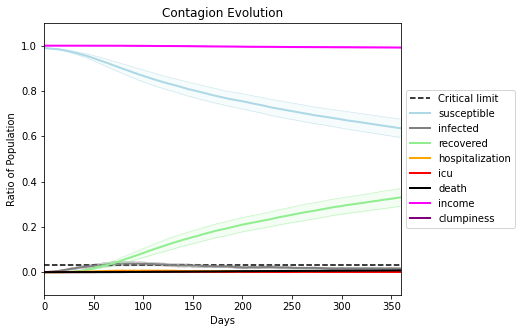

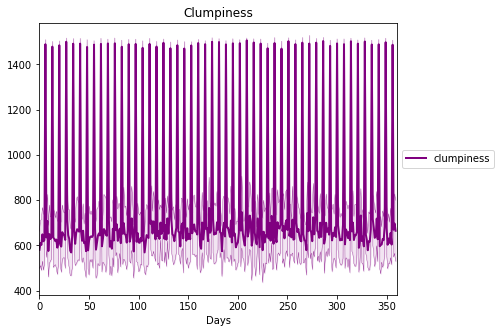

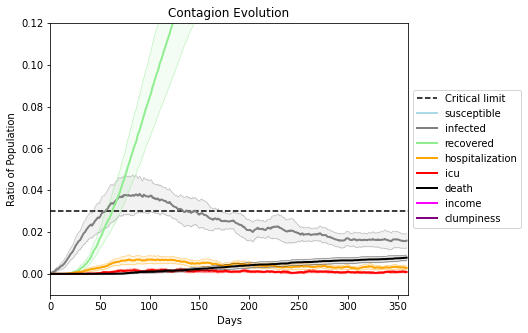

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[989, 5472, 4454, 405, 1744, 2094, 626, 1150, 4999, 5033, 1169, 6403, 8713, 9043, 2763, 525, 8930, 7508, 6430, 3559]
Average similarity between family members is 0.9515372581686138 at temperature -0.997
Average similarity between family and home is 0.9998408593637772 at temperature -1
Average similarity between students and their classroom is 0.9280387452659555 at temperature -0.997
Average classroom occupancy is 1.6768292682926829 and number classrooms is 164
Average similarity between workers is 0.937219390525614 at temperature -0.997
Average office occupancy is 3.521276595744681 and number offices is 188
Average friend similarity for adults: 0.8621574137131699 for kids: 0.7361133850255858
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.6702065665514461
avg restaurant similarity 0.6208782696119225
avg restaurant similarity 0.6118959966202289
avg restaurant similarity 0.650188970097739
avg restaurant similarity 0.6030767327221176
avg restaurant similarity 0.6848778857321882
avg restaurant similarity 0.6588974283798626
avg restaurant similarity 0.6244545979062139
avg restaurant similarity 0.5993687195726822
avg restaurant similarity 0.627608854541702
avg restaurant similarity 0.6733909533966687
avg restaurant similarity 0.5875929525891045
avg restaurant similarity 0.6147322215222679
avg restaurant similarity 0.6029543166199981
avg restaurant similarity 0.567120696616976
avg restaurant similarity 0.6349559815458325
avg restaurant similarity 0.6547927859061956
avg restaurant similarity 0.5805059583342396
avg restaurant similarity 0.6533000624280695
avg restaurant similarity 0.6676799077241414
avg restaurant similarity 0.6214130710733095
avg restaurant similarity 0.5810269685685734
avg restauran

avg restaurant similarity 0.6537719927799593
avg restaurant similarity 0.5984544293122206
avg restaurant similarity 0.6873931491800337
avg restaurant similarity 0.5897410768727075
avg restaurant similarity 0.5926636097583823
avg restaurant similarity 0.6550092597519
avg restaurant similarity 0.6526593059894987
avg restaurant similarity 0.620312783990574
avg restaurant similarity 0.5688553044749012
avg restaurant similarity 0.625142877954874
avg restaurant similarity 0.5994175903421772
avg restaurant similarity 0.5965869126595784
avg restaurant similarity 0.6225277720894938
avg restaurant similarity 0.6112528150434728
avg restaurant similarity 0.6461588814664977
avg restaurant similarity 0.5734025290924196
avg restaurant similarity 0.5816325108551982
avg restaurant similarity 0.6000606796631373
avg restaurant similarity 0.5759211697712231
avg restaurant similarity 0.6243245396702746
avg restaurant similarity 0.6999322980205017
avg restaurant similarity 0.6446588204080799
avg restaurant 

Average similarity between workers is 0.9363463036180899 at temperature -0.997
Average office occupancy is 3.5520833333333335 and number offices is 192
Average friend similarity for adults: 0.8610301270821819 for kids: 0.7285667334507986
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 8 people.
Total of

avg restaurant similarity 0.5655617808023545
avg restaurant similarity 0.6010835779971343
avg restaurant similarity 0.5883253169715182
avg restaurant similarity 0.6158901055377611
avg restaurant similarity 0.6592048082444916
avg restaurant similarity 0.6023017819833358
avg restaurant similarity 0.5893739035212688
avg restaurant similarity 0.5984430981824844
avg restaurant similarity 0.6196592996202196
avg restaurant similarity 0.5966214362750463
avg restaurant similarity 0.6198360075987223
avg restaurant similarity 0.6478633684027715
avg restaurant similarity 0.6231150263630564
avg restaurant similarity 0.5920480894282553
avg restaurant similarity 0.616781105931654
avg restaurant similarity 0.5878751827306143
avg restaurant similarity 0.604310644318859
avg restaurant similarity 0.6451148951671166
avg restaurant similarity 0.5882198011321237
avg restaurant similarity 0.5970607776099929
avg restaurant similarity 0.6339460833606971
avg restaurant similarity 0.6229641586948831
avg restaura

avg restaurant similarity 0.5580754278602071
avg restaurant similarity 0.6231931785835937
avg restaurant similarity 0.5927132556352707
avg restaurant similarity 0.5985363732814897
avg restaurant similarity 0.6620468485536372
avg restaurant similarity 0.6406592237622343
avg restaurant similarity 0.5940474755910711
avg restaurant similarity 0.5779279523656944
avg restaurant similarity 0.6050899978965313
avg restaurant similarity 0.6315011034198178
avg restaurant similarity 0.6384582296339731
avg restaurant similarity 0.635371466108954
avg restaurant similarity 0.5913314597345946
avg restaurant similarity 0.6009512373721875
avg restaurant similarity 0.6486483810419047
avg restaurant similarity 0.6205176814485338
avg restaurant similarity 0.5965484348726879
avg restaurant similarity 0.5972415529795304
avg restaurant similarity 0.5772498316509117
avg restaurant similarity 0.6439318793505556
avg restaurant similarity 0.6149341514438593
avg restaurant similarity 0.5873642575109179
avg restaur

Average similarity between workers is 0.9463441884434964 at temperature -0.997
Average office occupancy is 3.2346938775510203 and number offices is 196
Average friend similarity for adults: 0.8563594854938222 for kids: 0.7392491931816955
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peo

avg restaurant similarity 0.5867569688179565
avg restaurant similarity 0.5955445151873875
avg restaurant similarity 0.6681133925831002
avg restaurant similarity 0.6359569123983172
avg restaurant similarity 0.6418745368936553
avg restaurant similarity 0.6025346057521259
avg restaurant similarity 0.6018238291064204
avg restaurant similarity 0.6796120248474419
avg restaurant similarity 0.645300507972565
avg restaurant similarity 0.5988342162693507
avg restaurant similarity 0.6131609343885434
avg restaurant similarity 0.6453835873208016
avg restaurant similarity 0.6194138268302216
avg restaurant similarity 0.6121533997548017
avg restaurant similarity 0.5857701517877685
avg restaurant similarity 0.5804383010599706
avg restaurant similarity 0.623113604636392
avg restaurant similarity 0.648904769352684
avg restaurant similarity 0.5690445508753212
avg restaurant similarity 0.6426480159954223
avg restaurant similarity 0.6114235161102638
avg restaurant similarity 0.5883690260262519
avg restauran

avg restaurant similarity 0.6043832251682724
avg restaurant similarity 0.5989998828382642
avg restaurant similarity 0.6044468724807641
avg restaurant similarity 0.593610978847731
avg restaurant similarity 0.5819624801008811
avg restaurant similarity 0.6208107674797442
avg restaurant similarity 0.6571532553799286
avg restaurant similarity 0.6403375573368987
avg restaurant similarity 0.5874541044298516
avg restaurant similarity 0.615943546417496
avg restaurant similarity 0.6023426723073584
avg restaurant similarity 0.6108069079315886
avg restaurant similarity 0.6026481621900173
avg restaurant similarity 0.5857167913069172
avg restaurant similarity 0.6469595194823194
avg restaurant similarity 0.6443157763853762
avg restaurant similarity 0.5672391960008084
avg restaurant similarity 0.6198010601068613
avg restaurant similarity 0.5802493616885608
avg restaurant similarity 0.5856872248193279
avg restaurant similarity 0.6190796518860547
avg restaurant similarity 0.621622217785244
avg restauran

Average similarity between workers is 0.9241185358084926 at temperature -0.997
Average office occupancy is 3.4145077720207255 and number offices is 193
Average friend similarity for adults: 0.8568333445481893 for kids: 0.7325758851228927
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6176489349526113
avg restaurant similarity 0.6446522943105651
avg restaurant similarity 0.6200078496949657
avg restaurant similarity 0.6020191303206887
avg restaurant similarity 0.6180731431712992
avg restaurant similarity 0.6480849426622146
avg restaurant similarity 0.632481283939636
avg restaurant similarity 0.6408400203120159
avg restaurant similarity 0.6146089353223614
avg restaurant similarity 0.6713158369056552
avg restaurant similarity 0.6595026391632423
avg restaurant similarity 0.6331081487111311
avg restaurant similarity 0.6226224625753166
avg restaurant similarity 0.6203251637969677
avg restaurant similarity 0.6449857043681659
avg restaurant similarity 0.6136768776601564
avg restaurant similarity 0.591484561039751
avg restaurant similarity 0.6358182791865927
avg restaurant similarity 0.6423204729029117
avg restaurant similarity 0.6052131477453424
avg restaurant similarity 0.593508811533218
avg restaurant similarity 0.6248860883253711
avg restauran

avg restaurant similarity 0.6739196528445455
avg restaurant similarity 0.6294574601972612
avg restaurant similarity 0.6720518992787927
avg restaurant similarity 0.6137529558705056
avg restaurant similarity 0.6428307360766343
avg restaurant similarity 0.612476835916241
avg restaurant similarity 0.6037116124548662
avg restaurant similarity 0.6153522312525276
avg restaurant similarity 0.6161905604365682
avg restaurant similarity 0.6628169056775185
avg restaurant similarity 0.6314590592738765
avg restaurant similarity 0.618382668653489
avg restaurant similarity 0.6154232417642005
avg restaurant similarity 0.6662053667370749
avg restaurant similarity 0.631104841718642
avg restaurant similarity 0.6172041305347269
avg restaurant similarity 0.6328461807423175
avg restaurant similarity 0.6361652762207405
avg restaurant similarity 0.6574469928275515
avg restaurant similarity 0.6603251510369709
avg restaurant similarity 0.6485337619885714
avg restaurant similarity 0.6251930663827089
avg restauran

Average similarity between workers is 0.9192902774973102 at temperature -0.997
Average office occupancy is 3.4635416666666665 and number offices is 192
Average friend similarity for adults: 0.856211036484112 for kids: 0.7207782796110188
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 

avg restaurant similarity 0.5908402616484897
avg restaurant similarity 0.6664409560056263
avg restaurant similarity 0.6580012342144621
avg restaurant similarity 0.651550017298733
avg restaurant similarity 0.6529201216232772
avg restaurant similarity 0.6478495050669971
avg restaurant similarity 0.5908334041511729
avg restaurant similarity 0.6457214915135627
avg restaurant similarity 0.6641751089463791
avg restaurant similarity 0.6476039518061198
avg restaurant similarity 0.6532435536608953
avg restaurant similarity 0.6481171615886693
avg restaurant similarity 0.6520330168009983
avg restaurant similarity 0.6500082491985893
avg restaurant similarity 0.6076859044033927
avg restaurant similarity 0.6870094377361821
avg restaurant similarity 0.666179240355532
avg restaurant similarity 0.672499158450723
avg restaurant similarity 0.6381858440445806
avg restaurant similarity 0.6220005654960111
avg restaurant similarity 0.5971266363749865
avg restaurant similarity 0.6248223749844929
avg restauran

avg restaurant similarity 0.5835419435808099
avg restaurant similarity 0.641059099297714
avg restaurant similarity 0.6687148914208142
avg restaurant similarity 0.6685079814437775
avg restaurant similarity 0.5796755778759481
avg restaurant similarity 0.6615182933643143
avg restaurant similarity 0.6225161730574013
avg restaurant similarity 0.6089110540235727
avg restaurant similarity 0.5809223453897037
avg restaurant similarity 0.6093445125690397
avg restaurant similarity 0.6274277111516409
avg restaurant similarity 0.5684036643167061
avg restaurant similarity 0.617698080176065
avg restaurant similarity 0.6280584082885807
avg restaurant similarity 0.5855365296768771
avg restaurant similarity 0.6290780479852794
avg restaurant similarity 0.6051252562013865
avg restaurant similarity 0.6731489792357709
avg restaurant similarity 0.6440922471318418
avg restaurant similarity 0.6191631518552528
avg restaurant similarity 0.6210683969311505
avg restaurant similarity 0.6077376845082091
avg restaura

Average similarity between workers is 0.9178623807665867 at temperature -0.997
Average office occupancy is 3.5520833333333335 and number offices is 192
Average friend similarity for adults: 0.8637165953633835 for kids: 0.7284229159537555
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13

avg restaurant similarity 0.576079936872846
avg restaurant similarity 0.5241800687656201
avg restaurant similarity 0.5459098540269858
avg restaurant similarity 0.645676209867013
avg restaurant similarity 0.5747925400026888
avg restaurant similarity 0.6107943624046613
avg restaurant similarity 0.5702363006050376
avg restaurant similarity 0.5955660141349765
avg restaurant similarity 0.6325329808046461
avg restaurant similarity 0.5832999122201176
avg restaurant similarity 0.5790654406938432
avg restaurant similarity 0.6299446093177976
avg restaurant similarity 0.5814438578919268
avg restaurant similarity 0.6159286607980332
avg restaurant similarity 0.551004393236122
avg restaurant similarity 0.5268728330833669
avg restaurant similarity 0.5738621857277092
avg restaurant similarity 0.5553078916632711
avg restaurant similarity 0.6065790491850365
avg restaurant similarity 0.607630974702972
avg restaurant similarity 0.6113504840804609
avg restaurant similarity 0.5810481920332458
avg restaurant

avg restaurant similarity 0.5830070421199525
avg restaurant similarity 0.6198350336100511
avg restaurant similarity 0.5248324582375856
avg restaurant similarity 0.5930559074107132
avg restaurant similarity 0.6028447354370741
avg restaurant similarity 0.6107942623259175
avg restaurant similarity 0.5413134346856732
avg restaurant similarity 0.5714066578972536
avg restaurant similarity 0.5663047878451695
avg restaurant similarity 0.5618765274719261
avg restaurant similarity 0.5947402430704749
avg restaurant similarity 0.6281164757027663
avg restaurant similarity 0.6293233965307915
avg restaurant similarity 0.58863622541554
avg restaurant similarity 0.6283452793403798
avg restaurant similarity 0.615709127381588
avg restaurant similarity 0.6094846342181477
avg restaurant similarity 0.5927181125214299
avg restaurant similarity 0.5584610750766869
avg restaurant similarity 0.615639193852447
avg restaurant similarity 0.5476426674428398
avg restaurant similarity 0.5856554839907361
avg restaurant

Average similarity between workers is 0.9340960295122315 at temperature -0.997
Average office occupancy is 3.4615384615384617 and number offices is 195
Average friend similarity for adults: 0.8641126673399036 for kids: 0.7256374449816989
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.658291194390784
avg restaurant similarity 0.6198917125387183
avg restaurant similarity 0.6772771341365447
avg restaurant similarity 0.6746198591086334
avg restaurant similarity 0.6274878014749882
avg restaurant similarity 0.6976120088739476
avg restaurant similarity 0.6976465775444788
avg restaurant similarity 0.6652608097840109
avg restaurant similarity 0.6856516644120265
avg restaurant similarity 0.7087315754265717
avg restaurant similarity 0.6038629211677274
avg restaurant similarity 0.6601091779312861
avg restaurant similarity 0.629155340183244
avg restaurant similarity 0.6450445871316495
avg restaurant similarity 0.6811952734674437
avg restaurant similarity 0.6678531019513938
avg restaurant similarity 0.7110622041109259
avg restaurant similarity 0.6695045975487246
avg restaurant similarity 0.656196242803914
avg restaurant similarity 0.6655698687198289
avg restaurant similarity 0.6756862175374526
avg restaurant similarity 0.6655005180193106
avg restauran

avg restaurant similarity 0.6418824922876449
avg restaurant similarity 0.6512442424125723
avg restaurant similarity 0.6759521955406183
avg restaurant similarity 0.6174404020934671
avg restaurant similarity 0.6555087909050733
avg restaurant similarity 0.6700071354244831
avg restaurant similarity 0.6652683207993373
avg restaurant similarity 0.6889599400510492
avg restaurant similarity 0.6874327868871337
avg restaurant similarity 0.6262731128061768
avg restaurant similarity 0.6984822384668689
avg restaurant similarity 0.6211532968680286
avg restaurant similarity 0.6859827456912851
avg restaurant similarity 0.6752055045191899
avg restaurant similarity 0.679247165673547
avg restaurant similarity 0.6128940632123999
avg restaurant similarity 0.6167631506831894
avg restaurant similarity 0.6474593182927607
avg restaurant similarity 0.6793739063580302
avg restaurant similarity 0.6709417259446682
avg restaurant similarity 0.6508139699838436
avg restaurant similarity 0.6536016838112452
avg restaur

Average similarity between workers is 0.9187460577836576 at temperature -0.997
Average office occupancy is 3.4526315789473685 and number offices is 190
Average friend similarity for adults: 0.8543894439368765 for kids: 0.7507914985777109
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total o

avg restaurant similarity 0.6819206553781835
avg restaurant similarity 0.6436489940181157
avg restaurant similarity 0.6821985786919197
avg restaurant similarity 0.5883324861761322
avg restaurant similarity 0.6377677842837948
avg restaurant similarity 0.6737902460100537
avg restaurant similarity 0.6757369127162244
avg restaurant similarity 0.6597730857647623
avg restaurant similarity 0.6102510639934717
avg restaurant similarity 0.6528742470693254
avg restaurant similarity 0.6400185565870062
avg restaurant similarity 0.6567200770793823
avg restaurant similarity 0.6182010944955507
avg restaurant similarity 0.6527111535525947
avg restaurant similarity 0.6138713397688815
avg restaurant similarity 0.6443717267335634
avg restaurant similarity 0.5916338226827786
avg restaurant similarity 0.6214152498820743
avg restaurant similarity 0.6236913698690169
avg restaurant similarity 0.5921116939987903
avg restaurant similarity 0.6309438977493813
avg restaurant similarity 0.6377690887578779
avg restau

avg restaurant similarity 0.6705529730146933
avg restaurant similarity 0.6725342512803146
avg restaurant similarity 0.6658425273145193
avg restaurant similarity 0.6788220951687988
avg restaurant similarity 0.6094453467331534
avg restaurant similarity 0.6368007190350786
avg restaurant similarity 0.6487613823229393
avg restaurant similarity 0.6460435986932114
avg restaurant similarity 0.7022518723203882
avg restaurant similarity 0.6457482871342263
avg restaurant similarity 0.635713035340877
avg restaurant similarity 0.6300106997924952
avg restaurant similarity 0.6067330905322342
avg restaurant similarity 0.650243143512345
avg restaurant similarity 0.593300745403154
avg restaurant similarity 0.6442585534743425
avg restaurant similarity 0.6539325965173851
avg restaurant similarity 0.6589321113565887
avg restaurant similarity 0.6289037951426402
avg restaurant similarity 0.6164731496376278
avg restaurant similarity 0.6342690152713103
avg restaurant similarity 0.6529533670035478
avg restauran

Average similarity between workers is 0.9338903610104573 at temperature -0.997
Average office occupancy is 3.4564102564102566 and number offices is 195
Average friend similarity for adults: 0.8622742993622933 for kids: 0.7380611654128312
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.6497775088322987
avg restaurant similarity 0.6389076935187882
avg restaurant similarity 0.6938107036647286
avg restaurant similarity 0.6776347394534692
avg restaurant similarity 0.6253305085093397
avg restaurant similarity 0.6456175600569569
avg restaurant similarity 0.5762769888230262
avg restaurant similarity 0.6449963226984947
avg restaurant similarity 0.6572334257840579
avg restaurant similarity 0.625270787156975
avg restaurant similarity 0.6255358939896529
avg restaurant similarity 0.6329926096585583
avg restaurant similarity 0.6782554466163382
avg restaurant similarity 0.6630100748070991
avg restaurant similarity 0.6560192567976112
avg restaurant similarity 0.6073134917508002
avg restaurant similarity 0.6243584802477421
avg restaurant similarity 0.613785484814311
avg restaurant similarity 0.6812583050300945
avg restaurant similarity 0.6282985816348042
avg restaurant similarity 0.6436723269662842
avg restaurant similarity 0.600789201164561
avg restauran

avg restaurant similarity 0.655647398721548
avg restaurant similarity 0.6750347175457511
avg restaurant similarity 0.6282268844653233
avg restaurant similarity 0.6545103623912365
avg restaurant similarity 0.6193175747880858
avg restaurant similarity 0.6212235806767032
avg restaurant similarity 0.6797206998994424
avg restaurant similarity 0.6431964191002871
avg restaurant similarity 0.6340270562260838
avg restaurant similarity 0.6720191451141254
avg restaurant similarity 0.6176589133829956
avg restaurant similarity 0.6612777668443452
avg restaurant similarity 0.6679195804722846
avg restaurant similarity 0.602853844942828
avg restaurant similarity 0.6797851989300108
avg restaurant similarity 0.6846893383993092
avg restaurant similarity 0.6581329149396637
avg restaurant similarity 0.6694967959163961
avg restaurant similarity 0.6403520950799848
avg restaurant similarity 0.6657445172360588
avg restaurant similarity 0.6091139713748749
avg restaurant similarity 0.6557824590880657
avg restaura

Average similarity between workers is 0.9194018374525845 at temperature -0.997
Average office occupancy is 3.445026178010471 and number offices is 191
Average friend similarity for adults: 0.8575988470160442 for kids: 0.7437499431958332
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6020497471954942
avg restaurant similarity 0.6464608289159046
avg restaurant similarity 0.5997612799287135
avg restaurant similarity 0.6227329643812877
avg restaurant similarity 0.6145559091865151
avg restaurant similarity 0.6725723987762664
avg restaurant similarity 0.6235171408204012
avg restaurant similarity 0.6484017204641358
avg restaurant similarity 0.6062759737966618
avg restaurant similarity 0.6414166764880902
avg restaurant similarity 0.613683118219481
avg restaurant similarity 0.6233809459090145
avg restaurant similarity 0.6703530490120719
avg restaurant similarity 0.6281172409132958
avg restaurant similarity 0.6651923811001403
avg restaurant similarity 0.6515263213824826
avg restaurant similarity 0.624365231457733
avg restaurant similarity 0.6491277605214141
avg restaurant similarity 0.6068459185612949
avg restaurant similarity 0.6090357513758576
avg restaurant similarity 0.6578126886217054
avg restaurant similarity 0.6097658831312323
avg restaura

avg restaurant similarity 0.6356710148110064
avg restaurant similarity 0.6444712705654269
avg restaurant similarity 0.6836524427091957
avg restaurant similarity 0.6485825981920694
avg restaurant similarity 0.5741647314346955
avg restaurant similarity 0.6507541830498318
avg restaurant similarity 0.6229034797017697
avg restaurant similarity 0.6531982517146643
avg restaurant similarity 0.6260402729644404
avg restaurant similarity 0.5742383273550056
avg restaurant similarity 0.6071523422175158
avg restaurant similarity 0.5972271649331589
avg restaurant similarity 0.5801013410913064
avg restaurant similarity 0.6070305267325652
avg restaurant similarity 0.6143640460897066
avg restaurant similarity 0.6384379361842304
avg restaurant similarity 0.6213563872838934
avg restaurant similarity 0.6042036099356086
avg restaurant similarity 0.577522692605348
avg restaurant similarity 0.6166141770037332
avg restaurant similarity 0.6299373638037241
avg restaurant similarity 0.6525715274713945
avg restaur

Average similarity between workers is 0.9265896110781789 at temperature -0.997
Average office occupancy is 3.303030303030303 and number offices is 198
Average friend similarity for adults: 0.8649884373285227 for kids: 0.7393109179628319
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.5878069856865332
avg restaurant similarity 0.6779367836045933
avg restaurant similarity 0.6128860107090819
avg restaurant similarity 0.6111429532078593
avg restaurant similarity 0.6270527302992233
avg restaurant similarity 0.5990811373067452
avg restaurant similarity 0.6260931939613481
avg restaurant similarity 0.6369353276793899
avg restaurant similarity 0.6103884896069794
avg restaurant similarity 0.6307671213232977
avg restaurant similarity 0.6178118425489149
avg restaurant similarity 0.5847838881969157
avg restaurant similarity 0.5569204784728393
avg restaurant similarity 0.6049402565061561
avg restaurant similarity 0.6408889068234692
avg restaurant similarity 0.5918144108997794
avg restaurant similarity 0.5834782795207949
avg restaurant similarity 0.5849948543473966
avg restaurant similarity 0.6124718858049413
avg restaurant similarity 0.6160370945449631
avg restaurant similarity 0.6133394479142829
avg restaurant similarity 0.5487612941370485
avg restau

avg restaurant similarity 0.5595171204689862
avg restaurant similarity 0.5487179809257863
avg restaurant similarity 0.6168731756596914
avg restaurant similarity 0.5785319680378286
avg restaurant similarity 0.6043340991885252
avg restaurant similarity 0.6080476566274577
avg restaurant similarity 0.6150966858226378
avg restaurant similarity 0.6368686099731081
avg restaurant similarity 0.6101901676883357
avg restaurant similarity 0.6519229975171298
avg restaurant similarity 0.5878414497163795
avg restaurant similarity 0.5441539316935295
avg restaurant similarity 0.6209975351815147
avg restaurant similarity 0.6210767692002519
avg restaurant similarity 0.5950674896729221
avg restaurant similarity 0.6566830061054044
avg restaurant similarity 0.5641813320739671
avg restaurant similarity 0.6145632271184505
avg restaurant similarity 0.632678482359609
avg restaurant similarity 0.6519035415676653
avg restaurant similarity 0.5903513705118208
avg restaurant similarity 0.6110521350103969
avg restaur

Average similarity between workers is 0.9265872666703318 at temperature -0.997
Average office occupancy is 3.3821989528795813 and number offices is 191
Average friend similarity for adults: 0.8533106614749176 for kids: 0.7440371451414016
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.6094655108153594
avg restaurant similarity 0.643594895879914
avg restaurant similarity 0.6485610268436369
avg restaurant similarity 0.6400044604147336
avg restaurant similarity 0.6674726821289744
avg restaurant similarity 0.6554876384330982
avg restaurant similarity 0.6182091957277633
avg restaurant similarity 0.625961441889822
avg restaurant similarity 0.6379509613955949
avg restaurant similarity 0.6641213487160316
avg restaurant similarity 0.6349856295895853
avg restaurant similarity 0.7098985987804548
avg restaurant similarity 0.6511537672385409
avg restaurant similarity 0.6391721853938179
avg restaurant similarity 0.624839025712148
avg restaurant similarity 0.6028137183500473
avg restaurant similarity 0.6542503348316375
avg restaurant similarity 0.6362690743447608
avg restaurant similarity 0.6574707195757196
avg restaurant similarity 0.6765809222977472
avg restaurant similarity 0.6506039278182608
avg restaurant similarity 0.5796392904738104
avg restauran

avg restaurant similarity 0.6291582263379268
avg restaurant similarity 0.6563733168917021
avg restaurant similarity 0.6360744286477574
avg restaurant similarity 0.6599392133329557
avg restaurant similarity 0.6186823719327983
avg restaurant similarity 0.6197033861869258
avg restaurant similarity 0.6745532418064834
avg restaurant similarity 0.6451525381497004
avg restaurant similarity 0.6390463586825863
avg restaurant similarity 0.6498268601908275
avg restaurant similarity 0.6482081342621668
avg restaurant similarity 0.6265671006317165
avg restaurant similarity 0.6562447328169813
avg restaurant similarity 0.645023470621925
avg restaurant similarity 0.6805584925846154
avg restaurant similarity 0.6372804862529252
avg restaurant similarity 0.6704195945982427
avg restaurant similarity 0.6695281373715353
avg restaurant similarity 0.5974444959824294
avg restaurant similarity 0.6512735394839498
avg restaurant similarity 0.6331191866460817
avg restaurant similarity 0.6608337687994551
avg restaur

Average similarity between workers is 0.9251942843003903 at temperature -0.997
Average office occupancy is 3.3401015228426396 and number offices is 197
Average friend similarity for adults: 0.8691561123147558 for kids: 0.7552010081891599
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5451765159043573
avg restaurant similarity 0.6242984660072763
avg restaurant similarity 0.6626573252923186
avg restaurant similarity 0.6416708400491162
avg restaurant similarity 0.6093060476677973
avg restaurant similarity 0.600719746251232
avg restaurant similarity 0.6607760801666649
avg restaurant similarity 0.581638871371078
avg restaurant similarity 0.6257936037864277
avg restaurant similarity 0.6106531935513382
avg restaurant similarity 0.613953579085929
avg restaurant similarity 0.6373047678198198
avg restaurant similarity 0.6608994387641319
avg restaurant similarity 0.666721920250172
avg restaurant similarity 0.5976240262165706
avg restaurant similarity 0.6374233524337881
avg restaurant similarity 0.6637780375968142
avg restaurant similarity 0.5995551211361191
avg restaurant similarity 0.616245470400886
avg restaurant similarity 0.6351922821833975
avg restaurant similarity 0.6037068643473934
avg restaurant similarity 0.6474014990169832
avg restaurant 

avg restaurant similarity 0.6394741021641965
avg restaurant similarity 0.6087900942646265
avg restaurant similarity 0.6539566795035863
avg restaurant similarity 0.6844719572994602
avg restaurant similarity 0.659986328013045
avg restaurant similarity 0.6206460393770958
avg restaurant similarity 0.6772092156742251
avg restaurant similarity 0.590355456519204
avg restaurant similarity 0.6240354589063707
avg restaurant similarity 0.6994376934749893
avg restaurant similarity 0.6334804936607196
avg restaurant similarity 0.6618774259291293
avg restaurant similarity 0.6527690703368954
avg restaurant similarity 0.7280938507875
avg restaurant similarity 0.6257493678165185
avg restaurant similarity 0.6171065512484596
avg restaurant similarity 0.6642146361950284
avg restaurant similarity 0.650950556051397
avg restaurant similarity 0.6536568965351301
avg restaurant similarity 0.5936659232173348
avg restaurant similarity 0.6358600203443545
avg restaurant similarity 0.6043000616165672
avg restaurant s

Average similarity between workers is 0.934940314730655 at temperature -0.997
Average office occupancy is 3.3705583756345177 and number offices is 197
Average friend similarity for adults: 0.8626976461510644 for kids: 0.7431069936513541
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.5697080936237072
avg restaurant similarity 0.583868144109841
avg restaurant similarity 0.6036892223239242
avg restaurant similarity 0.5797402739386848
avg restaurant similarity 0.629288708454892
avg restaurant similarity 0.5726436329646558
avg restaurant similarity 0.6282129726851897
avg restaurant similarity 0.5663646759643057
avg restaurant similarity 0.5746386888220978
avg restaurant similarity 0.6214475797912414
avg restaurant similarity 0.6006573932839713
avg restaurant similarity 0.6000674424055827
avg restaurant similarity 0.6302609872905411
avg restaurant similarity 0.6156328331509876
avg restaurant similarity 0.6495996122575444
avg restaurant similarity 0.6467233042259736
avg restaurant similarity 0.6245590125852138
avg restaurant similarity 0.6047366084261178
avg restaurant similarity 0.6373445305812478
avg restaurant similarity 0.6243677298704515
avg restaurant similarity 0.6393857810387737
avg restaurant similarity 0.5998263643477683
avg restaura

avg restaurant similarity 0.6032722832517226
avg restaurant similarity 0.6335134454560529
avg restaurant similarity 0.618063769482686
avg restaurant similarity 0.5945378832066833
avg restaurant similarity 0.6190179771546731
avg restaurant similarity 0.6736238203704331
avg restaurant similarity 0.6369747392918889
avg restaurant similarity 0.5795926409717368
avg restaurant similarity 0.6679696380161556
avg restaurant similarity 0.5995696799687374
avg restaurant similarity 0.6736214201917546
avg restaurant similarity 0.5638076961227725
avg restaurant similarity 0.5683772924906513
avg restaurant similarity 0.6154299399169548
avg restaurant similarity 0.618254014444054
avg restaurant similarity 0.6708602113796918
avg restaurant similarity 0.6034741888415833
avg restaurant similarity 0.6562030045441964
avg restaurant similarity 0.5937821297306063
avg restaurant similarity 0.6213843293246686
avg restaurant similarity 0.6090028333573739
avg restaurant similarity 0.65672456154957
avg restaurant

Average similarity between workers is 0.9319839031805297 at temperature -0.997
Average office occupancy is 3.36734693877551 and number offices is 196
Average friend similarity for adults: 0.8574292715286157 for kids: 0.7454223891637206
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.6038300506756615
avg restaurant similarity 0.6205925460314262
avg restaurant similarity 0.6209774623993137
avg restaurant similarity 0.6324012635465333
avg restaurant similarity 0.5784378570809521
avg restaurant similarity 0.6062256484429605
avg restaurant similarity 0.6425891313274316
avg restaurant similarity 0.5956764649912358
avg restaurant similarity 0.6121324420226102
avg restaurant similarity 0.6165302976729715
avg restaurant similarity 0.5798343786870395
avg restaurant similarity 0.5970948588341634
avg restaurant similarity 0.6358293940472995
avg restaurant similarity 0.6060627703220679
avg restaurant similarity 0.647721782689717
avg restaurant similarity 0.6591866410137924
avg restaurant similarity 0.6208128111157185
avg restaurant similarity 0.6011903083485389
avg restaurant similarity 0.6174709392779398
avg restaurant similarity 0.6425727010640739
avg restaurant similarity 0.6077983616938571
avg restaurant similarity 0.6291246621092987
avg restaur

avg restaurant similarity 0.6430634997209022
avg restaurant similarity 0.6284774241814165
avg restaurant similarity 0.609316914105744
avg restaurant similarity 0.617133529669306
avg restaurant similarity 0.6672410980055296
avg restaurant similarity 0.6298243807669646
avg restaurant similarity 0.59539125587159
avg restaurant similarity 0.6170579538737443
avg restaurant similarity 0.6163063752238922
avg restaurant similarity 0.6188976114760962
avg restaurant similarity 0.6554092386600866
avg restaurant similarity 0.6360979954440142
avg restaurant similarity 0.6215880932520351
avg restaurant similarity 0.6148454234692217
avg restaurant similarity 0.6588058556264629
avg restaurant similarity 0.62305066724507
avg restaurant similarity 0.6181834612160734
avg restaurant similarity 0.6529772838273552
avg restaurant similarity 0.6225274593998665
avg restaurant similarity 0.6484867934339895
avg restaurant similarity 0.612844478280347
avg restaurant similarity 0.6720925525533784
avg restaurant si

Average similarity between workers is 0.9292576476625641 at temperature -0.997
Average office occupancy is 3.378238341968912 and number offices is 193
Average friend similarity for adults: 0.8610382040233182 for kids: 0.7405174115979257
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6067882689684965
avg restaurant similarity 0.6733237489774504
avg restaurant similarity 0.626057264441558
avg restaurant similarity 0.5981771978179355
avg restaurant similarity 0.6230401651047701
avg restaurant similarity 0.5341124055437755
avg restaurant similarity 0.5737992438171552
avg restaurant similarity 0.6757496653990077
avg restaurant similarity 0.6131267797276777
avg restaurant similarity 0.6351399178485875
avg restaurant similarity 0.6242347623132918
avg restaurant similarity 0.6147528901945116
avg restaurant similarity 0.6030467485054454
avg restaurant similarity 0.5945681895947279
avg restaurant similarity 0.6083618981405126
avg restaurant similarity 0.5882686921477842
avg restaurant similarity 0.6121193060744006
avg restaurant similarity 0.5759517335812336
avg restaurant similarity 0.6581933577890611
avg restaurant similarity 0.5640904611958816
avg restaurant similarity 0.6337434034872955
avg restaurant similarity 0.5878777122996445
avg restaur

avg restaurant similarity 0.6211597196080485
avg restaurant similarity 0.6314683708131479
avg restaurant similarity 0.5969788478781529
avg restaurant similarity 0.6403715892491242
avg restaurant similarity 0.6487656317409644
avg restaurant similarity 0.6346573923580271
avg restaurant similarity 0.6212280507656678
avg restaurant similarity 0.591542560650604
avg restaurant similarity 0.6021269672809422
avg restaurant similarity 0.6624999683069753
avg restaurant similarity 0.5757167037647882
avg restaurant similarity 0.6225625865076162
avg restaurant similarity 0.6070254821601461
avg restaurant similarity 0.5878778567045199
avg restaurant similarity 0.6013301503285898
avg restaurant similarity 0.6334065728888862
avg restaurant similarity 0.5615900836868979
avg restaurant similarity 0.5825334159023836
avg restaurant similarity 0.6248618582340543
avg restaurant similarity 0.6093071103095266
avg restaurant similarity 0.5665111649809035
avg restaurant similarity 0.613223122461226
avg restaura

Average similarity between workers is 0.9417274524835428 at temperature -0.997
Average office occupancy is 3.443877551020408 and number offices is 196
Average friend similarity for adults: 0.863301521719433 for kids: 0.7325847816980342
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5982043646050852
avg restaurant similarity 0.602497623390078
avg restaurant similarity 0.621702614009555
avg restaurant similarity 0.634458683945972
avg restaurant similarity 0.6594660568481431
avg restaurant similarity 0.6565577519039818
avg restaurant similarity 0.6006492192049143
avg restaurant similarity 0.6190947014718757
avg restaurant similarity 0.6376079285701348
avg restaurant similarity 0.6198735665120017
avg restaurant similarity 0.6671713143346417
avg restaurant similarity 0.6813250215412904
avg restaurant similarity 0.605752961631236
avg restaurant similarity 0.5807503083707729
avg restaurant similarity 0.69392934261213
avg restaurant similarity 0.5987215722936207
avg restaurant similarity 0.6259345125893865
avg restaurant similarity 0.5600452280681868
avg restaurant similarity 0.6069161741645676
avg restaurant similarity 0.6202154816956591
avg restaurant similarity 0.6211611028430329
avg restaurant similarity 0.6116507195381402
avg restaurant s

avg restaurant similarity 0.6627625560341693
avg restaurant similarity 0.6579340200801316
avg restaurant similarity 0.6592574481142494
avg restaurant similarity 0.6057490570608274
avg restaurant similarity 0.6142993169140205
avg restaurant similarity 0.6749907064905178
avg restaurant similarity 0.6134168816054838
avg restaurant similarity 0.6239122828369122
avg restaurant similarity 0.6149794851635578
avg restaurant similarity 0.5706720827269506
avg restaurant similarity 0.6512407547430115
avg restaurant similarity 0.6264020170961305
avg restaurant similarity 0.6243969228922541
avg restaurant similarity 0.6214482421225003
avg restaurant similarity 0.6355984431060645
avg restaurant similarity 0.5698042559741252
avg restaurant similarity 0.6403372770826018
avg restaurant similarity 0.6119713596246884
avg restaurant similarity 0.6233973041315843
avg restaurant similarity 0.649653401977403
avg restaurant similarity 0.5734236288569841
avg restaurant similarity 0.6271472092691455
avg restaur

Average similarity between workers is 0.9321642458366884 at temperature -0.997
Average office occupancy is 3.2676767676767677 and number offices is 198
Average friend similarity for adults: 0.8555965175028775 for kids: 0.7522210164459265
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total o

avg restaurant similarity 0.5733489735321121
avg restaurant similarity 0.5782478026556853
avg restaurant similarity 0.5945297167036133
avg restaurant similarity 0.613332480451897
avg restaurant similarity 0.6391262446859779
avg restaurant similarity 0.5986461164552581
avg restaurant similarity 0.6171078155951614
avg restaurant similarity 0.6214631977849536
avg restaurant similarity 0.6443493816254723
avg restaurant similarity 0.5927391972833521
avg restaurant similarity 0.6297736633422644
avg restaurant similarity 0.6355663028301342
avg restaurant similarity 0.6676937437682715
avg restaurant similarity 0.5849147373156214
avg restaurant similarity 0.5883770951495536
avg restaurant similarity 0.5843148022779433
avg restaurant similarity 0.5964156707515119
avg restaurant similarity 0.6258927714803891
avg restaurant similarity 0.6964794013469642
avg restaurant similarity 0.5957432850006658
avg restaurant similarity 0.6439384287293213
avg restaurant similarity 0.5793151890889012
avg restaur

avg restaurant similarity 0.6078263897482625
avg restaurant similarity 0.6320104356190502
avg restaurant similarity 0.5293389002411094
avg restaurant similarity 0.6207233202962832
avg restaurant similarity 0.5880386586197713
avg restaurant similarity 0.5883534778478341
avg restaurant similarity 0.5548309666687511
avg restaurant similarity 0.5824161783206734
avg restaurant similarity 0.5363177536607591
avg restaurant similarity 0.566903059207104
avg restaurant similarity 0.612390953837416
avg restaurant similarity 0.5705190577720632
avg restaurant similarity 0.5557947880587855
avg restaurant similarity 0.586043006066521
avg restaurant similarity 0.5864448626856866
avg restaurant similarity 0.5830936178983577
avg restaurant similarity 0.6404414378940703
avg restaurant similarity 0.5901706886213316
avg restaurant similarity 0.6162566380893739
avg restaurant similarity 0.537493095074974
avg restaurant similarity 0.544296090974224
avg restaurant similarity 0.5095408388910562
avg restaurant 

Average similarity between workers is 0.917508327346601 at temperature -0.997
Average office occupancy is 3.4705882352941178 and number offices is 187
Average friend similarity for adults: 0.853837683235076 for kids: 0.7257583126565242
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13

avg restaurant similarity 0.5724134246447943
avg restaurant similarity 0.5679110431431872
avg restaurant similarity 0.6206802666866497
avg restaurant similarity 0.613909434609657
avg restaurant similarity 0.5934482525898296
avg restaurant similarity 0.5757331739407686
avg restaurant similarity 0.5604864125112343
avg restaurant similarity 0.6455664795455894
avg restaurant similarity 0.6181559659530375
avg restaurant similarity 0.6074481196014946
avg restaurant similarity 0.6249789663366554
avg restaurant similarity 0.6010917661610482
avg restaurant similarity 0.5860304830815753
avg restaurant similarity 0.6049669855700319
avg restaurant similarity 0.618224071112889
avg restaurant similarity 0.6441647897656978
avg restaurant similarity 0.5948150180415807
avg restaurant similarity 0.6377131472678551
avg restaurant similarity 0.6221023850221856
avg restaurant similarity 0.6545640152391917
avg restaurant similarity 0.5767254909790752
avg restaurant similarity 0.6583043489603473
avg restaura

avg restaurant similarity 0.6147121254781917
avg restaurant similarity 0.6099085009931942
avg restaurant similarity 0.6556946083983444
avg restaurant similarity 0.6168919392323994
avg restaurant similarity 0.6578471792487204
avg restaurant similarity 0.6396825232447992
avg restaurant similarity 0.5453983300589622
avg restaurant similarity 0.6236633439279577
avg restaurant similarity 0.5882857989283807
avg restaurant similarity 0.5893598060772414
avg restaurant similarity 0.6303269394201866
avg restaurant similarity 0.5956760355249321
avg restaurant similarity 0.5990848633340742
avg restaurant similarity 0.6010906567683396
avg restaurant similarity 0.6233562588432908
avg restaurant similarity 0.5812099526276716
avg restaurant similarity 0.6295479378938703
avg restaurant similarity 0.611101190638552
avg restaurant similarity 0.6467498429718772
avg restaurant similarity 0.6330625648204014
avg restaurant similarity 0.632783290795408
avg restaurant similarity 0.5815386150592406
avg restaura

Average similarity between workers is 0.9285212938858783 at temperature -0.997
Average office occupancy is 3.518134715025907 and number offices is 193
Average friend similarity for adults: 0.8581534302972383 for kids: 0.7236639746819572
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.6551249968367047
avg restaurant similarity 0.6057018495219796
avg restaurant similarity 0.6721127182142956
avg restaurant similarity 0.6280994359071528
avg restaurant similarity 0.5993917372137694
avg restaurant similarity 0.6226136270562915
avg restaurant similarity 0.6210024296890225
avg restaurant similarity 0.5976628779507233
avg restaurant similarity 0.6095595812742561
avg restaurant similarity 0.6821837159286906
avg restaurant similarity 0.6236618913882895
avg restaurant similarity 0.5933318553607874
avg restaurant similarity 0.6224977073796953
avg restaurant similarity 0.6042850972042022
avg restaurant similarity 0.6264421453125225
avg restaurant similarity 0.6022420594787796
avg restaurant similarity 0.5957941319260339
avg restaurant similarity 0.6206973924550776
avg restaurant similarity 0.6023217410977316
avg restaurant similarity 0.6130720929287716
avg restaurant similarity 0.5973619991284436
avg restaurant similarity 0.6291061405790438
avg restau

avg restaurant similarity 0.6025389778123347
avg restaurant similarity 0.6217740611276095
avg restaurant similarity 0.640175376019813
avg restaurant similarity 0.6279981873069431
avg restaurant similarity 0.6379350917946353
avg restaurant similarity 0.5985192493510584
avg restaurant similarity 0.6230903066712827
avg restaurant similarity 0.577538850990634
avg restaurant similarity 0.6385964051757099
avg restaurant similarity 0.6234105654408061
avg restaurant similarity 0.6581237371188685
avg restaurant similarity 0.6470208484041573
avg restaurant similarity 0.6158859427708799
avg restaurant similarity 0.6243272645102462
avg restaurant similarity 0.5975828310792424
avg restaurant similarity 0.6291759688281388
avg restaurant similarity 0.667771537244706
avg restaurant similarity 0.6655780161856882
avg restaurant similarity 0.6343622164915723
avg restaurant similarity 0.6004991609413332
avg restaurant similarity 0.5843480723509388
avg restaurant similarity 0.6372107612859872
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

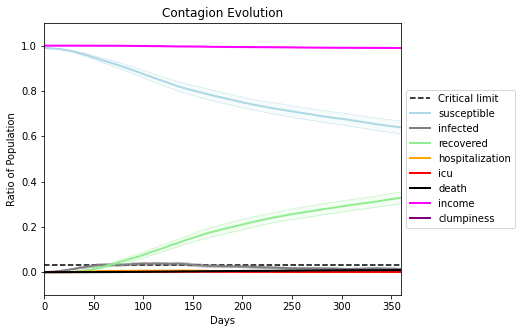

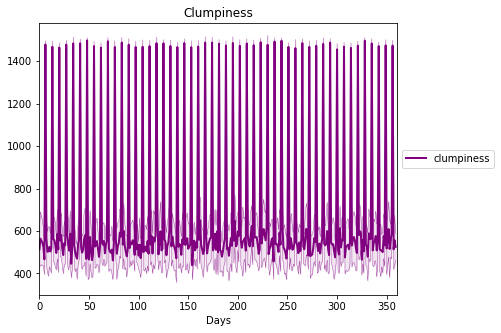

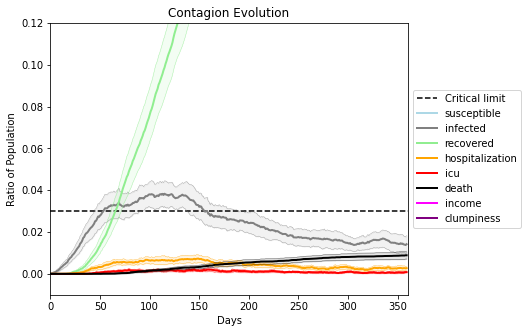

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6748, 2132, 4119, 6720, 8154, 6766, 4909, 6561, 4655, 565, 9883, 4456, 8720, 3895, 4493, 5243, 9621, 2383, 1071, 6800]
Average similarity between family members is 0.9473938925613817 at temperature -0.996
Average similarity between family and home is 0.9998646218688998 at temperature -1
Average similarity between students and their classroom is 0.9132686006313218 at temperature -0.996
Average classroom occupancy is 1.728813559322034 and number classrooms is 177
Average similarity between workers is 0.9236391983864845 at temperature -0.996
Average office occupancy is 3.4126984126984126 and number offices is 189
Average friend similarity for adults: 0.8488883204918792 for kids: 0.7410823293509086
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.5933333992693965
avg restaurant similarity 0.5991508393370738
avg restaurant similarity 0.5685409092877244
avg restaurant similarity 0.6106408348376182
avg restaurant similarity 0.6034824450004947
avg restaurant similarity 0.6410786783621424
avg restaurant similarity 0.6331017585916656
avg restaurant similarity 0.5948826843870736
avg restaurant similarity 0.612245124844952
avg restaurant similarity 0.6397954421098025
avg restaurant similarity 0.6427776463191419
avg restaurant similarity 0.5985680061361788
avg restaurant similarity 0.5784836869302121
avg restaurant similarity 0.6643605611878995
avg restaurant similarity 0.6191411583054909
avg restaurant similarity 0.601045082540618
avg restaurant similarity 0.5922995263144673
avg restaurant similarity 0.6417616270973201
avg restaurant similarity 0.6609145640909574
avg restaurant similarity 0.6426011408427855
avg restaurant similarity 0.5617011731500321
avg restaurant similarity 0.6067372607165863
avg restaura

avg restaurant similarity 0.549880721498503
avg restaurant similarity 0.6369099464859187
avg restaurant similarity 0.6277602602728997
avg restaurant similarity 0.5978990833119807
avg restaurant similarity 0.6288307794163691
avg restaurant similarity 0.5800040529411913
avg restaurant similarity 0.5896008054334569
avg restaurant similarity 0.6278917680973655
avg restaurant similarity 0.647147104920513
avg restaurant similarity 0.6253084590409108
avg restaurant similarity 0.6011474608010591
avg restaurant similarity 0.5873583617791773
avg restaurant similarity 0.6424659810756158
avg restaurant similarity 0.6387321177488418
avg restaurant similarity 0.6392509750620018
avg restaurant similarity 0.6063927525435477
avg restaurant similarity 0.6487369988369482
avg restaurant similarity 0.6358121250086194
avg restaurant similarity 0.5760699995633444
avg restaurant similarity 0.555941839803227
avg restaurant similarity 0.5906800743539518
avg restaurant similarity 0.620960055585303
avg restaurant

Average similarity between workers is 0.9227149118301862 at temperature -0.996
Average office occupancy is 3.5025906735751295 and number offices is 193
Average friend similarity for adults: 0.8555192284362857 for kids: 0.70771561050274
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.6362846210113102
avg restaurant similarity 0.6168673329741738
avg restaurant similarity 0.6030556612609413
avg restaurant similarity 0.6084146147325272
avg restaurant similarity 0.5808959818646764
avg restaurant similarity 0.5711156705580986
avg restaurant similarity 0.5717223417206884
avg restaurant similarity 0.5882320161783019
avg restaurant similarity 0.6223331796831485
avg restaurant similarity 0.6073034213342963
avg restaurant similarity 0.5855398061793712
avg restaurant similarity 0.6150082483613832
avg restaurant similarity 0.5448255140528304
avg restaurant similarity 0.6223414254068436
avg restaurant similarity 0.6243689985144873
avg restaurant similarity 0.6869423337771382
avg restaurant similarity 0.6032194362337845
avg restaurant similarity 0.6183262082729086
avg restaurant similarity 0.657571164298517
avg restaurant similarity 0.6150609707182202
avg restaurant similarity 0.630208131907378
avg restaurant similarity 0.5845703543247978
avg restaura

avg restaurant similarity 0.5853113412963078
avg restaurant similarity 0.5745728909353918
avg restaurant similarity 0.6186884804552044
avg restaurant similarity 0.5677528138120256
avg restaurant similarity 0.589264613863761
avg restaurant similarity 0.6394890776749725
avg restaurant similarity 0.6287982340975605
avg restaurant similarity 0.6089314294240596
avg restaurant similarity 0.628162958090477
avg restaurant similarity 0.5785451418376312
avg restaurant similarity 0.5962959067236008
avg restaurant similarity 0.6018421890500066
avg restaurant similarity 0.5415264238063128
avg restaurant similarity 0.5463768328789069
avg restaurant similarity 0.6109359265519531
avg restaurant similarity 0.6172832577980797
avg restaurant similarity 0.6223313905879209
avg restaurant similarity 0.6025148554946074
avg restaurant similarity 0.6717829399957019
avg restaurant similarity 0.6357390239995111
avg restaurant similarity 0.5946873975276201
avg restaurant similarity 0.6305278826704661
avg restaura

Average similarity between workers is 0.9299490574359724 at temperature -0.996
Average office occupancy is 3.305263157894737 and number offices is 190
Average friend similarity for adults: 0.8495631455828385 for kids: 0.7457535677501744
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of

avg restaurant similarity 0.7032809664115314
avg restaurant similarity 0.5994656277789023
avg restaurant similarity 0.5756874682843633
avg restaurant similarity 0.6907493634280293
avg restaurant similarity 0.5750109064358342
avg restaurant similarity 0.6546174466386996
avg restaurant similarity 0.6242777954977826
avg restaurant similarity 0.6256849399852664
avg restaurant similarity 0.6398056881235742
avg restaurant similarity 0.5898396098513278
avg restaurant similarity 0.6317963755815165
avg restaurant similarity 0.6295778895814403
avg restaurant similarity 0.6891671692338853
avg restaurant similarity 0.6739201381965735
avg restaurant similarity 0.5691972368593405
avg restaurant similarity 0.6397291974488425
avg restaurant similarity 0.6148288788943067
avg restaurant similarity 0.6267547400361646
avg restaurant similarity 0.6145003327291776
avg restaurant similarity 0.6836973263549821
avg restaurant similarity 0.6363029337946775
avg restaurant similarity 0.617943988849491
avg restaur

avg restaurant similarity 0.6493168321715508
avg restaurant similarity 0.6603267043425965
avg restaurant similarity 0.6731587654342883
avg restaurant similarity 0.6153958134680559
avg restaurant similarity 0.5746617727936697
avg restaurant similarity 0.6033359524694317
avg restaurant similarity 0.6794544032322372
avg restaurant similarity 0.6207632197756451
avg restaurant similarity 0.6519618845065766
avg restaurant similarity 0.6982122277755395
avg restaurant similarity 0.6121081598777104
avg restaurant similarity 0.6264968057103983
avg restaurant similarity 0.6046553013030443
avg restaurant similarity 0.5842330676215783
avg restaurant similarity 0.590517159576079
avg restaurant similarity 0.5999894772897107
avg restaurant similarity 0.6289275737234068
avg restaurant similarity 0.6918486481115028
avg restaurant similarity 0.6127986551950594
avg restaurant similarity 0.6149239947479332
avg restaurant similarity 0.5798679469143375
avg restaurant similarity 0.6101303794856698
avg restaur

Average similarity between workers is 0.9276079445071286 at temperature -0.996
Average office occupancy is 3.296875 and number offices is 192
Average friend similarity for adults: 0.8449883284804376 for kids: 0.7476904486195833
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people al

avg restaurant similarity 0.622474267974939
avg restaurant similarity 0.6031507352827858
avg restaurant similarity 0.5974673719549553
avg restaurant similarity 0.5743089853305241
avg restaurant similarity 0.6577430538514811
avg restaurant similarity 0.6046001351064801
avg restaurant similarity 0.609617088526586
avg restaurant similarity 0.6001686061104557
avg restaurant similarity 0.5899495649964495
avg restaurant similarity 0.6066106752148201
avg restaurant similarity 0.5670911594706474
avg restaurant similarity 0.6078735476507151
avg restaurant similarity 0.5583470879471616
avg restaurant similarity 0.5987782635426262
avg restaurant similarity 0.6138763267627058
avg restaurant similarity 0.6413483775718879
avg restaurant similarity 0.5589340706482838
avg restaurant similarity 0.6466816923786614
avg restaurant similarity 0.6153227988315725
avg restaurant similarity 0.5877914946195162
avg restaurant similarity 0.6018370236452556
avg restaurant similarity 0.5982379281062197
avg restaura

avg restaurant similarity 0.5732857216221416
avg restaurant similarity 0.5467138144098918
avg restaurant similarity 0.6824284229432439
avg restaurant similarity 0.6646724252417402
avg restaurant similarity 0.6276466155595333
avg restaurant similarity 0.5917735787347772
avg restaurant similarity 0.6045926295576874
avg restaurant similarity 0.6170946471024923
avg restaurant similarity 0.585574379336032
avg restaurant similarity 0.5966769876734633
avg restaurant similarity 0.6721902985677732
avg restaurant similarity 0.5310340727652965
avg restaurant similarity 0.6545942415445392
avg restaurant similarity 0.6600963342611705
avg restaurant similarity 0.5711592348591883
avg restaurant similarity 0.6071550052042347
avg restaurant similarity 0.5902372519733162
avg restaurant similarity 0.6183463312546215
avg restaurant similarity 0.590620029782682
avg restaurant similarity 0.6019239784919835
avg restaurant similarity 0.5662110513269261
avg restaurant similarity 0.631888288514819
avg restauran

Average similarity between workers is 0.9135745298867008 at temperature -0.996
Average office occupancy is 3.5925925925925926 and number offices is 189
Average friend similarity for adults: 0.863364457283672 for kids: 0.7286905389488845
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.6261895444994436
avg restaurant similarity 0.6598443815542367
avg restaurant similarity 0.5639616356949888
avg restaurant similarity 0.6212076162528398
avg restaurant similarity 0.5926176774939005
avg restaurant similarity 0.5901517395452092
avg restaurant similarity 0.6020621991207612
avg restaurant similarity 0.5864562356278921
avg restaurant similarity 0.5950375458922798
avg restaurant similarity 0.6025626069723172
avg restaurant similarity 0.5899222506303455
avg restaurant similarity 0.6355787618036018
avg restaurant similarity 0.5789495768001157
avg restaurant similarity 0.5581143979626911
avg restaurant similarity 0.5560605518964092
avg restaurant similarity 0.5727355155052604
avg restaurant similarity 0.5903980083870279
avg restaurant similarity 0.5608252129526183
avg restaurant similarity 0.5824157004863353
avg restaurant similarity 0.6126160835092725
avg restaurant similarity 0.6251978865244309
avg restaurant similarity 0.618633248812491
avg restaur

avg restaurant similarity 0.5939912730038022
avg restaurant similarity 0.6189719996287589
avg restaurant similarity 0.6095303156719832
avg restaurant similarity 0.5906301224190036
avg restaurant similarity 0.5880424303771367
avg restaurant similarity 0.6155821992087817
avg restaurant similarity 0.604752475279725
avg restaurant similarity 0.6493749664335907
avg restaurant similarity 0.551526972901233
avg restaurant similarity 0.6098730682778492
avg restaurant similarity 0.6149256431994781
avg restaurant similarity 0.5583747138326467
avg restaurant similarity 0.6318970090598723
avg restaurant similarity 0.612483789097372
avg restaurant similarity 0.6026225709743722
avg restaurant similarity 0.5580561180843069
avg restaurant similarity 0.5954005021482964
avg restaurant similarity 0.6597629256151528
avg restaurant similarity 0.6286150840770771
avg restaurant similarity 0.6331270193454929
avg restaurant similarity 0.5585536136621522
avg restaurant similarity 0.5892683675050393
avg restauran

Average similarity between workers is 0.9368973943137747 at temperature -0.996
Average office occupancy is 3.548223350253807 and number offices is 197
Average friend similarity for adults: 0.8627225915401506 for kids: 0.7153049429329621
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.6178653223266837
avg restaurant similarity 0.6212683453379088
avg restaurant similarity 0.6495473562122959
avg restaurant similarity 0.6744510181097813
avg restaurant similarity 0.6285486453161845
avg restaurant similarity 0.6455083025840639
avg restaurant similarity 0.6235900680216258
avg restaurant similarity 0.6352473534847143
avg restaurant similarity 0.6223492675966364
avg restaurant similarity 0.5974512104438591
avg restaurant similarity 0.6831668087523469
avg restaurant similarity 0.6654277729972117
avg restaurant similarity 0.652626623248177
avg restaurant similarity 0.6626617107562902
avg restaurant similarity 0.6298257960478557
avg restaurant similarity 0.681599185680187
avg restaurant similarity 0.6072892350092505
avg restaurant similarity 0.6322838632455262
avg restaurant similarity 0.6549429405763307
avg restaurant similarity 0.6056135250701711
avg restaurant similarity 0.6580941332048875
avg restaurant similarity 0.6208852867223272
avg restaura

avg restaurant similarity 0.6004253759498039
avg restaurant similarity 0.6642535551844625
avg restaurant similarity 0.6294105909970363
avg restaurant similarity 0.5988399117344263
avg restaurant similarity 0.6004235175229933
avg restaurant similarity 0.6381642128782054
avg restaurant similarity 0.6415015413071599
avg restaurant similarity 0.6684751053664267
avg restaurant similarity 0.6507038983069042
avg restaurant similarity 0.6387769553133672
avg restaurant similarity 0.6630293617902359
avg restaurant similarity 0.626434284028949
avg restaurant similarity 0.6804106555733974
avg restaurant similarity 0.6505003735597669
avg restaurant similarity 0.6454171821441126
avg restaurant similarity 0.6394886871761347
avg restaurant similarity 0.612455323673651
avg restaurant similarity 0.6646836869432509
avg restaurant similarity 0.6728755595420568
avg restaurant similarity 0.6462988583440126
avg restaurant similarity 0.6537481155741787
avg restaurant similarity 0.6390805658179616
avg restaura

Average similarity between workers is 0.926998686180029 at temperature -0.996
Average office occupancy is 3.288557213930348 and number offices is 201
Average friend similarity for adults: 0.8484076245796214 for kids: 0.7304605028738318
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.6115971721982406
avg restaurant similarity 0.5880301552571554
avg restaurant similarity 0.5674949030368355
avg restaurant similarity 0.6374482871977385
avg restaurant similarity 0.6294893229068087
avg restaurant similarity 0.6410416338987429
avg restaurant similarity 0.5600417897220318
avg restaurant similarity 0.6033409750174791
avg restaurant similarity 0.6044778676586282
avg restaurant similarity 0.6568506282780957
avg restaurant similarity 0.6375565609834571
avg restaurant similarity 0.589096806669601
avg restaurant similarity 0.618132874333239
avg restaurant similarity 0.5719431292949285
avg restaurant similarity 0.6021231439925311
avg restaurant similarity 0.6241681230534433
avg restaurant similarity 0.6181319928632122
avg restaurant similarity 0.6462285515125361
avg restaurant similarity 0.59614510856279
avg restaurant similarity 0.638964628574808
avg restaurant similarity 0.5745345218382959
avg restaurant similarity 0.6261354621287746
avg restaurant 

avg restaurant similarity 0.583366364567073
avg restaurant similarity 0.6458135775491172
avg restaurant similarity 0.6312853750782933
avg restaurant similarity 0.6135878214108101
avg restaurant similarity 0.642266950694079
avg restaurant similarity 0.5967171987228101
avg restaurant similarity 0.6347224247604262
avg restaurant similarity 0.615225025014737
avg restaurant similarity 0.6369897986178529
avg restaurant similarity 0.628076928607801
avg restaurant similarity 0.6037920917046612
avg restaurant similarity 0.6054978374001393
avg restaurant similarity 0.6586997336555906
avg restaurant similarity 0.5917841433093358
avg restaurant similarity 0.5814835279092275
avg restaurant similarity 0.6058666972764954
avg restaurant similarity 0.6101742742762194
avg restaurant similarity 0.6299425289815752
avg restaurant similarity 0.6222442075261388
avg restaurant similarity 0.54828274989306
avg restaurant similarity 0.5884758886702269
avg restaurant similarity 0.5995083194311177
avg restaurant s

Average similarity between workers is 0.934373698290063 at temperature -0.996
Average office occupancy is 3.4591836734693877 and number offices is 196
Average friend similarity for adults: 0.8653217419544739 for kids: 0.7394508379943655
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 pe

avg restaurant similarity 0.6213400062960236
avg restaurant similarity 0.5771706488119939
avg restaurant similarity 0.628520316759308
avg restaurant similarity 0.6379488387633857
avg restaurant similarity 0.6265315921281773
avg restaurant similarity 0.6861147820268445
avg restaurant similarity 0.6632522481107394
avg restaurant similarity 0.642672117167315
avg restaurant similarity 0.6246744330889791
avg restaurant similarity 0.634856167012999
avg restaurant similarity 0.6364891077215563
avg restaurant similarity 0.6758932235030974
avg restaurant similarity 0.6183196297403191
avg restaurant similarity 0.6335981786123047
avg restaurant similarity 0.6525352204013364
avg restaurant similarity 0.6319975227346866
avg restaurant similarity 0.6839859714086156
avg restaurant similarity 0.6357503040379235
avg restaurant similarity 0.6078115406242806
avg restaurant similarity 0.6011947487656198
avg restaurant similarity 0.6139475012632231
avg restaurant similarity 0.6318898777294614
avg restauran

avg restaurant similarity 0.6010725262109705
avg restaurant similarity 0.6652650835820757
avg restaurant similarity 0.6510575801758051
avg restaurant similarity 0.6328382246325034
avg restaurant similarity 0.6498160205874719
avg restaurant similarity 0.6859842480818844
avg restaurant similarity 0.638047538229339
avg restaurant similarity 0.6079200628935155
avg restaurant similarity 0.6521908527685937
avg restaurant similarity 0.6681230936468725
avg restaurant similarity 0.662403776985395
avg restaurant similarity 0.6362577838732743
avg restaurant similarity 0.6343239389108318
avg restaurant similarity 0.6479795662948991
avg restaurant similarity 0.6025234732553492
avg restaurant similarity 0.6394602673799229
avg restaurant similarity 0.5400694410675634
avg restaurant similarity 0.6228628989047915
avg restaurant similarity 0.6196305952425089
avg restaurant similarity 0.6131509698999149
avg restaurant similarity 0.6307988923850815
avg restaurant similarity 0.6322090262340689
avg restaura

Average similarity between workers is 0.9315784919365534 at temperature -0.996
Average office occupancy is 3.373056994818653 and number offices is 193
Average friend similarity for adults: 0.8533937085366866 for kids: 0.7333675417889358
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.5630338659577027
avg restaurant similarity 0.6083119394700591
avg restaurant similarity 0.6108052179895143
avg restaurant similarity 0.6057493570084499
avg restaurant similarity 0.6598071778066313
avg restaurant similarity 0.6342616820355745
avg restaurant similarity 0.674919607184656
avg restaurant similarity 0.6642389748055046
avg restaurant similarity 0.6220535927631357
avg restaurant similarity 0.5841880596577155
avg restaurant similarity 0.6306876063370827
avg restaurant similarity 0.5919919483790825
avg restaurant similarity 0.6095807791425615
avg restaurant similarity 0.6436606842438793
avg restaurant similarity 0.6771100511495785
avg restaurant similarity 0.5576345472299383
avg restaurant similarity 0.6380503518914644
avg restaurant similarity 0.6296359412623295
avg restaurant similarity 0.61296487836355
avg restaurant similarity 0.6295746854846848
avg restaurant similarity 0.6061732343919526
avg restaurant similarity 0.6217973142671055
avg restauran

avg restaurant similarity 0.6130170674652939
avg restaurant similarity 0.6029412230920081
avg restaurant similarity 0.6496230582382718
avg restaurant similarity 0.6312544816889812
avg restaurant similarity 0.6463811318722961
avg restaurant similarity 0.6221798048851966
avg restaurant similarity 0.662645203029595
avg restaurant similarity 0.6449399981565941
avg restaurant similarity 0.646602869173571
avg restaurant similarity 0.6521304830489143
avg restaurant similarity 0.6480673954515419
avg restaurant similarity 0.6129532845905805
avg restaurant similarity 0.6303890020710113
avg restaurant similarity 0.6233176222257039
avg restaurant similarity 0.6844965727845066
avg restaurant similarity 0.5939774309987785
avg restaurant similarity 0.6020171152436462
avg restaurant similarity 0.6804449410288833
avg restaurant similarity 0.6771827000434952
avg restaurant similarity 0.626107077809899
avg restaurant similarity 0.5989496013270535
avg restaurant similarity 0.673336531793679
avg restaurant

Average similarity between workers is 0.9335544221635411 at temperature -0.996
Average office occupancy is 3.3076923076923075 and number offices is 195
Average friend similarity for adults: 0.8559007779437153 for kids: 0.743870167208614
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.591956810268831
avg restaurant similarity 0.6347111460005243
avg restaurant similarity 0.6158402421314337
avg restaurant similarity 0.6468076933664179
avg restaurant similarity 0.5903939555728354
avg restaurant similarity 0.6596884881639012
avg restaurant similarity 0.626995455612605
avg restaurant similarity 0.6018870795862817
avg restaurant similarity 0.6464369156725078
avg restaurant similarity 0.6143696014138593
avg restaurant similarity 0.5944149000532098
avg restaurant similarity 0.6286635730346746
avg restaurant similarity 0.6381481172356922
avg restaurant similarity 0.5975281590506095
avg restaurant similarity 0.641343863178415
avg restaurant similarity 0.6287155825192575
avg restaurant similarity 0.6325353814519665
avg restaurant similarity 0.5808525232927455
avg restaurant similarity 0.5895107763323899
avg restaurant similarity 0.6277396265020567
avg restaurant similarity 0.5838086851316174
avg restaurant similarity 0.6343863066266734
avg restauran

avg restaurant similarity 0.6469750755527843
avg restaurant similarity 0.6498483158318811
avg restaurant similarity 0.636210423430429
avg restaurant similarity 0.6005928000653339
avg restaurant similarity 0.571533924877581
avg restaurant similarity 0.6221609720811971
avg restaurant similarity 0.6274025959713135
avg restaurant similarity 0.6336933373783076
avg restaurant similarity 0.6043599260370125
avg restaurant similarity 0.5965223198766098
avg restaurant similarity 0.6338853461770632
avg restaurant similarity 0.5939047496644417
avg restaurant similarity 0.6598397161706067
avg restaurant similarity 0.6118251733533469
avg restaurant similarity 0.6123662565071009
avg restaurant similarity 0.5729820131302996
avg restaurant similarity 0.6126794521814845
avg restaurant similarity 0.587985704314105
avg restaurant similarity 0.580608644428157
avg restaurant similarity 0.6260550042839105
avg restaurant similarity 0.587712863052673
avg restaurant similarity 0.598001407851856
avg restaurant s

Average similarity between workers is 0.932460877544312 at temperature -0.996
Average office occupancy is 3.5473684210526315 and number offices is 190
Average friend similarity for adults: 0.860401564995974 for kids: 0.7338904058042678
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 peo

avg restaurant similarity 0.6182803450853062
avg restaurant similarity 0.7238489770365097
avg restaurant similarity 0.6751353634434918
avg restaurant similarity 0.7331845674668354
avg restaurant similarity 0.6495868187687536
avg restaurant similarity 0.6626560103179097
avg restaurant similarity 0.6785767238998194
avg restaurant similarity 0.6819232146772809
avg restaurant similarity 0.6670139854832032
avg restaurant similarity 0.6632436419771334
avg restaurant similarity 0.6798992375180445
avg restaurant similarity 0.6754049220416027
avg restaurant similarity 0.6599239435602903
avg restaurant similarity 0.6697235738330666
avg restaurant similarity 0.6520092181385481
avg restaurant similarity 0.67263288539003
avg restaurant similarity 0.6416010240413962
avg restaurant similarity 0.6656114610377128
avg restaurant similarity 0.6468813824501767
avg restaurant similarity 0.6438269029347622
avg restaurant similarity 0.6367017571062356
avg restaurant similarity 0.6448503460483247
avg restaura

avg restaurant similarity 0.667915510600989
avg restaurant similarity 0.6888823809792586
avg restaurant similarity 0.7009737174792741
avg restaurant similarity 0.6732833968547645
avg restaurant similarity 0.6741517537791016
avg restaurant similarity 0.6683039202084962
avg restaurant similarity 0.7031835648007106
avg restaurant similarity 0.6119867043068313
avg restaurant similarity 0.6146219561540973
avg restaurant similarity 0.6433267044495568
avg restaurant similarity 0.6601048008026954
avg restaurant similarity 0.6179941912652056
avg restaurant similarity 0.6937146319824407
avg restaurant similarity 0.6879371170271951
avg restaurant similarity 0.6021720831971101
avg restaurant similarity 0.6564963665164922
avg restaurant similarity 0.6949380391084544
avg restaurant similarity 0.6591850011891482
avg restaurant similarity 0.7010347325183774
avg restaurant similarity 0.6522180356768557
avg restaurant similarity 0.6414444109359264
avg restaurant similarity 0.6321789239758867
avg restaur

Average similarity between workers is 0.9294045392750762 at temperature -0.996
Average office occupancy is 3.6956521739130435 and number offices is 184
Average friend similarity for adults: 0.8704480348706541 for kids: 0.7324118904779543
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.6529109720857502
avg restaurant similarity 0.6302025778738773
avg restaurant similarity 0.6545167696154734
avg restaurant similarity 0.6415589706692693
avg restaurant similarity 0.6020018877524773
avg restaurant similarity 0.6137692671074979
avg restaurant similarity 0.6163173351610868
avg restaurant similarity 0.6339326999892249
avg restaurant similarity 0.6405942272590943
avg restaurant similarity 0.6472004254283195
avg restaurant similarity 0.6709696410016094
avg restaurant similarity 0.6336133430572738
avg restaurant similarity 0.5761426875136397
avg restaurant similarity 0.5900566643592475
avg restaurant similarity 0.6491636786196574
avg restaurant similarity 0.6658002241818278
avg restaurant similarity 0.6299702018626975
avg restaurant similarity 0.6535225554558202
avg restaurant similarity 0.6139835674976473
avg restaurant similarity 0.6226758956738573
avg restaurant similarity 0.6062385493346878
avg restaurant similarity 0.5928513011297658
avg restau

avg restaurant similarity 0.6278480277341438
avg restaurant similarity 0.5694323134859064
avg restaurant similarity 0.6330629025034031
avg restaurant similarity 0.6376195918241455
avg restaurant similarity 0.6267280038181883
avg restaurant similarity 0.6161353523744497
avg restaurant similarity 0.5945362299924383
avg restaurant similarity 0.6081667436123488
avg restaurant similarity 0.6363719533183575
avg restaurant similarity 0.5589300568813301
avg restaurant similarity 0.5979826794629831
avg restaurant similarity 0.61857005169613
avg restaurant similarity 0.5918061082592118
avg restaurant similarity 0.5792437712629703
avg restaurant similarity 0.6040993419001377
avg restaurant similarity 0.6387531071208246
avg restaurant similarity 0.6483704053842753
avg restaurant similarity 0.6064055987105927
avg restaurant similarity 0.6009870604012786
avg restaurant similarity 0.5788632324633636
avg restaurant similarity 0.5810743424040761
avg restaurant similarity 0.6396539668117355
avg restaura

Average similarity between workers is 0.9382155368950135 at temperature -0.996
Average office occupancy is 3.2857142857142856 and number offices is 196
Average friend similarity for adults: 0.8596017776399221 for kids: 0.7351122215736733
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.6351253232665985
avg restaurant similarity 0.6589814486589496
avg restaurant similarity 0.5887256759367865
avg restaurant similarity 0.6381969244213411
avg restaurant similarity 0.5994694643031085
avg restaurant similarity 0.6053685484247766
avg restaurant similarity 0.5975568313908757
avg restaurant similarity 0.6262232921276276
avg restaurant similarity 0.5929351204609952
avg restaurant similarity 0.6450143521066259
avg restaurant similarity 0.6122152463842875
avg restaurant similarity 0.6235387765390455
avg restaurant similarity 0.664586892858525
avg restaurant similarity 0.6098186430910337
avg restaurant similarity 0.6528352966951976
avg restaurant similarity 0.6040753632996575
avg restaurant similarity 0.688871811075049
avg restaurant similarity 0.6352632493632127
avg restaurant similarity 0.6642694199443845
avg restaurant similarity 0.6663658049787154
avg restaurant similarity 0.6141937214286077
avg restaurant similarity 0.5854482718161029
avg restaura

avg restaurant similarity 0.6395593681978594
avg restaurant similarity 0.6473051093467319
avg restaurant similarity 0.5680434921510524
avg restaurant similarity 0.6205007829432412
avg restaurant similarity 0.6127497859498062
avg restaurant similarity 0.5449686251516769
avg restaurant similarity 0.6386892993246306
avg restaurant similarity 0.5936750222178765
avg restaurant similarity 0.6059521465141824
avg restaurant similarity 0.5921030846188478
avg restaurant similarity 0.6410592924904848
avg restaurant similarity 0.5851677753597242
avg restaurant similarity 0.6507342470333493
avg restaurant similarity 0.6137786557508044
avg restaurant similarity 0.5532796830185508
avg restaurant similarity 0.5837112233169316
avg restaurant similarity 0.6189220783979982
avg restaurant similarity 0.5851948490211063
avg restaurant similarity 0.6503683907442752
avg restaurant similarity 0.6338775638407149
avg restaurant similarity 0.617837304295336
avg restaurant similarity 0.592861166470301
avg restaura

Average similarity between workers is 0.9264765973089881 at temperature -0.996
Average office occupancy is 3.5 and number offices is 192
Average friend similarity for adults: 0.8683356498757859 for kids: 0.7408028906519996
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people alloc

avg restaurant similarity 0.6180277486243179
avg restaurant similarity 0.6599324560773033
avg restaurant similarity 0.6371393572327372
avg restaurant similarity 0.6446126625774726
avg restaurant similarity 0.6528365033451897
avg restaurant similarity 0.6532329345021967
avg restaurant similarity 0.6574979332696907
avg restaurant similarity 0.6432303603109294
avg restaurant similarity 0.684883339133157
avg restaurant similarity 0.6663834944204521
avg restaurant similarity 0.627175267954753
avg restaurant similarity 0.6835219192567983
avg restaurant similarity 0.6551928470308253
avg restaurant similarity 0.7028569210176897
avg restaurant similarity 0.6230417275144343
avg restaurant similarity 0.6376759650924975
avg restaurant similarity 0.645881307561356
avg restaurant similarity 0.6654867022982057
avg restaurant similarity 0.6394284698436528
avg restaurant similarity 0.6077358052000414
avg restaurant similarity 0.6817335373540246
avg restaurant similarity 0.6134106194237954
avg restauran

avg restaurant similarity 0.6660101665038842
avg restaurant similarity 0.6512052123855088
avg restaurant similarity 0.6115451939962366
avg restaurant similarity 0.6632293388252521
avg restaurant similarity 0.73874782019868
avg restaurant similarity 0.6592502093329515
avg restaurant similarity 0.721691619195504
avg restaurant similarity 0.6464921171709013
avg restaurant similarity 0.7095617598233659
avg restaurant similarity 0.6606102262878818
avg restaurant similarity 0.6841437784356874
avg restaurant similarity 0.6587311410327692
avg restaurant similarity 0.7099233118923752
avg restaurant similarity 0.687209048884082
avg restaurant similarity 0.7175245841130182
avg restaurant similarity 0.6703235604518849
avg restaurant similarity 0.6741356799279642
avg restaurant similarity 0.6724656533712708
avg restaurant similarity 0.6908333582980885
avg restaurant similarity 0.6407830951291419
avg restaurant similarity 0.6351853602051193
avg restaurant similarity 0.6606290622579564
avg restaurant

Average similarity between workers is 0.9285634788319204 at temperature -0.996
Average office occupancy is 3.381443298969072 and number offices is 194
Average friend similarity for adults: 0.8537890994402615 for kids: 0.7207527054177343
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.6310750327450956
avg restaurant similarity 0.6264045009295209
avg restaurant similarity 0.6224422381497671
avg restaurant similarity 0.6082680884778571
avg restaurant similarity 0.6485758540702546
avg restaurant similarity 0.5745947915607934
avg restaurant similarity 0.6443549187749069
avg restaurant similarity 0.6094913358529706
avg restaurant similarity 0.6059121849080427
avg restaurant similarity 0.5965224258871783
avg restaurant similarity 0.6045887565315152
avg restaurant similarity 0.5848313922887455
avg restaurant similarity 0.5973978694224491
avg restaurant similarity 0.6080236208550517
avg restaurant similarity 0.5932621082715698
avg restaurant similarity 0.5502442431183634
avg restaurant similarity 0.6350532815271337
avg restaurant similarity 0.5660617011520426
avg restaurant similarity 0.6069405351807126
avg restaurant similarity 0.588055354775803
avg restaurant similarity 0.5920630262215378
avg restaurant similarity 0.5761376051165176
avg restaur

avg restaurant similarity 0.6104199435421008
avg restaurant similarity 0.5871447629491663
avg restaurant similarity 0.6153432464743597
avg restaurant similarity 0.5610192392612458
avg restaurant similarity 0.5797826214981496
avg restaurant similarity 0.5883266551207333
avg restaurant similarity 0.6715711776519308
avg restaurant similarity 0.6423011157293016
avg restaurant similarity 0.6696812554536338
avg restaurant similarity 0.6117787321863907
avg restaurant similarity 0.6213662390883137
avg restaurant similarity 0.5814372712486381
avg restaurant similarity 0.6073989101431527
avg restaurant similarity 0.6366401643124532
avg restaurant similarity 0.6273847408744343
avg restaurant similarity 0.6039257114879584
avg restaurant similarity 0.6115571133166374
avg restaurant similarity 0.6405202088205548
avg restaurant similarity 0.6150541706238818
avg restaurant similarity 0.591064412440009
avg restaurant similarity 0.6006730296476307
avg restaurant similarity 0.6515559229182813
avg restaur

Average similarity between workers is 0.9209479021793299 at temperature -0.996
Average office occupancy is 3.4410256410256412 and number offices is 195
Average friend similarity for adults: 0.8606020783329882 for kids: 0.7235960122674182
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6305562216717631
avg restaurant similarity 0.6163401076002364
avg restaurant similarity 0.575423824542799
avg restaurant similarity 0.5970377288449275
avg restaurant similarity 0.614771573927803
avg restaurant similarity 0.5992198078827274
avg restaurant similarity 0.6624226534360871
avg restaurant similarity 0.6196677948484729
avg restaurant similarity 0.6397826059461811
avg restaurant similarity 0.6315240866115982
avg restaurant similarity 0.5926583464613898
avg restaurant similarity 0.6544888348955265
avg restaurant similarity 0.6350817389130825
avg restaurant similarity 0.6213650243535628
avg restaurant similarity 0.5975336558276064
avg restaurant similarity 0.6086125306014013
avg restaurant similarity 0.6391029296578872
avg restaurant similarity 0.5559646685882367
avg restaurant similarity 0.6179826214483374
avg restaurant similarity 0.6603758077308136
avg restaurant similarity 0.649597363275286
avg restaurant similarity 0.6699365788474424
avg restauran

avg restaurant similarity 0.6111681707805716
avg restaurant similarity 0.6349847152958901
avg restaurant similarity 0.6679225502949484
avg restaurant similarity 0.6116075965201313
avg restaurant similarity 0.6134404448520667
avg restaurant similarity 0.6083734550087576
avg restaurant similarity 0.5756233785622284
avg restaurant similarity 0.6644345257199661
avg restaurant similarity 0.6366523726120692
avg restaurant similarity 0.5820532679333138
avg restaurant similarity 0.5926090461474135
avg restaurant similarity 0.6196330269269441
avg restaurant similarity 0.6796467148422983
avg restaurant similarity 0.6124540220191599
avg restaurant similarity 0.6968808814770721
avg restaurant similarity 0.5881630596563596
avg restaurant similarity 0.6296160606096457
avg restaurant similarity 0.6843811911077011
avg restaurant similarity 0.6189857348612509
avg restaurant similarity 0.6784271377797415
avg restaurant similarity 0.6395092216096072
avg restaurant similarity 0.6484797132627975
avg restau

Average similarity between workers is 0.9346786207876245 at temperature -0.996
Average office occupancy is 3.4896907216494846 and number offices is 194
Average friend similarity for adults: 0.8519016339212068 for kids: 0.7128060542113474
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6198775431883503
avg restaurant similarity 0.6693349485301576
avg restaurant similarity 0.6366509075682036
avg restaurant similarity 0.6246677179329321
avg restaurant similarity 0.6394276687293053
avg restaurant similarity 0.6214544970088336
avg restaurant similarity 0.5746475791127832
avg restaurant similarity 0.5462743026673245
avg restaurant similarity 0.6665934520121396
avg restaurant similarity 0.5959948925561983
avg restaurant similarity 0.6083514839794427
avg restaurant similarity 0.6545925125253246
avg restaurant similarity 0.6332929812408667
avg restaurant similarity 0.6060713506111595
avg restaurant similarity 0.6011253365106549
avg restaurant similarity 0.5784995948328671
avg restaurant similarity 0.6369643647789595
avg restaurant similarity 0.6185434124749579
avg restaurant similarity 0.619897122090905
avg restaurant similarity 0.634091781004298
avg restaurant similarity 0.6284623827021834
avg restaurant similarity 0.5708206767990938
avg restaura

avg restaurant similarity 0.5647711955311402
avg restaurant similarity 0.6095183089246096
avg restaurant similarity 0.6213315671565491
avg restaurant similarity 0.5881977476506501
avg restaurant similarity 0.6028309752091819
avg restaurant similarity 0.6238296475922464
avg restaurant similarity 0.5511238390438329
avg restaurant similarity 0.6175845224205215
avg restaurant similarity 0.5658302087648878
avg restaurant similarity 0.6206991180589202
avg restaurant similarity 0.6557469691175891
avg restaurant similarity 0.6052299301511679
avg restaurant similarity 0.6356951701561158
avg restaurant similarity 0.5952930130539279
avg restaurant similarity 0.5966380846365585
avg restaurant similarity 0.6274010381324264
avg restaurant similarity 0.603662536968695
avg restaurant similarity 0.6196884373475033
avg restaurant similarity 0.5686549916346284
avg restaurant similarity 0.6037438738889052
avg restaurant similarity 0.6384075568870465
avg restaurant similarity 0.5731802870370615
avg restaur

Average similarity between workers is 0.9167662395041939 at temperature -0.996
Average office occupancy is 3.4166666666666665 and number offices is 192
Average friend similarity for adults: 0.8586928548622651 for kids: 0.7285104880482358
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5834134625825856
avg restaurant similarity 0.6183976760874914
avg restaurant similarity 0.6181038428904334
avg restaurant similarity 0.5788564184556068
avg restaurant similarity 0.6213554067981614
avg restaurant similarity 0.6379564523804482
avg restaurant similarity 0.5778534456262892
avg restaurant similarity 0.6495577072274527
avg restaurant similarity 0.5817323467644521
avg restaurant similarity 0.6483611790328199
avg restaurant similarity 0.592840815028867
avg restaurant similarity 0.5663341130244236
avg restaurant similarity 0.6203679569363008
avg restaurant similarity 0.6124692389487559
avg restaurant similarity 0.654311747434386
avg restaurant similarity 0.6511412707553677
avg restaurant similarity 0.6027256666944097
avg restaurant similarity 0.5943447477493881
avg restaurant similarity 0.6393419078277066
avg restaurant similarity 0.5919432782683024
avg restaurant similarity 0.5937223227988992
avg restaurant similarity 0.5905980808754022
avg restaura

avg restaurant similarity 0.6153305931520338
avg restaurant similarity 0.5965854664812309
avg restaurant similarity 0.6635058828024655
avg restaurant similarity 0.623887069153246
avg restaurant similarity 0.5974333258473342
avg restaurant similarity 0.6251048735352014
avg restaurant similarity 0.5630945224878711
avg restaurant similarity 0.6342135136424832
avg restaurant similarity 0.6260305720343488
avg restaurant similarity 0.6206811914260649
avg restaurant similarity 0.6177031856871535
avg restaurant similarity 0.6202803601560427
avg restaurant similarity 0.5779586296652147
avg restaurant similarity 0.6165651731239028
avg restaurant similarity 0.5986185771526892
avg restaurant similarity 0.5998134569778423
avg restaurant similarity 0.612265140401298
avg restaurant similarity 0.5688799772027752
avg restaurant similarity 0.6089273113824786
avg restaurant similarity 0.6495975944339084
avg restaurant similarity 0.5799305422649823
avg restaurant similarity 0.5607913924402966
avg restaura

Average similarity between workers is 0.9108240179844788 at temperature -0.996
Average office occupancy is 3.350785340314136 and number offices is 191
Average friend similarity for adults: 0.8550164770338168 for kids: 0.7445346534733787
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 pe

avg restaurant similarity 0.6234466532882322
avg restaurant similarity 0.635859045902951
avg restaurant similarity 0.6466493937613149
avg restaurant similarity 0.5729499332541793
avg restaurant similarity 0.5873494364121257
avg restaurant similarity 0.6297218925959869
avg restaurant similarity 0.6311259249505036
avg restaurant similarity 0.6566650857717398
avg restaurant similarity 0.6237372467404854
avg restaurant similarity 0.6249175259202179
avg restaurant similarity 0.6226624021207844
avg restaurant similarity 0.5471009510726119
avg restaurant similarity 0.65919727089938
avg restaurant similarity 0.6629670955576044
avg restaurant similarity 0.5653989912411077
avg restaurant similarity 0.6266958613821781
avg restaurant similarity 0.6480455430174804
avg restaurant similarity 0.6342141814974036
avg restaurant similarity 0.5953293551478333
avg restaurant similarity 0.6261213537837734
avg restaurant similarity 0.6516432083564958
avg restaurant similarity 0.6058715348497451
avg restauran

avg restaurant similarity 0.5778542773053745
avg restaurant similarity 0.5781380535173413
avg restaurant similarity 0.6812022567478548
avg restaurant similarity 0.6666973969525355
avg restaurant similarity 0.6059302566015693
avg restaurant similarity 0.6361547717287088
avg restaurant similarity 0.6654384070300131
avg restaurant similarity 0.6194680732414531
avg restaurant similarity 0.6191786936868214
avg restaurant similarity 0.6080115439814936
avg restaurant similarity 0.6311661444634524
avg restaurant similarity 0.6510296424500418
avg restaurant similarity 0.5916552880447528
avg restaurant similarity 0.6262350837459468
avg restaurant similarity 0.6149198854515046
avg restaurant similarity 0.6265995952564067
avg restaurant similarity 0.5980998016001898
avg restaurant similarity 0.6136706805753214
avg restaurant similarity 0.5975687413218284
avg restaurant similarity 0.6326393830047929
avg restaurant similarity 0.6534160836637654
avg restaurant similarity 0.6394293172422989
avg restau

Average similarity between workers is 0.9269370783460393 at temperature -0.996
Average office occupancy is 3.5828877005347595 and number offices is 187
Average friend similarity for adults: 0.865194792767225 for kids: 0.7317190429078378
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 

avg restaurant similarity 0.6621830879890614
avg restaurant similarity 0.6124560168690794
avg restaurant similarity 0.625186503175335
avg restaurant similarity 0.6141973283227311
avg restaurant similarity 0.6178863243373863
avg restaurant similarity 0.6296862763684019
avg restaurant similarity 0.606619491302936
avg restaurant similarity 0.6392996270980743
avg restaurant similarity 0.6458947272901742
avg restaurant similarity 0.604668860052046
avg restaurant similarity 0.6297995888061235
avg restaurant similarity 0.6345201132975322
avg restaurant similarity 0.6328895775554247
avg restaurant similarity 0.5975293494216524
avg restaurant similarity 0.6458476311913239
avg restaurant similarity 0.6013241225775968
avg restaurant similarity 0.6380387477833905
avg restaurant similarity 0.6305643526995369
avg restaurant similarity 0.6063153723469018
avg restaurant similarity 0.5840392787773442
avg restaurant similarity 0.6019287392327266
avg restaurant similarity 0.6269430390090196
avg restauran

avg restaurant similarity 0.594302132097036
avg restaurant similarity 0.6599373679987113
avg restaurant similarity 0.6545752971952552
avg restaurant similarity 0.6645774908118959
avg restaurant similarity 0.663894695044498
avg restaurant similarity 0.5933667678371396
avg restaurant similarity 0.6299896524584377
avg restaurant similarity 0.629043896288821
avg restaurant similarity 0.5855777391677004
avg restaurant similarity 0.6542002314539817
avg restaurant similarity 0.6239539613694487
avg restaurant similarity 0.6137756222892115
avg restaurant similarity 0.5826089463207307
avg restaurant similarity 0.5825111760416496
avg restaurant similarity 0.6706493006732487
avg restaurant similarity 0.5977078585804447
avg restaurant similarity 0.6185611543651622
avg restaurant similarity 0.6476116806902651
avg restaurant similarity 0.6443128475921226
avg restaurant similarity 0.6079345841785236
avg restaurant similarity 0.6617234273391418
avg restaurant similarity 0.630239433312583
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

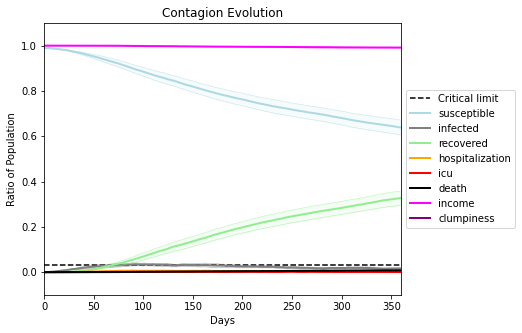

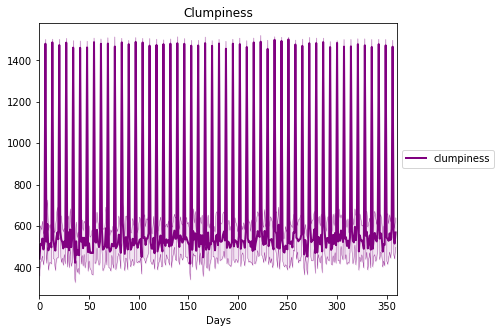

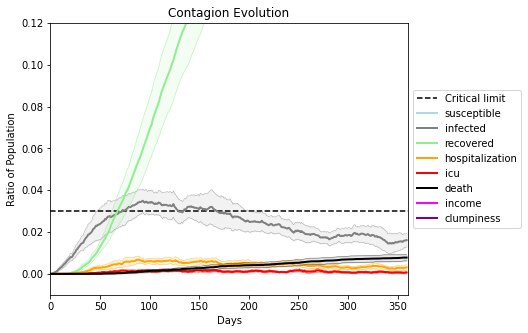

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2819, 4519, 293, 4630, 5411, 7133, 3814, 653, 457, 7869, 6876, 9243, 8368, 2973, 6772, 4771, 1137, 432, 9591, 4189]
Average similarity between family members is 0.9292907399726271 at temperature -0.995
Average similarity between family and home is 0.9998532223331049 at temperature -1
Average similarity between students and their classroom is 0.867018422014173 at temperature -0.995
Average classroom occupancy is 1.6023391812865497 and number classrooms is 171
Average similarity between workers is 0.8730161074637995 at temperature -0.995
Average office occupancy is 3.5396825396825395 and number offices is 189
Average friend similarity for adults: 0.8558617263214352 for kids: 0.715819975023185
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.5940890068939243
avg restaurant similarity 0.573780848677556
avg restaurant similarity 0.6249729365152064
avg restaurant similarity 0.5939467466738656
avg restaurant similarity 0.5573979512427654
avg restaurant similarity 0.569249077327009
avg restaurant similarity 0.5404467140418763
avg restaurant similarity 0.5524398592296373
avg restaurant similarity 0.6016759986459098
avg restaurant similarity 0.5865661296020974
avg restaurant similarity 0.5255756612187509
avg restaurant similarity 0.5512676402462474
avg restaurant similarity 0.5664802710214357
avg restaurant similarity 0.541213116141854
avg restaurant similarity 0.5679038180986454
avg restaurant similarity 0.6119778950776698
avg restaurant similarity 0.5870648961905713
avg restaurant similarity 0.5735091586930376
avg restaurant similarity 0.6186288094466801
avg restaurant similarity 0.573574680757373
avg restaurant similarity 0.5793450188607373
avg restaurant similarity 0.5698430429628649
avg restaurant

avg restaurant similarity 0.5587722145296496
avg restaurant similarity 0.5841840168179273
avg restaurant similarity 0.5924884960373182
avg restaurant similarity 0.6066759430682628
avg restaurant similarity 0.5824528650955284
avg restaurant similarity 0.5575223548573641
avg restaurant similarity 0.5469226983311665
avg restaurant similarity 0.5737292965681537
avg restaurant similarity 0.5724980311048865
avg restaurant similarity 0.565801233835532
avg restaurant similarity 0.5889426970515944
avg restaurant similarity 0.5839236314556315
avg restaurant similarity 0.6319823518301328
avg restaurant similarity 0.5440731160141845
avg restaurant similarity 0.5624406071038242
avg restaurant similarity 0.5532348035991375
avg restaurant similarity 0.5835011044975822
avg restaurant similarity 0.6037621962041673
avg restaurant similarity 0.5337333968282608
avg restaurant similarity 0.5824894527218072
avg restaurant similarity 0.5312493288378646
avg restaurant similarity 0.5369291479346293
avg restaur

Average similarity between workers is 0.8902093754536188 at temperature -0.995
Average office occupancy is 3.285 and number offices is 200
Average friend similarity for adults: 0.849866392106826 for kids: 0.7297821105942318
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people al

avg restaurant similarity 0.5728125671992689
avg restaurant similarity 0.6040406401597108
avg restaurant similarity 0.5865228241352354
avg restaurant similarity 0.584716418131504
avg restaurant similarity 0.6087828399675099
avg restaurant similarity 0.6284282443926538
avg restaurant similarity 0.6182232055582916
avg restaurant similarity 0.6233790256172794
avg restaurant similarity 0.597863677941761
avg restaurant similarity 0.6255605289273384
avg restaurant similarity 0.5667103978943197
avg restaurant similarity 0.6400361744343792
avg restaurant similarity 0.611496968450992
avg restaurant similarity 0.6091767406162234
avg restaurant similarity 0.5915074152492453
avg restaurant similarity 0.6291556962366553
avg restaurant similarity 0.581004148386425
avg restaurant similarity 0.6711784620408936
avg restaurant similarity 0.5946547639709704
avg restaurant similarity 0.6094645872028593
avg restaurant similarity 0.6080590648582085
avg restaurant similarity 0.618273715010936
avg restaurant 

avg restaurant similarity 0.5967816487577278
avg restaurant similarity 0.5871237396495538
avg restaurant similarity 0.6400732670810766
avg restaurant similarity 0.6197863254863174
avg restaurant similarity 0.6101053148665628
avg restaurant similarity 0.6099678393275559
avg restaurant similarity 0.6257077840771942
avg restaurant similarity 0.6227689060670798
avg restaurant similarity 0.6334591649061233
avg restaurant similarity 0.6157537159059573
avg restaurant similarity 0.6266924089170899
avg restaurant similarity 0.5849408421363804
avg restaurant similarity 0.5968235699254174
avg restaurant similarity 0.6083944964890179
avg restaurant similarity 0.5803144427338229
avg restaurant similarity 0.6357592381342712
avg restaurant similarity 0.5748365567473416
avg restaurant similarity 0.6622400706134824
avg restaurant similarity 0.5962871050070195
avg restaurant similarity 0.6318573424737818
avg restaurant similarity 0.6335904297286171
avg restaurant similarity 0.6015672094090071
avg restau

Average similarity between workers is 0.8971906537098827 at temperature -0.995
Average office occupancy is 3.4081632653061225 and number offices is 196
Average friend similarity for adults: 0.8496368901388549 for kids: 0.7251752754944897
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.6253370188758154
avg restaurant similarity 0.6272009401125237
avg restaurant similarity 0.5857295748687938
avg restaurant similarity 0.618565884657156
avg restaurant similarity 0.6207386908231267
avg restaurant similarity 0.5122459910234959
avg restaurant similarity 0.588010638188229
avg restaurant similarity 0.601602531595028
avg restaurant similarity 0.5898845676561345
avg restaurant similarity 0.6053559621964674
avg restaurant similarity 0.6204061610946884
avg restaurant similarity 0.6147900634752516
avg restaurant similarity 0.6145341576926199
avg restaurant similarity 0.5806488726372406
avg restaurant similarity 0.605625592194046
avg restaurant similarity 0.6226281485787682
avg restaurant similarity 0.5861480745880737
avg restaurant similarity 0.6408655085525444
avg restaurant similarity 0.6040017313583614
avg restaurant similarity 0.6784515239255154
avg restaurant similarity 0.5513409901602608
avg restaurant similarity 0.6049969241863358
avg restaurant

avg restaurant similarity 0.5771923560032701
avg restaurant similarity 0.5318377408671678
avg restaurant similarity 0.651836271404476
avg restaurant similarity 0.5547142774514486
avg restaurant similarity 0.5586937895267745
avg restaurant similarity 0.6264261438087897
avg restaurant similarity 0.5846195336938173
avg restaurant similarity 0.6052309942540777
avg restaurant similarity 0.5617688352554
avg restaurant similarity 0.6196489465529278
avg restaurant similarity 0.6414092030339363
avg restaurant similarity 0.586315212712086
avg restaurant similarity 0.6120888348610982
avg restaurant similarity 0.5879982824745054
avg restaurant similarity 0.6081451782706215
avg restaurant similarity 0.60730162923901
avg restaurant similarity 0.6141924286451059
avg restaurant similarity 0.5859782239902357
avg restaurant similarity 0.6052693287775363
avg restaurant similarity 0.6242777215269105
avg restaurant similarity 0.6282658889451114
avg restaurant similarity 0.605524518549437
avg restaurant sim

Average similarity between workers is 0.8909858283777993 at temperature -0.995
Average office occupancy is 3.4343434343434343 and number offices is 198
Average friend similarity for adults: 0.8538662365515387 for kids: 0.7124407069379717
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.5724877243888152
avg restaurant similarity 0.5183883479487582
avg restaurant similarity 0.5875847140858941
avg restaurant similarity 0.6177143297943587
avg restaurant similarity 0.5454773961049504
avg restaurant similarity 0.5944875937439249
avg restaurant similarity 0.5331706047493482
avg restaurant similarity 0.5535869639052103
avg restaurant similarity 0.6338233396018617
avg restaurant similarity 0.5447044159106433
avg restaurant similarity 0.5620575697421442
avg restaurant similarity 0.5816318479731424
avg restaurant similarity 0.5884368805337497
avg restaurant similarity 0.5891539115485321
avg restaurant similarity 0.538845733953156
avg restaurant similarity 0.5555878525314527
avg restaurant similarity 0.5135024022720092
avg restaurant similarity 0.5792273179077891
avg restaurant similarity 0.5836860750022494
avg restaurant similarity 0.5918830010767688
avg restaurant similarity 0.5290688862420071
avg restaurant similarity 0.611316224918306
avg restaura

avg restaurant similarity 0.6241162370947249
avg restaurant similarity 0.6600844033253228
avg restaurant similarity 0.5820358175023308
avg restaurant similarity 0.6188089890689966
avg restaurant similarity 0.5663620611538414
avg restaurant similarity 0.5363813822084412
avg restaurant similarity 0.6198916205957947
avg restaurant similarity 0.5512971077094225
avg restaurant similarity 0.6104198487150273
avg restaurant similarity 0.5881501690688906
avg restaurant similarity 0.5928558483102904
avg restaurant similarity 0.6093375577486627
avg restaurant similarity 0.5493136227505087
avg restaurant similarity 0.5762192305526629
avg restaurant similarity 0.5682701996938274
avg restaurant similarity 0.6153203750587484
avg restaurant similarity 0.595857772726949
avg restaurant similarity 0.5576747377087936
avg restaurant similarity 0.6311572721128017
avg restaurant similarity 0.6111761405906843
avg restaurant similarity 0.6059899045363519
avg restaurant similarity 0.6088649448605347
avg restaur

Average similarity between workers is 0.8970284856187352 at temperature -0.995
Average office occupancy is 3.3076923076923075 and number offices is 195
Average friend similarity for adults: 0.8535753137569758 for kids: 0.7416250510589061
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 p

avg restaurant similarity 0.5589459782707654
avg restaurant similarity 0.5825023652581235
avg restaurant similarity 0.6079223842902886
avg restaurant similarity 0.5422992182379667
avg restaurant similarity 0.5137341936785295
avg restaurant similarity 0.5552853829179488
avg restaurant similarity 0.5672165381405565
avg restaurant similarity 0.5411203058430233
avg restaurant similarity 0.57115818764342
avg restaurant similarity 0.5679905112432863
avg restaurant similarity 0.5070341345604511
avg restaurant similarity 0.5910599880585884
avg restaurant similarity 0.5819691434318257
avg restaurant similarity 0.5682736159470293
avg restaurant similarity 0.5622551995778409
avg restaurant similarity 0.5902490262813874
avg restaurant similarity 0.5430599509716751
avg restaurant similarity 0.5715668348751085
avg restaurant similarity 0.5402165183457192
avg restaurant similarity 0.5821582530086877
avg restaurant similarity 0.5676696855253119
avg restaurant similarity 0.5896464099238671
avg restaura

avg restaurant similarity 0.5839004669788951
avg restaurant similarity 0.5537391597253373
avg restaurant similarity 0.5743766118708264
avg restaurant similarity 0.550053901178707
avg restaurant similarity 0.5725800957654152
avg restaurant similarity 0.6256952529428991
avg restaurant similarity 0.5447284240989628
avg restaurant similarity 0.6058909883552581
avg restaurant similarity 0.5847310837009746
avg restaurant similarity 0.5912045522673833
avg restaurant similarity 0.5453170779650283
avg restaurant similarity 0.554496570133587
avg restaurant similarity 0.547823584312327
avg restaurant similarity 0.5308796522891847
avg restaurant similarity 0.6350219880020402
avg restaurant similarity 0.606014601389431
avg restaurant similarity 0.5841768428548827
avg restaurant similarity 0.5955184574321378
avg restaurant similarity 0.5805594814341877
avg restaurant similarity 0.5770688684406496
avg restaurant similarity 0.5419505274733158
avg restaurant similarity 0.5872399169702743
avg restaurant

Average similarity between workers is 0.8962192322655949 at temperature -0.995
Average office occupancy is 3.3451776649746194 and number offices is 197
Average friend similarity for adults: 0.8523972254283827 for kids: 0.7288338017407274
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.5653622767941835
avg restaurant similarity 0.6850527673834991
avg restaurant similarity 0.6163664481503607
avg restaurant similarity 0.5641227793332165
avg restaurant similarity 0.6091062304065576
avg restaurant similarity 0.5948560121277776
avg restaurant similarity 0.5334043517072065
avg restaurant similarity 0.6133370725206108
avg restaurant similarity 0.7003982388998737
avg restaurant similarity 0.6216365272199315
avg restaurant similarity 0.5653692108346597
avg restaurant similarity 0.5705805585457233
avg restaurant similarity 0.6684355210354191
avg restaurant similarity 0.6298758117706353
avg restaurant similarity 0.5976064380558151
avg restaurant similarity 0.6770502584167132
avg restaurant similarity 0.619125683671242
avg restaurant similarity 0.5984458079387432
avg restaurant similarity 0.5511651293211177
avg restaurant similarity 0.5774233813331294
avg restaurant similarity 0.6096524915246249
avg restaurant similarity 0.5743100285655068
avg restaur

avg restaurant similarity 0.5913088971774794
avg restaurant similarity 0.6339603842618333
avg restaurant similarity 0.6389073302799925
avg restaurant similarity 0.6393864333077506
avg restaurant similarity 0.6341004188008087
avg restaurant similarity 0.5689450602946864
avg restaurant similarity 0.5771290946822472
avg restaurant similarity 0.6189316824171628
avg restaurant similarity 0.6045372860217476
avg restaurant similarity 0.6347596934939618
avg restaurant similarity 0.604505249871591
avg restaurant similarity 0.5897918837579684
avg restaurant similarity 0.5862486628554593
avg restaurant similarity 0.5958778191967874
avg restaurant similarity 0.7616821122727395
avg restaurant similarity 0.6244826921798534
avg restaurant similarity 0.5755701741264436
avg restaurant similarity 0.5736342430861493
avg restaurant similarity 0.5428876381413626
avg restaurant similarity 0.5495164644774391
avg restaurant similarity 0.6124716459861421
avg restaurant similarity 0.5968206025135326
avg restaur

Average similarity between workers is 0.8792533588996446 at temperature -0.995
Average office occupancy is 3.471794871794872 and number offices is 195
Average friend similarity for adults: 0.8562934052688098 for kids: 0.7254422167950899
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.5306378281612705
avg restaurant similarity 0.5217784478047268
avg restaurant similarity 0.5675416310637759
avg restaurant similarity 0.5686581639491599
avg restaurant similarity 0.5817534343680532
avg restaurant similarity 0.5690878435151523
avg restaurant similarity 0.5485376729584527
avg restaurant similarity 0.5599869661695653
avg restaurant similarity 0.611783266595182
avg restaurant similarity 0.549561086331845
avg restaurant similarity 0.5913918038138215
avg restaurant similarity 0.5736535391434451
avg restaurant similarity 0.5714069660126117
avg restaurant similarity 0.5334375617725031
avg restaurant similarity 0.5207387835066465
avg restaurant similarity 0.6069720104566512
avg restaurant similarity 0.5797877369248854
avg restaurant similarity 0.5752080712823024
avg restaurant similarity 0.566746908216364
avg restaurant similarity 0.5678720470186613
avg restaurant similarity 0.6007403739036926
avg restaurant similarity 0.6403681088455762
avg restauran

avg restaurant similarity 0.5532519940329819
avg restaurant similarity 0.5672423670165779
avg restaurant similarity 0.5068036540077999
avg restaurant similarity 0.5145294627298117
avg restaurant similarity 0.5128947350570052
avg restaurant similarity 0.5334906813110822
avg restaurant similarity 0.5659392938795339
avg restaurant similarity 0.5116015772859656
avg restaurant similarity 0.51516560484346
avg restaurant similarity 0.5235756807608617
avg restaurant similarity 0.5540140066760785
avg restaurant similarity 0.5399259367444784
avg restaurant similarity 0.5764058821169614
avg restaurant similarity 0.5824048715418989
avg restaurant similarity 0.5250839328502401
avg restaurant similarity 0.5616769157933107
avg restaurant similarity 0.5584629381459553
avg restaurant similarity 0.5488579890858863
avg restaurant similarity 0.5599622865582474
avg restaurant similarity 0.536268330984711
avg restaurant similarity 0.5460099737507446
avg restaurant similarity 0.5182015465746433
avg restauran

Average similarity between workers is 0.897343780398425 at temperature -0.995
Average office occupancy is 3.392857142857143 and number offices is 196
Average friend similarity for adults: 0.8550079979947665 for kids: 0.7254258936864774
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 peo

avg restaurant similarity 0.5395206827413433
avg restaurant similarity 0.5757352408430573
avg restaurant similarity 0.5845841024698255
avg restaurant similarity 0.553806333544673
avg restaurant similarity 0.47570069391990527
avg restaurant similarity 0.5729959922243424
avg restaurant similarity 0.5394670094169781
avg restaurant similarity 0.5863716244449138
avg restaurant similarity 0.4835665985957819
avg restaurant similarity 0.5375703280406849
avg restaurant similarity 0.5752069978488937
avg restaurant similarity 0.582454118894199
avg restaurant similarity 0.602332380279411
avg restaurant similarity 0.5285608830862737
avg restaurant similarity 0.6003055975316142
avg restaurant similarity 0.5816147270474548
avg restaurant similarity 0.5060846875547118
avg restaurant similarity 0.5258849460352883
avg restaurant similarity 0.5713031033958038
avg restaurant similarity 0.5859565078561008
avg restaurant similarity 0.5525441199455838
avg restaurant similarity 0.582626291068778
avg restauran

avg restaurant similarity 0.5386459400715945
avg restaurant similarity 0.5297435336361367
avg restaurant similarity 0.5527041592938677
avg restaurant similarity 0.5703564308970489
avg restaurant similarity 0.5535124922208018
avg restaurant similarity 0.5810349040250082
avg restaurant similarity 0.6205103644256588
avg restaurant similarity 0.5510046288355142
avg restaurant similarity 0.5513453499678337
avg restaurant similarity 0.5764685223288231
avg restaurant similarity 0.5694780273357428
avg restaurant similarity 0.553332590245486
avg restaurant similarity 0.5745780197688064
avg restaurant similarity 0.5400833061066437
avg restaurant similarity 0.5480773734496095
avg restaurant similarity 0.6434274647980798
avg restaurant similarity 0.5473282662541751
avg restaurant similarity 0.5649602888648602
avg restaurant similarity 0.5554562568024461
avg restaurant similarity 0.5494550047284424
avg restaurant similarity 0.5317072795819363
avg restaurant similarity 0.5417299660944316
avg restaur

Average similarity between workers is 0.8943281231217677 at temperature -0.995
Average office occupancy is 3.417525773195876 and number offices is 194
Average friend similarity for adults: 0.8499654851382328 for kids: 0.7209277222295941
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.5823493665970695
avg restaurant similarity 0.6330171811972958
avg restaurant similarity 0.5629217640814528
avg restaurant similarity 0.6054259680260787
avg restaurant similarity 0.6637205326036781
avg restaurant similarity 0.6117586797787306
avg restaurant similarity 0.6401448330352998
avg restaurant similarity 0.6290453653271739
avg restaurant similarity 0.628368486821342
avg restaurant similarity 0.6221728388573957
avg restaurant similarity 0.6162927205250004
avg restaurant similarity 0.6157065709211299
avg restaurant similarity 0.6486912140285876
avg restaurant similarity 0.6666271418939541
avg restaurant similarity 0.6329969472279905
avg restaurant similarity 0.6260649698724041
avg restaurant similarity 0.5800746312067752
avg restaurant similarity 0.6082832242948867
avg restaurant similarity 0.5889236898008167
avg restaurant similarity 0.546957824536845
avg restaurant similarity 0.6170867761126021
avg restaurant similarity 0.5768322668029198
avg restaura

avg restaurant similarity 0.6058298848989602
avg restaurant similarity 0.5804972790045319
avg restaurant similarity 0.5478345425154054
avg restaurant similarity 0.6532905889268377
avg restaurant similarity 0.5840940273441062
avg restaurant similarity 0.5766603560568423
avg restaurant similarity 0.550467247861722
avg restaurant similarity 0.5799655525760155
avg restaurant similarity 0.5558229440418688
avg restaurant similarity 0.5942763013689671
avg restaurant similarity 0.6470706205494958
avg restaurant similarity 0.5578588327990698
avg restaurant similarity 0.6340133261500059
avg restaurant similarity 0.5951191783642297
avg restaurant similarity 0.582020411704364
avg restaurant similarity 0.602036412385344
avg restaurant similarity 0.6292497418422183
avg restaurant similarity 0.6295893797793258
avg restaurant similarity 0.564089470658627
avg restaurant similarity 0.6034761083842498
avg restaurant similarity 0.5543342417558084
avg restaurant similarity 0.5845954903337772
avg restaurant

Average similarity between workers is 0.893755767030888 at temperature -0.995
Average office occupancy is 3.443877551020408 and number offices is 196
Average friend similarity for adults: 0.8593679219742818 for kids: 0.7261816657834875
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15

avg restaurant similarity 0.6720881804585361
avg restaurant similarity 0.5656233583781417
avg restaurant similarity 0.6147649273091225
avg restaurant similarity 0.5789998227299133
avg restaurant similarity 0.5919436148634276
avg restaurant similarity 0.6662606830039242
avg restaurant similarity 0.6003071117565899
avg restaurant similarity 0.5856362975918007
avg restaurant similarity 0.6431084515541565
avg restaurant similarity 0.6336658263660235
avg restaurant similarity 0.6308259059723116
avg restaurant similarity 0.5870407734488926
avg restaurant similarity 0.5975140107661512
avg restaurant similarity 0.6614081472683584
avg restaurant similarity 0.629866923468736
avg restaurant similarity 0.6669294862372873
avg restaurant similarity 0.6189545001380241
avg restaurant similarity 0.6136688490775569
avg restaurant similarity 0.6024573623551337
avg restaurant similarity 0.5685054073112378
avg restaurant similarity 0.5944544628559338
avg restaurant similarity 0.6251809299300937
avg restaur

avg restaurant similarity 0.6143525640332778
avg restaurant similarity 0.6281229517973923
avg restaurant similarity 0.6240175191407255
avg restaurant similarity 0.6157798252164254
avg restaurant similarity 0.6404965011562095
avg restaurant similarity 0.6491995087521264
avg restaurant similarity 0.6251907553401933
avg restaurant similarity 0.6009681317353138
avg restaurant similarity 0.6092357671510208
avg restaurant similarity 0.5850424191054576
avg restaurant similarity 0.6657306710162383
avg restaurant similarity 0.6419712704025878
avg restaurant similarity 0.5686559459036014
avg restaurant similarity 0.6445550666900384
avg restaurant similarity 0.5968479225671305
avg restaurant similarity 0.62236992314923
avg restaurant similarity 0.6258538869188931
avg restaurant similarity 0.6126109051125149
avg restaurant similarity 0.6216187499538519
avg restaurant similarity 0.6143893268897284
avg restaurant similarity 0.6239850101017999
avg restaurant similarity 0.6106253556361467
avg restaura

Average similarity between workers is 0.894743390485923 at temperature -0.995
Average office occupancy is 3.3088235294117645 and number offices is 204
Average friend similarity for adults: 0.8493885663052599 for kids: 0.7277686766625509
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 pe

avg restaurant similarity 0.579361147042554
avg restaurant similarity 0.5988572232512727
avg restaurant similarity 0.5450629730346999
avg restaurant similarity 0.5710799274051465
avg restaurant similarity 0.5728327476788982
avg restaurant similarity 0.5338424403115973
avg restaurant similarity 0.5593532750911038
avg restaurant similarity 0.5643521867485195
avg restaurant similarity 0.5532309307743357
avg restaurant similarity 0.5696062885263816
avg restaurant similarity 0.6172886558620975
avg restaurant similarity 0.5892675798349675
avg restaurant similarity 0.5838111222179159
avg restaurant similarity 0.5886960497484701
avg restaurant similarity 0.5750557967661599
avg restaurant similarity 0.5680734548274533
avg restaurant similarity 0.5730117389138705
avg restaurant similarity 0.5392686757653881
avg restaurant similarity 0.5903970976525852
avg restaurant similarity 0.5474468509921234
avg restaurant similarity 0.5544899355342973
avg restaurant similarity 0.5778977507527164
avg restaur

avg restaurant similarity 0.5797249386580098
avg restaurant similarity 0.5245255926480608
avg restaurant similarity 0.5707837946148621
avg restaurant similarity 0.5566747919485361
avg restaurant similarity 0.5698382328948928
avg restaurant similarity 0.6047291799328819
avg restaurant similarity 0.5877447634898093
avg restaurant similarity 0.5644309880697543
avg restaurant similarity 0.5607481268595508
avg restaurant similarity 0.5782330237848674
avg restaurant similarity 0.6238389338846025
avg restaurant similarity 0.5915688064075969
avg restaurant similarity 0.5593484228067764
avg restaurant similarity 0.5764549895433035
avg restaurant similarity 0.5236564782050028
avg restaurant similarity 0.5614749652776241
avg restaurant similarity 0.5124862477126213
avg restaurant similarity 0.5977623931825202
avg restaurant similarity 0.5549528091876925
avg restaurant similarity 0.5123656846424935
avg restaurant similarity 0.5326556366683869
avg restaurant similarity 0.5902576370685013
avg restau

Average similarity between workers is 0.8935842596624493 at temperature -0.995
Average office occupancy is 3.345360824742268 and number offices is 194
Average friend similarity for adults: 0.8577416791181525 for kids: 0.7334287306547296
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.5626616630888852
avg restaurant similarity 0.6000144430924609
avg restaurant similarity 0.5841834119290246
avg restaurant similarity 0.5976943847122097
avg restaurant similarity 0.5955657714679196
avg restaurant similarity 0.6037891478609136
avg restaurant similarity 0.6047022450032866
avg restaurant similarity 0.559882634179259
avg restaurant similarity 0.5491162266392415
avg restaurant similarity 0.608956823007008
avg restaurant similarity 0.5922247368828067
avg restaurant similarity 0.5938467810172506
avg restaurant similarity 0.5502866116592454
avg restaurant similarity 0.5708841752319481
avg restaurant similarity 0.5800307431296239
avg restaurant similarity 0.5954859841734266
avg restaurant similarity 0.5828660432633868
avg restaurant similarity 0.5896108012153113
avg restaurant similarity 0.6256779959968236
avg restaurant similarity 0.6243007281358455
avg restaurant similarity 0.5562350210742458
avg restaurant similarity 0.5540322814477607
avg restaura

avg restaurant similarity 0.5856263709968014
avg restaurant similarity 0.5873815967414654
avg restaurant similarity 0.6326383741891003
avg restaurant similarity 0.5961347190561544
avg restaurant similarity 0.5711702355662883
avg restaurant similarity 0.5414416205687624
avg restaurant similarity 0.5577941531047595
avg restaurant similarity 0.6096081944088497
avg restaurant similarity 0.5976568459739013
avg restaurant similarity 0.6137847765929747
avg restaurant similarity 0.6093681347484243
avg restaurant similarity 0.5589574886755263
avg restaurant similarity 0.5761715723610835
avg restaurant similarity 0.6093514711032966
avg restaurant similarity 0.6208856551759454
avg restaurant similarity 0.5773283010909579
avg restaurant similarity 0.6372211174243324
avg restaurant similarity 0.5685165946630597
avg restaurant similarity 0.6393542940953139
avg restaurant similarity 0.5936136946161139
avg restaurant similarity 0.5595916752335743
avg restaurant similarity 0.5770289554099419
avg restau

Average similarity between workers is 0.8901912195486789 at temperature -0.995
Average office occupancy is 3.2763819095477387 and number offices is 199
Average friend similarity for adults: 0.8534981505949285 for kids: 0.7414871127750758
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5862350177521012
avg restaurant similarity 0.5766827284634688
avg restaurant similarity 0.6020841698842702
avg restaurant similarity 0.5976883859264921
avg restaurant similarity 0.623978571505253
avg restaurant similarity 0.6073338749340629
avg restaurant similarity 0.6060038326460019
avg restaurant similarity 0.6429592734499705
avg restaurant similarity 0.6254694339897993
avg restaurant similarity 0.5970437653024039
avg restaurant similarity 0.611864463046216
avg restaurant similarity 0.6498707460702363
avg restaurant similarity 0.5934448292034102
avg restaurant similarity 0.6240608984371382
avg restaurant similarity 0.6218880763030094
avg restaurant similarity 0.6388640297729418
avg restaurant similarity 0.5986668273248693
avg restaurant similarity 0.6128667952589011
avg restaurant similarity 0.5942227342421437
avg restaurant similarity 0.5941586964615911
avg restaurant similarity 0.6687325476516905
avg restaurant similarity 0.620840893882927
avg restauran

avg restaurant similarity 0.5849335358412986
avg restaurant similarity 0.6515545647600881
avg restaurant similarity 0.6525708814351073
avg restaurant similarity 0.6223903450061931
avg restaurant similarity 0.6300342606332551
avg restaurant similarity 0.6548129744565642
avg restaurant similarity 0.6320350694385166
avg restaurant similarity 0.633674814348983
avg restaurant similarity 0.5778305095030647
avg restaurant similarity 0.6026387897868263
avg restaurant similarity 0.6127122258175048
avg restaurant similarity 0.5493226767894368
avg restaurant similarity 0.5886420951795
avg restaurant similarity 0.5553575882663437
avg restaurant similarity 0.6042974167502133
avg restaurant similarity 0.600029492869527
avg restaurant similarity 0.6644547220656788
avg restaurant similarity 0.6628604767684336
avg restaurant similarity 0.6382825638379155
avg restaurant similarity 0.6115606408083454
avg restaurant similarity 0.603763641232058
avg restaurant similarity 0.5839004817833141
avg restaurant s

Average similarity between workers is 0.8863259344768163 at temperature -0.995
Average office occupancy is 3.450261780104712 and number offices is 191
Average friend similarity for adults: 0.8473173477265459 for kids: 0.7255334599270981
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.5960505110622919
avg restaurant similarity 0.598369747762462
avg restaurant similarity 0.6049242765440013
avg restaurant similarity 0.5899993674899323
avg restaurant similarity 0.5853516620519494
avg restaurant similarity 0.5549431725035752
avg restaurant similarity 0.6124655661214258
avg restaurant similarity 0.6681534438630218
avg restaurant similarity 0.5874271900626382
avg restaurant similarity 0.6541764772815278
avg restaurant similarity 0.5926110268967962
avg restaurant similarity 0.6054671020758711
avg restaurant similarity 0.6296418014987217
avg restaurant similarity 0.6272258066143915
avg restaurant similarity 0.5885850270477284
avg restaurant similarity 0.5652341861310847
avg restaurant similarity 0.6235914588556539
avg restaurant similarity 0.6216980219020781
avg restaurant similarity 0.6004625844701468
avg restaurant similarity 0.608286018845282
avg restaurant similarity 0.6028936515514366
avg restaurant similarity 0.5885823748349264
avg restaura

avg restaurant similarity 0.5566705564072278
avg restaurant similarity 0.594924695409038
avg restaurant similarity 0.6417136486446381
avg restaurant similarity 0.5605534625695694
avg restaurant similarity 0.5676829141594959
avg restaurant similarity 0.6304723895031404
avg restaurant similarity 0.5956478048470831
avg restaurant similarity 0.6167768003191214
avg restaurant similarity 0.6057781472405004
avg restaurant similarity 0.5835577100915846
avg restaurant similarity 0.6171222572039571
avg restaurant similarity 0.6113757073357464
avg restaurant similarity 0.631233807689454
avg restaurant similarity 0.5623512103963481
avg restaurant similarity 0.6216736990596232
avg restaurant similarity 0.655259125275758
avg restaurant similarity 0.6375820529646585
avg restaurant similarity 0.5945010962519633
avg restaurant similarity 0.6343458343138942
avg restaurant similarity 0.6058470795014597
avg restaurant similarity 0.5872369784396974
avg restaurant similarity 0.6311936738404869
avg restauran

Average similarity between workers is 0.8832913837695523 at temperature -0.995
Average office occupancy is 3.3697916666666665 and number offices is 192
Average friend similarity for adults: 0.8412709501285449 for kids: 0.7208275091413451
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5686069794078747
avg restaurant similarity 0.571514264110819
avg restaurant similarity 0.574636048596513
avg restaurant similarity 0.5261280332456887
avg restaurant similarity 0.5173354004961401
avg restaurant similarity 0.5687855441497777
avg restaurant similarity 0.5979603262333331
avg restaurant similarity 0.5559186625235434
avg restaurant similarity 0.5546373750604079
avg restaurant similarity 0.5998539457218909
avg restaurant similarity 0.5854907208704989
avg restaurant similarity 0.5827699527230867
avg restaurant similarity 0.5480737982821863
avg restaurant similarity 0.6048699547408443
avg restaurant similarity 0.5634039962266476
avg restaurant similarity 0.5857938158513158
avg restaurant similarity 0.5553258446987083
avg restaurant similarity 0.574897702725766
avg restaurant similarity 0.5855414603748788
avg restaurant similarity 0.5681226282625899
avg restaurant similarity 0.5579142712317212
avg restaurant similarity 0.5827634834043337
avg restauran

avg restaurant similarity 0.5899616698799781
avg restaurant similarity 0.632647792430111
avg restaurant similarity 0.5413342697684708
avg restaurant similarity 0.5531725252944687
avg restaurant similarity 0.5800329312843393
avg restaurant similarity 0.5378508130871356
avg restaurant similarity 0.5469029944876043
avg restaurant similarity 0.5681294537379883
avg restaurant similarity 0.544549255942283
avg restaurant similarity 0.567238884525271
avg restaurant similarity 0.626705100857267
avg restaurant similarity 0.5702146343404239
avg restaurant similarity 0.5822329709964452
avg restaurant similarity 0.5797276636773442
avg restaurant similarity 0.57650239746644
avg restaurant similarity 0.5868391934518241
avg restaurant similarity 0.5734086298566077
avg restaurant similarity 0.6202781043531905
avg restaurant similarity 0.5458951629528687
avg restaurant similarity 0.6084518703868951
avg restaurant similarity 0.5860382527276443
avg restaurant similarity 0.6020719460393966
avg restaurant s

Average similarity between workers is 0.8792131314541809 at temperature -0.995
Average office occupancy is 3.487309644670051 and number offices is 197
Average friend similarity for adults: 0.8544847743718749 for kids: 0.7193156834587165
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 

avg restaurant similarity 0.5482355686790866
avg restaurant similarity 0.5342749642804766
avg restaurant similarity 0.5510350730422474
avg restaurant similarity 0.6119269791675953
avg restaurant similarity 0.5353443387638449
avg restaurant similarity 0.6180352332593327
avg restaurant similarity 0.5582064589445764
avg restaurant similarity 0.6076096547760106
avg restaurant similarity 0.6224575519427687
avg restaurant similarity 0.5716738078216586
avg restaurant similarity 0.5764088540060539
avg restaurant similarity 0.5558706634796114
avg restaurant similarity 0.5754966532172675
avg restaurant similarity 0.573237376633758
avg restaurant similarity 0.6293546201991934
avg restaurant similarity 0.6147487646063055
avg restaurant similarity 0.6289599174148635
avg restaurant similarity 0.6151116290567105
avg restaurant similarity 0.6049212891749507
avg restaurant similarity 0.572338231782391
avg restaurant similarity 0.6003057224278887
avg restaurant similarity 0.5622453105598562
avg restaura

avg restaurant similarity 0.6104153235953749
avg restaurant similarity 0.6205257888954288
avg restaurant similarity 0.5721294410753377
avg restaurant similarity 0.5868941256024117
avg restaurant similarity 0.5875366776783324
avg restaurant similarity 0.5169489408990835
avg restaurant similarity 0.5793002465032766
avg restaurant similarity 0.6142974332297562
avg restaurant similarity 0.5619605120451262
avg restaurant similarity 0.5704791970694904
avg restaurant similarity 0.6054113250925707
avg restaurant similarity 0.573915559079052
avg restaurant similarity 0.5837050944964974
avg restaurant similarity 0.5839463405931364
avg restaurant similarity 0.5201893511075126
avg restaurant similarity 0.5513730202117837
avg restaurant similarity 0.5436215482380929
avg restaurant similarity 0.5662690084370082
avg restaurant similarity 0.5458239937245178
avg restaurant similarity 0.5658277266221597
avg restaurant similarity 0.5385889548566427
avg restaurant similarity 0.6038112486297447
avg restaur

Average similarity between workers is 0.9031294395804107 at temperature -0.995
Average office occupancy is 3.248730964467005 and number offices is 197
Average friend similarity for adults: 0.840307217683695 for kids: 0.73613434964353
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 peo

avg restaurant similarity 0.549899784536324
avg restaurant similarity 0.561034606185127
avg restaurant similarity 0.580099518598244
avg restaurant similarity 0.5916690668485286
avg restaurant similarity 0.6245082453248245
avg restaurant similarity 0.5600170019630074
avg restaurant similarity 0.5903389593555751
avg restaurant similarity 0.6297996356828303
avg restaurant similarity 0.5236907968327988
avg restaurant similarity 0.5832090645381982
avg restaurant similarity 0.6139674590835328
avg restaurant similarity 0.5265452109402629
avg restaurant similarity 0.5314324818405368
avg restaurant similarity 0.5431814769900474
avg restaurant similarity 0.5714228148511163
avg restaurant similarity 0.551174239220224
avg restaurant similarity 0.5860048351316183
avg restaurant similarity 0.5552865393407064
avg restaurant similarity 0.5655602927959614
avg restaurant similarity 0.6076296202513739
avg restaurant similarity 0.5347541917607221
avg restaurant similarity 0.5931885715654578
avg restaurant

avg restaurant similarity 0.5539194239417717
avg restaurant similarity 0.5742240499280062
avg restaurant similarity 0.5935999498656678
avg restaurant similarity 0.5332401542309361
avg restaurant similarity 0.5798217005472168
avg restaurant similarity 0.5213379069483403
avg restaurant similarity 0.5643655605418189
avg restaurant similarity 0.5793656039848103
avg restaurant similarity 0.525723205720004
avg restaurant similarity 0.5919467202934808
avg restaurant similarity 0.525539309291342
avg restaurant similarity 0.599315855021679
avg restaurant similarity 0.5572221408145204
avg restaurant similarity 0.56066192816312
avg restaurant similarity 0.6110439074719509
avg restaurant similarity 0.6510983406891884
avg restaurant similarity 0.5707218307836188
avg restaurant similarity 0.5474161577695912
avg restaurant similarity 0.5631458912627536
avg restaurant similarity 0.5816675005023265
avg restaurant similarity 0.5588988129919614
avg restaurant similarity 0.5456021292161296
avg restaurant 

Average similarity between workers is 0.8894224854909224 at temperature -0.995
Average office occupancy is 3.3403141361256545 and number offices is 191
Average friend similarity for adults: 0.8412208091616615 for kids: 0.724249123699633
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of

avg restaurant similarity 0.519552807174979
avg restaurant similarity 0.5437979167661374
avg restaurant similarity 0.5012381794353532
avg restaurant similarity 0.5582722669574706
avg restaurant similarity 0.533932262393072
avg restaurant similarity 0.5641369440204397
avg restaurant similarity 0.5117410701910688
avg restaurant similarity 0.5428632699446437
avg restaurant similarity 0.5158255294946614
avg restaurant similarity 0.546664137775548
avg restaurant similarity 0.6063777793827444
avg restaurant similarity 0.5453196762662833
avg restaurant similarity 0.5306526812743587
avg restaurant similarity 0.5561433416964097
avg restaurant similarity 0.5607511054376487
avg restaurant similarity 0.5262226290205873
avg restaurant similarity 0.5207402856711381
avg restaurant similarity 0.6389991247495856
avg restaurant similarity 0.5330204984505802
avg restaurant similarity 0.48093236058116057
avg restaurant similarity 0.5675471955736859
avg restaurant similarity 0.5248790394157287
avg restaura

avg restaurant similarity 0.544108298205962
avg restaurant similarity 0.6070978335708195
avg restaurant similarity 0.5624555993029429
avg restaurant similarity 0.5711493940333116
avg restaurant similarity 0.540131556378455
avg restaurant similarity 0.5579798087787333
avg restaurant similarity 0.5330890049870665
avg restaurant similarity 0.5266891728693234
avg restaurant similarity 0.5524808671900433
avg restaurant similarity 0.5622963771706091
avg restaurant similarity 0.5835504798093369
avg restaurant similarity 0.584109663090142
avg restaurant similarity 0.5651070548110696
avg restaurant similarity 0.6051145346703454
avg restaurant similarity 0.4777430959909087
avg restaurant similarity 0.5811305787986663
avg restaurant similarity 0.5750573023995487
avg restaurant similarity 0.5240887816686148
avg restaurant similarity 0.5318670894641974
avg restaurant similarity 0.5807244546365248
avg restaurant similarity 0.5315464182856072
avg restaurant similarity 0.5715372659962308
avg restauran

Average similarity between workers is 0.8955534211741923 at temperature -0.995
Average office occupancy is 3.5129533678756477 and number offices is 193
Average friend similarity for adults: 0.859612902792857 for kids: 0.7212676462244639
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 peop

avg restaurant similarity 0.5443466315121877
avg restaurant similarity 0.6083361188795249
avg restaurant similarity 0.5370352993027103
avg restaurant similarity 0.5397694056691308
avg restaurant similarity 0.574132690270795
avg restaurant similarity 0.5485935123673579
avg restaurant similarity 0.6295134993929493
avg restaurant similarity 0.5355369640569687
avg restaurant similarity 0.5581519951879749
avg restaurant similarity 0.5518931712489179
avg restaurant similarity 0.52938559417223
avg restaurant similarity 0.5748613594692028
avg restaurant similarity 0.5752212417862079
avg restaurant similarity 0.5645721966712979
avg restaurant similarity 0.5778924148754598
avg restaurant similarity 0.5749997476483847
avg restaurant similarity 0.6116357286071746
avg restaurant similarity 0.5840538604033152
avg restaurant similarity 0.5762643461656127
avg restaurant similarity 0.5542785764795081
avg restaurant similarity 0.552031487582204
avg restaurant similarity 0.5376479928087836
avg restaurant

avg restaurant similarity 0.564556223876165
avg restaurant similarity 0.5563403440101147
avg restaurant similarity 0.5578108049467311
avg restaurant similarity 0.6127456606931432
avg restaurant similarity 0.572394895122739
avg restaurant similarity 0.5535595947966683
avg restaurant similarity 0.57221601575386
avg restaurant similarity 0.5912219318549518
avg restaurant similarity 0.5302053086534835
avg restaurant similarity 0.6053320586811421
avg restaurant similarity 0.5463505275376123
avg restaurant similarity 0.5802283915453341
avg restaurant similarity 0.5644827737139556
avg restaurant similarity 0.5529328576614729
avg restaurant similarity 0.577786272303905
avg restaurant similarity 0.6075498778894128
avg restaurant similarity 0.5785650013561124
avg restaurant similarity 0.5607519871428146
avg restaurant similarity 0.592661137028771
avg restaurant similarity 0.5827912219105116
avg restaurant similarity 0.5436736488383657
avg restaurant similarity 0.5700209991691138
avg restaurant s

Average similarity between workers is 0.8893057125790935 at temperature -0.995
Average office occupancy is 3.4381443298969074 and number offices is 194
Average friend similarity for adults: 0.8547132938344111 for kids: 0.7268342947066784
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.6172602565015212
avg restaurant similarity 0.5770962466246161
avg restaurant similarity 0.5258126648767135
avg restaurant similarity 0.6012562280307931
avg restaurant similarity 0.601307008285491
avg restaurant similarity 0.5667773782138786
avg restaurant similarity 0.5534231881734157
avg restaurant similarity 0.6216751674826116
avg restaurant similarity 0.5909756934063238
avg restaurant similarity 0.5699893130628867
avg restaurant similarity 0.5677356909573213
avg restaurant similarity 0.646581536023509
avg restaurant similarity 0.6077564357884077
avg restaurant similarity 0.5597039676521735
avg restaurant similarity 0.5580789261384725
avg restaurant similarity 0.537739605968946
avg restaurant similarity 0.5455906500090344
avg restaurant similarity 0.5601827589308941
avg restaurant similarity 0.5577167672210828
avg restaurant similarity 0.5944683693202184
avg restaurant similarity 0.5104602135569837
avg restaurant similarity 0.6115598836754941
avg restauran

avg restaurant similarity 0.5855430019295376
avg restaurant similarity 0.5577762456786802
avg restaurant similarity 0.5817076138952786
avg restaurant similarity 0.5547980223986757
avg restaurant similarity 0.5914334034273369
avg restaurant similarity 0.5511319961224569
avg restaurant similarity 0.5645459673119347
avg restaurant similarity 0.5594093741180325
avg restaurant similarity 0.5645775173470647
avg restaurant similarity 0.5758630750463885
avg restaurant similarity 0.5855182602323706
avg restaurant similarity 0.5254698857205642
avg restaurant similarity 0.5661974631032652
avg restaurant similarity 0.5389153549209186
avg restaurant similarity 0.5581948472914979
avg restaurant similarity 0.5436891599997752
avg restaurant similarity 0.5498290155440837
avg restaurant similarity 0.5977721429746837
avg restaurant similarity 0.5332030530473143
avg restaurant similarity 0.6164692280410777
avg restaurant similarity 0.5806444517271081
avg restaurant similarity 0.5534743771096147
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

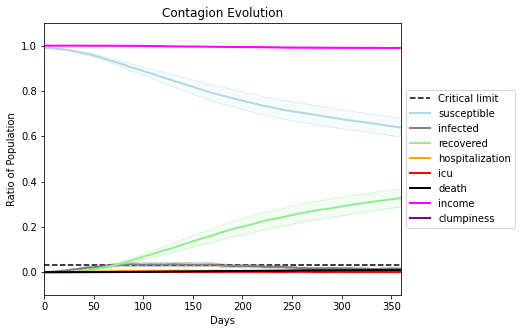

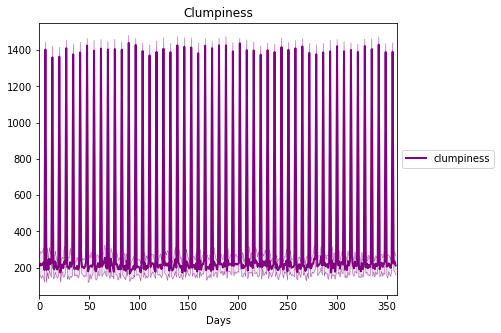

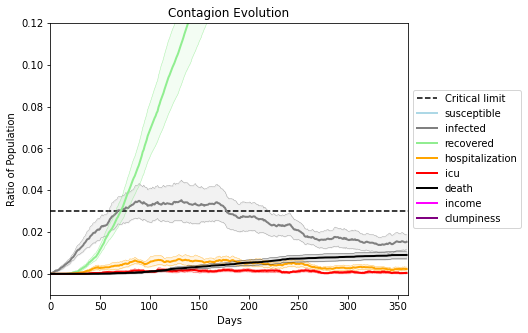

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6977, 2023, 1697, 9648, 3387, 2516, 9845, 8193, 5079, 6242, 5783, 2021, 168, 7139, 1661, 7562, 8794, 4418, 4285, 8803]
Average similarity between family members is 0.936538889910305 at temperature -0.994
Average similarity between family and home is 0.9998558224750901 at temperature -1
Average similarity between students and their classroom is 0.8781525038312129 at temperature -0.994
Average classroom occupancy is 1.6242774566473988 and number classrooms is 173
Average similarity between workers is 0.8763704057339743 at temperature -0.994
Average office occupancy is 3.4948453608247423 and number offices is 194
Average friend similarity for adults: 0.8528866721917597 for kids: 0.7261715757758003
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.6081913496085872
avg restaurant similarity 0.6090200725925684
avg restaurant similarity 0.5514473705234334
avg restaurant similarity 0.6151077154189488
avg restaurant similarity 0.5850623517263397
avg restaurant similarity 0.6063020261374362
avg restaurant similarity 0.5877455331792205
avg restaurant similarity 0.6155103380384146
avg restaurant similarity 0.5157451039681126
avg restaurant similarity 0.6018197214146894
avg restaurant similarity 0.5801080099921632
avg restaurant similarity 0.6324735980022214
avg restaurant similarity 0.5629403690792993
avg restaurant similarity 0.6145465703251433
avg restaurant similarity 0.6050755549485727
avg restaurant similarity 0.5975590174072744
avg restaurant similarity 0.599793705135689
avg restaurant similarity 0.6237504369191488
avg restaurant similarity 0.5746965940063871
avg restaurant similarity 0.5763447396969172
avg restaurant similarity 0.5581164527229223
avg restaurant similarity 0.5352654110259458
avg restaur

avg restaurant similarity 0.6031419121770195
avg restaurant similarity 0.6121525576774621
avg restaurant similarity 0.5720635071578137
avg restaurant similarity 0.5796776641322695
avg restaurant similarity 0.5939374740322856
avg restaurant similarity 0.5511255346643397
avg restaurant similarity 0.5907681125302298
avg restaurant similarity 0.635973203581837
avg restaurant similarity 0.5753392667951139
avg restaurant similarity 0.5968360436288446
avg restaurant similarity 0.6292685750837611
avg restaurant similarity 0.544577485492858
avg restaurant similarity 0.5934696734033481
avg restaurant similarity 0.5592209019436051
avg restaurant similarity 0.6169496471899629
avg restaurant similarity 0.5797691677338959
avg restaurant similarity 0.5436351375408884
avg restaurant similarity 0.5891581569821359
avg restaurant similarity 0.6344474556669296
avg restaurant similarity 0.6139287429902814
avg restaurant similarity 0.5766348626976128
avg restaurant similarity 0.5965138351642146
avg restaura

Average similarity between workers is 0.8895493533608951 at temperature -0.994
Average office occupancy is 3.2741116751269037 and number offices is 197
Average friend similarity for adults: 0.8465958928844546 for kids: 0.7352850708611719
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peo

avg restaurant similarity 0.6002582799344257
avg restaurant similarity 0.50926769449179
avg restaurant similarity 0.5591172282875232
avg restaurant similarity 0.566607562773863
avg restaurant similarity 0.5677946843855043
avg restaurant similarity 0.6088389333612848
avg restaurant similarity 0.5112257301222919
avg restaurant similarity 0.5410009819292658
avg restaurant similarity 0.5345317807078972
avg restaurant similarity 0.5401050534434946
avg restaurant similarity 0.5114500158713471
avg restaurant similarity 0.5298921790640149
avg restaurant similarity 0.5766742210654169
avg restaurant similarity 0.6088930238507805
avg restaurant similarity 0.5982474656269763
avg restaurant similarity 0.5875901967166157
avg restaurant similarity 0.5814527363493174
avg restaurant similarity 0.537941570629414
avg restaurant similarity 0.5443701999067291
avg restaurant similarity 0.5449893683313568
avg restaurant similarity 0.5916911268441228
avg restaurant similarity 0.5652668946688283
avg restaurant

avg restaurant similarity 0.612613201451726
avg restaurant similarity 0.5939120403491025
avg restaurant similarity 0.5926059111208556
avg restaurant similarity 0.5562808275446889
avg restaurant similarity 0.5230123800222748
avg restaurant similarity 0.5501261998445972
avg restaurant similarity 0.5661994291932395
avg restaurant similarity 0.5752147953218801
avg restaurant similarity 0.5424399443850626
avg restaurant similarity 0.5758576222278768
avg restaurant similarity 0.6042316041194745
avg restaurant similarity 0.5673762514924108
avg restaurant similarity 0.5106378722756555
avg restaurant similarity 0.5492392358851479
avg restaurant similarity 0.5512184542533645
avg restaurant similarity 0.560485920594508
avg restaurant similarity 0.55735600706251
avg restaurant similarity 0.5991174903527272
avg restaurant similarity 0.5592030310093065
avg restaurant similarity 0.5550218929439734
avg restaurant similarity 0.5662053706839824
avg restaurant similarity 0.5572398334545309
avg restaurant

Average similarity between workers is 0.893521751419972 at temperature -0.994
Average office occupancy is 3.212871287128713 and number offices is 202
Average friend similarity for adults: 0.8592942767744445 for kids: 0.7336383088142521
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 p

avg restaurant similarity 0.6200036043039671
avg restaurant similarity 0.6274245000598868
avg restaurant similarity 0.6298082588613193
avg restaurant similarity 0.6167704126644898
avg restaurant similarity 0.6442790257369788
avg restaurant similarity 0.6228358764671056
avg restaurant similarity 0.6153768713343332
avg restaurant similarity 0.5274228237899193
avg restaurant similarity 0.6207346152290936
avg restaurant similarity 0.6240758237380479
avg restaurant similarity 0.5906590889748004
avg restaurant similarity 0.5961198743518169
avg restaurant similarity 0.5445998242137814
avg restaurant similarity 0.536324670962645
avg restaurant similarity 0.6740181391093255
avg restaurant similarity 0.6053753958248123
avg restaurant similarity 0.6566423482324392
avg restaurant similarity 0.6363318002420671
avg restaurant similarity 0.6253283409999792
avg restaurant similarity 0.5911360400414839
avg restaurant similarity 0.6627449083054854
avg restaurant similarity 0.5973410911733291
avg restaur

avg restaurant similarity 0.5985881742355709
avg restaurant similarity 0.634767197057707
avg restaurant similarity 0.6525593667680527
avg restaurant similarity 0.5971351963515853
avg restaurant similarity 0.6440745151022952
avg restaurant similarity 0.5543471249447797
avg restaurant similarity 0.6178574254646954
avg restaurant similarity 0.5644123451987495
avg restaurant similarity 0.6109085968415067
avg restaurant similarity 0.6000659430261089
avg restaurant similarity 0.5743282703428304
avg restaurant similarity 0.604106728165698
avg restaurant similarity 0.6267134650893671
avg restaurant similarity 0.613747127869252
avg restaurant similarity 0.6615066951796043
avg restaurant similarity 0.6504791381246812
avg restaurant similarity 0.5401093116976174
avg restaurant similarity 0.5782843435645892
avg restaurant similarity 0.5687949531164299
avg restaurant similarity 0.6591833586254757
avg restaurant similarity 0.5687623529587917
avg restaurant similarity 0.5826139638360189
avg restauran

Average similarity between workers is 0.8778235691679609 at temperature -0.994
Average office occupancy is 3.3626943005181347 and number offices is 193
Average friend similarity for adults: 0.8493788329287898 for kids: 0.7437883960071234
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5474350979452175
avg restaurant similarity 0.5828584902821312
avg restaurant similarity 0.5628501957345555
avg restaurant similarity 0.5465579085360949
avg restaurant similarity 0.5137306450949414
avg restaurant similarity 0.5550519811328375
avg restaurant similarity 0.5534741105159834
avg restaurant similarity 0.5111896109839017
avg restaurant similarity 0.5918327894243246
avg restaurant similarity 0.5075064568804837
avg restaurant similarity 0.5553191539063456
avg restaurant similarity 0.5417652812047107
avg restaurant similarity 0.5691136175168575
avg restaurant similarity 0.5417035362710406
avg restaurant similarity 0.530819468898791
avg restaurant similarity 0.5349516012709358
avg restaurant similarity 0.5773295562164825
avg restaurant similarity 0.495431173930485
avg restaurant similarity 0.5693748195310193
avg restaurant similarity 0.505318437298241
avg restaurant similarity 0.5598376644027938
avg restaurant similarity 0.6007814826114984
avg restauran

avg restaurant similarity 0.6646794319832788
avg restaurant similarity 0.5983677423118205
avg restaurant similarity 0.5776754610174271
avg restaurant similarity 0.5587115112903229
avg restaurant similarity 0.5345494524049426
avg restaurant similarity 0.58192326477236
avg restaurant similarity 0.5162447997736429
avg restaurant similarity 0.5983136910821953
avg restaurant similarity 0.5806272226099758
avg restaurant similarity 0.5841427600599857
avg restaurant similarity 0.5608580861468037
avg restaurant similarity 0.5948065926219266
avg restaurant similarity 0.5783221986033718
avg restaurant similarity 0.607028648532712
avg restaurant similarity 0.5461163553191107
avg restaurant similarity 0.5853710096131094
avg restaurant similarity 0.5778339176956214
avg restaurant similarity 0.5514252473021984
avg restaurant similarity 0.6327567934289905
avg restaurant similarity 0.6293079858997132
avg restaurant similarity 0.5807715469980453
avg restaurant similarity 0.5291335245551203
avg restauran

Average similarity between workers is 0.8834174076254063 at temperature -0.994
Average office occupancy is 3.357142857142857 and number offices is 196
Average friend similarity for adults: 0.8455656858470084 for kids: 0.7235403496675751
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.5432984055236117
avg restaurant similarity 0.5698914621101853
avg restaurant similarity 0.514794146871937
avg restaurant similarity 0.578179147124682
avg restaurant similarity 0.6022042020751401
avg restaurant similarity 0.5998493032916244
avg restaurant similarity 0.5721992866167221
avg restaurant similarity 0.5838504630231256
avg restaurant similarity 0.5881461511237307
avg restaurant similarity 0.6036298068845402
avg restaurant similarity 0.5353914514993666
avg restaurant similarity 0.591995456897203
avg restaurant similarity 0.5697334590942015
avg restaurant similarity 0.5772409113173712
avg restaurant similarity 0.6069252876670294
avg restaurant similarity 0.603366902148264
avg restaurant similarity 0.596943179417829
avg restaurant similarity 0.5525429887737167
avg restaurant similarity 0.5744558512283731
avg restaurant similarity 0.5485034963990489
avg restaurant similarity 0.5933929207353879
avg restaurant similarity 0.5571881190210481
avg restaurant 

avg restaurant similarity 0.5625851566081758
avg restaurant similarity 0.5752120176084655
avg restaurant similarity 0.5090048977237104
avg restaurant similarity 0.5617799355898399
avg restaurant similarity 0.5657763693801566
avg restaurant similarity 0.5741531855125254
avg restaurant similarity 0.5233731974202164
avg restaurant similarity 0.5733375633078074
avg restaurant similarity 0.5611577411560779
avg restaurant similarity 0.5986137172820716
avg restaurant similarity 0.529850554397571
avg restaurant similarity 0.5323060170406931
avg restaurant similarity 0.5640054686919554
avg restaurant similarity 0.5498076364160118
avg restaurant similarity 0.5336715182642816
avg restaurant similarity 0.5414235324194037
avg restaurant similarity 0.5750762402018672
avg restaurant similarity 0.5730367862692906
avg restaurant similarity 0.6006965706584598
avg restaurant similarity 0.5583352997694889
avg restaurant similarity 0.569848886488698
avg restaurant similarity 0.6198944178924627
avg restaura

Average similarity between workers is 0.8887868492294718 at temperature -0.994
Average office occupancy is 3.242424242424242 and number offices is 198
Average friend similarity for adults: 0.8431367745420104 for kids: 0.7401012247760702
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.6190131219418314
avg restaurant similarity 0.5238940060279408
avg restaurant similarity 0.586639259839705
avg restaurant similarity 0.6157706741526827
avg restaurant similarity 0.5601020484426443
avg restaurant similarity 0.5536889096075733
avg restaurant similarity 0.6190978594847576
avg restaurant similarity 0.582478874790058
avg restaurant similarity 0.5740911618496831
avg restaurant similarity 0.6009700083586064
avg restaurant similarity 0.5855978083939073
avg restaurant similarity 0.5684646342541818
avg restaurant similarity 0.5867721297207442
avg restaurant similarity 0.5571256791284132
avg restaurant similarity 0.5528804370188439
avg restaurant similarity 0.6315777924439656
avg restaurant similarity 0.6097040684928121
avg restaurant similarity 0.5441197402628918
avg restaurant similarity 0.5692565734158102
avg restaurant similarity 0.61599564342399
avg restaurant similarity 0.6076079431854245
avg restaurant similarity 0.5555188457988637
avg restaurant

avg restaurant similarity 0.5657027157923787
avg restaurant similarity 0.5734591908927195
avg restaurant similarity 0.5423103892518991
avg restaurant similarity 0.5406171718440576
avg restaurant similarity 0.5581145565849753
avg restaurant similarity 0.5991866951595801
avg restaurant similarity 0.5567966509189771
avg restaurant similarity 0.5677731170854201
avg restaurant similarity 0.615217590109774
avg restaurant similarity 0.5936493712020231
avg restaurant similarity 0.5444377812043141
avg restaurant similarity 0.5346018403232816
avg restaurant similarity 0.5654141027945484
avg restaurant similarity 0.5761778136617788
avg restaurant similarity 0.6135272160723044
avg restaurant similarity 0.5650170719672671
avg restaurant similarity 0.6249528791871474
avg restaurant similarity 0.587263163556096
avg restaurant similarity 0.563039856665906
avg restaurant similarity 0.5384326290014462
avg restaurant similarity 0.5612452195887869
avg restaurant similarity 0.5941128075800282
avg restauran

Average similarity between workers is 0.8863553756745612 at temperature -0.994
Average office occupancy is 3.2935323383084576 and number offices is 201
Average friend similarity for adults: 0.8489802974551685 for kids: 0.7312988540302163
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12

avg restaurant similarity 0.5139349697020753
avg restaurant similarity 0.5382862365401361
avg restaurant similarity 0.5281471519011597
avg restaurant similarity 0.530980923174306
avg restaurant similarity 0.5417851115883454
avg restaurant similarity 0.5419540928527848
avg restaurant similarity 0.5380151237964859
avg restaurant similarity 0.517519446317615
avg restaurant similarity 0.5325853478082355
avg restaurant similarity 0.5308793501177621
avg restaurant similarity 0.5543487920625525
avg restaurant similarity 0.5354778087609647
avg restaurant similarity 0.5137719082116429
avg restaurant similarity 0.5379563577589519
avg restaurant similarity 0.5705271713717802
avg restaurant similarity 0.5318912887575173
avg restaurant similarity 0.5192115400162819
avg restaurant similarity 0.5535148142824253
avg restaurant similarity 0.5558594185569954
avg restaurant similarity 0.5837344090368255
avg restaurant similarity 0.5231199239142129
avg restaurant similarity 0.5404777464201956
avg restaura

avg restaurant similarity 0.5384659596051733
avg restaurant similarity 0.5204441790728975
avg restaurant similarity 0.5600787679439944
avg restaurant similarity 0.5656902366957005
avg restaurant similarity 0.5159582552273243
avg restaurant similarity 0.5384089661903051
avg restaurant similarity 0.49617717394893596
avg restaurant similarity 0.5042132777147367
avg restaurant similarity 0.6141405557478385
avg restaurant similarity 0.5527287685054988
avg restaurant similarity 0.5070040866400738
avg restaurant similarity 0.508883668592076
avg restaurant similarity 0.5324129989699398
avg restaurant similarity 0.5251125906010924
avg restaurant similarity 0.5753575004781689
avg restaurant similarity 0.5676100168006715
avg restaurant similarity 0.5352575590312411
avg restaurant similarity 0.4860528634049248
avg restaurant similarity 0.5035468006199494
avg restaurant similarity 0.5372266820787935
avg restaurant similarity 0.5856044044456787
avg restaurant similarity 0.5437813646136656
avg restau

Average similarity between workers is 0.8956598887680864 at temperature -0.994
Average office occupancy is 3.329896907216495 and number offices is 194
Average friend similarity for adults: 0.8591594086371496 for kids: 0.7510286080690257
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.5602343228068211
avg restaurant similarity 0.5630076865466839
avg restaurant similarity 0.5805829615640065
avg restaurant similarity 0.5900850205490308
avg restaurant similarity 0.5634405980399334
avg restaurant similarity 0.5966702796832698
avg restaurant similarity 0.5517702717218853
avg restaurant similarity 0.5543436821582726
avg restaurant similarity 0.6099446107603926
avg restaurant similarity 0.5720588714379518
avg restaurant similarity 0.6054345175138626
avg restaurant similarity 0.5921477458707777
avg restaurant similarity 0.5920874392684545
avg restaurant similarity 0.5773946309502616
avg restaurant similarity 0.5453787440708138
avg restaurant similarity 0.5812952026687858
avg restaurant similarity 0.5983814790842839
avg restaurant similarity 0.586350857585307
avg restaurant similarity 0.5347272885285302
avg restaurant similarity 0.5920837622139088
avg restaurant similarity 0.5894188375182519
avg restaurant similarity 0.5217204130152735
avg restaur

avg restaurant similarity 0.6075006754584001
avg restaurant similarity 0.575750959141078
avg restaurant similarity 0.5983934682813267
avg restaurant similarity 0.5490695271163833
avg restaurant similarity 0.566966192394608
avg restaurant similarity 0.622292851767386
avg restaurant similarity 0.5614977531881362
avg restaurant similarity 0.582414424128499
avg restaurant similarity 0.5695162323794493
avg restaurant similarity 0.605238560973104
avg restaurant similarity 0.5811081644513587
avg restaurant similarity 0.5341301382572531
avg restaurant similarity 0.5768686622177044
avg restaurant similarity 0.5443170217112457
avg restaurant similarity 0.5943886975317242
avg restaurant similarity 0.5488557930879965
avg restaurant similarity 0.5773975275829826
avg restaurant similarity 0.5748914443746632
avg restaurant similarity 0.5555834383209792
avg restaurant similarity 0.5623590108012744
avg restaurant similarity 0.5502881715843225
avg restaurant similarity 0.5689800038905263
avg restaurant 

Average similarity between workers is 0.8770713405150427 at temperature -0.994
Average office occupancy is 3.404040404040404 and number offices is 198
Average friend similarity for adults: 0.8545304382905717 for kids: 0.7327222627402351
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.6193169577850505
avg restaurant similarity 0.5904660528024658
avg restaurant similarity 0.5644339525630719
avg restaurant similarity 0.6064372975161626
avg restaurant similarity 0.5607733704827851
avg restaurant similarity 0.5711182000484999
avg restaurant similarity 0.5657930283845904
avg restaurant similarity 0.5693142133245752
avg restaurant similarity 0.5649195942629035
avg restaurant similarity 0.5681101169055154
avg restaurant similarity 0.5745535177274544
avg restaurant similarity 0.5628417829328272
avg restaurant similarity 0.5931023475440377
avg restaurant similarity 0.5560300736981065
avg restaurant similarity 0.6127949871343489
avg restaurant similarity 0.5931600459706018
avg restaurant similarity 0.5715556575022245
avg restaurant similarity 0.5629870763787789
avg restaurant similarity 0.659730233798084
avg restaurant similarity 0.5506521340648995
avg restaurant similarity 0.5300372591177546
avg restaurant similarity 0.6203232931144946
avg restaur

avg restaurant similarity 0.5375738774882403
avg restaurant similarity 0.5633327188555087
avg restaurant similarity 0.5660714638206532
avg restaurant similarity 0.49872277754349825
avg restaurant similarity 0.5487052036055199
avg restaurant similarity 0.5669025269026277
avg restaurant similarity 0.5050207546305876
avg restaurant similarity 0.541193282979181
avg restaurant similarity 0.561481114249522
avg restaurant similarity 0.5695990564749883
avg restaurant similarity 0.593500377070544
avg restaurant similarity 0.5773089969596729
avg restaurant similarity 0.5509674230254278
avg restaurant similarity 0.46332905629279736
avg restaurant similarity 0.5584611971674278
avg restaurant similarity 0.5875342767236114
avg restaurant similarity 0.5892107510693465
avg restaurant similarity 0.6118404181435095
avg restaurant similarity 0.5624095767819495
avg restaurant similarity 0.528955763581394
avg restaurant similarity 0.5712920932316347
avg restaurant similarity 0.5188494322277861
avg restaura

Average similarity between workers is 0.8713773404213806 at temperature -0.994
Average office occupancy is 3.3282828282828283 and number offices is 198
Average friend similarity for adults: 0.8453588588229914 for kids: 0.7171941350747266
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.5620165320784559
avg restaurant similarity 0.5544548255779601
avg restaurant similarity 0.5437653214588313
avg restaurant similarity 0.5805987234644733
avg restaurant similarity 0.5754240457134394
avg restaurant similarity 0.5252310336971582
avg restaurant similarity 0.5478473823592188
avg restaurant similarity 0.6164432436735828
avg restaurant similarity 0.5492286128319789
avg restaurant similarity 0.5021296209022476
avg restaurant similarity 0.5801322611054596
avg restaurant similarity 0.5636799323592804
avg restaurant similarity 0.5324193686716842
avg restaurant similarity 0.56839282984745
avg restaurant similarity 0.5602344888704465
avg restaurant similarity 0.5348373510717813
avg restaurant similarity 0.5869968889715116
avg restaurant similarity 0.5322129174698591
avg restaurant similarity 0.5428972408532818
avg restaurant similarity 0.5793170048757247
avg restaurant similarity 0.5474444158372087
avg restaurant similarity 0.5842814150617051
avg restaura

avg restaurant similarity 0.5637436530950316
avg restaurant similarity 0.5625280883171938
avg restaurant similarity 0.5901658475437116
avg restaurant similarity 0.5699494800390824
avg restaurant similarity 0.6014036484094606
avg restaurant similarity 0.5524859415547737
avg restaurant similarity 0.5325810984712752
avg restaurant similarity 0.5523843104097933
avg restaurant similarity 0.5778592367904711
avg restaurant similarity 0.6272262090118839
avg restaurant similarity 0.610119957991051
avg restaurant similarity 0.5950202444531405
avg restaurant similarity 0.5775391253534071
avg restaurant similarity 0.5666609920843573
avg restaurant similarity 0.5822163786817866
avg restaurant similarity 0.5570516854008228
avg restaurant similarity 0.6340566110394252
avg restaurant similarity 0.5684552769742922
avg restaurant similarity 0.5779696597913626
avg restaurant similarity 0.5818347852939493
avg restaurant similarity 0.5710396199165083
avg restaurant similarity 0.5495468770106277
avg restaur

Average similarity between workers is 0.8861535470891382 at temperature -0.994
Average office occupancy is 3.3266331658291457 and number offices is 199
Average friend similarity for adults: 0.8571503038497593 for kids: 0.7280445517664502
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total o

avg restaurant similarity 0.5117689855433663
avg restaurant similarity 0.6058030993455301
avg restaurant similarity 0.5828005503918441
avg restaurant similarity 0.5989273212037715
avg restaurant similarity 0.5687564031047239
avg restaurant similarity 0.5882331324321878
avg restaurant similarity 0.5738507411879908
avg restaurant similarity 0.6066992994895307
avg restaurant similarity 0.5929884144700706
avg restaurant similarity 0.5651981976282235
avg restaurant similarity 0.5936304081366174
avg restaurant similarity 0.5729825926754728
avg restaurant similarity 0.6268916956508833
avg restaurant similarity 0.5826444596136531
avg restaurant similarity 0.5956389381452697
avg restaurant similarity 0.5990715972929191
avg restaurant similarity 0.6125205478011391
avg restaurant similarity 0.6018831122641458
avg restaurant similarity 0.5706818884366842
avg restaurant similarity 0.607333797066005
avg restaurant similarity 0.6101965658977694
avg restaurant similarity 0.5964464999467758
avg restaur

avg restaurant similarity 0.5693996428150594
avg restaurant similarity 0.6029841522298384
avg restaurant similarity 0.5321680272316968
avg restaurant similarity 0.6213569799511659
avg restaurant similarity 0.6295339328507712
avg restaurant similarity 0.6329263878153979
avg restaurant similarity 0.5927657394424529
avg restaurant similarity 0.5570811703544799
avg restaurant similarity 0.5982232809999167
avg restaurant similarity 0.6149324752981926
avg restaurant similarity 0.5920808622796964
avg restaurant similarity 0.6726214597867557
avg restaurant similarity 0.57467459686053
avg restaurant similarity 0.6191948075069631
avg restaurant similarity 0.585567272098873
avg restaurant similarity 0.5401262248891633
avg restaurant similarity 0.6186697980598984
avg restaurant similarity 0.5819228753394842
avg restaurant similarity 0.5608080486421587
avg restaurant similarity 0.6122848243847779
avg restaurant similarity 0.5679090313905508
avg restaurant similarity 0.6489584204219138
avg restauran

Average similarity between workers is 0.8834050826532523 at temperature -0.994
Average office occupancy is 3.4126984126984126 and number offices is 189
Average friend similarity for adults: 0.8519969962392591 for kids: 0.7285216632944059
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5712430766733767
avg restaurant similarity 0.6231684678321263
avg restaurant similarity 0.6020030482954553
avg restaurant similarity 0.5932976790360341
avg restaurant similarity 0.5933796389706205
avg restaurant similarity 0.5992047310789334
avg restaurant similarity 0.6134342997718689
avg restaurant similarity 0.5930775035705222
avg restaurant similarity 0.6369838137991013
avg restaurant similarity 0.6229319261547249
avg restaurant similarity 0.6135871648041554
avg restaurant similarity 0.6128351453896516
avg restaurant similarity 0.580713157897964
avg restaurant similarity 0.5565043227314899
avg restaurant similarity 0.6465253873497089
avg restaurant similarity 0.6042406693784115
avg restaurant similarity 0.5725478841931975
avg restaurant similarity 0.6492615328038479
avg restaurant similarity 0.5844841728220227
avg restaurant similarity 0.6295862362399525
avg restaurant similarity 0.576520292774593
avg restaurant similarity 0.667201987197026
avg restauran

avg restaurant similarity 0.5889427226360485
avg restaurant similarity 0.6051788553172696
avg restaurant similarity 0.6147432889805198
avg restaurant similarity 0.570878548584046
avg restaurant similarity 0.6527734707145898
avg restaurant similarity 0.6206589012177721
avg restaurant similarity 0.6062929024810851
avg restaurant similarity 0.5832029132589559
avg restaurant similarity 0.5923325713697178
avg restaurant similarity 0.5876881370643146
avg restaurant similarity 0.6202689485053151
avg restaurant similarity 0.6175759417699306
avg restaurant similarity 0.6359935792629339
avg restaurant similarity 0.6152219516281698
avg restaurant similarity 0.5937229741236456
avg restaurant similarity 0.6064573842386329
avg restaurant similarity 0.571036849510172
avg restaurant similarity 0.5614199102897898
avg restaurant similarity 0.6793510621087401
avg restaurant similarity 0.6200909745821879
avg restaurant similarity 0.607652303317203
avg restaurant similarity 0.643959858407774
avg restaurant

Average similarity between workers is 0.8878640705313221 at temperature -0.994
Average office occupancy is 3.388888888888889 and number offices is 198
Average friend similarity for adults: 0.8542098903651674 for kids: 0.7255805329291933
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 

avg restaurant similarity 0.5919134542212159
avg restaurant similarity 0.579219968870235
avg restaurant similarity 0.5648665534305587
avg restaurant similarity 0.5971379016477114
avg restaurant similarity 0.5585482786616204
avg restaurant similarity 0.5773535114729582
avg restaurant similarity 0.5904803093957219
avg restaurant similarity 0.5915362517953209
avg restaurant similarity 0.6217810774242901
avg restaurant similarity 0.56883993847296
avg restaurant similarity 0.6272226841858999
avg restaurant similarity 0.7004896255444073
avg restaurant similarity 0.6002702879313729
avg restaurant similarity 0.5955827105847581
avg restaurant similarity 0.5511032273394116
avg restaurant similarity 0.5636115491735297
avg restaurant similarity 0.5434424278560189
avg restaurant similarity 0.5928864036644862
avg restaurant similarity 0.6516671082023586
avg restaurant similarity 0.5590239165469161
avg restaurant similarity 0.5955796647599463
avg restaurant similarity 0.602688611167937
avg restaurant

avg restaurant similarity 0.5555856130256398
avg restaurant similarity 0.5868535470158434
avg restaurant similarity 0.5719504995332163
avg restaurant similarity 0.560253952397589
avg restaurant similarity 0.6313382594223469
avg restaurant similarity 0.547827793492959
avg restaurant similarity 0.5748983127855548
avg restaurant similarity 0.5657139798250423
avg restaurant similarity 0.6177906010762844
avg restaurant similarity 0.6175943176446005
avg restaurant similarity 0.6216593402681923
avg restaurant similarity 0.5302089824016507
avg restaurant similarity 0.5588724329027908
avg restaurant similarity 0.6081840881526495
avg restaurant similarity 0.5964611418134252
avg restaurant similarity 0.5562436674380181
avg restaurant similarity 0.621952560929881
avg restaurant similarity 0.5810280170830902
avg restaurant similarity 0.5563348877685931
avg restaurant similarity 0.5813527541019088
avg restaurant similarity 0.5951276569201986
avg restaurant similarity 0.623036786634452
avg restaurant

Average similarity between workers is 0.8804170663688767 at temperature -0.994
Average office occupancy is 3.3435897435897437 and number offices is 195
Average friend similarity for adults: 0.8412770622543391 for kids: 0.7266499410273175
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7

avg restaurant similarity 0.5277001829485963
avg restaurant similarity 0.5648466444329036
avg restaurant similarity 0.554297378579179
avg restaurant similarity 0.5289847699861686
avg restaurant similarity 0.5543010335427894
avg restaurant similarity 0.5596144099195121
avg restaurant similarity 0.5938311395021754
avg restaurant similarity 0.5473305251311366
avg restaurant similarity 0.5673981470423847
avg restaurant similarity 0.5818183254005634
avg restaurant similarity 0.5499454108683808
avg restaurant similarity 0.5707493762422075
avg restaurant similarity 0.556297455346784
avg restaurant similarity 0.5658287895944961
avg restaurant similarity 0.5607010269311707
avg restaurant similarity 0.5614796592567258
avg restaurant similarity 0.546849461398674
avg restaurant similarity 0.5424215657298086
avg restaurant similarity 0.5697295834096959
avg restaurant similarity 0.5317154968422341
avg restaurant similarity 0.5556063988595178
avg restaurant similarity 0.559160686841523
avg restaurant

avg restaurant similarity 0.5788731542935152
avg restaurant similarity 0.5365915337483075
avg restaurant similarity 0.5757202254035843
avg restaurant similarity 0.5458831212671919
avg restaurant similarity 0.6278258999442777
avg restaurant similarity 0.5608107918919776
avg restaurant similarity 0.6053075154070309
avg restaurant similarity 0.5831532533428645
avg restaurant similarity 0.5670709365127458
avg restaurant similarity 0.58385531745553
avg restaurant similarity 0.59474773853537
avg restaurant similarity 0.5913442949096618
avg restaurant similarity 0.583942363889142
avg restaurant similarity 0.5616324002552727
avg restaurant similarity 0.6327323828582231
avg restaurant similarity 0.6043880673375531
avg restaurant similarity 0.5742697500314802
avg restaurant similarity 0.5084087877311275
avg restaurant similarity 0.6054711279162531
avg restaurant similarity 0.5869154902832918
avg restaurant similarity 0.5639423655827495
avg restaurant similarity 0.5974612846473059
avg restaurant 

Average similarity between workers is 0.8869223196295123 at temperature -0.994
Average office occupancy is 3.308457711442786 and number offices is 201
Average friend similarity for adults: 0.8435189619697645 for kids: 0.7110311127110398
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5623068247091957
avg restaurant similarity 0.5420715948212667
avg restaurant similarity 0.562022289795679
avg restaurant similarity 0.5510570925871693
avg restaurant similarity 0.5628408419775336
avg restaurant similarity 0.5634690509769773
avg restaurant similarity 0.5182959232624694
avg restaurant similarity 0.5678968067049321
avg restaurant similarity 0.5628758027863685
avg restaurant similarity 0.5242204472034451
avg restaurant similarity 0.5010727106327054
avg restaurant similarity 0.5551753699660357
avg restaurant similarity 0.5559705266261648
avg restaurant similarity 0.5941702358467369
avg restaurant similarity 0.5461514995386841
avg restaurant similarity 0.6215731158413107
avg restaurant similarity 0.5548532290175137
avg restaurant similarity 0.5552211098741509
avg restaurant similarity 0.5540619875361864
avg restaurant similarity 0.5670855611086308
avg restaurant similarity 0.5621268028629177
avg restaurant similarity 0.5688622964500935
avg restaur

avg restaurant similarity 0.5705815693643781
avg restaurant similarity 0.5777552715747836
avg restaurant similarity 0.5476701572512926
avg restaurant similarity 0.5888014742453287
avg restaurant similarity 0.5501041539278734
avg restaurant similarity 0.5600523647127794
avg restaurant similarity 0.5581158817036214
avg restaurant similarity 0.4785724503715025
avg restaurant similarity 0.474663233030406
avg restaurant similarity 0.5348288035203275
avg restaurant similarity 0.5586410086488546
avg restaurant similarity 0.573534266224969
avg restaurant similarity 0.5145756100275748
avg restaurant similarity 0.6272384003350439
avg restaurant similarity 0.49625860592326454
avg restaurant similarity 0.5644709793983537
avg restaurant similarity 0.5477871479829334
avg restaurant similarity 0.5236417442022228
avg restaurant similarity 0.5708546656156906
avg restaurant similarity 0.5575124378360204
avg restaurant similarity 0.5314518430590554
avg restaurant similarity 0.5632613230840355
avg restaur

Average similarity between workers is 0.879353627651633 at temperature -0.994
Average office occupancy is 3.5526315789473686 and number offices is 190
Average friend similarity for adults: 0.8558666756125121 for kids: 0.7239137130123796
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of

avg restaurant similarity 0.6269591107247309
avg restaurant similarity 0.5663043871442145
avg restaurant similarity 0.5630471389646582
avg restaurant similarity 0.5877337275210237
avg restaurant similarity 0.5555870193624077
avg restaurant similarity 0.5336707306001792
avg restaurant similarity 0.570605436399442
avg restaurant similarity 0.5561088796299328
avg restaurant similarity 0.5716657583462977
avg restaurant similarity 0.5382213313777893
avg restaurant similarity 0.6431835695426968
avg restaurant similarity 0.6569955918913488
avg restaurant similarity 0.6161009488361588
avg restaurant similarity 0.5962317900160156
avg restaurant similarity 0.5631431724395999
avg restaurant similarity 0.6087498005439554
avg restaurant similarity 0.5839522044539603
avg restaurant similarity 0.6168770082268837
avg restaurant similarity 0.5694161482259664
avg restaurant similarity 0.5757498440199409
avg restaurant similarity 0.582659343603155
avg restaurant similarity 0.5451382856406725
avg restaura

avg restaurant similarity 0.5846416199878743
avg restaurant similarity 0.6097073171217351
avg restaurant similarity 0.6218842018049058
avg restaurant similarity 0.5702097439525481
avg restaurant similarity 0.6023331382291836
avg restaurant similarity 0.617657425503248
avg restaurant similarity 0.5988842880747306
avg restaurant similarity 0.5446177019489044
avg restaurant similarity 0.5754189881159528
avg restaurant similarity 0.5789999629449847
avg restaurant similarity 0.5809943144763947
avg restaurant similarity 0.6077597247989526
avg restaurant similarity 0.6024664510300431
avg restaurant similarity 0.5907193304070724
avg restaurant similarity 0.5728793637603352
avg restaurant similarity 0.5701963465670911
avg restaurant similarity 0.5748372795154846
avg restaurant similarity 0.586977249073808
avg restaurant similarity 0.576116975378143
avg restaurant similarity 0.533828401341704
avg restaurant similarity 0.5926009869658834
avg restaurant similarity 0.5670752426245644
avg restaurant

Average similarity between workers is 0.8871883334239739 at temperature -0.994
Average office occupancy is 3.3418367346938775 and number offices is 196
Average friend similarity for adults: 0.8440834808102122 for kids: 0.743590390370812
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.5683258121923401
avg restaurant similarity 0.5509738509383848
avg restaurant similarity 0.5658305010776999
avg restaurant similarity 0.5622754020156742
avg restaurant similarity 0.5830631250624269
avg restaurant similarity 0.5733048945309087
avg restaurant similarity 0.5954375794961861
avg restaurant similarity 0.5833319203434735
avg restaurant similarity 0.6036804861227559
avg restaurant similarity 0.555765426062164
avg restaurant similarity 0.5961750459007604
avg restaurant similarity 0.5587503287324609
avg restaurant similarity 0.5829619967452162
avg restaurant similarity 0.5884126653754488
avg restaurant similarity 0.5665514089117623
avg restaurant similarity 0.6047205616557848
avg restaurant similarity 0.5766856393665101
avg restaurant similarity 0.5600049286085337
avg restaurant similarity 0.5870671270724871
avg restaurant similarity 0.5456938356251465
avg restaurant similarity 0.5179632814456497
avg restaurant similarity 0.5677711693504732
avg restaur

avg restaurant similarity 0.5740249798600375
avg restaurant similarity 0.5830548457924436
avg restaurant similarity 0.6087772745872694
avg restaurant similarity 0.5983037142295403
avg restaurant similarity 0.5487418866011423
avg restaurant similarity 0.5812790685832587
avg restaurant similarity 0.5596389857484315
avg restaurant similarity 0.5811530349378004
avg restaurant similarity 0.6047388624297924
avg restaurant similarity 0.5605873413995917
avg restaurant similarity 0.5502408248807634
avg restaurant similarity 0.5968470314201794
avg restaurant similarity 0.5628615243839912
avg restaurant similarity 0.5656384773416728
avg restaurant similarity 0.613018100799933
avg restaurant similarity 0.5833504773667181
avg restaurant similarity 0.5849632802296889
avg restaurant similarity 0.5516528055212818
avg restaurant similarity 0.6146330763277962
avg restaurant similarity 0.5961958080260144
avg restaurant similarity 0.5451939343185007
avg restaurant similarity 0.5963139296488262
avg restaur

Average similarity between workers is 0.889324656676493 at temperature -0.994
Average office occupancy is 3.381443298969072 and number offices is 194
Average friend similarity for adults: 0.8548028517745764 for kids: 0.7269123093436518
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.5352624239480105
avg restaurant similarity 0.5236191507747586
avg restaurant similarity 0.553801060242334
avg restaurant similarity 0.5819009664001018
avg restaurant similarity 0.6063159033390926
avg restaurant similarity 0.5848739136662847
avg restaurant similarity 0.6514057617169559
avg restaurant similarity 0.5780899001868737
avg restaurant similarity 0.5165179035010273
avg restaurant similarity 0.6053246888013988
avg restaurant similarity 0.5687886639685661
avg restaurant similarity 0.5559435552776156
avg restaurant similarity 0.6024521237109559
avg restaurant similarity 0.5622238975808346
avg restaurant similarity 0.4990209425015643
avg restaurant similarity 0.6359177162217481
avg restaurant similarity 0.591460053741112
avg restaurant similarity 0.5722599661871269
avg restaurant similarity 0.5426691088591697
avg restaurant similarity 0.6105020617568189
avg restaurant similarity 0.6276978830170153
avg restaurant similarity 0.5830298463750325
avg restaura

avg restaurant similarity 0.6130431487591479
avg restaurant similarity 0.6162876458785089
avg restaurant similarity 0.5903703845864164
avg restaurant similarity 0.6159745373421299
avg restaurant similarity 0.6268167998600419
avg restaurant similarity 0.5854212452137766
avg restaurant similarity 0.564049152819284
avg restaurant similarity 0.5488561900443402
avg restaurant similarity 0.5326212221724402
avg restaurant similarity 0.5414590025197404
avg restaurant similarity 0.5799681348658536
avg restaurant similarity 0.6119005165030942
avg restaurant similarity 0.5725660103718674
avg restaurant similarity 0.5524001239602055
avg restaurant similarity 0.6167750917419544
avg restaurant similarity 0.5686968543160601
avg restaurant similarity 0.6001663575368216
avg restaurant similarity 0.610539636386097
avg restaurant similarity 0.5747014114261989
avg restaurant similarity 0.6205806301783034
avg restaurant similarity 0.6308654181226172
avg restaurant similarity 0.5824502397139553
avg restaura

Average similarity between workers is 0.8860466082711633 at temperature -0.994
Average office occupancy is 3.46 and number offices is 200
Average friend similarity for adults: 0.8582374999098985 for kids: 0.721729519044635
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocat

avg restaurant similarity 0.6345560913211686
avg restaurant similarity 0.6345418464579516
avg restaurant similarity 0.5920809427284779
avg restaurant similarity 0.6584810904365557
avg restaurant similarity 0.6030498292919366
avg restaurant similarity 0.6048324519613619
avg restaurant similarity 0.5659476286164686
avg restaurant similarity 0.6669401146385483
avg restaurant similarity 0.5924944521568111
avg restaurant similarity 0.6338139293682772
avg restaurant similarity 0.6198887372185746
avg restaurant similarity 0.6399391341042572
avg restaurant similarity 0.5973835508352634
avg restaurant similarity 0.5444815016201925
avg restaurant similarity 0.5625793784046049
avg restaurant similarity 0.5555145243471916
avg restaurant similarity 0.5762265584709382
avg restaurant similarity 0.6200671586726695
avg restaurant similarity 0.5921176075206626
avg restaurant similarity 0.59979977721635
avg restaurant similarity 0.6148265134194635
avg restaurant similarity 0.6135283175255486
avg restaura

avg restaurant similarity 0.5697099300332166
avg restaurant similarity 0.5370779207566588
avg restaurant similarity 0.5340397717338676
avg restaurant similarity 0.6207409201831277
avg restaurant similarity 0.5487032607568453
avg restaurant similarity 0.583267021769869
avg restaurant similarity 0.5804741075589533
avg restaurant similarity 0.5758894769639021
avg restaurant similarity 0.6451947504820081
avg restaurant similarity 0.6081227352931409
avg restaurant similarity 0.6167168024381222
avg restaurant similarity 0.6271782332249646
avg restaurant similarity 0.6375953699710314
avg restaurant similarity 0.5692986207606462
avg restaurant similarity 0.5813094171079397
avg restaurant similarity 0.5869550458018444
avg restaurant similarity 0.5960909871879201
avg restaurant similarity 0.555018063447403
avg restaurant similarity 0.5363462099771008
avg restaurant similarity 0.5805322807310338
avg restaurant similarity 0.6011268276426419
avg restaurant similarity 0.5944387230085373
avg restaura

Average similarity between workers is 0.8836795338712274 at temperature -0.994
Average office occupancy is 3.336683417085427 and number offices is 199
Average friend similarity for adults: 0.848850480598968 for kids: 0.7305551903616222
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5847108903149024
avg restaurant similarity 0.5924463171295288
avg restaurant similarity 0.5652582801305489
avg restaurant similarity 0.577413782627662
avg restaurant similarity 0.5966156020528964
avg restaurant similarity 0.5794471315801255
avg restaurant similarity 0.5501634110603347
avg restaurant similarity 0.5270640315237378
avg restaurant similarity 0.5992778694826951
avg restaurant similarity 0.5539938841454287
avg restaurant similarity 0.6048402671304381
avg restaurant similarity 0.5859596115843376
avg restaurant similarity 0.5362291184125936
avg restaurant similarity 0.5960486933310872
avg restaurant similarity 0.5388236508769348
avg restaurant similarity 0.5513418719406346
avg restaurant similarity 0.522200825624224
avg restaurant similarity 0.5729525316650389
avg restaurant similarity 0.5625084432801656
avg restaurant similarity 0.5785572851437313
avg restaurant similarity 0.5623569457843809
avg restaurant similarity 0.5670135197831357
avg restaura

avg restaurant similarity 0.5948126766226582
avg restaurant similarity 0.5528306129840037
avg restaurant similarity 0.6086251929627736
avg restaurant similarity 0.5187151861059793
avg restaurant similarity 0.5592810641614181
avg restaurant similarity 0.5567176617494969
avg restaurant similarity 0.5855034620961197
avg restaurant similarity 0.580113695830819
avg restaurant similarity 0.565619697301706
avg restaurant similarity 0.5417243299175676
avg restaurant similarity 0.5920233046699027
avg restaurant similarity 0.6061298745472707
avg restaurant similarity 0.5693628672839638
avg restaurant similarity 0.6008976870802605
avg restaurant similarity 0.5397770240926084
avg restaurant similarity 0.5519734867093274
avg restaurant similarity 0.6226227554557788
avg restaurant similarity 0.5536660100548063
avg restaurant similarity 0.6109002531936765
avg restaurant similarity 0.5696199053218248
avg restaurant similarity 0.5828647105151342
avg restaurant similarity 0.5552606836875192
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

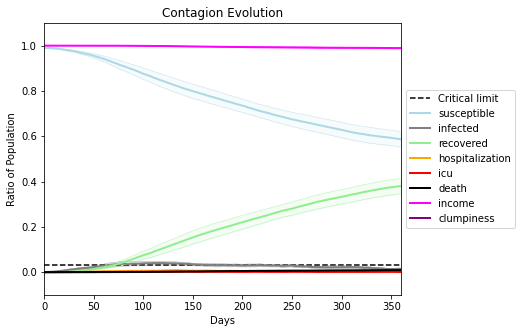

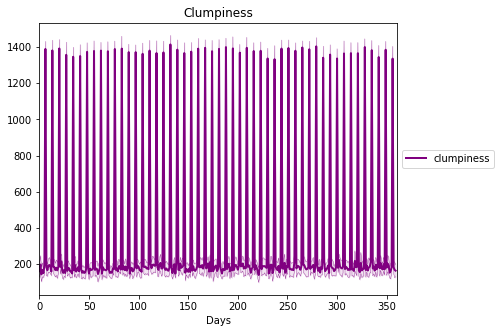

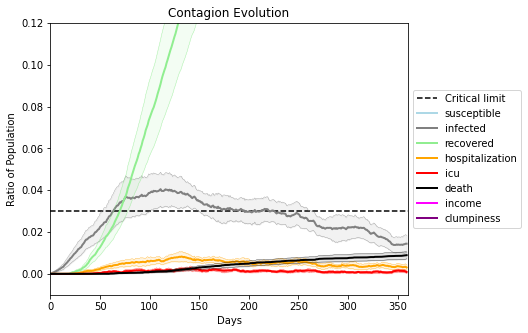

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4262, 9078, 6297, 9461, 3197, 3529, 1334, 1803, 5783, 8388, 3215, 1818, 9741, 2266, 3230, 125, 2740, 4403, 9069, 7864]
Average similarity between family members is 0.9221518139413356 at temperature -0.993
Average similarity between family and home is 0.9998614783745301 at temperature -1
Average similarity between students and their classroom is 0.8445306956729262 at temperature -0.993
Average classroom occupancy is 1.76 and number classrooms is 175
Average similarity between workers is 0.8726762571214192 at temperature -0.993
Average office occupancy is 3.3010204081632653 and number offices is 196
Average friend similarity for adults: 0.8516968905974384 for kids: 0.7407539071449696
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogene

avg restaurant similarity 0.5518791356866843
avg restaurant similarity 0.5769405399519146
avg restaurant similarity 0.5541617743959288
avg restaurant similarity 0.5052441821396457
avg restaurant similarity 0.5917152152589189
avg restaurant similarity 0.6020672675402189
avg restaurant similarity 0.6037240215327372
avg restaurant similarity 0.5558695109732825
avg restaurant similarity 0.6291291051243366
avg restaurant similarity 0.5678935761462827
avg restaurant similarity 0.5865347137217748
avg restaurant similarity 0.6095266367804194
avg restaurant similarity 0.5978798196827526
avg restaurant similarity 0.5516612586620335
avg restaurant similarity 0.5700217840246122
avg restaurant similarity 0.544454233776212
avg restaurant similarity 0.5707653858554537
avg restaurant similarity 0.5832002014080424
avg restaurant similarity 0.592047896097584
avg restaurant similarity 0.5981088930152503
avg restaurant similarity 0.5850352537482343
avg restaurant similarity 0.5642505103110765
avg restaura

avg restaurant similarity 0.6064554055309991
avg restaurant similarity 0.6131437742479808
avg restaurant similarity 0.5379421501107295
avg restaurant similarity 0.5932591568512346
avg restaurant similarity 0.5675414521877715
avg restaurant similarity 0.5555080938615145
avg restaurant similarity 0.5937913904327169
avg restaurant similarity 0.5804234550745091
avg restaurant similarity 0.5689996644653242
avg restaurant similarity 0.6053791212233243
avg restaurant similarity 0.5875694788140343
avg restaurant similarity 0.5924590560481038
avg restaurant similarity 0.48073215366430816
avg restaurant similarity 0.5762410185814191
avg restaurant similarity 0.6320352718195413
avg restaurant similarity 0.5767148837876995
avg restaurant similarity 0.5424168339456684
avg restaurant similarity 0.5753431057565479
avg restaurant similarity 0.5889956581649034
avg restaurant similarity 0.563337146301935
avg restaurant similarity 0.5910812660045567
avg restaurant similarity 0.6188669693664022
avg restau

Average similarity between workers is 0.879446694208425 at temperature -0.993
Average office occupancy is 3.463917525773196 and number offices is 194
Average friend similarity for adults: 0.8600354352147196 for kids: 0.7213642792702595
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5409804521891465
avg restaurant similarity 0.6083808161871187
avg restaurant similarity 0.5920601045471554
avg restaurant similarity 0.5872596272063144
avg restaurant similarity 0.5379795906225706
avg restaurant similarity 0.5916874373055067
avg restaurant similarity 0.5454503448254369
avg restaurant similarity 0.5430789898494953
avg restaurant similarity 0.5621788653214582
avg restaurant similarity 0.5701595736600749
avg restaurant similarity 0.5517784704596415
avg restaurant similarity 0.5113927363362599
avg restaurant similarity 0.5341890395703353
avg restaurant similarity 0.5767042688638226
avg restaurant similarity 0.6041471437410444
avg restaurant similarity 0.5789176533461293
avg restaurant similarity 0.5987917659156994
avg restaurant similarity 0.581753275115348
avg restaurant similarity 0.6085040744571671
avg restaurant similarity 0.5585774298378939
avg restaurant similarity 0.5717963752319529
avg restaurant similarity 0.5906067375928776
avg restaur

avg restaurant similarity 0.5607094888219418
avg restaurant similarity 0.537206891155101
avg restaurant similarity 0.6044710819440244
avg restaurant similarity 0.6052472973485803
avg restaurant similarity 0.5496761741933838
avg restaurant similarity 0.5403707971263312
avg restaurant similarity 0.5637729298626863
avg restaurant similarity 0.5534167510695441
avg restaurant similarity 0.620623844339544
avg restaurant similarity 0.6078426849703781
avg restaurant similarity 0.5482495573258365
avg restaurant similarity 0.5809712663485774
avg restaurant similarity 0.6031605297731922
avg restaurant similarity 0.538397862293567
avg restaurant similarity 0.559342548331965
avg restaurant similarity 0.6233169998780743
avg restaurant similarity 0.5844494589773437
avg restaurant similarity 0.6292992273421366
avg restaurant similarity 0.5785418382094206
avg restaurant similarity 0.6021981440735996
avg restaurant similarity 0.5592035075902355
avg restaurant similarity 0.6020712612091101
avg restaurant

Average similarity between workers is 0.8778480104791921 at temperature -0.993
Average office occupancy is 3.3989637305699483 and number offices is 193
Average friend similarity for adults: 0.8514216064238441 for kids: 0.7214833417607841
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.5327953993391158
avg restaurant similarity 0.5403018078400708
avg restaurant similarity 0.608457375250072
avg restaurant similarity 0.5083449140763364
avg restaurant similarity 0.534582515253934
avg restaurant similarity 0.5592567247449347
avg restaurant similarity 0.5314718739913225
avg restaurant similarity 0.560244731551007
avg restaurant similarity 0.5349460469652503
avg restaurant similarity 0.5642809299855589
avg restaurant similarity 0.5655620954536514
avg restaurant similarity 0.5325756275724791
avg restaurant similarity 0.5020278742318512
avg restaurant similarity 0.5443497832887492
avg restaurant similarity 0.557711088662816
avg restaurant similarity 0.5425593107151434
avg restaurant similarity 0.5651464596550442
avg restaurant similarity 0.549595117563416
avg restaurant similarity 0.5386982069734442
avg restaurant similarity 0.5308566120410522
avg restaurant similarity 0.5390415115579678
avg restaurant similarity 0.5787446890258202
avg restaurant 

avg restaurant similarity 0.48535182329525645
avg restaurant similarity 0.5370352929758182
avg restaurant similarity 0.5533021305651926
avg restaurant similarity 0.4802375170301875
avg restaurant similarity 0.5318069881683496
avg restaurant similarity 0.5386488073956154
avg restaurant similarity 0.5144205027725016
avg restaurant similarity 0.5289107211402102
avg restaurant similarity 0.49937972338564673
avg restaurant similarity 0.4965063555435982
avg restaurant similarity 0.4980547958780081
avg restaurant similarity 0.5135684078474031
avg restaurant similarity 0.5707304119729254
avg restaurant similarity 0.5308604984458369
avg restaurant similarity 0.4834504003561125
avg restaurant similarity 0.5897047698721535
avg restaurant similarity 0.5086983231469803
avg restaurant similarity 0.5149696670750784
avg restaurant similarity 0.5063030156032342
avg restaurant similarity 0.46739100370812137
avg restaurant similarity 0.5278433611174382
avg restaurant similarity 0.5386135124656654
avg res

Average similarity between workers is 0.8648759812007922 at temperature -0.993
Average office occupancy is 3.2474747474747474 and number offices is 198
Average friend similarity for adults: 0.8386324512592335 for kids: 0.7295901282544702
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.5552278052555375
avg restaurant similarity 0.5121299059233378
avg restaurant similarity 0.5409122863358494
avg restaurant similarity 0.5184622462750426
avg restaurant similarity 0.5086198879119264
avg restaurant similarity 0.5164482533398409
avg restaurant similarity 0.5697594343353963
avg restaurant similarity 0.5719334814462124
avg restaurant similarity 0.49114194307225206
avg restaurant similarity 0.5395049677481708
avg restaurant similarity 0.5424792108725799
avg restaurant similarity 0.5170066353368546
avg restaurant similarity 0.5157688052218173
avg restaurant similarity 0.5486904367478904
avg restaurant similarity 0.5146955539957452
avg restaurant similarity 0.5239201990833023
avg restaurant similarity 0.5492375549485098
avg restaurant similarity 0.4733247093872735
avg restaurant similarity 0.4642120600678966
avg restaurant similarity 0.48555342159306003
avg restaurant similarity 0.539145808142218
avg restaurant similarity 0.5130069532242275
avg resta

avg restaurant similarity 0.5084637846304956
avg restaurant similarity 0.5337010557127099
avg restaurant similarity 0.4953195533245477
avg restaurant similarity 0.4534845286090328
avg restaurant similarity 0.46688810516883145
avg restaurant similarity 0.4820022482349763
avg restaurant similarity 0.5136354119524991
avg restaurant similarity 0.5403674110864405
avg restaurant similarity 0.54412545865703
avg restaurant similarity 0.4970437471210965
avg restaurant similarity 0.5172714304198681
avg restaurant similarity 0.5989391426218941
avg restaurant similarity 0.47209535525497287
avg restaurant similarity 0.46337274522560584
avg restaurant similarity 0.5101938814954966
avg restaurant similarity 0.49850161673907933
avg restaurant similarity 0.5443142515970288
avg restaurant similarity 0.5259489902733948
avg restaurant similarity 0.5273309033364608
avg restaurant similarity 0.48249310441944776
avg restaurant similarity 0.5685739616896855
avg restaurant similarity 0.46297718384398084
avg re

Average similarity between workers is 0.8622125614483115 at temperature -0.993
Average office occupancy is 3.372448979591837 and number offices is 196
Average friend similarity for adults: 0.8385650643639048 for kids: 0.7174170326927282
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.4769287137674535
avg restaurant similarity 0.5434392457868876
avg restaurant similarity 0.5122583192825607
avg restaurant similarity 0.5520761584042148
avg restaurant similarity 0.5274775820385859
avg restaurant similarity 0.5369040196433527
avg restaurant similarity 0.5468055556790793
avg restaurant similarity 0.5214939990187438
avg restaurant similarity 0.4970535296973464
avg restaurant similarity 0.5558945126187517
avg restaurant similarity 0.5177324922504649
avg restaurant similarity 0.4987188827143595
avg restaurant similarity 0.5134158885304527
avg restaurant similarity 0.5746779218270631
avg restaurant similarity 0.53559309195337
avg restaurant similarity 0.4871008268130631
avg restaurant similarity 0.5384731199063335
avg restaurant similarity 0.5544759600679119
avg restaurant similarity 0.5468415478324034
avg restaurant similarity 0.557692538347304
avg restaurant similarity 0.5330480876373461
avg restaurant similarity 0.5575910990732029
avg restauran

avg restaurant similarity 0.5077501637670553
avg restaurant similarity 0.5521077075490164
avg restaurant similarity 0.49861910743359983
avg restaurant similarity 0.5500679055668041
avg restaurant similarity 0.5686048047423955
avg restaurant similarity 0.5532301195599323
avg restaurant similarity 0.5555445043970706
avg restaurant similarity 0.5187236671311947
avg restaurant similarity 0.5045068009095114
avg restaurant similarity 0.570757109063182
avg restaurant similarity 0.5509756913636703
avg restaurant similarity 0.5473450510069621
avg restaurant similarity 0.5290398129870504
avg restaurant similarity 0.5252989399463489
avg restaurant similarity 0.5298480270986913
avg restaurant similarity 0.5584030815287352
avg restaurant similarity 0.6170523256195518
avg restaurant similarity 0.55133312849235
avg restaurant similarity 0.5503610320427805
avg restaurant similarity 0.5329697509753196
avg restaurant similarity 0.542582096189859
avg restaurant similarity 0.5606682600288009
avg restauran

Average similarity between workers is 0.8738547941522242 at temperature -0.993
Average office occupancy is 3.5 and number offices is 192
Average friend similarity for adults: 0.8630532456916082 for kids: 0.7226932214992542
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people alloc

avg restaurant similarity 0.607020436669991
avg restaurant similarity 0.6159009865502022
avg restaurant similarity 0.5953188489039654
avg restaurant similarity 0.5761456498362552
avg restaurant similarity 0.5500781788660867
avg restaurant similarity 0.5976030993585403
avg restaurant similarity 0.6020780648072814
avg restaurant similarity 0.5670303724942276
avg restaurant similarity 0.6019693273846263
avg restaurant similarity 0.5948933850684109
avg restaurant similarity 0.6411731012737435
avg restaurant similarity 0.562121895455196
avg restaurant similarity 0.5542717333231852
avg restaurant similarity 0.5692193298008562
avg restaurant similarity 0.5912003855319248
avg restaurant similarity 0.6357788216378351
avg restaurant similarity 0.5914410104174448
avg restaurant similarity 0.6004714921185315
avg restaurant similarity 0.5855174871219425
avg restaurant similarity 0.6155117069487112
avg restaurant similarity 0.573300069845224
avg restaurant similarity 0.5569209993840262
avg restauran

avg restaurant similarity 0.5778774451678537
avg restaurant similarity 0.5881388145938372
avg restaurant similarity 0.6001169553789839
avg restaurant similarity 0.5820676489697622
avg restaurant similarity 0.576215116404347
avg restaurant similarity 0.6449851689624279
avg restaurant similarity 0.6073470137086201
avg restaurant similarity 0.5705488001097133
avg restaurant similarity 0.5782921330739053
avg restaurant similarity 0.6364098420634998
avg restaurant similarity 0.6166304151392267
avg restaurant similarity 0.5861767373209024
avg restaurant similarity 0.6005276550020467
avg restaurant similarity 0.5946321696245179
avg restaurant similarity 0.5935632347056782
avg restaurant similarity 0.6514873672051813
avg restaurant similarity 0.6106072299753009
avg restaurant similarity 0.6004198088182766
avg restaurant similarity 0.6132333400870995
avg restaurant similarity 0.6187868998862578
avg restaurant similarity 0.5954019305899101
avg restaurant similarity 0.6242239633633742
avg restaur

Average similarity between workers is 0.8740684393708809 at temperature -0.993
Average office occupancy is 3.476923076923077 and number offices is 195
Average friend similarity for adults: 0.8483920272060015 for kids: 0.7115321741801481
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 

avg restaurant similarity 0.5829585288679126
avg restaurant similarity 0.5771928787985862
avg restaurant similarity 0.5837482909560251
avg restaurant similarity 0.5619613685925725
avg restaurant similarity 0.5671625882060854
avg restaurant similarity 0.5925606575688903
avg restaurant similarity 0.6089943148715312
avg restaurant similarity 0.5816517287312326
avg restaurant similarity 0.5757216220024712
avg restaurant similarity 0.5584164239842102
avg restaurant similarity 0.6278297779502673
avg restaurant similarity 0.5508608753141357
avg restaurant similarity 0.5852343907029309
avg restaurant similarity 0.5846285490722901
avg restaurant similarity 0.5148604566440809
avg restaurant similarity 0.5597977051157643
avg restaurant similarity 0.568088387387625
avg restaurant similarity 0.567159817022687
avg restaurant similarity 0.5786784330577252
avg restaurant similarity 0.611770113356725
avg restaurant similarity 0.5631312697065696
avg restaurant similarity 0.5979933161021966
avg restauran

avg restaurant similarity 0.5717842382759
avg restaurant similarity 0.5769398072884145
avg restaurant similarity 0.5396638837108606
avg restaurant similarity 0.5848887488915634
avg restaurant similarity 0.5511571357994183
avg restaurant similarity 0.5697537239006853
avg restaurant similarity 0.6023217348722959
avg restaurant similarity 0.5995391990142767
avg restaurant similarity 0.559824847063503
avg restaurant similarity 0.5868213710126245
avg restaurant similarity 0.5838700448131304
avg restaurant similarity 0.5693017574267958
avg restaurant similarity 0.6050223330305318
avg restaurant similarity 0.6028398556996386
avg restaurant similarity 0.5820771552686118
avg restaurant similarity 0.535050702232209
avg restaurant similarity 0.5671702423275664
avg restaurant similarity 0.5523761116394124
avg restaurant similarity 0.5850271627132735
avg restaurant similarity 0.5372592985201655
avg restaurant similarity 0.5906533945392887
avg restaurant similarity 0.5671731475775543
avg restaurant 

Average similarity between workers is 0.8711872415206037 at temperature -0.993
Average office occupancy is 3.345549738219895 and number offices is 191
Average friend similarity for adults: 0.8441717094044277 for kids: 0.7299757311426476
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 6 people.
Total of 

avg restaurant similarity 0.5929846958849521
avg restaurant similarity 0.5767449212650579
avg restaurant similarity 0.6040372846881867
avg restaurant similarity 0.5728392285715176
avg restaurant similarity 0.5633399010690929
avg restaurant similarity 0.5799053608824892
avg restaurant similarity 0.5652731249821713
avg restaurant similarity 0.5408109110937859
avg restaurant similarity 0.5699289913623937
avg restaurant similarity 0.6008564907619965
avg restaurant similarity 0.5427758351301002
avg restaurant similarity 0.5851894317023407
avg restaurant similarity 0.5837903597096673
avg restaurant similarity 0.5356258464491953
avg restaurant similarity 0.6099023187447988
avg restaurant similarity 0.6132886247688828
avg restaurant similarity 0.5497640791672562
avg restaurant similarity 0.5490897071169416
avg restaurant similarity 0.5629190586906321
avg restaurant similarity 0.5796784001539116
avg restaurant similarity 0.5331282557646493
avg restaurant similarity 0.5955056541279761
avg restau

avg restaurant similarity 0.576942296495287
avg restaurant similarity 0.6015228677326192
avg restaurant similarity 0.6087408083338367
avg restaurant similarity 0.5786293555565846
avg restaurant similarity 0.556560365046663
avg restaurant similarity 0.554027981216071
avg restaurant similarity 0.5925306052709053
avg restaurant similarity 0.5730373660745378
avg restaurant similarity 0.5362599913083491
avg restaurant similarity 0.603991839476183
avg restaurant similarity 0.5836745437628424
avg restaurant similarity 0.6039873918555937
avg restaurant similarity 0.5757155329639106
avg restaurant similarity 0.5541093598337586
avg restaurant similarity 0.5603201545452773
avg restaurant similarity 0.5915403494273832
avg restaurant similarity 0.6107309152291152
avg restaurant similarity 0.5781037430720248
avg restaurant similarity 0.6405859148150461
avg restaurant similarity 0.5222638233075274
avg restaurant similarity 0.5673805016980648
avg restaurant similarity 0.6040364462371246
avg restaurant

Average similarity between workers is 0.870951614928116 at temperature -0.993
Average office occupancy is 3.3604060913705585 and number offices is 197
Average friend similarity for adults: 0.8538189036938935 for kids: 0.7289977852757639
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 1

avg restaurant similarity 0.6060002877503698
avg restaurant similarity 0.5988676738330435
avg restaurant similarity 0.5515786567209355
avg restaurant similarity 0.5668588357029776
avg restaurant similarity 0.5839127278161552
avg restaurant similarity 0.5700827498003112
avg restaurant similarity 0.5955979180685081
avg restaurant similarity 0.5067137310547141
avg restaurant similarity 0.5320898906455942
avg restaurant similarity 0.5900014366322195
avg restaurant similarity 0.5442426737467648
avg restaurant similarity 0.5647485276146608
avg restaurant similarity 0.5512514006781876
avg restaurant similarity 0.5920180729280252
avg restaurant similarity 0.5641612077897693
avg restaurant similarity 0.5388142115267456
avg restaurant similarity 0.55984225477811
avg restaurant similarity 0.5905802302530602
avg restaurant similarity 0.5581617869390398
avg restaurant similarity 0.6062993360289055
avg restaurant similarity 0.5051122204867301
avg restaurant similarity 0.5714572423469212
avg restaura

avg restaurant similarity 0.5952143149995086
avg restaurant similarity 0.5790797283944809
avg restaurant similarity 0.5792452493882831
avg restaurant similarity 0.5672508001309041
avg restaurant similarity 0.5603508081289335
avg restaurant similarity 0.5424265640172258
avg restaurant similarity 0.5215180822007
avg restaurant similarity 0.580586507486065
avg restaurant similarity 0.5337233594416271
avg restaurant similarity 0.5690604207065952
avg restaurant similarity 0.5426617804768666
avg restaurant similarity 0.5528757340586722
avg restaurant similarity 0.6311653758094141
avg restaurant similarity 0.6288865785756436
avg restaurant similarity 0.5129365165465288
avg restaurant similarity 0.5661607305472993
avg restaurant similarity 0.597190408114317
avg restaurant similarity 0.5873463914741369
avg restaurant similarity 0.6149079696782568
avg restaurant similarity 0.5350463435005085
avg restaurant similarity 0.5607469632742874
avg restaurant similarity 0.5147851565446229
avg restaurant 

Average similarity between workers is 0.882639744431613 at temperature -0.993
Average office occupancy is 3.3622448979591835 and number offices is 196
Average friend similarity for adults: 0.8546670716250656 for kids: 0.7256277667316934
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 1

avg restaurant similarity 0.5922726905878242
avg restaurant similarity 0.552790559931561
avg restaurant similarity 0.5067189360094044
avg restaurant similarity 0.5821532473486455
avg restaurant similarity 0.6060402425463977
avg restaurant similarity 0.558187026445101
avg restaurant similarity 0.5444825108726689
avg restaurant similarity 0.5849126287754001
avg restaurant similarity 0.5699032208153852
avg restaurant similarity 0.5670505356202494
avg restaurant similarity 0.5284040062693738
avg restaurant similarity 0.5209171454498253
avg restaurant similarity 0.550646264213254
avg restaurant similarity 0.5391831409785703
avg restaurant similarity 0.5538573870896154
avg restaurant similarity 0.5595131377100551
avg restaurant similarity 0.5521962099107058
avg restaurant similarity 0.5026231830062758
avg restaurant similarity 0.5570715068982164
avg restaurant similarity 0.5194074468204706
avg restaurant similarity 0.4780233752148895
avg restaurant similarity 0.555112768409379
avg restaurant

avg restaurant similarity 0.5504826034034135
avg restaurant similarity 0.5343510218064665
avg restaurant similarity 0.5441349823326833
avg restaurant similarity 0.5063594475560365
avg restaurant similarity 0.5942604216396022
avg restaurant similarity 0.5540080157447328
avg restaurant similarity 0.546215742865568
avg restaurant similarity 0.5397038074644331
avg restaurant similarity 0.5293014175623127
avg restaurant similarity 0.5586165140307648
avg restaurant similarity 0.5849983590068191
avg restaurant similarity 0.5134362362758211
avg restaurant similarity 0.4937639623866967
avg restaurant similarity 0.5434543891788444
avg restaurant similarity 0.5790429786297683
avg restaurant similarity 0.586724381692189
avg restaurant similarity 0.5850172686565346
avg restaurant similarity 0.5583059395218144
avg restaurant similarity 0.5617058876389858
avg restaurant similarity 0.5612427628827305
avg restaurant similarity 0.5350735377098943
avg restaurant similarity 0.5499626943422075
avg restaura

Average similarity between workers is 0.864878373785617 at temperature -0.993
Average office occupancy is 3.2 and number offices is 195
Average friend similarity for adults: 0.832745745006092 for kids: 0.7360193790596052
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people alloc

avg restaurant similarity 0.48400019326860977
avg restaurant similarity 0.5712529141767337
avg restaurant similarity 0.5503156617824047
avg restaurant similarity 0.556422440388098
avg restaurant similarity 0.5878108886041112
avg restaurant similarity 0.5467691006454136
avg restaurant similarity 0.4619103774788876
avg restaurant similarity 0.5559250573769643
avg restaurant similarity 0.5973121525456365
avg restaurant similarity 0.5459233699635034
avg restaurant similarity 0.497065947951359
avg restaurant similarity 0.5366487719923674
avg restaurant similarity 0.5308627743170821
avg restaurant similarity 0.5324152484681164
avg restaurant similarity 0.5893759897901337
avg restaurant similarity 0.5729356819952023
avg restaurant similarity 0.5151332946788522
avg restaurant similarity 0.506097770986135
avg restaurant similarity 0.4725172300517996
avg restaurant similarity 0.5234519166100794
avg restaurant similarity 0.5584711550636202
avg restaurant similarity 0.5432828249150037
avg restaura

avg restaurant similarity 0.48388284061062753
avg restaurant similarity 0.5445047882544997
avg restaurant similarity 0.54887316610924
avg restaurant similarity 0.5482664369979972
avg restaurant similarity 0.5219539372096238
avg restaurant similarity 0.5917033932249097
avg restaurant similarity 0.5011463490499307
avg restaurant similarity 0.5726834649090272
avg restaurant similarity 0.6052621583382249
avg restaurant similarity 0.48652664126229966
avg restaurant similarity 0.4927364784056603
avg restaurant similarity 0.534579031380011
avg restaurant similarity 0.5915756900852185
avg restaurant similarity 0.4831225606833538
avg restaurant similarity 0.5254546649853394
avg restaurant similarity 0.5609917572965945
avg restaurant similarity 0.611948096007265
avg restaurant similarity 0.545163632290846
avg restaurant similarity 0.5611480435711482
avg restaurant similarity 0.5619319114236351
avg restaurant similarity 0.5413846654981809
avg restaurant similarity 0.6089266315417939
avg restauran

Average similarity between workers is 0.8822353736104743 at temperature -0.993
Average office occupancy is 3.4554973821989527 and number offices is 191
Average friend similarity for adults: 0.8489009341279353 for kids: 0.724439830799467
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5134188413701906
avg restaurant similarity 0.5098800851304858
avg restaurant similarity 0.5059384159753075
avg restaurant similarity 0.5227534952308187
avg restaurant similarity 0.5174629331417747
avg restaurant similarity 0.5546703906205152
avg restaurant similarity 0.5690645198754519
avg restaurant similarity 0.5467369486425346
avg restaurant similarity 0.5256623034106751
avg restaurant similarity 0.5403780241914434
avg restaurant similarity 0.5526018588749443
avg restaurant similarity 0.49459651315396236
avg restaurant similarity 0.5160528857711594
avg restaurant similarity 0.5948336408802579
avg restaurant similarity 0.5311202673565091
avg restaurant similarity 0.47409609125952257
avg restaurant similarity 0.5160305030206075
avg restaurant similarity 0.49036374275367645
avg restaurant similarity 0.5434471282444775
avg restaurant similarity 0.5309552516045852
avg restaurant similarity 0.497153250420514
avg restaurant similarity 0.5519335605104819
avg rest

avg restaurant similarity 0.4830130163048621
avg restaurant similarity 0.5154890941426346
avg restaurant similarity 0.5369473588103365
avg restaurant similarity 0.49902269939382743
avg restaurant similarity 0.543626406997136
avg restaurant similarity 0.5719373948864078
avg restaurant similarity 0.5889353693438226
avg restaurant similarity 0.4918933241609809
avg restaurant similarity 0.49128644230342466
avg restaurant similarity 0.5014716804384404
avg restaurant similarity 0.5139450514407211
avg restaurant similarity 0.5081382416776685
avg restaurant similarity 0.5176784886006554
avg restaurant similarity 0.4878129998417508
avg restaurant similarity 0.5630650073330219
avg restaurant similarity 0.475278513864977
avg restaurant similarity 0.513061919062193
avg restaurant similarity 0.5394500233855128
avg restaurant similarity 0.4820651541435367
avg restaurant similarity 0.49068311290913097
avg restaurant similarity 0.54704978014695
avg restaurant similarity 0.555668685604648
avg restauran

Average similarity between workers is 0.8798433601778878 at temperature -0.993
Average office occupancy is 3.3622448979591835 and number offices is 196
Average friend similarity for adults: 0.8531008199007146 for kids: 0.7438468021523844
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total o

avg restaurant similarity 0.5456782881721226
avg restaurant similarity 0.5726508153256774
avg restaurant similarity 0.5578895321131963
avg restaurant similarity 0.5601941367183813
avg restaurant similarity 0.5678422338744616
avg restaurant similarity 0.525638147705436
avg restaurant similarity 0.5612968334538585
avg restaurant similarity 0.5516108542675606
avg restaurant similarity 0.593757996815708
avg restaurant similarity 0.5630596802559265
avg restaurant similarity 0.5061896745306255
avg restaurant similarity 0.5935135410007789
avg restaurant similarity 0.5913039446446378
avg restaurant similarity 0.5300193390122738
avg restaurant similarity 0.5904531015207466
avg restaurant similarity 0.5668593613785308
avg restaurant similarity 0.5537852736619323
avg restaurant similarity 0.5329093764428897
avg restaurant similarity 0.5967026439109088
avg restaurant similarity 0.5711625978525502
avg restaurant similarity 0.5700786608534715
avg restaurant similarity 0.6209545121878759
avg restaura

avg restaurant similarity 0.6128332517133936
avg restaurant similarity 0.5916084959783425
avg restaurant similarity 0.591577775628703
avg restaurant similarity 0.5794499315752448
avg restaurant similarity 0.48434803107105795
avg restaurant similarity 0.5216003319220495
avg restaurant similarity 0.6170149707221568
avg restaurant similarity 0.5694018830042977
avg restaurant similarity 0.6140855796342866
avg restaurant similarity 0.55242512413594
avg restaurant similarity 0.5263600171798104
avg restaurant similarity 0.5312842587068528
avg restaurant similarity 0.5696803692373165
avg restaurant similarity 0.5741595941901073
avg restaurant similarity 0.5709262375473934
avg restaurant similarity 0.5404297467977014
avg restaurant similarity 0.5338184184868903
avg restaurant similarity 0.5039718076116493
avg restaurant similarity 0.5508873531238084
avg restaurant similarity 0.6026903040634203
avg restaurant similarity 0.6263183830729717
avg restaurant similarity 0.5441054391937795
avg restaura

Average similarity between workers is 0.8707401503109458 at temperature -0.993
Average office occupancy is 3.454081632653061 and number offices is 196
Average friend similarity for adults: 0.8542930273817385 for kids: 0.7222904518939764
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.5755399737806224
avg restaurant similarity 0.6047729397130979
avg restaurant similarity 0.5312990080278884
avg restaurant similarity 0.5302479639594982
avg restaurant similarity 0.530523636281088
avg restaurant similarity 0.5561005911300735
avg restaurant similarity 0.5651568700112858
avg restaurant similarity 0.5777629855593441
avg restaurant similarity 0.5848334313628161
avg restaurant similarity 0.5322210213642848
avg restaurant similarity 0.5616149535752003
avg restaurant similarity 0.5395623476759543
avg restaurant similarity 0.5880167774968585
avg restaurant similarity 0.5512943066522751
avg restaurant similarity 0.6442775839575191
avg restaurant similarity 0.5883318044525774
avg restaurant similarity 0.5742498421035759
avg restaurant similarity 0.5831611986562096
avg restaurant similarity 0.5364681082568233
avg restaurant similarity 0.517417613722633
avg restaurant similarity 0.5526746206088633
avg restaurant similarity 0.5623069871938948
avg restaura

avg restaurant similarity 0.5541576235934706
avg restaurant similarity 0.5263278636416775
avg restaurant similarity 0.5687067811888366
avg restaurant similarity 0.5632303547477447
avg restaurant similarity 0.5276879568037003
avg restaurant similarity 0.544039087569816
avg restaurant similarity 0.5647743552536968
avg restaurant similarity 0.5587652330739956
avg restaurant similarity 0.571346666164578
avg restaurant similarity 0.5202464682740466
avg restaurant similarity 0.5553220521060536
avg restaurant similarity 0.6056092818021345
avg restaurant similarity 0.5287221241707171
avg restaurant similarity 0.5951094163396781
avg restaurant similarity 0.557208084550217
avg restaurant similarity 0.5429699129615575
avg restaurant similarity 0.5570499598768354
avg restaurant similarity 0.5272058451851058
avg restaurant similarity 0.5273192460906929
avg restaurant similarity 0.5895016955318648
avg restaurant similarity 0.5515933399927192
avg restaurant similarity 0.5364481595990214
avg restauran

Average similarity between workers is 0.8757973174579975 at temperature -0.993
Average office occupancy is 3.3469387755102042 and number offices is 196
Average friend similarity for adults: 0.853028229350449 for kids: 0.7376440715390243
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.5950264961742647
avg restaurant similarity 0.5728623111008788
avg restaurant similarity 0.4882944841754417
avg restaurant similarity 0.5900891806504271
avg restaurant similarity 0.6078338869839445
avg restaurant similarity 0.5181528975719758
avg restaurant similarity 0.5598915845533656
avg restaurant similarity 0.5748059086830811
avg restaurant similarity 0.610340048587217
avg restaurant similarity 0.5579271882907542
avg restaurant similarity 0.556069726567867
avg restaurant similarity 0.592613248946891
avg restaurant similarity 0.5976147389896361
avg restaurant similarity 0.5218627395030644
avg restaurant similarity 0.5401625161623611
avg restaurant similarity 0.561967515728695
avg restaurant similarity 0.6013941790347355
avg restaurant similarity 0.5825194584412894
avg restaurant similarity 0.5143303316690343
avg restaurant similarity 0.5819409326910647
avg restaurant similarity 0.486747349970389
avg restaurant similarity 0.5182352106212458
avg restaurant 

avg restaurant similarity 0.5783857633159588
avg restaurant similarity 0.5698342124736661
avg restaurant similarity 0.5623920905791032
avg restaurant similarity 0.5356922325596141
avg restaurant similarity 0.5280776130743559
avg restaurant similarity 0.5423705685078778
avg restaurant similarity 0.513207303517131
avg restaurant similarity 0.5699450166438086
avg restaurant similarity 0.6249259213377948
avg restaurant similarity 0.5758170623304856
avg restaurant similarity 0.5594610694521296
avg restaurant similarity 0.5579386497372274
avg restaurant similarity 0.529338252219363
avg restaurant similarity 0.6169263913945665
avg restaurant similarity 0.573572208965348
avg restaurant similarity 0.5836484751095393
avg restaurant similarity 0.5894953003955039
avg restaurant similarity 0.5193692020861492
avg restaurant similarity 0.5643501385873828
avg restaurant similarity 0.5741570985254445
avg restaurant similarity 0.5711922316761245
avg restaurant similarity 0.5630993325618048
avg restauran

Average similarity between workers is 0.8694626801154886 at temperature -0.993
Average office occupancy is 3.271356783919598 and number offices is 199
Average friend similarity for adults: 0.8408279231035521 for kids: 0.7282789962126492
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 

avg restaurant similarity 0.5428422352708976
avg restaurant similarity 0.5028551049742396
avg restaurant similarity 0.5141611440942455
avg restaurant similarity 0.5976951653649895
avg restaurant similarity 0.5667774726224131
avg restaurant similarity 0.545858386606733
avg restaurant similarity 0.5736903601983104
avg restaurant similarity 0.5119145303105661
avg restaurant similarity 0.6054592522804855
avg restaurant similarity 0.5638459409519642
avg restaurant similarity 0.5739704710321144
avg restaurant similarity 0.527833751373753
avg restaurant similarity 0.5451034211648477
avg restaurant similarity 0.5616895872837072
avg restaurant similarity 0.5332975190459867
avg restaurant similarity 0.5369001541703724
avg restaurant similarity 0.5873134709308012
avg restaurant similarity 0.5331346682949738
avg restaurant similarity 0.5410589984884557
avg restaurant similarity 0.5510589317561457
avg restaurant similarity 0.5196223018123849
avg restaurant similarity 0.5620095274939365
avg restaura

avg restaurant similarity 0.5879907113485523
avg restaurant similarity 0.5256304826246674
avg restaurant similarity 0.5897492151363389
avg restaurant similarity 0.5370020247280365
avg restaurant similarity 0.5198926705414978
avg restaurant similarity 0.5428285016090717
avg restaurant similarity 0.5519615860861691
avg restaurant similarity 0.48372633826216954
avg restaurant similarity 0.5931510263469252
avg restaurant similarity 0.5516983767712325
avg restaurant similarity 0.5718466851806626
avg restaurant similarity 0.5436722736282956
avg restaurant similarity 0.5785945131483892
avg restaurant similarity 0.5659190032982189
avg restaurant similarity 0.5324110614173684
avg restaurant similarity 0.5774808000216363
avg restaurant similarity 0.5707662186149021
avg restaurant similarity 0.5597410409734458
avg restaurant similarity 0.6203875666659244
avg restaurant similarity 0.5675918127902536
avg restaurant similarity 0.5532317715366093
avg restaurant similarity 0.554335457574456
avg restau

Average similarity between workers is 0.8749479605454509 at temperature -0.993
Average office occupancy is 3.3333333333333335 and number offices is 195
Average friend similarity for adults: 0.8415136154082953 for kids: 0.7217256289470828
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 

avg restaurant similarity 0.5281774797060521
avg restaurant similarity 0.5289963785341343
avg restaurant similarity 0.5447508621138658
avg restaurant similarity 0.5424739822427393
avg restaurant similarity 0.5289572048675647
avg restaurant similarity 0.5311958736500436
avg restaurant similarity 0.5262504238569794
avg restaurant similarity 0.5197508948753353
avg restaurant similarity 0.577307256476855
avg restaurant similarity 0.4704282513049231
avg restaurant similarity 0.5152594735742633
avg restaurant similarity 0.4415045023789496
avg restaurant similarity 0.5236317228948515
avg restaurant similarity 0.5301659754880629
avg restaurant similarity 0.5796723443106278
avg restaurant similarity 0.5123436954090979
avg restaurant similarity 0.5333652616844108
avg restaurant similarity 0.5872269337677705
avg restaurant similarity 0.5713828109739333
avg restaurant similarity 0.5521905180920413
avg restaurant similarity 0.5296889119785466
avg restaurant similarity 0.5223796043482234
avg restaur

avg restaurant similarity 0.5152913775321405
avg restaurant similarity 0.5265448548920342
avg restaurant similarity 0.5129897801567835
avg restaurant similarity 0.496345528604178
avg restaurant similarity 0.5493693850167912
avg restaurant similarity 0.5855192521812111
avg restaurant similarity 0.5921400543986326
avg restaurant similarity 0.47753997985508273
avg restaurant similarity 0.5145931544225293
avg restaurant similarity 0.5036616361503604
avg restaurant similarity 0.4982434871016395
avg restaurant similarity 0.5752398771685994
avg restaurant similarity 0.5782567657971185
avg restaurant similarity 0.5336834067188119
avg restaurant similarity 0.5355665644339613
avg restaurant similarity 0.5354908326029195
avg restaurant similarity 0.514212935278335
avg restaurant similarity 0.5542921253558454
avg restaurant similarity 0.5040859492477957
avg restaurant similarity 0.5175460378362875
avg restaurant similarity 0.6229075284446389
avg restaurant similarity 0.5374968277283494
avg restaur

Average similarity between workers is 0.8651149286201959 at temperature -0.993
Average office occupancy is 3.3165829145728645 and number offices is 199
Average friend similarity for adults: 0.835033360515902 for kids: 0.7086591452423886
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.6194108003394432
avg restaurant similarity 0.5549676762286985
avg restaurant similarity 0.5873706527051974
avg restaurant similarity 0.5797780949904097
avg restaurant similarity 0.6113707046894028
avg restaurant similarity 0.568818507042266
avg restaurant similarity 0.6128995104207011
avg restaurant similarity 0.5715896077505505
avg restaurant similarity 0.5705636352246699
avg restaurant similarity 0.6216893473807933
avg restaurant similarity 0.5634476750328439
avg restaurant similarity 0.5642025523297705
avg restaurant similarity 0.5426963317658914
avg restaurant similarity 0.5490712634990083
avg restaurant similarity 0.5400598462778498
avg restaurant similarity 0.6061998935236781
avg restaurant similarity 0.5485120691246249
avg restaurant similarity 0.5962601916632283
avg restaurant similarity 0.5684838142368539
avg restaurant similarity 0.5960214718920732
avg restaurant similarity 0.5581302539999884
avg restaurant similarity 0.4956624050275327
avg restaur

avg restaurant similarity 0.5658181898294111
avg restaurant similarity 0.5478888665107157
avg restaurant similarity 0.59815840468346
avg restaurant similarity 0.5488499963350535
avg restaurant similarity 0.5645416174801012
avg restaurant similarity 0.5541887733556802
avg restaurant similarity 0.5579100371876582
avg restaurant similarity 0.5161512763050911
avg restaurant similarity 0.5782498565636538
avg restaurant similarity 0.5883765884614143
avg restaurant similarity 0.5481380303530504
avg restaurant similarity 0.5757503414977382
avg restaurant similarity 0.5312897194738094
avg restaurant similarity 0.5939882215852421
avg restaurant similarity 0.5677077581073555
avg restaurant similarity 0.6337732242609267
avg restaurant similarity 0.5551909769216818
avg restaurant similarity 0.571101922822475
avg restaurant similarity 0.586509882121651
avg restaurant similarity 0.5836334663712689
avg restaurant similarity 0.5401249214041898
avg restaurant similarity 0.5424954318288232
avg restaurant

Average similarity between workers is 0.860491814966014 at temperature -0.993
Average office occupancy is 3.207070707070707 and number offices is 198
Average friend similarity for adults: 0.8429453640469268 for kids: 0.7471359412728299
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 14 people.
Total of 14 p

avg restaurant similarity 0.6016144775054735
avg restaurant similarity 0.5708787999675987
avg restaurant similarity 0.5766041632965204
avg restaurant similarity 0.5559795695883153
avg restaurant similarity 0.6163210035554824
avg restaurant similarity 0.5497007468612117
avg restaurant similarity 0.6050204474076518
avg restaurant similarity 0.5778359972812608
avg restaurant similarity 0.5518561784988544
avg restaurant similarity 0.569735757500959
avg restaurant similarity 0.5929762761832074
avg restaurant similarity 0.5915380903863466
avg restaurant similarity 0.5675438981482079
avg restaurant similarity 0.5316654384935869
avg restaurant similarity 0.5558779289786018
avg restaurant similarity 0.5855315123246311
avg restaurant similarity 0.5324006191683093
avg restaurant similarity 0.6017797311145123
avg restaurant similarity 0.529870764926434
avg restaurant similarity 0.5722578912217288
avg restaurant similarity 0.5800952753985994
avg restaurant similarity 0.5727455311954224
avg restaura

avg restaurant similarity 0.5756518602958639
avg restaurant similarity 0.540863723043291
avg restaurant similarity 0.5395300093187161
avg restaurant similarity 0.5839251543767424
avg restaurant similarity 0.5637655032748662
avg restaurant similarity 0.535957739747689
avg restaurant similarity 0.5270620611689592
avg restaurant similarity 0.5114101865242277
avg restaurant similarity 0.5568577940440239
avg restaurant similarity 0.5857785521397618
avg restaurant similarity 0.5610346036546463
avg restaurant similarity 0.5438168019042531
avg restaurant similarity 0.5538814616763226
avg restaurant similarity 0.6059023728662574
avg restaurant similarity 0.5631973315825094
avg restaurant similarity 0.5736393310014493
avg restaurant similarity 0.5708535365792405
avg restaurant similarity 0.5438755233099032
avg restaurant similarity 0.5625739179468959
avg restaurant similarity 0.5835624836664632
avg restaurant similarity 0.5738815206430885
avg restaurant similarity 0.5326109390362329
avg restaura

Average similarity between workers is 0.8719313763103079 at temperature -0.993
Average office occupancy is 3.435233160621762 and number offices is 193
Average friend similarity for adults: 0.8557819365235252 for kids: 0.726824001830892
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 peo

avg restaurant similarity 0.5741481539793009
avg restaurant similarity 0.5593484982728143
avg restaurant similarity 0.5647122062773708
avg restaurant similarity 0.5255125807609053
avg restaurant similarity 0.6153239975512693
avg restaurant similarity 0.5769681024230512
avg restaurant similarity 0.5891855698161879
avg restaurant similarity 0.5817714951215477
avg restaurant similarity 0.594911406377311
avg restaurant similarity 0.5265823019921666
avg restaurant similarity 0.5524349172331684
avg restaurant similarity 0.5377573019695305
avg restaurant similarity 0.5332614284809593
avg restaurant similarity 0.506586416499475
avg restaurant similarity 0.5699914651022311
avg restaurant similarity 0.5555150614253405
avg restaurant similarity 0.5338969106558745
avg restaurant similarity 0.584710921150774
avg restaurant similarity 0.5399403903564362
avg restaurant similarity 0.5870186500574038
avg restaurant similarity 0.5578168305420534
avg restaurant similarity 0.5330249547713146
avg restauran

avg restaurant similarity 0.5720472297187955
avg restaurant similarity 0.5605201565519645
avg restaurant similarity 0.5986550346979964
avg restaurant similarity 0.5700303751124914
avg restaurant similarity 0.6041660708831331
avg restaurant similarity 0.5370234055746826
avg restaurant similarity 0.524809857117917
avg restaurant similarity 0.5253185405843106
avg restaurant similarity 0.5403226266757251
avg restaurant similarity 0.5626194850211421
avg restaurant similarity 0.5600155034579984
avg restaurant similarity 0.5822036539681565
avg restaurant similarity 0.5579128498968318
avg restaurant similarity 0.5780791235110232
avg restaurant similarity 0.6005848204015323
avg restaurant similarity 0.5833082415026207
avg restaurant similarity 0.545352769243039
avg restaurant similarity 0.5804283226639342
avg restaurant similarity 0.5551003764879379
avg restaurant similarity 0.5679630346580367
avg restaurant similarity 0.4969191561428544
avg restaurant similarity 0.49913997901212853
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

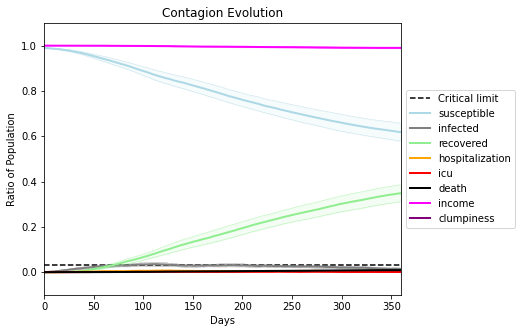

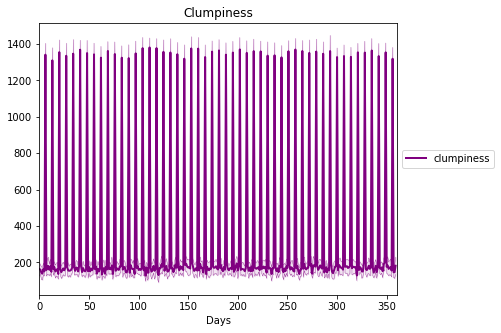

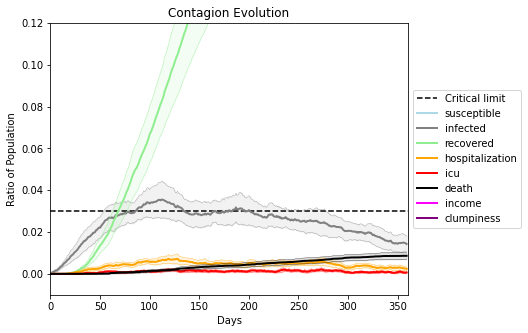

In [12]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[923, 809, 9396, 3502, 6701, 4766, 878, 5329, 7493, 1165, 2758, 1683, 4350, 400, 447, 9987, 1114, 2841, 3604, 467]
Average similarity between family members is 0.9186876410735798 at temperature -0.992
Average similarity between family and home is 0.9998469626075709 at temperature -1
Average similarity between students and their classroom is 0.824109295252593 at temperature -0.992
Average classroom occupancy is 1.73125 and number classrooms is 160
Average similarity between workers is 0.8427056742471934 at temperature -0.992
Average office occupancy is 3.2536585365853656 and number offices is 205
Average friend similarity for adults: 0.834119810206079 for kids: 0.7236715728951106
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBui

avg restaurant similarity 0.589953992642916
avg restaurant similarity 0.5274780758219326
avg restaurant similarity 0.57121522756347
avg restaurant similarity 0.5000255091725542
avg restaurant similarity 0.5056833136781911
avg restaurant similarity 0.5360093875476071
avg restaurant similarity 0.5457148154804848
avg restaurant similarity 0.5294916196993529
avg restaurant similarity 0.5540459882719224
avg restaurant similarity 0.5377635823421615
avg restaurant similarity 0.5720979552459897
avg restaurant similarity 0.5622804668036117
avg restaurant similarity 0.5491168373856921
avg restaurant similarity 0.5484801741114875
avg restaurant similarity 0.49473218041389416
avg restaurant similarity 0.5230324083055555
avg restaurant similarity 0.5126437146703835
avg restaurant similarity 0.5454199864929862
avg restaurant similarity 0.5361368323478978
avg restaurant similarity 0.5701172222385205
avg restaurant similarity 0.5046999689452397
avg restaurant similarity 0.5713209211430235
avg restaura

avg restaurant similarity 0.573617479955577
avg restaurant similarity 0.5618843334905146
avg restaurant similarity 0.552593040969221
avg restaurant similarity 0.5069721408938803
avg restaurant similarity 0.5760065056346847
avg restaurant similarity 0.5193309953307143
avg restaurant similarity 0.5365525014370408
avg restaurant similarity 0.5867362502738092
avg restaurant similarity 0.5341902051434116
avg restaurant similarity 0.5393393139890261
avg restaurant similarity 0.5457917409314205
avg restaurant similarity 0.511308659709527
avg restaurant similarity 0.5558954732724523
avg restaurant similarity 0.546544179491881
avg restaurant similarity 0.5594479408068601
avg restaurant similarity 0.5630809092940978
avg restaurant similarity 0.5415921260945519
avg restaurant similarity 0.5247392998568833
avg restaurant similarity 0.5385015040725075
avg restaurant similarity 0.5376726323807095
avg restaurant similarity 0.5579427347618
avg restaurant similarity 0.5662005171862969
avg restaurant si

Average similarity between workers is 0.8449456893666758 at temperature -0.992
Average office occupancy is 3.353846153846154 and number offices is 195
Average friend similarity for adults: 0.8380338461209086 for kids: 0.7179530959361394
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5303527677785301
avg restaurant similarity 0.5361249608707085
avg restaurant similarity 0.557068988243767
avg restaurant similarity 0.552722872575181
avg restaurant similarity 0.5429777410014047
avg restaurant similarity 0.5468937919137987
avg restaurant similarity 0.5270869774892377
avg restaurant similarity 0.5603562860999084
avg restaurant similarity 0.5268172112303474
avg restaurant similarity 0.5585162974783672
avg restaurant similarity 0.5757261430928994
avg restaurant similarity 0.5190259482737715
avg restaurant similarity 0.6083729459924686
avg restaurant similarity 0.5709368848155043
avg restaurant similarity 0.5447583507390985
avg restaurant similarity 0.5585302983913193
avg restaurant similarity 0.5726478093693842
avg restaurant similarity 0.5125788376787058
avg restaurant similarity 0.6018784727648016
avg restaurant similarity 0.5307382266441873
avg restaurant similarity 0.48596829780546524
avg restaurant similarity 0.5821291221624489
avg restaur

avg restaurant similarity 0.5243486821208242
avg restaurant similarity 0.5249943965954391
avg restaurant similarity 0.5445322810640967
avg restaurant similarity 0.5128322249034638
avg restaurant similarity 0.5726250600958098
avg restaurant similarity 0.5387257086824598
avg restaurant similarity 0.5343380127983686
avg restaurant similarity 0.5396818952571769
avg restaurant similarity 0.5160837043054749
avg restaurant similarity 0.586198988035972
avg restaurant similarity 0.5723737322939486
avg restaurant similarity 0.5738953241857813
avg restaurant similarity 0.5187154135348148
avg restaurant similarity 0.5469137227112819
avg restaurant similarity 0.5486536543445755
avg restaurant similarity 0.5519080718386001
avg restaurant similarity 0.512314107194782
avg restaurant similarity 0.5558406538656476
avg restaurant similarity 0.5293813156922791
avg restaurant similarity 0.5397198602931884
avg restaurant similarity 0.5831468189343668
avg restaurant similarity 0.5517142963429645
avg restaura

Average similarity between workers is 0.838522050807521 at temperature -0.992
Average office occupancy is 3.2746113989637307 and number offices is 193
Average friend similarity for adults: 0.84111146924343 for kids: 0.7324244068827135
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 pe

avg restaurant similarity 0.4744341970503281
avg restaurant similarity 0.5665552101033793
avg restaurant similarity 0.49408428738218074
avg restaurant similarity 0.485596125490336
avg restaurant similarity 0.49417149064203086
avg restaurant similarity 0.5522437596756922
avg restaurant similarity 0.5113599131856115
avg restaurant similarity 0.49215381995373697
avg restaurant similarity 0.532808285018596
avg restaurant similarity 0.5477649692669236
avg restaurant similarity 0.5126642033337125
avg restaurant similarity 0.47058603913981173
avg restaurant similarity 0.5040492540124858
avg restaurant similarity 0.43436824646699035
avg restaurant similarity 0.5232267471127588
avg restaurant similarity 0.5248453189274618
avg restaurant similarity 0.5442935256064273
avg restaurant similarity 0.5286967432188312
avg restaurant similarity 0.45946201419361254
avg restaurant similarity 0.5370098746976266
avg restaurant similarity 0.5044715476873444
avg restaurant similarity 0.5066078624612249
avg re

avg restaurant similarity 0.4984001985210065
avg restaurant similarity 0.49091888831471997
avg restaurant similarity 0.5464068305885408
avg restaurant similarity 0.5351153906484449
avg restaurant similarity 0.468019785938088
avg restaurant similarity 0.5309327064028136
avg restaurant similarity 0.5447878442626334
avg restaurant similarity 0.48792719326413286
avg restaurant similarity 0.4764001533422132
avg restaurant similarity 0.46253124561521375
avg restaurant similarity 0.5171287723790666
avg restaurant similarity 0.5357190980738317
avg restaurant similarity 0.49001953140593274
avg restaurant similarity 0.46764761375941677
avg restaurant similarity 0.4717138191269309
avg restaurant similarity 0.49877763032637945
avg restaurant similarity 0.4582259336140448
avg restaurant similarity 0.4802114804303785
avg restaurant similarity 0.515892605359025
avg restaurant similarity 0.5108995723750875
avg restaurant similarity 0.42940168868613177
avg restaurant similarity 0.501147884075631
avg re

Average similarity between workers is 0.8622637498199085 at temperature -0.992
Average office occupancy is 3.353233830845771 and number offices is 201
Average friend similarity for adults: 0.8490334632116125 for kids: 0.7218020591240619
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 

avg restaurant similarity 0.5348960442056923
avg restaurant similarity 0.49826493624433194
avg restaurant similarity 0.5822606293440552
avg restaurant similarity 0.5315820561543146
avg restaurant similarity 0.520888985793255
avg restaurant similarity 0.502558762770587
avg restaurant similarity 0.5678712454226601
avg restaurant similarity 0.5310074468592962
avg restaurant similarity 0.5589953545500522
avg restaurant similarity 0.5448951004218101
avg restaurant similarity 0.48583021969744117
avg restaurant similarity 0.519533207321562
avg restaurant similarity 0.5328202422795032
avg restaurant similarity 0.5421563503439026
avg restaurant similarity 0.4940306307245416
avg restaurant similarity 0.5449724208803501
avg restaurant similarity 0.45868643377935014
avg restaurant similarity 0.5136071797944934
avg restaurant similarity 0.592063776284291
avg restaurant similarity 0.5084699976391589
avg restaurant similarity 0.5711220330354696
avg restaurant similarity 0.5051197504339975
avg restaur

avg restaurant similarity 0.5373205977310568
avg restaurant similarity 0.5380854086096701
avg restaurant similarity 0.5291130067825164
avg restaurant similarity 0.5294321268122977
avg restaurant similarity 0.519906726840611
avg restaurant similarity 0.47736685247393035
avg restaurant similarity 0.5652496568872593
avg restaurant similarity 0.5164293612091683
avg restaurant similarity 0.4509593938022684
avg restaurant similarity 0.5436892707968691
avg restaurant similarity 0.5246407107245983
avg restaurant similarity 0.6454252095239771
avg restaurant similarity 0.566534750668769
avg restaurant similarity 0.590060945728257
avg restaurant similarity 0.5194732272065129
avg restaurant similarity 0.4590388140848628
avg restaurant similarity 0.5147309666817723
avg restaurant similarity 0.5319154585196232
avg restaurant similarity 0.5230362674361752
avg restaurant similarity 0.5156240450216557
avg restaurant similarity 0.4823058223741379
avg restaurant similarity 0.5059030218527101
avg restaura

Average similarity between workers is 0.8498248835734338 at temperature -0.992
Average office occupancy is 3.4205128205128204 and number offices is 195
Average friend similarity for adults: 0.8418092711875237 for kids: 0.7339025196132798
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5086972778784707
avg restaurant similarity 0.5918999788274452
avg restaurant similarity 0.540365742667463
avg restaurant similarity 0.550201658630028
avg restaurant similarity 0.5654455259816836
avg restaurant similarity 0.5576854916768778
avg restaurant similarity 0.5119904376486873
avg restaurant similarity 0.5670872210488554
avg restaurant similarity 0.5158822935263405
avg restaurant similarity 0.5190904212554444
avg restaurant similarity 0.5321008130673789
avg restaurant similarity 0.5490612910037088
avg restaurant similarity 0.5459918427184195
avg restaurant similarity 0.5569693649312217
avg restaurant similarity 0.5322570813058288
avg restaurant similarity 0.5338770648198524
avg restaurant similarity 0.5167554717448783
avg restaurant similarity 0.5196625894363195
avg restaurant similarity 0.5312290221625166
avg restaurant similarity 0.5461476162392943
avg restaurant similarity 0.5433476724753932
avg restaurant similarity 0.49759068342536955
avg restaur

avg restaurant similarity 0.6080483010505717
avg restaurant similarity 0.5986985918218906
avg restaurant similarity 0.550256024025397
avg restaurant similarity 0.5610104448444029
avg restaurant similarity 0.5241115377310995
avg restaurant similarity 0.5673625498410202
avg restaurant similarity 0.5742971035816871
avg restaurant similarity 0.5454905416312247
avg restaurant similarity 0.5983183413392695
avg restaurant similarity 0.566952183077598
avg restaurant similarity 0.508542209252109
avg restaurant similarity 0.5661626255626804
avg restaurant similarity 0.580585505773483
avg restaurant similarity 0.5491817338756472
avg restaurant similarity 0.5475388242401156
avg restaurant similarity 0.5460766352673558
avg restaurant similarity 0.5770540905743254
avg restaurant similarity 0.5187938281583057
avg restaurant similarity 0.5729329846892172
avg restaurant similarity 0.5502422939919923
avg restaurant similarity 0.6077589868710987
avg restaurant similarity 0.5810933677586009
avg restaurant

Average similarity between workers is 0.8474689464321924 at temperature -0.992
Average office occupancy is 3.4248704663212437 and number offices is 193
Average friend similarity for adults: 0.8462165812404918 for kids: 0.7231138393606463
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7

avg restaurant similarity 0.5413864662333701
avg restaurant similarity 0.5276470757471394
avg restaurant similarity 0.5452991681062721
avg restaurant similarity 0.5427664446787203
avg restaurant similarity 0.5923529127071496
avg restaurant similarity 0.5770825286242519
avg restaurant similarity 0.5444695501978981
avg restaurant similarity 0.5454287963059474
avg restaurant similarity 0.6005530778725237
avg restaurant similarity 0.5158883681541745
avg restaurant similarity 0.5651110078784987
avg restaurant similarity 0.5586663413423368
avg restaurant similarity 0.5530575248425709
avg restaurant similarity 0.5586415709002057
avg restaurant similarity 0.5313680498458335
avg restaurant similarity 0.4923637138540384
avg restaurant similarity 0.5418002213892694
avg restaurant similarity 0.5808702648717947
avg restaurant similarity 0.5560504387706574
avg restaurant similarity 0.5473431467562312
avg restaurant similarity 0.5625310776378281
avg restaurant similarity 0.5422115659084092
avg restau

avg restaurant similarity 0.5484979787329437
avg restaurant similarity 0.5633233016883031
avg restaurant similarity 0.5853602206401436
avg restaurant similarity 0.5075945613445799
avg restaurant similarity 0.5580302706625
avg restaurant similarity 0.5721003033490256
avg restaurant similarity 0.587059552060367
avg restaurant similarity 0.5615385851620226
avg restaurant similarity 0.5702839436727272
avg restaurant similarity 0.521314285777385
avg restaurant similarity 0.5907697056262555
avg restaurant similarity 0.5773584840543106
avg restaurant similarity 0.5628854006561638
avg restaurant similarity 0.5180718357273142
avg restaurant similarity 0.5846807221052795
avg restaurant similarity 0.5118869885694183
avg restaurant similarity 0.5390403450529909
avg restaurant similarity 0.5712198021917885
avg restaurant similarity 0.5509615700200435
avg restaurant similarity 0.5516153129716075
avg restaurant similarity 0.5541353768015401
avg restaurant similarity 0.5326363051388071
avg restaurant 

Average similarity between workers is 0.8411273685096565 at temperature -0.992
Average office occupancy is 3.308457711442786 and number offices is 201
Average friend similarity for adults: 0.8423230419088752 for kids: 0.7251642404067022
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.4887240442210368
avg restaurant similarity 0.5671735069571641
avg restaurant similarity 0.5145536082157178
avg restaurant similarity 0.528103687428526
avg restaurant similarity 0.5413697851976579
avg restaurant similarity 0.5620325833186879
avg restaurant similarity 0.5250461669600378
avg restaurant similarity 0.5608143814321978
avg restaurant similarity 0.5081480744071581
avg restaurant similarity 0.5437778196823414
avg restaurant similarity 0.5665368161035704
avg restaurant similarity 0.5371690330329605
avg restaurant similarity 0.5848271028366769
avg restaurant similarity 0.5016664751918425
avg restaurant similarity 0.5839033390757994
avg restaurant similarity 0.5273566017751742
avg restaurant similarity 0.6031480430714905
avg restaurant similarity 0.5704694867813906
avg restaurant similarity 0.513879924483945
avg restaurant similarity 0.48044419335008187
avg restaurant similarity 0.533266311472847
avg restaurant similarity 0.5550296080446993
avg restaura

avg restaurant similarity 0.5010191477171537
avg restaurant similarity 0.5634929666388288
avg restaurant similarity 0.5105698471826132
avg restaurant similarity 0.5350558518214885
avg restaurant similarity 0.5421132777081036
avg restaurant similarity 0.5625898504619715
avg restaurant similarity 0.5300556236283025
avg restaurant similarity 0.5144811459793549
avg restaurant similarity 0.5333691939600145
avg restaurant similarity 0.4787230882581708
avg restaurant similarity 0.5657468874253749
avg restaurant similarity 0.5515265710000221
avg restaurant similarity 0.5221454402756224
avg restaurant similarity 0.4960230796250881
avg restaurant similarity 0.5231520461543733
avg restaurant similarity 0.4994890551867775
avg restaurant similarity 0.5051110806301515
avg restaurant similarity 0.5312039336884097
avg restaurant similarity 0.5274582940747495
avg restaurant similarity 0.5181714144342123
avg restaurant similarity 0.5325204843486592
avg restaurant similarity 0.4809492241172927
avg restau

Average similarity between workers is 0.8517788020299804 at temperature -0.992
Average office occupancy is 3.306532663316583 and number offices is 199
Average friend similarity for adults: 0.8371994412890228 for kids: 0.7180722802774856
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.4758407596238441
avg restaurant similarity 0.511913955864987
avg restaurant similarity 0.5367768361931307
avg restaurant similarity 0.5199637130369781
avg restaurant similarity 0.4964892623390794
avg restaurant similarity 0.5354581790417802
avg restaurant similarity 0.5054277016008278
avg restaurant similarity 0.47694909667868624
avg restaurant similarity 0.5155159651922487
avg restaurant similarity 0.4840675849243514
avg restaurant similarity 0.5333535828489337
avg restaurant similarity 0.5333851112837886
avg restaurant similarity 0.46935464746678446
avg restaurant similarity 0.4965525793590032
avg restaurant similarity 0.5567403892319331
avg restaurant similarity 0.5044402309345275
avg restaurant similarity 0.4707744607618344
avg restaurant similarity 0.47102360351829153
avg restaurant similarity 0.48681214717156857
avg restaurant similarity 0.5804908221918555
avg restaurant similarity 0.4816473748897166
avg restaurant similarity 0.5083300303231063
avg res

avg restaurant similarity 0.5114880858548241
avg restaurant similarity 0.5473132624104531
avg restaurant similarity 0.48675688173802273
avg restaurant similarity 0.4811165559664855
avg restaurant similarity 0.4538584736843718
avg restaurant similarity 0.5141637218976356
avg restaurant similarity 0.4826935890648472
avg restaurant similarity 0.50742378760826
avg restaurant similarity 0.4511546482392975
avg restaurant similarity 0.5283357720478198
avg restaurant similarity 0.5270164109686796
avg restaurant similarity 0.47219390552441565
avg restaurant similarity 0.5088328516167727
avg restaurant similarity 0.5053194606577132
avg restaurant similarity 0.5237446682571275
avg restaurant similarity 0.49578544251257195
avg restaurant similarity 0.4938337640586934
avg restaurant similarity 0.46480598043993104
avg restaurant similarity 0.47414196832208283
avg restaurant similarity 0.55771200430028
avg restaurant similarity 0.5499460611868618
avg restaurant similarity 0.44611142810997717
avg rest

Average similarity between workers is 0.8415923793369017 at temperature -0.992
Average office occupancy is 3.321608040201005 and number offices is 199
Average friend similarity for adults: 0.832441616787208 for kids: 0.7192801952857929
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13

avg restaurant similarity 0.5373804519331488
avg restaurant similarity 0.5042765534387472
avg restaurant similarity 0.49359640054042425
avg restaurant similarity 0.5286235903332269
avg restaurant similarity 0.5487793020693025
avg restaurant similarity 0.5334836059433375
avg restaurant similarity 0.5568049927266253
avg restaurant similarity 0.5055733056091228
avg restaurant similarity 0.5291319898435735
avg restaurant similarity 0.5275254302166666
avg restaurant similarity 0.4826947670910855
avg restaurant similarity 0.5236900016420958
avg restaurant similarity 0.5180765236890235
avg restaurant similarity 0.52731363475782
avg restaurant similarity 0.535125088267984
avg restaurant similarity 0.5033238880942272
avg restaurant similarity 0.4691690805191878
avg restaurant similarity 0.5531033146095464
avg restaurant similarity 0.543667293533875
avg restaurant similarity 0.49463209702338784
avg restaurant similarity 0.5017451088119889
avg restaurant similarity 0.5241347718804068
avg restaura

avg restaurant similarity 0.5140024519856713
avg restaurant similarity 0.5087254608131389
avg restaurant similarity 0.5526519287696013
avg restaurant similarity 0.5148653647702801
avg restaurant similarity 0.5379924040393539
avg restaurant similarity 0.5630958059494042
avg restaurant similarity 0.5512006299490768
avg restaurant similarity 0.5257752180356129
avg restaurant similarity 0.5242329035528401
avg restaurant similarity 0.5183670658140409
avg restaurant similarity 0.5466166993792096
avg restaurant similarity 0.47971192536283386
avg restaurant similarity 0.4924634368734121
avg restaurant similarity 0.5526374156709223
avg restaurant similarity 0.5434024356909337
avg restaurant similarity 0.5133413951569353
avg restaurant similarity 0.5592529609138586
avg restaurant similarity 0.5329771722569395
avg restaurant similarity 0.539969705258887
avg restaurant similarity 0.498800839990847
avg restaurant similarity 0.5571208317691336
avg restaurant similarity 0.5762499132646284
avg restaur

Average similarity between workers is 0.8549202471748225 at temperature -0.992
Average office occupancy is 3.4870466321243523 and number offices is 193
Average friend similarity for adults: 0.8420638440698558 for kids: 0.7136584859969278
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.5844191086441299
avg restaurant similarity 0.576461941052784
avg restaurant similarity 0.5012045234352225
avg restaurant similarity 0.5058665800825545
avg restaurant similarity 0.5368696378768189
avg restaurant similarity 0.5444567856080232
avg restaurant similarity 0.5764911371344924
avg restaurant similarity 0.5489632395556404
avg restaurant similarity 0.5265810392474246
avg restaurant similarity 0.5498823109282334
avg restaurant similarity 0.5170505789282157
avg restaurant similarity 0.5020497998223397
avg restaurant similarity 0.5111658689476045
avg restaurant similarity 0.516147416056619
avg restaurant similarity 0.5298129909356332
avg restaurant similarity 0.5175499689786023
avg restaurant similarity 0.5426709558168077
avg restaurant similarity 0.5454460803670337
avg restaurant similarity 0.5282180288517582
avg restaurant similarity 0.5427005179232045
avg restaurant similarity 0.5708226180373839
avg restaurant similarity 0.5568340719791873
avg restaura

avg restaurant similarity 0.5235238109505156
avg restaurant similarity 0.5018423578609496
avg restaurant similarity 0.5721070505815091
avg restaurant similarity 0.5117489785129439
avg restaurant similarity 0.548970782353611
avg restaurant similarity 0.5807832701757909
avg restaurant similarity 0.5189000531048444
avg restaurant similarity 0.5492925580513753
avg restaurant similarity 0.5360829904444171
avg restaurant similarity 0.5624617366556299
avg restaurant similarity 0.5613159659364988
avg restaurant similarity 0.5166959844696567
avg restaurant similarity 0.6006126272857574
avg restaurant similarity 0.5447527831600836
avg restaurant similarity 0.5698773979568162
avg restaurant similarity 0.553241622900968
avg restaurant similarity 0.4911019140449503
avg restaurant similarity 0.5569061771421717
avg restaurant similarity 0.5317533905454062
avg restaurant similarity 0.5385624837141267
avg restaurant similarity 0.5293663349581109
avg restaurant similarity 0.5364291047856278
avg restaura

Average similarity between workers is 0.8443703654462326 at temperature -0.992
Average office occupancy is 3.4635416666666665 and number offices is 192
Average friend similarity for adults: 0.8391309507984352 for kids: 0.7076163774764739
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.5009217210993188
avg restaurant similarity 0.514810922339154
avg restaurant similarity 0.5045362240943712
avg restaurant similarity 0.5445696655123524
avg restaurant similarity 0.5054866513076315
avg restaurant similarity 0.5069401304716367
avg restaurant similarity 0.4712212957324499
avg restaurant similarity 0.5395991856865932
avg restaurant similarity 0.4471884746839933
avg restaurant similarity 0.5203317338283673
avg restaurant similarity 0.5316074193211925
avg restaurant similarity 0.5113702990181235
avg restaurant similarity 0.5130047625122423
avg restaurant similarity 0.5146820695360771
avg restaurant similarity 0.5677784909104816
avg restaurant similarity 0.5463600248147336
avg restaurant similarity 0.52971773265677
avg restaurant similarity 0.5805674865922469
avg restaurant similarity 0.48102414724942905
avg restaurant similarity 0.4654306370337827
avg restaurant similarity 0.4866371929423313
avg restaurant similarity 0.4902012764416443
avg restaura

avg restaurant similarity 0.4981372832755903
avg restaurant similarity 0.5526911597818547
avg restaurant similarity 0.5357643925589062
avg restaurant similarity 0.4786046640019998
avg restaurant similarity 0.5165703856589985
avg restaurant similarity 0.520523379543872
avg restaurant similarity 0.4937947381811719
avg restaurant similarity 0.4923172487225124
avg restaurant similarity 0.5405831397138864
avg restaurant similarity 0.4824561674615899
avg restaurant similarity 0.4781499821463167
avg restaurant similarity 0.5689623004774624
avg restaurant similarity 0.5206532088666309
avg restaurant similarity 0.49858643529557095
avg restaurant similarity 0.5307884626565442
avg restaurant similarity 0.5099296296068321
avg restaurant similarity 0.5404295527166706
avg restaurant similarity 0.5200075309776394
avg restaurant similarity 0.5093380731669915
avg restaurant similarity 0.5304459214150603
avg restaurant similarity 0.53306321691222
avg restaurant similarity 0.5244105738610918
avg restaura

Average similarity between workers is 0.8512379785490529 at temperature -0.992
Average office occupancy is 3.560846560846561 and number offices is 189
Average friend similarity for adults: 0.8403955923495112 for kids: 0.7059492589376354
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5049935623081795
avg restaurant similarity 0.5374403068346995
avg restaurant similarity 0.5646867795080964
avg restaurant similarity 0.5340503559042471
avg restaurant similarity 0.5484020974953324
avg restaurant similarity 0.5606592992487761
avg restaurant similarity 0.5674534195586917
avg restaurant similarity 0.549707450507828
avg restaurant similarity 0.6302561796674635
avg restaurant similarity 0.5638786324371712
avg restaurant similarity 0.5874824339817654
avg restaurant similarity 0.5202056726500665
avg restaurant similarity 0.5836718944259198
avg restaurant similarity 0.548103269196671
avg restaurant similarity 0.5854558169900187
avg restaurant similarity 0.5361438676699128
avg restaurant similarity 0.5380803481017665
avg restaurant similarity 0.5486181229191869
avg restaurant similarity 0.5333266905200109
avg restaurant similarity 0.5715093128093347
avg restaurant similarity 0.555369323209842
avg restaurant similarity 0.5405165099729394
avg restauran

avg restaurant similarity 0.5120702310749264
avg restaurant similarity 0.5443303189237558
avg restaurant similarity 0.5230919560382788
avg restaurant similarity 0.5544210016432725
avg restaurant similarity 0.5675696116942065
avg restaurant similarity 0.5498246374394193
avg restaurant similarity 0.5431465695264642
avg restaurant similarity 0.5886923290657845
avg restaurant similarity 0.5577528492385821
avg restaurant similarity 0.4959214901357397
avg restaurant similarity 0.5558524440222283
avg restaurant similarity 0.5484979177347786
avg restaurant similarity 0.5544553225422477
avg restaurant similarity 0.5299203748190694
avg restaurant similarity 0.5289059959877218
avg restaurant similarity 0.5399817607668405
avg restaurant similarity 0.538838575832719
avg restaurant similarity 0.526666508485056
avg restaurant similarity 0.5375507978712817
avg restaurant similarity 0.5428689389469337
avg restaurant similarity 0.50965342200498
avg restaurant similarity 0.5371318254784095
avg restaurant

Average similarity between workers is 0.8569206891613322 at temperature -0.992
Average office occupancy is 3.28643216080402 and number offices is 199
Average friend similarity for adults: 0.8430971318287938 for kids: 0.7255831546785719
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.4963486870578365
avg restaurant similarity 0.4790894956190928
avg restaurant similarity 0.417161725701574
avg restaurant similarity 0.4731668399367624
avg restaurant similarity 0.576594534946157
avg restaurant similarity 0.4980642430987333
avg restaurant similarity 0.44787720019475624
avg restaurant similarity 0.5492780436854929
avg restaurant similarity 0.5247806942811537
avg restaurant similarity 0.5673469894644844
avg restaurant similarity 0.529798521060198
avg restaurant similarity 0.4920029134637229
avg restaurant similarity 0.46889908974921535
avg restaurant similarity 0.5595462510328139
avg restaurant similarity 0.516161745182307
avg restaurant similarity 0.5475541447669429
avg restaurant similarity 0.5182901817702145
avg restaurant similarity 0.5252078375705269
avg restaurant similarity 0.5708646795156579
avg restaurant similarity 0.4855010432899886
avg restaurant similarity 0.4791141388928606
avg restaurant similarity 0.5280401293906489
avg restaura

avg restaurant similarity 0.4730509251496447
avg restaurant similarity 0.5421268172217248
avg restaurant similarity 0.4528121359087655
avg restaurant similarity 0.4239234537654091
avg restaurant similarity 0.48709956290018486
avg restaurant similarity 0.49580828700218466
avg restaurant similarity 0.4951777015744112
avg restaurant similarity 0.49003428801147375
avg restaurant similarity 0.5623789589079041
avg restaurant similarity 0.5916239700697099
avg restaurant similarity 0.5180450283567629
avg restaurant similarity 0.5302165754897951
avg restaurant similarity 0.5273814198861215
avg restaurant similarity 0.5120413445249584
avg restaurant similarity 0.5200550851697487
avg restaurant similarity 0.5213765603497997
avg restaurant similarity 0.5405893279664236
avg restaurant similarity 0.5649699897296991
avg restaurant similarity 0.6070527856791197
avg restaurant similarity 0.5021201841513228
avg restaurant similarity 0.507965857474355
avg restaurant similarity 0.5672568617007114
avg rest

Average similarity between workers is 0.8654129467557334 at temperature -0.992
Average office occupancy is 3.3556701030927836 and number offices is 194
Average friend similarity for adults: 0.8342877706893833 for kids: 0.7361491232844395
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5029800148487261
avg restaurant similarity 0.5163029446436914
avg restaurant similarity 0.44026929721629726
avg restaurant similarity 0.5042526073783732
avg restaurant similarity 0.4985788091593667
avg restaurant similarity 0.4551373982941549
avg restaurant similarity 0.524944268464505
avg restaurant similarity 0.5507036729786854
avg restaurant similarity 0.519924974807745
avg restaurant similarity 0.510530947431772
avg restaurant similarity 0.529877700011948
avg restaurant similarity 0.4932772270419675
avg restaurant similarity 0.5641161917236687
avg restaurant similarity 0.5184450319285672
avg restaurant similarity 0.5050343553257965
avg restaurant similarity 0.5285406356566104
avg restaurant similarity 0.4968521948394239
avg restaurant similarity 0.5546176974044031
avg restaurant similarity 0.5096309477675741
avg restaurant similarity 0.4862629113387483
avg restaurant similarity 0.549488619895408
avg restaurant similarity 0.5475141216205555
avg restaurant

avg restaurant similarity 0.47043914746165505
avg restaurant similarity 0.5045556914578273
avg restaurant similarity 0.5076985969973872
avg restaurant similarity 0.5722759051259014
avg restaurant similarity 0.5235678465510721
avg restaurant similarity 0.47817119411449405
avg restaurant similarity 0.5987522663375457
avg restaurant similarity 0.5563436035103553
avg restaurant similarity 0.502872658578839
avg restaurant similarity 0.5404478678043855
avg restaurant similarity 0.5267480157947102
avg restaurant similarity 0.5176382365801361
avg restaurant similarity 0.5337136051621628
avg restaurant similarity 0.5412615736418757
avg restaurant similarity 0.5570042990951354
avg restaurant similarity 0.5188161007989247
avg restaurant similarity 0.5472226072174217
avg restaurant similarity 0.5468624248685604
avg restaurant similarity 0.537667221455868
avg restaurant similarity 0.5181154231753505
avg restaurant similarity 0.5197265645680972
avg restaurant similarity 0.5771661289209881
avg restau

Average similarity between workers is 0.8452419473314724 at temperature -0.992
Average office occupancy is 3.4285714285714284 and number offices is 196
Average friend similarity for adults: 0.8487075588679706 for kids: 0.713889426694184
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.5677673605165712
avg restaurant similarity 0.4720407767834913
avg restaurant similarity 0.487531955762462
avg restaurant similarity 0.5278008087109645
avg restaurant similarity 0.5458744469402561
avg restaurant similarity 0.5148194084117282
avg restaurant similarity 0.5426682075649668
avg restaurant similarity 0.5221033243515216
avg restaurant similarity 0.48646216455084557
avg restaurant similarity 0.4893027656330715
avg restaurant similarity 0.5116240406176884
avg restaurant similarity 0.483843412247025
avg restaurant similarity 0.5359005218002537
avg restaurant similarity 0.5053671223964785
avg restaurant similarity 0.5002928777086253
avg restaurant similarity 0.49258770355944287
avg restaurant similarity 0.5307848829056346
avg restaurant similarity 0.5158501236565957
avg restaurant similarity 0.5050527268102838
avg restaurant similarity 0.525618072025072
avg restaurant similarity 0.4702677873948625
avg restaurant similarity 0.5088687550900998
avg restaur

avg restaurant similarity 0.5394612289279633
avg restaurant similarity 0.46956479300714843
avg restaurant similarity 0.6099801239364809
avg restaurant similarity 0.5394992709728601
avg restaurant similarity 0.5052524461095694
avg restaurant similarity 0.5196455361941111
avg restaurant similarity 0.48019130731712756
avg restaurant similarity 0.5249409439555316
avg restaurant similarity 0.486499986672594
avg restaurant similarity 0.5221822468051711
avg restaurant similarity 0.5153564904459842
avg restaurant similarity 0.5204520847244437
avg restaurant similarity 0.5389111758059366
avg restaurant similarity 0.5411769830024155
avg restaurant similarity 0.5044090294722641
avg restaurant similarity 0.5306625250557115
avg restaurant similarity 0.510328308948476
avg restaurant similarity 0.4874625062993
avg restaurant similarity 0.5134519824604266
avg restaurant similarity 0.49733985697480826
avg restaurant similarity 0.5750074976777332
avg restaurant similarity 0.5053241379282389
avg restaura

Average similarity between workers is 0.8503422912155506 at temperature -0.992
Average office occupancy is 3.4248704663212437 and number offices is 193
Average friend similarity for adults: 0.8431641917677943 for kids: 0.736845987362854
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.5304198419449913
avg restaurant similarity 0.5370887331129423
avg restaurant similarity 0.6009308202491433
avg restaurant similarity 0.5752788230446685
avg restaurant similarity 0.541660575104911
avg restaurant similarity 0.5249410713848083
avg restaurant similarity 0.5555725022529464
avg restaurant similarity 0.5180085099968723
avg restaurant similarity 0.5750329368568069
avg restaurant similarity 0.5338872537123668
avg restaurant similarity 0.5271618432401505
avg restaurant similarity 0.5591246812153925
avg restaurant similarity 0.5446899441762921
avg restaurant similarity 0.6376433305695838
avg restaurant similarity 0.6029428302696292
avg restaurant similarity 0.5263133790826502
avg restaurant similarity 0.5589973897490628
avg restaurant similarity 0.5328980964225895
avg restaurant similarity 0.6013374401131943
avg restaurant similarity 0.5431621199683195
avg restaurant similarity 0.5221838971339229
avg restaurant similarity 0.5674920658524059
avg restaur

avg restaurant similarity 0.5528470608358244
avg restaurant similarity 0.54343383470877
avg restaurant similarity 0.5426242867264505
avg restaurant similarity 0.5499127155556306
avg restaurant similarity 0.5782038514984118
avg restaurant similarity 0.6415223663180761
avg restaurant similarity 0.5120269018542449
avg restaurant similarity 0.5838426081403493
avg restaurant similarity 0.5670071041049174
avg restaurant similarity 0.5793115188754564
avg restaurant similarity 0.6022018265586688
avg restaurant similarity 0.5596252600103635
avg restaurant similarity 0.56104322313604
avg restaurant similarity 0.5312648244243195
avg restaurant similarity 0.5253766213075757
avg restaurant similarity 0.563491709916885
avg restaurant similarity 0.5358169446188045
avg restaurant similarity 0.5853892055691349
avg restaurant similarity 0.5309204563514781
avg restaurant similarity 0.5348818453217796
avg restaurant similarity 0.5274061240736905
avg restaurant similarity 0.5148402548723229
avg restaurant 

Average similarity between workers is 0.8491311667958177 at temperature -0.992
Average office occupancy is 3.1818181818181817 and number offices is 198
Average friend similarity for adults: 0.8344663490900521 for kids: 0.7128274574865663
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of

avg restaurant similarity 0.5374006897714114
avg restaurant similarity 0.5100844172102985
avg restaurant similarity 0.5211632181501484
avg restaurant similarity 0.5259561367179606
avg restaurant similarity 0.5383296440824445
avg restaurant similarity 0.5080901199017482
avg restaurant similarity 0.5338012553493652
avg restaurant similarity 0.5598384541512457
avg restaurant similarity 0.5003105366979559
avg restaurant similarity 0.5117889917686461
avg restaurant similarity 0.5036909601069032
avg restaurant similarity 0.5547334768401715
avg restaurant similarity 0.46352239610786805
avg restaurant similarity 0.5470524981727634
avg restaurant similarity 0.5221238501993306
avg restaurant similarity 0.48819432887504677
avg restaurant similarity 0.5380595616249162
avg restaurant similarity 0.5083117889657687
avg restaurant similarity 0.49837815296424565
avg restaurant similarity 0.5328581662956102
avg restaurant similarity 0.49093891028122233
avg restaurant similarity 0.5343340969608072
avg re

avg restaurant similarity 0.563466372951344
avg restaurant similarity 0.5854768059499507
avg restaurant similarity 0.49979801594453444
avg restaurant similarity 0.49108394485411666
avg restaurant similarity 0.5406074925788648
avg restaurant similarity 0.5325632903552032
avg restaurant similarity 0.5222079847051896
avg restaurant similarity 0.5070773487799818
avg restaurant similarity 0.5308137112628333
avg restaurant similarity 0.5499867993137667
avg restaurant similarity 0.5742731813000126
avg restaurant similarity 0.5174035949027704
avg restaurant similarity 0.5096308378400687
avg restaurant similarity 0.5366625737542295
avg restaurant similarity 0.480412755359853
avg restaurant similarity 0.4753518063105597
avg restaurant similarity 0.5284084744399148
avg restaurant similarity 0.5301566153810889
avg restaurant similarity 0.5742228323910309
avg restaurant similarity 0.5784241341885777
avg restaurant similarity 0.49385768240322797
avg restaurant similarity 0.5591482059074419
avg resta

Average similarity between workers is 0.8501540377296554 at temperature -0.992
Average office occupancy is 3.3857868020304567 and number offices is 197
Average friend similarity for adults: 0.8414423214320083 for kids: 0.7198946647493567
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12

avg restaurant similarity 0.5131446786448317
avg restaurant similarity 0.5499333867124191
avg restaurant similarity 0.5017799546645316
avg restaurant similarity 0.5017366467624361
avg restaurant similarity 0.5323607944585492
avg restaurant similarity 0.49326252778276736
avg restaurant similarity 0.5399978730016107
avg restaurant similarity 0.5275180229102386
avg restaurant similarity 0.5561895556623676
avg restaurant similarity 0.5486719532461436
avg restaurant similarity 0.5449849006981777
avg restaurant similarity 0.5385786379618027
avg restaurant similarity 0.5223677809877632
avg restaurant similarity 0.544946588143518
avg restaurant similarity 0.5252489585011393
avg restaurant similarity 0.4832422903861271
avg restaurant similarity 0.5619723181043604
avg restaurant similarity 0.5512169646634203
avg restaurant similarity 0.5073770191675117
avg restaurant similarity 0.551081793077461
avg restaurant similarity 0.49981677672253183
avg restaurant similarity 0.5416284830669751
avg restau

avg restaurant similarity 0.539222516625546
avg restaurant similarity 0.5261470243852808
avg restaurant similarity 0.5247369692672901
avg restaurant similarity 0.4941970318721047
avg restaurant similarity 0.5216550295536945
avg restaurant similarity 0.5354312781474053
avg restaurant similarity 0.5238829965037072
avg restaurant similarity 0.5645366427175416
avg restaurant similarity 0.4913335416052432
avg restaurant similarity 0.48597860055245923
avg restaurant similarity 0.5140651899548415
avg restaurant similarity 0.5411059090844708
avg restaurant similarity 0.5187476715718753
avg restaurant similarity 0.49475146287480143
avg restaurant similarity 0.45768954212968593
avg restaurant similarity 0.5353002213778294
avg restaurant similarity 0.4974525802399323
avg restaurant similarity 0.5544457850343681
avg restaurant similarity 0.5381039910169769
avg restaurant similarity 0.5640565669132416
avg restaurant similarity 0.5218296344491152
avg restaurant similarity 0.5557123033768461
avg rest

Average similarity between workers is 0.8478456597331552 at temperature -0.992
Average office occupancy is 3.306122448979592 and number offices is 196
Average friend similarity for adults: 0.8371102289879313 for kids: 0.7179838661787585
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.5231779075814863
avg restaurant similarity 0.5701526349452518
avg restaurant similarity 0.5661396436919368
avg restaurant similarity 0.5891488004394152
avg restaurant similarity 0.5842061230923621
avg restaurant similarity 0.5897414881509143
avg restaurant similarity 0.5655194792293486
avg restaurant similarity 0.5432985765503782
avg restaurant similarity 0.5581727005873192
avg restaurant similarity 0.49625292855375974
avg restaurant similarity 0.5472289671829014
avg restaurant similarity 0.5363554743238421
avg restaurant similarity 0.5340890691718313
avg restaurant similarity 0.5176027427491968
avg restaurant similarity 0.5278725256352899
avg restaurant similarity 0.5278604340329169
avg restaurant similarity 0.5225074018219185
avg restaurant similarity 0.5212741526464454
avg restaurant similarity 0.5502392908959997
avg restaurant similarity 0.5000527704509838
avg restaurant similarity 0.5858083374302562
avg restaurant similarity 0.5352521647426889
avg resta

avg restaurant similarity 0.5712904776285835
avg restaurant similarity 0.5362166391846102
avg restaurant similarity 0.5654512564301808
avg restaurant similarity 0.5937090276604378
avg restaurant similarity 0.5816098516057593
avg restaurant similarity 0.5508859875096744
avg restaurant similarity 0.533506872856307
avg restaurant similarity 0.5389133522246318
avg restaurant similarity 0.5624009006638021
avg restaurant similarity 0.5078333818942171
avg restaurant similarity 0.5507370240119512
avg restaurant similarity 0.6029277860745019
avg restaurant similarity 0.5562481635968066
avg restaurant similarity 0.5497685051758526
avg restaurant similarity 0.5750136264709561
avg restaurant similarity 0.581346972985691
avg restaurant similarity 0.5446160515946016
avg restaurant similarity 0.5714537813987556
avg restaurant similarity 0.48930932972499475
avg restaurant similarity 0.5298039404432507
avg restaurant similarity 0.5452687775705207
avg restaurant similarity 0.5413388556795743
avg restaur

Average similarity between workers is 0.8388489370485253 at temperature -0.992
Average office occupancy is 3.3034825870646767 and number offices is 201
Average friend similarity for adults: 0.8354237636123136 for kids: 0.7218090230041815
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 

avg restaurant similarity 0.5604770428173459
avg restaurant similarity 0.5146503060165963
avg restaurant similarity 0.5826631863653543
avg restaurant similarity 0.537776056722088
avg restaurant similarity 0.5216470786970835
avg restaurant similarity 0.5677738529728507
avg restaurant similarity 0.5520779559175076
avg restaurant similarity 0.5573729831973154
avg restaurant similarity 0.5952382638476985
avg restaurant similarity 0.5371728388578437
avg restaurant similarity 0.539945557691177
avg restaurant similarity 0.5231087329833647
avg restaurant similarity 0.609986269350493
avg restaurant similarity 0.5587096283117371
avg restaurant similarity 0.5269176763681258
avg restaurant similarity 0.6124255380461587
avg restaurant similarity 0.5187672514933699
avg restaurant similarity 0.5199918163678031
avg restaurant similarity 0.6024192127111657
avg restaurant similarity 0.5758742798127869
avg restaurant similarity 0.4727326105507211
avg restaurant similarity 0.537952077929161
avg restaurant

avg restaurant similarity 0.5518844297660311
avg restaurant similarity 0.5042572147211598
avg restaurant similarity 0.5629596215469104
avg restaurant similarity 0.5828267172207344
avg restaurant similarity 0.5487425188624098
avg restaurant similarity 0.5991165093901947
avg restaurant similarity 0.5293583180540822
avg restaurant similarity 0.5636335830199912
avg restaurant similarity 0.5750724322193648
avg restaurant similarity 0.46751100521770833
avg restaurant similarity 0.5642654824695066
avg restaurant similarity 0.5689956142134024
avg restaurant similarity 0.5374320298970943
avg restaurant similarity 0.4995282663714176
avg restaurant similarity 0.6025098671705404
avg restaurant similarity 0.5404308258596019
avg restaurant similarity 0.5772869130970808
avg restaurant similarity 0.5652092900038668
avg restaurant similarity 0.5459029639810264
avg restaurant similarity 0.517694232910683
avg restaurant similarity 0.550719315188043
avg restaurant similarity 0.5127454460221845
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

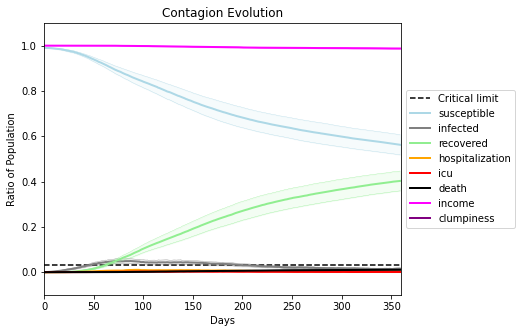

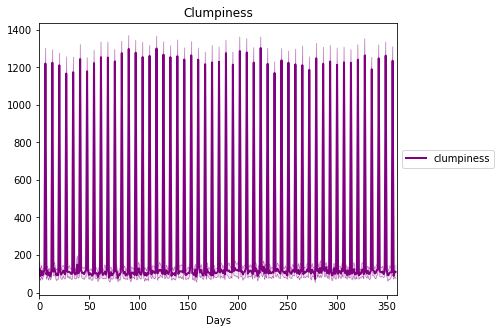

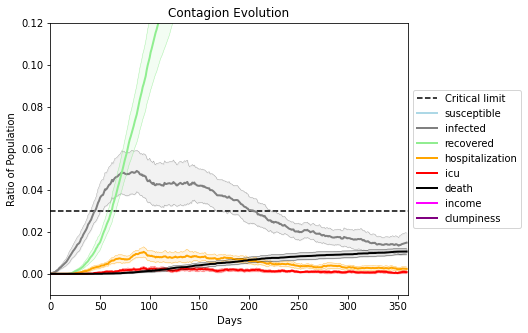

In [13]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1900, 8555, 9444, 3353, 7621, 8574, 2717, 6106, 3065, 7218, 1958, 7346, 3460, 9472, 6629, 8, 9297, 9348, 4896, 7602]
Average similarity between family members is 0.9160172578023775 at temperature -0.991
Average similarity between family and home is 0.9998657497872108 at temperature -1
Average similarity between students and their classroom is 0.7929073640844 at temperature -0.991
Average classroom occupancy is 1.6923076923076923 and number classrooms is 182
Average similarity between workers is 0.8401702856016005 at temperature -0.991
Average office occupancy is 3.3125 and number offices is 192
Average friend similarity for adults: 0.8348168854786759 for kids: 0.7177212969895546
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneous

avg restaurant similarity 0.5387743460483502
avg restaurant similarity 0.5751269528102212
avg restaurant similarity 0.5928355026636405
avg restaurant similarity 0.5283606498880594
avg restaurant similarity 0.49385478265397725
avg restaurant similarity 0.5106042287456637
avg restaurant similarity 0.5772513139667398
avg restaurant similarity 0.535825222214141
avg restaurant similarity 0.5593831933824965
avg restaurant similarity 0.551431255583504
avg restaurant similarity 0.5124165289384737
avg restaurant similarity 0.5193954582323109
avg restaurant similarity 0.5162918554881811
avg restaurant similarity 0.5238592156352447
avg restaurant similarity 0.5167820692435188
avg restaurant similarity 0.5434534847243839
avg restaurant similarity 0.5406214243694417
avg restaurant similarity 0.5396343517493026
avg restaurant similarity 0.5328759488573929
avg restaurant similarity 0.5367989769673857
avg restaurant similarity 0.5938594293087247
avg restaurant similarity 0.5020566837689852
avg restaur

avg restaurant similarity 0.5077979174183498
avg restaurant similarity 0.5116479672032415
avg restaurant similarity 0.5390429074181341
avg restaurant similarity 0.5237042480516794
avg restaurant similarity 0.5038225034211415
avg restaurant similarity 0.5232403897615905
avg restaurant similarity 0.5004664705575422
avg restaurant similarity 0.5157189333090246
avg restaurant similarity 0.5203048605711598
avg restaurant similarity 0.5389945344413138
avg restaurant similarity 0.5402481078872359
avg restaurant similarity 0.49822486977831054
avg restaurant similarity 0.5496666897996411
avg restaurant similarity 0.4847835039732627
avg restaurant similarity 0.4858460899977593
avg restaurant similarity 0.5444544176097091
avg restaurant similarity 0.5642082205207971
avg restaurant similarity 0.48804648092213154
avg restaurant similarity 0.5228318303130489
avg restaurant similarity 0.512326232353371
avg restaurant similarity 0.5581326247829478
avg restaurant similarity 0.5271330128473756
avg resta

Average similarity between workers is 0.843181697616538 at temperature -0.991
Average office occupancy is 3.3794871794871795 and number offices is 195
Average friend similarity for adults: 0.8327797792864295 for kids: 0.7070553591111312
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.4935703135692871
avg restaurant similarity 0.5556865236521387
avg restaurant similarity 0.5252307341466547
avg restaurant similarity 0.5021638352592499
avg restaurant similarity 0.5808734627070076
avg restaurant similarity 0.4972437381396676
avg restaurant similarity 0.5998359908336227
avg restaurant similarity 0.5673218720003297
avg restaurant similarity 0.4787337551143562
avg restaurant similarity 0.5456741235025332
avg restaurant similarity 0.5080549675940143
avg restaurant similarity 0.5493692824286525
avg restaurant similarity 0.5802490745305194
avg restaurant similarity 0.5129473842710721
avg restaurant similarity 0.5447690558649578
avg restaurant similarity 0.5157257457434714
avg restaurant similarity 0.5471736689750747
avg restaurant similarity 0.48022266194881885
avg restaurant similarity 0.5234322890615344
avg restaurant similarity 0.5503906636213814
avg restaurant similarity 0.4982895943644769
avg restaurant similarity 0.5848646239198945
avg resta

avg restaurant similarity 0.46137701715850177
avg restaurant similarity 0.5367082105571124
avg restaurant similarity 0.5163659492583055
avg restaurant similarity 0.5730465047462112
avg restaurant similarity 0.5311037646252432
avg restaurant similarity 0.5272171138452104
avg restaurant similarity 0.5300171100534156
avg restaurant similarity 0.54837267846579
avg restaurant similarity 0.5435264716531069
avg restaurant similarity 0.48988853060128645
avg restaurant similarity 0.5396043583696191
avg restaurant similarity 0.548737965137659
avg restaurant similarity 0.5289910884915139
avg restaurant similarity 0.5290354770428778
avg restaurant similarity 0.5023294398791124
avg restaurant similarity 0.5310674906327064
avg restaurant similarity 0.5064431797038348
avg restaurant similarity 0.5794356980450548
avg restaurant similarity 0.5115118738154097
avg restaurant similarity 0.5614413184244174
avg restaurant similarity 0.541777402883553
avg restaurant similarity 0.510053517678388
avg restauran

Average similarity between workers is 0.8401714209380398 at temperature -0.991
Average office occupancy is 3.378787878787879 and number offices is 198
Average friend similarity for adults: 0.8399977290070052 for kids: 0.7185308471287126
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.5919145958202556
avg restaurant similarity 0.5107161198484478
avg restaurant similarity 0.487516896310973
avg restaurant similarity 0.5136024180696273
avg restaurant similarity 0.5278064927175983
avg restaurant similarity 0.5429099382217699
avg restaurant similarity 0.5110167785009485
avg restaurant similarity 0.46453519840896107
avg restaurant similarity 0.5443585660157417
avg restaurant similarity 0.5242384445082098
avg restaurant similarity 0.48044294988392217
avg restaurant similarity 0.5496801814822564
avg restaurant similarity 0.4954158199721598
avg restaurant similarity 0.5301392516154232
avg restaurant similarity 0.5496666338469337
avg restaurant similarity 0.5035381953892305
avg restaurant similarity 0.48492032380083994
avg restaurant similarity 0.5589230602618269
avg restaurant similarity 0.4654996875953394
avg restaurant similarity 0.5254838165199409
avg restaurant similarity 0.485118149835587
avg restaurant similarity 0.4972579520574643
avg resta

avg restaurant similarity 0.5070586527132815
avg restaurant similarity 0.510624018664694
avg restaurant similarity 0.5316708879398016
avg restaurant similarity 0.5008492346607039
avg restaurant similarity 0.5287183071142508
avg restaurant similarity 0.48974735518568785
avg restaurant similarity 0.5127173637691226
avg restaurant similarity 0.48743250783236386
avg restaurant similarity 0.5277837211859254
avg restaurant similarity 0.453613901541615
avg restaurant similarity 0.5295296455914915
avg restaurant similarity 0.5392789101558175
avg restaurant similarity 0.5606283122284282
avg restaurant similarity 0.5470309943195463
avg restaurant similarity 0.4781571566436751
avg restaurant similarity 0.4873114382647992
avg restaurant similarity 0.5193020813231197
avg restaurant similarity 0.5078034128082596
avg restaurant similarity 0.527662597248381
avg restaurant similarity 0.5163997945816635
avg restaurant similarity 0.47678582240399986
avg restaurant similarity 0.4880778766398942
avg restau

Average similarity between workers is 0.8387325771759215 at temperature -0.991
Average office occupancy is 3.3367875647668392 and number offices is 193
Average friend similarity for adults: 0.8373202928543834 for kids: 0.7228052596313951
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7

avg restaurant similarity 0.5424374769480266
avg restaurant similarity 0.5238166769710466
avg restaurant similarity 0.5224281173438791
avg restaurant similarity 0.5105783494912678
avg restaurant similarity 0.5435077451300632
avg restaurant similarity 0.46656128751118
avg restaurant similarity 0.508287376422597
avg restaurant similarity 0.49995934647383294
avg restaurant similarity 0.5548847173639363
avg restaurant similarity 0.545185098213198
avg restaurant similarity 0.44567159562596553
avg restaurant similarity 0.5245259536632564
avg restaurant similarity 0.51858194088818
avg restaurant similarity 0.530272868237927
avg restaurant similarity 0.5312633814486227
avg restaurant similarity 0.5495244692038381
avg restaurant similarity 0.5269525254910797
avg restaurant similarity 0.4612127084466321
avg restaurant similarity 0.5127954682975807
avg restaurant similarity 0.46348771220178225
avg restaurant similarity 0.5413533643733074
avg restaurant similarity 0.5143793534032198
avg restaurant

avg restaurant similarity 0.5030507166230102
avg restaurant similarity 0.5219492927542165
avg restaurant similarity 0.5369739737932843
avg restaurant similarity 0.5336202114385201
avg restaurant similarity 0.49440358054625083
avg restaurant similarity 0.5023630764866502
avg restaurant similarity 0.47947873334475766
avg restaurant similarity 0.4870319041339473
avg restaurant similarity 0.5912719737861424
avg restaurant similarity 0.4836570756771456
avg restaurant similarity 0.4906699645195413
avg restaurant similarity 0.5497054176479474
avg restaurant similarity 0.5098941331385796
avg restaurant similarity 0.48312920089131517
avg restaurant similarity 0.5063321581187553
avg restaurant similarity 0.4811349473493209
avg restaurant similarity 0.5186992535981638
avg restaurant similarity 0.5155135532628587
avg restaurant similarity 0.5897248997308863
avg restaurant similarity 0.506802862504105
avg restaurant similarity 0.4874121569113089
avg restaurant similarity 0.524455814871675
avg resta

Average similarity between workers is 0.8325628282970817 at temperature -0.991
Average office occupancy is 3.394871794871795 and number offices is 195
Average friend similarity for adults: 0.8403087555404227 for kids: 0.7262735811280744
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.5717652343143101
avg restaurant similarity 0.5226634400868134
avg restaurant similarity 0.565345856800354
avg restaurant similarity 0.5874536376267667
avg restaurant similarity 0.5498411773150922
avg restaurant similarity 0.5224254171553756
avg restaurant similarity 0.5151340995708047
avg restaurant similarity 0.5885265984035832
avg restaurant similarity 0.5445937241141221
avg restaurant similarity 0.5581898524825651
avg restaurant similarity 0.5441263066050833
avg restaurant similarity 0.56300746437555
avg restaurant similarity 0.5436871771645192
avg restaurant similarity 0.5010527421879093
avg restaurant similarity 0.5347154939995153
avg restaurant similarity 0.5471526299025816
avg restaurant similarity 0.5094947243464827
avg restaurant similarity 0.5490525538729852
avg restaurant similarity 0.5366146019060034
avg restaurant similarity 0.5681817334999628
avg restaurant similarity 0.5317288770205327
avg restaurant similarity 0.5702448072593236
avg restauran

avg restaurant similarity 0.5228301997716929
avg restaurant similarity 0.5189566272580322
avg restaurant similarity 0.5638129310351058
avg restaurant similarity 0.5410971145302185
avg restaurant similarity 0.5603406685506674
avg restaurant similarity 0.5426111600604602
avg restaurant similarity 0.5091873263279799
avg restaurant similarity 0.5904796381612019
avg restaurant similarity 0.5407530317957057
avg restaurant similarity 0.583775490792504
avg restaurant similarity 0.5370223974802153
avg restaurant similarity 0.5726113107794689
avg restaurant similarity 0.535962288000312
avg restaurant similarity 0.5313975907574537
avg restaurant similarity 0.5429549753830136
avg restaurant similarity 0.5685753705883553
avg restaurant similarity 0.5517375727580148
avg restaurant similarity 0.5017494704706508
avg restaurant similarity 0.5049429438725369
avg restaurant similarity 0.4993005463154386
avg restaurant similarity 0.5486635387415899
avg restaurant similarity 0.5531551702982271
avg restaura

Average similarity between workers is 0.8344223566000283 at temperature -0.991
Average office occupancy is 3.38265306122449 and number offices is 196
Average friend similarity for adults: 0.8394464576444859 for kids: 0.7252101697030437
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 peo

avg restaurant similarity 0.4353610764669638
avg restaurant similarity 0.4696175876756985
avg restaurant similarity 0.589801420112689
avg restaurant similarity 0.48521168520318586
avg restaurant similarity 0.4996870948218969
avg restaurant similarity 0.5258750461260167
avg restaurant similarity 0.4955299378264212
avg restaurant similarity 0.49636592730882634
avg restaurant similarity 0.5074731475686918
avg restaurant similarity 0.45910207815407816
avg restaurant similarity 0.5450640431652748
avg restaurant similarity 0.519857211629647
avg restaurant similarity 0.523389731512119
avg restaurant similarity 0.4818386305536211
avg restaurant similarity 0.5253154315924223
avg restaurant similarity 0.5412946163144169
avg restaurant similarity 0.5566551242269681
avg restaurant similarity 0.5289099962791537
avg restaurant similarity 0.5223996862900496
avg restaurant similarity 0.49659066468842444
avg restaurant similarity 0.5072153875203885
avg restaurant similarity 0.5527654637209419
avg resta

avg restaurant similarity 0.544356762390066
avg restaurant similarity 0.5085954828046985
avg restaurant similarity 0.519728006718536
avg restaurant similarity 0.5141986479997381
avg restaurant similarity 0.510551830898528
avg restaurant similarity 0.5331980558466474
avg restaurant similarity 0.5352028235383618
avg restaurant similarity 0.5268158288224767
avg restaurant similarity 0.4618640291446796
avg restaurant similarity 0.5542991343676206
avg restaurant similarity 0.5378922074166482
avg restaurant similarity 0.5302587981816083
avg restaurant similarity 0.5232799480819781
avg restaurant similarity 0.5553138362833691
avg restaurant similarity 0.5302247428387038
avg restaurant similarity 0.5148987485804809
avg restaurant similarity 0.5700732834117632
avg restaurant similarity 0.4965392713151197
avg restaurant similarity 0.5436869311625983
avg restaurant similarity 0.5384999424680774
avg restaurant similarity 0.5072252547680077
avg restaurant similarity 0.5224030228325734
avg restauran

Average similarity between workers is 0.8483391288134984 at temperature -0.991
Average office occupancy is 3.4393939393939394 and number offices is 198
Average friend similarity for adults: 0.8417166789032836 for kids: 0.7198339767294029
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 

avg restaurant similarity 0.5126544336841147
avg restaurant similarity 0.4997563077299744
avg restaurant similarity 0.5323083084325706
avg restaurant similarity 0.5474659247240228
avg restaurant similarity 0.5436107060712364
avg restaurant similarity 0.5155353414001369
avg restaurant similarity 0.5933594972646503
avg restaurant similarity 0.4841884615388192
avg restaurant similarity 0.5333133334327727
avg restaurant similarity 0.5282580621999299
avg restaurant similarity 0.4739012615871695
avg restaurant similarity 0.5536999245031936
avg restaurant similarity 0.5193946690858534
avg restaurant similarity 0.5040013919320666
avg restaurant similarity 0.5432977746985697
avg restaurant similarity 0.4882268251642594
avg restaurant similarity 0.5116232062442754
avg restaurant similarity 0.5244502717744238
avg restaurant similarity 0.5109640391624259
avg restaurant similarity 0.5987901852290645
avg restaurant similarity 0.49786186403567473
avg restaurant similarity 0.523503457844782
avg restau

avg restaurant similarity 0.5741564754372099
avg restaurant similarity 0.49507074561285863
avg restaurant similarity 0.5284940980513667
avg restaurant similarity 0.514611206985409
avg restaurant similarity 0.531117642311203
avg restaurant similarity 0.5499408416762376
avg restaurant similarity 0.5130689876481188
avg restaurant similarity 0.5451656104475171
avg restaurant similarity 0.48300964811124475
avg restaurant similarity 0.5630464585910746
avg restaurant similarity 0.48928114894006547
avg restaurant similarity 0.5252995140819016
avg restaurant similarity 0.5453187997358437
avg restaurant similarity 0.5440786984711032
avg restaurant similarity 0.5219976095845344
avg restaurant similarity 0.5325304747116123
avg restaurant similarity 0.5479155404407766
avg restaurant similarity 0.5338000998510444
avg restaurant similarity 0.4890768709832375
avg restaurant similarity 0.5715822693752229
avg restaurant similarity 0.5390886631271512
avg restaurant similarity 0.577572489268229
avg restau

Average similarity between workers is 0.842751236142066 at temperature -0.991
Average office occupancy is 3.3299492385786804 and number offices is 197
Average friend similarity for adults: 0.8384200945772329 for kids: 0.7152122392061872
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5574705317007975
avg restaurant similarity 0.5285738484011318
avg restaurant similarity 0.6035554478910373
avg restaurant similarity 0.6229576637234325
avg restaurant similarity 0.6092821191922839
avg restaurant similarity 0.5108696609834702
avg restaurant similarity 0.5057004302175881
avg restaurant similarity 0.5522127884707999
avg restaurant similarity 0.5124755623847776
avg restaurant similarity 0.5332204185217908
avg restaurant similarity 0.5252247651557523
avg restaurant similarity 0.549423602320102
avg restaurant similarity 0.6202286972587981
avg restaurant similarity 0.5607558287265848
avg restaurant similarity 0.5299631360288309
avg restaurant similarity 0.622511976698406
avg restaurant similarity 0.650580750161806
avg restaurant similarity 0.5602780689000018
avg restaurant similarity 0.5751182559315672
avg restaurant similarity 0.5363659638184092
avg restaurant similarity 0.5358131163714426
avg restaurant similarity 0.5593187176316514
avg restauran

avg restaurant similarity 0.5431713566656355
avg restaurant similarity 0.567601588555848
avg restaurant similarity 0.5563410477079277
avg restaurant similarity 0.5957048919332323
avg restaurant similarity 0.582015261185824
avg restaurant similarity 0.5587371018750629
avg restaurant similarity 0.48086352078721195
avg restaurant similarity 0.5338338084529309
avg restaurant similarity 0.5243708756446258
avg restaurant similarity 0.5536025159054866
avg restaurant similarity 0.5405063237079458
avg restaurant similarity 0.5468493509711028
avg restaurant similarity 0.5697145482009409
avg restaurant similarity 0.5170782363950254
avg restaurant similarity 0.48845431954634916
avg restaurant similarity 0.5571182746708131
avg restaurant similarity 0.5160587756178147
avg restaurant similarity 0.5200795909714562
avg restaurant similarity 0.5330532974125024
avg restaurant similarity 0.5679813834877466
avg restaurant similarity 0.5822609160834097
avg restaurant similarity 0.5394227854436132
avg restau

Average similarity between workers is 0.8467505303035004 at temperature -0.991
Average office occupancy is 3.3819095477386933 and number offices is 199
Average friend similarity for adults: 0.8431767227790428 for kids: 0.7160346403881975
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 

avg restaurant similarity 0.5614782124474449
avg restaurant similarity 0.4724472117468429
avg restaurant similarity 0.5247016044687602
avg restaurant similarity 0.49699021464968574
avg restaurant similarity 0.48278363423621196
avg restaurant similarity 0.4919037099896297
avg restaurant similarity 0.568912016966017
avg restaurant similarity 0.5001699089840558
avg restaurant similarity 0.5561781674777242
avg restaurant similarity 0.5386297596037736
avg restaurant similarity 0.5123857431501345
avg restaurant similarity 0.4730979010835284
avg restaurant similarity 0.56180404511756
avg restaurant similarity 0.49729230960560405
avg restaurant similarity 0.5126301298120071
avg restaurant similarity 0.5245711629896548
avg restaurant similarity 0.4778074572251012
avg restaurant similarity 0.5063572820393257
avg restaurant similarity 0.5507164836846192
avg restaurant similarity 0.5112514375296476
avg restaurant similarity 0.5114509848906127
avg restaurant similarity 0.5033687176033985
avg restau

avg restaurant similarity 0.4915367958452695
avg restaurant similarity 0.5284915133473495
avg restaurant similarity 0.4739185595082882
avg restaurant similarity 0.5245209446161989
avg restaurant similarity 0.5175755187704959
avg restaurant similarity 0.5499460814573696
avg restaurant similarity 0.5606971224028593
avg restaurant similarity 0.5241682068639131
avg restaurant similarity 0.4649795771402815
avg restaurant similarity 0.5496289194435253
avg restaurant similarity 0.4799970904052765
avg restaurant similarity 0.5185204246851498
avg restaurant similarity 0.4792748045771096
avg restaurant similarity 0.4996708266615135
avg restaurant similarity 0.5295600493701107
avg restaurant similarity 0.5394709921876965
avg restaurant similarity 0.4459973363681144
avg restaurant similarity 0.48769278965569884
avg restaurant similarity 0.5414288735463977
avg restaurant similarity 0.5359571000745651
avg restaurant similarity 0.5139704646554214
avg restaurant similarity 0.4466200368155913
avg resta

Average similarity between workers is 0.8423869498954039 at temperature -0.991
Average office occupancy is 3.4455958549222796 and number offices is 193
Average friend similarity for adults: 0.8393282630679308 for kids: 0.7192978740089053
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5308586876608817
avg restaurant similarity 0.5110103889573857
avg restaurant similarity 0.47743223402432855
avg restaurant similarity 0.49794750540072863
avg restaurant similarity 0.4914603277613996
avg restaurant similarity 0.44847637449556194
avg restaurant similarity 0.4651369549240963
avg restaurant similarity 0.479450053417537
avg restaurant similarity 0.4903714559303729
avg restaurant similarity 0.47257607651030814
avg restaurant similarity 0.5458577245285312
avg restaurant similarity 0.4987343467152646
avg restaurant similarity 0.4825209626460908
avg restaurant similarity 0.474081086157306
avg restaurant similarity 0.5030380536013787
avg restaurant similarity 0.5211847893178634
avg restaurant similarity 0.4987563888256971
avg restaurant similarity 0.4853685217262076
avg restaurant similarity 0.52428194251253
avg restaurant similarity 0.4434423374455085
avg restaurant similarity 0.4809620124051654
avg restaurant similarity 0.47685725470088824
avg resta

avg restaurant similarity 0.5081771397006603
avg restaurant similarity 0.4657427392199054
avg restaurant similarity 0.5000688008241555
avg restaurant similarity 0.48726260176465497
avg restaurant similarity 0.48940285042355713
avg restaurant similarity 0.47271729091275416
avg restaurant similarity 0.4712528606514492
avg restaurant similarity 0.4481433117034641
avg restaurant similarity 0.4411886021512903
avg restaurant similarity 0.5027491279353045
avg restaurant similarity 0.46411740767984744
avg restaurant similarity 0.4629400685200647
avg restaurant similarity 0.41091799787546684
avg restaurant similarity 0.46854790914620054
avg restaurant similarity 0.4264769443064095
avg restaurant similarity 0.4525990804117295
avg restaurant similarity 0.4498481864340777
avg restaurant similarity 0.524411329391574
avg restaurant similarity 0.4801625458566838
avg restaurant similarity 0.47721444203577973
avg restaurant similarity 0.47517136698849943
avg restaurant similarity 0.48481894625920174
av

Average similarity between workers is 0.8338976376032038 at temperature -0.991
Average office occupancy is 3.4739583333333335 and number offices is 192
Average friend similarity for adults: 0.837617919653608 for kids: 0.7162859780607564
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.48950749656413695
avg restaurant similarity 0.4528693153280326
avg restaurant similarity 0.5332322759761559
avg restaurant similarity 0.5375087689254043
avg restaurant similarity 0.5319210716105905
avg restaurant similarity 0.5217406565195413
avg restaurant similarity 0.5107694003176587
avg restaurant similarity 0.4876187838888497
avg restaurant similarity 0.5469088892098568
avg restaurant similarity 0.5152475435554408
avg restaurant similarity 0.5013782795531865
avg restaurant similarity 0.4681410994927585
avg restaurant similarity 0.4856000869800276
avg restaurant similarity 0.5165675957584128
avg restaurant similarity 0.47131141475809
avg restaurant similarity 0.5147441127945188
avg restaurant similarity 0.470021541317995
avg restaurant similarity 0.5370622925350204
avg restaurant similarity 0.5491593724373002
avg restaurant similarity 0.5173582596997546
avg restaurant similarity 0.5165104506241324
avg restaurant similarity 0.5340868076891782
avg restaura

avg restaurant similarity 0.5174707568778384
avg restaurant similarity 0.5042573976399373
avg restaurant similarity 0.5141328456731852
avg restaurant similarity 0.5292807479969817
avg restaurant similarity 0.4808072535375354
avg restaurant similarity 0.5064196817118176
avg restaurant similarity 0.546045370493833
avg restaurant similarity 0.45649297165557284
avg restaurant similarity 0.5069770757157355
avg restaurant similarity 0.49476882927731697
avg restaurant similarity 0.48198021629773224
avg restaurant similarity 0.5063029678272939
avg restaurant similarity 0.5308151295515069
avg restaurant similarity 0.4702199190628097
avg restaurant similarity 0.5170229592543683
avg restaurant similarity 0.50248756953755
avg restaurant similarity 0.5386847940712675
avg restaurant similarity 0.5212782936265011
avg restaurant similarity 0.4819560317201976
avg restaurant similarity 0.5285069282065379
avg restaurant similarity 0.4866924902910997
avg restaurant similarity 0.4875646650379115
avg restau

Average similarity between workers is 0.8564999727692058 at temperature -0.991
Average office occupancy is 3.270408163265306 and number offices is 196
Average friend similarity for adults: 0.8397799227464162 for kids: 0.7216656698603284
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 1

avg restaurant similarity 0.5441608202566929
avg restaurant similarity 0.5250114658360093
avg restaurant similarity 0.5680106823318966
avg restaurant similarity 0.5622974347042469
avg restaurant similarity 0.5574873544764991
avg restaurant similarity 0.5155852932750409
avg restaurant similarity 0.5707570558909291
avg restaurant similarity 0.4919323936432101
avg restaurant similarity 0.588280775597264
avg restaurant similarity 0.5299596643504573
avg restaurant similarity 0.5417098438904435
avg restaurant similarity 0.4719508522941195
avg restaurant similarity 0.560556459906942
avg restaurant similarity 0.5777893424085455
avg restaurant similarity 0.5182142668731161
avg restaurant similarity 0.5939375032301258
avg restaurant similarity 0.4834912894614511
avg restaurant similarity 0.52315110087433
avg restaurant similarity 0.4717261903669174
avg restaurant similarity 0.4860428115141997
avg restaurant similarity 0.5390109788551312
avg restaurant similarity 0.4935177622462937
avg restaurant

avg restaurant similarity 0.5398935736238183
avg restaurant similarity 0.49162870541208087
avg restaurant similarity 0.5283463773912893
avg restaurant similarity 0.537392737901331
avg restaurant similarity 0.5001457304871082
avg restaurant similarity 0.5584227530104305
avg restaurant similarity 0.5389244952309277
avg restaurant similarity 0.5353332687039285
avg restaurant similarity 0.4944180655598326
avg restaurant similarity 0.508506444989212
avg restaurant similarity 0.46733804994466593
avg restaurant similarity 0.47240899858721164
avg restaurant similarity 0.5150366768043425
avg restaurant similarity 0.4896719595845201
avg restaurant similarity 0.4763922406635999
avg restaurant similarity 0.5062202503818533
avg restaurant similarity 0.527464807551513
avg restaurant similarity 0.5134679751390604
avg restaurant similarity 0.49917628534376635
avg restaurant similarity 0.5617274519977492
avg restaurant similarity 0.5263579741902531
avg restaurant similarity 0.49577552995722685
avg rest

Average similarity between workers is 0.8346108086976288 at temperature -0.991
Average office occupancy is 3.392670157068063 and number offices is 191
Average friend similarity for adults: 0.8393077108216462 for kids: 0.7292120675986699
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5180848046325242
avg restaurant similarity 0.47690333938624596
avg restaurant similarity 0.5039843844084515
avg restaurant similarity 0.5261364107011951
avg restaurant similarity 0.511733652089071
avg restaurant similarity 0.48949592166850436
avg restaurant similarity 0.4933103069277821
avg restaurant similarity 0.5182139404075589
avg restaurant similarity 0.5068454408627557
avg restaurant similarity 0.46654658259358667
avg restaurant similarity 0.5028869065637884
avg restaurant similarity 0.5004140661376668
avg restaurant similarity 0.4899905223576596
avg restaurant similarity 0.5152435499451137
avg restaurant similarity 0.5311037344141474
avg restaurant similarity 0.5673275261538228
avg restaurant similarity 0.5291407769306289
avg restaurant similarity 0.48011235027835497
avg restaurant similarity 0.5069531033007435
avg restaurant similarity 0.4897668809186415
avg restaurant similarity 0.5509750845362893
avg restaurant similarity 0.5035955991630944
avg res

avg restaurant similarity 0.5238465751780718
avg restaurant similarity 0.515414664454089
avg restaurant similarity 0.47300687057815743
avg restaurant similarity 0.5178633178181428
avg restaurant similarity 0.5275236399739469
avg restaurant similarity 0.5570511994102303
avg restaurant similarity 0.5609555044314628
avg restaurant similarity 0.5007959156282936
avg restaurant similarity 0.5382020179397835
avg restaurant similarity 0.5284529304027468
avg restaurant similarity 0.5503136509714935
avg restaurant similarity 0.5191382786760965
avg restaurant similarity 0.4844450465171028
avg restaurant similarity 0.5131112844849577
avg restaurant similarity 0.5345078701946604
avg restaurant similarity 0.5206419612241601
avg restaurant similarity 0.507758567823933
avg restaurant similarity 0.5733471142598331
avg restaurant similarity 0.5100467221633758
avg restaurant similarity 0.5248832098434149
avg restaurant similarity 0.5177058564907735
avg restaurant similarity 0.5151474944968396
avg restaur

Average similarity between workers is 0.8288976593285379 at temperature -0.991
Average office occupancy is 3.313131313131313 and number offices is 198
Average friend similarity for adults: 0.8333207406667019 for kids: 0.7235976556877168
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of

avg restaurant similarity 0.539105397014756
avg restaurant similarity 0.5513120627314128
avg restaurant similarity 0.5787685127046331
avg restaurant similarity 0.6111352491817119
avg restaurant similarity 0.5736529017367885
avg restaurant similarity 0.5778601703142496
avg restaurant similarity 0.5120147149105414
avg restaurant similarity 0.5184252525706053
avg restaurant similarity 0.5702830993136667
avg restaurant similarity 0.584947227366081
avg restaurant similarity 0.48895879318521074
avg restaurant similarity 0.5169566376382978
avg restaurant similarity 0.5462102881867877
avg restaurant similarity 0.590012291525685
avg restaurant similarity 0.4621376510581816
avg restaurant similarity 0.5572629906918978
avg restaurant similarity 0.5255166786845231
avg restaurant similarity 0.5521785711266086
avg restaurant similarity 0.5569324490464677
avg restaurant similarity 0.5316219976345176
avg restaurant similarity 0.548973514620128
avg restaurant similarity 0.5389269670135686
avg restauran

avg restaurant similarity 0.5578490012726542
avg restaurant similarity 0.5510281035857079
avg restaurant similarity 0.5799659893834006
avg restaurant similarity 0.5494331015533896
avg restaurant similarity 0.4984544826330204
avg restaurant similarity 0.6289515742759519
avg restaurant similarity 0.542471298851982
avg restaurant similarity 0.5651103271754602
avg restaurant similarity 0.5537310528428165
avg restaurant similarity 0.49529350961191654
avg restaurant similarity 0.5387269585073027
avg restaurant similarity 0.5302219156183764
avg restaurant similarity 0.5422007132790813
avg restaurant similarity 0.5667769503949077
avg restaurant similarity 0.5225195176961343
avg restaurant similarity 0.617779720416773
avg restaurant similarity 0.572930141703229
avg restaurant similarity 0.5547475056527246
avg restaurant similarity 0.5464384688048911
avg restaurant similarity 0.5156648931636213
avg restaurant similarity 0.5075556353546106
avg restaurant similarity 0.5495010741277236
avg restaura

Average similarity between workers is 0.8457729320636628 at temperature -0.991
Average office occupancy is 3.3622448979591835 and number offices is 196
Average friend similarity for adults: 0.8424408896070994 for kids: 0.7157076272746351
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.4900844443626468
avg restaurant similarity 0.5144977886564267
avg restaurant similarity 0.5105877319150753
avg restaurant similarity 0.4798515393178711
avg restaurant similarity 0.5316716211866326
avg restaurant similarity 0.5085873876455472
avg restaurant similarity 0.508684282609205
avg restaurant similarity 0.5226525890678557
avg restaurant similarity 0.47173658211353153
avg restaurant similarity 0.48784525792875
avg restaurant similarity 0.5092813907747336
avg restaurant similarity 0.5575030829031523
avg restaurant similarity 0.48593175147384277
avg restaurant similarity 0.4903671765616273
avg restaurant similarity 0.5048843577041122
avg restaurant similarity 0.44356384983319613
avg restaurant similarity 0.4842243586861563
avg restaurant similarity 0.46036198844329085
avg restaurant similarity 0.4923357967557956
avg restaurant similarity 0.48816451666971855
avg restaurant similarity 0.5220979333406557
avg restaurant similarity 0.4490321935159197
avg rest

avg restaurant similarity 0.5030895322542358
avg restaurant similarity 0.5054712526286965
avg restaurant similarity 0.5009319709820249
avg restaurant similarity 0.5474061537039052
avg restaurant similarity 0.4785589605712874
avg restaurant similarity 0.5531256354203193
avg restaurant similarity 0.4734710336728363
avg restaurant similarity 0.527490666795607
avg restaurant similarity 0.4873944564810392
avg restaurant similarity 0.4892082040408373
avg restaurant similarity 0.5190712464611851
avg restaurant similarity 0.4739418928516418
avg restaurant similarity 0.5116123186332057
avg restaurant similarity 0.5230230104739058
avg restaurant similarity 0.5155453516016648
avg restaurant similarity 0.5085789749116751
avg restaurant similarity 0.5250475776064175
avg restaurant similarity 0.505949394975346
avg restaurant similarity 0.4868285079582888
avg restaurant similarity 0.5175666031628818
avg restaurant similarity 0.5116098507151102
avg restaurant similarity 0.5005206210523334
avg restaura

Average similarity between workers is 0.821772708352557 at temperature -0.991
Average office occupancy is 3.4368421052631577 and number offices is 190
Average friend similarity for adults: 0.8237910546445847 for kids: 0.7113176729335681
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.5111274355876133
avg restaurant similarity 0.5163021465812924
avg restaurant similarity 0.4769274673114092
avg restaurant similarity 0.4895455050222929
avg restaurant similarity 0.5379611464759606
avg restaurant similarity 0.5573201715858206
avg restaurant similarity 0.5134640151327275
avg restaurant similarity 0.5031096750806994
avg restaurant similarity 0.5106418792313785
avg restaurant similarity 0.49914465325183505
avg restaurant similarity 0.5021965909082344
avg restaurant similarity 0.5289152429611544
avg restaurant similarity 0.5090438663211599
avg restaurant similarity 0.5420356521132866
avg restaurant similarity 0.48760135330704274
avg restaurant similarity 0.527144382471907
avg restaurant similarity 0.4987961848290225
avg restaurant similarity 0.48313596926384306
avg restaurant similarity 0.48809459258259685
avg restaurant similarity 0.5087498176921306
avg restaurant similarity 0.5218514715133548
avg restaurant similarity 0.4999164350933742
avg res

avg restaurant similarity 0.5142330650197392
avg restaurant similarity 0.4841350981142853
avg restaurant similarity 0.5264723607741604
avg restaurant similarity 0.5317463041357016
avg restaurant similarity 0.481839425970959
avg restaurant similarity 0.5189617988104853
avg restaurant similarity 0.549207942502826
avg restaurant similarity 0.5147889842130445
avg restaurant similarity 0.46209264017569857
avg restaurant similarity 0.4851546947695054
avg restaurant similarity 0.5264063494260567
avg restaurant similarity 0.5373534659363437
avg restaurant similarity 0.43053970352985277
avg restaurant similarity 0.48311672935282807
avg restaurant similarity 0.5373051843220534
avg restaurant similarity 0.48564254795862294
avg restaurant similarity 0.5281025094858484
avg restaurant similarity 0.5023358182582027
avg restaurant similarity 0.47026027269875365
avg restaurant similarity 0.47985682192764245
avg restaurant similarity 0.5107720939943187
avg restaurant similarity 0.5037600879696181
avg re

Average similarity between workers is 0.833179381746501 at temperature -0.991
Average office occupancy is 3.5106382978723403 and number offices is 188
Average friend similarity for adults: 0.8336724432732285 for kids: 0.7282802795723727
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of

avg restaurant similarity 0.5576582947724567
avg restaurant similarity 0.5207258476658463
avg restaurant similarity 0.5037310094787423
avg restaurant similarity 0.546726336205085
avg restaurant similarity 0.5096131586406382
avg restaurant similarity 0.5351490859088157
avg restaurant similarity 0.5459502222876127
avg restaurant similarity 0.562799211853419
avg restaurant similarity 0.5256153643952041
avg restaurant similarity 0.5840889575183322
avg restaurant similarity 0.5374779155701188
avg restaurant similarity 0.5398989063567999
avg restaurant similarity 0.5118921476623414
avg restaurant similarity 0.5883260462724264
avg restaurant similarity 0.5065998937074523
avg restaurant similarity 0.5232755857026694
avg restaurant similarity 0.5254291464683031
avg restaurant similarity 0.533082031670163
avg restaurant similarity 0.5248391832420272
avg restaurant similarity 0.4852243136729478
avg restaurant similarity 0.4927450043977106
avg restaurant similarity 0.5263993155433416
avg restauran

avg restaurant similarity 0.5463406942194938
avg restaurant similarity 0.49004460148278856
avg restaurant similarity 0.5621336742821729
avg restaurant similarity 0.47991329674150307
avg restaurant similarity 0.5321871412492846
avg restaurant similarity 0.5095969847211287
avg restaurant similarity 0.5136336367219159
avg restaurant similarity 0.48104882833243634
avg restaurant similarity 0.4901945494322266
avg restaurant similarity 0.5427287687255594
avg restaurant similarity 0.5592543655397725
avg restaurant similarity 0.5350646709451354
avg restaurant similarity 0.523461355406336
avg restaurant similarity 0.5102559603291784
avg restaurant similarity 0.524286893915371
avg restaurant similarity 0.5349551051169686
avg restaurant similarity 0.610168693636483
avg restaurant similarity 0.4857241292453495
avg restaurant similarity 0.5060608854117029
avg restaurant similarity 0.5066060292397673
avg restaurant similarity 0.5009317387614247
avg restaurant similarity 0.5821558446827577
avg restau

Average similarity between students and their classroom is 0.7991287728650182 at temperature -0.991
Average classroom occupancy is 1.630057803468208 and number classrooms is 173
Average similarity between workers is 0.8531661039594708 at temperature -0.991
Average office occupancy is 3.3705583756345177 and number offices is 197
Average friend similarity for adults: 0.8389542274975191 for kids: 0.7247403174684726
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated

avg restaurant similarity 0.49171899074540687
avg restaurant similarity 0.5681081133617842
avg restaurant similarity 0.5052909114687183
avg restaurant similarity 0.5482236814723472
avg restaurant similarity 0.581000345742292
avg restaurant similarity 0.5432965595456477
avg restaurant similarity 0.6102824298873436
avg restaurant similarity 0.48685305543387447
avg restaurant similarity 0.5214548011999711
avg restaurant similarity 0.5411601602403543
avg restaurant similarity 0.4969998898874417
avg restaurant similarity 0.5279177711374422
avg restaurant similarity 0.5418385815469138
avg restaurant similarity 0.5425581845382295
avg restaurant similarity 0.5333847514027186
avg restaurant similarity 0.4681434626186187
avg restaurant similarity 0.46938303504552154
avg restaurant similarity 0.5219488654638323
avg restaurant similarity 0.5344642185612042
avg restaurant similarity 0.47636373010731686
avg restaurant similarity 0.5105293789361005
avg restaurant similarity 0.5289249258267306
avg res

avg restaurant similarity 0.5360355414319462
avg restaurant similarity 0.5026977852617357
avg restaurant similarity 0.4851578661242827
avg restaurant similarity 0.5395383047634935
avg restaurant similarity 0.5609490320089511
avg restaurant similarity 0.5118998640926814
avg restaurant similarity 0.5426779901261005
avg restaurant similarity 0.5504440325166408
avg restaurant similarity 0.5259627679937094
avg restaurant similarity 0.48200108183170276
avg restaurant similarity 0.5485736200411678
avg restaurant similarity 0.5400075972643475
avg restaurant similarity 0.46788613743492075
avg restaurant similarity 0.5068627291319057
avg restaurant similarity 0.46978548725746433
avg restaurant similarity 0.5635401311882741
avg restaurant similarity 0.5331004905055698
avg restaurant similarity 0.5415574025138614
avg restaurant similarity 0.5016292961610445
avg restaurant similarity 0.5344544059122079
avg restaurant similarity 0.5074759262639496
avg restaurant similarity 0.5237254961115921
avg res

Average similarity between workers is 0.8356776441274852 at temperature -0.991
Average office occupancy is 3.5714285714285716 and number offices is 189
Average friend similarity for adults: 0.8420093818191132 for kids: 0.7199286948761533
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 peo

avg restaurant similarity 0.5262718817346469
avg restaurant similarity 0.517895169181018
avg restaurant similarity 0.49389450438298804
avg restaurant similarity 0.5349791486789955
avg restaurant similarity 0.5392091990188801
avg restaurant similarity 0.5296798591133502
avg restaurant similarity 0.5238683562946426
avg restaurant similarity 0.5631203988171637
avg restaurant similarity 0.543913952898867
avg restaurant similarity 0.5216823564295704
avg restaurant similarity 0.5695179781217505
avg restaurant similarity 0.521462237611036
avg restaurant similarity 0.5598288956979918
avg restaurant similarity 0.5384735225726001
avg restaurant similarity 0.52938038466337
avg restaurant similarity 0.5397611052499467
avg restaurant similarity 0.4690249529255211
avg restaurant similarity 0.55220214318938
avg restaurant similarity 0.5167297678596963
avg restaurant similarity 0.5801975401641432
avg restaurant similarity 0.48216125918412023
avg restaurant similarity 0.5488187812045431
avg restaurant 

avg restaurant similarity 0.5175394123397218
avg restaurant similarity 0.49578411337102596
avg restaurant similarity 0.5581310174200929
avg restaurant similarity 0.5378461105492922
avg restaurant similarity 0.5091112873633092
avg restaurant similarity 0.5203577315504482
avg restaurant similarity 0.5511144667999838
avg restaurant similarity 0.5463540249481655
avg restaurant similarity 0.5285628454301781
avg restaurant similarity 0.4760278285248959
avg restaurant similarity 0.5224611287351807
avg restaurant similarity 0.5681600365320981
avg restaurant similarity 0.5251841847074167
avg restaurant similarity 0.5522156624740333
avg restaurant similarity 0.5188202544724492
avg restaurant similarity 0.5677195971284711
avg restaurant similarity 0.5463800366642263
avg restaurant similarity 0.47690273000161015
avg restaurant similarity 0.5384439690326496
avg restaurant similarity 0.5197290690362107
avg restaurant similarity 0.5665741299748739
avg restaurant similarity 0.5244802857637969
avg rest

Average similarity between workers is 0.854594502179754 at temperature -0.991
Average office occupancy is 3.4731182795698925 and number offices is 186
Average friend similarity for adults: 0.8457900427235071 for kids: 0.7405322709772936
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 pe

avg restaurant similarity 0.5564524220137806
avg restaurant similarity 0.5513288075970225
avg restaurant similarity 0.5808718058066283
avg restaurant similarity 0.5405036589793895
avg restaurant similarity 0.5369258223020923
avg restaurant similarity 0.5106852540237113
avg restaurant similarity 0.5011401164027933
avg restaurant similarity 0.5548508310667101
avg restaurant similarity 0.4958464158922536
avg restaurant similarity 0.5233484877555828
avg restaurant similarity 0.5517172095932911
avg restaurant similarity 0.580215301354757
avg restaurant similarity 0.5159626667213961
avg restaurant similarity 0.5195326470555468
avg restaurant similarity 0.5483785733691088
avg restaurant similarity 0.5356541200096928
avg restaurant similarity 0.5677697963724133
avg restaurant similarity 0.5204688270068656
avg restaurant similarity 0.5714705516319949
avg restaurant similarity 0.5024025927685069
avg restaurant similarity 0.5232896902935552
avg restaurant similarity 0.5292642029222229
avg restaur

avg restaurant similarity 0.5829912512779886
avg restaurant similarity 0.5785034900335085
avg restaurant similarity 0.5017128138172036
avg restaurant similarity 0.5810842269555837
avg restaurant similarity 0.5305783281627674
avg restaurant similarity 0.5582293257476414
avg restaurant similarity 0.5584656346626315
avg restaurant similarity 0.5228590953163083
avg restaurant similarity 0.5489156925246231
avg restaurant similarity 0.5408268189783942
avg restaurant similarity 0.580586300336767
avg restaurant similarity 0.5027759035980889
avg restaurant similarity 0.5491348185228758
avg restaurant similarity 0.524909068069172
avg restaurant similarity 0.5446960398847879
avg restaurant similarity 0.5618493915167816
avg restaurant similarity 0.5428951971553495
avg restaurant similarity 0.5337347262078268
avg restaurant similarity 0.5127893216153206
avg restaurant similarity 0.5791535048512644
avg restaurant similarity 0.5757967869051801
avg restaurant similarity 0.578115152896214
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

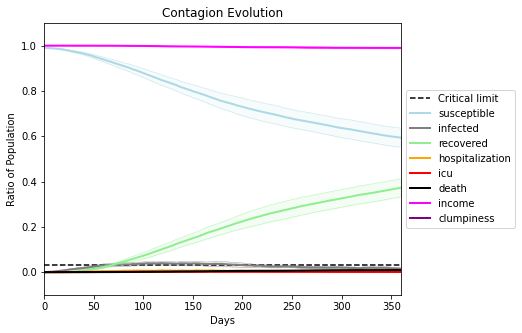

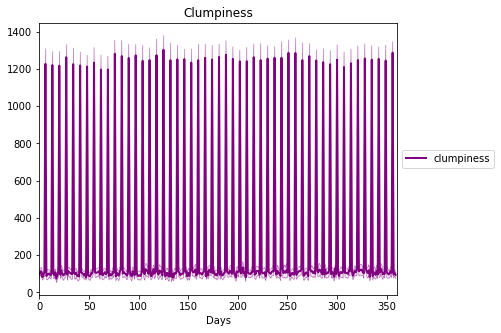

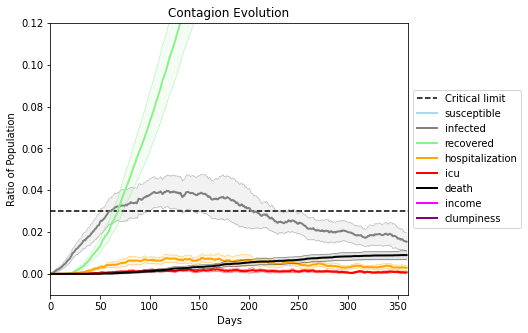

In [14]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9785, 2909, 9444, 6519, 2069, 4251, 8189, 6856, 9699, 7683, 2286, 3396, 4918, 1752, 9536, 9871, 5820, 9659, 3136, 2144]
Average similarity between family members is 0.9045919014252636 at temperature -0.99
Average similarity between family and home is 0.9998707010178942 at temperature -1
Average similarity between students and their classroom is 0.8013298684016563 at temperature -0.99
Average classroom occupancy is 1.6961325966850829 and number classrooms is 181
Average similarity between workers is 0.8317076599443332 at temperature -0.99
Average office occupancy is 3.374331550802139 and number offices is 187
Average friend similarity for adults: 0.8294535887410445 for kids: 0.7277762436076013
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.5285554682779365
avg restaurant similarity 0.4950009042948328
avg restaurant similarity 0.5990928566568207
avg restaurant similarity 0.5527257714677463
avg restaurant similarity 0.5257533170350642
avg restaurant similarity 0.4766336424104207
avg restaurant similarity 0.5051132210210255
avg restaurant similarity 0.5103383609965682
avg restaurant similarity 0.5501456286744679
avg restaurant similarity 0.4755420577285869
avg restaurant similarity 0.5045429686873978
avg restaurant similarity 0.5036865477373397
avg restaurant similarity 0.5184166886187483
avg restaurant similarity 0.502121422148382
avg restaurant similarity 0.4960974520914764
avg restaurant similarity 0.5426258669741112
avg restaurant similarity 0.5148430080114671
avg restaurant similarity 0.5339619218746331
avg restaurant similarity 0.5043176611793019
avg restaurant similarity 0.5027401200939106
avg restaurant similarity 0.5301242296811534
avg restaurant similarity 0.5082224996135627
avg restaur

avg restaurant similarity 0.5183588123833298
avg restaurant similarity 0.5221756350647689
avg restaurant similarity 0.4572894221412944
avg restaurant similarity 0.5110573862336837
avg restaurant similarity 0.546124314338615
avg restaurant similarity 0.5000105262588892
avg restaurant similarity 0.5498722444561138
avg restaurant similarity 0.48966518513879087
avg restaurant similarity 0.4992219401783056
avg restaurant similarity 0.5637652004205916
avg restaurant similarity 0.5058897993474847
avg restaurant similarity 0.5356721321073568
avg restaurant similarity 0.5176128185100131
avg restaurant similarity 0.4860831309204566
avg restaurant similarity 0.4870630718969583
avg restaurant similarity 0.48796347825545855
avg restaurant similarity 0.5597395546383932
avg restaurant similarity 0.5231987619965437
avg restaurant similarity 0.5170030486745636
avg restaurant similarity 0.5145462127382036
avg restaurant similarity 0.49251166896291815
avg restaurant similarity 0.5327842627806036
avg rest

Average similarity between workers is 0.8128440250795953 at temperature -0.99
Average office occupancy is 3.513368983957219 and number offices is 187
Average friend similarity for adults: 0.8235835299738736 for kids: 0.7059478231407722
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 p

avg restaurant similarity 0.49344564571419824
avg restaurant similarity 0.4569095608088773
avg restaurant similarity 0.48167525273401574
avg restaurant similarity 0.48067560624093897
avg restaurant similarity 0.4500572707692987
avg restaurant similarity 0.41614439565575834
avg restaurant similarity 0.47714728990429683
avg restaurant similarity 0.4535594096943711
avg restaurant similarity 0.5016182651853268
avg restaurant similarity 0.44989270686755084
avg restaurant similarity 0.45432529332628313
avg restaurant similarity 0.4863901226414231
avg restaurant similarity 0.4410797973536414
avg restaurant similarity 0.38055292202849456
avg restaurant similarity 0.4652441012976252
avg restaurant similarity 0.4520854512745652
avg restaurant similarity 0.4482937155131887
avg restaurant similarity 0.4363498491325225
avg restaurant similarity 0.47727807069244765
avg restaurant similarity 0.4753509651040651
avg restaurant similarity 0.4193624149584504
avg restaurant similarity 0.4240100973717891
a

avg restaurant similarity 0.43849065269021636
avg restaurant similarity 0.41657712598139024
avg restaurant similarity 0.4981507630168489
avg restaurant similarity 0.4582808259608982
avg restaurant similarity 0.49263336834781113
avg restaurant similarity 0.4652340360655815
avg restaurant similarity 0.44468673031312145
avg restaurant similarity 0.4834132673680324
avg restaurant similarity 0.46217147616460197
avg restaurant similarity 0.48288192121641016
avg restaurant similarity 0.4536328797451437
avg restaurant similarity 0.4491561668168139
avg restaurant similarity 0.4891129085054178
avg restaurant similarity 0.45837275038460307
avg restaurant similarity 0.4554486777415161
avg restaurant similarity 0.5164997658692387
avg restaurant similarity 0.4830651048899515
avg restaurant similarity 0.36804176610294526
avg restaurant similarity 0.45321233810686296
avg restaurant similarity 0.4671820562812096
avg restaurant similarity 0.4561663830172843
avg restaurant similarity 0.44066269139162745


Average similarity between family and home is 0.9998617430689926 at temperature -1
Average similarity between students and their classroom is 0.7899766238440534 at temperature -0.99
Average classroom occupancy is 1.587878787878788 and number classrooms is 165
Average similarity between workers is 0.8275240697855263 at temperature -0.99
Average office occupancy is 3.3959390862944163 and number offices is 197
Average friend similarity for adults: 0.8373246805147717 for kids: 0.7231444750198992
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 p

avg restaurant similarity 0.4794245220259358
avg restaurant similarity 0.5172676726514794
avg restaurant similarity 0.45741547735166743
avg restaurant similarity 0.49986487419613507
avg restaurant similarity 0.46299192985491466
avg restaurant similarity 0.5202178919928775
avg restaurant similarity 0.4826697026705772
avg restaurant similarity 0.470488140916163
avg restaurant similarity 0.4739944125953301
avg restaurant similarity 0.5219129638252772
avg restaurant similarity 0.46797755320004436
avg restaurant similarity 0.5129279675042814
avg restaurant similarity 0.5217216598864921
avg restaurant similarity 0.510282567875748
avg restaurant similarity 0.4973313031662344
avg restaurant similarity 0.4951488859334293
avg restaurant similarity 0.5015666334906133
avg restaurant similarity 0.5015498515434907
avg restaurant similarity 0.4732455728420407
avg restaurant similarity 0.4834568151656559
avg restaurant similarity 0.515987235473395
avg restaurant similarity 0.48159521514398296
avg rest

avg restaurant similarity 0.5271031735244099
avg restaurant similarity 0.5165357134846814
avg restaurant similarity 0.5360249543656987
avg restaurant similarity 0.5109222487161386
avg restaurant similarity 0.4808747982315776
avg restaurant similarity 0.5190590375242964
avg restaurant similarity 0.5139062680877019
avg restaurant similarity 0.5005584224551999
avg restaurant similarity 0.49031973790732414
avg restaurant similarity 0.5273031366926327
avg restaurant similarity 0.4924148325607535
avg restaurant similarity 0.48589278945725234
avg restaurant similarity 0.49003065599490886
avg restaurant similarity 0.5371409811424409
avg restaurant similarity 0.4869920259584869
avg restaurant similarity 0.5006223852199658
avg restaurant similarity 0.46924387753415103
avg restaurant similarity 0.5267347544293376
avg restaurant similarity 0.5672494321519143
avg restaurant similarity 0.5230753356551638
avg restaurant similarity 0.4789003379437942
avg restaurant similarity 0.46551343935555617
avg r

Average similarity between workers is 0.8193389158447855 at temperature -0.99
Average office occupancy is 3.3819095477386933 and number offices is 199
Average friend similarity for adults: 0.839489350599332 for kids: 0.7094033232069414
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 p

avg restaurant similarity 0.5225089127735828
avg restaurant similarity 0.5052236191470021
avg restaurant similarity 0.5215411102172952
avg restaurant similarity 0.5392650919407903
avg restaurant similarity 0.5239174146064427
avg restaurant similarity 0.4987750377440758
avg restaurant similarity 0.48624930131289107
avg restaurant similarity 0.5422221281003514
avg restaurant similarity 0.5263774465317248
avg restaurant similarity 0.494468510972695
avg restaurant similarity 0.4982730209721529
avg restaurant similarity 0.4336198397532233
avg restaurant similarity 0.5126953946348083
avg restaurant similarity 0.548478553462786
avg restaurant similarity 0.5229817895149745
avg restaurant similarity 0.5189660650827528
avg restaurant similarity 0.5189173430340388
avg restaurant similarity 0.5023486452496457
avg restaurant similarity 0.4990717788835798
avg restaurant similarity 0.47176931483305334
avg restaurant similarity 0.4571544246462816
avg restaurant similarity 0.5112791585263662
avg restau

avg restaurant similarity 0.4785424937793717
avg restaurant similarity 0.5238116586574896
avg restaurant similarity 0.49293568914933206
avg restaurant similarity 0.5314357047084822
avg restaurant similarity 0.5625692540645109
avg restaurant similarity 0.49921683706997355
avg restaurant similarity 0.5375869558141331
avg restaurant similarity 0.4873786933984368
avg restaurant similarity 0.5211908876073185
avg restaurant similarity 0.5259917122457569
avg restaurant similarity 0.5633960009812568
avg restaurant similarity 0.5130951151725698
avg restaurant similarity 0.5096488196262615
avg restaurant similarity 0.47791967282325476
avg restaurant similarity 0.5387906068625796
avg restaurant similarity 0.5050057360448976
avg restaurant similarity 0.5305180883253274
avg restaurant similarity 0.5280593530112087
avg restaurant similarity 0.4626618868234488
avg restaurant similarity 0.49604178781303027
avg restaurant similarity 0.5377320831928399
avg restaurant similarity 0.5438837435013791
avg re

Average similarity between workers is 0.8237241285103184 at temperature -0.99
Average office occupancy is 3.402061855670103 and number offices is 194
Average friend similarity for adults: 0.8275904486956487 for kids: 0.7172837475741493
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 

avg restaurant similarity 0.47248023920757487
avg restaurant similarity 0.5169638870669572
avg restaurant similarity 0.5267978132597445
avg restaurant similarity 0.48488972303228195
avg restaurant similarity 0.5832954497048406
avg restaurant similarity 0.4702470864554744
avg restaurant similarity 0.5149725380546647
avg restaurant similarity 0.5159910936439446
avg restaurant similarity 0.49918645196683903
avg restaurant similarity 0.4528327027593039
avg restaurant similarity 0.48525864910310623
avg restaurant similarity 0.49169904035092926
avg restaurant similarity 0.5741177580389254
avg restaurant similarity 0.5143896582079615
avg restaurant similarity 0.5593973381050737
avg restaurant similarity 0.5117708994271725
avg restaurant similarity 0.485954559859547
avg restaurant similarity 0.5241478675242676
avg restaurant similarity 0.5070034086748442
avg restaurant similarity 0.5053424045855197
avg restaurant similarity 0.5496291563543403
avg restaurant similarity 0.554410563451778
avg res

avg restaurant similarity 0.5228703647489087
avg restaurant similarity 0.4754967791596801
avg restaurant similarity 0.5227576885115065
avg restaurant similarity 0.5420906532369498
avg restaurant similarity 0.5449665920668652
avg restaurant similarity 0.5409869469883803
avg restaurant similarity 0.4995122303582164
avg restaurant similarity 0.5159050906956064
avg restaurant similarity 0.5583944705949255
avg restaurant similarity 0.5062536370371539
avg restaurant similarity 0.5485737018657278
avg restaurant similarity 0.5117969195931129
avg restaurant similarity 0.5219541774313402
avg restaurant similarity 0.5274910383346598
avg restaurant similarity 0.49072597711964616
avg restaurant similarity 0.5261774192598586
avg restaurant similarity 0.5287988459914069
avg restaurant similarity 0.5137157739323077
avg restaurant similarity 0.5236970742206095
avg restaurant similarity 0.49872088853815943
avg restaurant similarity 0.49192332424942287
avg restaurant similarity 0.5472100664135547
avg res

Average similarity between workers is 0.8135223906814332 at temperature -0.99
Average office occupancy is 3.481675392670157 and number offices is 191
Average friend similarity for adults: 0.8296893572008359 for kids: 0.7029755338486053
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.5015565455214814
avg restaurant similarity 0.4927851879044336
avg restaurant similarity 0.5340032142361848
avg restaurant similarity 0.4868258396196281
avg restaurant similarity 0.5062565022322177
avg restaurant similarity 0.5992520847303935
avg restaurant similarity 0.46766878899977216
avg restaurant similarity 0.5123561769398826
avg restaurant similarity 0.4819196967405572
avg restaurant similarity 0.4921540898434413
avg restaurant similarity 0.539952472761733
avg restaurant similarity 0.5165139442673979
avg restaurant similarity 0.5053139174516437
avg restaurant similarity 0.5173943224771913
avg restaurant similarity 0.4943097791296652
avg restaurant similarity 0.5189556770180559
avg restaurant similarity 0.4772322201077147
avg restaurant similarity 0.5102652386145098
avg restaurant similarity 0.5612672928793666
avg restaurant similarity 0.5617133074534327
avg restaurant similarity 0.4828160526298956
avg restaurant similarity 0.49170584364872005
avg resta

avg restaurant similarity 0.5190532440033792
avg restaurant similarity 0.5122938045354878
avg restaurant similarity 0.5106138185004802
avg restaurant similarity 0.5292958811434197
avg restaurant similarity 0.5144732419872377
avg restaurant similarity 0.5080379982274835
avg restaurant similarity 0.5415163674634014
avg restaurant similarity 0.44828511610226246
avg restaurant similarity 0.45538094268454016
avg restaurant similarity 0.5561664868518645
avg restaurant similarity 0.45660520437987573
avg restaurant similarity 0.5012461079609082
avg restaurant similarity 0.5212618101846758
avg restaurant similarity 0.502102385437609
avg restaurant similarity 0.4878340635963846
avg restaurant similarity 0.4847691336474323
avg restaurant similarity 0.5350576147919379
avg restaurant similarity 0.44887680039915845
avg restaurant similarity 0.4978313697925723
avg restaurant similarity 0.5447663510475842
avg restaurant similarity 0.5595850007834753
avg restaurant similarity 0.5324213885840484
avg res

Average similarity between workers is 0.8381575314743414 at temperature -0.99
Average office occupancy is 3.316326530612245 and number offices is 196
Average friend similarity for adults: 0.8354496397917129 for kids: 0.725866696921314
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.42955255954768
avg restaurant similarity 0.48934323550486275
avg restaurant similarity 0.5326575169072765
avg restaurant similarity 0.5137031363051884
avg restaurant similarity 0.528994968832286
avg restaurant similarity 0.48343961250376843
avg restaurant similarity 0.5853418314720883
avg restaurant similarity 0.4987731261352651
avg restaurant similarity 0.5206023658146383
avg restaurant similarity 0.5249047017568903
avg restaurant similarity 0.5414436835725563
avg restaurant similarity 0.5092605129024641
avg restaurant similarity 0.552638580153692
avg restaurant similarity 0.47660009698336103
avg restaurant similarity 0.5269988451046184
avg restaurant similarity 0.552160338091994
avg restaurant similarity 0.5473182376855877
avg restaurant similarity 0.5305380018364536
avg restaurant similarity 0.5901756204938788
avg restaurant similarity 0.5098398939529241
avg restaurant similarity 0.5675006794253673
avg restaurant similarity 0.4791479761282544
avg restaura

avg restaurant similarity 0.5618663544334904
avg restaurant similarity 0.5636599156573769
avg restaurant similarity 0.48651999680375496
avg restaurant similarity 0.5372203091234764
avg restaurant similarity 0.5445153717724388
avg restaurant similarity 0.5144244459916174
avg restaurant similarity 0.5294544099685788
avg restaurant similarity 0.5224795805053672
avg restaurant similarity 0.5499869748664425
avg restaurant similarity 0.5168464516148509
avg restaurant similarity 0.5328976908629951
avg restaurant similarity 0.5081241822869557
avg restaurant similarity 0.5265285074187159
avg restaurant similarity 0.5206293399768009
avg restaurant similarity 0.509163815011109
avg restaurant similarity 0.5051655371739091
avg restaurant similarity 0.47885839035178396
avg restaurant similarity 0.4983031429623231
avg restaurant similarity 0.5505934532611583
avg restaurant similarity 0.4394075501482966
avg restaurant similarity 0.468058050322321
avg restaurant similarity 0.5305957242054484
avg restau

Average similarity between workers is 0.8236775256826837 at temperature -0.99
Average office occupancy is 3.3266331658291457 and number offices is 199
Average friend similarity for adults: 0.8312970411699462 for kids: 0.7157129689919391
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.5610641844225137
avg restaurant similarity 0.527814299336368
avg restaurant similarity 0.49441700128976535
avg restaurant similarity 0.5170557239939209
avg restaurant similarity 0.4587679135638646
avg restaurant similarity 0.49779268186304404
avg restaurant similarity 0.5141178280986889
avg restaurant similarity 0.5488735706723493
avg restaurant similarity 0.5079913732878122
avg restaurant similarity 0.5655120115677201
avg restaurant similarity 0.4453219795540043
avg restaurant similarity 0.5567538916884158
avg restaurant similarity 0.5168999349178993
avg restaurant similarity 0.45819709101845246
avg restaurant similarity 0.5135536136614798
avg restaurant similarity 0.5112165519599547
avg restaurant similarity 0.4765030566385199
avg restaurant similarity 0.5107796316956223
avg restaurant similarity 0.5294579224926906
avg restaurant similarity 0.5455970229488578
avg restaurant similarity 0.46000812361627136
avg restaurant similarity 0.5005189921880216
avg res

avg restaurant similarity 0.547531246805523
avg restaurant similarity 0.5338055019946193
avg restaurant similarity 0.4945269915490478
avg restaurant similarity 0.4639399186812762
avg restaurant similarity 0.47960657610771257
avg restaurant similarity 0.5323310686892839
avg restaurant similarity 0.5408738666133917
avg restaurant similarity 0.5101937730460459
avg restaurant similarity 0.5490334791998694
avg restaurant similarity 0.4918177541366453
avg restaurant similarity 0.5708587352682488
avg restaurant similarity 0.4989209012490093
avg restaurant similarity 0.4948263545094064
avg restaurant similarity 0.4989467217656448
avg restaurant similarity 0.5086123466249982
avg restaurant similarity 0.511485818424721
avg restaurant similarity 0.553191391205513
avg restaurant similarity 0.46777459068151295
avg restaurant similarity 0.4820277784065152
avg restaurant similarity 0.5382424312926803
avg restaurant similarity 0.5225340409172974
avg restaurant similarity 0.5144616409768415
avg restaur

Average similarity between workers is 0.8237739599310396 at temperature -0.99
Average office occupancy is 3.4559585492227978 and number offices is 193
Average friend similarity for adults: 0.8323310996360572 for kids: 0.7204459871229788
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.47318355733660716
avg restaurant similarity 0.4921439890922207
avg restaurant similarity 0.39958379975596087
avg restaurant similarity 0.5113172075458715
avg restaurant similarity 0.4986150806301445
avg restaurant similarity 0.4592465425882769
avg restaurant similarity 0.44031560399419695
avg restaurant similarity 0.48121895724454783
avg restaurant similarity 0.46287797780357753
avg restaurant similarity 0.5069931610689975
avg restaurant similarity 0.4676490120891967
avg restaurant similarity 0.519574941282245
avg restaurant similarity 0.45990729307037537
avg restaurant similarity 0.5732047783739721
avg restaurant similarity 0.48354646197149725
avg restaurant similarity 0.40743049959608846
avg restaurant similarity 0.5160086736128268
avg restaurant similarity 0.472346725755535
avg restaurant similarity 0.4576285298789269
avg restaurant similarity 0.504740727534242
avg restaurant similarity 0.48984176237051325
avg restaurant similarity 0.4589230830266104
avg 

avg restaurant similarity 0.4892776300287089
avg restaurant similarity 0.5016449469511363
avg restaurant similarity 0.475796068246335
avg restaurant similarity 0.4711725405625476
avg restaurant similarity 0.4903488046060671
avg restaurant similarity 0.5030550691650241
avg restaurant similarity 0.47687328159259623
avg restaurant similarity 0.44791358879706467
avg restaurant similarity 0.525446055301112
avg restaurant similarity 0.45649333814243526
avg restaurant similarity 0.5522945259872668
avg restaurant similarity 0.5403943556866284
avg restaurant similarity 0.5434259780179052
avg restaurant similarity 0.5568881258639167
avg restaurant similarity 0.4786256275541191
avg restaurant similarity 0.4924611297849687
avg restaurant similarity 0.4924751264632131
avg restaurant similarity 0.4238470850511561
avg restaurant similarity 0.4960786748790272
avg restaurant similarity 0.4829448702169517
avg restaurant similarity 0.47247069264611047
avg restaurant similarity 0.4862542762752619
avg rest

Average similarity between workers is 0.8275930808243349 at temperature -0.99
Average office occupancy is 3.2587064676616917 and number offices is 201
Average friend similarity for adults: 0.835234429609249 for kids: 0.7203194520920445
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.4903036333645232
avg restaurant similarity 0.5057341892464029
avg restaurant similarity 0.4760983833117237
avg restaurant similarity 0.45946802131023295
avg restaurant similarity 0.4600877375959547
avg restaurant similarity 0.5095509238605779
avg restaurant similarity 0.48865348306384493
avg restaurant similarity 0.4701264048109534
avg restaurant similarity 0.46855260397973886
avg restaurant similarity 0.47649630551488675
avg restaurant similarity 0.48913440058737123
avg restaurant similarity 0.47922173246240113
avg restaurant similarity 0.4928505725580237
avg restaurant similarity 0.4647773171950541
avg restaurant similarity 0.5248211036566
avg restaurant similarity 0.48013020293091313
avg restaurant similarity 0.44879398471871257
avg restaurant similarity 0.47781067211465617
avg restaurant similarity 0.4699948359955374
avg restaurant similarity 0.47147755100523075
avg restaurant similarity 0.4747554643519398
avg restaurant similarity 0.5093416561814246
avg

avg restaurant similarity 0.502164844044882
avg restaurant similarity 0.49855890838143935
avg restaurant similarity 0.49270011234670125
avg restaurant similarity 0.5099170034767057
avg restaurant similarity 0.46404266164901026
avg restaurant similarity 0.5150296682063751
avg restaurant similarity 0.4753849151070719
avg restaurant similarity 0.48545877468090376
avg restaurant similarity 0.46121439520156565
avg restaurant similarity 0.4932139574794885
avg restaurant similarity 0.4468057615021989
avg restaurant similarity 0.5075975976381248
avg restaurant similarity 0.4514683337809049
avg restaurant similarity 0.5207561662257288
avg restaurant similarity 0.5065526575029392
avg restaurant similarity 0.4896732012067932
avg restaurant similarity 0.4900441302579666
avg restaurant similarity 0.4695369185077788
avg restaurant similarity 0.4770470299881525
avg restaurant similarity 0.4381321823978997
avg restaurant similarity 0.47720001711053783
avg restaurant similarity 0.5063516658908841
avg r

Average similarity between family and home is 0.9998677509036653 at temperature -1
Average similarity between students and their classroom is 0.8000122089800319 at temperature -0.99
Average classroom occupancy is 1.7 and number classrooms is 180
Average similarity between workers is 0.8202711838765884 at temperature -0.99
Average office occupancy is 3.2666666666666666 and number offices is 195
Average friend similarity for adults: 0.8250224793354094 for kids: 0.7127029233100236
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allo

avg restaurant similarity 0.5037432167576438
avg restaurant similarity 0.5192662736605013
avg restaurant similarity 0.4915569022530229
avg restaurant similarity 0.513680082759352
avg restaurant similarity 0.584976075330161
avg restaurant similarity 0.5259615206110219
avg restaurant similarity 0.46441081117919736
avg restaurant similarity 0.4764128502840638
avg restaurant similarity 0.5411318775089969
avg restaurant similarity 0.5149750282572824
avg restaurant similarity 0.4630607967053357
avg restaurant similarity 0.5391241695543025
avg restaurant similarity 0.5068302204646095
avg restaurant similarity 0.5329705764364747
avg restaurant similarity 0.4964649531817122
avg restaurant similarity 0.5176048324701136
avg restaurant similarity 0.47644023948541286
avg restaurant similarity 0.572199361686735
avg restaurant similarity 0.46352553767587484
avg restaurant similarity 0.5302077851284203
avg restaurant similarity 0.503234198758728
avg restaurant similarity 0.5528974066378264
avg restaur

avg restaurant similarity 0.45503842854268844
avg restaurant similarity 0.5408367791272071
avg restaurant similarity 0.4690616454534097
avg restaurant similarity 0.5124139951436109
avg restaurant similarity 0.5110309619611512
avg restaurant similarity 0.5265023636717258
avg restaurant similarity 0.5475766453703095
avg restaurant similarity 0.5300600978313608
avg restaurant similarity 0.5216976737636259
avg restaurant similarity 0.5171249485449257
avg restaurant similarity 0.5542223736556269
avg restaurant similarity 0.5223337321284335
avg restaurant similarity 0.5374710460020077
avg restaurant similarity 0.48940045358390444
avg restaurant similarity 0.5089201969423326
avg restaurant similarity 0.47732678396311917
avg restaurant similarity 0.46475650484734843
avg restaurant similarity 0.5354456056261856
avg restaurant similarity 0.5545527973935234
avg restaurant similarity 0.5076952850315265
avg restaurant similarity 0.487137057797715
avg restaurant similarity 0.5245646646128687
avg res

Average similarity between workers is 0.8036166627683277 at temperature -0.99
Average office occupancy is 3.2268041237113403 and number offices is 194
Average friend similarity for adults: 0.8153295147941444 for kids: 0.7296786552144431
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.4645263757915242
avg restaurant similarity 0.48854924096053826
avg restaurant similarity 0.49080299468018956
avg restaurant similarity 0.47050420141153015
avg restaurant similarity 0.5091307094595892
avg restaurant similarity 0.4921760194122682
avg restaurant similarity 0.46580861695112125
avg restaurant similarity 0.4684565949697298
avg restaurant similarity 0.4797834498927634
avg restaurant similarity 0.5015459539214921
avg restaurant similarity 0.5385592144160135
avg restaurant similarity 0.5055625480547363
avg restaurant similarity 0.48890621583778027
avg restaurant similarity 0.44631331877819164
avg restaurant similarity 0.48296277934648935
avg restaurant similarity 0.471342330081838
avg restaurant similarity 0.4968567374256704
avg restaurant similarity 0.41763520240039476
avg restaurant similarity 0.5054707969115145
avg restaurant similarity 0.4936301394049551
avg restaurant similarity 0.4904657639484932
avg restaurant similarity 0.42051507870705035
av

avg restaurant similarity 0.48825703258298
avg restaurant similarity 0.47261370117643214
avg restaurant similarity 0.4511817953679192
avg restaurant similarity 0.4473716234059615
avg restaurant similarity 0.4936427768751819
avg restaurant similarity 0.5111842369206715
avg restaurant similarity 0.5051981582117218
avg restaurant similarity 0.4581054136619892
avg restaurant similarity 0.514122925609254
avg restaurant similarity 0.48963504502948485
avg restaurant similarity 0.46146314787344644
avg restaurant similarity 0.44714539805973186
avg restaurant similarity 0.5150353800929247
avg restaurant similarity 0.40529510396787066
avg restaurant similarity 0.42488104458928144
avg restaurant similarity 0.4788082094226008
avg restaurant similarity 0.4890489148177801
avg restaurant similarity 0.4815257422368017
avg restaurant similarity 0.5181956408258195
avg restaurant similarity 0.4884576912693554
avg restaurant similarity 0.43707761048431115
avg restaurant similarity 0.42187288646772925
avg r

Average similarity between workers is 0.8273858317120119 at temperature -0.99
Average office occupancy is 3.4358974358974357 and number offices is 195
Average friend similarity for adults: 0.8415834582119067 for kids: 0.7118857415175963
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 1

avg restaurant similarity 0.5128880802212468
avg restaurant similarity 0.5010969977231522
avg restaurant similarity 0.5528693767435596
avg restaurant similarity 0.5669530763862464
avg restaurant similarity 0.5312116278934915
avg restaurant similarity 0.5123747125829471
avg restaurant similarity 0.5419031762249656
avg restaurant similarity 0.5327424811521018
avg restaurant similarity 0.535846552046021
avg restaurant similarity 0.48305912190002775
avg restaurant similarity 0.5566926816398089
avg restaurant similarity 0.6137753074570252
avg restaurant similarity 0.4837095010892194
avg restaurant similarity 0.5304107825426962
avg restaurant similarity 0.5029348809461802
avg restaurant similarity 0.5326561736363212
avg restaurant similarity 0.5063600692360967
avg restaurant similarity 0.5836804582703129
avg restaurant similarity 0.511105399192955
avg restaurant similarity 0.5331862956138755
avg restaurant similarity 0.5423457824360259
avg restaurant similarity 0.5634744952079489
avg restaur

avg restaurant similarity 0.5520210093862191
avg restaurant similarity 0.48342117664966255
avg restaurant similarity 0.6263667364262199
avg restaurant similarity 0.47176050039644374
avg restaurant similarity 0.5756127725043422
avg restaurant similarity 0.5006649252222419
avg restaurant similarity 0.5237727649604428
avg restaurant similarity 0.5864646433782426
avg restaurant similarity 0.5892707492390448
avg restaurant similarity 0.5667855156056227
avg restaurant similarity 0.5098071685788619
avg restaurant similarity 0.4990711394893273
avg restaurant similarity 0.48884282711649757
avg restaurant similarity 0.5119290369324231
avg restaurant similarity 0.5879241266621956
avg restaurant similarity 0.5161164362166835
avg restaurant similarity 0.5116490536029115
avg restaurant similarity 0.6565196604635272
avg restaurant similarity 0.5371759830330908
avg restaurant similarity 0.5150186484715249
avg restaurant similarity 0.48990558852621663
avg restaurant similarity 0.5029945641663096
avg re

Average similarity between workers is 0.8246495680596898 at temperature -0.99
Average office occupancy is 3.292307692307692 and number offices is 195
Average friend similarity for adults: 0.8315109232473863 for kids: 0.7200391879334818
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 

avg restaurant similarity 0.486071668795623
avg restaurant similarity 0.5219851046033671
avg restaurant similarity 0.5112338442000403
avg restaurant similarity 0.4615010510572547
avg restaurant similarity 0.49770106930801084
avg restaurant similarity 0.49118261671544045
avg restaurant similarity 0.48229060350165787
avg restaurant similarity 0.49903005543013895
avg restaurant similarity 0.4867480640891453
avg restaurant similarity 0.48805088518752876
avg restaurant similarity 0.4849234341406491
avg restaurant similarity 0.5359508779262062
avg restaurant similarity 0.5188794101439911
avg restaurant similarity 0.4809139324599786
avg restaurant similarity 0.49266824969906614
avg restaurant similarity 0.5043957772261599
avg restaurant similarity 0.5194696230008654
avg restaurant similarity 0.4739848959915343
avg restaurant similarity 0.4716404109715628
avg restaurant similarity 0.4942136792496489
avg restaurant similarity 0.4850135362740387
avg restaurant similarity 0.4817763495107996
avg r

avg restaurant similarity 0.5588295999006986
avg restaurant similarity 0.5173298083061957
avg restaurant similarity 0.5000482175633773
avg restaurant similarity 0.5073423671486643
avg restaurant similarity 0.5411773861213881
avg restaurant similarity 0.5073679159331852
avg restaurant similarity 0.5351842058583365
avg restaurant similarity 0.43001823178092763
avg restaurant similarity 0.5081308631734676
avg restaurant similarity 0.531634734775623
avg restaurant similarity 0.562491620050471
avg restaurant similarity 0.45005617701443573
avg restaurant similarity 0.5639911175490085
avg restaurant similarity 0.4839695281297108
avg restaurant similarity 0.48483532704653576
avg restaurant similarity 0.5062372368331827
avg restaurant similarity 0.4839037587946973
avg restaurant similarity 0.5444119915431969
avg restaurant similarity 0.5412251822114686
avg restaurant similarity 0.5307211742985858
avg restaurant similarity 0.45841783272203956
avg restaurant similarity 0.4607956817417
avg restaur

Average similarity between workers is 0.815061831542122 at temperature -0.99
Average office occupancy is 3.2935323383084576 and number offices is 201
Average friend similarity for adults: 0.8272527958343024 for kids: 0.7093301295498202
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 peo

avg restaurant similarity 0.4591196626464158
avg restaurant similarity 0.49234765020581633
avg restaurant similarity 0.4950066095285933
avg restaurant similarity 0.5093167672938207
avg restaurant similarity 0.4929980364808596
avg restaurant similarity 0.49993115166400576
avg restaurant similarity 0.44921907336186734
avg restaurant similarity 0.47952560793473936
avg restaurant similarity 0.48750085113932695
avg restaurant similarity 0.4612202455860313
avg restaurant similarity 0.48759262247643875
avg restaurant similarity 0.5195088019962946
avg restaurant similarity 0.5116355240251089
avg restaurant similarity 0.4982104943111317
avg restaurant similarity 0.48967265055068526
avg restaurant similarity 0.4930765158208757
avg restaurant similarity 0.48257246272639837
avg restaurant similarity 0.5035570308024596
avg restaurant similarity 0.48038985577926546
avg restaurant similarity 0.4915218816097734
avg restaurant similarity 0.5079171927278554
avg restaurant similarity 0.5036376340043445
a

avg restaurant similarity 0.4770075727159004
avg restaurant similarity 0.4951637913027068
avg restaurant similarity 0.493378303031228
avg restaurant similarity 0.47090182866613145
avg restaurant similarity 0.44553162009805886
avg restaurant similarity 0.4600510396249469
avg restaurant similarity 0.5539717281336978
avg restaurant similarity 0.47967772627079547
avg restaurant similarity 0.46990976399639467
avg restaurant similarity 0.5195014745744516
avg restaurant similarity 0.4855181598114724
avg restaurant similarity 0.4915552072604376
avg restaurant similarity 0.5159872425135626
avg restaurant similarity 0.4880504040866009
avg restaurant similarity 0.498579058243978
avg restaurant similarity 0.49211287508994334
avg restaurant similarity 0.5019512441581402
avg restaurant similarity 0.47649220010952353
avg restaurant similarity 0.4798475140613589
avg restaurant similarity 0.4865723461217995
avg restaurant similarity 0.4883261093960259
avg restaurant similarity 0.5029543393064233
avg re

Average similarity between workers is 0.8314460293309428 at temperature -0.99
Average office occupancy is 3.3333333333333335 and number offices is 192
Average friend similarity for adults: 0.8341465051407687 for kids: 0.7297411203088279
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 peop

avg restaurant similarity 0.5188922739944176
avg restaurant similarity 0.5745708313096713
avg restaurant similarity 0.5327460539659324
avg restaurant similarity 0.530188173135981
avg restaurant similarity 0.5624139258578983
avg restaurant similarity 0.5033535135313086
avg restaurant similarity 0.5654075950200023
avg restaurant similarity 0.510027930566852
avg restaurant similarity 0.5229093680505267
avg restaurant similarity 0.508755051104291
avg restaurant similarity 0.5525712342860633
avg restaurant similarity 0.5631763893045308
avg restaurant similarity 0.52968392462648
avg restaurant similarity 0.49092918618711767
avg restaurant similarity 0.5451274030887966
avg restaurant similarity 0.5003448323465673
avg restaurant similarity 0.537987481809183
avg restaurant similarity 0.5265309079601516
avg restaurant similarity 0.543949297756112
avg restaurant similarity 0.48710918763797706
avg restaurant similarity 0.5228735423510315
avg restaurant similarity 0.5361975314490449
avg restaurant 

avg restaurant similarity 0.5103220364578317
avg restaurant similarity 0.5644214705919512
avg restaurant similarity 0.5216148163892054
avg restaurant similarity 0.5460500550211141
avg restaurant similarity 0.4774151475963015
avg restaurant similarity 0.49435953458913345
avg restaurant similarity 0.48972239851623384
avg restaurant similarity 0.4835767829673224
avg restaurant similarity 0.5054957164440458
avg restaurant similarity 0.5369127602704536
avg restaurant similarity 0.4943790369722727
avg restaurant similarity 0.541563437992708
avg restaurant similarity 0.5156460411285414
avg restaurant similarity 0.5339346284432274
avg restaurant similarity 0.5175431127450187
avg restaurant similarity 0.4742606687691879
avg restaurant similarity 0.5188285779410738
avg restaurant similarity 0.49516547145202194
avg restaurant similarity 0.5188270190472075
avg restaurant similarity 0.5448707483983933
avg restaurant similarity 0.5162768401118585
avg restaurant similarity 0.49149223606711107
avg res

Average similarity between workers is 0.8405543483077149 at temperature -0.99
Average office occupancy is 3.358974358974359 and number offices is 195
Average friend similarity for adults: 0.835415274055704 for kids: 0.7193733896502057
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 pe

avg restaurant similarity 0.5256156636624428
avg restaurant similarity 0.5303678466936483
avg restaurant similarity 0.49948000717466545
avg restaurant similarity 0.5533952702533622
avg restaurant similarity 0.5932398651268457
avg restaurant similarity 0.5338498517426848
avg restaurant similarity 0.5067627764717463
avg restaurant similarity 0.542842442288171
avg restaurant similarity 0.5188496162494425
avg restaurant similarity 0.5510916682583741
avg restaurant similarity 0.5775021776920887
avg restaurant similarity 0.5921950401933304
avg restaurant similarity 0.5245335064212694
avg restaurant similarity 0.5312227783655495
avg restaurant similarity 0.5300309958382322
avg restaurant similarity 0.5089872139974919
avg restaurant similarity 0.5081709197545584
avg restaurant similarity 0.5498265232955037
avg restaurant similarity 0.5569583753879024
avg restaurant similarity 0.5368073884420623
avg restaurant similarity 0.49069279483767514
avg restaurant similarity 0.5100615771865602
avg resta

avg restaurant similarity 0.5184526630618609
avg restaurant similarity 0.5456998975699083
avg restaurant similarity 0.500950818705142
avg restaurant similarity 0.5492577610831995
avg restaurant similarity 0.5402610078305117
avg restaurant similarity 0.4772688825661329
avg restaurant similarity 0.48138993950403886
avg restaurant similarity 0.5140346392552553
avg restaurant similarity 0.5192569673868132
avg restaurant similarity 0.5348754294180634
avg restaurant similarity 0.5163122209124617
avg restaurant similarity 0.5559579274276194
avg restaurant similarity 0.4940782291081123
avg restaurant similarity 0.5270400044727991
avg restaurant similarity 0.5050939030364213
avg restaurant similarity 0.5161391490532157
avg restaurant similarity 0.5185226493644048
avg restaurant similarity 0.5088060457835439
avg restaurant similarity 0.5762535629776172
avg restaurant similarity 0.5061071381972576
avg restaurant similarity 0.593888627821338
avg restaurant similarity 0.5008099709533612
avg restaur

Average similarity between workers is 0.8196901301727739 at temperature -0.99
Average office occupancy is 3.3384615384615386 and number offices is 195
Average friend similarity for adults: 0.8276867283139442 for kids: 0.7099645403028284
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.5068720461997376
avg restaurant similarity 0.5058975255844209
avg restaurant similarity 0.47009816016460165
avg restaurant similarity 0.4900467363706264
avg restaurant similarity 0.5029249830082326
avg restaurant similarity 0.5610486717516078
avg restaurant similarity 0.5374964272453517
avg restaurant similarity 0.5421226281276271
avg restaurant similarity 0.4768037608945606
avg restaurant similarity 0.5428432934283961
avg restaurant similarity 0.49006703862157003
avg restaurant similarity 0.5560185503004352
avg restaurant similarity 0.5197283891886055
avg restaurant similarity 0.518774155409906
avg restaurant similarity 0.5484935869423879
avg restaurant similarity 0.5048846227609325
avg restaurant similarity 0.5041072133742454
avg restaurant similarity 0.5616464566004498
avg restaurant similarity 0.4853739451685617
avg restaurant similarity 0.5290687441717021
avg restaurant similarity 0.5450115766777435
avg restaurant similarity 0.49827433983544456
avg rest

avg restaurant similarity 0.4495506149573864
avg restaurant similarity 0.49525744802096466
avg restaurant similarity 0.5317760144450462
avg restaurant similarity 0.542916295001379
avg restaurant similarity 0.5560636410168279
avg restaurant similarity 0.4880544200449656
avg restaurant similarity 0.5291259022309347
avg restaurant similarity 0.5213557496134166
avg restaurant similarity 0.5223438848431396
avg restaurant similarity 0.5135587152883537
avg restaurant similarity 0.4989671818948888
avg restaurant similarity 0.5495034358618541
avg restaurant similarity 0.5355235763259314
avg restaurant similarity 0.487202324660012
avg restaurant similarity 0.5173744767527769
avg restaurant similarity 0.4732117196754625
avg restaurant similarity 0.5786195096335701
avg restaurant similarity 0.5285537457992516
avg restaurant similarity 0.4760824102611261
avg restaurant similarity 0.458131581483678
avg restaurant similarity 0.5321166446957246
avg restaurant similarity 0.4647656518079972
avg restaura

Average similarity between workers is 0.8292122088838795 at temperature -0.99
Average office occupancy is 3.326530612244898 and number offices is 196
Average friend similarity for adults: 0.8327967166271739 for kids: 0.7215970110573372
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5007058803723541
avg restaurant similarity 0.6312815952347982
avg restaurant similarity 0.47085654982992275
avg restaurant similarity 0.47501597923906086
avg restaurant similarity 0.5154335115532824
avg restaurant similarity 0.49337261576042235
avg restaurant similarity 0.542111272256716
avg restaurant similarity 0.4726612492827574
avg restaurant similarity 0.5053379694346791
avg restaurant similarity 0.5108147480153995
avg restaurant similarity 0.4981481307298531
avg restaurant similarity 0.4538679408647558
avg restaurant similarity 0.5009277950269789
avg restaurant similarity 0.5090167888700681
avg restaurant similarity 0.41744416632584935
avg restaurant similarity 0.4463971695209241
avg restaurant similarity 0.5026427791156163
avg restaurant similarity 0.5216924675457926
avg restaurant similarity 0.48756919735010057
avg restaurant similarity 0.4607748317122222
avg restaurant similarity 0.4706341005579416
avg restaurant similarity 0.5150898515268812
avg re

avg restaurant similarity 0.5621986997030209
avg restaurant similarity 0.5288067755053725
avg restaurant similarity 0.4697379536914306
avg restaurant similarity 0.5505595352889303
avg restaurant similarity 0.4854530535504191
avg restaurant similarity 0.47031737635035004
avg restaurant similarity 0.5270339191153509
avg restaurant similarity 0.48690822182268
avg restaurant similarity 0.5194349004641298
avg restaurant similarity 0.46846815454204094
avg restaurant similarity 0.48265583190573214
avg restaurant similarity 0.5150532278590029
avg restaurant similarity 0.48763827280965394
avg restaurant similarity 0.48237403565687736
avg restaurant similarity 0.5060036442974092
avg restaurant similarity 0.534065425214218
avg restaurant similarity 0.4271003662038173
avg restaurant similarity 0.4609729895244206
avg restaurant similarity 0.48602552216939615
avg restaurant similarity 0.43078732003871056
avg restaurant similarity 0.45475934268615675
avg restaurant similarity 0.4523114064512822
avg r

Average similarity between workers is 0.8167730312976104 at temperature -0.99
Average office occupancy is 3.3514851485148514 and number offices is 202
Average friend similarity for adults: 0.8290146962117894 for kids: 0.70577511324244
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 peop

avg restaurant similarity 0.49070962736579915
avg restaurant similarity 0.4944413040539368
avg restaurant similarity 0.49163764146534866
avg restaurant similarity 0.4507149441447934
avg restaurant similarity 0.5108948548282597
avg restaurant similarity 0.4900271821211291
avg restaurant similarity 0.49642132119104315
avg restaurant similarity 0.4899028776173894
avg restaurant similarity 0.5074876915564238
avg restaurant similarity 0.4676401851496973
avg restaurant similarity 0.4863436307100111
avg restaurant similarity 0.44742040798909927
avg restaurant similarity 0.4720353596699891
avg restaurant similarity 0.48645909353845806
avg restaurant similarity 0.4922426857292927
avg restaurant similarity 0.43898356522806287
avg restaurant similarity 0.46947407005139785
avg restaurant similarity 0.4484314758668168
avg restaurant similarity 0.5002833192019086
avg restaurant similarity 0.51015349784702
avg restaurant similarity 0.4719401754807117
avg restaurant similarity 0.5127887100039379
avg r

avg restaurant similarity 0.4863001834042515
avg restaurant similarity 0.5070099429064602
avg restaurant similarity 0.5072940034640215
avg restaurant similarity 0.47082684493577287
avg restaurant similarity 0.47649756969136703
avg restaurant similarity 0.4757884032170549
avg restaurant similarity 0.5046318588969465
avg restaurant similarity 0.4662860314245735
avg restaurant similarity 0.5244667068865253
avg restaurant similarity 0.5025840841945206
avg restaurant similarity 0.4809388446384713
avg restaurant similarity 0.4381498148410117
avg restaurant similarity 0.5401979372329978
avg restaurant similarity 0.4786547205926564
avg restaurant similarity 0.4713663170242726
avg restaurant similarity 0.4498300581507481
avg restaurant similarity 0.48846912808834814
avg restaurant similarity 0.465818542623777
avg restaurant similarity 0.4584690105012791
avg restaurant similarity 0.4742864574858397
avg restaurant similarity 0.4186376130511553
avg restaurant similarity 0.5024463886211371
avg rest

(<function dict.items>, <function dict.items>, <function dict.items>)

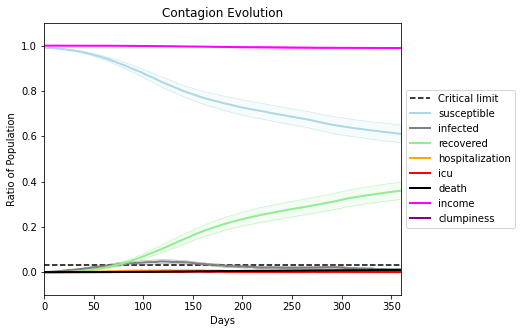

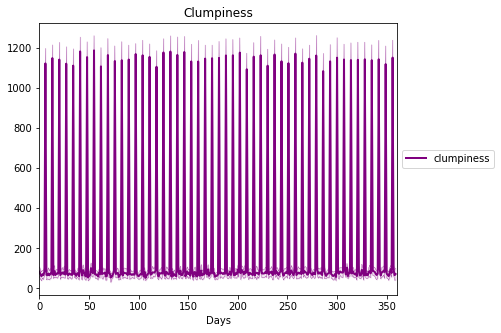

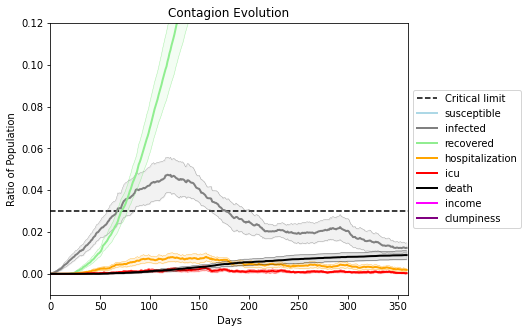

In [15]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], work_home_list = [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[478, 8027, 6090, 6833, 9996, 9104, 9223, 3856, 6690, 2358, 8928, 9723, 3562, 659, 4303, 2298, 3557, 5753, 5402, 7722]
Average similarity between family members is 0.5567198252683904 at temperature -0.9
Average similarity between family and home is 0.9998455080482842 at temperature -1
Average similarity between students and their classroom is 0.23225928182463942 at temperature -0.9
Average classroom occupancy is 1.630057803468208 and number classrooms is 173
Average similarity between workers is 0.4562996079806211 at temperature -0.9
Average office occupancy is 3.3819095477386933 and number offices is 199
Average friend similarity for adults: 0.6035565302194738 for kids: 0.5007963711237261
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.06379430339984254
avg restaurant similarity 0.17709629749815467
avg restaurant similarity 0.01432651468141789
avg restaurant similarity 0.08218234486550047
avg restaurant similarity 0.17153028494386674
avg restaurant similarity 0.0913478849135905
avg restaurant similarity 0.06482640165707244
avg restaurant similarity 0.09710028007011577
avg restaurant similarity 0.09508172424517947
avg restaurant similarity 0.11590672881534966
avg restaurant similarity 0.07205974358316151
avg restaurant similarity 0.13798796520269452
avg restaurant similarity 0.13368050394865208
avg restaurant similarity 0.16197215742788415
avg restaurant similarity 0.07770153518838327
avg restaurant similarity 0.08476775845518654
avg restaurant similarity 0.08345283879809648
avg restaurant similarity 0.16083198149484915
avg restaurant similarity 0.03556587742190933
avg restaurant similarity 0.10683071596338944
avg restaurant similarity 0.07561727448309521
avg restaurant similarity 0.1401315

avg restaurant similarity 0.10086975565104755
avg restaurant similarity 0.06167862687379838
avg restaurant similarity 0.09751435649053862
avg restaurant similarity 0.11965323881489343
avg restaurant similarity 0.13986697770288478
avg restaurant similarity 0.06852189860178712
avg restaurant similarity 0.13463267296636078
avg restaurant similarity 0.11092994954879874
avg restaurant similarity 0.08524359403839894
avg restaurant similarity 0.08771675562233124
avg restaurant similarity 0.10865633050312948
avg restaurant similarity 0.15527324877624624
avg restaurant similarity 0.09775549806826851
avg restaurant similarity 0.06861519189665342
avg restaurant similarity 0.09372789770036079
avg restaurant similarity 0.04185164872920029
avg restaurant similarity 0.0752180494752584
avg restaurant similarity 0.13303378540584057
avg restaurant similarity 0.11321109628368888
avg restaurant similarity 0.08588758214130113
avg restaurant similarity 0.09447183237057577
avg restaurant similarity 0.1345910

avg restaurant similarity 0.06681285103321695
avg restaurant similarity 0.11875124294627475
Average similarity between family members is 0.5626155138575023 at temperature -0.9
Average similarity between family and home is 0.9998512299129673 at temperature -1
Average similarity between students and their classroom is 0.22678494089247006 at temperature -0.9
Average classroom occupancy is 1.625 and number classrooms is 160
Average similarity between workers is 0.4576945708516733 at temperature -0.9
Average office occupancy is 3.4088669950738915 and number offices is 203
Average friend similarity for adults: 0.6100345122605261 for kids: 0.49077373424421217
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with 

avg restaurant similarity 0.19589979250553427
avg restaurant similarity 0.07889216731294948
avg restaurant similarity 0.13561694455687093
avg restaurant similarity 0.10119398211598082
avg restaurant similarity 0.1150007750064367
avg restaurant similarity 0.08317180782115013
avg restaurant similarity 0.07367306085741016
avg restaurant similarity 0.014054814271430165
avg restaurant similarity 0.10394661129056419
avg restaurant similarity 0.06382931624191802
avg restaurant similarity 0.11834779477787868
avg restaurant similarity 0.06685850769986265
avg restaurant similarity 0.12420217646695603
avg restaurant similarity 0.05713017229323376
avg restaurant similarity 0.024689367712033672
avg restaurant similarity -0.012344361289818718
avg restaurant similarity 0.10109620990895843
avg restaurant similarity 0.11129676618392632
avg restaurant similarity 0.10437403831559934
avg restaurant similarity 0.05116214562747437
avg restaurant similarity 0.0775693070221324
avg restaurant similarity 0.0619

avg restaurant similarity 0.08668031538721079
avg restaurant similarity 0.020307715083365284
avg restaurant similarity 0.13925069232284903
avg restaurant similarity 0.07090499190791276
avg restaurant similarity 0.0624795782959082
avg restaurant similarity 0.10704011062583695
avg restaurant similarity 0.1065812910841935
avg restaurant similarity 0.12135162685988478
avg restaurant similarity 0.07237256728610988
avg restaurant similarity 0.06246026128923998
avg restaurant similarity 0.11533759372194627
avg restaurant similarity 0.08761876248078407
avg restaurant similarity 0.0902702104306123
avg restaurant similarity 0.12625559225314217
avg restaurant similarity 0.09451489141787055
avg restaurant similarity 0.0893136321848836
avg restaurant similarity 0.0647303027117022
avg restaurant similarity 0.14831102735286322
avg restaurant similarity 0.09819040354300503
avg restaurant similarity 0.11424956939870529
avg restaurant similarity 0.07062359317939951
avg restaurant similarity 0.0662211177

avg restaurant similarity 0.12583408543359775
avg restaurant similarity 0.029693212715474357
avg restaurant similarity 0.0642248084748276
Average similarity between family members is 0.5522071200232612 at temperature -0.9
Average similarity between family and home is 0.9998626467248004 at temperature -1
Average similarity between students and their classroom is 0.2243281648047487 at temperature -0.9
Average classroom occupancy is 1.5865921787709498 and number classrooms is 179
Average similarity between workers is 0.44113090281375034 at temperature -0.9
Average office occupancy is 3.3383084577114426 and number offices is 201
Average friend similarity for adults: 0.5944029195363348 for kids: 0.49114114283590815
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.08641925025981179
avg restaurant similarity 0.07227379668194739
avg restaurant similarity 0.10464520743268114
avg restaurant similarity 0.11595100210506167
avg restaurant similarity 0.017038537544062437
avg restaurant similarity 0.11839326491720183
avg restaurant similarity 0.032446513423179
avg restaurant similarity 0.09406795499972209
avg restaurant similarity 0.11013601910755172
avg restaurant similarity 0.10514628830312378
avg restaurant similarity 0.0735862328440215
avg restaurant similarity 0.1306630166199204
avg restaurant similarity 0.11300633339251472
avg restaurant similarity 0.18003443495880828
avg restaurant similarity 0.13113097891870315
avg restaurant similarity 0.10879045828788289
avg restaurant similarity 0.0766352883085819
avg restaurant similarity 0.09328568068485019
avg restaurant similarity 0.0870214059594691
avg restaurant similarity 0.11401880079314501
avg restaurant similarity 0.1309928378599339
avg restaurant similarity 0.054852728368

avg restaurant similarity 0.09541164565633815
avg restaurant similarity 0.11467259791471951
avg restaurant similarity 0.1261841630848244
avg restaurant similarity 0.09223655666325539
avg restaurant similarity 0.11404394727979214
avg restaurant similarity 0.11673740885752837
avg restaurant similarity 0.13282030933849487
avg restaurant similarity 0.17085442346179472
avg restaurant similarity -0.003148388592314783
avg restaurant similarity 0.11571937722379122
avg restaurant similarity 0.13559854925565706
avg restaurant similarity 0.10007317540728304
avg restaurant similarity 0.13553042536004598
avg restaurant similarity 0.10754165579966195
avg restaurant similarity 0.1027557059112207
avg restaurant similarity 0.14854718818116527
avg restaurant similarity 0.12471101062938171
avg restaurant similarity 0.13331519575933298
avg restaurant similarity 0.09736803379228591
avg restaurant similarity 0.15436443078118983
avg restaurant similarity 0.09206491918635998
avg restaurant similarity 0.044539

avg restaurant similarity 0.020761539154744914
avg restaurant similarity 0.031001269158562085
Average similarity between family members is 0.5429661772044279 at temperature -0.9
Average similarity between family and home is 0.9998562147537162 at temperature -1
Average similarity between students and their classroom is 0.23595914617826197 at temperature -0.9
Average classroom occupancy is 1.6722222222222223 and number classrooms is 180
Average similarity between workers is 0.44021537757088397 at temperature -0.9
Average office occupancy is 3.2254901960784315 and number offices is 204
Average friend similarity for adults: 0.6022569312250272 for kids: 0.5041598593012552
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocate

avg restaurant similarity 0.16643039471161727
avg restaurant similarity 0.14451956077350853
avg restaurant similarity 0.08997574756366665
avg restaurant similarity 0.10221477459874793
avg restaurant similarity 0.07533657241559319
avg restaurant similarity 0.1619935787906744
avg restaurant similarity 0.05840684484062637
avg restaurant similarity 0.10458227408611681
avg restaurant similarity 0.10047077457896554
avg restaurant similarity 0.1718567356114912
avg restaurant similarity 0.16072720451968808
avg restaurant similarity 0.16513404815543167
avg restaurant similarity 0.15146483980524622
avg restaurant similarity 0.1677269625881245
avg restaurant similarity 0.11956027364534172
avg restaurant similarity 0.17908141431659924
avg restaurant similarity 0.0828246500553612
avg restaurant similarity 0.16677343765123429
avg restaurant similarity 0.13258053806060316
avg restaurant similarity 0.0815582141584693
avg restaurant similarity 0.12731651908028704
avg restaurant similarity 0.14653350516

avg restaurant similarity 0.09576981645325697
avg restaurant similarity 0.1913810014105146
avg restaurant similarity 0.10568060312528388
avg restaurant similarity 0.13055263129797567
avg restaurant similarity 0.08670482262433493
avg restaurant similarity 0.1302088251472179
avg restaurant similarity 0.1202087234240184
avg restaurant similarity 0.08198643826325375
avg restaurant similarity 0.12343724924302678
avg restaurant similarity 0.1504745343373831
avg restaurant similarity 0.08468213365681239
avg restaurant similarity 0.05987568925023214
avg restaurant similarity 0.07739078508728912
avg restaurant similarity 0.14949504409513634
avg restaurant similarity 0.12548063092583
avg restaurant similarity 0.10220671316904784
avg restaurant similarity 0.1432515239222973
avg restaurant similarity 0.12166713981240057
avg restaurant similarity 0.13660578195384884
avg restaurant similarity 0.09473722739774974
avg restaurant similarity 0.09133463190823261
avg restaurant similarity 0.07470387843287

Average similarity between family members is 0.5446536970863654 at temperature -0.9
Average similarity between family and home is 0.9998561194639217 at temperature -1
Average similarity between students and their classroom is 0.23057188766574513 at temperature -0.9
Average classroom occupancy is 1.6746987951807228 and number classrooms is 166
Average similarity between workers is 0.45008059293388575 at temperature -0.9
Average office occupancy is 3.297029702970297 and number offices is 202
Average friend similarity for adults: 0.5981290417819869 for kids: 0.5040813768405022
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0)

avg restaurant similarity 0.1130496571598531
avg restaurant similarity 0.08865404004769548
avg restaurant similarity 0.032195342579063986
avg restaurant similarity 0.06522881279531834
avg restaurant similarity 0.09482488331827661
avg restaurant similarity 0.07058656515915099
avg restaurant similarity 0.1374342704695755
avg restaurant similarity 0.11226101746374673
avg restaurant similarity 0.09430301305727609
avg restaurant similarity 0.15657907050216968
avg restaurant similarity 0.08249621711357166
avg restaurant similarity 0.0941663624847212
avg restaurant similarity 0.11206915411983374
avg restaurant similarity 0.15498430566954827
avg restaurant similarity 0.14189175792725756
avg restaurant similarity 0.08894276485683646
avg restaurant similarity 0.06477075516797191
avg restaurant similarity 0.09469587897819566
avg restaurant similarity 0.09607720458399786
avg restaurant similarity 0.02257166150925975
avg restaurant similarity 0.11771074514402603
avg restaurant similarity 0.06247389

avg restaurant similarity 0.16393289736306332
avg restaurant similarity 0.08806720221054914
avg restaurant similarity 0.177165078921249
avg restaurant similarity 0.1510380203958274
avg restaurant similarity 0.1598209177426793
avg restaurant similarity 0.13594788957676138
avg restaurant similarity 0.08944943653214597
avg restaurant similarity 0.12166635387208426
avg restaurant similarity 0.10646394109065134
avg restaurant similarity 0.11796654507493069
avg restaurant similarity 0.028345682365327314
avg restaurant similarity 0.06925368626491606
avg restaurant similarity 0.08348514485642985
avg restaurant similarity 0.1527650432304352
avg restaurant similarity 0.0653377039210117
avg restaurant similarity 0.08758898967568157
avg restaurant similarity 0.12756483058928092
avg restaurant similarity 0.07002597122148953
avg restaurant similarity 0.09659389403468704
avg restaurant similarity 0.09593319113173089
avg restaurant similarity 0.0880119545195498
avg restaurant similarity 0.162776977538

avg restaurant similarity 0.18400307989510697
avg restaurant similarity 0.18452025285111626
Average similarity between family members is 0.5413962721490009 at temperature -0.9
Average similarity between family and home is 0.9998559190817023 at temperature -1
Average similarity between students and their classroom is 0.24384134336508337 at temperature -0.9
Average classroom occupancy is 1.7005988023952097 and number classrooms is 167
Average similarity between workers is 0.4596731250837819 at temperature -0.9
Average office occupancy is 3.3756345177664975 and number offices is 197
Average friend similarity for adults: 0.6091176931956759 for kids: 0.495630322713692
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.10542128676502267
avg restaurant similarity 0.10147819342460478
avg restaurant similarity 0.01852509947253436
avg restaurant similarity 0.1313858093835015
avg restaurant similarity 0.10155222602726977
avg restaurant similarity 0.09804520285062286
avg restaurant similarity 0.046289248282429446
avg restaurant similarity 0.1290625203936675
avg restaurant similarity 0.04356811044865178
avg restaurant similarity 0.11607098115727092
avg restaurant similarity 0.0891935618280504
avg restaurant similarity 0.08727434921178037
avg restaurant similarity 0.08265017863080863
avg restaurant similarity 0.03209499846212859
avg restaurant similarity 0.11170835075482069
avg restaurant similarity 0.14527965258239958
avg restaurant similarity 0.06243062295011829
avg restaurant similarity 0.10418897622113125
avg restaurant similarity 0.15276570719267554
avg restaurant similarity 0.08636138542469675
avg restaurant similarity 0.1060118760144559
avg restaurant similarity 0.069636924

avg restaurant similarity 0.10442779911197644
avg restaurant similarity 0.11085748256500891
avg restaurant similarity 0.06395952505500888
avg restaurant similarity 0.0016097362254901596
avg restaurant similarity 0.1020041804677483
avg restaurant similarity 0.17526551939781276
avg restaurant similarity 0.06021996487650887
avg restaurant similarity 0.1064386794199331
avg restaurant similarity 0.0992187664749198
avg restaurant similarity 0.07350787358572566
avg restaurant similarity 0.09109307074004534
avg restaurant similarity 0.05770885229354347
avg restaurant similarity 0.09087987817102654
avg restaurant similarity 0.09179366475904153
avg restaurant similarity 0.09462068673314948
avg restaurant similarity 0.03378802011137126
avg restaurant similarity 0.11074222162394036
avg restaurant similarity 0.1794061406491643
avg restaurant similarity 0.05465758697760607
avg restaurant similarity 0.10044515330523544
avg restaurant similarity 0.04729773797716982
avg restaurant similarity 0.08751719

avg restaurant similarity 0.12393339525913334
avg restaurant similarity 0.10586830562608421
Average similarity between family members is 0.5666163255125216 at temperature -0.9
Average similarity between family and home is 0.9998532197999427 at temperature -1
Average similarity between students and their classroom is 0.25062093469883834 at temperature -0.9
Average classroom occupancy is 1.4915254237288136 and number classrooms is 177
Average similarity between workers is 0.44741213962316695 at temperature -0.9
Average office occupancy is 3.2935323383084576 and number offices is 201
Average friend similarity for adults: 0.5989164360627394 for kids: 0.5015279852450625
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated 

avg restaurant similarity 0.09826771932107099
avg restaurant similarity 0.06985366587807344
avg restaurant similarity 0.09139445983196089
avg restaurant similarity 0.14981743876843528
avg restaurant similarity 0.09324168536398961
avg restaurant similarity 0.1750039855449598
avg restaurant similarity 0.03362117696079237
avg restaurant similarity 0.08279423725787668
avg restaurant similarity 0.09123648039129735
avg restaurant similarity 0.06767320182800586
avg restaurant similarity 0.10543624574239141
avg restaurant similarity 0.10770857084957533
avg restaurant similarity 0.12264228348112892
avg restaurant similarity 0.10071428288679793
avg restaurant similarity 0.07701577859616356
avg restaurant similarity 0.12376943423231608
avg restaurant similarity 0.08821485566307659
avg restaurant similarity 0.09872110619729928
avg restaurant similarity 0.12309887847438622
avg restaurant similarity 0.10599426228716032
avg restaurant similarity 0.07082909434383079
avg restaurant similarity 0.1163509

avg restaurant similarity 0.0820898067617971
avg restaurant similarity 0.11869751168258329
avg restaurant similarity 0.058833646188248656
avg restaurant similarity 0.06813218198502728
avg restaurant similarity 0.13829448647571915
avg restaurant similarity 0.11581690892268999
avg restaurant similarity 0.07520276191567714
avg restaurant similarity 0.08761456449689738
avg restaurant similarity 0.09744938351811523
avg restaurant similarity 0.10053728137763084
avg restaurant similarity 0.14392691605167823
avg restaurant similarity 0.028453142989901536
avg restaurant similarity 0.1457787562967608
avg restaurant similarity 0.11224603157483232
avg restaurant similarity 0.10642139545939948
avg restaurant similarity 0.08194708860284994
avg restaurant similarity 0.13675099471943578
avg restaurant similarity 0.13078088831694584
avg restaurant similarity 0.11514954427538783
avg restaurant similarity 0.11761180286984771
avg restaurant similarity 0.09348045189021986
avg restaurant similarity 0.135277

avg restaurant similarity 0.09524782664726059
avg restaurant similarity 0.13001359388790304
Average similarity between family members is 0.5625600586370169 at temperature -0.9
Average similarity between family and home is 0.9998592250626926 at temperature -1
Average similarity between students and their classroom is 0.2750886061705188 at temperature -0.9
Average classroom occupancy is 1.5668449197860963 and number classrooms is 187
Average similarity between workers is 0.4465930490425223 at temperature -0.9
Average office occupancy is 3.2663316582914574 and number offices is 199
Average friend similarity for adults: 0.5985148664145181 for kids: 0.5201644089656682
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated un

avg restaurant similarity 0.15126742475570498
avg restaurant similarity 0.07925843287660095
avg restaurant similarity 0.1916211361542809
avg restaurant similarity 0.1352099952966723
avg restaurant similarity 0.08793376340572974
avg restaurant similarity 0.09579685294111126
avg restaurant similarity 0.12087411979501365
avg restaurant similarity 0.09507060592958397
avg restaurant similarity 0.09273633059429516
avg restaurant similarity 0.12976632418604417
avg restaurant similarity 0.1511561619863675
avg restaurant similarity 0.09321866487297095
avg restaurant similarity 0.11126471321169942
avg restaurant similarity 0.12326905284919543
avg restaurant similarity 0.1574130152489651
avg restaurant similarity 0.08003951716675163
avg restaurant similarity 0.14533645464091813
avg restaurant similarity 0.1621464578641846
avg restaurant similarity 0.07401768860188952
avg restaurant similarity 0.09313349159314772
avg restaurant similarity 0.055210387543592886
avg restaurant similarity 0.0755683336

avg restaurant similarity 0.18073210551665983
avg restaurant similarity 0.13683121161579462
avg restaurant similarity 0.16394617944067427
avg restaurant similarity 0.1149407651103786
avg restaurant similarity 0.16105092352902103
avg restaurant similarity 0.07929347195297413
avg restaurant similarity 0.13573429427630143
avg restaurant similarity 0.11667722944880708
avg restaurant similarity 0.12624625339104378
avg restaurant similarity 0.16364913765777542
avg restaurant similarity 0.06500396661758742
avg restaurant similarity 0.12370501872834688
avg restaurant similarity 0.07019123155016392
avg restaurant similarity 0.11464953019567362
avg restaurant similarity 0.11923156761311438
avg restaurant similarity 0.15484690626944178
avg restaurant similarity 0.13025096510467726
avg restaurant similarity 0.1405587167662387
avg restaurant similarity 0.12580321829058783
avg restaurant similarity 0.1088751709655174
avg restaurant similarity 0.16481540727502741
avg restaurant similarity 0.169300717

avg restaurant similarity 0.08618390912198531
avg restaurant similarity 0.1418489674372429
Average similarity between family members is 0.5540646462351926 at temperature -0.9
Average similarity between family and home is 0.9998645429785721 at temperature -1
Average similarity between students and their classroom is 0.26889464279398784 at temperature -0.9
Average classroom occupancy is 1.7556818181818181 and number classrooms is 176
Average similarity between workers is 0.4520082570534027 at temperature -0.9
Average office occupancy is 3.0588235294117645 and number offices is 204
Average friend similarity for adults: 0.5989853966391484 for kids: 0.5019519473624279
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated 

avg restaurant similarity 0.05640657927250724
avg restaurant similarity 0.11825751622483774
avg restaurant similarity 0.020598461719805134
avg restaurant similarity 0.12695338343055068
avg restaurant similarity 0.07543906051572875
avg restaurant similarity 0.1471774320751774
avg restaurant similarity 0.07091016438899002
avg restaurant similarity 0.0037709826448798687
avg restaurant similarity 0.07164013899523541
avg restaurant similarity 0.03005990841770428
avg restaurant similarity 0.07321482908001554
avg restaurant similarity 0.053926410449891035
avg restaurant similarity 0.08122789463197284
avg restaurant similarity 0.0510144129609818
avg restaurant similarity 0.11352510410661419
avg restaurant similarity 0.1131992814220294
avg restaurant similarity 0.04143819730100234
avg restaurant similarity 0.02940795098338494
avg restaurant similarity 0.01705462852121473
avg restaurant similarity 0.05922042594076978
avg restaurant similarity 0.06541388587731631
avg restaurant similarity 0.19571

avg restaurant similarity 0.017961234974217918
avg restaurant similarity 0.11710489884520986
avg restaurant similarity 0.06530158949717507
avg restaurant similarity 0.08943646636217308
avg restaurant similarity 0.09621645034204682
avg restaurant similarity 0.09444482215053786
avg restaurant similarity 0.15793299728671759
avg restaurant similarity 0.0738976024092016
avg restaurant similarity 0.05825001817413343
avg restaurant similarity 0.05117935175746038
avg restaurant similarity 0.06829370786505004
avg restaurant similarity 0.048345770507791756
avg restaurant similarity 0.08458657118736763
avg restaurant similarity 0.10526699918731505
avg restaurant similarity 0.07110502711297281
avg restaurant similarity 0.05920161285896063
avg restaurant similarity 0.09550593936797858
avg restaurant similarity 0.10006994362552425
avg restaurant similarity 0.03540419152542181
avg restaurant similarity 0.05535270645521656
avg restaurant similarity 0.08537725518406694
avg restaurant similarity 0.17778

avg restaurant similarity 0.06245229900700601
avg restaurant similarity 0.05738385607515972
avg restaurant similarity 0.10550686382935621
Average similarity between family members is 0.5477875757843332 at temperature -0.9
Average similarity between family and home is 0.9998533427032846 at temperature -1
Average similarity between students and their classroom is 0.2802065726346991 at temperature -0.9
Average classroom occupancy is 1.5898876404494382 and number classrooms is 178
Average similarity between workers is 0.4422445083659263 at temperature -0.9
Average office occupancy is 3.282178217821782 and number offices is 202
Average friend similarity for adults: 0.6057319116485604 for kids: 0.5022343342148133
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (e

avg restaurant similarity 0.13116281992587062
avg restaurant similarity 0.17286919912766247
avg restaurant similarity 0.14121517757090857
avg restaurant similarity 0.11072914412709557
avg restaurant similarity 0.027457067555469648
avg restaurant similarity 0.11696942937479338
avg restaurant similarity 0.16825549573436407
avg restaurant similarity 0.12826574006539432
avg restaurant similarity 0.13293281640720053
avg restaurant similarity 0.09724701324717597
avg restaurant similarity 0.17518076718995396
avg restaurant similarity 0.11084762931468824
avg restaurant similarity 0.07209269976259143
avg restaurant similarity 0.06841424783206443
avg restaurant similarity 0.044965687920220626
avg restaurant similarity 0.1456805968040122
avg restaurant similarity 0.1525245242927784
avg restaurant similarity 0.06916876033088672
avg restaurant similarity 0.09278830099706872
avg restaurant similarity 0.07879721107323723
avg restaurant similarity 0.09939791474416125
avg restaurant similarity 0.093176

avg restaurant similarity 0.10823712680217602
avg restaurant similarity 0.14404430024677453
avg restaurant similarity 0.04078614447269178
avg restaurant similarity 0.08703473131069148
avg restaurant similarity 0.05437184724407201
avg restaurant similarity 0.14783009421620627
avg restaurant similarity 0.06712968458579198
avg restaurant similarity 0.11051602849068198
avg restaurant similarity 0.11814441836618483
avg restaurant similarity 0.1085940432086561
avg restaurant similarity 0.061754854268641156
avg restaurant similarity 0.13248388403707106
avg restaurant similarity 0.10676330068756683
avg restaurant similarity 0.09801744862888305
avg restaurant similarity 0.07528630934852859
avg restaurant similarity 0.03757323303699427
avg restaurant similarity 0.19520639690058264
avg restaurant similarity 0.10612825772596528
avg restaurant similarity 0.030796014139468437
avg restaurant similarity 0.10225805457720157
avg restaurant similarity 0.09270138337861313
avg restaurant similarity 0.11100

avg restaurant similarity 0.1707008634435457
avg restaurant similarity 0.06606788192749956
Average similarity between family members is 0.5477444445914411 at temperature -0.9
Average similarity between family and home is 0.9998553221432741 at temperature -1
Average similarity between students and their classroom is 0.22944404562622633 at temperature -0.9
Average classroom occupancy is 1.5274725274725274 and number classrooms is 182
Average similarity between workers is 0.44963082485347194 at temperature -0.9
Average office occupancy is 3.301980198019802 and number offices is 202
Average friend similarity for adults: 0.6004620911352978 for kids: 0.49347788779655455
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.13978106456603173
avg restaurant similarity 0.10072225136448637
avg restaurant similarity 0.14691098997280658
avg restaurant similarity 0.15681472532885163
avg restaurant similarity 0.12527216278808753
avg restaurant similarity 0.034703522519567945
avg restaurant similarity 0.07401107579470571
avg restaurant similarity 0.0796657903720141
avg restaurant similarity 0.02816090102402829
avg restaurant similarity 0.033039506503838946
avg restaurant similarity 0.18178034108524133
avg restaurant similarity 0.15903580136480694
avg restaurant similarity 0.1942534761327532
avg restaurant similarity 0.09187460247058372
avg restaurant similarity 0.1566534130893395
avg restaurant similarity 0.1431019032640444
avg restaurant similarity 0.121844233085797
avg restaurant similarity 0.08915273793303335
avg restaurant similarity 0.12868864779167805
avg restaurant similarity 0.16446713390994896
avg restaurant similarity 0.12072941541160838
avg restaurant similarity 0.0510006924

avg restaurant similarity 0.0614586832508824
avg restaurant similarity 0.09670831733497025
avg restaurant similarity 0.1496812254793743
avg restaurant similarity 0.0551061070124292
avg restaurant similarity 0.07282281228808518
avg restaurant similarity 0.04319274710098846
avg restaurant similarity 0.13367807804804172
avg restaurant similarity 0.08100910942791305
avg restaurant similarity 0.1455507661100466
avg restaurant similarity 0.07791402940333368
avg restaurant similarity 0.06045567605515045
avg restaurant similarity 0.09028976147057105
avg restaurant similarity 0.08904839892076062
avg restaurant similarity 0.13571166184211886
avg restaurant similarity 0.14103416798436946
avg restaurant similarity 0.0827061402975771
avg restaurant similarity 0.11994158809846744
avg restaurant similarity 0.053663621537858766
avg restaurant similarity 0.1130103800031059
avg restaurant similarity 0.09884781485221913
avg restaurant similarity 0.11046273135594561
avg restaurant similarity 0.15402153875

avg restaurant similarity 0.06619204387475748
avg restaurant similarity 0.12343154412329681
Average similarity between family members is 0.5531069302288582 at temperature -0.9
Average similarity between family and home is 0.9998499471607125 at temperature -1
Average similarity between students and their classroom is 0.2421668871728218 at temperature -0.9
Average classroom occupancy is 1.6123595505617978 and number classrooms is 178
Average similarity between workers is 0.4644407180169748 at temperature -0.9
Average office occupancy is 3.301980198019802 and number offices is 202
Average friend similarity for adults: 0.6072205819341656 for kids: 0.5053034599988302
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated uni

avg restaurant similarity 0.09927444207863002
avg restaurant similarity 0.14644388875247683
avg restaurant similarity 0.08507946833606471
avg restaurant similarity 0.1171607052042944
avg restaurant similarity 0.09409267890403193
avg restaurant similarity 0.14399733670541595
avg restaurant similarity 0.09943530804951456
avg restaurant similarity 0.1516376360818381
avg restaurant similarity 0.107955596384782
avg restaurant similarity 0.08443098982722919
avg restaurant similarity 0.1374411947667768
avg restaurant similarity 0.12470781525323694
avg restaurant similarity 0.17393191991960075
avg restaurant similarity 0.13660775708337644
avg restaurant similarity 0.10135542840907456
avg restaurant similarity 0.1508099178871293
avg restaurant similarity 0.1223704374055979
avg restaurant similarity 0.17223494994068844
avg restaurant similarity 0.07313580624960529
avg restaurant similarity 0.1630201694166045
avg restaurant similarity 0.144851776642412
avg restaurant similarity 0.1679845911538098

avg restaurant similarity 0.12207769122595934
avg restaurant similarity 0.1388659292132609
avg restaurant similarity 0.07783207462854862
avg restaurant similarity 0.12838541398350484
avg restaurant similarity 0.0492383254032587
avg restaurant similarity 0.12748651900836697
avg restaurant similarity 0.15514505571462447
avg restaurant similarity 0.15459026318637156
avg restaurant similarity 0.19953451196442934
avg restaurant similarity 0.039537135178727666
avg restaurant similarity 0.09588853756856243
avg restaurant similarity 0.13332522637314775
avg restaurant similarity 0.12769558661527436
avg restaurant similarity 0.14372433587512767
avg restaurant similarity 0.13962785802791108
avg restaurant similarity 0.14775089865708627
avg restaurant similarity 0.0834936941690081
avg restaurant similarity 0.19510156282652819
avg restaurant similarity 0.073917623629504
avg restaurant similarity 0.10148235498669325
avg restaurant similarity 0.17837503188166837
avg restaurant similarity 0.1121857658

avg restaurant similarity 0.088880043847559
Average similarity between family members is 0.5408393397664701 at temperature -0.9
Average similarity between family and home is 0.9998438867241501 at temperature -1
Average similarity between students and their classroom is 0.19807653695876934 at temperature -0.9
Average classroom occupancy is 1.5689655172413792 and number classrooms is 174
Average similarity between workers is 0.4449248633179358 at temperature -0.9
Average office occupancy is 3.3383084577114426 and number offices is 201
Average friend similarity for adults: 0.5965461949594586 for kids: 0.49101162712358365
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 peopl

avg restaurant similarity 0.16923680873435806
avg restaurant similarity 0.09963161464871274
avg restaurant similarity 0.08915768493957109
avg restaurant similarity 0.10831092633335915
avg restaurant similarity 0.11337705326649905
avg restaurant similarity 0.1224312422424478
avg restaurant similarity 0.09434458076703371
avg restaurant similarity 0.1718721611957668
avg restaurant similarity 0.11137599970254833
avg restaurant similarity 0.1656377600440534
avg restaurant similarity 0.0868587317516061
avg restaurant similarity 0.06745860630554606
avg restaurant similarity 0.053752437571256625
avg restaurant similarity 0.14163936945481576
avg restaurant similarity 0.12492191857538085
avg restaurant similarity 0.13213087478017937
avg restaurant similarity 0.04741556597507553
avg restaurant similarity 0.1568294017621621
avg restaurant similarity 0.13145270566387032
avg restaurant similarity 0.0832675146412531
avg restaurant similarity 0.11963763444177156
avg restaurant similarity 0.04958225660

avg restaurant similarity 0.07487017260052437
avg restaurant similarity 0.09766433871481507
avg restaurant similarity 0.07851491474225154
avg restaurant similarity 0.10020574533724191
avg restaurant similarity 0.12044188121357907
avg restaurant similarity 0.057090102717601794
avg restaurant similarity 0.13592525150024745
avg restaurant similarity 0.13860638022189226
avg restaurant similarity 0.06701760992395217
avg restaurant similarity 0.09892434890921865
avg restaurant similarity 0.12123879164214896
avg restaurant similarity 0.13160083019640845
avg restaurant similarity 0.06526138864639758
avg restaurant similarity 0.15230140695733235
avg restaurant similarity 0.07980386772397827
avg restaurant similarity 0.0774684745366204
avg restaurant similarity 0.0815561880532932
avg restaurant similarity 0.07558898942780529
avg restaurant similarity 0.14506891112333878
avg restaurant similarity 0.04654978287867714
avg restaurant similarity 0.1357126450034985
avg restaurant similarity 0.08686422

avg restaurant similarity 0.024378036824474043
avg restaurant similarity 0.09939004713375377
Average similarity between family members is 0.5688387705517891 at temperature -0.9
Average similarity between family and home is 0.999848148798592 at temperature -1
Average similarity between students and their classroom is 0.2683639594535584 at temperature -0.9
Average classroom occupancy is 1.5664739884393064 and number classrooms is 173
Average similarity between workers is 0.4618985379722702 at temperature -0.9
Average office occupancy is 3.345 and number offices is 200
Average friend similarity for adults: 0.6040186729168043 for kids: 0.49370119158072384
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a

avg restaurant similarity 0.13587134159145547
avg restaurant similarity 0.09201310757430556
avg restaurant similarity 0.10836468183886099
avg restaurant similarity 0.13175350231649233
avg restaurant similarity 0.16649215246333668
avg restaurant similarity 0.15633467819250488
avg restaurant similarity 0.10023211025724792
avg restaurant similarity 0.09548222048911958
avg restaurant similarity 0.040423235910519405
avg restaurant similarity 0.06322417832654473
avg restaurant similarity 0.15936854363109126
avg restaurant similarity 0.1273197839011515
avg restaurant similarity 0.08791338576004064
avg restaurant similarity 0.16342858686338368
avg restaurant similarity 0.05428165245766016
avg restaurant similarity 0.10783084809794626
avg restaurant similarity 0.04788985238516643
avg restaurant similarity 0.0688432967883423
avg restaurant similarity 0.12940409793000876
avg restaurant similarity 0.13059408843232384
avg restaurant similarity 0.09568454411049236
avg restaurant similarity 0.0944897

avg restaurant similarity 0.10683538988551158
avg restaurant similarity 0.07656498772502521
avg restaurant similarity 0.10908075737125646
avg restaurant similarity 0.0723213675779692
avg restaurant similarity 0.11685401840154791
avg restaurant similarity 0.15699064264999796
avg restaurant similarity 0.04907504014062847
avg restaurant similarity 0.12295983699057089
avg restaurant similarity 0.09577127824838087
avg restaurant similarity 0.07872624414059694
avg restaurant similarity 0.10806776034966815
avg restaurant similarity 0.03878495482686733
avg restaurant similarity 0.07017187845079992
avg restaurant similarity 0.11965957505155808
avg restaurant similarity 0.17604859416981108
avg restaurant similarity 0.11022475541411117
avg restaurant similarity 0.10229044630905644
avg restaurant similarity 0.09213378539920668
avg restaurant similarity 0.08728671527154494
avg restaurant similarity 0.1230091525134319
avg restaurant similarity 0.03159780746182379
avg restaurant similarity 0.15649403

avg restaurant similarity 0.09869566407501584
avg restaurant similarity 0.05897515313123498
Average similarity between family members is 0.5484469619577734 at temperature -0.9
Average similarity between family and home is 0.9998557540513934 at temperature -1
Average similarity between students and their classroom is 0.25255601732414584 at temperature -0.9
Average classroom occupancy is 1.5795454545454546 and number classrooms is 176
Average similarity between workers is 0.4630277801329942 at temperature -0.9
Average office occupancy is 3.3838383838383836 and number offices is 198
Average friend similarity for adults: 0.5977740315802703 for kids: 0.4972815613918314
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated u

avg restaurant similarity 0.1306389272799294
avg restaurant similarity 0.08185027250645294
avg restaurant similarity 0.08151837125059387
avg restaurant similarity 0.13368914822136171
avg restaurant similarity 0.09449211789201364
avg restaurant similarity 0.07866772630330277
avg restaurant similarity 0.032075700108120574
avg restaurant similarity 0.1425052795873704
avg restaurant similarity 0.1560960218120923
avg restaurant similarity 0.03697140086773817
avg restaurant similarity 0.06764460073142682
avg restaurant similarity 0.07763848433674436
avg restaurant similarity 0.07669518604230582
avg restaurant similarity 0.09068448393233959
avg restaurant similarity 0.08674950142531389
avg restaurant similarity 0.12760006557237094
avg restaurant similarity 0.10490620809701513
avg restaurant similarity 0.09021095479119742
avg restaurant similarity 0.05270142127949867
avg restaurant similarity 0.14985223191559344
avg restaurant similarity 0.1145007798410067
avg restaurant similarity 0.086455228

avg restaurant similarity 0.13663056337495616
avg restaurant similarity 0.0746821852656119
avg restaurant similarity 0.10846887872708674
avg restaurant similarity 0.09530185769963172
avg restaurant similarity 0.06722509378470183
avg restaurant similarity 0.03806201676869595
avg restaurant similarity 0.12231810930112592
avg restaurant similarity 0.045763273373388556
avg restaurant similarity 0.09694189722266505
avg restaurant similarity 0.08776220667647518
avg restaurant similarity 0.15066015981507166
avg restaurant similarity 0.06582256220754304
avg restaurant similarity 0.1275845863444481
avg restaurant similarity 0.11471272765670595
avg restaurant similarity 0.14986363638328234
avg restaurant similarity 0.09415050801652618
avg restaurant similarity 0.1296492882259006
avg restaurant similarity 0.10736723924804484
avg restaurant similarity 0.12516701881109862
avg restaurant similarity 0.06586508565148871
avg restaurant similarity 0.09549872155807951
avg restaurant similarity 0.12136187

avg restaurant similarity 0.1380352887341201
avg restaurant similarity 0.1023959690247436
Average similarity between family members is 0.55476079423524 at temperature -0.9
Average similarity between family and home is 0.9998560721615743 at temperature -1
Average similarity between students and their classroom is 0.25929137751264075 at temperature -0.9
Average classroom occupancy is 1.5056179775280898 and number classrooms is 178
Average similarity between workers is 0.4670806834424132 at temperature -0.9
Average office occupancy is 3.3768844221105527 and number offices is 199
Average friend similarity for adults: 0.6173443657609 for kids: 0.5105937817671383
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated units 

avg restaurant similarity 0.07305651131378461
avg restaurant similarity 0.0781936039104565
avg restaurant similarity 0.1067029061332363
avg restaurant similarity 0.09214871325233522
avg restaurant similarity 0.0817104411280466
avg restaurant similarity 0.15231260994529539
avg restaurant similarity 0.10647467102668788
avg restaurant similarity 0.05607601576979175
avg restaurant similarity 0.13306568753333586
avg restaurant similarity 0.043569942281661875
avg restaurant similarity 0.0980926384123328
avg restaurant similarity 0.08052048722882747
avg restaurant similarity 0.038044230061529495
avg restaurant similarity 0.12206221487484063
avg restaurant similarity 0.06892710900285016
avg restaurant similarity 0.07610726446870161
avg restaurant similarity 0.1112597750266834
avg restaurant similarity 0.011280683196688998
avg restaurant similarity 0.10303367400746007
avg restaurant similarity 0.09088290972428317
avg restaurant similarity 0.06021024643943449
avg restaurant similarity 0.04415734

avg restaurant similarity 0.10127181516071201
avg restaurant similarity 0.15524508852119878
avg restaurant similarity 0.11983006764891715
avg restaurant similarity 0.04584403561873718
avg restaurant similarity 0.08144348963468237
avg restaurant similarity 0.09029193791594853
avg restaurant similarity 0.07552050905415891
avg restaurant similarity 0.15494969770063233
avg restaurant similarity 0.07860671589283644
avg restaurant similarity 0.027244079628183756
avg restaurant similarity 0.13218647470459147
avg restaurant similarity 0.13928244596790487
avg restaurant similarity 0.07694021903512911
avg restaurant similarity 0.13216164226734553
avg restaurant similarity 0.11923204046019976
avg restaurant similarity 0.1177676549915069
avg restaurant similarity 0.08431271488712429
avg restaurant similarity 0.09140811437157248
avg restaurant similarity 0.0514460326813241
avg restaurant similarity 0.02116586317265337
avg restaurant similarity 0.059819522746721
avg restaurant similarity 0.087414700

avg restaurant similarity 0.05807522400587045
avg restaurant similarity 0.16502157465598108
Average similarity between family members is 0.5454595824393693 at temperature -0.9
Average similarity between family and home is 0.9998585255796247 at temperature -1
Average similarity between students and their classroom is 0.2223070215626094 at temperature -0.9
Average classroom occupancy is 1.5966850828729282 and number classrooms is 181
Average similarity between workers is 0.44549865615265016 at temperature -0.9
Average office occupancy is 3.3467336683417086 and number offices is 199
Average friend similarity for adults: 0.602073429571534 for kids: 0.49320211253509005
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.12065367413770046
avg restaurant similarity 0.1508058104303319
avg restaurant similarity 0.0697660151408757
avg restaurant similarity 0.12340891968046978
avg restaurant similarity 0.09029905435343054
avg restaurant similarity 0.10774132438599782
avg restaurant similarity 0.03572068555371682
avg restaurant similarity 0.132894498348166
avg restaurant similarity 0.18392684754716537
avg restaurant similarity 0.09516093157259609
avg restaurant similarity 0.11124086270630364
avg restaurant similarity 0.041926687832610915
avg restaurant similarity 0.08597885268548515
avg restaurant similarity 0.08437310310821862
avg restaurant similarity 0.032322046287567845
avg restaurant similarity 0.08403176906203288
avg restaurant similarity 0.04979757501910262
avg restaurant similarity 0.08383176125733044
avg restaurant similarity 0.0976198182343624
avg restaurant similarity 0.05844891621138381
avg restaurant similarity 0.11727950612215961
avg restaurant similarity 0.103391409

avg restaurant similarity 0.0792070481085153
avg restaurant similarity 0.08556174828028026
avg restaurant similarity 0.11524095598763727
avg restaurant similarity 0.1559226903151058
avg restaurant similarity 0.04634192361515907
avg restaurant similarity 0.06676977305787787
avg restaurant similarity 0.09637055071126371
avg restaurant similarity 0.16261743099662182
avg restaurant similarity 0.06987319586649646
avg restaurant similarity 0.022917131007224572
avg restaurant similarity 0.11542229873085208
avg restaurant similarity 0.11423639182418023
avg restaurant similarity 0.14225157932359386
avg restaurant similarity 0.08421882376666626
avg restaurant similarity 0.10441007284517016
avg restaurant similarity 0.1781314977670037
avg restaurant similarity 0.1284131161884499
avg restaurant similarity 0.1593899295783211
avg restaurant similarity 0.12269831969398984
avg restaurant similarity 0.08034324586924542
avg restaurant similarity 0.0877526833565017
avg restaurant similarity 0.06790537429

avg restaurant similarity 0.09492488368095665
avg restaurant similarity 0.10800941097738216
Average similarity between family members is 0.5486285740236185 at temperature -0.9
Average similarity between family and home is 0.9998511775662272 at temperature -1
Average similarity between students and their classroom is 0.2223053932092206 at temperature -0.9
Average classroom occupancy is 1.6836158192090396 and number classrooms is 177
Average similarity between workers is 0.4597295026679647 at temperature -0.9
Average office occupancy is 3.2 and number offices is 200
Average friend similarity for adults: 0.5985915783922066 for kids: 0.500037530513185
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total

avg restaurant similarity 0.09289411547958437
avg restaurant similarity 0.11701070253999925
avg restaurant similarity 0.09159518846205893
avg restaurant similarity 0.11968182007839684
avg restaurant similarity 0.15745992535049377
avg restaurant similarity 0.13636337932553752
avg restaurant similarity 0.09877846019792236
avg restaurant similarity 0.148229597955762
avg restaurant similarity 0.11011642749387518
avg restaurant similarity 0.13346678578958115
avg restaurant similarity 0.1412243787172305
avg restaurant similarity 0.1694168122055837
avg restaurant similarity 0.07611289038663935
avg restaurant similarity 0.13299457789151808
avg restaurant similarity 0.13833540915323156
avg restaurant similarity 0.08959438354432815
avg restaurant similarity 0.05822027224323908
avg restaurant similarity 0.14345923050226703
avg restaurant similarity 0.0743659180897127
avg restaurant similarity 0.1407869296858919
avg restaurant similarity 0.1312051565296297
avg restaurant similarity 0.1046816418264

avg restaurant similarity 0.08777070781956599
avg restaurant similarity 0.13899710873137514
avg restaurant similarity 0.08254265530836469
avg restaurant similarity 0.13547771270588424
avg restaurant similarity 0.12685785059264928
avg restaurant similarity 0.14583646869820785
avg restaurant similarity 0.05561040015545478
avg restaurant similarity 0.12171910425279624
avg restaurant similarity 0.12697219870118914
avg restaurant similarity 0.07740177630276249
avg restaurant similarity 0.04684841090661084
avg restaurant similarity 0.12985826745623488
avg restaurant similarity 0.11934344928038589
avg restaurant similarity 0.11737566029692278
avg restaurant similarity 0.1049601917518209
avg restaurant similarity 0.13250166349461917
avg restaurant similarity 0.12314750950022582
avg restaurant similarity 0.13997214809572803
avg restaurant similarity 0.12656238326352176
avg restaurant similarity 0.09783507176529233
avg restaurant similarity 0.09804627226157417
avg restaurant similarity 0.0742242

avg restaurant similarity 0.06471957257931801
avg restaurant similarity 0.13595953062402608
Average similarity between family members is 0.551899565250478 at temperature -0.9
Average similarity between family and home is 0.9998620632657993 at temperature -1
Average similarity between students and their classroom is 0.22596066276672683 at temperature -0.9
Average classroom occupancy is 1.5172413793103448 and number classrooms is 174
Average similarity between workers is 0.44620326210247574 at temperature -0.9
Average office occupancy is 3.42 and number offices is 200
Average friend similarity for adults: 0.6053406906951148 for kids: 0.49886490837996456
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a

avg restaurant similarity 0.13651588613339047
avg restaurant similarity 0.06824806467211478
avg restaurant similarity 0.11400268156830257
avg restaurant similarity 0.09670421943308488
avg restaurant similarity 0.17948019142657426
avg restaurant similarity 0.10672901365180976
avg restaurant similarity 0.1633275789830637
avg restaurant similarity 0.07997801614901345
avg restaurant similarity 0.10961229888466371
avg restaurant similarity 0.12596014801727887
avg restaurant similarity 0.02042613991244796
avg restaurant similarity 0.09616544011225
avg restaurant similarity 0.0625978047463297
avg restaurant similarity 0.15350441377598234
avg restaurant similarity 0.04433345568875454
avg restaurant similarity 0.11736029464644603
avg restaurant similarity 0.15944787072014308
avg restaurant similarity 0.08515297162497758
avg restaurant similarity 0.14924070083019933
avg restaurant similarity 0.14267874920879484
avg restaurant similarity 0.16151182017187848
avg restaurant similarity 0.07565460954

avg restaurant similarity 0.078165585079409
avg restaurant similarity 0.09003219916422674
avg restaurant similarity 0.15481289110246582
avg restaurant similarity 0.05183463790440073
avg restaurant similarity 0.07621361854011682
avg restaurant similarity 0.11793555894756715
avg restaurant similarity 0.08545436369068297
avg restaurant similarity 0.08997712316638747
avg restaurant similarity 0.07482776819155437
avg restaurant similarity 0.15333904456545455
avg restaurant similarity 0.10869371531009386
avg restaurant similarity 0.13069860675142012
avg restaurant similarity 0.14023831399807607
avg restaurant similarity 0.10928077610195344
avg restaurant similarity 0.16503961133580422
avg restaurant similarity 0.14272104250896264
avg restaurant similarity 0.13369573474347296
avg restaurant similarity 0.113764512402806
avg restaurant similarity 0.10194160437698509
avg restaurant similarity 0.10246874362956333
avg restaurant similarity 0.11589096562293213
avg restaurant similarity 0.1629147089

avg restaurant similarity 0.14354483845471716
avg restaurant similarity 0.08503333444119184
Average similarity between family members is 0.5644992450354074 at temperature -0.9
Average similarity between family and home is 0.9998572501733467 at temperature -1
Average similarity between students and their classroom is 0.23925031716005427 at temperature -0.9
Average classroom occupancy is 1.6363636363636365 and number classrooms is 176
Average similarity between workers is 0.45049488820227385 at temperature -0.9
Average office occupancy is 3.3181818181818183 and number offices is 198
Average friend similarity for adults: 0.6006063968858706 for kids: 0.5048668995031158
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated 

avg restaurant similarity 0.09305745180921857
avg restaurant similarity 0.08757094212345305
avg restaurant similarity 0.09691534120765441
avg restaurant similarity 0.1301882288519289
avg restaurant similarity 0.06860349885535881
avg restaurant similarity 0.1409640326328501
avg restaurant similarity 0.12512096256890476
avg restaurant similarity 0.12875991316739552
avg restaurant similarity 0.1486408447262698
avg restaurant similarity 0.06877287181094567
avg restaurant similarity 0.10842412813843612
avg restaurant similarity 0.05085830762393312
avg restaurant similarity 0.1148898201398569
avg restaurant similarity 0.1095622251524486
avg restaurant similarity 0.13103683385690695
avg restaurant similarity 0.1363135442157937
avg restaurant similarity 0.05095894268204031
avg restaurant similarity 0.05809095328406662
avg restaurant similarity 0.05730404270892632
avg restaurant similarity 0.1302101221326517
avg restaurant similarity 0.15140012319148696
avg restaurant similarity 0.1431555352849

avg restaurant similarity 0.1265201497667677
avg restaurant similarity 0.09592860137033679
avg restaurant similarity 0.10756322695949827
avg restaurant similarity 0.15115769178149144
avg restaurant similarity 0.1025060471976489
avg restaurant similarity 0.12276695654528762
avg restaurant similarity 0.08205052931227179
avg restaurant similarity 0.10156465152339837
avg restaurant similarity 0.1328286046019409
avg restaurant similarity 0.10407728282128663
avg restaurant similarity 0.048081293332798127
avg restaurant similarity 0.12100025012182788
avg restaurant similarity 0.10135153806156895
avg restaurant similarity 0.10604925615166758
avg restaurant similarity 0.09605398890804909
avg restaurant similarity 0.06920744918269867
avg restaurant similarity 0.17215078939978745
avg restaurant similarity 0.14802859137575333
avg restaurant similarity 0.14360559893371647
avg restaurant similarity 0.11795831564678193
avg restaurant similarity 0.08888035467720419
avg restaurant similarity 0.06828708

avg restaurant similarity 0.11687763658470282
avg restaurant similarity 0.1339811806311198
using average of time series:
stats on susceptible:
data: [0.7282190032190031, 0.7968424262585939, 0.714275, 0.8803973803973804, 0.7150472222222223, 0.7524388888888889, 0.8163805555555557, 0.7035138888888889, 0.8702666666666669, 0.6143444444444444, 0.8463861111111112, 0.810486111111111, 0.8597111111111111, 0.6304888888888889, 0.8180861111111111, 0.7556694444444444, 0.6331333333333333, 0.8843166666666666, 0.7243833333333334, 0.6535972222222223]
min:
0.6143444444444444
max:
0.8843166666666666
std:
0.08515622025287253
mean:
0.7603991904937489
median:
0.7540541666666667
95% confidence interval for the mean:
(0.7195095025977104,0.8012888783897875)
using average of time series:
stats on infected:
data: [0.03190420690420691, 0.02611998225770681, 0.033947222222222226, 0.016147741147741146, 0.03310833333333334, 0.02460833333333334, 0.022886111111111114, 0.02961388888888889, 0.016125, 0.03900555555555556, 

(<function dict.items>, <function dict.items>, <function dict.items>)

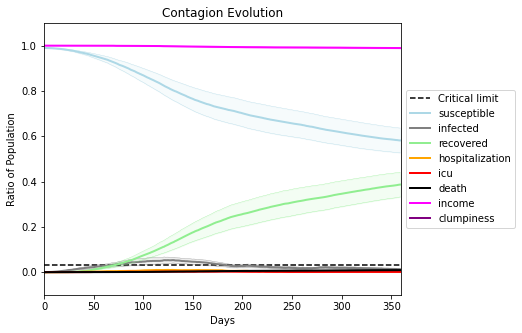

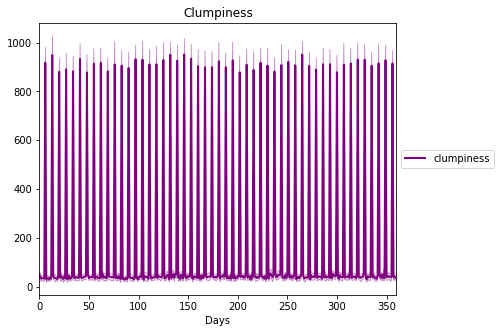

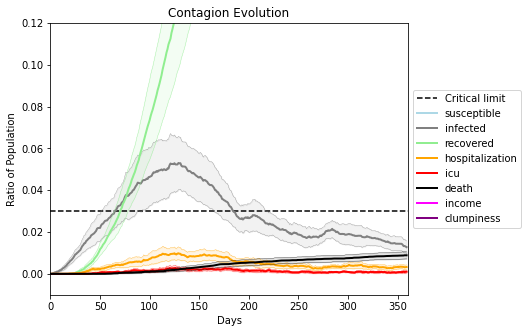

In [16]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9
params.params['num_communities'] = 100
seeds = [2252]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs=20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],
              work_home_list = 
            
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9315, 387, 2106, 3334, 3842, 2016, 7654, 5438, 1747, 3414, 9235, 1417, 4503, 1591, 4710, 6762, 3423, 3495, 4070, 2431]
Average similarity between family members is 0.40538366912140134 at temperature -0.8
Average similarity between family and home is 0.9998454982416815 at temperature -1
Average similarity between students and their classroom is 0.20164569967226648 at temperature -0.8
Average classroom occupancy is 1.5842696629213484 and number classrooms is 178
Average similarity between workers is 0.2832491156165416 at temperature -0.8
Average office occupancy is 3.2660098522167487 and number offices is 203
Average friend similarity for adults: 0.48961300371487676 for kids: 0.3736525412007311
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.0628996480042462
avg restaurant similarity 0.12606109400711943
avg restaurant similarity 0.022111923137246924
avg restaurant similarity 0.11280572225184644
avg restaurant similarity 0.08898873984072603
avg restaurant similarity 0.06201263918392611
avg restaurant similarity 0.09629065260690518
avg restaurant similarity 0.0002855951589851695
avg restaurant similarity 0.058416181350340615
avg restaurant similarity 0.03694398912035247
avg restaurant similarity 0.06516646265078445
avg restaurant similarity 0.034230934677053314
avg restaurant similarity 0.0648071782897444
avg restaurant similarity 0.06332565925966466
avg restaurant similarity 0.07717917787345328
avg restaurant similarity 0.0853699373701277
avg restaurant similarity 0.06756752116542732
avg restaurant similarity 0.0974172553854278
avg restaurant similarity 0.07624612536913575
avg restaurant similarity 0.048481682047465814
avg restaurant similarity 0.07000177774926918
avg restaurant similarity 0.0586

avg restaurant similarity 0.11919900595748774
avg restaurant similarity 0.02001748305686186
avg restaurant similarity 0.07178476316548103
avg restaurant similarity -0.0005345140277999074
avg restaurant similarity 0.12006683940779297
avg restaurant similarity 0.07292976026437112
avg restaurant similarity 0.07033772146359771
avg restaurant similarity 0.07956702279376537
avg restaurant similarity 0.08510337936019592
avg restaurant similarity 0.019232490621044245
avg restaurant similarity 0.023323948356551705
avg restaurant similarity 0.1056403311679195
avg restaurant similarity 0.060074652681586856
avg restaurant similarity 0.08000659619710979
avg restaurant similarity 0.053327033320370094
avg restaurant similarity 0.03718050841583237
avg restaurant similarity 0.05225680939995103
avg restaurant similarity 0.051397317553809115
avg restaurant similarity 0.08496352515109182
avg restaurant similarity 0.01903050153178155
avg restaurant similarity 0.041907830290268795
avg restaurant similarity 

avg restaurant similarity 0.07854523553407734
avg restaurant similarity 0.03881491110358613
avg restaurant similarity 0.08824236944756789
avg restaurant similarity 0.09190744767178435
Average similarity between family members is 0.4132755588318292 at temperature -0.8
Average similarity between family and home is 0.9998544226706971 at temperature -1
Average similarity between students and their classroom is 0.16741408527269447 at temperature -0.8
Average classroom occupancy is 1.4939024390243902 and number classrooms is 164
Average similarity between workers is 0.28155156910849394 at temperature -0.8
Average office occupancy is 3.395121951219512 and number offices is 205
Average friend similarity for adults: 0.496522777153021 for kids: 0.3491738467805488
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with

avg restaurant similarity 0.05572020417813893
avg restaurant similarity 0.0831678564322867
avg restaurant similarity 0.0829954321506227
avg restaurant similarity 0.06684306565797843
avg restaurant similarity 0.021884300928725144
avg restaurant similarity 0.0743030667278782
avg restaurant similarity 0.06414538134578518
avg restaurant similarity 0.10288205060704134
avg restaurant similarity 0.051312713984050254
avg restaurant similarity 0.06202673558360275
avg restaurant similarity 0.08392333741768199
avg restaurant similarity 0.08048320645932784
avg restaurant similarity 0.010617010785700678
avg restaurant similarity 0.06556025887210291
avg restaurant similarity 0.00757303965995588
avg restaurant similarity 0.0745791621915004
avg restaurant similarity 0.09566501524506502
avg restaurant similarity 0.030061281185862005
avg restaurant similarity 0.08567426737752874
avg restaurant similarity 0.047950633485938296
avg restaurant similarity 0.08901835896873013
avg restaurant similarity 0.02203

avg restaurant similarity 0.10954591312221165
avg restaurant similarity 0.09942255373214999
avg restaurant similarity 0.08639635133233922
avg restaurant similarity 0.0809751422411429
avg restaurant similarity 0.07009174915961983
avg restaurant similarity 0.07854138438036014
avg restaurant similarity 0.10613740737467055
avg restaurant similarity 0.08016013413458824
avg restaurant similarity 0.0584538089960031
avg restaurant similarity 0.02019301327476866
avg restaurant similarity 0.05040817499420639
avg restaurant similarity 0.0437425739137154
avg restaurant similarity 0.05197000592462366
avg restaurant similarity 0.09377503256525292
avg restaurant similarity 0.041554699540338455
avg restaurant similarity 0.07124943381234203
avg restaurant similarity 0.1206213452816143
avg restaurant similarity 0.07174651625845878
avg restaurant similarity -0.023468345310373912
avg restaurant similarity 0.07351920872537579
avg restaurant similarity 0.05138482419507945
avg restaurant similarity 0.1082148

avg restaurant similarity 0.05892251684057813
avg restaurant similarity 0.031007944554385547
avg restaurant similarity 0.03436139256232129
Average similarity between family members is 0.4303009127537687 at temperature -0.8
Average similarity between family and home is 0.9998609401519362 at temperature -1
Average similarity between students and their classroom is 0.1660514164865878 at temperature -0.8
Average classroom occupancy is 1.6728395061728396 and number classrooms is 162
Average similarity between workers is 0.28374394855132357 at temperature -0.8
Average office occupancy is 3.3284313725490198 and number offices is 204
Average friend similarity for adults: 0.49597521119046023 for kids: 0.38229275683950725
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.10140896097163969
avg restaurant similarity 0.07352263339552186
avg restaurant similarity 0.06809236948450192
avg restaurant similarity 0.08378724938625923
avg restaurant similarity 0.06129484078212798
avg restaurant similarity 0.06332129987054326
avg restaurant similarity 0.1012787549555169
avg restaurant similarity 0.13164957259586596
avg restaurant similarity 0.06306446202364202
avg restaurant similarity 0.07415533178091847
avg restaurant similarity 0.09219430874968415
avg restaurant similarity 0.047168365230141104
avg restaurant similarity 0.04652011541205399
avg restaurant similarity 0.0735266641900773
avg restaurant similarity 0.09892231279666974
avg restaurant similarity 0.08255719367487686
avg restaurant similarity 0.045526863127034085
avg restaurant similarity 0.04045915536585765
avg restaurant similarity 0.10871021869290634
avg restaurant similarity 0.045640837845310436
avg restaurant similarity 0.09208504348862277
avg restaurant similarity 0.05732

avg restaurant similarity 0.08582190800682109
avg restaurant similarity 0.07335007883795433
avg restaurant similarity 0.07375177594818232
avg restaurant similarity 0.07437130646949089
avg restaurant similarity 0.0481083543962139
avg restaurant similarity 0.09368279059345366
avg restaurant similarity 0.08823523941263291
avg restaurant similarity 0.06285522707856475
avg restaurant similarity 0.07471809057233422
avg restaurant similarity 0.07055978632942904
avg restaurant similarity 0.11918591794549604
avg restaurant similarity 0.10127640544874084
avg restaurant similarity 0.03900014393225683
avg restaurant similarity 0.12158732492614387
avg restaurant similarity 0.10213857845208013
avg restaurant similarity 0.049791591150049934
avg restaurant similarity 0.05229849435571846
avg restaurant similarity 0.06056075356150236
avg restaurant similarity 0.046553357969461015
avg restaurant similarity 0.059597703794891384
avg restaurant similarity 0.07236388681249993
avg restaurant similarity 0.0516

avg restaurant similarity 0.027437983160193007
avg restaurant similarity 0.11397946924565382
Average similarity between family members is 0.40662966631022296 at temperature -0.8
Average similarity between family and home is 0.9998715809429958 at temperature -1
Average similarity between students and their classroom is 0.16881754812579952 at temperature -0.8
Average classroom occupancy is 1.5683060109289617 and number classrooms is 183
Average similarity between workers is 0.3025995561844939 at temperature -0.8
Average office occupancy is 3.270935960591133 and number offices is 203
Average friend similarity for adults: 0.5043054667571956 for kids: 0.38132791267953203
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.12266718624829562
avg restaurant similarity 0.11257374166463618
avg restaurant similarity 0.061557278512196244
avg restaurant similarity 0.04928641622905287
avg restaurant similarity 0.07598161660453753
avg restaurant similarity 0.10821620205587756
avg restaurant similarity 0.09012263912339907
avg restaurant similarity 0.08438594551549476
avg restaurant similarity 0.08495962713763193
avg restaurant similarity 0.11892267794956005
avg restaurant similarity 0.06609005247514164
avg restaurant similarity 0.06930405519052771
avg restaurant similarity 0.07332024075487115
avg restaurant similarity 0.07430135753133157
avg restaurant similarity 0.07989279959717109
avg restaurant similarity 0.0695992760528681
avg restaurant similarity 0.10611576435990419
avg restaurant similarity 0.1027406724543086
avg restaurant similarity 0.15264665262167584
avg restaurant similarity 0.06238541586113147
avg restaurant similarity 0.13561929793126043
avg restaurant similarity 0.1277564

avg restaurant similarity 0.12627870484082854
avg restaurant similarity 0.041693213018728185
avg restaurant similarity 0.12438842315419855
avg restaurant similarity 0.09903745417505622
avg restaurant similarity 0.11152043875363532
avg restaurant similarity 0.08956808916785569
avg restaurant similarity 0.10037360768815362
avg restaurant similarity 0.07156159631045104
avg restaurant similarity 0.03696890532292899
avg restaurant similarity 0.1491908188618828
avg restaurant similarity 0.1548813209543225
avg restaurant similarity 0.08539971555556349
avg restaurant similarity 0.11027700187780816
avg restaurant similarity 0.06237709292779333
avg restaurant similarity 0.08175066350792852
avg restaurant similarity 0.03337855147505158
avg restaurant similarity 0.08251800201405983
avg restaurant similarity 0.14862104454091654
avg restaurant similarity 0.08401339739222036
avg restaurant similarity 0.05037749680055581
avg restaurant similarity 0.08845719125900936
avg restaurant similarity 0.1456225

avg restaurant similarity 0.12702514365000064
avg restaurant similarity 0.08887752976286824
Average similarity between family members is 0.43163713492432565 at temperature -0.8
Average similarity between family and home is 0.9998504910017465 at temperature -1
Average similarity between students and their classroom is 0.14151450764043566 at temperature -0.8
Average classroom occupancy is 1.6264367816091954 and number classrooms is 174
Average similarity between workers is 0.3096891710635881 at temperature -0.8
Average office occupancy is 3.29 and number offices is 200
Average friend similarity for adults: 0.49727406159593807 for kids: 0.3776309615702386
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a 

avg restaurant similarity 0.07729677887894405
avg restaurant similarity 0.0848314838465559
avg restaurant similarity 0.132202560037456
avg restaurant similarity 0.12747397355638837
avg restaurant similarity 0.14723893330271312
avg restaurant similarity 0.09685082174455677
avg restaurant similarity 0.10975956668026703
avg restaurant similarity 0.1255020165728322
avg restaurant similarity 0.07751382090445903
avg restaurant similarity 0.08203761460741903
avg restaurant similarity 0.1379406407028549
avg restaurant similarity 0.14490216074717632
avg restaurant similarity 0.1700909379367852
avg restaurant similarity 0.06809796828720596
avg restaurant similarity 0.11813599017632447
avg restaurant similarity 0.1369534339832941
avg restaurant similarity 0.1485369547887537
avg restaurant similarity 0.13759587273721427
avg restaurant similarity 0.15344887560577908
avg restaurant similarity 0.07016437456442431
avg restaurant similarity 0.0642779211827047
avg restaurant similarity 0.134780506370442

avg restaurant similarity 0.1008514055349311
avg restaurant similarity 0.09076626235678883
avg restaurant similarity 0.06469409280158267
avg restaurant similarity 0.11728641187272654
avg restaurant similarity 0.06942312231163746
avg restaurant similarity 0.07051059079083113
avg restaurant similarity 0.08884419414209462
avg restaurant similarity 0.10066425978889552
avg restaurant similarity 0.059545223371896036
avg restaurant similarity 0.06721633833034756
avg restaurant similarity 0.08330186586987036
avg restaurant similarity 0.13765281549366515
avg restaurant similarity 0.0383158060917564
avg restaurant similarity 0.0423378940070202
avg restaurant similarity 0.11916158679876732
avg restaurant similarity 0.14776365977329858
avg restaurant similarity 0.0978948801966242
avg restaurant similarity 0.12820238634064476
avg restaurant similarity 0.08777821037693098
avg restaurant similarity 0.05496262606696141
avg restaurant similarity 0.145093985095067
avg restaurant similarity 0.06579732601

avg restaurant similarity 0.0769034410790523
avg restaurant similarity 0.07543202687954473
Average similarity between family members is 0.4097649480699619 at temperature -0.8
Average similarity between family and home is 0.9998478696819234 at temperature -1
Average similarity between students and their classroom is 0.2120635559267789 at temperature -0.8
Average classroom occupancy is 1.6702127659574468 and number classrooms is 188
Average similarity between workers is 0.2868690449030521 at temperature -0.8
Average office occupancy is 3.2588832487309647 and number offices is 197
Average friend similarity for adults: 0.4881647566475541 for kids: 0.39510845829439756
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated un

avg restaurant similarity 0.10956940330693132
avg restaurant similarity 0.10519372656114845
avg restaurant similarity 0.1188836210323425
avg restaurant similarity 0.0855264391696841
avg restaurant similarity 0.06741106168543244
avg restaurant similarity 0.06994377776308688
avg restaurant similarity 0.06574311576437257
avg restaurant similarity 0.08395167054518708
avg restaurant similarity 0.12123258939234191
avg restaurant similarity 0.06697605495678233
avg restaurant similarity 0.07363385086658851
avg restaurant similarity 0.10689565132997382
avg restaurant similarity 0.1316800093316753
avg restaurant similarity 0.09069658156600062
avg restaurant similarity 0.10041130394695953
avg restaurant similarity 0.10625711980249358
avg restaurant similarity 0.09241682409840472
avg restaurant similarity 0.13588436878919005
avg restaurant similarity 0.10427657931886626
avg restaurant similarity 0.14033919605699338
avg restaurant similarity 0.08914112489864366
avg restaurant similarity 0.081579997

avg restaurant similarity 0.09467677221236248
avg restaurant similarity 0.13306990159356683
avg restaurant similarity 0.0815203747922116
avg restaurant similarity 0.0709332781732546
avg restaurant similarity 0.08703701443423456
avg restaurant similarity 0.09294791924857916
avg restaurant similarity 0.07907268570255752
avg restaurant similarity 0.09254320579435439
avg restaurant similarity 0.12023307366138226
avg restaurant similarity 0.06125414274124517
avg restaurant similarity 0.05066448252902161
avg restaurant similarity 0.10970083323085876
avg restaurant similarity 0.07531477548368616
avg restaurant similarity 0.08232804779894114
avg restaurant similarity 0.09568729519179976
avg restaurant similarity 0.047192087266891135
avg restaurant similarity 0.11946015002444953
avg restaurant similarity 0.11893721378392344
avg restaurant similarity 0.03549223995527217
avg restaurant similarity 0.12284958295138551
avg restaurant similarity 0.11486143134581266
avg restaurant similarity 0.0311941

avg restaurant similarity 0.1040985168960791
avg restaurant similarity 0.0980445850681451
Average similarity between family members is 0.4388934425935248 at temperature -0.8
Average similarity between family and home is 0.999849510573894 at temperature -1
Average similarity between students and their classroom is 0.18292658508742612 at temperature -0.8
Average classroom occupancy is 1.52 and number classrooms is 175
Average similarity between workers is 0.29220238735399645 at temperature -0.8
Average office occupancy is 3.36318407960199 and number offices is 201
Average friend similarity for adults: 0.4998464211335219 for kids: 0.3597733380567754
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a tota

avg restaurant similarity 0.036163982349896165
avg restaurant similarity 0.10005991412400306
avg restaurant similarity 0.15070236530442066
avg restaurant similarity 0.09096490842277999
avg restaurant similarity 0.09664694306929571
avg restaurant similarity 0.04386423609898308
avg restaurant similarity 0.0292762208387832
avg restaurant similarity 0.10346526734363778
avg restaurant similarity 0.07179286131010895
avg restaurant similarity 0.11845281276842916
avg restaurant similarity 0.04514104034295454
avg restaurant similarity 0.05002875565821636
avg restaurant similarity 0.10786541963246413
avg restaurant similarity 0.1098058309451228
avg restaurant similarity 0.08887308239292067
avg restaurant similarity 0.004658789736997945
avg restaurant similarity 0.033776119807582154
avg restaurant similarity 0.09303997471463075
avg restaurant similarity 0.08791026723098185
avg restaurant similarity 0.13308452212225594
avg restaurant similarity 0.09844929019195939
avg restaurant similarity 0.08513

avg restaurant similarity 0.10117391720087392
avg restaurant similarity 0.118698359677336
avg restaurant similarity 0.13239196863910468
avg restaurant similarity 0.11185615818112589
avg restaurant similarity 0.11036129178505642
avg restaurant similarity 0.0788838253104908
avg restaurant similarity 0.14955808093604042
avg restaurant similarity 0.07846321967156507
avg restaurant similarity 0.09228506759524997
avg restaurant similarity 0.06756511684124122
avg restaurant similarity 0.04919366807500568
avg restaurant similarity 0.0334041881479062
avg restaurant similarity 0.09938510865768048
avg restaurant similarity 0.0897474318691462
avg restaurant similarity 0.13354220362930314
avg restaurant similarity 0.08367839559873436
avg restaurant similarity 0.06610623782975544
avg restaurant similarity 0.08502767328452084
avg restaurant similarity 0.11013151545895149
avg restaurant similarity 0.09762097879860493
avg restaurant similarity 0.08644287367183988
avg restaurant similarity 0.06831542414

avg restaurant similarity 0.05190181135024755
avg restaurant similarity 0.06708778764376233
Average similarity between family members is 0.4241211528028555 at temperature -0.8
Average similarity between family and home is 0.9998519604153165 at temperature -1
Average similarity between students and their classroom is 0.2143111312090824 at temperature -0.8
Average classroom occupancy is 1.521505376344086 and number classrooms is 186
Average similarity between workers is 0.2828547581362956 at temperature -0.8
Average office occupancy is 3.2941176470588234 and number offices is 204
Average friend similarity for adults: 0.4966926266828572 for kids: 0.39253951386268104
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated 

avg restaurant similarity 0.10259237066149514
avg restaurant similarity 0.10263944267898124
avg restaurant similarity 0.17637552822065455
avg restaurant similarity 0.11727072910876958
avg restaurant similarity 0.1598619967646994
avg restaurant similarity 0.12205328531536756
avg restaurant similarity 0.08559022255960702
avg restaurant similarity 0.11856674568328815
avg restaurant similarity 0.03252723678546899
avg restaurant similarity 0.0844497372729098
avg restaurant similarity 0.14361180044348537
avg restaurant similarity 0.1307216311014117
avg restaurant similarity 0.16793036695011893
avg restaurant similarity 0.10709321387867683
avg restaurant similarity 0.10645375888857836
avg restaurant similarity 0.055325696465104476
avg restaurant similarity 0.18383111487713585
avg restaurant similarity 0.15288350758526306
avg restaurant similarity 0.10342280870472191
avg restaurant similarity 0.08833234422134457
avg restaurant similarity 0.04238170027028167
avg restaurant similarity 0.13860902

avg restaurant similarity 0.13907000962692967
avg restaurant similarity 0.07875779115105308
avg restaurant similarity 0.16838217233242292
avg restaurant similarity 0.12598349936400466
avg restaurant similarity 0.08808016061286954
avg restaurant similarity 0.09002913030823793
avg restaurant similarity 0.06985907732968567
avg restaurant similarity 0.09248972548170228
avg restaurant similarity 0.10201451778663057
avg restaurant similarity 0.1149949724757211
avg restaurant similarity 0.14956879587047356
avg restaurant similarity 0.10216679756954433
avg restaurant similarity 0.050913456510703683
avg restaurant similarity 0.14188531047744066
avg restaurant similarity 0.1362835854881959
avg restaurant similarity 0.1167145900273801
avg restaurant similarity 0.11564568717502753
avg restaurant similarity 0.1617625559169642
avg restaurant similarity 0.11084638088382688
avg restaurant similarity 0.029168834905681527
avg restaurant similarity 0.14519160416784666
avg restaurant similarity 0.11487636

avg restaurant similarity 0.12666480393503352
avg restaurant similarity 0.09057621138562448
Average similarity between family members is 0.41205597569650515 at temperature -0.8
Average similarity between family and home is 0.9998575717648379 at temperature -1
Average similarity between students and their classroom is 0.12485792466604953 at temperature -0.8
Average classroom occupancy is 1.6132596685082874 and number classrooms is 181
Average similarity between workers is 0.2773472248135471 at temperature -0.8
Average office occupancy is 3.268292682926829 and number offices is 205
Average friend similarity for adults: 0.48987473575937096 for kids: 0.3760571460927093
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocate

avg restaurant similarity 0.12394857852854768
avg restaurant similarity 0.045133855566560126
avg restaurant similarity 0.060513291146433286
avg restaurant similarity 0.04645658418185781
avg restaurant similarity 0.06266713881556628
avg restaurant similarity 0.09055759582011223
avg restaurant similarity 0.014424310332284111
avg restaurant similarity 0.032869998907908704
avg restaurant similarity 0.07670193060864336
avg restaurant similarity 0.12547407820559825
avg restaurant similarity 0.06490952455259041
avg restaurant similarity 0.058648801877561184
avg restaurant similarity 0.11448257716226869
avg restaurant similarity 0.14302750887087567
avg restaurant similarity 0.09105221089376718
avg restaurant similarity 0.08775358008890333
avg restaurant similarity 0.045561444070246246
avg restaurant similarity 0.08864561843400084
avg restaurant similarity 0.035875905512642914
avg restaurant similarity 0.07036957114157152
avg restaurant similarity 0.055926587208400234
avg restaurant similarity 

avg restaurant similarity 0.0823998726971393
avg restaurant similarity 0.07084514729042561
avg restaurant similarity 0.09947567353252842
avg restaurant similarity 0.12085248592630805
avg restaurant similarity 0.10195869669928488
avg restaurant similarity 0.07595585622036584
avg restaurant similarity 0.06485074800076039
avg restaurant similarity 0.10381062928174033
avg restaurant similarity 0.04158404487710747
avg restaurant similarity 0.09870598595504061
avg restaurant similarity 0.10563839265895245
avg restaurant similarity 0.02799192374095494
avg restaurant similarity 0.05594351274277167
avg restaurant similarity 0.04320944510334921
avg restaurant similarity 0.11522870983078554
avg restaurant similarity 0.09253161829063984
avg restaurant similarity 0.08774921459177985
avg restaurant similarity 0.06194181637848633
avg restaurant similarity 0.05106064886257985
avg restaurant similarity 0.015321891739892552
avg restaurant similarity 0.09350702377578982
avg restaurant similarity 0.076558

avg restaurant similarity 0.10679752545313147
avg restaurant similarity 0.023091737627116683
Average similarity between family members is 0.421770381900821 at temperature -0.8
Average similarity between family and home is 0.999844749375279 at temperature -1
Average similarity between students and their classroom is 0.18078343617095935 at temperature -0.8
Average classroom occupancy is 1.655367231638418 and number classrooms is 177
Average similarity between workers is 0.2798498788199983 at temperature -0.8
Average office occupancy is 3.292079207920792 and number offices is 202
Average friend similarity for adults: 0.497040338319272 for kids: 0.3832393059061091
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units

avg restaurant similarity 0.1098561706849008
avg restaurant similarity 0.0754110190215763
avg restaurant similarity 0.10065659080825165
avg restaurant similarity 0.0849987001251891
avg restaurant similarity 0.12469873744682855
avg restaurant similarity 0.08052193878133997
avg restaurant similarity 0.12382260945944838
avg restaurant similarity 0.09956503758143807
avg restaurant similarity 0.020435978625466034
avg restaurant similarity 0.10543354178020369
avg restaurant similarity 0.10686532886687902
avg restaurant similarity 0.05473947844658928
avg restaurant similarity 0.10198705905583033
avg restaurant similarity 0.069180196058757
avg restaurant similarity 0.0819012983303022
avg restaurant similarity 0.0878628353620206
avg restaurant similarity 0.05920242689968406
avg restaurant similarity 0.08549399130849414
avg restaurant similarity 0.10491751218266891
avg restaurant similarity 0.09888017070619012
avg restaurant similarity 0.07403888322284997
avg restaurant similarity 0.096747033544

avg restaurant similarity 0.09831400500961557
avg restaurant similarity 0.05316922958241404
avg restaurant similarity 0.029175413032823037
avg restaurant similarity 0.09342025162958524
avg restaurant similarity 0.012796425970362771
avg restaurant similarity 0.07519527634848747
avg restaurant similarity 0.08487051967227098
avg restaurant similarity 0.0751041070522028
avg restaurant similarity 0.10156703107349503
avg restaurant similarity 0.04352401957947972
avg restaurant similarity 0.09630066932731252
avg restaurant similarity 0.06552483362532578
avg restaurant similarity 0.029276261077495817
avg restaurant similarity 0.10396588244333078
avg restaurant similarity 0.05597616487686535
avg restaurant similarity 0.09023946712493512
avg restaurant similarity 0.07474874079784959
avg restaurant similarity 0.0714718022667061
avg restaurant similarity 0.1467937599013263
avg restaurant similarity 0.09139039616928168
avg restaurant similarity 0.03625289112275752
avg restaurant similarity 0.131803

avg restaurant similarity 0.10044092685910136
avg restaurant similarity 0.08579990660485577
Average similarity between family members is 0.4302517564862093 at temperature -0.8
Average similarity between family and home is 0.9998630309060882 at temperature -1
Average similarity between students and their classroom is 0.18495477087133552 at temperature -0.8
Average classroom occupancy is 1.6722222222222223 and number classrooms is 180
Average similarity between workers is 0.3091632480506616 at temperature -0.8
Average office occupancy is 3.189054726368159 and number offices is 201
Average friend similarity for adults: 0.49780650653236375 for kids: 0.3999512739081655
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated u

avg restaurant similarity 0.016141696053565746
avg restaurant similarity 0.04262688717177805
avg restaurant similarity 0.06063006222710684
avg restaurant similarity 0.06081728938940034
avg restaurant similarity 0.03805220410301908
avg restaurant similarity 0.022754991580619516
avg restaurant similarity 0.04866042329735179
avg restaurant similarity 0.04076640238117
avg restaurant similarity 0.009428658162019068
avg restaurant similarity 0.061633184749886126
avg restaurant similarity 0.09165805449812119
avg restaurant similarity 0.09908786775167078
avg restaurant similarity 0.03270372316472774
avg restaurant similarity 0.10650472316176139
avg restaurant similarity 0.039469424978112407
avg restaurant similarity 0.06626248199546919
avg restaurant similarity 0.040488062021396425
avg restaurant similarity 0.04394707385272247
avg restaurant similarity 0.0920487516265835
avg restaurant similarity 0.11532874731347616
avg restaurant similarity 0.07015782164063562
avg restaurant similarity 0.0937

avg restaurant similarity 0.09362294116836634
avg restaurant similarity 0.11465646923497548
avg restaurant similarity 0.05312572425764678
avg restaurant similarity 0.103266564575248
avg restaurant similarity 0.0876348698909133
avg restaurant similarity 0.07718956606590541
avg restaurant similarity 0.01576680717023221
avg restaurant similarity 0.08676543030742434
avg restaurant similarity 0.09046941933820775
avg restaurant similarity 0.04140006286772928
avg restaurant similarity 0.09318922185727833
avg restaurant similarity 0.0547888880232889
avg restaurant similarity 0.05290395563255088
avg restaurant similarity 0.08964755027775849
avg restaurant similarity 0.06275065036788358
avg restaurant similarity 0.032050004860455554
avg restaurant similarity 0.1354677122313879
avg restaurant similarity 0.06641120549552776
avg restaurant similarity 0.0727740483032527
avg restaurant similarity 0.03207987066408572
avg restaurant similarity 0.07271747802004801
avg restaurant similarity 0.07905813658

avg restaurant similarity 0.02577078284881724
avg restaurant similarity 0.09123859693290974
avg restaurant similarity 0.031088484263389626
avg restaurant similarity 0.04991126115736354
Average similarity between family members is 0.425156940889518 at temperature -0.8
Average similarity between family and home is 0.9998649428723126 at temperature -1
Average similarity between students and their classroom is 0.17031500261398333 at temperature -0.8
Average classroom occupancy is 1.6686046511627908 and number classrooms is 172
Average similarity between workers is 0.2912309388590112 at temperature -0.8
Average office occupancy is 3.4427083333333335 and number offices is 192
Average friend similarity for adults: 0.49146500590878195 for kids: 0.37958130023879766
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.08311095196215192
avg restaurant similarity 0.08111572061442841
avg restaurant similarity 0.08636611218135225
avg restaurant similarity 0.0959145600555443
avg restaurant similarity 0.0641693664328173
avg restaurant similarity 0.08807914194945195
avg restaurant similarity 0.03990847699981333
avg restaurant similarity 0.10963656456587531
avg restaurant similarity 0.1125572050110573
avg restaurant similarity 0.07668227055695415
avg restaurant similarity 0.03662923126936898
avg restaurant similarity 0.06859249761228828
avg restaurant similarity 0.09653763398882632
avg restaurant similarity 0.12389767817300228
avg restaurant similarity 0.11344661410498409
avg restaurant similarity 0.09756709470961578
avg restaurant similarity 0.09599609114147807
avg restaurant similarity 0.07640759989293018
avg restaurant similarity 0.08901499835730023
avg restaurant similarity 0.06602899766511207
avg restaurant similarity 0.07856131730827849
avg restaurant similarity 0.065296061

avg restaurant similarity 0.0826519171676447
avg restaurant similarity 0.0918550817727339
avg restaurant similarity 0.07785601793176544
avg restaurant similarity 0.08676131159257118
avg restaurant similarity 0.047290740222570675
avg restaurant similarity 0.12398428375527526
avg restaurant similarity 0.06535916273352597
avg restaurant similarity 0.04533471061989182
avg restaurant similarity 0.06302532915048563
avg restaurant similarity 0.03148054981878837
avg restaurant similarity 0.02532049429679121
avg restaurant similarity 0.09741726431981972
avg restaurant similarity 0.11230209260221297
avg restaurant similarity 0.12155213294884151
avg restaurant similarity 0.09340059445318774
avg restaurant similarity 0.0509796839577718
avg restaurant similarity 0.14311278843816158
avg restaurant similarity 0.08936130650282544
avg restaurant similarity 0.11716649962259772
avg restaurant similarity 0.10894031108119334
avg restaurant similarity 0.044318483831273736
avg restaurant similarity 0.0796377

avg restaurant similarity 0.09814350023632057
avg restaurant similarity 0.06113722364015893
Average similarity between family members is 0.4145452756624527 at temperature -0.8
Average similarity between family and home is 0.9998645562620243 at temperature -1
Average similarity between students and their classroom is 0.17827650648949264 at temperature -0.8
Average classroom occupancy is 1.5585106382978724 and number classrooms is 188
Average similarity between workers is 0.28106587594341115 at temperature -0.8
Average office occupancy is 3.2763819095477387 and number offices is 199
Average friend similarity for adults: 0.48905584287194703 for kids: 0.3855506568200277
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocat

avg restaurant similarity 0.07156103652822608
avg restaurant similarity 0.07654495573770619
avg restaurant similarity 0.06979012836210918
avg restaurant similarity 0.09170471168625577
avg restaurant similarity 0.025756153742462835
avg restaurant similarity 0.12367082368405564
avg restaurant similarity 0.05262395546469685
avg restaurant similarity 0.11666144768146777
avg restaurant similarity 0.08225806634186839
avg restaurant similarity 0.08191422171926968
avg restaurant similarity 0.14202555720748158
avg restaurant similarity 0.05976027376481686
avg restaurant similarity 0.16487929811641186
avg restaurant similarity 0.09818726249146394
avg restaurant similarity 0.049613557398276276
avg restaurant similarity 0.0863591956805127
avg restaurant similarity 0.09299686790971975
avg restaurant similarity 0.08768163227221694
avg restaurant similarity 0.10787195526934872
avg restaurant similarity 0.1461575697576059
avg restaurant similarity 0.0748150147498582
avg restaurant similarity 0.1048179

avg restaurant similarity 0.08055027036065723
avg restaurant similarity 0.06343431553254275
avg restaurant similarity 0.015334490003645533
avg restaurant similarity 0.022561852580065902
avg restaurant similarity 0.0501612493886722
avg restaurant similarity 0.10371416980919135
avg restaurant similarity 0.035396168619107785
avg restaurant similarity 0.05906653691883596
avg restaurant similarity 0.11495173399604307
avg restaurant similarity 0.13226492833130715
avg restaurant similarity 0.10848167715237075
avg restaurant similarity 0.07330650272776587
avg restaurant similarity 0.10177410057162575
avg restaurant similarity 0.12031160120232325
avg restaurant similarity 0.08323976439298637
avg restaurant similarity 0.10054554864190518
avg restaurant similarity 0.08049806593727409
avg restaurant similarity 0.1271024415781627
avg restaurant similarity 0.09040786937777337
avg restaurant similarity 0.12191964639224113
avg restaurant similarity 0.07893781785796605
avg restaurant similarity 0.10896

avg restaurant similarity 0.06837170421571853
avg restaurant similarity 0.09517682791851734
Average similarity between family members is 0.43057865445940247 at temperature -0.8
Average similarity between family and home is 0.9998528183252031 at temperature -1
Average similarity between students and their classroom is 0.2007682423801641 at temperature -0.8
Average classroom occupancy is 1.6063829787234043 and number classrooms is 188
Average similarity between workers is 0.30491299836456426 at temperature -0.8
Average office occupancy is 3.3045685279187818 and number offices is 197
Average friend similarity for adults: 0.4966038235172286 for kids: 0.3888230644908086
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocate

avg restaurant similarity 0.10122963366787793
avg restaurant similarity 0.09185600122681095
avg restaurant similarity 0.07701888052700828
avg restaurant similarity 0.12103707383557087
avg restaurant similarity 0.1001956050032009
avg restaurant similarity 0.13651710719850518
avg restaurant similarity 0.10874394546854851
avg restaurant similarity 0.09730991418548125
avg restaurant similarity 0.047427197448503225
avg restaurant similarity 0.060579512565662096
avg restaurant similarity 0.07327811602663319
avg restaurant similarity 0.08392628201868815
avg restaurant similarity 0.08187463008281431
avg restaurant similarity 0.1145866610493695
avg restaurant similarity 0.09425265803882353
avg restaurant similarity 0.13016991659881913
avg restaurant similarity 0.0735155950789999
avg restaurant similarity 0.12172736058952636
avg restaurant similarity 0.12587158765567386
avg restaurant similarity 0.015460939152936715
avg restaurant similarity 0.10384530031509083
avg restaurant similarity 0.067049

avg restaurant similarity 0.08886768615158076
avg restaurant similarity 0.08103577746856647
avg restaurant similarity 0.10932356950170995
avg restaurant similarity 0.05910104200381242
avg restaurant similarity 0.08739919734273113
avg restaurant similarity 0.046786300279947894
avg restaurant similarity 0.13180391034689334
avg restaurant similarity 0.08462383071380988
avg restaurant similarity 0.10457875370133425
avg restaurant similarity 0.14270287432295858
avg restaurant similarity 0.07105774964325465
avg restaurant similarity 0.11437914645365722
avg restaurant similarity 0.05136813839724835
avg restaurant similarity 0.03307585833513814
avg restaurant similarity 0.06089353164218871
avg restaurant similarity 0.15408428221500398
avg restaurant similarity 0.15838772473317805
avg restaurant similarity 0.1059917393068281
avg restaurant similarity 0.11350823387336083
avg restaurant similarity 0.08370056684516279
avg restaurant similarity 0.07886917098822996
avg restaurant similarity 0.088845

avg restaurant similarity 0.09273114151103128
avg restaurant similarity 0.07687964991812286
Average similarity between family members is 0.4268909305290331 at temperature -0.8
Average similarity between family and home is 0.9998561053820805 at temperature -1
Average similarity between students and their classroom is 0.1926951899560827 at temperature -0.8
Average classroom occupancy is 1.5562130177514792 and number classrooms is 169
Average similarity between workers is 0.2772117742525632 at temperature -0.8
Average office occupancy is 3.3613861386138613 and number offices is 202
Average friend similarity for adults: 0.49006309917515845 for kids: 0.3770654122045866
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated u

avg restaurant similarity 0.08703383841826245
avg restaurant similarity 0.09258079953005922
avg restaurant similarity 0.06678300305533422
avg restaurant similarity 0.14190320577746385
avg restaurant similarity 0.13908589605289118
avg restaurant similarity 0.15683269033224098
avg restaurant similarity 0.14346867801946167
avg restaurant similarity 0.10750768735513119
avg restaurant similarity 0.04536234103569937
avg restaurant similarity 0.135932163439685
avg restaurant similarity 0.10945465123111495
avg restaurant similarity 0.08977750144627099
avg restaurant similarity 0.12844158064694117
avg restaurant similarity 0.1361712498429383
avg restaurant similarity 0.10885242427439042
avg restaurant similarity 0.06687073597624414
avg restaurant similarity 0.07592122200229201
avg restaurant similarity 0.12949776995569845
avg restaurant similarity 0.08936041733922007
avg restaurant similarity 0.0935776464934305
avg restaurant similarity 0.09003801402540539
avg restaurant similarity 0.1393360684

avg restaurant similarity 0.09524424247556448
avg restaurant similarity 0.11104040755381629
avg restaurant similarity 0.07543400344001347
avg restaurant similarity 0.10353259330365647
avg restaurant similarity 0.08555902463181685
avg restaurant similarity 0.1386621376853256
avg restaurant similarity 0.12805908578256073
avg restaurant similarity 0.163914008079035
avg restaurant similarity 0.1236900753469169
avg restaurant similarity 0.08081535666409062
avg restaurant similarity 0.0834012231222753
avg restaurant similarity 0.11723652588371018
avg restaurant similarity 0.08540185829831966
avg restaurant similarity 0.070019688587971
avg restaurant similarity 0.0893466993326093
avg restaurant similarity 0.11145441803970267
avg restaurant similarity 0.13806389637794508
avg restaurant similarity 0.13037310304540184
avg restaurant similarity 0.04164912598464644
avg restaurant similarity 0.06803163948299377
avg restaurant similarity 0.10230755893661325
avg restaurant similarity 0.11687592337903

avg restaurant similarity 0.06796587369782857
avg restaurant similarity 0.10934527226743812
Average similarity between family members is 0.41884561129579806 at temperature -0.8
Average similarity between family and home is 0.9998518810988384 at temperature -1
Average similarity between students and their classroom is 0.1537651347099625 at temperature -0.8
Average classroom occupancy is 1.6149732620320856 and number classrooms is 187
Average similarity between workers is 0.3064513767309223 at temperature -0.8
Average office occupancy is 3.24 and number offices is 200
Average friend similarity for adults: 0.5012204204610823 for kids: 0.39033154409701193
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a

avg restaurant similarity 0.07067484920176847
avg restaurant similarity 0.011888185012611678
avg restaurant similarity 0.035112486634502144
avg restaurant similarity 0.04496660090138836
avg restaurant similarity 0.09414991540646735
avg restaurant similarity 0.08946689879613466
avg restaurant similarity 0.09907139555181622
avg restaurant similarity 0.051019385985985086
avg restaurant similarity 0.016370608095534995
avg restaurant similarity 0.10338421896340622
avg restaurant similarity 0.08414243963714156
avg restaurant similarity 0.12455571620841295
avg restaurant similarity 0.09532654493703409
avg restaurant similarity 0.01777540451960792
avg restaurant similarity 0.051312178559640036
avg restaurant similarity 0.058718840050241805
avg restaurant similarity 0.08430383439425337
avg restaurant similarity 0.09598924975955335
avg restaurant similarity 0.06593834680971557
avg restaurant similarity 0.08599534422684572
avg restaurant similarity 0.11592815953610103
avg restaurant similarity 0.

avg restaurant similarity 0.11366750866047826
avg restaurant similarity 0.06038015608165507
avg restaurant similarity 0.0842416588613989
avg restaurant similarity 0.046599792218937015
avg restaurant similarity 0.07224903511491373
avg restaurant similarity 0.06815491713862676
avg restaurant similarity 0.08770048178026565
avg restaurant similarity 0.029487737076448067
avg restaurant similarity 0.09630917953692168
avg restaurant similarity 0.12974574475029638
avg restaurant similarity 0.10077935567285218
avg restaurant similarity 0.0837402617080584
avg restaurant similarity 0.12450133569298505
avg restaurant similarity 0.11826174876881786
avg restaurant similarity 0.04316873278327774
avg restaurant similarity 0.09122452166254079
avg restaurant similarity 0.07035235791358763
avg restaurant similarity 0.05256174917042159
avg restaurant similarity 0.04008418223544115
avg restaurant similarity 0.044402558559869895
avg restaurant similarity 0.14643078095575782
avg restaurant similarity 0.10769

avg restaurant similarity 0.041740977682660364
avg restaurant similarity 0.05392026946309076
avg restaurant similarity 0.08208730143932058
avg restaurant similarity 0.08936846252644846
Average similarity between family members is 0.440988439570663 at temperature -0.8
Average similarity between family and home is 0.999866274177298 at temperature -1
Average similarity between students and their classroom is 0.20062311031446894 at temperature -0.8
Average classroom occupancy is 1.6043956043956045 and number classrooms is 182
Average similarity between workers is 0.3035309168924104 at temperature -0.8
Average office occupancy is 3.237623762376238 and number offices is 202
Average friend similarity for adults: 0.5028418986779828 for kids: 0.38401023309692817
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.1090527861655166
avg restaurant similarity 0.1532811923273432
avg restaurant similarity 0.08770371214659795
avg restaurant similarity 0.033828708395823
avg restaurant similarity 0.06060313627834792
avg restaurant similarity 0.07780379936393601
avg restaurant similarity 0.10143209484314562
avg restaurant similarity 0.12065597265751384
avg restaurant similarity 0.10794311305476716
avg restaurant similarity 0.11543342101364851
avg restaurant similarity 0.08146309633634888
avg restaurant similarity 0.08711816179182133
avg restaurant similarity 0.034803166173310876
avg restaurant similarity 0.07644226265857855
avg restaurant similarity 0.07747585353285351
avg restaurant similarity 0.027770106848632046
avg restaurant similarity 0.10195201960636047
avg restaurant similarity 0.04716836730488482
avg restaurant similarity 0.12908426270941395
avg restaurant similarity 0.09008199186646251
avg restaurant similarity 0.08724535850323677
avg restaurant similarity 0.04572019

avg restaurant similarity 0.09771383863148979
avg restaurant similarity 0.050693611656471155
avg restaurant similarity 0.05697057827591907
avg restaurant similarity 0.0910022813669333
avg restaurant similarity 0.07446938894439414
avg restaurant similarity 0.07249609046825088
avg restaurant similarity 0.08218371253695667
avg restaurant similarity 0.0845638135998252
avg restaurant similarity 0.06399213046799426
avg restaurant similarity 0.06567307175446191
avg restaurant similarity 0.06809137619144101
avg restaurant similarity 0.10215680716571401
avg restaurant similarity 0.09466148021050583
avg restaurant similarity 0.1020993857658177
avg restaurant similarity 0.02363715882629053
avg restaurant similarity 0.08675408033082346
avg restaurant similarity 0.12382228361229725
avg restaurant similarity 0.0860782361067377
avg restaurant similarity 0.11361219795233739
avg restaurant similarity 0.07095672621609142
avg restaurant similarity 0.14649042561472225
avg restaurant similarity 0.063436551

avg restaurant similarity 0.08769196314078653
avg restaurant similarity 0.06560080664173348
Average similarity between family members is 0.43548138686025095 at temperature -0.8
Average similarity between family and home is 0.9998621195248798 at temperature -1
Average similarity between students and their classroom is 0.1654654743873923 at temperature -0.8
Average classroom occupancy is 1.6441717791411044 and number classrooms is 163
Average similarity between workers is 0.2967090194980042 at temperature -0.8
Average office occupancy is 3.3168316831683167 and number offices is 202
Average friend similarity for adults: 0.499676851139871 for kids: 0.3559766387530545
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.11870749044512771
avg restaurant similarity 0.08016205701484436
avg restaurant similarity 0.13903112794969577
avg restaurant similarity 0.12272610453482068
avg restaurant similarity 0.11053233123368084
avg restaurant similarity 0.08184816326989827
avg restaurant similarity 0.11650563327300861
avg restaurant similarity 0.12987202897436115
avg restaurant similarity 0.10556591547488056
avg restaurant similarity 0.11767290277962593
avg restaurant similarity 0.11006909442496371
avg restaurant similarity 0.07760283526941253
avg restaurant similarity 0.08976112275611117
avg restaurant similarity 0.13247582507166672
avg restaurant similarity 0.11759327106919545
avg restaurant similarity 0.101679127174715
avg restaurant similarity 0.06394391538378692
avg restaurant similarity 0.10364595214929324
avg restaurant similarity 0.1478825370683156
avg restaurant similarity 0.06388432626343969
avg restaurant similarity 0.12446152488662526
avg restaurant similarity 0.082690315

avg restaurant similarity 0.1128464476194581
avg restaurant similarity 0.10634034461590704
avg restaurant similarity 0.12388939061769583
avg restaurant similarity 0.1292197792705352
avg restaurant similarity 0.10886153970663634
avg restaurant similarity 0.06590294683426486
avg restaurant similarity 0.11243906278755852
avg restaurant similarity 0.10542603721224861
avg restaurant similarity 0.07538305686086827
avg restaurant similarity 0.12965931714302278
avg restaurant similarity 0.1402164572734568
avg restaurant similarity 0.0824061323937781
avg restaurant similarity 0.09735921768532392
avg restaurant similarity 0.10997526465727618
avg restaurant similarity 0.12098377218994752
avg restaurant similarity 0.08984544459622283
avg restaurant similarity 0.08770127420305814
avg restaurant similarity 0.19240765058870762
avg restaurant similarity 0.04766788718677215
avg restaurant similarity 0.08141045312945473
avg restaurant similarity 0.11258312668726277
avg restaurant similarity 0.0548387040

avg restaurant similarity 0.14588795958477613
avg restaurant similarity 0.11408374676406277
Average similarity between family members is 0.43510252647716985 at temperature -0.8
Average similarity between family and home is 0.9998575270781369 at temperature -1
Average similarity between students and their classroom is 0.16339745276750178 at temperature -0.8
Average classroom occupancy is 1.6264367816091954 and number classrooms is 174
Average similarity between workers is 0.2862995134395958 at temperature -0.8
Average office occupancy is 3.263681592039801 and number offices is 201
Average friend similarity for adults: 0.501810683616996 for kids: 0.3689375093366967
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated un

avg restaurant similarity 0.04125686214618992
avg restaurant similarity 0.08511436011417789
avg restaurant similarity 0.0900445865527838
avg restaurant similarity 0.06731878107761509
avg restaurant similarity 0.05817766676210761
avg restaurant similarity 0.07353240429510978
avg restaurant similarity 0.11038380329759213
avg restaurant similarity 0.08048036404100717
avg restaurant similarity 0.13374469067141354
avg restaurant similarity 0.14293680479657703
avg restaurant similarity 0.11421297491252248
avg restaurant similarity 0.026539490355150373
avg restaurant similarity 0.10801239664831414
avg restaurant similarity 0.06946556776657416
avg restaurant similarity 0.035375197983362604
avg restaurant similarity 0.08660929228807618
avg restaurant similarity 0.06704129596605737
avg restaurant similarity 0.10960002888083163
avg restaurant similarity 0.1192792890633635
avg restaurant similarity 0.08731343368941033
avg restaurant similarity 0.09723384131507468
avg restaurant similarity 0.094719

avg restaurant similarity 0.0973955540384598
avg restaurant similarity 0.15304863078707784
avg restaurant similarity 0.11863240276342435
avg restaurant similarity 0.05864438784280832
avg restaurant similarity 0.07002030135476807
avg restaurant similarity 0.10885141849711497
avg restaurant similarity 0.0938717380737455
avg restaurant similarity 0.06497715191640678
avg restaurant similarity 0.11259520994366667
avg restaurant similarity 0.1330019377533114
avg restaurant similarity 0.11809101684099607
avg restaurant similarity 0.03091603774751748
avg restaurant similarity 0.09256160585049134
avg restaurant similarity 0.0657903448219085
avg restaurant similarity -0.001521971071167797
avg restaurant similarity 0.0340347647348996
avg restaurant similarity 0.07901863754249688
avg restaurant similarity 0.12238132884219304
avg restaurant similarity 0.08634863530086899
avg restaurant similarity 0.06505350799891951
avg restaurant similarity 0.07042591020574109
avg restaurant similarity 0.103486412

avg restaurant similarity 0.08485461252514438
avg restaurant similarity 0.1344585002030573
Average similarity between family members is 0.42873387888916525 at temperature -0.8
Average similarity between family and home is 0.9998561017650969 at temperature -1
Average similarity between students and their classroom is 0.1874171039191586 at temperature -0.8
Average classroom occupancy is 1.6264367816091954 and number classrooms is 174
Average similarity between workers is 0.3070804537820662 at temperature -0.8
Average office occupancy is 3.3115577889447234 and number offices is 199
Average friend similarity for adults: 0.49762739036889725 for kids: 0.3798705255594739
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.059437351628030086
avg restaurant similarity 0.06739331561952683
avg restaurant similarity 0.051938091880553615
avg restaurant similarity 0.07698372856109234
avg restaurant similarity 0.12868176691922228
avg restaurant similarity 0.07928194020630494
avg restaurant similarity 0.10523097590849319
avg restaurant similarity 0.0673059767146945
avg restaurant similarity 0.04737563602352995
avg restaurant similarity 0.06224453795863926
avg restaurant similarity 0.07434631509622555
avg restaurant similarity 0.058386890777893545
avg restaurant similarity 0.12830321414515547
avg restaurant similarity 0.09272197998042704
avg restaurant similarity 0.03175913970156672
avg restaurant similarity 0.16253651011989306
avg restaurant similarity 0.08707183890480388
avg restaurant similarity 0.11210312285605835
avg restaurant similarity 0.012902510668378154
avg restaurant similarity 0.08461618590800689
avg restaurant similarity 0.07086871914861646
avg restaurant similarity 0.098

avg restaurant similarity 0.0991618779221337
avg restaurant similarity 0.041346663942341856
avg restaurant similarity 0.075585567854389
avg restaurant similarity 0.1015265136086191
avg restaurant similarity 0.1014220362982416
avg restaurant similarity 0.054216057560623664
avg restaurant similarity 0.037587546168229485
avg restaurant similarity 0.0437446912507392
avg restaurant similarity 0.09560718143754361
avg restaurant similarity 0.10489179776874556
avg restaurant similarity 0.04424917963213419
avg restaurant similarity 0.07692551074950967
avg restaurant similarity 0.06384815616936594
avg restaurant similarity 0.07545474818122747
avg restaurant similarity 0.11414786750301667
avg restaurant similarity 0.11272825652907963
avg restaurant similarity 0.1143230243238884
avg restaurant similarity 0.06659949646494416
avg restaurant similarity 0.035260244282928115
avg restaurant similarity 0.07397610492035149
avg restaurant similarity 0.04960129299482044
avg restaurant similarity 0.090345070

avg restaurant similarity 0.13989354716819155
avg restaurant similarity 0.10309270135468511
using average of time series:
stats on susceptible:
data: [0.6223333333333334, 0.7444833333333334, 0.7684666666666667, 0.8027888667110223, 0.774425, 0.8027195608782435, 0.6587055555555555, 0.8328777777777778, 0.6960341198626343, 0.6783833333333333, 0.7139694444444444, 0.6471833333333333, 0.8199472222222222, 0.8220777777777777, 0.7373570873570873, 0.6874666666666668, 0.6473888888888889, 0.7605388888888889, 0.7802484506418769, 0.6829333333333333]
min:
0.6223333333333334
max:
0.8328777777777778
std:
0.06443933811699651
mean:
0.7340164320503209
median:
0.7409202103452104
95% confidence interval for the mean:
(0.7030744243378261,0.7649584397628156)
using average of time series:
stats on infected:
data: [0.03685555555555556, 0.02735, 0.02513611111111111, 0.024209913506320697, 0.02952777777777778, 0.018440895985806168, 0.03739722222222223, 0.016569444444444446, 0.033565968760385506, 0.03218333333333333

(<function dict.items>, <function dict.items>, <function dict.items>)

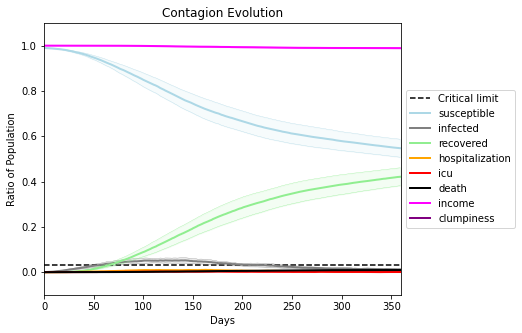

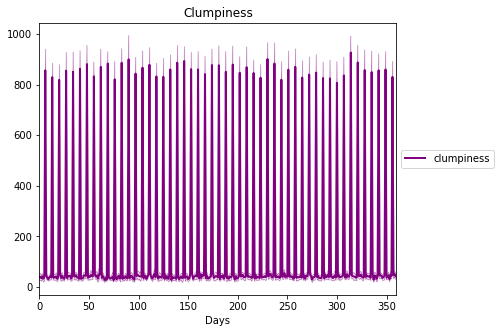

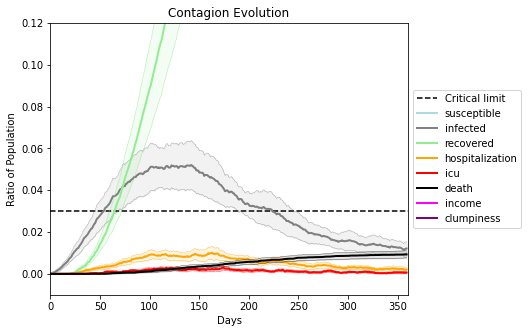

In [17]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.8
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[813, 8416, 7571, 4991, 117, 5566, 1335, 7464, 4587, 7079, 7928, 4695, 9258, 2870, 1842, 362, 8430, 2902, 8272, 1353]
Average similarity between family members is 0.3579473027797087 at temperature -0.7
Average similarity between family and home is 0.9998583222952936 at temperature -1
Average similarity between students and their classroom is 0.1753824196468712 at temperature -0.7
Average classroom occupancy is 1.6685393258426966 and number classrooms is 178
Average similarity between workers is 0.1879684765988695 at temperature -0.7
Average office occupancy is 3.207920792079208 and number offices is 202
Average friend similarity for adults: 0.42778136009206397 for kids: 0.30261854632430474
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity 0.0888483608847087
avg restaurant similarity 0.08977905538472003
avg restaurant similarity 0.10766804300466676
avg restaurant similarity 0.0517288874539438
avg restaurant similarity 0.0447775578492002
avg restaurant similarity 0.09545288637322588
avg restaurant similarity 0.06278669420871205
avg restaurant similarity 0.025573232824286345
avg restaurant similarity 0.11610327092308007
avg restaurant similarity 0.0015840998589717718
avg restaurant similarity 0.09234998508614561
avg restaurant similarity 0.07688251742428565
avg restaurant similarity 0.08874621069477803
avg restaurant similarity 0.048150055616559564
avg restaurant similarity 0.06392336519783208
avg restaurant similarity 0.08647697734093811
avg restaurant similarity 0.01650571305786802
avg restaurant similarity 0.10399627237236868
avg restaurant similarity 0.1049471094190587
avg restaurant similarity 0.08940330945739751
avg restaurant similarity 0.1306358916497934
avg restaurant similarity 0.0854989

avg restaurant similarity 0.12251786123856248
avg restaurant similarity 0.053121380113859334
avg restaurant similarity 0.06583368954132583
avg restaurant similarity 0.10146862416973096
avg restaurant similarity 0.11984008072998344
avg restaurant similarity 0.11172883144642971
avg restaurant similarity 0.01773392087868398
avg restaurant similarity 0.025866690150638104
avg restaurant similarity 0.060358253594256304
avg restaurant similarity 0.0957696495724173
avg restaurant similarity 0.1711072052695478
avg restaurant similarity 0.06970305012651895
avg restaurant similarity 0.06877134451181882
avg restaurant similarity 0.06912766150298655
avg restaurant similarity 0.06377125854099013
avg restaurant similarity 0.10124968426866536
avg restaurant similarity 0.1005143448081032
avg restaurant similarity 0.06395952321113808
avg restaurant similarity 0.06572715092545278
avg restaurant similarity 0.07901303707384873
avg restaurant similarity 0.05649567660361941
avg restaurant similarity 0.081441

avg restaurant similarity 0.06927108257695075
avg restaurant similarity 0.06160405521500173
avg restaurant similarity 0.07269174145027497
Average similarity between family members is 0.3470387163754116 at temperature -0.7
Average similarity between family and home is 0.9998548190699476 at temperature -1
Average similarity between students and their classroom is 0.15746618061019182 at temperature -0.7
Average classroom occupancy is 1.6787564766839378 and number classrooms is 193
Average similarity between workers is 0.20314669975132246 at temperature -0.7
Average office occupancy is 3.2124352331606216 and number offices is 193
Average friend similarity for adults: 0.41893652814827625 for kids: 0.31108512908014396
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.10773755234822277
avg restaurant similarity -0.04983845169082966
avg restaurant similarity 0.03198479466833531
avg restaurant similarity 0.09008912858166945
avg restaurant similarity 0.04890564251850683
avg restaurant similarity 0.05458753910494071
avg restaurant similarity 0.03706801593561383
avg restaurant similarity 0.05795220986976064
avg restaurant similarity 0.030218330134503445
avg restaurant similarity 0.08762954213639511
avg restaurant similarity 0.03412288391198482
avg restaurant similarity 0.0332483225373043
avg restaurant similarity -0.008236808507608181
avg restaurant similarity 0.021311870576015742
avg restaurant similarity 0.018864986580499055
avg restaurant similarity 0.04876198172975616
avg restaurant similarity 0.030880909993383686
avg restaurant similarity 0.024457216350197195
avg restaurant similarity 0.02629184907775435
avg restaurant similarity 0.044243387857012456
avg restaurant similarity 0.029884231911439307
avg restaurant similarity

avg restaurant similarity 0.051812016698606175
avg restaurant similarity 0.00496154934007158
avg restaurant similarity 0.06059544253744973
avg restaurant similarity 0.08607628626580796
avg restaurant similarity 0.0650940848934893
avg restaurant similarity 0.07799132344167867
avg restaurant similarity 0.09109574618876923
avg restaurant similarity 0.057869769701937884
avg restaurant similarity 0.052694069371552854
avg restaurant similarity 0.020131172211660237
avg restaurant similarity 0.057253117328291754
avg restaurant similarity 0.05991890648148569
avg restaurant similarity 0.005052335060049362
avg restaurant similarity 0.025165757683064987
avg restaurant similarity 0.03390791388170007
avg restaurant similarity 0.08387220449932399
avg restaurant similarity 0.07394341034713267
avg restaurant similarity 0.10811736400437899
avg restaurant similarity 0.07485036842007653
avg restaurant similarity 0.05715250229900267
avg restaurant similarity 0.12214310164225677
avg restaurant similarity 0.

avg restaurant similarity 0.0487389050296096
avg restaurant similarity 0.0491826571142033
avg restaurant similarity 0.032012671072602014
avg restaurant similarity 0.02701246994116609
Average similarity between family members is 0.3520746116469483 at temperature -0.7
Average similarity between family and home is 0.9998545304768013 at temperature -1
Average similarity between students and their classroom is 0.19763903095443142 at temperature -0.7
Average classroom occupancy is 1.574585635359116 and number classrooms is 181
Average similarity between workers is 0.17438035088078335 at temperature -0.7
Average office occupancy is 3.3118811881188117 and number offices is 202
Average friend similarity for adults: 0.42918479218913935 for kids: 0.2848303744508968
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.05785809952829249
avg restaurant similarity 0.0912462703896509
avg restaurant similarity 0.08218882547272624
avg restaurant similarity 0.08069866574480769
avg restaurant similarity 0.1344650832186515
avg restaurant similarity 0.14592254716448516
avg restaurant similarity 0.08930037749147172
avg restaurant similarity 0.0449312137107372
avg restaurant similarity 0.09873046968200716
avg restaurant similarity 0.11952577273399279
avg restaurant similarity 0.097143781230241
avg restaurant similarity 0.05555112679168923
avg restaurant similarity 0.018952748658614706
avg restaurant similarity 0.07797110658167507
avg restaurant similarity 0.13081013212563233
avg restaurant similarity 0.10427463023050096
avg restaurant similarity 0.08629573191214492
avg restaurant similarity 0.1258435204755277
avg restaurant similarity 0.04413042512330383
avg restaurant similarity 0.10980999136471772
avg restaurant similarity 0.1337139730750441
avg restaurant similarity 0.083533404948

avg restaurant similarity 0.09935388680223002
avg restaurant similarity 0.05219203654024104
avg restaurant similarity 0.11397572045491305
avg restaurant similarity 0.08749847128687954
avg restaurant similarity 0.07470831711030125
avg restaurant similarity 0.054765652965261785
avg restaurant similarity 0.09871088149152442
avg restaurant similarity 0.06088709083953291
avg restaurant similarity 0.1334467641768751
avg restaurant similarity 0.04435871238978177
avg restaurant similarity 0.09700214797968003
avg restaurant similarity 0.051958003030225026
avg restaurant similarity 0.08083787099125225
avg restaurant similarity 0.0890630161943452
avg restaurant similarity 0.06811673672292812
avg restaurant similarity 0.06105818142003256
avg restaurant similarity 0.06978369238198598
avg restaurant similarity 0.1325373511229613
avg restaurant similarity 0.08429484997231886
avg restaurant similarity 0.07645447237374295
avg restaurant similarity 0.07165913284472313
avg restaurant similarity 0.0638781

avg restaurant similarity 0.09590696721869318
avg restaurant similarity 0.08896422144095657
Average similarity between family members is 0.3595010534088 at temperature -0.7
Average similarity between family and home is 0.9998582428363729 at temperature -1
Average similarity between students and their classroom is 0.2004632711678068 at temperature -0.7
Average classroom occupancy is 1.625 and number classrooms is 192
Average similarity between workers is 0.16816027598957087 at temperature -0.7
Average office occupancy is 3.190954773869347 and number offices is 199
Average friend similarity for adults: 0.42592595851159515 for kids: 0.3261537256987084
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a to

avg restaurant similarity 0.06155064105401274
avg restaurant similarity 0.0722003973631723
avg restaurant similarity 0.08484711140821656
avg restaurant similarity 0.1424676109530383
avg restaurant similarity 0.0641763179529827
avg restaurant similarity 0.05697086644877964
avg restaurant similarity 0.07902766180848012
avg restaurant similarity 0.10823534069174436
avg restaurant similarity 0.049635620453406054
avg restaurant similarity 0.0940048909817043
avg restaurant similarity 0.06691735431492278
avg restaurant similarity 0.06266735618110471
avg restaurant similarity 0.10424388803630694
avg restaurant similarity 0.046634678878887476
avg restaurant similarity 0.12522106145981485
avg restaurant similarity 0.1135454977163023
avg restaurant similarity 0.12965794538523656
avg restaurant similarity 0.07559281351494766
avg restaurant similarity 0.05648465226994134
avg restaurant similarity 0.034629127249062745
avg restaurant similarity 0.07395590935356913
avg restaurant similarity 0.09866922

avg restaurant similarity 0.08159833211016357
avg restaurant similarity 0.05599323328455491
avg restaurant similarity 0.020894931561166747
avg restaurant similarity 0.11120501071093508
avg restaurant similarity 0.09294773668772409
avg restaurant similarity 0.08914298841721932
avg restaurant similarity 0.07430196354263455
avg restaurant similarity 0.07641393040256539
avg restaurant similarity 0.06564580589330692
avg restaurant similarity 0.07235428434314224
avg restaurant similarity 0.038925303867627464
avg restaurant similarity 0.03475700567472289
avg restaurant similarity 0.06463161733984671
avg restaurant similarity 0.05384760440886779
avg restaurant similarity 0.026833593069502792
avg restaurant similarity 0.04956113505516746
avg restaurant similarity 0.05541243121696774
avg restaurant similarity 0.055707721836967566
avg restaurant similarity 0.09326264964210292
avg restaurant similarity 0.003730855946270312
avg restaurant similarity 0.06292462084465733
avg restaurant similarity 0.0

avg restaurant similarity 0.08174476220951665
avg restaurant similarity 0.12995333677097515
avg restaurant similarity 0.002466375211176721
avg restaurant similarity 0.11688210643393875
Average similarity between family members is 0.3351364293459653 at temperature -0.7
Average similarity between family and home is 0.9998633156341654 at temperature -1
Average similarity between students and their classroom is 0.18432855591732897 at temperature -0.7
Average classroom occupancy is 1.6033519553072626 and number classrooms is 179
Average similarity between workers is 0.16806654275611757 at temperature -0.7
Average office occupancy is 3.27 and number offices is 200
Average friend similarity for adults: 0.4242213689314056 for kids: 0.2917484448642498
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.04973101213643334
avg restaurant similarity 0.12169649308898403
avg restaurant similarity 0.108036902305719
avg restaurant similarity 0.036913174553662664
avg restaurant similarity 0.07244066552915958
avg restaurant similarity 0.07586764294198431
avg restaurant similarity 0.04047305777629174
avg restaurant similarity 0.06400077324227191
avg restaurant similarity 0.08360902874669576
avg restaurant similarity 0.12634550529551586
avg restaurant similarity 0.09339377606347676
avg restaurant similarity 0.01900285351081653
avg restaurant similarity 0.1265273089182655
avg restaurant similarity 0.10183988230568758
avg restaurant similarity 0.12918240188313454
avg restaurant similarity 0.057842418992370616
avg restaurant similarity 0.05538754297403293
avg restaurant similarity 0.15850413552940668
avg restaurant similarity 0.06578527812657115
avg restaurant similarity 0.12352499511891593
avg restaurant similarity 0.03676743328633924
avg restaurant similarity 0.0774695

avg restaurant similarity 0.0734604402234832
avg restaurant similarity 0.05999982330812396
avg restaurant similarity 0.05964876037345074
avg restaurant similarity 0.11109515238155741
avg restaurant similarity 0.05403741764467082
avg restaurant similarity 0.09484373333188109
avg restaurant similarity 0.054674384608734236
avg restaurant similarity 0.10776357399487373
avg restaurant similarity 0.03937520243749106
avg restaurant similarity 0.07256687511902349
avg restaurant similarity 0.0793281604714208
avg restaurant similarity 0.07806329961987124
avg restaurant similarity 0.09322190591412406
avg restaurant similarity 0.110595919856458
avg restaurant similarity 0.0689423554128346
avg restaurant similarity 0.11102911737576115
avg restaurant similarity 0.041145423091410366
avg restaurant similarity 0.04136467521115539
avg restaurant similarity 0.08202231014391005
avg restaurant similarity 0.0792716332361861
avg restaurant similarity 0.0814824834314711
avg restaurant similarity 0.05394157279

avg restaurant similarity 0.06082786448542695
avg restaurant similarity 0.050590600821485227
Average similarity between family members is 0.37403474583523905 at temperature -0.7
Average similarity between family and home is 0.9998692620699121 at temperature -1
Average similarity between students and their classroom is 0.14075753304802624 at temperature -0.7
Average classroom occupancy is 1.6666666666666667 and number classrooms is 168
Average similarity between workers is 0.17405137231399945 at temperature -0.7
Average office occupancy is 3.303921568627451 and number offices is 204
Average friend similarity for adults: 0.4396077634097285 for kids: 0.30664457482945884
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 alloca

avg restaurant similarity 0.07385994405662852
avg restaurant similarity 0.040978899147676016
avg restaurant similarity 0.015583048955054283
avg restaurant similarity 0.08866421487795685
avg restaurant similarity 0.10372007379187767
avg restaurant similarity 0.05863481239955884
avg restaurant similarity 0.08540504557926441
avg restaurant similarity 0.09328002009185359
avg restaurant similarity 0.10018345705255648
avg restaurant similarity 0.06520670082594579
avg restaurant similarity 0.09895325805121102
avg restaurant similarity 0.05799886914860105
avg restaurant similarity 0.11618248990698817
avg restaurant similarity 0.11546026824698502
avg restaurant similarity 0.08639040811810997
avg restaurant similarity 0.1462694873635672
avg restaurant similarity 0.07439172769349138
avg restaurant similarity 0.1268272816894473
avg restaurant similarity 0.042773572210757074
avg restaurant similarity 0.01760121041563976
avg restaurant similarity 0.03136526657590091
avg restaurant similarity 0.10236

avg restaurant similarity 0.012083593329895123
avg restaurant similarity 0.05815103254999493
avg restaurant similarity 0.026133459147238417
avg restaurant similarity 0.07884128954638416
avg restaurant similarity 0.13482876923201506
avg restaurant similarity 0.061070374973057034
avg restaurant similarity 0.10554853566124539
avg restaurant similarity 0.07445944686857886
avg restaurant similarity 0.09314709610174143
avg restaurant similarity 0.1627908790790085
avg restaurant similarity 0.10815585667584167
avg restaurant similarity 0.1268151147784471
avg restaurant similarity 0.034662602830912916
avg restaurant similarity 0.06265421307551923
avg restaurant similarity 0.0694146290987019
avg restaurant similarity 0.09493793052621753
avg restaurant similarity 0.07854068774496277
avg restaurant similarity 0.08650793600223654
avg restaurant similarity 0.11384780380358037
avg restaurant similarity 0.10613613231352392
avg restaurant similarity 0.07759700764161685
avg restaurant similarity 0.17289

avg restaurant similarity 0.10366922887596115
avg restaurant similarity 0.018782037142492863
avg restaurant similarity 0.07646406518163185
Average similarity between family members is 0.34019701757888665 at temperature -0.7
Average similarity between family and home is 0.999855945384282 at temperature -1
Average similarity between students and their classroom is 0.16741287901034393 at temperature -0.7
Average classroom occupancy is 1.6701030927835052 and number classrooms is 194
Average similarity between workers is 0.1666944021491532 at temperature -0.7
Average office occupancy is 3.1256281407035176 and number offices is 199
Average friend similarity for adults: 0.42416329338296127 for kids: 0.3213526782112737
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.11453138157523728
avg restaurant similarity 0.055730670491151844
avg restaurant similarity 0.13636590187310368
avg restaurant similarity 0.07605915908879234
avg restaurant similarity 0.15073096244933326
avg restaurant similarity 0.07885654660356292
avg restaurant similarity 0.08199980105487098
avg restaurant similarity 0.10233466404555264
avg restaurant similarity 0.08510722617837324
avg restaurant similarity 0.12385950677368887
avg restaurant similarity 0.10648521425367671
avg restaurant similarity 0.06912621439437583
avg restaurant similarity 0.08293400840368428
avg restaurant similarity 0.10061075917187101
avg restaurant similarity 0.08678303943992931
avg restaurant similarity 0.11663355419393098
avg restaurant similarity 0.10729418481039132
avg restaurant similarity 0.17170027166212626
avg restaurant similarity 0.06259629982762704
avg restaurant similarity 0.04806669009153194
avg restaurant similarity 0.10686675836027662
avg restaurant similarity 0.13906

avg restaurant similarity 0.10204937445070235
avg restaurant similarity 0.09384622569100126
avg restaurant similarity 0.09881725503289188
avg restaurant similarity 0.054978070288256124
avg restaurant similarity 0.0815654643402817
avg restaurant similarity 0.08530057060614084
avg restaurant similarity 0.10725349853795986
avg restaurant similarity 0.09579834589810828
avg restaurant similarity 0.09044906057669001
avg restaurant similarity 0.10202332199387353
avg restaurant similarity 0.03031059788879607
avg restaurant similarity 0.08917429707083228
avg restaurant similarity 0.09789536294343186
avg restaurant similarity 0.07293321421134893
avg restaurant similarity 0.15107880241766244
avg restaurant similarity 0.15723569185980218
avg restaurant similarity 0.0919186824574629
avg restaurant similarity 0.07503621733762326
avg restaurant similarity 0.11950808382531553
avg restaurant similarity 0.1373456310594627
avg restaurant similarity 0.09795977140820154
avg restaurant similarity 0.10971627

avg restaurant similarity 0.13107528143443092
avg restaurant similarity 0.08552393290170486
Average similarity between family members is 0.3608899294931895 at temperature -0.7
Average similarity between family and home is 0.999861880733885 at temperature -1
Average similarity between students and their classroom is 0.17586420916821788 at temperature -0.7
Average classroom occupancy is 1.5941176470588236 and number classrooms is 170
Average similarity between workers is 0.19395019290104362 at temperature -0.7
Average office occupancy is 3.4948453608247423 and number offices is 194
Average friend similarity for adults: 0.43197104219778854 for kids: 0.28626393315353277
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocat

avg restaurant similarity 0.09723928379507615
avg restaurant similarity 0.10801831577117792
avg restaurant similarity 0.06420731013603309
avg restaurant similarity 0.06858530214664368
avg restaurant similarity 0.1060498349586428
avg restaurant similarity 0.04042479583141032
avg restaurant similarity 0.08965300030915908
avg restaurant similarity 0.029629142904468178
avg restaurant similarity 0.09031530842981832
avg restaurant similarity 0.07431798646930005
avg restaurant similarity 0.04843844830592068
avg restaurant similarity 0.08989381494278044
avg restaurant similarity 0.07133340775546447
avg restaurant similarity 0.03275044189492429
avg restaurant similarity 0.061770232139670374
avg restaurant similarity 0.03628395628541347
avg restaurant similarity 0.024334367061375584
avg restaurant similarity 0.061941300375497395
avg restaurant similarity 0.03352672000695055
avg restaurant similarity 0.02120933071604778
avg restaurant similarity 0.09716532303703751
avg restaurant similarity 0.106

avg restaurant similarity 0.054015125520480406
avg restaurant similarity 0.048537970665267965
avg restaurant similarity 0.05873682969057886
avg restaurant similarity 0.07020784570127268
avg restaurant similarity 0.03644461668293396
avg restaurant similarity 0.051347203376608336
avg restaurant similarity 0.05011825388014001
avg restaurant similarity 0.05626834839751502
avg restaurant similarity 0.032296854907642635
avg restaurant similarity 0.1000802712393074
avg restaurant similarity 0.05278504084920058
avg restaurant similarity 0.033785037981768545
avg restaurant similarity 0.1036935056171917
avg restaurant similarity 0.10592425725320305
avg restaurant similarity 0.00698757146482165
avg restaurant similarity 0.0862888612168905
avg restaurant similarity 0.06789725466282638
avg restaurant similarity 0.07822616804755259
avg restaurant similarity 0.05544751402924992
avg restaurant similarity 0.06616289622816982
avg restaurant similarity 0.1055047309545541
avg restaurant similarity 0.05644

avg restaurant similarity 0.00731858906950112
avg restaurant similarity 0.04003204764889837
avg restaurant similarity 0.06677343967668378
avg restaurant similarity 0.06900501162475409
Average similarity between family members is 0.3465161937406918 at temperature -0.7
Average similarity between family and home is 0.999860681449903 at temperature -1
Average similarity between students and their classroom is 0.18489080652209655 at temperature -0.7
Average classroom occupancy is 1.5754189944134078 and number classrooms is 179
Average similarity between workers is 0.16916997285033394 at temperature -0.7
Average office occupancy is 3.306532663316583 and number offices is 199
Average friend similarity for adults: 0.42078539842009943 for kids: 0.2961731444553818
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.14298788126984796
avg restaurant similarity 0.09461052842245196
avg restaurant similarity 0.06355126088569431
avg restaurant similarity 0.10732786033553578
avg restaurant similarity 0.052252870979259305
avg restaurant similarity 0.09327129963660509
avg restaurant similarity 0.08430553148936075
avg restaurant similarity 0.10257009300979532
avg restaurant similarity 0.11280309569729162
avg restaurant similarity 0.15430664650042317
avg restaurant similarity 0.16123176452985635
avg restaurant similarity 0.08475758668877334
avg restaurant similarity 0.08157078627534972
avg restaurant similarity 0.08140747721114437
avg restaurant similarity 0.05461607508486404
avg restaurant similarity 0.1105444777473448
avg restaurant similarity 0.16660028697391874
avg restaurant similarity 0.022005191103083924
avg restaurant similarity 0.10789987522057638
avg restaurant similarity 0.12559557324976794
avg restaurant similarity 0.10252207498220088
avg restaurant similarity 0.08492

avg restaurant similarity 0.09923011527212662
avg restaurant similarity 0.08924150200360893
avg restaurant similarity 0.12050644906083641
avg restaurant similarity 0.03797309011196814
avg restaurant similarity 0.08876347002655542
avg restaurant similarity 0.09211236794904526
avg restaurant similarity 0.15818041113817083
avg restaurant similarity 0.08809951806001896
avg restaurant similarity 0.07665594631377008
avg restaurant similarity 0.06409839668196772
avg restaurant similarity 0.07902027503058981
avg restaurant similarity 0.1170258230916436
avg restaurant similarity 0.04640129349079656
avg restaurant similarity 0.08642189748548042
avg restaurant similarity 0.11508560300472846
avg restaurant similarity 0.09221345701145722
avg restaurant similarity 0.11663249386510402
avg restaurant similarity 0.09791647348071376
avg restaurant similarity 0.047806143003353646
avg restaurant similarity 0.09831296090532038
avg restaurant similarity 0.10644587975783376
avg restaurant similarity 0.054366

avg restaurant similarity 0.10053117395364292
avg restaurant similarity 0.06458057449658192
Average similarity between family members is 0.3611857469244606 at temperature -0.7
Average similarity between family and home is 0.9998446401641534 at temperature -1
Average similarity between students and their classroom is 0.19408110060898828 at temperature -0.7
Average classroom occupancy is 1.608695652173913 and number classrooms is 184
Average similarity between workers is 0.16182781239954408 at temperature -0.7
Average office occupancy is 3.3010204081632653 and number offices is 196
Average friend similarity for adults: 0.4256928911323676 for kids: 0.297694486012007
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated 

avg restaurant similarity 0.07155063945451041
avg restaurant similarity 0.12003319197062727
avg restaurant similarity 0.10785598505825078
avg restaurant similarity 0.04957502321321938
avg restaurant similarity 0.079369013767245
avg restaurant similarity 0.08853695536573254
avg restaurant similarity 0.03371544971675127
avg restaurant similarity 0.10594150228157669
avg restaurant similarity 0.038556727287765706
avg restaurant similarity 0.09250983706835472
avg restaurant similarity 0.09067244820227713
avg restaurant similarity 0.055099791928067854
avg restaurant similarity 0.11080980811907029
avg restaurant similarity 0.07766301549287455
avg restaurant similarity 0.10818486610564343
avg restaurant similarity 0.09791329067668492
avg restaurant similarity 0.06606332766914684
avg restaurant similarity 0.07320051081865529
avg restaurant similarity 0.03245751472118481
avg restaurant similarity 0.09161677981123284
avg restaurant similarity 0.11566670039718757
avg restaurant similarity 0.072670

avg restaurant similarity 0.08251859001984715
avg restaurant similarity 0.05779918116580991
avg restaurant similarity 0.04769048950306434
avg restaurant similarity 0.10544357195524676
avg restaurant similarity 0.09098291118847554
avg restaurant similarity 0.06254944306544998
avg restaurant similarity 0.09692785531810844
avg restaurant similarity 0.04412738366880923
avg restaurant similarity 0.09288316121617468
avg restaurant similarity 0.06013548064834916
avg restaurant similarity 0.06975641361098235
avg restaurant similarity 0.048808032457286744
avg restaurant similarity 0.06763717089062452
avg restaurant similarity 0.05821010314188797
avg restaurant similarity 0.058838562211088706
avg restaurant similarity 0.07425461157887372
avg restaurant similarity 0.05817783892969352
avg restaurant similarity 0.056799645754341044
avg restaurant similarity 0.06563332053301195
avg restaurant similarity 0.0774838049195799
avg restaurant similarity 0.03869137016204821
avg restaurant similarity 0.0646

avg restaurant similarity 0.09077598612817298
avg restaurant similarity 0.10881540979802713
avg restaurant similarity 0.07437924198021081
avg restaurant similarity 0.08453380970835055
Average similarity between family members is 0.3337635564226015 at temperature -0.7
Average similarity between family and home is 0.9998492410584088 at temperature -1
Average similarity between students and their classroom is 0.161975619233912 at temperature -0.7
Average classroom occupancy is 1.5875706214689265 and number classrooms is 177
Average similarity between workers is 0.16473199705942904 at temperature -0.7
Average office occupancy is 3.405 and number offices is 200
Average friend similarity for adults: 0.42708070227123135 for kids: 0.2760404240980356
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.12849783519187022
avg restaurant similarity 0.1630585170327723
avg restaurant similarity 0.10594491297442354
avg restaurant similarity 0.10370707609761046
avg restaurant similarity 0.050178133058508274
avg restaurant similarity 0.02253819270582479
avg restaurant similarity 0.06805037330510955
avg restaurant similarity 0.10262181451122108
avg restaurant similarity 0.11197482379372105
avg restaurant similarity 0.0933437134842293
avg restaurant similarity 0.10134588414301578
avg restaurant similarity 0.05999726742401879
avg restaurant similarity 0.16073185764769188
avg restaurant similarity 0.05301750882097119
avg restaurant similarity 0.07678561651515677
avg restaurant similarity 0.10487674998944017
avg restaurant similarity 0.10069124152024518
avg restaurant similarity 0.1417663509603164
avg restaurant similarity 0.13376347451900156
avg restaurant similarity 0.11268532273887462
avg restaurant similarity 0.0515798455101859
avg restaurant similarity 0.108051250

avg restaurant similarity 0.11910072946781922
avg restaurant similarity 0.172447292452593
avg restaurant similarity 0.1441973936463057
avg restaurant similarity 0.09763610309927051
avg restaurant similarity 0.2013756292299728
avg restaurant similarity 0.0746641714838529
avg restaurant similarity 0.15735064750510144
avg restaurant similarity 0.04336081029763755
avg restaurant similarity 0.052853044285810606
avg restaurant similarity 0.04921919795975007
avg restaurant similarity 0.10303969612436589
avg restaurant similarity 0.10783420618468482
avg restaurant similarity 0.08073404476648335
avg restaurant similarity 0.07853828275257659
avg restaurant similarity 0.10517691812945952
avg restaurant similarity 0.13407457850742116
avg restaurant similarity 0.09890438925491855
avg restaurant similarity 0.0822672524495019
avg restaurant similarity 0.09834442350697896
avg restaurant similarity 0.0955828538241689
avg restaurant similarity 0.10964163735873195
avg restaurant similarity 0.095411156635

avg restaurant similarity 0.19902096834589325
avg restaurant similarity 0.1412709926112571
Average similarity between family members is 0.3711965855168106 at temperature -0.7
Average similarity between family and home is 0.9998572604781384 at temperature -1
Average similarity between students and their classroom is 0.191832845017845 at temperature -0.7
Average classroom occupancy is 1.5469613259668509 and number classrooms is 181
Average similarity between workers is 0.1712813242463042 at temperature -0.7
Average office occupancy is 3.28643216080402 and number offices is 199
Average friend similarity for adults: 0.4232299263012391 for kids: 0.3043954212149323
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated unit

avg restaurant similarity 0.007143678105004968
avg restaurant similarity 0.08897937153591398
avg restaurant similarity 0.01104192799866991
avg restaurant similarity 0.08074171208054058
avg restaurant similarity 0.06974656247737512
avg restaurant similarity 0.06440447178202574
avg restaurant similarity 0.08728670426320305
avg restaurant similarity 0.09162370540857288
avg restaurant similarity 0.07628898567548173
avg restaurant similarity 0.07102495614069193
avg restaurant similarity 0.11173701735235501
avg restaurant similarity 0.11648949108677514
avg restaurant similarity 0.09289033939396846
avg restaurant similarity 0.12069990636802036
avg restaurant similarity 0.07718149861188102
avg restaurant similarity 0.049310419839714396
avg restaurant similarity 0.03674903246289158
avg restaurant similarity 0.0342138788823121
avg restaurant similarity 0.0895658036185517
avg restaurant similarity 0.08277490865487039
avg restaurant similarity 0.054413180464041276
avg restaurant similarity 0.08577

avg restaurant similarity 0.10575750944747897
avg restaurant similarity 0.02527214586636536
avg restaurant similarity 0.02663553170446913
avg restaurant similarity -0.006329492353572498
avg restaurant similarity 0.04746334189903473
avg restaurant similarity 0.059056560404513916
avg restaurant similarity 0.06755724545872166
avg restaurant similarity 0.04793478696350738
avg restaurant similarity 0.056063541861229034
avg restaurant similarity 0.0432433459181482
avg restaurant similarity 0.02863495635473435
avg restaurant similarity 0.1081276313518128
avg restaurant similarity 0.12073248067253892
avg restaurant similarity 0.06831643412663434
avg restaurant similarity 0.06634029010713674
avg restaurant similarity 0.04269471284290604
avg restaurant similarity 0.061765978840142094
avg restaurant similarity 0.08000114956204214
avg restaurant similarity 0.1423291311535184
avg restaurant similarity 0.07528758788456637
avg restaurant similarity 0.036979890990274926
avg restaurant similarity 0.093

avg restaurant similarity 0.11086086541311968
avg restaurant similarity 0.040815116403274045
avg restaurant similarity 0.06233296223252078
avg restaurant similarity 0.11474392484099116
Average similarity between family members is 0.34098367197775825 at temperature -0.7
Average similarity between family and home is 0.9998508267569018 at temperature -1
Average similarity between students and their classroom is 0.17332374411886303 at temperature -0.7
Average classroom occupancy is 1.6263736263736264 and number classrooms is 182
Average similarity between workers is 0.17904903380468457 at temperature -0.7
Average office occupancy is 3.1310679611650487 and number offices is 206
Average friend similarity for adults: 0.4197345773021655 for kids: 0.30544571219770034
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.02162299091045709
avg restaurant similarity 0.0444318987767915
avg restaurant similarity 0.12020442071416577
avg restaurant similarity 0.021630178815922076
avg restaurant similarity 0.08017188952887427
avg restaurant similarity 0.13897760567685108
avg restaurant similarity 0.08021313941785214
avg restaurant similarity 0.11830900961203301
avg restaurant similarity 0.1254752554363756
avg restaurant similarity 0.08660386185710507
avg restaurant similarity 0.16565372010892518
avg restaurant similarity 0.1472272717259895
avg restaurant similarity 0.06984813183928996
avg restaurant similarity 0.10346216687258643
avg restaurant similarity 0.006329778894042978
avg restaurant similarity 0.06531055730414481
avg restaurant similarity 0.08107690982195274
avg restaurant similarity 0.09207246712387025
avg restaurant similarity 0.10568207917180748
avg restaurant similarity 0.07475566149349067
avg restaurant similarity 0.03301377774675879
avg restaurant similarity 0.0808005

avg restaurant similarity 0.11590656337775868
avg restaurant similarity 0.06883855087070101
avg restaurant similarity 0.0537433422544412
avg restaurant similarity 0.04762205283850143
avg restaurant similarity 0.11576941651394668
avg restaurant similarity 0.04358328477692864
avg restaurant similarity -0.0037566392905401015
avg restaurant similarity 0.08605501725636663
avg restaurant similarity 0.08511523433456422
avg restaurant similarity 0.08855394925921882
avg restaurant similarity 0.061042268785907905
avg restaurant similarity 0.10437825127911156
avg restaurant similarity 0.10892919006931912
avg restaurant similarity 0.05645873782311518
avg restaurant similarity 0.0518209484826046
avg restaurant similarity 0.04750571348050465
avg restaurant similarity 0.015242224648444096
avg restaurant similarity 0.11127931925452399
avg restaurant similarity 0.0744088332800012
avg restaurant similarity 0.09722011795967965
avg restaurant similarity 0.052788025422909154
avg restaurant similarity 0.011

avg restaurant similarity 0.1314393046866686
avg restaurant similarity 0.020733139760078807
avg restaurant similarity 0.07740709380843676
Average similarity between family members is 0.3345884827933992 at temperature -0.7
Average similarity between family and home is 0.99985749539416 at temperature -1
Average similarity between students and their classroom is 0.19399098581943341 at temperature -0.7
Average classroom occupancy is 1.53551912568306 and number classrooms is 183
Average similarity between workers is 0.1816971202715389 at temperature -0.7
Average office occupancy is 3.235576923076923 and number offices is 208
Average friend similarity for adults: 0.4264048758629823 for kids: 0.29196365304244687
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (eac

avg restaurant similarity 0.022132027395944366
avg restaurant similarity 0.058367859349248825
avg restaurant similarity 0.046751706784784915
avg restaurant similarity 0.06699450442877315
avg restaurant similarity 0.10277792732549511
avg restaurant similarity 0.048326061077027305
avg restaurant similarity 0.03166101399016953
avg restaurant similarity 0.05416855907263756
avg restaurant similarity 0.003918887089035422
avg restaurant similarity 0.06602862848969504
avg restaurant similarity 0.08712024719547601
avg restaurant similarity 0.08810521304275024
avg restaurant similarity 0.05518361066964865
avg restaurant similarity 0.04420429973883093
avg restaurant similarity 0.04426854110952967
avg restaurant similarity 0.06057116762555796
avg restaurant similarity 0.05759816528872929
avg restaurant similarity 0.03186504913574399
avg restaurant similarity 0.15558406957160503
avg restaurant similarity 0.03194985953715992
avg restaurant similarity 0.08856535742127986
avg restaurant similarity 0.0

avg restaurant similarity 0.10223646310157679
avg restaurant similarity 0.1282783966463325
avg restaurant similarity 0.05521835940708803
avg restaurant similarity 0.08428640151776151
avg restaurant similarity 0.05891354158352554
avg restaurant similarity 0.07721550601784773
avg restaurant similarity 0.09352961023507927
avg restaurant similarity 0.056407071439365394
avg restaurant similarity 0.041861432616003766
avg restaurant similarity 0.05857922753767777
avg restaurant similarity 0.05037952035869549
avg restaurant similarity 0.057202515538925074
avg restaurant similarity 0.04966311051829271
avg restaurant similarity 0.05609727356647071
avg restaurant similarity 0.10070505174345279
avg restaurant similarity 0.022185989253392706
avg restaurant similarity 0.06443373131341332
avg restaurant similarity 0.02763674489813655
avg restaurant similarity 0.0938903684907144
avg restaurant similarity 0.05188146025016239
avg restaurant similarity 0.08919820021558961
avg restaurant similarity 0.0417

avg restaurant similarity 0.07806906755908495
avg restaurant similarity 0.13543648300290825
avg restaurant similarity 0.040294309815810524
avg restaurant similarity 0.09351386461558486
Average similarity between family members is 0.3218734508728974 at temperature -0.7
Average similarity between family and home is 0.9998644729807435 at temperature -1
Average similarity between students and their classroom is 0.1358234848782987 at temperature -0.7
Average classroom occupancy is 1.6822916666666667 and number classrooms is 192
Average similarity between workers is 0.1828081640493424 at temperature -0.7
Average office occupancy is 3.0396039603960396 and number offices is 202
Average friend similarity for adults: 0.41245972807026554 for kids: 0.3128810342805754
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.0667434142965286
avg restaurant similarity 0.07972262909552312
avg restaurant similarity 0.11576480119640137
avg restaurant similarity 0.07727317585125085
avg restaurant similarity 0.07861267821919816
avg restaurant similarity 0.04952490532981601
avg restaurant similarity 0.10907827602805231
avg restaurant similarity 0.048126646459672816
avg restaurant similarity 0.03921012611472737
avg restaurant similarity 0.05631002797490897
avg restaurant similarity 0.09123500543079367
avg restaurant similarity 0.11756090765369656
avg restaurant similarity 0.03273329850174414
avg restaurant similarity 0.05457921331802872
avg restaurant similarity 0.1026086156405757
avg restaurant similarity 0.08552303013163359
avg restaurant similarity 0.05140979157917178
avg restaurant similarity 0.04089437884802843
avg restaurant similarity 0.054170333195680286
avg restaurant similarity 0.08820681571501525
avg restaurant similarity 0.037657529215022065
avg restaurant similarity 0.07486

avg restaurant similarity 0.06113758850528028
avg restaurant similarity 0.11644693673620184
avg restaurant similarity 0.132773269647677
avg restaurant similarity -0.005131970679168352
avg restaurant similarity 0.06069840742786529
avg restaurant similarity 0.0746610247787513
avg restaurant similarity 0.07751665981493719
avg restaurant similarity 0.09738917616873735
avg restaurant similarity 0.0947232973125331
avg restaurant similarity 0.0952450850510418
avg restaurant similarity 0.0844656375054779
avg restaurant similarity 0.12617461707401278
avg restaurant similarity 0.11056243026719902
avg restaurant similarity 0.07553880436722929
avg restaurant similarity 0.07448752131006244
avg restaurant similarity 0.011392086799882302
avg restaurant similarity 0.032174608586477395
avg restaurant similarity 0.08041218968382002
avg restaurant similarity 0.045268188024608955
avg restaurant similarity 0.042979592947562324
avg restaurant similarity 0.03071519294165423
avg restaurant similarity 0.097145

avg restaurant similarity 0.06564378973307644
avg restaurant similarity 0.08525721572422054
avg restaurant similarity 0.05628119428966479
Average similarity between family members is 0.33515751010885625 at temperature -0.7
Average similarity between family and home is 0.9998570233218491 at temperature -1
Average similarity between students and their classroom is 0.16450923503280218 at temperature -0.7
Average classroom occupancy is 1.7176470588235293 and number classrooms is 170
Average similarity between workers is 0.16741666898214602 at temperature -0.7
Average office occupancy is 3.28 and number offices is 200
Average friend similarity for adults: 0.4292266784086161 for kids: 0.29246688852925795
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with ca

avg restaurant similarity 0.060330450597963256
avg restaurant similarity 0.05709851597322846
avg restaurant similarity 0.11336277592431683
avg restaurant similarity 0.0728590785708098
avg restaurant similarity 0.08205343810573901
avg restaurant similarity 0.09302368120920805
avg restaurant similarity 0.08954817920612962
avg restaurant similarity 0.09274243857341272
avg restaurant similarity 0.07295728568612384
avg restaurant similarity 0.03041277859719697
avg restaurant similarity 0.044352698740679396
avg restaurant similarity 0.06275812117374661
avg restaurant similarity 0.08616339414644461
avg restaurant similarity 0.05347349830609331
avg restaurant similarity 0.06809048783537211
avg restaurant similarity 0.0832573142588923
avg restaurant similarity 0.020989684769861638
avg restaurant similarity 0.059615883232606845
avg restaurant similarity 0.05099426797470565
avg restaurant similarity 0.0713604273624087
avg restaurant similarity 0.0468922622994506
avg restaurant similarity 0.078489

avg restaurant similarity 0.05190873360467755
avg restaurant similarity 0.0955985283720323
avg restaurant similarity 0.12921004463668306
avg restaurant similarity 0.06520157597247558
avg restaurant similarity 0.05244591823722056
avg restaurant similarity 0.05057947059453852
avg restaurant similarity 0.057215651940732394
avg restaurant similarity 0.07810263329188519
avg restaurant similarity 0.09461975617155383
avg restaurant similarity 0.06148875738336517
avg restaurant similarity 0.08538125332357262
avg restaurant similarity 0.11731810387805312
avg restaurant similarity 0.04995242391465782
avg restaurant similarity 0.04186823187111429
avg restaurant similarity 0.07846103425994735
avg restaurant similarity 0.045399965883495076
avg restaurant similarity 0.043506529757096325
avg restaurant similarity 0.07205354205932306
avg restaurant similarity 0.07978712258451796
avg restaurant similarity 0.05430911474599298
avg restaurant similarity 0.10440747553399808
avg restaurant similarity 0.0195

avg restaurant similarity 0.05982413252194364
avg restaurant similarity 0.10391871854242861
avg restaurant similarity 0.035772611697635785
Average similarity between family members is 0.3378912622704206 at temperature -0.7
Average similarity between family and home is 0.9998588216633089 at temperature -1
Average similarity between students and their classroom is 0.12054990092570184 at temperature -0.7
Average classroom occupancy is 1.4725274725274726 and number classrooms is 182
Average similarity between workers is 0.16909045609293868 at temperature -0.7
Average office occupancy is 3.296116504854369 and number offices is 206
Average friend similarity for adults: 0.42357719033956076 for kids: 0.2736267346886079
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.07562407290467925
avg restaurant similarity 0.0568381396648781
avg restaurant similarity 0.10553806045123955
avg restaurant similarity 0.120703895583507
avg restaurant similarity 0.10345494561002666
avg restaurant similarity 0.1416882455249876
avg restaurant similarity 0.07579142921063425
avg restaurant similarity 0.11171508859362456
avg restaurant similarity 0.11770751611369629
avg restaurant similarity 0.034957360565013196
avg restaurant similarity 0.1229053604493397
avg restaurant similarity 0.12374146969038445
avg restaurant similarity 0.0997964818429262
avg restaurant similarity 0.1277892506353461
avg restaurant similarity 0.07566705162879755
avg restaurant similarity 0.1381344073286126
avg restaurant similarity 0.16334735493779762
avg restaurant similarity 0.07380862189020988
avg restaurant similarity 0.07278384318464555
avg restaurant similarity 0.09930468532685788
avg restaurant similarity 0.0674040912200209
avg restaurant similarity 0.06033404395733

avg restaurant similarity 0.04569962708886134
avg restaurant similarity 0.09658921616253477
avg restaurant similarity 0.08898022427679213
avg restaurant similarity 0.09108787969506962
avg restaurant similarity 0.10664483026565223
avg restaurant similarity 0.16882503434299642
avg restaurant similarity 0.05713502579086548
avg restaurant similarity 0.10213078175465563
avg restaurant similarity 0.017709408568953568
avg restaurant similarity 0.04611414257035762
avg restaurant similarity 0.06806057397098397
avg restaurant similarity 0.07913108998093903
avg restaurant similarity 0.06329582333723868
avg restaurant similarity 0.0621267253365846
avg restaurant similarity 0.06284170200387632
avg restaurant similarity 0.043977662138173855
avg restaurant similarity 0.0916399884483328
avg restaurant similarity 0.08665629256520771
avg restaurant similarity 0.12108351741701476
avg restaurant similarity 0.06884973237357589
avg restaurant similarity 0.011570050236736086
avg restaurant similarity 0.03240

avg restaurant similarity 0.13001879133939462
avg restaurant similarity 0.1592667632095015
Average similarity between family members is 0.3639299450724146 at temperature -0.7
Average similarity between family and home is 0.9998542774967528 at temperature -1
Average similarity between students and their classroom is 0.1969148676536411 at temperature -0.7
Average classroom occupancy is 1.5542168674698795 and number classrooms is 166
Average similarity between workers is 0.19793584606564918 at temperature -0.7
Average office occupancy is 3.4029850746268657 and number offices is 201
Average friend similarity for adults: 0.4366731760953672 for kids: 0.28221586887142147
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated u

avg restaurant similarity 0.08742698008586539
avg restaurant similarity 0.13355939688564644
avg restaurant similarity 0.1042968468097624
avg restaurant similarity 0.12527787847115712
avg restaurant similarity 0.07810650585604756
avg restaurant similarity 0.1038090943790557
avg restaurant similarity 0.14826799277312258
avg restaurant similarity 0.10937685582779251
avg restaurant similarity 0.1750014345312491
avg restaurant similarity 0.10929670156188613
avg restaurant similarity 0.12353039848014175
avg restaurant similarity 0.12285906685468335
avg restaurant similarity 0.07668697118726425
avg restaurant similarity 0.09270045881452746
avg restaurant similarity 0.12130818745591009
avg restaurant similarity 0.10894731716300662
avg restaurant similarity 0.1125944137728944
avg restaurant similarity 0.1109039654936633
avg restaurant similarity 0.10161053389493192
avg restaurant similarity 0.08962481080866291
avg restaurant similarity 0.11178340413543046
avg restaurant similarity 0.09068434884

avg restaurant similarity 0.1727735438863772
avg restaurant similarity 0.10073614787005927
avg restaurant similarity 0.14201989462384035
avg restaurant similarity 0.1222711852496874
avg restaurant similarity 0.07809149300605119
avg restaurant similarity 0.03733506681278593
avg restaurant similarity 0.11046147892054846
avg restaurant similarity 0.12826205724177567
avg restaurant similarity 0.061171479362653575
avg restaurant similarity 0.1111388810238113
avg restaurant similarity 0.09915094483074688
avg restaurant similarity 0.07745406857519863
avg restaurant similarity 0.1179738323109806
avg restaurant similarity 0.11961283742409193
avg restaurant similarity 0.14625499493229183
avg restaurant similarity 0.08110864109617133
avg restaurant similarity 0.11771865547659385
avg restaurant similarity 0.1196111674531178
avg restaurant similarity 0.1426784635874445
avg restaurant similarity 0.08526488637920264
avg restaurant similarity 0.10780896342893712
avg restaurant similarity 0.09828389724

avg restaurant similarity 0.13594305723299535
avg restaurant similarity 0.09618919515808141
Average similarity between family members is 0.36763636517309245 at temperature -0.7
Average similarity between family and home is 0.9998488254479553 at temperature -1
Average similarity between students and their classroom is 0.1911952527016338 at temperature -0.7
Average classroom occupancy is 1.6742857142857144 and number classrooms is 175
Average similarity between workers is 0.16734991136986146 at temperature -0.7
Average office occupancy is 3.295 and number offices is 200
Average friend similarity for adults: 0.42502539117557375 for kids: 0.3000754157886109
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a

avg restaurant similarity 0.052735564291662256
avg restaurant similarity 0.06472271237810116
avg restaurant similarity 0.07527466627526232
avg restaurant similarity 0.05344671389393261
avg restaurant similarity 0.07604410532847977
avg restaurant similarity 0.14486875450077255
avg restaurant similarity 0.08265033055969963
avg restaurant similarity 0.04189376086255189
avg restaurant similarity 0.027097734242169394
avg restaurant similarity 0.11989486101216655
avg restaurant similarity 0.025360530940432773
avg restaurant similarity 0.04900505333535639
avg restaurant similarity 0.08676396930043001
avg restaurant similarity 0.046026825025000835
avg restaurant similarity 0.07691233806344724
avg restaurant similarity 0.0467118348330585
avg restaurant similarity 0.05853647977856826
avg restaurant similarity 0.042975879629495686
avg restaurant similarity 0.08942692220775265
avg restaurant similarity 0.10917895190110397
avg restaurant similarity 0.10908262499702283
avg restaurant similarity 0.08

avg restaurant similarity 0.13726149259345874
avg restaurant similarity 0.10066473040829685
avg restaurant similarity 0.07763108806945815
avg restaurant similarity 0.11277058096409412
avg restaurant similarity 0.09079886445890033
avg restaurant similarity 0.1267328046267103
avg restaurant similarity 0.13387338009130584
avg restaurant similarity 0.07211070813825274
avg restaurant similarity 0.08531768217374475
avg restaurant similarity 0.09599198219757364
avg restaurant similarity 0.06468031200006522
avg restaurant similarity 0.15324794058791738
avg restaurant similarity 0.034458351080233186
avg restaurant similarity 0.05571613510095378
avg restaurant similarity 0.04909913362121292
avg restaurant similarity 0.012082705414347491
avg restaurant similarity 0.03777331737832468
avg restaurant similarity 0.09960746430254191
avg restaurant similarity 0.07662525595674509
avg restaurant similarity 0.013162601439469731
avg restaurant similarity 0.05511313299287477
avg restaurant similarity 0.0061

avg restaurant similarity 0.06931151345259569
avg restaurant similarity 0.061031934425944935
avg restaurant similarity 0.007197502381083396
avg restaurant similarity 0.11277022907449265
Average similarity between family members is 0.3609398075624459 at temperature -0.7
Average similarity between family and home is 0.9998536147664341 at temperature -1
Average similarity between students and their classroom is 0.19339716930499368 at temperature -0.7
Average classroom occupancy is 1.5411764705882354 and number classrooms is 170
Average similarity between workers is 0.1972840945926389 at temperature -0.7
Average office occupancy is 3.3284313725490198 and number offices is 204
Average friend similarity for adults: 0.4376967649276916 for kids: 0.2726675886645035
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.12344744778021975
avg restaurant similarity 0.07033776552041984
avg restaurant similarity 0.07742498358783106
avg restaurant similarity 0.07701297115828132
avg restaurant similarity 0.10995047221564208
avg restaurant similarity 0.07634417845949526
avg restaurant similarity 0.05489093878164708
avg restaurant similarity 0.10974815952026007
avg restaurant similarity 0.04947557552297285
avg restaurant similarity 0.07793564560518144
avg restaurant similarity 0.06160557162509704
avg restaurant similarity 0.06713173266485592
avg restaurant similarity 0.05529186412260067
avg restaurant similarity 0.06570037575147586
avg restaurant similarity 0.056453946387964006
avg restaurant similarity 0.07204953281024994
avg restaurant similarity 0.05301630942839002
avg restaurant similarity 0.08027633334537727
avg restaurant similarity 0.11067672224989251
avg restaurant similarity 0.06357727467805667
avg restaurant similarity 0.07253654398217345
avg restaurant similarity 0.04657

avg restaurant similarity 0.10770546789559386
avg restaurant similarity 0.024386673687681357
avg restaurant similarity 0.08567190588142182
avg restaurant similarity 0.05201435689860758
avg restaurant similarity 0.1021445193388236
avg restaurant similarity 0.07512509696217903
avg restaurant similarity 0.08534706794245685
avg restaurant similarity 0.042271743454360675
avg restaurant similarity 0.06790019911089147
avg restaurant similarity 0.05745279421701412
avg restaurant similarity 0.0899616941298209
avg restaurant similarity 0.09930013856738507
avg restaurant similarity 0.08327076933225527
avg restaurant similarity 0.012797408772813514
avg restaurant similarity 0.024510416530974726
avg restaurant similarity 0.09531279618942658
avg restaurant similarity 0.06345623980414716
avg restaurant similarity 0.04849248415106341
avg restaurant similarity 0.05743454386757682
avg restaurant similarity 0.11599414163340918
avg restaurant similarity 0.07992574760056867
avg restaurant similarity 0.0552

avg restaurant similarity 0.041341471116992067
avg restaurant similarity 0.053070074467888154
avg restaurant similarity 0.09724512222933868
avg restaurant similarity 0.10108875527790415
using average of time series:
stats on susceptible:
data: [0.6686238633843424, 0.6652210036556997, 0.8158138888888888, 0.8589105339105338, 0.6768083333333333, 0.6310055555555556, 0.8073277777777779, 0.7578194444444445, 0.8015166666666667, 0.8014485514485513, 0.7855555555555555, 0.8290166666666667, 0.756813888888889, 0.7931954137587237, 0.7699166666666666, 0.7551500000000001, 0.8033611111111111, 0.6543694444444444, 0.706010656010656, 0.7451861111111112]
min:
0.6310055555555556
max:
0.8589105339105338
std:
0.06388147970077342
mean:
0.754153556663981
median:
0.7638680555555555
95% confidence interval for the mean:
(0.7234794173052225,0.7848276960227395)
using average of time series:
stats on infected:
data: [0.03763583943224662, 0.031145452531295, 0.021480555555555555, 0.0165029415029415, 0.036027777777777

(<function dict.items>, <function dict.items>, <function dict.items>)

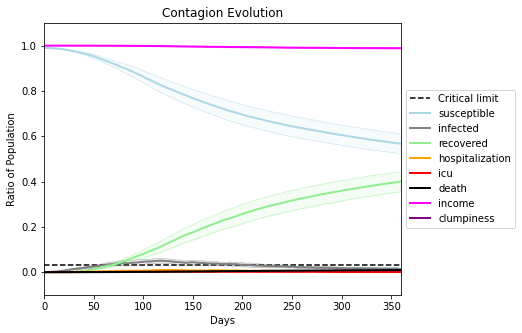

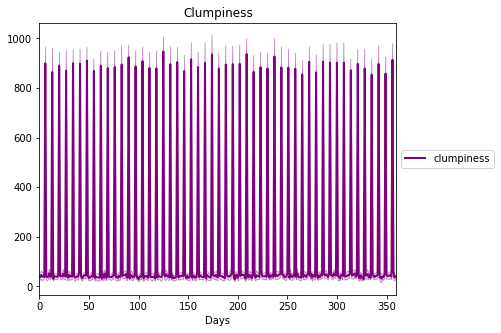

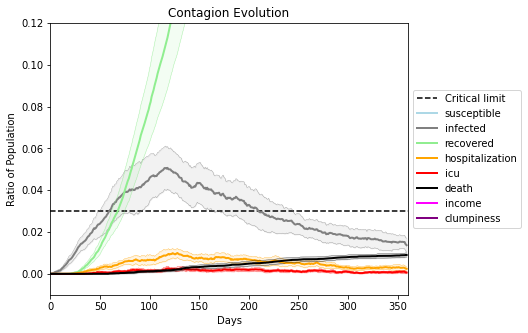

In [18]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.7
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[9846, 8669, 4765, 5845, 7171, 2312, 6827, 8288, 6797, 6386, 3144, 2377, 6219, 6397, 4407, 5506, 1703, 8208, 4689, 543]
Average similarity between family members is 0.2874591100570019 at temperature -0.6
Average similarity between family and home is 0.9998550690308727 at temperature -1
Average similarity between students and their classroom is 0.1813309834513686 at temperature -0.6
Average classroom occupancy is 1.5185185185185186 and number classrooms is 189
Average similarity between workers is 0.13663571881555997 at temperature -0.6
Average office occupancy is 3.2167487684729066 and number offices is 203
Average friend similarity for adults: 0.36372983817316884 for kids: 0.23283485758853556
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.04844155900464503
avg restaurant similarity 0.026305967803696366
avg restaurant similarity 0.07537288972234715
avg restaurant similarity 0.056178214569503254
avg restaurant similarity 0.09463662973727731
avg restaurant similarity 0.09667640420115549
avg restaurant similarity 0.0875721938719089
avg restaurant similarity 0.06088599266029385
avg restaurant similarity 0.11532721116873382
avg restaurant similarity 0.05566370480098389
avg restaurant similarity 0.02507365099857961
avg restaurant similarity 0.09532746372375782
avg restaurant similarity 0.017801317523659543
avg restaurant similarity 0.06942708446264592
avg restaurant similarity 0.08418241395341022
avg restaurant similarity 0.08697697718739628
avg restaurant similarity 0.060349640738025054
avg restaurant similarity 0.06382690608871278
avg restaurant similarity 0.10272644316163596
avg restaurant similarity 0.07347788808758646
avg restaurant similarity 0.0328290378440429
avg restaurant similarity 0.0791

avg restaurant similarity 0.06606152598484173
avg restaurant similarity 0.007188325571200508
avg restaurant similarity 0.1156351674591876
avg restaurant similarity 0.024321774939639898
avg restaurant similarity 0.07960331792858057
avg restaurant similarity 0.003620310140257034
avg restaurant similarity 0.06475976411147916
avg restaurant similarity 0.05182606702308704
avg restaurant similarity 0.08201814358917812
avg restaurant similarity 0.012216360429611014
avg restaurant similarity 0.08152621568815624
avg restaurant similarity 0.03201909705357289
avg restaurant similarity 0.06724991761387732
avg restaurant similarity 0.07485731337021008
avg restaurant similarity 0.04971512840241622
avg restaurant similarity 0.10326043973796452
avg restaurant similarity 0.06193099408505166
avg restaurant similarity 0.06770152313255534
avg restaurant similarity 0.07470120318286774
avg restaurant similarity 0.06309952555471157
avg restaurant similarity 0.038956614311708056
avg restaurant similarity 0.12

avg restaurant similarity 0.04226815463094517
avg restaurant similarity 0.05442788723693186
avg restaurant similarity 0.04838772591527966
avg restaurant similarity 0.11003065094543073
Average similarity between family members is 0.29348943230062957 at temperature -0.6
Average similarity between family and home is 0.9998533169647286 at temperature -1
Average similarity between students and their classroom is 0.1289286212093516 at temperature -0.6
Average classroom occupancy is 1.5906735751295338 and number classrooms is 193
Average similarity between workers is 0.14835932390337334 at temperature -0.6
Average office occupancy is 3.1592039800995027 and number offices is 201
Average friend similarity for adults: 0.3633534306620592 for kids: 0.22652050996180959
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.09910508152072624
avg restaurant similarity 0.09186051169122082
avg restaurant similarity 0.02666165086115812
avg restaurant similarity 0.1014969074787165
avg restaurant similarity 0.06807868990787044
avg restaurant similarity 0.0724968027668236
avg restaurant similarity 0.07841876456885544
avg restaurant similarity 0.10094264768612692
avg restaurant similarity 0.10285676517110828
avg restaurant similarity 0.11252273803124377
avg restaurant similarity 0.06856498172600188
avg restaurant similarity 0.10317196356930233
avg restaurant similarity 0.0902912923242972
avg restaurant similarity 0.10811740638099429
avg restaurant similarity 0.08601658847437967
avg restaurant similarity 0.11243300400173963
avg restaurant similarity 0.1256883228039054
avg restaurant similarity 0.09361021845467288
avg restaurant similarity 0.10495918713934668
avg restaurant similarity 0.0879959619094372
avg restaurant similarity 0.10192464644200828
avg restaurant similarity 0.08823862314

avg restaurant similarity 0.04383689246613278
avg restaurant similarity 0.04716616765965424
avg restaurant similarity 0.030501204983769896
avg restaurant similarity 0.0911934675055199
avg restaurant similarity 0.06833437951022894
avg restaurant similarity 0.061751318212200985
avg restaurant similarity 0.07009667354160923
avg restaurant similarity 0.06694813107260483
avg restaurant similarity 0.08321769632835677
avg restaurant similarity 0.13652731841505664
avg restaurant similarity 0.07525871837023423
avg restaurant similarity 0.10596372509565766
avg restaurant similarity 0.12587590597950715
avg restaurant similarity 0.1054997730494076
avg restaurant similarity 0.07163233274238735
avg restaurant similarity 0.056042080032590265
avg restaurant similarity 0.05917747939042059
avg restaurant similarity 0.03150004783034424
avg restaurant similarity 0.08588231003138427
avg restaurant similarity 0.08368793663532338
avg restaurant similarity 0.07197472480435782
avg restaurant similarity 0.11675

avg restaurant similarity 0.11429183555878761
avg restaurant similarity 0.117233699802002
Average similarity between family members is 0.28660712932979904 at temperature -0.6
Average similarity between family and home is 0.9998610961105543 at temperature -1
Average similarity between students and their classroom is 0.14713504862136492 at temperature -0.6
Average classroom occupancy is 1.641304347826087 and number classrooms is 184
Average similarity between workers is 0.15276293584134018 at temperature -0.6
Average office occupancy is 3.2311557788944723 and number offices is 199
Average friend similarity for adults: 0.3589956724160504 for kids: 0.22240092877620826
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated u

avg restaurant similarity 0.07876516073650049
avg restaurant similarity 0.07922403144391109
avg restaurant similarity 0.1204623293153046
avg restaurant similarity 0.10926503105056523
avg restaurant similarity 0.07678024051749617
avg restaurant similarity 0.09505569095267631
avg restaurant similarity 0.08346568852106373
avg restaurant similarity 0.09718028204062981
avg restaurant similarity 0.13599747612127813
avg restaurant similarity 0.11039128939936194
avg restaurant similarity 0.02682073702301126
avg restaurant similarity 0.06295888659200777
avg restaurant similarity 0.048788065588744954
avg restaurant similarity 0.10945682406756388
avg restaurant similarity 0.05369232885977949
avg restaurant similarity 0.047797002580978104
avg restaurant similarity 0.09962241159282628
avg restaurant similarity 0.051924526548466694
avg restaurant similarity 0.07617955846273117
avg restaurant similarity 0.03859462018488251
avg restaurant similarity 0.10936204860850214
avg restaurant similarity 0.0419

avg restaurant similarity 0.13088245998828926
avg restaurant similarity 0.10082967653309621
avg restaurant similarity 0.049861011170235926
avg restaurant similarity 0.066364567156955
avg restaurant similarity 0.046246275120097165
avg restaurant similarity 0.04837459092674601
avg restaurant similarity 0.02731910361471752
avg restaurant similarity 0.1319056166879688
avg restaurant similarity 0.05185205287944851
avg restaurant similarity 0.07932610773715898
avg restaurant similarity 0.01819587654374857
avg restaurant similarity 0.12986528657059232
avg restaurant similarity 0.08461708281952206
avg restaurant similarity 0.07236567095598566
avg restaurant similarity 0.07776935379662844
avg restaurant similarity 0.09349507021111743
avg restaurant similarity 0.08660673351098402
avg restaurant similarity 0.07245936924296031
avg restaurant similarity 0.08511213963138937
avg restaurant similarity 0.11328691075743458
avg restaurant similarity 0.10591709371576953
avg restaurant similarity 0.0697757

avg restaurant similarity 0.09357580504131925
avg restaurant similarity 0.039912175806167564
Average similarity between family members is 0.28338815126040867 at temperature -0.6
Average similarity between family and home is 0.9998560853039801 at temperature -1
Average similarity between students and their classroom is 0.1643854919817371 at temperature -0.6
Average classroom occupancy is 1.611764705882353 and number classrooms is 170
Average similarity between workers is 0.1668977821904919 at temperature -0.6
Average office occupancy is 3.2857142857142856 and number offices is 203
Average friend similarity for adults: 0.3741582247047146 for kids: 0.21920592953824866
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocate

avg restaurant similarity 0.08868963776497728
avg restaurant similarity 0.04637870976110547
avg restaurant similarity 0.0763333055643867
avg restaurant similarity 0.0315563756681466
avg restaurant similarity 0.07778525420570744
avg restaurant similarity 0.04762377473946483
avg restaurant similarity 0.08158972530917064
avg restaurant similarity 0.0309233770514258
avg restaurant similarity 0.05839586464096557
avg restaurant similarity 0.03472204827204332
avg restaurant similarity 0.06502016186266626
avg restaurant similarity 0.047412529575099616
avg restaurant similarity 0.061222794901191084
avg restaurant similarity 0.07699470325649653
avg restaurant similarity 0.12216371089623104
avg restaurant similarity 0.03609275641734231
avg restaurant similarity 0.07197380001634894
avg restaurant similarity 0.03713709742664958
avg restaurant similarity -0.0011190677663927766
avg restaurant similarity 0.06688179593877959
avg restaurant similarity 0.11314216474352658
avg restaurant similarity 0.0367

avg restaurant similarity 0.06013180936086335
avg restaurant similarity 0.050117993936207986
avg restaurant similarity 0.04182139045102848
avg restaurant similarity 0.12320203308067079
avg restaurant similarity 0.04585631775847905
avg restaurant similarity 0.0537849193409785
avg restaurant similarity 0.11917710323829443
avg restaurant similarity 0.09527946323490707
avg restaurant similarity 0.07158495881457749
avg restaurant similarity 0.03679533257393472
avg restaurant similarity -0.0060187557130448035
avg restaurant similarity 0.0557489011889338
avg restaurant similarity 0.0009080087307953393
avg restaurant similarity 0.022198038799446308
avg restaurant similarity 0.08202978586787911
avg restaurant similarity 0.07270829542406239
avg restaurant similarity 0.04391343212653299
avg restaurant similarity 0.06295725974858549
avg restaurant similarity 0.057269475212919106
avg restaurant similarity 0.06168968176799568
avg restaurant similarity 0.06608290363920781
avg restaurant similarity 0.

avg restaurant similarity 0.08369342611063631
avg restaurant similarity 0.08149853699810232
avg restaurant similarity 0.027594795458903868
avg restaurant similarity 0.01703626356116682
Average similarity between family members is 0.2964676638988884 at temperature -0.6
Average similarity between family and home is 0.9998557141424813 at temperature -1
Average similarity between students and their classroom is 0.18222645461071293 at temperature -0.6
Average classroom occupancy is 1.5678391959798994 and number classrooms is 199
Average similarity between workers is 0.14191684126611173 at temperature -0.6
Average office occupancy is 3.1457286432160805 and number offices is 199
Average friend similarity for adults: 0.36514706324256246 for kids: 0.2220660911523717
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.0853544333352737
avg restaurant similarity 0.1050654772442163
avg restaurant similarity 0.03966907268443281
avg restaurant similarity 0.08312612532831612
avg restaurant similarity 0.0511250294261391
avg restaurant similarity 0.03605055001360454
avg restaurant similarity 0.07853137812137242
avg restaurant similarity 0.07826397354867176
avg restaurant similarity 0.09277958552401605
avg restaurant similarity 0.11382484043844969
avg restaurant similarity 0.07535111704059075
avg restaurant similarity 0.10510263548046243
avg restaurant similarity 0.07039423018354597
avg restaurant similarity 0.044718008833388515
avg restaurant similarity 0.05305880859183824
avg restaurant similarity 0.026596188577446948
avg restaurant similarity 0.06702866220158375
avg restaurant similarity 0.04839075071515497
avg restaurant similarity 0.11110997878589604
avg restaurant similarity 0.04458294437430442
avg restaurant similarity 0.024148861467200845
avg restaurant similarity 0.106646

avg restaurant similarity 0.03579705869327215
avg restaurant similarity 0.0657221791925457
avg restaurant similarity 0.07987216324942166
avg restaurant similarity 0.0358378778979255
avg restaurant similarity 0.06737627862963202
avg restaurant similarity 0.11467522659910301
avg restaurant similarity 0.06510394014171754
avg restaurant similarity 0.0669564949877718
avg restaurant similarity 0.10051579792470523
avg restaurant similarity 0.06493430530834647
avg restaurant similarity 0.07045038619986763
avg restaurant similarity 0.08573004744464331
avg restaurant similarity 0.07477296313440585
avg restaurant similarity 0.08338796422378507
avg restaurant similarity 0.10635461730187483
avg restaurant similarity 0.06815099566449488
avg restaurant similarity 0.07180548248199896
avg restaurant similarity 0.05291850366762459
avg restaurant similarity 0.03627758123012041
avg restaurant similarity 0.07121805834557146
avg restaurant similarity 0.09054120884475501
avg restaurant similarity 0.079280711

avg restaurant similarity 0.05033684865246604
avg restaurant similarity 0.08991163976910237
Average similarity between family members is 0.29520293708409356 at temperature -0.6
Average similarity between family and home is 0.9998630076936537 at temperature -1
Average similarity between students and their classroom is 0.13096613139941687 at temperature -0.6
Average classroom occupancy is 1.486910994764398 and number classrooms is 191
Average similarity between workers is 0.15849073574724956 at temperature -0.6
Average office occupancy is 3.393939393939394 and number offices is 198
Average friend similarity for adults: 0.3776286209656826 for kids: 0.2092159517114221
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.07243914637193964
avg restaurant similarity 0.09096370375166825
avg restaurant similarity 0.09737047133095413
avg restaurant similarity 0.1024266994250906
avg restaurant similarity 0.06186848688224409
avg restaurant similarity 0.07745005651028727
avg restaurant similarity 0.03531027988338333
avg restaurant similarity 0.14467815732111042
avg restaurant similarity 0.07646151904158775
avg restaurant similarity 0.06771911135173184
avg restaurant similarity 0.05175479034582176
avg restaurant similarity 0.10759276497604572
avg restaurant similarity 0.1218589194934656
avg restaurant similarity 0.08022006118580517
avg restaurant similarity 0.09156201442230272
avg restaurant similarity 0.06151244325860657
avg restaurant similarity 0.10765178851231728
avg restaurant similarity 0.10245718348888459
avg restaurant similarity 0.0764965473468608
avg restaurant similarity 0.05764970893327106
avg restaurant similarity 0.06965072445535128
avg restaurant similarity 0.068851571

avg restaurant similarity 0.07602276930668461
avg restaurant similarity 0.08849521234637835
avg restaurant similarity 0.13441988369076838
avg restaurant similarity 0.12494126962423643
avg restaurant similarity 0.08149428340186245
avg restaurant similarity 0.034729738605991156
avg restaurant similarity 0.09954638288180587
avg restaurant similarity 0.0634854861153614
avg restaurant similarity 0.06105005623127868
avg restaurant similarity 0.08350282325396038
avg restaurant similarity 0.10689268783832521
avg restaurant similarity 0.05698536111266646
avg restaurant similarity 0.03743132727900015
avg restaurant similarity 0.1022051335178748
avg restaurant similarity 0.09347311457096917
avg restaurant similarity 0.11805815293146237
avg restaurant similarity 0.03786963647996199
avg restaurant similarity 0.11045617696807614
avg restaurant similarity 0.09881094267949167
avg restaurant similarity 0.05573399478267837
avg restaurant similarity 0.08460193898937102
avg restaurant similarity 0.0672609

avg restaurant similarity 0.1377681325540602
avg restaurant similarity 0.07603472945346262
Average similarity between family members is 0.2944613204122648 at temperature -0.6
Average similarity between family and home is 0.9998551924698238 at temperature -1
Average similarity between students and their classroom is 0.18378099419756538 at temperature -0.6
Average classroom occupancy is 1.7045454545454546 and number classrooms is 176
Average similarity between workers is 0.17322351020410456 at temperature -0.6
Average office occupancy is 3.1853658536585368 and number offices is 205
Average friend similarity for adults: 0.3762732923465356 for kids: 0.2271348076298648
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.11711250317905976
avg restaurant similarity 0.04584205956972034
avg restaurant similarity 0.06563292053602589
avg restaurant similarity 0.05139756316183786
avg restaurant similarity 0.09061867731585398
avg restaurant similarity 0.08006224157535503
avg restaurant similarity 0.05369312608356485
avg restaurant similarity 0.02797662756908123
avg restaurant similarity 0.05718913317104293
avg restaurant similarity 0.10731216370555066
avg restaurant similarity 0.08160020712581366
avg restaurant similarity 0.09207045949432427
avg restaurant similarity 0.09753914352573614
avg restaurant similarity 0.046995233826050684
avg restaurant similarity 0.059455151134115855
avg restaurant similarity 0.09855908781894492
avg restaurant similarity 0.04802758295993038
avg restaurant similarity 0.07750131949519914
avg restaurant similarity 0.12408625245933866
avg restaurant similarity 0.08481581189839371
avg restaurant similarity 0.10281290629573661
avg restaurant similarity 0.0613

avg restaurant similarity 0.04877622909989213
avg restaurant similarity 0.09837161936460757
avg restaurant similarity 0.09947577360501622
avg restaurant similarity 0.12631152685770206
avg restaurant similarity 0.00307547109663733
avg restaurant similarity 0.07022912018603776
avg restaurant similarity 0.06323774730509678
avg restaurant similarity 0.026109661884099994
avg restaurant similarity 0.14868113698929278
avg restaurant similarity 0.09460851192568907
avg restaurant similarity 0.09123599921331542
avg restaurant similarity 0.03929270114290483
avg restaurant similarity 0.03977188492277119
avg restaurant similarity 0.08871665220849546
avg restaurant similarity 0.044795680601672105
avg restaurant similarity 0.10006274906403315
avg restaurant similarity 0.05056331147421251
avg restaurant similarity 0.08867877810328491
avg restaurant similarity 0.07002959588582969
avg restaurant similarity 0.042469595567530403
avg restaurant similarity 0.09232466742983295
avg restaurant similarity 0.090

avg restaurant similarity 0.07265558267576386
avg restaurant similarity 0.11359918407764552
Average similarity between family members is 0.28942895839939353 at temperature -0.6
Average similarity between family and home is 0.9998595674842351 at temperature -1
Average similarity between students and their classroom is 0.20178041127603935 at temperature -0.6
Average classroom occupancy is 1.5755813953488371 and number classrooms is 172
Average similarity between workers is 0.1449054817980459 at temperature -0.6
Average office occupancy is 3.482051282051282 and number offices is 195
Average friend similarity for adults: 0.3840083200333848 for kids: 0.21817829725495527
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.02036907699613448
avg restaurant similarity 0.10260638357408636
avg restaurant similarity 0.07999696642630563
avg restaurant similarity -0.02403408604768026
avg restaurant similarity 0.059661562903421186
avg restaurant similarity 0.06636025268695299
avg restaurant similarity 0.08158729798708614
avg restaurant similarity 0.10238594028292863
avg restaurant similarity 0.03292478395825041
avg restaurant similarity 0.10672839649455654
avg restaurant similarity 0.1169000798424116
avg restaurant similarity 0.040476103230960646
avg restaurant similarity 0.15715862910130035
avg restaurant similarity 0.08289814134976144
avg restaurant similarity 0.04325137472273651
avg restaurant similarity 0.11173146348641945
avg restaurant similarity 0.07359468809384308
avg restaurant similarity 0.06731005247089049
avg restaurant similarity 0.08156391034702953
avg restaurant similarity 0.04672693109074646
avg restaurant similarity 0.05548017667155319
avg restaurant similarity 0.0864

avg restaurant similarity 0.07642394163750485
avg restaurant similarity 0.0431827031901957
avg restaurant similarity 0.08917537753547615
avg restaurant similarity 0.0803318827919032
avg restaurant similarity 0.07259222933575245
avg restaurant similarity 0.0843933038579013
avg restaurant similarity 0.06673116796168757
avg restaurant similarity 0.13799494008186897
avg restaurant similarity 0.09135633504445075
avg restaurant similarity 0.08792761834394552
avg restaurant similarity 0.06532005787056434
avg restaurant similarity 0.06587385480826506
avg restaurant similarity 0.09762111755451318
avg restaurant similarity 0.06928082261699
avg restaurant similarity 0.05109360997351431
avg restaurant similarity 0.07345166528397587
avg restaurant similarity 0.08552155908419813
avg restaurant similarity 0.06949373453100446
avg restaurant similarity 0.09220135979362963
avg restaurant similarity 0.09406356922985323
avg restaurant similarity 0.09594829715687923
avg restaurant similarity 0.120600050305

avg restaurant similarity 0.09187538009168655
avg restaurant similarity 0.061315249486776864
Average similarity between family members is 0.2834271497619657 at temperature -0.6
Average similarity between family and home is 0.999839298368439 at temperature -1
Average similarity between students and their classroom is 0.17456737623868013 at temperature -0.6
Average classroom occupancy is 1.630952380952381 and number classrooms is 168
Average similarity between workers is 0.1456041325363206 at temperature -0.6
Average office occupancy is 3.3201970443349755 and number offices is 203
Average friend similarity for adults: 0.37252992615305347 for kids: 0.22658522190639244
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocate

avg restaurant similarity 0.0006989459394496799
avg restaurant similarity 0.055551255026984346
avg restaurant similarity 0.07007440974517955
avg restaurant similarity 0.04358455233231341
avg restaurant similarity 0.08248134187743648
avg restaurant similarity -0.01174630274326388
avg restaurant similarity 0.08463732864790888
avg restaurant similarity 0.06724142485251063
avg restaurant similarity 0.08823760969438885
avg restaurant similarity 0.027138862747255934
avg restaurant similarity 0.07172459733968645
avg restaurant similarity 0.03233304457469584
avg restaurant similarity 0.0970242293081266
avg restaurant similarity 0.05633773158560866
avg restaurant similarity 0.011005010216561696
avg restaurant similarity 0.06665463807929875
avg restaurant similarity 0.07581987409134802
avg restaurant similarity 0.10085403293784743
avg restaurant similarity 0.044788036171254854
avg restaurant similarity 0.057441270870636954
avg restaurant similarity 0.025309783925326138
avg restaurant similarity 

avg restaurant similarity 0.040359122847871166
avg restaurant similarity -0.011701772442485513
avg restaurant similarity 0.0804433560616258
avg restaurant similarity 0.07607198431534792
avg restaurant similarity 0.07507514380578337
avg restaurant similarity 0.08042245775677885
avg restaurant similarity 0.05715025943150139
avg restaurant similarity 0.03735999498003358
avg restaurant similarity 0.08493478345084512
avg restaurant similarity 0.07127434300858405
avg restaurant similarity 0.0512303407204828
avg restaurant similarity 0.0903098198658408
avg restaurant similarity 0.0845409343099178
avg restaurant similarity 0.07306251492078983
avg restaurant similarity 0.0892547202128472
avg restaurant similarity 0.035191466522845966
avg restaurant similarity 0.06465748828295534
avg restaurant similarity 0.06946816427556009
avg restaurant similarity 0.06834133991833136
avg restaurant similarity 0.055747524803374485
avg restaurant similarity 0.042886051697440315
avg restaurant similarity 0.08178

avg restaurant similarity 0.016575680063301044
avg restaurant similarity 0.03705450660535433
avg restaurant similarity 0.050199433972042413
avg restaurant similarity 0.021738257583139256
Average similarity between family members is 0.2988534355726703 at temperature -0.6
Average similarity between family and home is 0.999846556338959 at temperature -1
Average similarity between students and their classroom is 0.15107603996630745 at temperature -0.6
Average classroom occupancy is 1.4690721649484537 and number classrooms is 194
Average similarity between workers is 0.16105056103676146 at temperature -0.6
Average office occupancy is 3.277227722772277 and number offices is 202
Average friend similarity for adults: 0.37686750170141364 for kids: 0.23129400845691997
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.0568578367306907
avg restaurant similarity 0.12805945994065737
avg restaurant similarity 0.04952646895627774
avg restaurant similarity 0.10127988574657804
avg restaurant similarity 0.06620368175076917
avg restaurant similarity 0.06384269142523183
avg restaurant similarity 0.06863881938460767
avg restaurant similarity 0.050992529165334435
avg restaurant similarity 0.02406991770618428
avg restaurant similarity 0.014703727461229247
avg restaurant similarity 0.09937398766160001
avg restaurant similarity 0.042135838267417014
avg restaurant similarity 0.0663712236448114
avg restaurant similarity 0.08855546308569745
avg restaurant similarity 0.05297959192143023
avg restaurant similarity 0.08613694070907174
avg restaurant similarity 0.03754061793228639
avg restaurant similarity 0.08746393972287783
avg restaurant similarity 0.0627090340713467
avg restaurant similarity 0.03099241421265925
avg restaurant similarity 0.07833807519493881
avg restaurant similarity 0.089456

avg restaurant similarity 0.0660152094366522
avg restaurant similarity 0.08664198955082264
avg restaurant similarity 0.09907857064602803
avg restaurant similarity 0.03512678330643552
avg restaurant similarity 0.0718722872767534
avg restaurant similarity 0.09669965215514881
avg restaurant similarity 0.06705432495596468
avg restaurant similarity 0.07909669042887242
avg restaurant similarity 0.03135708277150422
avg restaurant similarity 0.12248683962481814
avg restaurant similarity 0.07297686547110217
avg restaurant similarity 0.09605136069124248
avg restaurant similarity 0.10621614363021341
avg restaurant similarity 0.06302050176773903
avg restaurant similarity 0.07114876126334264
avg restaurant similarity 0.10887298872235454
avg restaurant similarity 0.08658147038530273
avg restaurant similarity 0.06018387976444058
avg restaurant similarity 0.05747166502936528
avg restaurant similarity 0.07157949582968881
avg restaurant similarity 0.1234017598166224
avg restaurant similarity 0.010669339

avg restaurant similarity 0.06526043715349318
avg restaurant similarity 0.07332090437292814
avg restaurant similarity 0.07461523772066217
Average similarity between family members is 0.2948558661820488 at temperature -0.6
Average similarity between family and home is 0.9998510083436122 at temperature -1
Average similarity between students and their classroom is 0.17946402714839244 at temperature -0.6
Average classroom occupancy is 1.6666666666666667 and number classrooms is 165
Average similarity between workers is 0.16902473026945938 at temperature -0.6
Average office occupancy is 3.328358208955224 and number offices is 201
Average friend similarity for adults: 0.3774079120315677 for kids: 0.2163436858896287
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.0864095751593282
avg restaurant similarity 0.11783540256216803
avg restaurant similarity 0.08654419639805658
avg restaurant similarity 0.09036889525039885
avg restaurant similarity 0.10879872010584585
avg restaurant similarity 0.1163217229304271
avg restaurant similarity 0.09593593911096956
avg restaurant similarity 0.09612628730555431
avg restaurant similarity 0.04580937751662171
avg restaurant similarity 0.06476465149068594
avg restaurant similarity 0.09089963479446733
avg restaurant similarity 0.05693146536191319
avg restaurant similarity 0.09662052565543458
avg restaurant similarity 0.12264958815749996
avg restaurant similarity 0.10818206292928138
avg restaurant similarity 0.12547235365012452
avg restaurant similarity 0.10095084388967165
avg restaurant similarity 0.07921803909147787
avg restaurant similarity 0.06278185536599165
avg restaurant similarity 0.06808226211063113
avg restaurant similarity 0.02927389822265316
avg restaurant similarity 0.10064765

avg restaurant similarity 0.14792032200539862
avg restaurant similarity 0.06403954111396186
avg restaurant similarity 0.05546966268934474
avg restaurant similarity 0.10147294346805101
avg restaurant similarity 0.07104523754677675
avg restaurant similarity 0.1162046910024173
avg restaurant similarity 0.1001435310759977
avg restaurant similarity 0.08661471775078455
avg restaurant similarity 0.09065347194153137
avg restaurant similarity 0.06139134641368663
avg restaurant similarity 0.14748357297112932
avg restaurant similarity 0.14224123377599104
avg restaurant similarity 0.10201175196261536
avg restaurant similarity 0.08703225684322861
avg restaurant similarity 0.10085320586253976
avg restaurant similarity 0.0832703061485919
avg restaurant similarity 0.06646971689193565
avg restaurant similarity 0.07649006019168297
avg restaurant similarity 0.06915749704621309
avg restaurant similarity 0.03463930323486951
avg restaurant similarity 0.09739549702348098
avg restaurant similarity 0.078279670

avg restaurant similarity 0.06479807914831828
avg restaurant similarity 0.08345935600975125
Average similarity between family members is 0.29429778516242155 at temperature -0.6
Average similarity between family and home is 0.9998459431148741 at temperature -1
Average similarity between students and their classroom is 0.16144114284536337 at temperature -0.6
Average classroom occupancy is 1.572192513368984 and number classrooms is 187
Average similarity between workers is 0.15168641791034437 at temperature -0.6
Average office occupancy is 3.2216748768472905 and number offices is 203
Average friend similarity for adults: 0.375266940767642 for kids: 0.23062362059844382
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated 

avg restaurant similarity 0.08742210367895444
avg restaurant similarity 0.1188370499744206
avg restaurant similarity 0.1281036312393219
avg restaurant similarity 0.10893351069343353
avg restaurant similarity 0.04857458184191634
avg restaurant similarity 0.1600043480517616
avg restaurant similarity 0.09625128717593252
avg restaurant similarity 0.11971252756010188
avg restaurant similarity 0.1323354389527745
avg restaurant similarity 0.06858961780336637
avg restaurant similarity 0.0636115143894402
avg restaurant similarity 0.10059953537042024
avg restaurant similarity 0.07835804623388055
avg restaurant similarity 0.06116377440756768
avg restaurant similarity 0.09802204484634977
avg restaurant similarity 0.07844570282195773
avg restaurant similarity 0.07290027067064303
avg restaurant similarity 0.14058875361015716
avg restaurant similarity 0.07493137985292707
avg restaurant similarity 0.09953543322856627
avg restaurant similarity 0.10407970258239947
avg restaurant similarity 0.11346529384

avg restaurant similarity 0.07375760311625311
avg restaurant similarity 0.10554755810313696
avg restaurant similarity 0.04710403810017247
avg restaurant similarity 0.11742565422865715
avg restaurant similarity 0.1038833308181362
avg restaurant similarity 0.11507697746904276
avg restaurant similarity 0.11147408248521645
avg restaurant similarity 0.10044214817028682
avg restaurant similarity 0.13077394186306984
avg restaurant similarity 0.08778288136941788
avg restaurant similarity 0.01853020187510715
avg restaurant similarity 0.1016195865005364
avg restaurant similarity 0.0646168090737682
avg restaurant similarity 0.10710398953654257
avg restaurant similarity 0.12330436728490801
avg restaurant similarity 0.1370251707263181
avg restaurant similarity 0.09362964087213284
avg restaurant similarity 0.08247597143401346
avg restaurant similarity 0.16414774397183052
avg restaurant similarity 0.07145778207174878
avg restaurant similarity 0.09092781056380814
avg restaurant similarity 0.1109363406

avg restaurant similarity 0.18432816789840498
avg restaurant similarity 0.09348337879651056
Average similarity between family members is 0.28951575207572466 at temperature -0.6
Average similarity between family and home is 0.9998682717556351 at temperature -1
Average similarity between students and their classroom is 0.15856014642458113 at temperature -0.6
Average classroom occupancy is 1.5432098765432098 and number classrooms is 162
Average similarity between workers is 0.1374497579907074 at temperature -0.6
Average office occupancy is 3.3689320388349513 and number offices is 206
Average friend similarity for adults: 0.37735505111551354 for kids: 0.2110671908169477
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocat

avg restaurant similarity 0.0804032153264824
avg restaurant similarity 0.11830032537566877
avg restaurant similarity 0.09154682862517517
avg restaurant similarity 0.03958743685106038
avg restaurant similarity 0.082623452133281
avg restaurant similarity 0.09708146213344418
avg restaurant similarity 0.013450975562542383
avg restaurant similarity 0.08398843861055645
avg restaurant similarity 0.07552190231385349
avg restaurant similarity 0.07523199391445329
avg restaurant similarity 0.07217794228035954
avg restaurant similarity 0.08775492926272184
avg restaurant similarity 0.07356480760244377
avg restaurant similarity 0.06369862276089616
avg restaurant similarity 0.09865213252652147
avg restaurant similarity 0.07449650372529004
avg restaurant similarity 0.1246017491092295
avg restaurant similarity 0.023253461791036142
avg restaurant similarity 0.06456711898026492
avg restaurant similarity 0.10924300255123683
avg restaurant similarity 0.03582346715207855
avg restaurant similarity 0.06314606

avg restaurant similarity 0.034689057753793606
avg restaurant similarity 0.06258398671415707
avg restaurant similarity 0.052850029768288835
avg restaurant similarity 0.07274990333079209
avg restaurant similarity 0.10382163942700713
avg restaurant similarity 0.0669757377318836
avg restaurant similarity 0.06098820016261593
avg restaurant similarity 0.049492311660531065
avg restaurant similarity 0.0581042532438246
avg restaurant similarity 0.038948226266164815
avg restaurant similarity 0.07342502163121484
avg restaurant similarity 0.07025521203997431
avg restaurant similarity 0.03265630396441788
avg restaurant similarity 0.05835735849809669
avg restaurant similarity 0.08360063877358466
avg restaurant similarity 0.013020651982736147
avg restaurant similarity 0.0636525922053192
avg restaurant similarity 0.10573364204632943
avg restaurant similarity 0.014367541095272895
avg restaurant similarity 0.10060920202943945
avg restaurant similarity 0.1507665128080862
avg restaurant similarity 0.1159

avg restaurant similarity 0.10140500515864173
avg restaurant similarity 0.0859387433486603
avg restaurant similarity 0.09418458937344397
avg restaurant similarity 0.05762368979642162
Average similarity between family members is 0.3047771653627439 at temperature -0.6
Average similarity between family and home is 0.9998616687057602 at temperature -1
Average similarity between students and their classroom is 0.14986768414175428 at temperature -0.6
Average classroom occupancy is 1.5562130177514792 and number classrooms is 169
Average similarity between workers is 0.1545584868943581 at temperature -0.6
Average office occupancy is 3.46 and number offices is 200
Average friend similarity for adults: 0.383495448747255 for kids: 0.21408809846472993
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.07049561331012011
avg restaurant similarity 0.1627513565489751
avg restaurant similarity 0.019394226787902317
avg restaurant similarity 0.10990398745119523
avg restaurant similarity 0.11607356602056168
avg restaurant similarity -0.009309643487558639
avg restaurant similarity 0.01180488440517498
avg restaurant similarity 0.07065842480895836
avg restaurant similarity 0.04402427556021098
avg restaurant similarity 0.08981886601535495
avg restaurant similarity 0.03761270752149511
avg restaurant similarity 0.03507288430555962
avg restaurant similarity 0.04418317020982819
avg restaurant similarity 0.10174857741267046
avg restaurant similarity 0.11146381289810185
avg restaurant similarity 0.059152263988103006
avg restaurant similarity 0.081294902919575
avg restaurant similarity 0.06326328424754574
avg restaurant similarity 0.05460075987934853
avg restaurant similarity 0.0523661131171415
avg restaurant similarity 0.08297868650054485
avg restaurant similarity 0.046830

avg restaurant similarity 0.10675715348038332
avg restaurant similarity 0.09709525226516653
avg restaurant similarity 0.08882509274435259
avg restaurant similarity 0.1153798466802808
avg restaurant similarity 0.07277688690105931
avg restaurant similarity 0.06467790038292476
avg restaurant similarity 0.041165378788160976
avg restaurant similarity 0.08986702412096917
avg restaurant similarity 0.0189197498538639
avg restaurant similarity 0.0656208894033251
avg restaurant similarity 0.04861465195786873
avg restaurant similarity 0.06574617044283187
avg restaurant similarity 0.049786211504983476
avg restaurant similarity 0.07103745972115444
avg restaurant similarity 0.07126022030253669
avg restaurant similarity 0.08787093710746754
avg restaurant similarity 0.022651424021729344
avg restaurant similarity 0.1043379500771346
avg restaurant similarity 0.06873941230773031
avg restaurant similarity 0.09496988921816026
avg restaurant similarity 0.032584081435688486
avg restaurant similarity 0.074308

avg restaurant similarity 0.010517568191637565
avg restaurant similarity -0.00032826574082175095
avg restaurant similarity 0.03178655766328053
Average similarity between family members is 0.2999933010845877 at temperature -0.6
Average similarity between family and home is 0.9998488920861842 at temperature -1
Average similarity between students and their classroom is 0.1766567954637038 at temperature -0.6
Average classroom occupancy is 1.5212765957446808 and number classrooms is 188
Average similarity between workers is 0.14426495453055774 at temperature -0.6
Average office occupancy is 3.298507462686567 and number offices is 201
Average friend similarity for adults: 0.3707887939909837 for kids: 0.22210004462927466
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 u

avg restaurant similarity 0.047890557157572636
avg restaurant similarity 0.040826843821224645
avg restaurant similarity 0.06984267394152692
avg restaurant similarity 0.05881575750991467
avg restaurant similarity 0.06836612804652648
avg restaurant similarity 0.08265554294558697
avg restaurant similarity 0.024364988383976372
avg restaurant similarity 0.04714344878836772
avg restaurant similarity 0.06125827463261445
avg restaurant similarity 0.017725184122189243
avg restaurant similarity 0.07316880568753792
avg restaurant similarity 0.04396737338815233
avg restaurant similarity 0.04926136032519221
avg restaurant similarity 0.016873563458142744
avg restaurant similarity -0.013458016464499014
avg restaurant similarity -0.005553264335136368
avg restaurant similarity 0.09538704853718577
avg restaurant similarity 0.005710467913118725
avg restaurant similarity 0.015889533157824248
avg restaurant similarity 0.10013087009810243
avg restaurant similarity 0.007964639474003509
avg restaurant similar

avg restaurant similarity 0.06166628772716941
avg restaurant similarity 0.05417151854423859
avg restaurant similarity 0.031507666916642106
avg restaurant similarity 0.02871391422094884
avg restaurant similarity 0.022819708194639778
avg restaurant similarity 0.02298978168208108
avg restaurant similarity -0.0077082729912422085
avg restaurant similarity 0.021599573083268042
avg restaurant similarity 0.02329310017056082
avg restaurant similarity 0.0340330238257016
avg restaurant similarity 0.040909454089285716
avg restaurant similarity 0.05116903020546271
avg restaurant similarity 0.0909331300424063
avg restaurant similarity 0.053363683458733324
avg restaurant similarity 0.0403582375145889
avg restaurant similarity 0.014234154706666663
avg restaurant similarity 0.05780046423947774
avg restaurant similarity 0.049924346325192145
avg restaurant similarity 0.01623569150178565
avg restaurant similarity 0.04118137230423198
avg restaurant similarity -0.00476268082665852
avg restaurant similarity 

avg restaurant similarity 0.022873946198380568
avg restaurant similarity 0.02674602059859608
avg restaurant similarity 0.0034157689359953307
avg restaurant similarity 0.02482208156177395
avg restaurant similarity 0.055667230982244915
avg restaurant similarity 0.021550340854892765
Average similarity between family members is 0.30598811622183497 at temperature -0.6
Average similarity between family and home is 0.9998517949503145 at temperature -1
Average similarity between students and their classroom is 0.1484586118107862 at temperature -0.6
Average classroom occupancy is 1.5906735751295338 and number classrooms is 193
Average similarity between workers is 0.15005773108574078 at temperature -0.6
Average office occupancy is 3.255 and number offices is 200
Average friend similarity for adults: 0.3720717078153029 for kids: 0.24543266721079268
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total

avg restaurant similarity 0.05362825236730076
avg restaurant similarity -0.008710686808459744
avg restaurant similarity 0.05381925861011261
avg restaurant similarity 0.04273438970610089
avg restaurant similarity 0.039228035116839324
avg restaurant similarity 0.06080491093041652
avg restaurant similarity 0.1142738396387696
avg restaurant similarity 0.05721704436517793
avg restaurant similarity 0.02603764756851921
avg restaurant similarity 0.09710828279051885
avg restaurant similarity 0.038269627252440694
avg restaurant similarity 0.061654369216290326
avg restaurant similarity 0.08086315520757445
avg restaurant similarity 0.06960967358288911
avg restaurant similarity 0.02273484133258785
avg restaurant similarity 0.074972313680431
avg restaurant similarity 0.09338961281925534
avg restaurant similarity 0.04612664415011265
avg restaurant similarity 0.012331061558000404
avg restaurant similarity 0.030206249972348376
avg restaurant similarity 0.04017681934102306
avg restaurant similarity 0.02

avg restaurant similarity 0.02404278710766366
avg restaurant similarity 0.05366653954852621
avg restaurant similarity 0.03151950784244604
avg restaurant similarity 0.0913117691357689
avg restaurant similarity 0.07243980267553246
avg restaurant similarity 0.12155955463359312
avg restaurant similarity 0.06275119249595468
avg restaurant similarity 0.021745830868358032
avg restaurant similarity 0.010847720088337827
avg restaurant similarity 0.06383235884017203
avg restaurant similarity 0.07293753156193236
avg restaurant similarity 0.11627665713778765
avg restaurant similarity 0.06628621623742259
avg restaurant similarity 0.0651169893895256
avg restaurant similarity 0.03392583845576602
avg restaurant similarity 0.04756411787256799
avg restaurant similarity 0.05517924975914167
avg restaurant similarity 0.012311487303282137
avg restaurant similarity 0.0303036141467531
avg restaurant similarity 0.09959288915947132
avg restaurant similarity 0.09188814765399472
avg restaurant similarity 0.070907

avg restaurant similarity 0.02430901224871192
avg restaurant similarity 0.002327325244213239
avg restaurant similarity 0.06833738128149305
avg restaurant similarity 0.0231779652697835
Average similarity between family members is 0.2886878370215662 at temperature -0.6
Average similarity between family and home is 0.9998459296161887 at temperature -1
Average similarity between students and their classroom is 0.15802016958247006 at temperature -0.6
Average classroom occupancy is 1.6568047337278107 and number classrooms is 169
Average similarity between workers is 0.14446948122392272 at temperature -0.6
Average office occupancy is 3.3054187192118225 and number offices is 203
Average friend similarity for adults: 0.3804281788908965 for kids: 0.21638740442745383
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.10510060137011486
avg restaurant similarity 0.10041696891729986
avg restaurant similarity 0.10107613777406049
avg restaurant similarity 0.0738852278258007
avg restaurant similarity 0.06463375093806621
avg restaurant similarity 0.03165432984486505
avg restaurant similarity 0.10627901061631521
avg restaurant similarity 0.10256783692263849
avg restaurant similarity 0.0729031630060475
avg restaurant similarity 0.09918316982295936
avg restaurant similarity 0.07811135801321048
avg restaurant similarity 0.08833485408125281
avg restaurant similarity 0.0706120898937417
avg restaurant similarity 0.10216575943583872
avg restaurant similarity 0.07638180492843993
avg restaurant similarity 0.09308535391024567
avg restaurant similarity 0.08324367280367599
avg restaurant similarity 0.09510384434313608
avg restaurant similarity 0.08304385962117762
avg restaurant similarity 0.09617451975511115
avg restaurant similarity 0.0837321933865912
avg restaurant similarity 0.0757042246

avg restaurant similarity 0.12642644646741755
avg restaurant similarity 0.11458767181381119
avg restaurant similarity 0.09676775885461007
avg restaurant similarity 0.06045048732969046
avg restaurant similarity 0.0764202909113249
avg restaurant similarity 0.09648932759444162
avg restaurant similarity 0.06626471843859237
avg restaurant similarity 0.08837847090488105
avg restaurant similarity 0.08080602598587075
avg restaurant similarity 0.13907273301954096
avg restaurant similarity 0.06618689539255636
avg restaurant similarity 0.06379432816123658
avg restaurant similarity 0.10545394504935546
avg restaurant similarity 0.07290461499690645
avg restaurant similarity 0.11117125028391682
avg restaurant similarity 0.10241283324638932
avg restaurant similarity 0.08538948486771131
avg restaurant similarity 0.09941008183980368
avg restaurant similarity 0.0498414721408532
avg restaurant similarity 0.09677031465759085
avg restaurant similarity 0.10328324082055128
avg restaurant similarity 0.05154572

avg restaurant similarity 0.09334453330594439
avg restaurant similarity 0.0886964560463811
Average similarity between family members is 0.296053433771505 at temperature -0.6
Average similarity between family and home is 0.999864516974196 at temperature -1
Average similarity between students and their classroom is 0.17998260619278 at temperature -0.6
Average classroom occupancy is 1.538888888888889 and number classrooms is 180
Average similarity between workers is 0.1500507391287036 at temperature -0.6
Average office occupancy is 3.34 and number offices is 200
Average friend similarity for adults: 0.3781540801809764 for kids: 0.2260158086151531
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 

avg restaurant similarity 0.07549388858352182
avg restaurant similarity 0.1281610532824278
avg restaurant similarity 0.08722838930879981
avg restaurant similarity 0.06983263692525714
avg restaurant similarity 0.09930291373598735
avg restaurant similarity 0.06929673468129642
avg restaurant similarity 0.06287068146287288
avg restaurant similarity 0.07531791613489024
avg restaurant similarity 0.02849331395466805
avg restaurant similarity 0.06385341124414053
avg restaurant similarity 0.07538680955311307
avg restaurant similarity 0.03562404795278897
avg restaurant similarity 0.07750431917507423
avg restaurant similarity 0.09701937210829806
avg restaurant similarity 0.05425571542128695
avg restaurant similarity 0.07140387283809568
avg restaurant similarity 0.058485393154925236
avg restaurant similarity 0.059291564660714245
avg restaurant similarity 0.03868600422330178
avg restaurant similarity 0.050374383288839274
avg restaurant similarity 0.039684186364296346
avg restaurant similarity 0.051

avg restaurant similarity 0.037633046402049
avg restaurant similarity 0.08564217751126701
avg restaurant similarity 0.13104062953142917
avg restaurant similarity 0.08262439844080999
avg restaurant similarity 0.0320013250159129
avg restaurant similarity 0.10960118999829914
avg restaurant similarity 0.11374478380137691
avg restaurant similarity 0.08939365271483005
avg restaurant similarity 0.05190267841122552
avg restaurant similarity 0.0480607018101549
avg restaurant similarity 0.03600312825781964
avg restaurant similarity 0.05119511412763402
avg restaurant similarity 0.1140030967675397
avg restaurant similarity 0.08160154967938878
avg restaurant similarity 0.06852811536500288
avg restaurant similarity 0.07135831534658858
avg restaurant similarity 0.0727364073499763
avg restaurant similarity 0.06097974909713918
avg restaurant similarity 0.06297444559776558
avg restaurant similarity 0.04198125844544475
avg restaurant similarity 0.10820080080092316
avg restaurant similarity 0.079235061808

avg restaurant similarity 0.08590441155623474
avg restaurant similarity 0.06770035875307744
Average similarity between family members is 0.2944586009294822 at temperature -0.6
Average similarity between family and home is 0.9998612631148832 at temperature -1
Average similarity between students and their classroom is 0.1650917185295381 at temperature -0.6
Average classroom occupancy is 1.5229885057471264 and number classrooms is 174
Average similarity between workers is 0.15901739162874587 at temperature -0.6
Average office occupancy is 3.427860696517413 and number offices is 201
Average friend similarity for adults: 0.3788578554176455 for kids: 0.2067011493993088
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated 

avg restaurant similarity 0.06670767746777861
avg restaurant similarity 0.08723818139342734
avg restaurant similarity 0.03276475677734063
avg restaurant similarity 0.06364689597983465
avg restaurant similarity 0.06012771384753094
avg restaurant similarity 0.06837294097334466
avg restaurant similarity 0.05328233043879318
avg restaurant similarity 0.11186868433026805
avg restaurant similarity 0.03470080628601149
avg restaurant similarity 0.042925425418079054
avg restaurant similarity 0.06135954632067807
avg restaurant similarity 0.05032405513195154
avg restaurant similarity 0.11325303579206725
avg restaurant similarity 0.07656644096949353
avg restaurant similarity 0.061052116760663265
avg restaurant similarity 0.022053003730291044
avg restaurant similarity 0.08882556901469586
avg restaurant similarity 0.03347037659431003
avg restaurant similarity 0.04122834509835793
avg restaurant similarity 0.05499483725539712
avg restaurant similarity 0.06499151483308789
avg restaurant similarity 0.044

avg restaurant similarity 0.056440549427555595
avg restaurant similarity 0.052046063742673634
avg restaurant similarity 0.0808234199497492
avg restaurant similarity 0.054094050866620995
avg restaurant similarity 0.0753208533512029
avg restaurant similarity 0.038677356985957555
avg restaurant similarity 0.01601013515057633
avg restaurant similarity 0.07024232970930001
avg restaurant similarity 0.04351777837867162
avg restaurant similarity 0.08467347156430496
avg restaurant similarity 0.10368750684602597
avg restaurant similarity 0.04919545004740291
avg restaurant similarity 0.06844164256393322
avg restaurant similarity 0.08046702712198826
avg restaurant similarity 0.019064361408247615
avg restaurant similarity 0.07246589573898829
avg restaurant similarity 0.047677102287143315
avg restaurant similarity 0.11656983643844006
avg restaurant similarity 0.08237254358832305
avg restaurant similarity 0.04216547172544201
avg restaurant similarity 0.03510996895557655
avg restaurant similarity 0.05

avg restaurant similarity 0.13056107106804493
avg restaurant similarity 0.06151235382737663
avg restaurant similarity 0.051502693418918805
avg restaurant similarity 0.02702907337225818
Average similarity between family members is 0.28532145075835097 at temperature -0.6
Average similarity between family and home is 0.9998510943008051 at temperature -1
Average similarity between students and their classroom is 0.2081502031151941 at temperature -0.6
Average classroom occupancy is 1.6033519553072626 and number classrooms is 179
Average similarity between workers is 0.14134690090823993 at temperature -0.6
Average office occupancy is 3.3118811881188117 and number offices is 202
Average friend similarity for adults: 0.3765873816476467 for kids: 0.23332308554217332
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.05644525740695152
avg restaurant similarity 0.04521232442299484
avg restaurant similarity 0.03591472054210741
avg restaurant similarity 0.0816681418291885
avg restaurant similarity 0.07372925781258104
avg restaurant similarity 0.06817798712044605
avg restaurant similarity 0.07252054666915347
avg restaurant similarity 0.07680824594198293
avg restaurant similarity 0.03031762075156175
avg restaurant similarity 0.05645408151426393
avg restaurant similarity 0.00656212690100067
avg restaurant similarity 0.07404263032423049
avg restaurant similarity 0.08246610019632235
avg restaurant similarity 0.11970851831035587
avg restaurant similarity 0.11768895558400036
avg restaurant similarity 0.06378833112228856
avg restaurant similarity 0.08649673093350943
avg restaurant similarity 0.09621794482300428
avg restaurant similarity 0.0632032700910026
avg restaurant similarity 0.04478418863449329
avg restaurant similarity 0.08664508403613119
avg restaurant similarity 0.08601215

avg restaurant similarity 0.04615621950103066
avg restaurant similarity 0.015138864361786679
avg restaurant similarity 0.048484693680399996
avg restaurant similarity 0.08155379067562925
avg restaurant similarity 0.07567365931504157
avg restaurant similarity 0.07886772199889817
avg restaurant similarity 0.06935593178285404
avg restaurant similarity 0.0611580987025623
avg restaurant similarity 0.11188555027463212
avg restaurant similarity 0.09921878624678342
avg restaurant similarity 0.0744795424663824
avg restaurant similarity 0.0890030545316089
avg restaurant similarity 0.07381256165176607
avg restaurant similarity 0.07469440416846267
avg restaurant similarity 0.09189627034488915
avg restaurant similarity 0.060533532755498894
avg restaurant similarity 0.07416533528338048
avg restaurant similarity 0.0727744119048901
avg restaurant similarity 0.021650260977840563
avg restaurant similarity 0.04030444497775051
avg restaurant similarity 0.08503225334652739
avg restaurant similarity 0.044779

avg restaurant similarity 0.10469892426894305
avg restaurant similarity 0.09424467635736296
avg restaurant similarity 0.0938055882068827
using average of time series:
stats on susceptible:
data: [0.8295083333333335, 0.7058510050806274, 0.7880138888888889, 0.6636416666666668, 0.7278916666666665, 0.851115551115551, 0.63975, 0.7635611111111111, 0.7251583333333333, 0.8243972222222222, 0.7718666666666666, 0.7516833333333334, 0.6171166666666666, 0.6041777777777778, 0.7158619158619158, 0.6587349063919353, 0.7117993117993119, 0.7791, 0.6244083333333333, 0.7022699522699523]
min:
0.6041777777777778
max:
0.851115551115551
std:
0.07100394157722165
mean:
0.7227953821259647
median:
0.7205101245976246
95% confidence interval for the mean:
(0.6887012313773797,0.7568895328745497)
using average of time series:
stats on infected:
data: [0.02198888888888889, 0.029746520874751495, 0.027205555555555556, 0.03566388888888889, 0.02658888888888889, 0.017704517704517704, 0.03648333333333333, 0.02901111111111111,

(<function dict.items>, <function dict.items>, <function dict.items>)

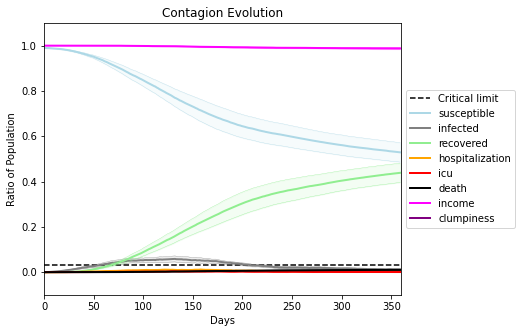

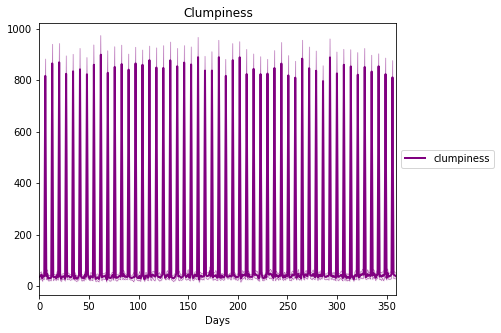

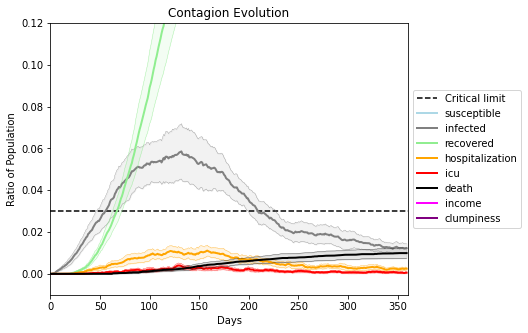

In [19]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.6
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9082, 2418, 4211, 4163, 803, 9226, 6440, 3395, 3770, 8860, 1931, 1743, 2045, 9758, 3884, 3303, 1478, 6469, 8255, 8447]
Average similarity between family members is 0.26284589964844357 at temperature -0.5
Average similarity between family and home is 0.9998455637469738 at temperature -1
Average similarity between students and their classroom is 0.15680677892982636 at temperature -0.5
Average classroom occupancy is 1.5568862275449102 and number classrooms is 167
Average similarity between workers is 0.16366599451883898 at temperature -0.5
Average office occupancy is 3.427860696517413 and number offices is 201
Average friend similarity for adults: 0.3389987420164958 for kids: 0.21194828901554447
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.09382240789984364
avg restaurant similarity 0.04143023836958068
avg restaurant similarity 0.04959019804204163
avg restaurant similarity 0.07758653281744847
avg restaurant similarity 0.02114516259651368
avg restaurant similarity 0.060388241652798706
avg restaurant similarity 0.09594669282359958
avg restaurant similarity 0.07945905731052665
avg restaurant similarity 0.07864750309045443
avg restaurant similarity 0.0811517570965309
avg restaurant similarity 0.030213805755352995
avg restaurant similarity 0.0036813311949594934
avg restaurant similarity 0.05038905521775871
avg restaurant similarity 0.13144026423481803
avg restaurant similarity 0.013541483874899871
avg restaurant similarity 0.07131124438115721
avg restaurant similarity 0.09669122212868239
avg restaurant similarity 0.0498262161520516
avg restaurant similarity 0.015576633798610741
avg restaurant similarity 0.11492775558298622
avg restaurant similarity 0.07182447410536032
avg restaurant similarity 0.09

avg restaurant similarity 0.0626846675686419
avg restaurant similarity 0.05222541718504639
avg restaurant similarity 0.054878618852005435
avg restaurant similarity 0.09155932461672306
avg restaurant similarity 0.10105072850802069
avg restaurant similarity 0.02196163454637863
avg restaurant similarity 0.07955693292072677
avg restaurant similarity 0.03605778999782682
avg restaurant similarity 0.03431886707370788
avg restaurant similarity 0.11825462665359911
avg restaurant similarity 0.03319882751008372
avg restaurant similarity 0.07472896251478246
avg restaurant similarity 0.04956549246240247
avg restaurant similarity 0.02401541794383039
avg restaurant similarity 0.005015413292974503
avg restaurant similarity 0.07900189220991115
avg restaurant similarity 0.07473370184313893
avg restaurant similarity 0.10022961207909713
avg restaurant similarity 0.06095827881672595
avg restaurant similarity 0.07715894017287929
avg restaurant similarity 0.04051359680510059
avg restaurant similarity 0.00332

avg restaurant similarity 0.07831440935310316
avg restaurant similarity 0.02604418249750291
avg restaurant similarity 0.09919651869421957
avg restaurant similarity 0.0649339336373637
Average similarity between family members is 0.2501944816037904 at temperature -0.5
Average similarity between family and home is 0.9998643748468105 at temperature -1
Average similarity between students and their classroom is 0.15435086192739272 at temperature -0.5
Average classroom occupancy is 1.6067415730337078 and number classrooms is 178
Average similarity between workers is 0.1482377000183551 at temperature -0.5
Average office occupancy is 3.271356783919598 and number offices is 199
Average friend similarity for adults: 0.3286880586980261 for kids: 0.20324831920073677
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with

avg restaurant similarity 0.021859519143836128
avg restaurant similarity 0.0932320150455308
avg restaurant similarity 0.07479536584628922
avg restaurant similarity 0.0715615497867223
avg restaurant similarity 0.05349887020283146
avg restaurant similarity 0.043573290473243854
avg restaurant similarity 0.05263692845402902
avg restaurant similarity 0.031416738959827425
avg restaurant similarity 0.07158545760261437
avg restaurant similarity 0.031440722901915866
avg restaurant similarity 0.08726723710314752
avg restaurant similarity 0.05698292597525155
avg restaurant similarity 0.05289080918979214
avg restaurant similarity 0.04124722411869095
avg restaurant similarity 0.09243298499706945
avg restaurant similarity 0.04738250088653947
avg restaurant similarity -0.012079031831281624
avg restaurant similarity 0.059906824233831105
avg restaurant similarity 0.07787536993528943
avg restaurant similarity 0.08728766917996512
avg restaurant similarity 0.030453495140867273
avg restaurant similarity 0.

avg restaurant similarity 0.09209914344207124
avg restaurant similarity 0.07628976361848312
avg restaurant similarity 0.0965622673979878
avg restaurant similarity 0.05564766024201923
avg restaurant similarity 0.008343236785224832
avg restaurant similarity 0.055631854156008485
avg restaurant similarity 0.03797540414141913
avg restaurant similarity 0.028572756781372097
avg restaurant similarity 0.09146834171675651
avg restaurant similarity 0.055511575507979145
avg restaurant similarity 0.052019552352499936
avg restaurant similarity 0.028911438995829923
avg restaurant similarity 0.04792618343025618
avg restaurant similarity 0.07231131254507847
avg restaurant similarity 0.046052334908268294
avg restaurant similarity 0.06796715216538278
avg restaurant similarity 0.0465282586045983
avg restaurant similarity 0.08659592357506646
avg restaurant similarity 0.05704190151010627
avg restaurant similarity 0.03604923771779224
avg restaurant similarity 0.08110659160855523
avg restaurant similarity 0.0

avg restaurant similarity 0.058826757487270676
avg restaurant similarity 0.07376356505761993
avg restaurant similarity 0.04769175594642616
avg restaurant similarity 0.031783309946113475
Average similarity between family members is 0.2606439794612417 at temperature -0.5
Average similarity between family and home is 0.9998615535172086 at temperature -1
Average similarity between students and their classroom is 0.17649302724970875 at temperature -0.5
Average classroom occupancy is 1.5966850828729282 and number classrooms is 181
Average similarity between workers is 0.1559361997397177 at temperature -0.5
Average office occupancy is 3.29 and number offices is 200
Average friend similarity for adults: 0.32118721238024767 for kids: 0.2198999267024195
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.013028796216024211
avg restaurant similarity 0.05800682851020658
avg restaurant similarity 0.052283011309280224
avg restaurant similarity 0.01395012821684247
avg restaurant similarity 0.08897394603325935
avg restaurant similarity 0.04500329928703318
avg restaurant similarity 0.07989003761194136
avg restaurant similarity 0.056921512815349976
avg restaurant similarity 0.05635185369279145
avg restaurant similarity -0.003954270057694075
avg restaurant similarity 0.0499629076548877
avg restaurant similarity 0.043393612579059535
avg restaurant similarity 0.061727808965343384
avg restaurant similarity 0.046985869636775014
avg restaurant similarity 0.05291827525033477
avg restaurant similarity 0.04447367115038743
avg restaurant similarity 0.08683509815263384
avg restaurant similarity 0.06182899239911712
avg restaurant similarity 0.08982128824754401
avg restaurant similarity 0.06884885092807037
avg restaurant similarity 0.07363850877147742
avg restaurant similarity 0

avg restaurant similarity 0.07363401045233746
avg restaurant similarity 0.044227740166505145
avg restaurant similarity 0.09477693526857503
avg restaurant similarity 0.09523152539396391
avg restaurant similarity 0.006544893868706228
avg restaurant similarity 0.10742695759116783
avg restaurant similarity 0.05097034207077049
avg restaurant similarity 0.07134223151112586
avg restaurant similarity 0.08883559289096617
avg restaurant similarity 0.04907845207029047
avg restaurant similarity 0.034612498813516794
avg restaurant similarity 0.05909539629378285
avg restaurant similarity 0.013131150927745923
avg restaurant similarity 0.05186318133901709
avg restaurant similarity 0.029220240288294373
avg restaurant similarity 0.09145487969116092
avg restaurant similarity 0.05503791424560971
avg restaurant similarity 0.06831542384488479
avg restaurant similarity 0.04793111100864398
avg restaurant similarity 0.02753304349131497
avg restaurant similarity 0.03703194368385049
avg restaurant similarity 0.0

avg restaurant similarity 0.037856385929626514
avg restaurant similarity 0.08017862028574657
avg restaurant similarity 0.03320242984559816
avg restaurant similarity 0.07637708812978071
Average similarity between family members is 0.2382290791579401 at temperature -0.5
Average similarity between family and home is 0.9998530251170313 at temperature -1
Average similarity between students and their classroom is 0.1413365725326916 at temperature -0.5
Average classroom occupancy is 1.5212765957446808 and number classrooms is 188
Average similarity between workers is 0.14338428742957854 at temperature -0.5
Average office occupancy is 3.310344827586207 and number offices is 203
Average friend similarity for adults: 0.320521869278466 for kids: 0.20502275881831636
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.07123581536451558
avg restaurant similarity 0.05661688703770493
avg restaurant similarity 0.06635027256014704
avg restaurant similarity -0.01052026761169103
avg restaurant similarity 0.04098767675726055
avg restaurant similarity 0.07216288017787705
avg restaurant similarity 0.050907571841153194
avg restaurant similarity 0.08888217718266334
avg restaurant similarity 0.07039970671417223
avg restaurant similarity 0.03742477186878902
avg restaurant similarity 0.047921054503252576
avg restaurant similarity 0.06181553145880906
avg restaurant similarity 0.10687762927978707
avg restaurant similarity 0.0523190172400636
avg restaurant similarity 0.04863637329865297
avg restaurant similarity 0.04270809468409486
avg restaurant similarity 0.07615893775121312
avg restaurant similarity 0.07225988324015797
avg restaurant similarity 0.025655570124795312
avg restaurant similarity 0.05165793349473583
avg restaurant similarity 0.012172415015929368
avg restaurant similarity 0.00

avg restaurant similarity 0.0625585451987504
avg restaurant similarity 0.08567762880605137
avg restaurant similarity 0.11657440798509858
avg restaurant similarity 0.05260494947897822
avg restaurant similarity 0.0866344810618784
avg restaurant similarity 0.042316145830396806
avg restaurant similarity 0.04678065141813887
avg restaurant similarity 0.03494223272136415
avg restaurant similarity 0.08316867771278884
avg restaurant similarity 0.03191241360887399
avg restaurant similarity 0.02414458915269213
avg restaurant similarity 0.0808364467711805
avg restaurant similarity 0.02047328530623329
avg restaurant similarity 0.048142390175602005
avg restaurant similarity 0.0636552842656195
avg restaurant similarity 0.04700691993450159
avg restaurant similarity 0.020506273404600102
avg restaurant similarity 0.05943241388456371
avg restaurant similarity 0.05667109608018708
avg restaurant similarity 0.053549161283937795
avg restaurant similarity 0.12310404430470777
avg restaurant similarity 0.012032

avg restaurant similarity 0.013329528106090905
avg restaurant similarity 0.04399949648618168
avg restaurant similarity 0.06911948368279765
avg restaurant similarity 0.09883247288509033
avg restaurant similarity 0.08372703163239509
Average similarity between family members is 0.24343025331855717 at temperature -0.5
Average similarity between family and home is 0.9998617254191413 at temperature -1
Average similarity between students and their classroom is 0.208323619838001 at temperature -0.5
Average classroom occupancy is 1.608695652173913 and number classrooms is 184
Average similarity between workers is 0.1592068980881061 at temperature -0.5
Average office occupancy is 3.3115577889447234 and number offices is 199
Average friend similarity for adults: 0.3176727828946044 for kids: 0.2091295819151783
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocat

avg restaurant similarity 0.05271322635976552
avg restaurant similarity 0.049233278161045425
avg restaurant similarity 0.0950175158742587
avg restaurant similarity 0.08085398171911963
avg restaurant similarity 0.06924141733310167
avg restaurant similarity 0.09744412873397182
avg restaurant similarity 0.07582391132240897
avg restaurant similarity 0.11125521206052733
avg restaurant similarity 0.03847888133257049
avg restaurant similarity 0.05843002951996544
avg restaurant similarity 0.04764462807391758
avg restaurant similarity 0.053337299069278296
avg restaurant similarity 0.09087312254742169
avg restaurant similarity 0.09617059017442046
avg restaurant similarity 0.05828300628412134
avg restaurant similarity 0.051392601449380376
avg restaurant similarity 0.07060329416165415
avg restaurant similarity 0.10692041642280087
avg restaurant similarity 0.05159431023400269
avg restaurant similarity 0.08940074529697845
avg restaurant similarity 0.07308018081365511
avg restaurant similarity 0.0520

avg restaurant similarity 0.11213689724449566
avg restaurant similarity 0.07333146449936195
avg restaurant similarity 0.06591598810886241
avg restaurant similarity 0.03725004984460442
avg restaurant similarity 0.05235581054505287
avg restaurant similarity 0.06937225705536172
avg restaurant similarity 0.08334869521736744
avg restaurant similarity 0.10003384503277779
avg restaurant similarity 0.05785358224568583
avg restaurant similarity 0.12212784833693151
avg restaurant similarity 0.024816577232271948
avg restaurant similarity 0.05929036963214725
avg restaurant similarity 0.1018004138565187
avg restaurant similarity 0.10843152684356143
avg restaurant similarity 0.08951901496818011
avg restaurant similarity 0.07815386200982496
avg restaurant similarity 0.02708479987300827
avg restaurant similarity 0.07484503575308132
avg restaurant similarity 0.09257033598658908
avg restaurant similarity 0.11770942318840942
avg restaurant similarity 0.06897998804224632
avg restaurant similarity 0.089818

avg restaurant similarity 0.04976691645965006
avg restaurant similarity 0.04480364992496761
avg restaurant similarity 0.0783316329929886
Average similarity between family members is 0.23877857669765215 at temperature -0.5
Average similarity between family and home is 0.9998585644389001 at temperature -1
Average similarity between students and their classroom is 0.1536004722092132 at temperature -0.5
Average classroom occupancy is 1.6363636363636365 and number classrooms is 187
Average similarity between workers is 0.14517004180535661 at temperature -0.5
Average office occupancy is 3.2551020408163267 and number offices is 196
Average friend similarity for adults: 0.3156617162968247 for kids: 0.21517333933465
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (e

avg restaurant similarity 0.08112796119818504
avg restaurant similarity 0.0660800487590625
avg restaurant similarity 0.041450374367824526
avg restaurant similarity 0.0459230007022129
avg restaurant similarity 0.09198619220456603
avg restaurant similarity 0.04917947136083136
avg restaurant similarity 0.11458687494538719
avg restaurant similarity 0.024233089586798498
avg restaurant similarity 0.0582718286043806
avg restaurant similarity 0.020155984816502045
avg restaurant similarity 0.01782480745309189
avg restaurant similarity 0.026993287535079822
avg restaurant similarity 0.06571375470178743
avg restaurant similarity 0.003005897045094471
avg restaurant similarity 0.05288206683715967
avg restaurant similarity 0.04812121848576195
avg restaurant similarity 0.024074197735759997
avg restaurant similarity 0.03585320222900367
avg restaurant similarity 0.04485817909562795
avg restaurant similarity 0.0014323052245186385
avg restaurant similarity 0.04934985389520023
avg restaurant similarity 0.0

avg restaurant similarity 0.009133696698980046
avg restaurant similarity 0.07632415241000402
avg restaurant similarity 0.09712975260481467
avg restaurant similarity 0.06810337220576736
avg restaurant similarity 0.06119101862510068
avg restaurant similarity 0.06719272461271145
avg restaurant similarity 0.053331377510042945
avg restaurant similarity 0.0798851377926347
avg restaurant similarity 0.050725206952036535
avg restaurant similarity 0.025422984507468174
avg restaurant similarity 0.017020219391703822
avg restaurant similarity -0.0281829002160516
avg restaurant similarity 0.06572641748770087
avg restaurant similarity 0.06740332821910461
avg restaurant similarity 0.061652716625829565
avg restaurant similarity 0.09161098265753825
avg restaurant similarity 0.0333500144926939
avg restaurant similarity 0.09955370717371546
avg restaurant similarity 0.05117609759278026
avg restaurant similarity 0.0871326694451229
avg restaurant similarity 0.025429029427880386
avg restaurant similarity 0.05

avg restaurant similarity 0.015614929938109335
avg restaurant similarity 0.06403842148349485
avg restaurant similarity 0.0449831541511243
avg restaurant similarity 0.04712210444352155
Average similarity between family members is 0.24639338207461298 at temperature -0.5
Average similarity between family and home is 0.9998408860362202 at temperature -1
Average similarity between students and their classroom is 0.1348225686841129 at temperature -0.5
Average classroom occupancy is 1.5675675675675675 and number classrooms is 185
Average similarity between workers is 0.16781609023262795 at temperature -0.5
Average office occupancy is 3.298507462686567 and number offices is 201
Average friend similarity for adults: 0.32254190422175644 for kids: 0.1966848839145301
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.057901143429267304
avg restaurant similarity 0.09936184826399873
avg restaurant similarity 0.06229745350585995
avg restaurant similarity 0.0690142722142966
avg restaurant similarity 0.05801280896235542
avg restaurant similarity 0.06765800307227307
avg restaurant similarity 0.10447329002377845
avg restaurant similarity 0.07971996271694205
avg restaurant similarity 0.0684047522415808
avg restaurant similarity 0.04209146373662227
avg restaurant similarity 0.08309577546375106
avg restaurant similarity 0.08027396979580409
avg restaurant similarity 0.036835246132946704
avg restaurant similarity 0.06963062092806337
avg restaurant similarity 0.05317705267599192
avg restaurant similarity 0.07022369706713423
avg restaurant similarity 0.053277337844261835
avg restaurant similarity 0.028967171846538256
avg restaurant similarity 0.07854143108400875
avg restaurant similarity 0.0767972841560541
avg restaurant similarity 0.108260979968953
avg restaurant similarity 0.0560825

avg restaurant similarity 0.11576436164817797
avg restaurant similarity 0.04184139254584993
avg restaurant similarity 0.07897168618216155
avg restaurant similarity 0.059515550628831154
avg restaurant similarity 0.1343091582683498
avg restaurant similarity 0.09250034974176484
avg restaurant similarity 0.08145119952624931
avg restaurant similarity 0.06243053184002676
avg restaurant similarity 0.0906441010479337
avg restaurant similarity 0.03668988438379453
avg restaurant similarity 0.08080166651326605
avg restaurant similarity 0.08831390469613838
avg restaurant similarity 0.01698813789482761
avg restaurant similarity 0.05078741907930971
avg restaurant similarity 0.06229308678523693
avg restaurant similarity 0.04925461953606832
avg restaurant similarity 0.09715833200066205
avg restaurant similarity 0.125465083872884
avg restaurant similarity 0.09410353476789497
avg restaurant similarity 0.1181460978559566
avg restaurant similarity 0.10818492657528313
avg restaurant similarity 0.1254079575

avg restaurant similarity 0.0504433187364796
avg restaurant similarity 0.09491347262507638
Average similarity between family members is 0.2414191878941623 at temperature -0.5
Average similarity between family and home is 0.9998610831578019 at temperature -1
Average similarity between students and their classroom is 0.16015587686145025 at temperature -0.5
Average classroom occupancy is 1.618279569892473 and number classrooms is 186
Average similarity between workers is 0.15342157378370272 at temperature -0.5
Average office occupancy is 3.1365853658536587 and number offices is 205
Average friend similarity for adults: 0.32428394020729095 for kids: 0.20592696385594228
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocate

avg restaurant similarity 0.03037114798265596
avg restaurant similarity 0.07782083526008482
avg restaurant similarity 0.10067406207751914
avg restaurant similarity 0.09887059324881775
avg restaurant similarity 0.03954965868063152
avg restaurant similarity 0.04634020904000513
avg restaurant similarity 0.06818672646906404
avg restaurant similarity 0.06361187037427404
avg restaurant similarity 0.027818841494872626
avg restaurant similarity 0.06682864445354893
avg restaurant similarity 0.005327354817982572
avg restaurant similarity 0.05814453675080336
avg restaurant similarity 0.023631202254002795
avg restaurant similarity 0.023298914032962095
avg restaurant similarity 0.06046978103878857
avg restaurant similarity 0.03602322924346797
avg restaurant similarity 0.06066997136657706
avg restaurant similarity 0.11717776342031745
avg restaurant similarity 0.06334786187166487
avg restaurant similarity 0.06937377351203815
avg restaurant similarity 0.0969384926937234
avg restaurant similarity 0.068

avg restaurant similarity 0.05071542639195756
avg restaurant similarity 0.07771458586571744
avg restaurant similarity 0.08096739613140391
avg restaurant similarity 0.08595338220588052
avg restaurant similarity 0.07021030206988457
avg restaurant similarity 0.0260673235534486
avg restaurant similarity 0.1191640765548029
avg restaurant similarity 0.08595973245153327
avg restaurant similarity 0.1002610423791685
avg restaurant similarity 0.05019656733690986
avg restaurant similarity 0.040698342041799736
avg restaurant similarity 0.013060742112938378
avg restaurant similarity 0.059335968017238006
avg restaurant similarity 0.08409717187818856
avg restaurant similarity 0.06257721852173019
avg restaurant similarity 0.043584996844187276
avg restaurant similarity 0.06277501340105579
avg restaurant similarity 0.07086898492251623
avg restaurant similarity 0.06210796951411004
avg restaurant similarity 0.032821275976460625
avg restaurant similarity 0.05785097675412071
avg restaurant similarity 0.0799

avg restaurant similarity -0.003996500276606818
avg restaurant similarity 0.06144681548287213
avg restaurant similarity 0.03703837137768421
avg restaurant similarity 0.059447482479493614
Average similarity between family members is 0.24944978986573685 at temperature -0.5
Average similarity between family and home is 0.9998512642329251 at temperature -1
Average similarity between students and their classroom is 0.19790966092089882 at temperature -0.5
Average classroom occupancy is 1.6491228070175439 and number classrooms is 171
Average similarity between workers is 0.16571856514246824 at temperature -0.5
Average office occupancy is 3.2561576354679804 and number offices is 203
Average friend similarity for adults: 0.33416496249050953 for kids: 0.21971679782513437
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (1,0) dis

avg restaurant similarity 0.1700689368483603
avg restaurant similarity 0.06873844817621104
avg restaurant similarity 0.11797319401770441
avg restaurant similarity 0.1285800046507738
avg restaurant similarity 0.08623184529892501
avg restaurant similarity 0.13220381264773315
avg restaurant similarity 0.1108435427462241
avg restaurant similarity 0.11998413377391874
avg restaurant similarity 0.11258419602008488
avg restaurant similarity 0.1293189941396009
avg restaurant similarity 0.09000367614973345
avg restaurant similarity 0.14506610318526486
avg restaurant similarity 0.08215843011606233
avg restaurant similarity 0.05224093489428068
avg restaurant similarity 0.08006022843765122
avg restaurant similarity 0.1183523652229945
avg restaurant similarity 0.11384776631068377
avg restaurant similarity 0.1011906084206466
avg restaurant similarity 0.06958358248941131
avg restaurant similarity 0.08927458428087781
avg restaurant similarity 0.11695672679790863
avg restaurant similarity 0.115944540878

avg restaurant similarity 0.10891512827239809
avg restaurant similarity 0.14766142686045375
avg restaurant similarity 0.07596362892891452
avg restaurant similarity 0.11770680908698171
avg restaurant similarity 0.1015294937585007
avg restaurant similarity 0.0621519601893383
avg restaurant similarity 0.12931483905979563
avg restaurant similarity 0.13840268950765935
avg restaurant similarity 0.16020139568269445
avg restaurant similarity 0.09518451408121786
avg restaurant similarity 0.11580731483733307
avg restaurant similarity 0.07970881356281276
avg restaurant similarity 0.08187494266446639
avg restaurant similarity 0.11274673309837158
avg restaurant similarity 0.12504784745897132
avg restaurant similarity 0.09347619508106675
avg restaurant similarity 0.07955471652891757
avg restaurant similarity 0.14764648194505026
avg restaurant similarity 0.15781416962447836
avg restaurant similarity 0.12212620066061786
avg restaurant similarity 0.10824764172886228
avg restaurant similarity 0.07959336

avg restaurant similarity 0.10192553431164518
Average similarity between family members is 0.25007429721993335 at temperature -0.5
Average similarity between family and home is 0.9998459427544979 at temperature -1
Average similarity between students and their classroom is 0.15645166711898373 at temperature -0.5
Average classroom occupancy is 1.6055555555555556 and number classrooms is 180
Average similarity between workers is 0.1284763770885113 at temperature -0.5
Average office occupancy is 3.32 and number offices is 200
Average friend similarity for adults: 0.32640423120117407 for kids: 0.21633516200289526
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people alloca

avg restaurant similarity 0.05011190144333305
avg restaurant similarity 0.06756095696848141
avg restaurant similarity 0.06894903668925846
avg restaurant similarity 0.012146361215260703
avg restaurant similarity -0.022984438661048105
avg restaurant similarity 0.018677712765227426
avg restaurant similarity 0.06444935525104754
avg restaurant similarity 0.0635056985870563
avg restaurant similarity 0.03288018680771337
avg restaurant similarity 0.08483982756334082
avg restaurant similarity 0.05556394726643168
avg restaurant similarity 0.03058810868169301
avg restaurant similarity 0.013177171660469751
avg restaurant similarity 0.033253701958554926
avg restaurant similarity 0.030256236251317726
avg restaurant similarity 0.06765176292788765
avg restaurant similarity 0.03142580392056214
avg restaurant similarity 0.07221319101799666
avg restaurant similarity 0.006237928411665806
avg restaurant similarity 0.0725118978699734
avg restaurant similarity 0.05435002233942644
avg restaurant similarity 0.

avg restaurant similarity 0.034694255221976784
avg restaurant similarity 0.05272106364396501
avg restaurant similarity 0.03537459696861198
avg restaurant similarity 0.05909335682742224
avg restaurant similarity -0.005202513413896692
avg restaurant similarity 0.029100650561463076
avg restaurant similarity 0.021771931650277
avg restaurant similarity -0.0018649216548621548
avg restaurant similarity 0.06825719509472997
avg restaurant similarity 0.02436183139989996
avg restaurant similarity 0.0300518981848396
avg restaurant similarity 0.056761542800352116
avg restaurant similarity 0.05696354301703831
avg restaurant similarity 0.0397311047186946
avg restaurant similarity 0.051519224498778285
avg restaurant similarity 0.038354836118063215
avg restaurant similarity 0.09090116171071014
avg restaurant similarity 0.029211016786562165
avg restaurant similarity 0.08427757261806271
avg restaurant similarity 0.02063960859963182
avg restaurant similarity 0.003312272693550724
avg restaurant similarity 

avg restaurant similarity 0.045956163476763484
avg restaurant similarity 0.08856968110918477
avg restaurant similarity 0.07609750788683485
avg restaurant similarity 0.040091931779406315
avg restaurant similarity 0.05934207003704762
avg restaurant similarity 0.010468812248330073
Average similarity between family members is 0.2469301624668551 at temperature -0.5
Average similarity between family and home is 0.9998427699099202 at temperature -1
Average similarity between students and their classroom is 0.14781457512103002 at temperature -0.5
Average classroom occupancy is 1.5875706214689265 and number classrooms is 177
Average similarity between workers is 0.15837665670733608 at temperature -0.5
Average office occupancy is 3.393939393939394 and number offices is 198
Average friend similarity for adults: 0.32786118765759115 for kids: 0.22638711951457804
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units w

avg restaurant similarity 0.06195288034310966
avg restaurant similarity 0.04722968669440313
avg restaurant similarity 0.031093699708066923
avg restaurant similarity 0.038723394273732434
avg restaurant similarity 0.08165308326515854
avg restaurant similarity 0.0574159597306028
avg restaurant similarity 0.10916151989513713
avg restaurant similarity 0.09318388877859396
avg restaurant similarity 0.08192940971369943
avg restaurant similarity 0.07865924406970154
avg restaurant similarity 0.10638416675881822
avg restaurant similarity 0.07058226400097918
avg restaurant similarity 0.12242480137385273
avg restaurant similarity 0.02808216615912498
avg restaurant similarity 0.11244720066563776
avg restaurant similarity 0.03329335309649125
avg restaurant similarity 0.0086362715330754
avg restaurant similarity 0.06387807745782265
avg restaurant similarity 0.014487899576222126
avg restaurant similarity 0.08698944548961088
avg restaurant similarity 0.0937044460749366
avg restaurant similarity 0.030039

avg restaurant similarity 0.10980887972301882
avg restaurant similarity 0.02964588416274071
avg restaurant similarity 0.14953211344034387
avg restaurant similarity 0.09375435226312732
avg restaurant similarity 0.06330595872818086
avg restaurant similarity 0.04021526891394387
avg restaurant similarity 0.042704070206099884
avg restaurant similarity 0.050690797034299954
avg restaurant similarity 0.07254100544531591
avg restaurant similarity 0.12499515697514567
avg restaurant similarity 0.08193411916079983
avg restaurant similarity 0.04425451493679465
avg restaurant similarity 0.1016426172619221
avg restaurant similarity 0.13208397535895486
avg restaurant similarity -0.006846939827146983
avg restaurant similarity 0.07918675423115058
avg restaurant similarity 0.10208446353786273
avg restaurant similarity 0.10286704676684477
avg restaurant similarity 0.05318163106033482
avg restaurant similarity 0.05037710058846721
avg restaurant similarity 0.172528541023433
avg restaurant similarity 0.06956

avg restaurant similarity 0.06928427528333349
avg restaurant similarity 0.13089350457564322
avg restaurant similarity 0.055192559606434786
Average similarity between family members is 0.2645413206558197 at temperature -0.5
Average similarity between family and home is 0.9998526186115008 at temperature -1
Average similarity between students and their classroom is 0.18718435121469773 at temperature -0.5
Average classroom occupancy is 1.6666666666666667 and number classrooms is 183
Average similarity between workers is 0.17412717154297075 at temperature -0.5
Average office occupancy is 3.2261306532663316 and number offices is 199
Average friend similarity for adults: 0.32626712980162764 for kids: 0.22207542016804635
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 un

avg restaurant similarity 0.08574680434448989
avg restaurant similarity 0.12241471015223504
avg restaurant similarity 0.10758322463197659
avg restaurant similarity 0.08808084608655194
avg restaurant similarity 0.09046411308327243
avg restaurant similarity 0.11792465215407713
avg restaurant similarity 0.0386590994453702
avg restaurant similarity 0.09118975532147534
avg restaurant similarity 0.07208731327382992
avg restaurant similarity 0.0605963706167082
avg restaurant similarity 0.0804329607362476
avg restaurant similarity 0.08772185703884668
avg restaurant similarity 0.08998628488386415
avg restaurant similarity 0.10877468314903556
avg restaurant similarity 0.07170307147221028
avg restaurant similarity 0.0674397482396236
avg restaurant similarity 0.05527607198886688
avg restaurant similarity 0.06464673450318922
avg restaurant similarity 0.09579314954416006
avg restaurant similarity 0.09706484565141008
avg restaurant similarity 0.08009015838809426
avg restaurant similarity 0.1173686157

avg restaurant similarity 0.018019355625626506
avg restaurant similarity 0.011701989433318611
avg restaurant similarity 0.10093771158914061
avg restaurant similarity 0.024607703282736385
avg restaurant similarity 0.03649249371075559
avg restaurant similarity 0.07885453736484745
avg restaurant similarity 0.05818206169002144
avg restaurant similarity 0.12280931244204557
avg restaurant similarity 0.13439767071509395
avg restaurant similarity 0.05489926918720094
avg restaurant similarity 0.052804529205391436
avg restaurant similarity 0.07564992477744209
avg restaurant similarity 0.05130436837024351
avg restaurant similarity 0.07980586522752779
avg restaurant similarity 0.10026899057235604
avg restaurant similarity 0.08006385882482836
avg restaurant similarity 0.08590395708360705
avg restaurant similarity 0.08448055183544004
avg restaurant similarity 0.09568389043783812
avg restaurant similarity 0.05251593815084424
avg restaurant similarity 0.05686114905872663
avg restaurant similarity 0.14

avg restaurant similarity 0.07698964449144952
avg restaurant similarity 0.11339207215838434
Average similarity between family members is 0.24823530881429257 at temperature -0.5
Average similarity between family and home is 0.9998617470237348 at temperature -1
Average similarity between students and their classroom is 0.16137348439684843 at temperature -0.5
Average classroom occupancy is 1.6063829787234043 and number classrooms is 188
Average similarity between workers is 0.16312760607092766 at temperature -0.5
Average office occupancy is 3.245 and number offices is 200
Average friend similarity for adults: 0.3242231375883505 for kids: 0.21867128804763505
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units wit

avg restaurant similarity 0.0304238127780327
avg restaurant similarity 0.024214955920956835
avg restaurant similarity 0.0007013764385083865
avg restaurant similarity 0.005559669332004941
avg restaurant similarity 0.005065142996956171
avg restaurant similarity 0.0648786501558943
avg restaurant similarity 0.08416093292947377
avg restaurant similarity 0.04683124525689042
avg restaurant similarity 0.04403854943638582
avg restaurant similarity 0.0048349651000835865
avg restaurant similarity 0.015378512639611526
avg restaurant similarity 0.1021860627289044
avg restaurant similarity 0.05974979137465928
avg restaurant similarity -0.007151828397971576
avg restaurant similarity 0.0450777927467342
avg restaurant similarity 0.05251183545257278
avg restaurant similarity 0.012741824236059709
avg restaurant similarity 0.03777088416704738
avg restaurant similarity 0.034482574611349334
avg restaurant similarity 0.07362359792064133
avg restaurant similarity 0.08380768403862478
avg restaurant similarity 

avg restaurant similarity 0.023146746080957407
avg restaurant similarity 0.01860338341628532
avg restaurant similarity 0.07196147087360158
avg restaurant similarity 0.03520266592800817
avg restaurant similarity 0.004604745641783733
avg restaurant similarity 0.01955732658363237
avg restaurant similarity 0.05947192490300267
avg restaurant similarity 0.04068769420501549
avg restaurant similarity 0.05008488533140433
avg restaurant similarity 0.014667996379052235
avg restaurant similarity 0.023111924358244322
avg restaurant similarity 0.0743284519052028
avg restaurant similarity 0.01709592396968716
avg restaurant similarity 0.033170186595002926
avg restaurant similarity 0.0496837459154222
avg restaurant similarity 0.03847665768303999
avg restaurant similarity 0.07973456596009627
avg restaurant similarity 0.037655374950024745
avg restaurant similarity 0.05182797430107169
avg restaurant similarity 0.041402385059086166
avg restaurant similarity 0.03730447826214325
avg restaurant similarity 0.0

avg restaurant similarity 0.014887518979882339
avg restaurant similarity -0.02488700899132115
avg restaurant similarity 0.07446808526525024
avg restaurant similarity 0.004474375883392524
avg restaurant similarity 0.008378381994012071
avg restaurant similarity 0.04397916409735471
Average similarity between family members is 0.26589159502522886 at temperature -0.5
Average similarity between family and home is 0.9998599324676014 at temperature -1
Average similarity between students and their classroom is 0.17393740960627152 at temperature -0.5
Average classroom occupancy is 1.621301775147929 and number classrooms is 169
Average similarity between workers is 0.15281522465110978 at temperature -0.5
Average office occupancy is 3.4205128205128204 and number offices is 195
Average friend similarity for adults: 0.32456148449772 for kids: 0.21032585998162623
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units wi

avg restaurant similarity 0.06820543758981254
avg restaurant similarity 0.07638996607732199
avg restaurant similarity 0.07927882583771355
avg restaurant similarity 0.04199084503386047
avg restaurant similarity 0.03654643836911534
avg restaurant similarity 0.05363794440564189
avg restaurant similarity 0.06699767662382744
avg restaurant similarity 0.054606577471323386
avg restaurant similarity 0.08473821641581561
avg restaurant similarity 0.0458587141308278
avg restaurant similarity -0.0070473139314827255
avg restaurant similarity 0.08831357253214427
avg restaurant similarity 0.08715315406594197
avg restaurant similarity 0.07528518503841873
avg restaurant similarity 0.06392845188561001
avg restaurant similarity 0.039784757888422825
avg restaurant similarity 0.0610446201327979
avg restaurant similarity 0.05719177094684992
avg restaurant similarity 0.019088977775810426
avg restaurant similarity 0.07429225248277493
avg restaurant similarity 0.06519616350348616
avg restaurant similarity 0.04

avg restaurant similarity 0.10369096369653644
avg restaurant similarity 0.07837755007320223
avg restaurant similarity 0.058315999490070575
avg restaurant similarity 0.02278738599658569
avg restaurant similarity 0.04673613897552873
avg restaurant similarity 0.06985058532859094
avg restaurant similarity 0.08618570679282014
avg restaurant similarity 0.043569395581944545
avg restaurant similarity 0.0458407668490735
avg restaurant similarity 0.061948053516336046
avg restaurant similarity 0.07400325408196315
avg restaurant similarity 0.0646787044033329
avg restaurant similarity 0.0448102085157294
avg restaurant similarity 0.05132026309474979
avg restaurant similarity 0.06868310028955849
avg restaurant similarity 0.042168211524963764
avg restaurant similarity 0.07605746806314947
avg restaurant similarity 0.06369650274583219
avg restaurant similarity 0.08163166238320842
avg restaurant similarity 0.0894391881040637
avg restaurant similarity 0.09374478191221647
avg restaurant similarity 0.065348

avg restaurant similarity 0.05618602762629863
avg restaurant similarity 0.06951581684785416
avg restaurant similarity 0.07777282817715322
avg restaurant similarity 0.10274894708813681
Average similarity between family members is 0.2614206832107795 at temperature -0.5
Average similarity between family and home is 0.9998658396822158 at temperature -1
Average similarity between students and their classroom is 0.1706956295978693 at temperature -0.5
Average classroom occupancy is 1.5 and number classrooms is 188
Average similarity between workers is 0.15313278080695025 at temperature -0.5
Average office occupancy is 3.27363184079602 and number offices is 201
Average friend similarity for adults: 0.32718633322876217 for kids: 0.21544151565158415
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.07642738451747101
avg restaurant similarity 0.08081386359979706
avg restaurant similarity 0.0585762593381697
avg restaurant similarity 0.097115644608689
avg restaurant similarity 0.05370161704241941
avg restaurant similarity 0.04322979904155387
avg restaurant similarity 0.13582989795300515
avg restaurant similarity 0.05519712577856817
avg restaurant similarity 0.033411855068712776
avg restaurant similarity 0.10168268740966051
avg restaurant similarity 0.04401891991518535
avg restaurant similarity 0.07845472130619427
avg restaurant similarity 0.04021863942931623
avg restaurant similarity 0.054268845368216766
avg restaurant similarity 0.11425441508317627
avg restaurant similarity 0.06466429779253619
avg restaurant similarity 0.12519488592355316
avg restaurant similarity 0.0409642588891559
avg restaurant similarity 0.10107062533612339
avg restaurant similarity 0.10022070534494947
avg restaurant similarity 0.07623413957979605
avg restaurant similarity 0.06962688

avg restaurant similarity 0.07782246591147628
avg restaurant similarity 0.09258433238738031
avg restaurant similarity 0.12513555326879505
avg restaurant similarity 0.09465683216573806
avg restaurant similarity 0.033227875825491866
avg restaurant similarity 0.09580971106682865
avg restaurant similarity 0.09525391235037893
avg restaurant similarity 0.11409904295707363
avg restaurant similarity 0.09145463850351639
avg restaurant similarity 0.09408434425922715
avg restaurant similarity 0.06073003389508328
avg restaurant similarity 0.09124932412738715
avg restaurant similarity 0.12203451993573723
avg restaurant similarity 0.11530324214638815
avg restaurant similarity 0.1139373952856525
avg restaurant similarity 0.057481257611616814
avg restaurant similarity 0.09774905684186519
avg restaurant similarity 0.07478153339710726
avg restaurant similarity 0.04668669027147759
avg restaurant similarity 0.14371905065549648
avg restaurant similarity 0.02190185711812995
avg restaurant similarity 0.06987

avg restaurant similarity 0.11268151633541633
avg restaurant similarity 0.0307589338141343
Average similarity between family members is 0.24985063270265565 at temperature -0.5
Average similarity between family and home is 0.9998616793760273 at temperature -1
Average similarity between students and their classroom is 0.19553553336309615 at temperature -0.5
Average classroom occupancy is 1.6954022988505748 and number classrooms is 174
Average similarity between workers is 0.1751431833952181 at temperature -0.5
Average office occupancy is 3.2814070351758793 and number offices is 199
Average friend similarity for adults: 0.325786611913298 for kids: 0.21596550490206212
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.08519589409708105
avg restaurant similarity 0.1075457553371747
avg restaurant similarity 0.0845321411207912
avg restaurant similarity 0.11101085712854067
avg restaurant similarity 0.0973595313107334
avg restaurant similarity 0.15116569193897242
avg restaurant similarity 0.04310131531965267
avg restaurant similarity 0.07135923642274447
avg restaurant similarity 0.0943537233589984
avg restaurant similarity 0.11221539956906898
avg restaurant similarity 0.033367316231765295
avg restaurant similarity 0.09765799789082656
avg restaurant similarity 0.07715008634227268
avg restaurant similarity 0.08914664180231228
avg restaurant similarity 0.11690136812672906
avg restaurant similarity 0.02125170852482158
avg restaurant similarity 0.056488540596836584
avg restaurant similarity 0.06526351405946482
avg restaurant similarity 0.05432156241109684
avg restaurant similarity 0.09817986393336257
avg restaurant similarity 0.12220193410311063
avg restaurant similarity 0.07280168

avg restaurant similarity 0.08266540824386065
avg restaurant similarity 0.07707565982243024
avg restaurant similarity 0.07506549554784248
avg restaurant similarity 0.013902468647198988
avg restaurant similarity 0.03561095632229968
avg restaurant similarity 0.0636462137295364
avg restaurant similarity 0.04979445073581727
avg restaurant similarity 0.13948815639774503
avg restaurant similarity 0.10029750043780479
avg restaurant similarity 0.0913827638213489
avg restaurant similarity 0.07117769551047463
avg restaurant similarity 0.08074646536668216
avg restaurant similarity 0.06668736137999288
avg restaurant similarity 0.0931696174125437
avg restaurant similarity 0.04210093234938201
avg restaurant similarity 0.11717349108351982
avg restaurant similarity 0.09612816939045045
avg restaurant similarity 0.13217343766382214
avg restaurant similarity 0.11831756306954244
avg restaurant similarity 0.07515661376012656
avg restaurant similarity 0.0864387486409913
avg restaurant similarity 0.094249331

avg restaurant similarity 0.059788368972403715
avg restaurant similarity 0.05377964499731518
Average similarity between family members is 0.26662464757779003 at temperature -0.5
Average similarity between family and home is 0.9998611106098232 at temperature -1
Average similarity between students and their classroom is 0.17501641168752208 at temperature -0.5
Average classroom occupancy is 1.6 and number classrooms is 165
Average similarity between workers is 0.1528421976906436 at temperature -0.5
Average office occupancy is 3.4158415841584158 and number offices is 202
Average friend similarity for adults: 0.3366415849493472 for kids: 0.21972003359323738
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with 

avg restaurant similarity 0.05847654499068763
avg restaurant similarity 0.09995921607996108
avg restaurant similarity 0.0454067117137603
avg restaurant similarity 0.08089943661379008
avg restaurant similarity 0.06231658027234812
avg restaurant similarity 0.054282815974991364
avg restaurant similarity 0.07025735857488406
avg restaurant similarity -0.03425004194481405
avg restaurant similarity -0.015637260209586574
avg restaurant similarity 0.059978088311203596
avg restaurant similarity 0.06295062823392822
avg restaurant similarity 0.03889176733106129
avg restaurant similarity 0.07376715521058305
avg restaurant similarity 0.060620588671355724
avg restaurant similarity 0.045887605536391894
avg restaurant similarity 0.11084930522981781
avg restaurant similarity 0.10635696449927429
avg restaurant similarity 0.0020336791195620344
avg restaurant similarity 0.08000901925374679
avg restaurant similarity 0.036180591397198085
avg restaurant similarity 0.04814974295149262
avg restaurant similarity

avg restaurant similarity 0.0946747329430375
avg restaurant similarity 0.05825855502883355
avg restaurant similarity 0.021282525171270435
avg restaurant similarity 0.05196124401960519
avg restaurant similarity 0.061527827768089266
avg restaurant similarity 0.02350001921839465
avg restaurant similarity 0.08351644397725301
avg restaurant similarity 0.021544498888071868
avg restaurant similarity 0.05948759218065622
avg restaurant similarity 0.06238108003207171
avg restaurant similarity 0.04508453324257699
avg restaurant similarity 0.11641964455241782
avg restaurant similarity 0.048479810877746055
avg restaurant similarity 0.1438221520395186
avg restaurant similarity 0.06256703987618663
avg restaurant similarity 0.022267888606368892
avg restaurant similarity 0.11239563853742461
avg restaurant similarity 0.0859676916749737
avg restaurant similarity 0.06515199444055123
avg restaurant similarity 0.10407133759807993
avg restaurant similarity 0.053918737105267615
avg restaurant similarity 0.079

avg restaurant similarity 0.02243745090005366
avg restaurant similarity 0.01837139238070081
avg restaurant similarity 0.07683134205222582
avg restaurant similarity 0.06983564850551
avg restaurant similarity -0.005234261401471803
Average similarity between family members is 0.25208214235038 at temperature -0.5
Average similarity between family and home is 0.9998657279040892 at temperature -1
Average similarity between students and their classroom is 0.1762764458441554 at temperature -0.5
Average classroom occupancy is 1.4806629834254144 and number classrooms is 181
Average similarity between workers is 0.14711014415507512 at temperature -0.5
Average office occupancy is 3.3781094527363185 and number offices is 201
Average friend similarity for adults: 0.33765450566288574 for kids: 0.21388690532032759
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated

avg restaurant similarity 0.09403125209143778
avg restaurant similarity 0.048083277899140166
avg restaurant similarity 0.05606852802501503
avg restaurant similarity 0.10455612011801647
avg restaurant similarity 0.16759154636621293
avg restaurant similarity 0.09591594851937044
avg restaurant similarity 0.17098046832692346
avg restaurant similarity 0.09164051215590802
avg restaurant similarity 0.12657183266123068
avg restaurant similarity 0.12288524874549114
avg restaurant similarity 0.09028656156498822
avg restaurant similarity 0.12427688329701952
avg restaurant similarity 0.06758733210111068
avg restaurant similarity 0.13062976341276947
avg restaurant similarity 0.13422721407027807
avg restaurant similarity 0.10360806794167535
avg restaurant similarity 0.11279404474701053
avg restaurant similarity 0.06759817192245637
avg restaurant similarity 0.15724624589760536
avg restaurant similarity 0.0989848442392946
avg restaurant similarity 0.09936601483141957
avg restaurant similarity 0.102074

avg restaurant similarity 0.06883626656466593
avg restaurant similarity 0.08641534362778452
avg restaurant similarity 0.07319347275383307
avg restaurant similarity 0.06223730402140984
avg restaurant similarity 0.14153705697407382
avg restaurant similarity 0.12528589909326934
avg restaurant similarity 0.04989865969706735
avg restaurant similarity 0.07882823487693462
avg restaurant similarity 0.03832183871331193
avg restaurant similarity 0.06499317742669966
avg restaurant similarity 0.0650556771629256
avg restaurant similarity 0.03770552536993047
avg restaurant similarity 0.0808953141138366
avg restaurant similarity 0.09961199394083145
avg restaurant similarity 0.11443548857399559
avg restaurant similarity 0.039182152851624456
avg restaurant similarity 0.03952770331681052
avg restaurant similarity 0.08898324233374284
avg restaurant similarity 0.1192178041536802
avg restaurant similarity 0.10773307358353028
avg restaurant similarity 0.07239597145615782
avg restaurant similarity 0.09479609

avg restaurant similarity 0.05432519993812814
avg restaurant similarity 0.05252130352799287
Average similarity between family members is 0.26294972329722455 at temperature -0.5
Average similarity between family and home is 0.9998515876317676 at temperature -1
Average similarity between students and their classroom is 0.150163012972901 at temperature -0.5
Average classroom occupancy is 1.6432432432432433 and number classrooms is 185
Average similarity between workers is 0.13949395586227217 at temperature -0.5
Average office occupancy is 3.2373737373737375 and number offices is 198
Average friend similarity for adults: 0.3182259841088516 for kids: 0.20944665285737976
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.04458037147096403
avg restaurant similarity 0.052208348731697184
avg restaurant similarity 0.05002096552115985
avg restaurant similarity 0.08314389128323707
avg restaurant similarity 0.06206882401853374
avg restaurant similarity 0.10562127222159183
avg restaurant similarity 0.12761170478645106
avg restaurant similarity 0.08198327684872417
avg restaurant similarity 0.07942898008663132
avg restaurant similarity 0.06924044542982766
avg restaurant similarity 0.04074508241584869
avg restaurant similarity 0.08277057050397213
avg restaurant similarity 0.0869935281188636
avg restaurant similarity 0.08585122024438793
avg restaurant similarity 0.0422916527686899
avg restaurant similarity 0.08040492521215598
avg restaurant similarity 0.05247673389496427
avg restaurant similarity 0.10372445014185791
avg restaurant similarity 0.02767033795940962
avg restaurant similarity 0.008833176357665697
avg restaurant similarity 0.07324783282141605
avg restaurant similarity 0.073533

avg restaurant similarity 0.03608041792221255
avg restaurant similarity 0.06714882613531181
avg restaurant similarity 0.08838140449883986
avg restaurant similarity 0.057028308899319445
avg restaurant similarity 0.10457237592467812
avg restaurant similarity 0.10359329221168675
avg restaurant similarity 0.10147707113997548
avg restaurant similarity 0.10447841036616314
avg restaurant similarity 0.09520381925959431
avg restaurant similarity 0.0830411696122873
avg restaurant similarity 0.06328132292971084
avg restaurant similarity 0.06478202215572686
avg restaurant similarity 0.12227633010083985
avg restaurant similarity 0.10445024517960196
avg restaurant similarity 0.09842098141492242
avg restaurant similarity 0.1334552382681208
avg restaurant similarity 0.13538996915070586
avg restaurant similarity 0.09596580093802372
avg restaurant similarity 0.04614940603506555
avg restaurant similarity 0.13242440898138483
avg restaurant similarity 0.05097608540464341
avg restaurant similarity 0.1404138

avg restaurant similarity 0.05916906830604057
avg restaurant similarity 0.1142144542497707
Average similarity between family members is 0.2850823801366716 at temperature -0.5
Average similarity between family and home is 0.9998502695237992 at temperature -1
Average similarity between students and their classroom is 0.15932879420322615 at temperature -0.5
Average classroom occupancy is 1.6941176470588235 and number classrooms is 170
Average similarity between workers is 0.16295896393616385 at temperature -0.5
Average office occupancy is 3.257575757575758 and number offices is 198
Average friend similarity for adults: 0.3233909677566951 for kids: 0.2184581035297002
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated 

avg restaurant similarity 0.08223046663141002
avg restaurant similarity 0.09811021303756909
avg restaurant similarity 0.10655364338209938
avg restaurant similarity 0.12431288136700012
avg restaurant similarity 0.10684283782972497
avg restaurant similarity 0.08091806728824051
avg restaurant similarity 0.07271498805337351
avg restaurant similarity 0.07968691573708468
avg restaurant similarity 0.08090320607158835
avg restaurant similarity 0.04272895652787114
avg restaurant similarity 0.0941764378609163
avg restaurant similarity 0.08843129318050545
avg restaurant similarity 0.03895263598994627
avg restaurant similarity 0.07717287226243846
avg restaurant similarity 0.07499567073146657
avg restaurant similarity 0.04670168024686845
avg restaurant similarity 0.0563537446369416
avg restaurant similarity 0.11060007424477411
avg restaurant similarity 0.09936444836130524
avg restaurant similarity 0.06586947916856521
avg restaurant similarity 0.03479415019283985
avg restaurant similarity 0.04162228

avg restaurant similarity 0.09505907189127782
avg restaurant similarity 0.06440562508166793
avg restaurant similarity 0.0683815508467925
avg restaurant similarity 0.11906229668014752
avg restaurant similarity 0.08253906115164748
avg restaurant similarity 0.07533287859735167
avg restaurant similarity 0.06736793549123615
avg restaurant similarity 0.06627694574281603
avg restaurant similarity 0.09657819391689206
avg restaurant similarity 0.03402107855697901
avg restaurant similarity 0.07726448982582795
avg restaurant similarity 0.08902117862022815
avg restaurant similarity 0.09149973011755155
avg restaurant similarity 0.09722248627911866
avg restaurant similarity 0.06335750996285142
avg restaurant similarity 0.07235453995685157
avg restaurant similarity 0.020457437785806554
avg restaurant similarity 0.09981615963911522
avg restaurant similarity 0.10682202323377249
avg restaurant similarity 0.06585392432934818
avg restaurant similarity 0.08116814668915558
avg restaurant similarity 0.099244

avg restaurant similarity 0.0872383945660054
avg restaurant similarity 0.06961684365879969
using average of time series:
stats on susceptible:
data: [0.771802777777778, 0.8413722222222222, 0.7688428698159236, 0.7785944444444444, 0.7227722222222221, 0.6265782200110558, 0.8409166666666668, 0.7170500000000001, 0.77865, 0.7553361111111112, 0.7672, 0.818813888888889, 0.7880333333333334, 0.7169666666666666, 0.674275, 0.7667137007525454, 0.8082777777777779, 0.8533999999999999, 0.7251555555555556, 0.7609833333333333]
min:
0.6265782200110558
max:
0.8533999999999999
std:
0.055050718526833624
mean:
0.7640867395289763
median:
0.7680214349079618
95% confidence interval for the mean:
(0.7376528901597759,0.7905205888981768)
using average of time series:
stats on infected:
data: [0.026030555555555557, 0.019333333333333334, 0.02649700598802395, 0.027980555555555557, 0.028394444444444448, 0.039729132117191826, 0.016830555555555557, 0.02770277777777778, 0.024322222222222224, 0.027186111111111112, 0.02878

(<function dict.items>, <function dict.items>, <function dict.items>)

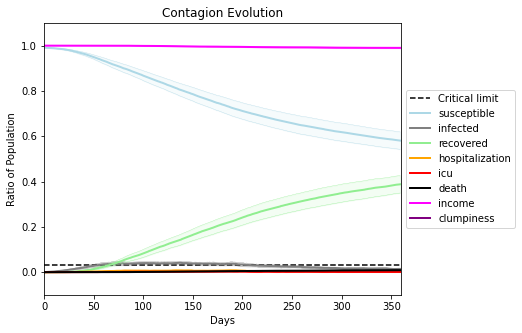

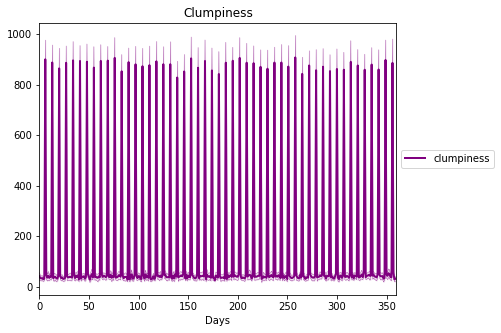

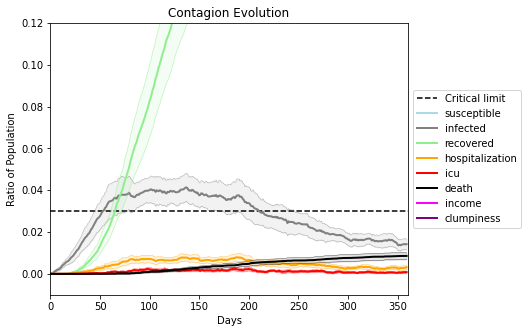

In [20]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.5
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9217, 8183, 611, 8131, 7993, 8768, 3519, 3650, 7008, 5107, 1489, 8415, 119, 3855, 1709, 2307, 4543, 5929, 3143, 5400]
Average similarity between family members is 0.2138499722209919 at temperature -0.4
Average similarity between family and home is 0.9998582031842772 at temperature -1
Average similarity between students and their classroom is 0.18863344356855594 at temperature -0.4
Average classroom occupancy is 1.5401069518716577 and number classrooms is 187
Average similarity between workers is 0.15983293195342635 at temperature -0.4
Average office occupancy is 3.2463054187192117 and number offices is 203
Average friend similarity for adults: 0.295769708502735 for kids: 0.21572272079197033
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.07026447108938827
avg restaurant similarity 0.09699631491605433
avg restaurant similarity 0.06124237364367826
avg restaurant similarity 0.10241881574122724
avg restaurant similarity 0.1140307754830697
avg restaurant similarity 0.01729495313830187
avg restaurant similarity 0.08149346233819267
avg restaurant similarity 0.05060020363866605
avg restaurant similarity -0.0029209397148551542
avg restaurant similarity 0.10033766512641488
avg restaurant similarity 0.1055948451957801
avg restaurant similarity 0.11408076167087781
avg restaurant similarity 0.06533285262294512
avg restaurant similarity 0.06293442401090783
avg restaurant similarity 0.0238409739832862
avg restaurant similarity 0.08420693580485081
avg restaurant similarity 0.08427287860527442
avg restaurant similarity 0.07006400683590075
avg restaurant similarity 0.013626385459209378
avg restaurant similarity 0.06881748111284983
avg restaurant similarity 0.08735560719524162
avg restaurant similarity 0.07454

avg restaurant similarity 0.10656392752543374
avg restaurant similarity 0.1218769209810802
avg restaurant similarity 0.14351509485947547
avg restaurant similarity 0.11829793222608516
avg restaurant similarity 0.10485792529755894
avg restaurant similarity 0.08484432291087947
avg restaurant similarity 0.05324068322575362
avg restaurant similarity 0.12215557824632155
avg restaurant similarity 0.022593396321541222
avg restaurant similarity 0.02539614098807834
avg restaurant similarity 0.1001138277914861
avg restaurant similarity 0.04881859492940353
avg restaurant similarity 0.015774021736933083
avg restaurant similarity 0.057737204796366605
avg restaurant similarity 0.08305800259600925
avg restaurant similarity 0.10909919657987603
avg restaurant similarity 0.07623095517392574
avg restaurant similarity 0.07316866620807273
avg restaurant similarity 0.1266128001437382
avg restaurant similarity 0.04778147295185167
avg restaurant similarity 0.06510339960764384
avg restaurant similarity 0.081178

avg restaurant similarity 0.04225776757988635
avg restaurant similarity 0.018044585890964405
avg restaurant similarity 0.06419184289736868
Average similarity between family members is 0.22061914498899252 at temperature -0.4
Average similarity between family and home is 0.9998523331620646 at temperature -1
Average similarity between students and their classroom is 0.16129027322368333 at temperature -0.4
Average classroom occupancy is 1.6 and number classrooms is 180
Average similarity between workers is 0.14327793612271356 at temperature -0.4
Average office occupancy is 3.2814070351758793 and number offices is 199
Average friend similarity for adults: 0.2776255350130768 for kids: 0.20128194885406808
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with 

avg restaurant similarity 0.0469360720598567
avg restaurant similarity 0.01157593764691217
avg restaurant similarity 0.030686182923456123
avg restaurant similarity 0.01038189129210939
avg restaurant similarity 0.06346866448738539
avg restaurant similarity -0.03150202146781909
avg restaurant similarity 0.014279260837451827
avg restaurant similarity 0.013188671276769573
avg restaurant similarity 0.024558872660426306
avg restaurant similarity 0.019280950415444854
avg restaurant similarity 0.062408577015689456
avg restaurant similarity 0.012869516181930883
avg restaurant similarity 0.05206685355271162
avg restaurant similarity 0.014955826365384235
avg restaurant similarity 0.0017615671905536034
avg restaurant similarity 0.0604033771763918
avg restaurant similarity 0.04394538537401279
avg restaurant similarity 0.06683300038103845
avg restaurant similarity 0.020017037105166755
avg restaurant similarity 0.022880795543696035
avg restaurant similarity -0.015335441327955083
avg restaurant simila

avg restaurant similarity 0.010448424201971309
avg restaurant similarity 0.029762819096687182
avg restaurant similarity 0.06175750487166132
avg restaurant similarity 0.028797619025156304
avg restaurant similarity -0.03254584027269442
avg restaurant similarity 0.047128271577974806
avg restaurant similarity 0.02888179644604251
avg restaurant similarity 0.10143062508885735
avg restaurant similarity 0.04903133732665019
avg restaurant similarity 0.04271863055140302
avg restaurant similarity 0.04755925760554933
avg restaurant similarity 0.027582001796495503
avg restaurant similarity -0.007373906128176333
avg restaurant similarity 0.005527808865801936
avg restaurant similarity 0.049104384761023454
avg restaurant similarity -0.0026376555243552906
avg restaurant similarity 0.03877093660038475
avg restaurant similarity -0.016081028113829568
avg restaurant similarity 0.03772434843500001
avg restaurant similarity -0.008861444387848106
avg restaurant similarity 0.017058759133352447
avg restaurant s

avg restaurant similarity 0.036606398115263256
avg restaurant similarity 0.027946533329957574
avg restaurant similarity 0.051534507290612375
avg restaurant similarity 0.03106233066067624
avg restaurant similarity 0.06137707241242246
avg restaurant similarity 0.03285354487660848
avg restaurant similarity 0.05163018904549388
avg restaurant similarity 0.04371870749944221
Average similarity between family members is 0.2036203897397756 at temperature -0.4
Average similarity between family and home is 0.9998439846489576 at temperature -1
Average similarity between students and their classroom is 0.13167637676092095 at temperature -0.4
Average classroom occupancy is 1.646153846153846 and number classrooms is 195
Average similarity between workers is 0.16779881597782373 at temperature -0.4
Average office occupancy is 3.127450980392157 and number offices is 204
Average friend similarity for adults: 0.27860548161400883 for kids: 0.20310081682790554
home_districts
[
Home (0,0) district with 1 Bui

avg restaurant similarity 0.10247691975079537
avg restaurant similarity 0.05465414329288267
avg restaurant similarity 0.007424434570851943
avg restaurant similarity 0.06184142915050661
avg restaurant similarity 0.027736030338073644
avg restaurant similarity 0.029629918516024978
avg restaurant similarity 0.04767877947039065
avg restaurant similarity 0.03277259708653975
avg restaurant similarity 0.005336540226166041
avg restaurant similarity -0.009194278120484782
avg restaurant similarity 0.021794881895289078
avg restaurant similarity 0.04663917614274975
avg restaurant similarity 0.07092462238144981
avg restaurant similarity 0.018593344186666503
avg restaurant similarity 0.015714596325608548
avg restaurant similarity -0.02611897135857529
avg restaurant similarity -0.03169855445938562
avg restaurant similarity 0.07195631396132558
avg restaurant similarity 0.055973830079264084
avg restaurant similarity 0.05855600263828019
avg restaurant similarity 0.008166590168076002
avg restaurant simila

avg restaurant similarity 0.04566654371670919
avg restaurant similarity 0.037669889631180446
avg restaurant similarity -0.019624359586116125
avg restaurant similarity 0.018109887278670016
avg restaurant similarity 0.07629306014011271
avg restaurant similarity 0.06000726315694822
avg restaurant similarity 0.07757103725673857
avg restaurant similarity 0.047710260353933276
avg restaurant similarity 0.01322193258628316
avg restaurant similarity 0.03633874837717859
avg restaurant similarity 0.08811835326310012
avg restaurant similarity 0.06216763692097143
avg restaurant similarity 0.04216158382852072
avg restaurant similarity -0.009213735201989127
avg restaurant similarity 0.05223869752420515
avg restaurant similarity 0.02319376199178277
avg restaurant similarity 0.04453464867406925
avg restaurant similarity 0.07910153002198839
avg restaurant similarity 0.060237300421053276
avg restaurant similarity 0.0583360755810576
avg restaurant similarity 0.03106953174051944
avg restaurant similarity 0

avg restaurant similarity 0.06003130329699719
avg restaurant similarity 0.08492633877158359
avg restaurant similarity 0.037397032873392105
avg restaurant similarity 0.005992659793046802
avg restaurant similarity 0.0806823852281579
avg restaurant similarity 0.058859187930996634
Average similarity between family members is 0.21815731402603322 at temperature -0.4
Average similarity between family and home is 0.9998501272682435 at temperature -1
Average similarity between students and their classroom is 0.14316096003392476 at temperature -0.4
Average classroom occupancy is 1.549222797927461 and number classrooms is 193
Average similarity between workers is 0.15633530285506006 at temperature -0.4
Average office occupancy is 3.18407960199005 and number offices is 201
Average friend similarity for adults: 0.2649870011736933 for kids: 0.2155403587808131
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with 

avg restaurant similarity 0.07340391909423828
avg restaurant similarity 0.01088498472781168
avg restaurant similarity 0.019117583427412935
avg restaurant similarity 0.08306757830750133
avg restaurant similarity 0.06333257700991661
avg restaurant similarity 0.09157093071621232
avg restaurant similarity 0.08184172218665915
avg restaurant similarity 0.033596619531127685
avg restaurant similarity 0.011142135253839237
avg restaurant similarity 0.04552205448226338
avg restaurant similarity 0.035264200128852084
avg restaurant similarity 0.031218644700897278
avg restaurant similarity 0.018741776746641688
avg restaurant similarity 0.03878616611089429
avg restaurant similarity 0.07568860100381339
avg restaurant similarity 0.07889008147732342
avg restaurant similarity 0.09211524424855141
avg restaurant similarity 0.04551220390663951
avg restaurant similarity 0.04822240882709961
avg restaurant similarity 0.03222780866736488
avg restaurant similarity 0.05547507422092103
avg restaurant similarity 0.

avg restaurant similarity 0.036054707572543615
avg restaurant similarity 0.082196712558224
avg restaurant similarity 0.09503045975808755
avg restaurant similarity 0.04816179862001223
avg restaurant similarity 0.018420066381590872
avg restaurant similarity 0.0772941712276969
avg restaurant similarity 0.03868295027053687
avg restaurant similarity 0.054402397382098726
avg restaurant similarity 0.07424201983327229
avg restaurant similarity 0.09508413896327172
avg restaurant similarity 0.03623115456581007
avg restaurant similarity 0.09405881991875681
avg restaurant similarity 0.10165209045993667
avg restaurant similarity 0.08805313062955283
avg restaurant similarity 0.027391149234898743
avg restaurant similarity 0.055905995751430994
avg restaurant similarity 0.07507669780258483
avg restaurant similarity 0.02021723253160511
avg restaurant similarity 0.08109130228692095
avg restaurant similarity 0.0084450848462548
avg restaurant similarity 0.025569777038103748
avg restaurant similarity 0.0609

avg restaurant similarity 0.05497413538876783
avg restaurant similarity 0.04153292476675109
avg restaurant similarity 0.11115820377660973
avg restaurant similarity 0.058196541142506615
Average similarity between family members is 0.19775102954246215 at temperature -0.4
Average similarity between family and home is 0.9998428632918153 at temperature -1
Average similarity between students and their classroom is 0.14921447385132447 at temperature -0.4
Average classroom occupancy is 1.560846560846561 and number classrooms is 189
Average similarity between workers is 0.1729386514877245 at temperature -0.4
Average office occupancy is 3.1732673267326734 and number offices is 202
Average friend similarity for adults: 0.26859138515482306 for kids: 0.21161417175913377
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated units with a total of 22 people.
Total of 22 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.008493341865931467
avg restaurant similarity 0.039429552751386196
avg restaurant similarity 0.03685221341823903
avg restaurant similarity 0.02159465349824047
avg restaurant similarity 0.043866015347422335
avg restaurant similarity 0.014371281540238022
avg restaurant similarity 0.08096013876875868
avg restaurant similarity 0.03816711686435958
avg restaurant similarity 0.024493288860233598
avg restaurant similarity 0.06536917386017779
avg restaurant similarity 0.037561100312548897
avg restaurant similarity 0.07187195857703127
avg restaurant similarity 0.05835996253067805
avg restaurant similarity 0.08228343220001905
avg restaurant similarity 0.0469780681048049
avg restaurant similarity 0.10309847513822953
avg restaurant similarity 0.002557648014956779
avg restaurant similarity 0.06027227035783154
avg restaurant similarity 0.08583052936453235
avg restaurant similarity 0.08688389477800713
avg restaurant similarity 0.05735849641912541
avg restaurant similarity 0.

avg restaurant similarity 0.03428646742184763
avg restaurant similarity 0.10533018778947174
avg restaurant similarity 0.06271948019654068
avg restaurant similarity 0.05164157515802715
avg restaurant similarity 0.055987544511568045
avg restaurant similarity 0.0805492253103557
avg restaurant similarity 0.03161035357276157
avg restaurant similarity 0.03540736641050391
avg restaurant similarity 0.059722813324849855
avg restaurant similarity 0.011900077101044494
avg restaurant similarity 0.055888397880559666
avg restaurant similarity 0.05734615746931841
avg restaurant similarity 0.07807511217812349
avg restaurant similarity 0.015235266941026764
avg restaurant similarity 0.06426515961373709
avg restaurant similarity 0.0468445990481918
avg restaurant similarity 0.05649367414792847
avg restaurant similarity 0.08078807734736371
avg restaurant similarity 0.005694879260016861
avg restaurant similarity 0.04669138677485698
avg restaurant similarity 0.046000233853588
avg restaurant similarity 0.0630

avg restaurant similarity 0.035615199161039175
avg restaurant similarity 0.07628096456912827
avg restaurant similarity 0.07860437562889783
avg restaurant similarity 0.04662515000607485
avg restaurant similarity 0.033177611899115354
Average similarity between family members is 0.2288360346443416 at temperature -0.4
Average similarity between family and home is 0.9998531590865467 at temperature -1
Average similarity between students and their classroom is 0.19137332993033754 at temperature -0.4
Average classroom occupancy is 1.7797619047619047 and number classrooms is 168
Average similarity between workers is 0.1451307353482884 at temperature -0.4
Average office occupancy is 3.282828282828283 and number offices is 198
Average friend similarity for adults: 0.28129548678755406 for kids: 0.21244247801997534
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people all

avg restaurant similarity 0.0790266421550822
avg restaurant similarity 0.06902868270330229
avg restaurant similarity 0.09784179902449079
avg restaurant similarity 0.0682776890342175
avg restaurant similarity 0.037448296975806615
avg restaurant similarity 0.06627172061506054
avg restaurant similarity 0.07305237310221915
avg restaurant similarity 0.04497589241729658
avg restaurant similarity 0.07904983972796022
avg restaurant similarity 0.10106350579558238
avg restaurant similarity 0.057433749447417026
avg restaurant similarity 0.046191772232795476
avg restaurant similarity 0.022327076316312804
avg restaurant similarity 0.0576738679478969
avg restaurant similarity 0.1113239096937539
avg restaurant similarity 0.06433428829142392
avg restaurant similarity 0.06328332281739857
avg restaurant similarity 0.046737136857490924
avg restaurant similarity 0.07690131486776018
avg restaurant similarity 0.0972341544699369
avg restaurant similarity 0.09491627957969909
avg restaurant similarity 0.110780

avg restaurant similarity 0.07467617659596347
avg restaurant similarity 0.07352528401576247
avg restaurant similarity 0.09282302502564796
avg restaurant similarity 0.08045532656993423
avg restaurant similarity 0.1274045170596583
avg restaurant similarity 0.06260487338568167
avg restaurant similarity 0.05862445260787097
avg restaurant similarity 0.09264044077969379
avg restaurant similarity 0.1206846432671677
avg restaurant similarity 0.025288300685078365
avg restaurant similarity 0.04593875037338649
avg restaurant similarity 0.016304407513217066
avg restaurant similarity 0.09090030890132313
avg restaurant similarity 0.08034001037136324
avg restaurant similarity 0.02798531537463157
avg restaurant similarity 0.05905931417621457
avg restaurant similarity 0.05504555067531503
avg restaurant similarity 0.09124068599166778
avg restaurant similarity 0.0635374543895673
avg restaurant similarity 0.07246525334657583
avg restaurant similarity 0.10226302530709211
avg restaurant similarity 0.0797136

avg restaurant similarity 0.07324562456062848
avg restaurant similarity 0.09456816455078923
avg restaurant similarity 0.10014002855143989
Average similarity between family members is 0.23438294326894418 at temperature -0.4
Average similarity between family and home is 0.9998545939759703 at temperature -1
Average similarity between students and their classroom is 0.1672329896435133 at temperature -0.4
Average classroom occupancy is 1.6288659793814433 and number classrooms is 194
Average similarity between workers is 0.17354583245336355 at temperature -0.4
Average office occupancy is 3.144278606965174 and number offices is 201
Average friend similarity for adults: 0.27148766917438893 for kids: 0.2127432311944817
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity 0.05294609912561809
avg restaurant similarity 0.07110055694295266
avg restaurant similarity 0.058495380745203364
avg restaurant similarity 0.05739957202012581
avg restaurant similarity 0.09085074057537074
avg restaurant similarity 0.04272070378531006
avg restaurant similarity 0.07468836320842563
avg restaurant similarity 0.0828676389608702
avg restaurant similarity 0.04680859294633217
avg restaurant similarity 0.027448338041354374
avg restaurant similarity 0.08585070213333053
avg restaurant similarity 0.047908688912038803
avg restaurant similarity 0.08517892090299084
avg restaurant similarity 0.05109873336768869
avg restaurant similarity 0.12791359656540563
avg restaurant similarity 0.06681779527554095
avg restaurant similarity 0.025347414329374048
avg restaurant similarity 0.09547076576085746
avg restaurant similarity 0.049916488847633764
avg restaurant similarity 0.033727089355340814
avg restaurant similarity 0.07843004378745638
avg restaurant similarity 0.0

avg restaurant similarity 0.06444382976262338
avg restaurant similarity 0.07858275400883319
avg restaurant similarity 0.026394330613434346
avg restaurant similarity 0.10471062625759757
avg restaurant similarity 0.07505831248706611
avg restaurant similarity 0.046092006874591605
avg restaurant similarity 0.10296647120401638
avg restaurant similarity 0.04297354484845893
avg restaurant similarity 0.06343679570575528
avg restaurant similarity 0.04614583423951153
avg restaurant similarity 0.08487848660984265
avg restaurant similarity 0.07695385835973073
avg restaurant similarity 0.07695715740741677
avg restaurant similarity 0.04745514101565959
avg restaurant similarity 0.09942562970196911
avg restaurant similarity 0.0727428587820366
avg restaurant similarity 0.0520932532447225
avg restaurant similarity 0.13843427619516033
avg restaurant similarity 0.04935296868484509
avg restaurant similarity 0.0595754867327482
avg restaurant similarity 0.029700727804677272
avg restaurant similarity 0.033011

avg restaurant similarity 0.08780675888358729
avg restaurant similarity 0.06279564722446304
avg restaurant similarity 0.023918922044894837
avg restaurant similarity 0.05368406380988825
Average similarity between family members is 0.222648116600295 at temperature -0.4
Average similarity between family and home is 0.9998681708091767 at temperature -1
Average similarity between students and their classroom is 0.18116426401687513 at temperature -0.4
Average classroom occupancy is 1.5397727272727273 and number classrooms is 176
Average similarity between workers is 0.16215359935286816 at temperature -0.4
Average office occupancy is 3.2660098522167487 and number offices is 203
Average friend similarity for adults: 0.2949153594665265 for kids: 0.2247688982971473
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.12112230382713843
avg restaurant similarity 0.09789710068745794
avg restaurant similarity 0.0869220483787345
avg restaurant similarity 0.0549764710655484
avg restaurant similarity 0.1011292448697191
avg restaurant similarity 0.1016166996373492
avg restaurant similarity 0.10020977353431261
avg restaurant similarity 0.09132524946534411
avg restaurant similarity 0.09873979217508176
avg restaurant similarity 0.05724779928946088
avg restaurant similarity 0.1077988110056054
avg restaurant similarity 0.08122271029805267
avg restaurant similarity 0.07640883993814307
avg restaurant similarity 0.10215857226800716
avg restaurant similarity 0.12760405191133306
avg restaurant similarity 0.10733339355726988
avg restaurant similarity 0.12415604904166622
avg restaurant similarity 0.06504395748068201
avg restaurant similarity 0.09606909118724
avg restaurant similarity 0.08677158460079328
avg restaurant similarity 0.13888360479339795
avg restaurant similarity 0.05122991351446

avg restaurant similarity 0.1089552571537116
avg restaurant similarity 0.02384960639879291
avg restaurant similarity 0.09277251667408122
avg restaurant similarity 0.10210065243424163
avg restaurant similarity 0.09829208746431392
avg restaurant similarity 0.05221602502877057
avg restaurant similarity 0.07509860083489525
avg restaurant similarity 0.08848713286352122
avg restaurant similarity 0.09212026930514658
avg restaurant similarity 0.07672348537566949
avg restaurant similarity 0.11358517792884747
avg restaurant similarity 0.11343224107131393
avg restaurant similarity 0.08087483691625866
avg restaurant similarity 0.054048393207295105
avg restaurant similarity 0.05652635992480031
avg restaurant similarity 0.08845259994599698
avg restaurant similarity 0.08856564358493554
avg restaurant similarity 0.11901903090106698
avg restaurant similarity 0.07851242144346789
avg restaurant similarity 0.12041874884879061
avg restaurant similarity 0.05070780083151632
avg restaurant similarity 0.112685

avg restaurant similarity 0.08066344496824851
avg restaurant similarity 0.06653831520758229
Average similarity between family members is 0.20095648033370403 at temperature -0.4
Average similarity between family and home is 0.9998547876005209 at temperature -1
Average similarity between students and their classroom is 0.14437464300337502 at temperature -0.4
Average classroom occupancy is 1.5197740112994351 and number classrooms is 177
Average similarity between workers is 0.17606333644368002 at temperature -0.4
Average office occupancy is 3.3134328358208953 and number offices is 201
Average friend similarity for adults: 0.28679368093903274 for kids: 0.2066153739660559
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocate

avg restaurant similarity 0.016087891546556304
avg restaurant similarity 0.10088070612111918
avg restaurant similarity 0.1013734276370868
avg restaurant similarity 0.07512169418093863
avg restaurant similarity 0.05620305957335946
avg restaurant similarity 0.06480135830730055
avg restaurant similarity 0.03788220936630266
avg restaurant similarity 0.06616696926111751
avg restaurant similarity 0.041824125870874446
avg restaurant similarity 0.07744656953899616
avg restaurant similarity 0.10033260119343969
avg restaurant similarity 0.07560246006089986
avg restaurant similarity 0.05675657114508161
avg restaurant similarity 0.11279907461718969
avg restaurant similarity 0.09330107368580667
avg restaurant similarity -0.02507189918375445
avg restaurant similarity 0.08508422581592993
avg restaurant similarity 0.06194518138867056
avg restaurant similarity 0.0664021083434628
avg restaurant similarity 0.0808146959266035
avg restaurant similarity 0.0316231529796663
avg restaurant similarity 0.0340711

avg restaurant similarity 0.0675389124641758
avg restaurant similarity 0.10993054885220853
avg restaurant similarity 0.006136822225660951
avg restaurant similarity 0.07928784677331285
avg restaurant similarity 0.057917147270830485
avg restaurant similarity 0.10825968973457756
avg restaurant similarity 0.07715086185109593
avg restaurant similarity 0.06889351673329648
avg restaurant similarity 0.09825819076415362
avg restaurant similarity 0.07313326375968134
avg restaurant similarity 0.11027057778293903
avg restaurant similarity 0.05570403403103016
avg restaurant similarity 0.09359111123009824
avg restaurant similarity 0.14360063655666003
avg restaurant similarity 0.06542364141053879
avg restaurant similarity 0.03272509479558084
avg restaurant similarity 0.05785234881541229
avg restaurant similarity 0.07746415656425762
avg restaurant similarity 0.030157263957051813
avg restaurant similarity 0.11498018564750935
avg restaurant similarity 0.13586942915612019
avg restaurant similarity 0.0553

avg restaurant similarity 0.07885570211055275
avg restaurant similarity 0.0235058319324119
avg restaurant similarity 0.11027308926843961
avg restaurant similarity 0.07747131934540936
Average similarity between family members is 0.21294944131759985 at temperature -0.4
Average similarity between family and home is 0.9998585052069989 at temperature -1
Average similarity between students and their classroom is 0.14373543941741304 at temperature -0.4
Average classroom occupancy is 1.582857142857143 and number classrooms is 175
Average similarity between workers is 0.1605293840137604 at temperature -0.4
Average office occupancy is 3.2878048780487803 and number offices is 205
Average friend similarity for adults: 0.2919921277327165 for kids: 0.20457149184029116
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.06937500713244582
avg restaurant similarity 0.07745264128302531
avg restaurant similarity 0.0629851931327272
avg restaurant similarity 0.03975033704214824
avg restaurant similarity 0.04063592379987359
avg restaurant similarity 0.06256405749265467
avg restaurant similarity 0.05428200313794458
avg restaurant similarity 0.058125981449903885
avg restaurant similarity 0.11637513790583974
avg restaurant similarity 0.07887989728366808
avg restaurant similarity 0.08224723367939014
avg restaurant similarity 0.09602625758953529
avg restaurant similarity 0.04791598752299226
avg restaurant similarity 0.06591013202640927
avg restaurant similarity 0.04035607308636693
avg restaurant similarity 0.08540557449152411
avg restaurant similarity 0.06448890830839343
avg restaurant similarity 0.08488069253986547
avg restaurant similarity 0.033191951398717334
avg restaurant similarity 0.07718582081215995
avg restaurant similarity 0.08008276023991581
avg restaurant similarity 0.07518

avg restaurant similarity 0.07434752257425244
avg restaurant similarity 0.060903053009473795
avg restaurant similarity 0.09185671889138841
avg restaurant similarity 0.06692534066170017
avg restaurant similarity 0.08266608884216367
avg restaurant similarity 0.08578132433504712
avg restaurant similarity 0.13561957564002547
avg restaurant similarity 0.06450238117223302
avg restaurant similarity 0.059737264855081
avg restaurant similarity 0.08991925647333378
avg restaurant similarity 0.10024222480145527
avg restaurant similarity 0.06898859309213708
avg restaurant similarity 0.1008710030891175
avg restaurant similarity 0.1308652655798146
avg restaurant similarity 0.10023057759693965
avg restaurant similarity 0.05907577363949075
avg restaurant similarity 0.05946529422507058
avg restaurant similarity 0.055277973434993966
avg restaurant similarity -0.012556653433050577
avg restaurant similarity 0.05816644855921448
avg restaurant similarity 0.13244772738980518
avg restaurant similarity 0.067578

avg restaurant similarity 0.053780976938483105
avg restaurant similarity 0.0742256524066049
avg restaurant similarity 0.09221084636450361
Average similarity between family members is 0.21119890826420468 at temperature -0.4
Average similarity between family and home is 0.9998537386678864 at temperature -1
Average similarity between students and their classroom is 0.1907512761388474 at temperature -0.4
Average classroom occupancy is 1.562874251497006 and number classrooms is 167
Average similarity between workers is 0.16586769713716262 at temperature -0.4
Average office occupancy is 3.4564102564102566 and number offices is 195
Average friend similarity for adults: 0.2832677795234361 for kids: 0.20180970320687092
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.059255811880667274
avg restaurant similarity 0.09653459107881028
avg restaurant similarity 0.06957579417444769
avg restaurant similarity 0.07965564017911034
avg restaurant similarity 0.08745921848036324
avg restaurant similarity 0.05106775812739014
avg restaurant similarity 0.0962245600359426
avg restaurant similarity 0.05480296713048733
avg restaurant similarity 0.050835113283493036
avg restaurant similarity 0.05789912599743912
avg restaurant similarity 0.04466419132478007
avg restaurant similarity 0.027028484552075245
avg restaurant similarity 0.0714170197911119
avg restaurant similarity 0.0254111649235696
avg restaurant similarity 0.05804447850467624
avg restaurant similarity 0.0360580195791942
avg restaurant similarity 0.029595764613840662
avg restaurant similarity 0.04735518488788304
avg restaurant similarity 0.08427390567790752
avg restaurant similarity 0.0863088530282576
avg restaurant similarity 0.03133440973608005
avg restaurant similarity 0.0634596

avg restaurant similarity 0.03635680914764698
avg restaurant similarity 0.08634480808579478
avg restaurant similarity 0.04638304779827302
avg restaurant similarity 0.07904476582623167
avg restaurant similarity 0.08304613907225933
avg restaurant similarity 0.10221083888119983
avg restaurant similarity 0.10135570895047918
avg restaurant similarity 0.03580714802907564
avg restaurant similarity 0.03303298064707678
avg restaurant similarity 0.05903089064364025
avg restaurant similarity 0.0767077418828906
avg restaurant similarity 0.09334579840384
avg restaurant similarity 0.08883100557748976
avg restaurant similarity 0.08718132437216071
avg restaurant similarity 0.05987644439470776
avg restaurant similarity 0.06665298740451324
avg restaurant similarity 0.10716589056649073
avg restaurant similarity 0.02478282464652931
avg restaurant similarity 0.06655648246737872
avg restaurant similarity 0.04612777603233427
avg restaurant similarity 0.0438300915684619
avg restaurant similarity 0.13755096666

avg restaurant similarity 0.07586309780485423
avg restaurant similarity 0.07444219032046569
Average similarity between family members is 0.21083195078830916 at temperature -0.4
Average similarity between family and home is 0.9998612901157351 at temperature -1
Average similarity between students and their classroom is 0.19193004236690978 at temperature -0.4
Average classroom occupancy is 1.5491329479768785 and number classrooms is 173
Average similarity between workers is 0.16729333911975452 at temperature -0.4
Average office occupancy is 3.2753623188405796 and number offices is 207
Average friend similarity for adults: 0.29413335475803715 for kids: 0.22858203206785765
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity 0.07033692095379801
avg restaurant similarity 0.03355561159861024
avg restaurant similarity 0.07622698825945463
avg restaurant similarity 0.0517639093622892
avg restaurant similarity 0.05827148774377434
avg restaurant similarity 0.04049866633764394
avg restaurant similarity 0.08054362160303623
avg restaurant similarity 0.056732474048067
avg restaurant similarity 0.058356337415735746
avg restaurant similarity 0.051311364352058464
avg restaurant similarity 0.09381254474463795
avg restaurant similarity 0.07028671555428975
avg restaurant similarity 0.03904007223408891
avg restaurant similarity 0.07068821271399006
avg restaurant similarity 0.09789502178185604
avg restaurant similarity 0.06918532955358982
avg restaurant similarity 0.05217767371760044
avg restaurant similarity 0.06736850713707351
avg restaurant similarity 0.08642212782709284
avg restaurant similarity 0.10984012986308375
avg restaurant similarity 0.061918517297912194
avg restaurant similarity 0.042589

avg restaurant similarity 0.07592741376020344
avg restaurant similarity 0.05190049057054458
avg restaurant similarity 0.04287723066508866
avg restaurant similarity 0.08893078759254279
avg restaurant similarity 0.057515218647499804
avg restaurant similarity 0.05524814934373526
avg restaurant similarity 0.04892495336417122
avg restaurant similarity 0.05364114333444582
avg restaurant similarity 0.05959404923561836
avg restaurant similarity 0.05860835260177473
avg restaurant similarity 0.0612636043806185
avg restaurant similarity 0.01769592797565845
avg restaurant similarity 0.04710693295221527
avg restaurant similarity 0.030822590559792196
avg restaurant similarity 0.016832884622481923
avg restaurant similarity 0.043942422581106914
avg restaurant similarity 0.04204442235495173
avg restaurant similarity 0.04020326961760749
avg restaurant similarity 0.023164206090821992
avg restaurant similarity 0.07522571236666133
avg restaurant similarity 0.041375653559165525
avg restaurant similarity 0.0

avg restaurant similarity 0.07470996344869694
avg restaurant similarity 0.0538330128883518
avg restaurant similarity -6.229589483054153e-05
avg restaurant similarity 0.05228520387704211
Average similarity between family members is 0.24802464309823372 at temperature -0.4
Average similarity between family and home is 0.9998551802110085 at temperature -1
Average similarity between students and their classroom is 0.1446483546318884 at temperature -0.4
Average classroom occupancy is 1.6779661016949152 and number classrooms is 177
Average similarity between workers is 0.14410943422686825 at temperature -0.4
Average office occupancy is 3.3134328358208953 and number offices is 201
Average friend similarity for adults: 0.2880155054811706 for kids: 0.20983913935324128
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.08802087760919458
avg restaurant similarity 0.07018634575213543
avg restaurant similarity 0.10585361063676506
avg restaurant similarity 0.0674186066634578
avg restaurant similarity 0.07195428282069745
avg restaurant similarity 0.08201395064378164
avg restaurant similarity 0.02888236621383974
avg restaurant similarity 0.09847444089066548
avg restaurant similarity 0.027002017263210745
avg restaurant similarity 0.1102023648689588
avg restaurant similarity 0.07185831054450559
avg restaurant similarity 0.09906842052106436
avg restaurant similarity 0.06668115992971377
avg restaurant similarity 0.07504029255373862
avg restaurant similarity 0.08040808399901749
avg restaurant similarity 0.08994133571393673
avg restaurant similarity 0.025949444836227836
avg restaurant similarity 0.059085161308156574
avg restaurant similarity 0.12065800661622564
avg restaurant similarity 0.07740961617563727
avg restaurant similarity 0.023549916848017896
avg restaurant similarity 0.0611

avg restaurant similarity 0.06329776927875987
avg restaurant similarity 0.061689496798621325
avg restaurant similarity 0.06909271585410508
avg restaurant similarity 0.08235307706390503
avg restaurant similarity 0.0975722921461051
avg restaurant similarity 0.09357037437941605
avg restaurant similarity 0.03069957585239657
avg restaurant similarity 0.07499906281407948
avg restaurant similarity 0.05521710165454487
avg restaurant similarity 0.13945892327443227
avg restaurant similarity 0.06923137975461985
avg restaurant similarity 0.08663165940696525
avg restaurant similarity 0.10606732848624886
avg restaurant similarity 0.1284050945173424
avg restaurant similarity 0.0687605261007053
avg restaurant similarity 0.056521412237329254
avg restaurant similarity 0.06593099889059156
avg restaurant similarity 0.08014176173756557
avg restaurant similarity 0.04351910042797009
avg restaurant similarity 0.09108100172440281
avg restaurant similarity 0.05467982558007758
avg restaurant similarity 0.1228117

avg restaurant similarity 0.07610760254244725
avg restaurant similarity 0.1099224201389718
Average similarity between family members is 0.23095927778715378 at temperature -0.4
Average similarity between family and home is 0.9998631824242602 at temperature -1
Average similarity between students and their classroom is 0.18173379637383502 at temperature -0.4
Average classroom occupancy is 1.5396039603960396 and number classrooms is 202
Average similarity between workers is 0.15085279567693707 at temperature -0.4
Average office occupancy is 3.187192118226601 and number offices is 203
Average friend similarity for adults: 0.2931480049586213 for kids: 0.2135546141708485
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated

avg restaurant similarity 0.10208743358680744
avg restaurant similarity 0.05340396921634856
avg restaurant similarity 0.04279661906477154
avg restaurant similarity 0.04095478727116181
avg restaurant similarity 0.05461976586677801
avg restaurant similarity 0.06183143506395923
avg restaurant similarity 0.06809383899261927
avg restaurant similarity 0.08208170945161004
avg restaurant similarity 0.01982456720006832
avg restaurant similarity 0.0941456339721178
avg restaurant similarity 0.053399084674076426
avg restaurant similarity 0.05146940533422763
avg restaurant similarity 0.06199491060825558
avg restaurant similarity 0.08099151636358481
avg restaurant similarity 0.01732426750193722
avg restaurant similarity 0.02179622274599369
avg restaurant similarity 0.005978323129223577
avg restaurant similarity 0.052698608520064145
avg restaurant similarity 0.062352599351092705
avg restaurant similarity -0.0072059145148491415
avg restaurant similarity 0.019923165238225078
avg restaurant similarity 0

avg restaurant similarity 0.071206026159506
avg restaurant similarity 0.04429845093714548
avg restaurant similarity 0.05988689890354251
avg restaurant similarity 0.06577527215890808
avg restaurant similarity 0.03498361128612297
avg restaurant similarity 0.07352524511548891
avg restaurant similarity 0.016653562915440723
avg restaurant similarity 0.0011778409372672379
avg restaurant similarity 0.05265652760962341
avg restaurant similarity 0.11247483565353453
avg restaurant similarity 0.05588970704683673
avg restaurant similarity 0.07113679999023274
avg restaurant similarity 0.03629961384304248
avg restaurant similarity 0.0760807389088073
avg restaurant similarity 0.04100267309078864
avg restaurant similarity 0.04305609223247219
avg restaurant similarity 0.03685554716462398
avg restaurant similarity 0.09211343399717274
avg restaurant similarity 0.06904085883321173
avg restaurant similarity 0.02202605585191986
avg restaurant similarity 0.11340954624231064
avg restaurant similarity 0.013807

avg restaurant similarity 0.0791133884000838
avg restaurant similarity 0.06601457142137565
avg restaurant similarity 0.07207474940628265
avg restaurant similarity 0.05767414558994347
Average similarity between family members is 0.21376265493560126 at temperature -0.4
Average similarity between family and home is 0.9998574772586001 at temperature -1
Average similarity between students and their classroom is 0.15047176113058386 at temperature -0.4
Average classroom occupancy is 1.5274725274725274 and number classrooms is 182
Average similarity between workers is 0.1440167207210467 at temperature -0.4
Average office occupancy is 3.3613861386138613 and number offices is 202
Average friend similarity for adults: 0.28701678596365826 for kids: 0.2039285038774261
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.02953938991339088
avg restaurant similarity 0.04376461839222851
avg restaurant similarity 0.0972819169279236
avg restaurant similarity 0.04451491081958907
avg restaurant similarity 0.07459063603866714
avg restaurant similarity 0.08154643514272009
avg restaurant similarity 0.010672277435810855
avg restaurant similarity 0.0830360784212214
avg restaurant similarity 0.056388158192618075
avg restaurant similarity 0.11706313643363322
avg restaurant similarity 0.13582342370838763
avg restaurant similarity 0.08958580391084514
avg restaurant similarity 0.061935520317572525
avg restaurant similarity 0.1049772754750527
avg restaurant similarity 0.07454192413186128
avg restaurant similarity 0.09743703898982313
avg restaurant similarity 0.018522063274370146
avg restaurant similarity 0.011155692226497434
avg restaurant similarity 0.046260450189819995
avg restaurant similarity 0.05622387729861474
avg restaurant similarity 0.06509089870849825
avg restaurant similarity 0.052

avg restaurant similarity 0.1216191339494653
avg restaurant similarity 0.05202583441306829
avg restaurant similarity 0.08735628555352255
avg restaurant similarity 0.10317258698519145
avg restaurant similarity 0.040342803828808255
avg restaurant similarity 0.07637831737720896
avg restaurant similarity 0.07864384503158704
avg restaurant similarity 0.04027117932556257
avg restaurant similarity 0.10210156536780073
avg restaurant similarity 0.06910053164541427
avg restaurant similarity 0.029927699287110723
avg restaurant similarity 0.07835457075580617
avg restaurant similarity 0.07519421941085203
avg restaurant similarity 0.10698955784384549
avg restaurant similarity 0.12098392831521347
avg restaurant similarity 0.06156561579479962
avg restaurant similarity 0.09188623531710767
avg restaurant similarity 0.1175897354704446
avg restaurant similarity 0.011803458408776491
avg restaurant similarity 0.09590942740927573
avg restaurant similarity 0.09625914862960573
avg restaurant similarity 0.03244

avg restaurant similarity 0.07709042393047254
avg restaurant similarity 0.022856741481662952
avg restaurant similarity 0.12914300569163792
Average similarity between family members is 0.21571524437838296 at temperature -0.4
Average similarity between family and home is 0.9998625243690414 at temperature -1
Average similarity between students and their classroom is 0.1307582970975911 at temperature -0.4
Average classroom occupancy is 1.646067415730337 and number classrooms is 178
Average similarity between workers is 0.13135955861665458 at temperature -0.4
Average office occupancy is 3.2763819095477387 and number offices is 199
Average friend similarity for adults: 0.2811651376572806 for kids: 0.20707307665409694
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 unit

avg restaurant similarity 0.05415070602576319
avg restaurant similarity 0.07923135870655966
avg restaurant similarity 0.06169172591171979
avg restaurant similarity 0.05050201135509917
avg restaurant similarity 0.06845951489158023
avg restaurant similarity 0.07486466116498099
avg restaurant similarity 0.08788306425099682
avg restaurant similarity 0.07545247436951255
avg restaurant similarity 0.05124344884547841
avg restaurant similarity 0.061875905057859504
avg restaurant similarity 0.04239991682219342
avg restaurant similarity 0.05984155163764803
avg restaurant similarity 0.03756093241762725
avg restaurant similarity 0.027205275694365014
avg restaurant similarity 0.028636721964331396
avg restaurant similarity 0.07573432005380012
avg restaurant similarity 0.08947867046997218
avg restaurant similarity 0.060313841946736
avg restaurant similarity 0.08073734434333553
avg restaurant similarity 0.010945545416852468
avg restaurant similarity 0.057018901030195794
avg restaurant similarity 0.087

avg restaurant similarity 0.11910480692516777
avg restaurant similarity 0.07514105793983727
avg restaurant similarity 0.036520872172447545
avg restaurant similarity 0.06376911831816885
avg restaurant similarity 0.0500622454987464
avg restaurant similarity 0.07516775149605869
avg restaurant similarity 0.05816942925124778
avg restaurant similarity 0.08026149648478886
avg restaurant similarity 0.10058371113659129
avg restaurant similarity 0.10859250334812628
avg restaurant similarity 0.06418483393175438
avg restaurant similarity 0.052667271134905526
avg restaurant similarity 0.10727951971132059
avg restaurant similarity 0.06594591394363204
avg restaurant similarity 0.10011843738288553
avg restaurant similarity 0.08150434943053993
avg restaurant similarity 0.14678580455111495
avg restaurant similarity 0.050514093596592376
avg restaurant similarity 0.10104138505347603
avg restaurant similarity 0.06253643160793274
avg restaurant similarity 0.0816362818722357
avg restaurant similarity 0.07810

avg restaurant similarity 0.08251438729888315
avg restaurant similarity 0.1015362261984227
Average similarity between family members is 0.22337494506795957 at temperature -0.4
Average similarity between family and home is 0.9998519891841383 at temperature -1
Average similarity between students and their classroom is 0.1541691636562364 at temperature -0.4
Average classroom occupancy is 1.547872340425532 and number classrooms is 188
Average similarity between workers is 0.14454326031479192 at temperature -0.4
Average office occupancy is 3.1970443349753697 and number offices is 203
Average friend similarity for adults: 0.27995519196044705 for kids: 0.20991029263993868
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocate

avg restaurant similarity 0.06257594945840707
avg restaurant similarity 0.06739923632983816
avg restaurant similarity 0.06028349906430494
avg restaurant similarity 0.04208142654821099
avg restaurant similarity 0.0530368963966973
avg restaurant similarity 0.0928497315483038
avg restaurant similarity 0.04636532219058517
avg restaurant similarity 0.05929903005698603
avg restaurant similarity 0.03258828988184625
avg restaurant similarity 0.059517268091391684
avg restaurant similarity 0.05506262789657101
avg restaurant similarity 0.01931409613590447
avg restaurant similarity 0.07857914569928905
avg restaurant similarity 0.06098465868416951
avg restaurant similarity 0.04128426569829159
avg restaurant similarity 0.030929971652140138
avg restaurant similarity 0.07040991802358272
avg restaurant similarity 0.07349901820170501
avg restaurant similarity 0.08731570583592972
avg restaurant similarity 0.055221406036500026
avg restaurant similarity 0.03214243477129954
avg restaurant similarity 0.09932

avg restaurant similarity 0.04811443975110636
avg restaurant similarity 0.08798347568863434
avg restaurant similarity 0.09213337201836998
avg restaurant similarity 0.05564938181932663
avg restaurant similarity 0.08262112013359381
avg restaurant similarity 0.0734367174492096
avg restaurant similarity 0.09866626451062217
avg restaurant similarity 0.07720142912935166
avg restaurant similarity 0.04909654303808369
avg restaurant similarity 0.10701729159225222
avg restaurant similarity 0.061248637613238885
avg restaurant similarity 0.04251843390500254
avg restaurant similarity 0.06519919098232711
avg restaurant similarity 0.10843026232645438
avg restaurant similarity 0.0598881824802402
avg restaurant similarity 0.06675234898343801
avg restaurant similarity 0.07439851482943785
avg restaurant similarity 0.040547730201264134
avg restaurant similarity 0.0539568047133102
avg restaurant similarity 0.07052552351347596
avg restaurant similarity 0.06499054727612641
avg restaurant similarity 0.0605390

avg restaurant similarity 0.07359075929809643
avg restaurant similarity 0.06863692351103212
Average similarity between family members is 0.21674954404738364 at temperature -0.4
Average similarity between family and home is 0.999860605151498 at temperature -1
Average similarity between students and their classroom is 0.1675151755182804 at temperature -0.4
Average classroom occupancy is 1.5786516853932584 and number classrooms is 178
Average similarity between workers is 0.1687007388466204 at temperature -0.4
Average office occupancy is 3.272277227722772 and number offices is 202
Average friend similarity for adults: 0.27878504156217204 for kids: 0.20867508810975136
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated u

avg restaurant similarity 0.11431675327969379
avg restaurant similarity 0.0906357377281771
avg restaurant similarity 0.07954956396291028
avg restaurant similarity 0.12638277896224048
avg restaurant similarity 0.0770649224819611
avg restaurant similarity 0.07392465092181227
avg restaurant similarity 0.07887276600986566
avg restaurant similarity 0.0396197957959737
avg restaurant similarity 0.09585163243179036
avg restaurant similarity 0.07551693474737282
avg restaurant similarity 0.1101214738261177
avg restaurant similarity 0.08410714284785453
avg restaurant similarity 0.07067207285160645
avg restaurant similarity 0.11220752835621718
avg restaurant similarity 0.06834319117126655
avg restaurant similarity 0.08763848296269791
avg restaurant similarity 0.13618969083246288
avg restaurant similarity 0.09979752629523984
avg restaurant similarity 0.0639869850592273
avg restaurant similarity 0.09998598165184656
avg restaurant similarity 0.07778484856860783
avg restaurant similarity 0.05515968044

avg restaurant similarity 0.07263694505761024
avg restaurant similarity 0.08045416957416804
avg restaurant similarity 0.08779728314463821
avg restaurant similarity 0.10071801229217596
avg restaurant similarity 0.04855473375679404
avg restaurant similarity 0.0814924809990751
avg restaurant similarity 0.0485727423091874
avg restaurant similarity 0.04924022687092647
avg restaurant similarity 0.045884453161768875
avg restaurant similarity 0.08092654284588902
avg restaurant similarity 0.08550831888737025
avg restaurant similarity 0.09239675570987599
avg restaurant similarity 0.05131560208304437
avg restaurant similarity 0.07143729490349389
avg restaurant similarity 0.0847071349267119
avg restaurant similarity 0.06220080801485925
avg restaurant similarity 0.085477629224297
avg restaurant similarity 0.1042001321580869
avg restaurant similarity 0.08369211543892424
avg restaurant similarity 0.09282492870250017
avg restaurant similarity 0.06417216619426322
avg restaurant similarity 0.06734039361

avg restaurant similarity 0.14674023913159986
avg restaurant similarity 0.08685890100641912
Average similarity between family members is 0.21434823047916143 at temperature -0.4
Average similarity between family and home is 0.9998582812270013 at temperature -1
Average similarity between students and their classroom is 0.1776435539890419 at temperature -0.4
Average classroom occupancy is 1.6162790697674418 and number classrooms is 172
Average similarity between workers is 0.12615598677406256 at temperature -0.4
Average office occupancy is 3.2892156862745097 and number offices is 204
Average friend similarity for adults: 0.2807053851703806 for kids: 0.2125498959610647
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocate

avg restaurant similarity 0.14134164105788635
avg restaurant similarity 0.053363748119750434
avg restaurant similarity 0.08050518770376106
avg restaurant similarity 0.032302473289559853
avg restaurant similarity 0.09382162382073468
avg restaurant similarity 0.08490773560937685
avg restaurant similarity 0.04956107793233196
avg restaurant similarity 0.05329695725048584
avg restaurant similarity 0.0645630551262331
avg restaurant similarity 0.06012839208313036
avg restaurant similarity 0.07253272516412165
avg restaurant similarity 0.05035562799528215
avg restaurant similarity 0.06499461700768466
avg restaurant similarity 0.08978395904188306
avg restaurant similarity 0.077984383040798
avg restaurant similarity 0.0641885868776357
avg restaurant similarity 0.051479623173113415
avg restaurant similarity 0.08423130786155096
avg restaurant similarity 0.1000554832044302
avg restaurant similarity 0.001973962904969256
avg restaurant similarity 0.06049705870197725
avg restaurant similarity 0.0622126

avg restaurant similarity 0.08817412974839256
avg restaurant similarity 0.03342264106445251
avg restaurant similarity 0.052560760209729517
avg restaurant similarity 0.10295398366801932
avg restaurant similarity 0.05172949546580398
avg restaurant similarity 0.06846112187479812
avg restaurant similarity 0.0511131917634089
avg restaurant similarity 0.027861033999818628
avg restaurant similarity 0.014478259785450115
avg restaurant similarity 0.04890142160587209
avg restaurant similarity 0.06832834744419976
avg restaurant similarity 0.017389951862521662
avg restaurant similarity 0.08517122065726762
avg restaurant similarity 0.049891756375689114
avg restaurant similarity 0.04101862296249754
avg restaurant similarity -0.0013703445365016596
avg restaurant similarity 0.08346311687543832
avg restaurant similarity 0.09027226484211964
avg restaurant similarity 0.038673958860924194
avg restaurant similarity 0.056153789708921674
avg restaurant similarity 0.04748619795001558
avg restaurant similarity

avg restaurant similarity 0.07483681736931429
avg restaurant similarity 0.07781028926430571
avg restaurant similarity 0.07391533174089383
avg restaurant similarity 0.04705715443557042
Average similarity between family members is 0.221181019285207 at temperature -0.4
Average similarity between family and home is 0.9998575936621088 at temperature -1
Average similarity between students and their classroom is 0.1904338034347571 at temperature -0.4
Average classroom occupancy is 1.5536723163841808 and number classrooms is 177
Average similarity between workers is 0.15275208000249987 at temperature -0.4
Average office occupancy is 3.33 and number offices is 200
Average friend similarity for adults: 0.2876624230372653 for kids: 0.22304487766666442
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.09000288160510829
avg restaurant similarity 0.07776554719433426
avg restaurant similarity 0.04261726878533528
avg restaurant similarity 0.08065471272484769
avg restaurant similarity 0.08927402960304989
avg restaurant similarity 0.05586822157695292
avg restaurant similarity 0.03437777864883394
avg restaurant similarity 0.0349285021444416
avg restaurant similarity 0.04408397733734671
avg restaurant similarity 0.05092956454081209
avg restaurant similarity 0.09084914683194534
avg restaurant similarity 0.06319172063423233
avg restaurant similarity 0.06320323543908313
avg restaurant similarity 0.031006308612538447
avg restaurant similarity 0.09573544931271231
avg restaurant similarity 0.08235852956187814
avg restaurant similarity 0.07809191314020969
avg restaurant similarity 0.03301534941654956
avg restaurant similarity 0.08915774410024349
avg restaurant similarity -0.007700065353335092
avg restaurant similarity 0.05694070750255694
avg restaurant similarity 0.0693

avg restaurant similarity 0.07629416839875283
avg restaurant similarity 0.09068627881265408
avg restaurant similarity 0.066453356416621
avg restaurant similarity 0.031889599375313764
avg restaurant similarity 0.08949630990204992
avg restaurant similarity 0.06813399958496175
avg restaurant similarity 0.05676484335454998
avg restaurant similarity 0.03717871059164912
avg restaurant similarity 0.06681391067748213
avg restaurant similarity 0.03986172960616155
avg restaurant similarity 0.05514030745200005
avg restaurant similarity 0.04297653422321859
avg restaurant similarity 0.08195339212389813
avg restaurant similarity 0.02713056324167059
avg restaurant similarity 0.09997692028433558
avg restaurant similarity 0.04420020299125797
avg restaurant similarity 0.03383445255949733
avg restaurant similarity 0.025570807881528584
avg restaurant similarity 0.09712435101458042
avg restaurant similarity 0.02285388463555009
avg restaurant similarity 0.05401422216540832
avg restaurant similarity 0.053453

avg restaurant similarity 0.10271300436814484
avg restaurant similarity 0.048269876099182304
avg restaurant similarity 0.02970630723873506
avg restaurant similarity 0.052614589803066436
using average of time series:
stats on susceptible:
data: [0.8396472222222221, 0.8367557547587429, 0.7543527777777778, 0.8955256154357951, 0.7396089509250028, 0.7941785753849562, 0.6793888888888888, 0.8551777777777778, 0.7157138888888889, 0.7432333333333332, 0.6502916666666667, 0.6693473193473193, 0.7582417582417581, 0.7341658341658341, 0.6972194555112882, 0.799463888888889, 0.6518777777777778, 0.8368921014733576, 0.6624667332002662, 0.673713888888889]
min:
0.6502916666666667
max:
0.8955256154357951
std:
0.0737355520326641
mean:
0.7493631604777715
median:
0.741421142129168
95% confidence interval for the mean:
(0.7139573650995291,0.7847689558560139)
using average of time series:
stats on infected:
data: [0.019308333333333334, 0.018938136343514825, 0.026458333333333334, 0.015571634508760255, 0.0269303201

(<function dict.items>, <function dict.items>, <function dict.items>)

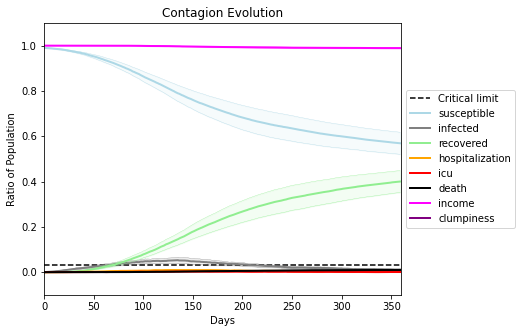

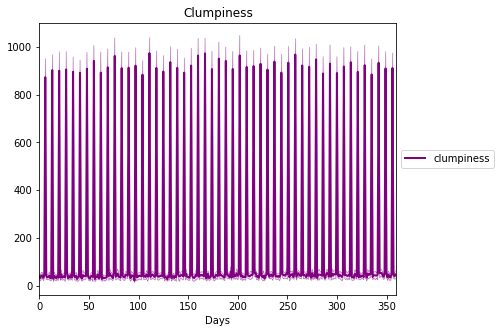

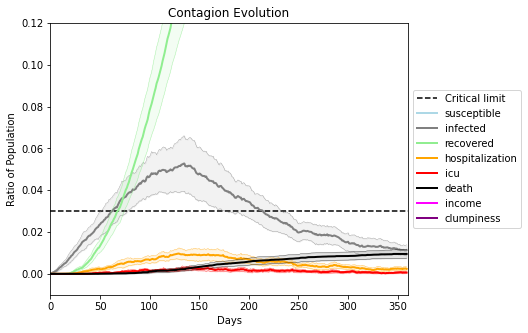

In [21]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.4
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3042, 4480, 2523, 3724, 5052, 422, 6846, 1709, 4224, 2077, 875, 5993, 3813, 2613, 5730, 8455, 826, 3355, 2145, 6242]
Average similarity between family members is 0.19276789592417454 at temperature -0.3
Average similarity between family and home is 0.9998562072530031 at temperature -1
Average similarity between students and their classroom is 0.17437817759590513 at temperature -0.3
Average classroom occupancy is 1.6077348066298343 and number classrooms is 181
Average similarity between workers is 0.15241969449902415 at temperature -0.3
Average office occupancy is 3.287878787878788 and number offices is 198
Average friend similarity for adults: 0.24236222789818423 for kids: 0.21363761913519871
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.04748120735732125
avg restaurant similarity 0.027966137109679857
avg restaurant similarity 0.03310869398807532
avg restaurant similarity 0.0930263345313463
avg restaurant similarity 0.024647281595982458
avg restaurant similarity 0.08993479323853143
avg restaurant similarity 0.05664823072973298
avg restaurant similarity 0.09941290995782728
avg restaurant similarity 0.0085941832634982
avg restaurant similarity 0.03874067337797128
avg restaurant similarity 0.09821603375668539
avg restaurant similarity 0.049024609339444705
avg restaurant similarity 0.02665451742326224
avg restaurant similarity 0.04899020946029994
avg restaurant similarity 0.05689059972086984
avg restaurant similarity 0.03914930945502904
avg restaurant similarity 0.08149956374248693
avg restaurant similarity 0.07921675274930604
avg restaurant similarity 0.0321033961662164
avg restaurant similarity 0.05336885389571933
avg restaurant similarity 0.06762778147039074
avg restaurant similarity 0.064807

avg restaurant similarity 0.0328809875192288
avg restaurant similarity 0.0866693301414079
avg restaurant similarity 0.0660337642017323
avg restaurant similarity 0.06978220676067337
avg restaurant similarity 0.01956473317475787
avg restaurant similarity 0.10612866842941769
avg restaurant similarity 0.04997337611597996
avg restaurant similarity 0.07332095297543353
avg restaurant similarity 0.05174101149000853
avg restaurant similarity 0.01305135126836532
avg restaurant similarity 0.1113892236333162
avg restaurant similarity 0.019645616242791267
avg restaurant similarity 0.027038281636308437
avg restaurant similarity 0.08756092972360002
avg restaurant similarity 0.0525388361340994
avg restaurant similarity 0.05063624395862458
avg restaurant similarity 0.00841588727738549
avg restaurant similarity 0.0016799550175716665
avg restaurant similarity 0.08248392063219709
avg restaurant similarity 0.07418622369694433
avg restaurant similarity 0.04569640728037226
avg restaurant similarity 0.0804930

avg restaurant similarity 0.11226202253989752
avg restaurant similarity 0.03559321874325244
avg restaurant similarity 0.025792615284542058
avg restaurant similarity 0.09214356039470063
avg restaurant similarity 0.012452048156709482
Average similarity between family members is 0.17110030232304926 at temperature -0.3
Average similarity between family and home is 0.9998644242811354 at temperature -1
Average similarity between students and their classroom is 0.1789585611964781 at temperature -0.3
Average classroom occupancy is 1.6592178770949721 and number classrooms is 179
Average similarity between workers is 0.14683691753052672 at temperature -0.3
Average office occupancy is 3.2028985507246377 and number offices is 207
Average friend similarity for adults: 0.24369177840677614 for kids: 0.2186454510482258
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people al

avg restaurant similarity 0.09409214896184201
avg restaurant similarity 0.12997302952717074
avg restaurant similarity 0.07002179655086031
avg restaurant similarity 0.0847080857828242
avg restaurant similarity 0.07820340841751701
avg restaurant similarity 0.059960258548141986
avg restaurant similarity 0.12419292531259626
avg restaurant similarity 0.0814370477044974
avg restaurant similarity 0.07260529555426397
avg restaurant similarity 0.08417771040925191
avg restaurant similarity 0.050457920642721095
avg restaurant similarity 0.037234792287778685
avg restaurant similarity 0.006155264480211229
avg restaurant similarity 0.00484493321114387
avg restaurant similarity 0.04117867440004581
avg restaurant similarity 0.02788317340289437
avg restaurant similarity 0.02423146039486295
avg restaurant similarity 0.04559648636411357
avg restaurant similarity 0.043682577529680314
avg restaurant similarity 0.09926253495374658
avg restaurant similarity 0.04087869195541773
avg restaurant similarity 0.122

avg restaurant similarity 0.08147703985691288
avg restaurant similarity 0.042445676112095564
avg restaurant similarity 0.03602074434388873
avg restaurant similarity 0.01565066928705409
avg restaurant similarity 0.05932394374668805
avg restaurant similarity 0.025465270683663364
avg restaurant similarity 0.0518823225759345
avg restaurant similarity 0.11871842044269153
avg restaurant similarity 0.03276431432949565
avg restaurant similarity 0.04889111191196934
avg restaurant similarity 0.1241430851624351
avg restaurant similarity 0.05933684547213545
avg restaurant similarity 0.093840317714503
avg restaurant similarity 0.06814504696660893
avg restaurant similarity 0.0920166935091751
avg restaurant similarity 0.05530857934440834
avg restaurant similarity 0.14446961628111069
avg restaurant similarity 0.0534444074935139
avg restaurant similarity 0.018074411603207594
avg restaurant similarity 0.05098234374151085
avg restaurant similarity 0.06777790918911548
avg restaurant similarity 0.070737766

avg restaurant similarity 0.0033071757527406817
avg restaurant similarity 0.11335406475052955
avg restaurant similarity 0.09701060413094455
avg restaurant similarity 0.10213096381992837
Average similarity between family members is 0.21458227731504576 at temperature -0.3
Average similarity between family and home is 0.9998610954080412 at temperature -1
Average similarity between students and their classroom is 0.17913441736217994 at temperature -0.3
Average classroom occupancy is 1.6722222222222223 and number classrooms is 180
Average similarity between workers is 0.1497757258765138 at temperature -0.3
Average office occupancy is 3.243781094527363 and number offices is 201
Average friend similarity for adults: 0.23527232580946816 for kids: 0.21288767875724765
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.08381739793141788
avg restaurant similarity 0.1161184572431419
avg restaurant similarity 0.04770462998567058
avg restaurant similarity 0.06647287528522809
avg restaurant similarity 0.0648172086767121
avg restaurant similarity 0.08214970594620039
avg restaurant similarity 0.08567560947752115
avg restaurant similarity 0.08641793018294158
avg restaurant similarity 0.07224199971812632
avg restaurant similarity 0.08310294301781357
avg restaurant similarity 0.09548016498992497
avg restaurant similarity 0.03582948490482326
avg restaurant similarity 0.07639644847972539
avg restaurant similarity 0.094807013191635
avg restaurant similarity 0.06862444336762688
avg restaurant similarity 0.04657222417478311
avg restaurant similarity 0.14038007044051487
avg restaurant similarity 0.07005017640889796
avg restaurant similarity 0.0857861177781624
avg restaurant similarity 0.007341106966531814
avg restaurant similarity 0.0782762518552559
avg restaurant similarity 0.10303663509

avg restaurant similarity 0.08453073695098985
avg restaurant similarity 0.06532751678718456
avg restaurant similarity 0.08743144209155417
avg restaurant similarity 0.0768157866181212
avg restaurant similarity 0.08890315914849899
avg restaurant similarity 0.09854578997882442
avg restaurant similarity 0.04017020979094251
avg restaurant similarity 0.07583523998442822
avg restaurant similarity 0.04957444802547473
avg restaurant similarity 0.12386290726545734
avg restaurant similarity 0.04972050268729729
avg restaurant similarity 0.11204563843810589
avg restaurant similarity 0.07855874591726103
avg restaurant similarity 0.05832484968149717
avg restaurant similarity 0.06859597653149138
avg restaurant similarity 0.077851829869447
avg restaurant similarity 0.029214188545154052
avg restaurant similarity 0.08339420777117727
avg restaurant similarity 0.06794560126953211
avg restaurant similarity 0.09759273150412144
avg restaurant similarity 0.12037479340957813
avg restaurant similarity 0.03683848

avg restaurant similarity 0.07332761608348447
avg restaurant similarity 0.10086164802917646
Average similarity between family members is 0.19574856784334946 at temperature -0.3
Average similarity between family and home is 0.9998718659037902 at temperature -1
Average similarity between students and their classroom is 0.20071404929890826 at temperature -0.3
Average classroom occupancy is 1.6187845303867403 and number classrooms is 181
Average similarity between workers is 0.15933098718982547 at temperature -0.3
Average office occupancy is 3.1642512077294684 and number offices is 207
Average friend similarity for adults: 0.2405518745284554 for kids: 0.20771941365823357
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 alloca

avg restaurant similarity 0.009035397335735768
avg restaurant similarity 0.017346074147566108
avg restaurant similarity 0.040237194622602376
avg restaurant similarity 0.03497375720405246
avg restaurant similarity 0.01755535218585715
avg restaurant similarity 0.02321654547890716
avg restaurant similarity 0.059011846987174384
avg restaurant similarity 0.018637770860001145
avg restaurant similarity 0.020854701585793226
avg restaurant similarity 0.046690113307437144
avg restaurant similarity 0.020616149173549304
avg restaurant similarity 0.06598684550523856
avg restaurant similarity 0.043220735860841186
avg restaurant similarity 0.1290126451629838
avg restaurant similarity 0.041477896867459035
avg restaurant similarity 0.09211431323122056
avg restaurant similarity 0.00741203136470905
avg restaurant similarity 0.021005151995080566
avg restaurant similarity -0.009699491608648567
avg restaurant similarity 0.05249587668260466
avg restaurant similarity 0.09655235272846682
avg restaurant similar

avg restaurant similarity 0.05798297957386248
avg restaurant similarity 0.011835745479694482
avg restaurant similarity 0.031115081600337838
avg restaurant similarity 0.06511087500475016
avg restaurant similarity 0.03356210995630107
avg restaurant similarity 0.050288173203577494
avg restaurant similarity 0.044160270462819694
avg restaurant similarity 0.055933280709264996
avg restaurant similarity 0.0840460001015862
avg restaurant similarity 0.05901414967545882
avg restaurant similarity 0.11000377459234069
avg restaurant similarity 0.03555213686020767
avg restaurant similarity 0.05258538656541527
avg restaurant similarity -0.015943291633736482
avg restaurant similarity 0.05399146860051813
avg restaurant similarity 0.048281224718780026
avg restaurant similarity -0.0016970479600976235
avg restaurant similarity 0.0774103018825793
avg restaurant similarity 0.07556657327203793
avg restaurant similarity 0.046528208267321416
avg restaurant similarity 0.015174834304074307
avg restaurant similari

avg restaurant similarity 0.0638369644218669
avg restaurant similarity 0.07094223049478213
avg restaurant similarity 0.04899616436237826
avg restaurant similarity 0.03483896735470453
avg restaurant similarity 0.04298315887051289
avg restaurant similarity 0.007311662524163987
Average similarity between family members is 0.17872163066132982 at temperature -0.3
Average similarity between family and home is 0.9998475094488127 at temperature -1
Average similarity between students and their classroom is 0.16055720775146395 at temperature -0.3
Average classroom occupancy is 1.6349206349206349 and number classrooms is 189
Average similarity between workers is 0.13902260865051932 at temperature -0.3
Average office occupancy is 3.279187817258883 and number offices is 197
Average friend similarity for adults: 0.2344701008408725 for kids: 0.21502880617909037
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with

avg restaurant similarity 0.06524535288539957
avg restaurant similarity 0.07807192119177421
avg restaurant similarity 0.06530357170120189
avg restaurant similarity 0.002569660180245979
avg restaurant similarity 0.08709905618229428
avg restaurant similarity 0.01732138591036741
avg restaurant similarity 0.07330975614547723
avg restaurant similarity 0.1130348101051432
avg restaurant similarity 0.10834335548158763
avg restaurant similarity 0.05991557281423257
avg restaurant similarity 0.09984322063483993
avg restaurant similarity 0.05300433152756138
avg restaurant similarity 0.07743856540601186
avg restaurant similarity 0.064259385654639
avg restaurant similarity 0.1377817809157468
avg restaurant similarity 0.08566419312579292
avg restaurant similarity 0.1224651955369592
avg restaurant similarity 0.043239464100085084
avg restaurant similarity 0.05049545143682381
avg restaurant similarity 0.036580418104856634
avg restaurant similarity 0.019845737306466705
avg restaurant similarity 0.0973872

avg restaurant similarity 0.03813562793093935
avg restaurant similarity 0.07554157078962523
avg restaurant similarity 0.07918697668921765
avg restaurant similarity 0.030124389315446608
avg restaurant similarity 0.0502327993419171
avg restaurant similarity 0.08254796934906845
avg restaurant similarity 0.0662429662750837
avg restaurant similarity 0.05078708475486952
avg restaurant similarity 0.10262584560347768
avg restaurant similarity 0.026612460234057625
avg restaurant similarity 0.04064319012039456
avg restaurant similarity 0.12087374076287928
avg restaurant similarity 0.04355466595815421
avg restaurant similarity 0.04419368112314664
avg restaurant similarity 0.061722248300164075
avg restaurant similarity 0.10790718121970343
avg restaurant similarity 0.05553225823146769
avg restaurant similarity 0.07076870739373722
avg restaurant similarity 0.02279222318958142
avg restaurant similarity 0.012940830957421484
avg restaurant similarity 0.03634547528868006
avg restaurant similarity 0.0641

avg restaurant similarity 0.03832851574186494
avg restaurant similarity 0.07687846602793841
avg restaurant similarity 0.0788745804917686
avg restaurant similarity 0.03518495077894471
Average similarity between family members is 0.18729395901946438 at temperature -0.3
Average similarity between family and home is 0.999856063891028 at temperature -1
Average similarity between students and their classroom is 0.1425801338507429 at temperature -0.3
Average classroom occupancy is 1.6120218579234973 and number classrooms is 183
Average similarity between workers is 0.1488268757266292 at temperature -0.3
Average office occupancy is 3.1715686274509802 and number offices is 204
Average friend similarity for adults: 0.23567548836196298 for kids: 0.2103747099459429
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.07034310589005076
avg restaurant similarity 0.07438474089074087
avg restaurant similarity 0.051183749363409727
avg restaurant similarity 0.03504649150843992
avg restaurant similarity 0.06304462656591311
avg restaurant similarity 0.008005356677432586
avg restaurant similarity 0.03175733323194677
avg restaurant similarity 0.03164415624189867
avg restaurant similarity 0.031911764963625244
avg restaurant similarity 0.04862753187444033
avg restaurant similarity 0.03166005256673781
avg restaurant similarity 0.062304072280280884
avg restaurant similarity 0.07248054685829475
avg restaurant similarity 0.050210058736230044
avg restaurant similarity 0.08405868738316773
avg restaurant similarity 0.0889130964126846
avg restaurant similarity 0.06336708269570371
avg restaurant similarity 0.08217951244771353
avg restaurant similarity 0.027011618000987562
avg restaurant similarity 0.031370514988435114
avg restaurant similarity 0.07575187164677295
avg restaurant similarity 0.

avg restaurant similarity 0.06169755218036509
avg restaurant similarity 0.054699362704774775
avg restaurant similarity 0.055290124320066816
avg restaurant similarity 0.054897073030111015
avg restaurant similarity -0.0058218632704734805
avg restaurant similarity 0.03592583780057194
avg restaurant similarity 0.06899388881444522
avg restaurant similarity 0.04412159519461312
avg restaurant similarity 0.12849625578103693
avg restaurant similarity 0.01125586888792798
avg restaurant similarity 0.0653512388235107
avg restaurant similarity 0.04217596881468438
avg restaurant similarity 0.043469058924567615
avg restaurant similarity 0.013585000747666191
avg restaurant similarity 0.03484020772791434
avg restaurant similarity 0.05784756039084506
avg restaurant similarity 0.018200578666110117
avg restaurant similarity 0.0305620797730724
avg restaurant similarity 0.0667449568982389
avg restaurant similarity 0.02682800123660748
avg restaurant similarity 0.024380087350333573
avg restaurant similarity 0

avg restaurant similarity 0.07008492022812088
avg restaurant similarity 0.06007567020223981
avg restaurant similarity 0.014908953526163159
avg restaurant similarity 0.06448443992245219
avg restaurant similarity 0.00433195207965136
Average similarity between family members is 0.21626008908728056 at temperature -0.3
Average similarity between family and home is 0.9998559994934174 at temperature -1
Average similarity between students and their classroom is 0.15375860579527806 at temperature -0.3
Average classroom occupancy is 1.5657142857142856 and number classrooms is 175
Average similarity between workers is 0.1489254984984352 at temperature -0.3
Average office occupancy is 3.451776649746193 and number offices is 197
Average friend similarity for adults: 0.2555840099068981 for kids: 0.20657608890020213
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allo

avg restaurant similarity 0.0765640465938032
avg restaurant similarity 0.07218657764188412
avg restaurant similarity 0.07716233896792567
avg restaurant similarity 0.08445804198333999
avg restaurant similarity 0.04374506482745009
avg restaurant similarity 0.06725602125987962
avg restaurant similarity 0.06463151297834795
avg restaurant similarity 0.0788463690958378
avg restaurant similarity 0.02990988741256117
avg restaurant similarity 0.08486109425156167
avg restaurant similarity 0.05592549661756303
avg restaurant similarity 0.06332258331354186
avg restaurant similarity 0.06273560141976443
avg restaurant similarity 0.09252217161045188
avg restaurant similarity 0.09032495238901771
avg restaurant similarity 0.06329038035874933
avg restaurant similarity 0.04209764101707721
avg restaurant similarity 0.06056238221279453
avg restaurant similarity 0.04853921472387362
avg restaurant similarity 0.13243809196485792
avg restaurant similarity 0.06523690253863364
avg restaurant similarity 0.02977655

avg restaurant similarity 0.02630976091232079
avg restaurant similarity 0.08380114054709453
avg restaurant similarity 0.03370889464427531
avg restaurant similarity 0.063454907173801
avg restaurant similarity 0.03705389701988957
avg restaurant similarity 0.06976918798824673
avg restaurant similarity 0.10617728489534684
avg restaurant similarity 0.04357321158112931
avg restaurant similarity 0.06971626058286381
avg restaurant similarity 0.07169074930877972
avg restaurant similarity 0.06619981489527815
avg restaurant similarity 0.0826629747385398
avg restaurant similarity 0.04537705056978669
avg restaurant similarity 0.07774047476150125
avg restaurant similarity 0.02845783229566479
avg restaurant similarity 0.06521536729843913
avg restaurant similarity 0.049203772752510457
avg restaurant similarity 0.08716578620456443
avg restaurant similarity 0.046107819856987003
avg restaurant similarity 0.07919003796374818
avg restaurant similarity 0.03380967542812012
avg restaurant similarity 0.0710120

avg restaurant similarity 0.027639201035723593
avg restaurant similarity 0.05434263009276333
avg restaurant similarity 0.05970613011351209
Average similarity between family members is 0.18540442832787074 at temperature -0.3
Average similarity between family and home is 0.9998610059475966 at temperature -1
Average similarity between students and their classroom is 0.1639250472410883 at temperature -0.3
Average classroom occupancy is 1.5977011494252873 and number classrooms is 174
Average similarity between workers is 0.14442807138294447 at temperature -0.3
Average office occupancy is 3.3284313725490198 and number offices is 204
Average friend similarity for adults: 0.2486610281918938 for kids: 0.20427172742006938
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 uni

avg restaurant similarity 0.024474091898042526
avg restaurant similarity 0.08661891005618301
avg restaurant similarity 0.039046655080185844
avg restaurant similarity 0.10212464650262362
avg restaurant similarity 0.04613245194474938
avg restaurant similarity 0.014282105270130487
avg restaurant similarity 0.06381189357161669
avg restaurant similarity 0.038835845766328043
avg restaurant similarity 0.0798985922216269
avg restaurant similarity 0.11812705699793494
avg restaurant similarity 0.10057583500274209
avg restaurant similarity 0.09703566577234074
avg restaurant similarity 0.029383403668756396
avg restaurant similarity 0.06270419207026796
avg restaurant similarity 0.039496434597704175
avg restaurant similarity 0.10265468079249696
avg restaurant similarity 0.06965093144587028
avg restaurant similarity 0.08391568200765946
avg restaurant similarity 0.09058016071580835
avg restaurant similarity 0.07933054600993322
avg restaurant similarity 0.09243643989385508
avg restaurant similarity 0.0

avg restaurant similarity 0.1154350962596872
avg restaurant similarity 0.08544693982487701
avg restaurant similarity 0.04857705895758909
avg restaurant similarity 0.07637102444827597
avg restaurant similarity 0.023924916481908302
avg restaurant similarity 0.034392467300470214
avg restaurant similarity 0.09785898529930456
avg restaurant similarity 0.027687884144327296
avg restaurant similarity 0.1410001141102874
avg restaurant similarity 0.025397054311270314
avg restaurant similarity 0.1232493785328193
avg restaurant similarity 0.06737532307769317
avg restaurant similarity 0.029667362561907756
avg restaurant similarity 0.05525726923278558
avg restaurant similarity 0.07345425670585379
avg restaurant similarity 0.05176336982455555
avg restaurant similarity 0.05284315416858127
avg restaurant similarity 0.030014274332343847
avg restaurant similarity 0.10666918816679484
avg restaurant similarity 0.051580235340646804
avg restaurant similarity 0.07942124477391642
avg restaurant similarity 0.06

avg restaurant similarity 0.05965025417575668
avg restaurant similarity 0.026395101050420332
avg restaurant similarity 0.03418306313945753
avg restaurant similarity 0.09203704334054609
Average similarity between family members is 0.1979594636674443 at temperature -0.3
Average similarity between family and home is 0.9998482645305903 at temperature -1
Average similarity between students and their classroom is 0.1493213908379907 at temperature -0.3
Average classroom occupancy is 1.6153846153846154 and number classrooms is 169
Average similarity between workers is 0.15260265958178187 at temperature -0.3
Average office occupancy is 3.3737373737373737 and number offices is 198
Average friend similarity for adults: 0.2498971806839404 for kids: 0.20780458170531343
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.04869062638269063
avg restaurant similarity 0.1159598980173082
avg restaurant similarity 0.11763976120170751
avg restaurant similarity 0.08113407852219949
avg restaurant similarity 0.05254334995918134
avg restaurant similarity 0.05331644705929585
avg restaurant similarity 0.02733716993338327
avg restaurant similarity 0.024946649094327828
avg restaurant similarity 0.07758555746592274
avg restaurant similarity 0.08902095081990025
avg restaurant similarity 0.11121228161409671
avg restaurant similarity 0.02368597765301244
avg restaurant similarity 0.11438095825740013
avg restaurant similarity 0.07180169395800141
avg restaurant similarity 0.07680607536498356
avg restaurant similarity 0.05099053547675688
avg restaurant similarity 0.03361983479853598
avg restaurant similarity 0.11479028195756859
avg restaurant similarity 0.06096334148120218
avg restaurant similarity 0.11263139693080906
avg restaurant similarity 0.08165420335351124
avg restaurant similarity 0.025081

avg restaurant similarity -0.007836165019152956
avg restaurant similarity 0.09559031118038772
avg restaurant similarity 0.01758661406503751
avg restaurant similarity 0.1208094563016943
avg restaurant similarity 0.07631146156717239
avg restaurant similarity 0.06869369742600497
avg restaurant similarity 0.08336648600931243
avg restaurant similarity 0.07217771518687964
avg restaurant similarity 0.11626621032138881
avg restaurant similarity 0.07136258101416677
avg restaurant similarity 0.11422551598455061
avg restaurant similarity 0.11919301939905194
avg restaurant similarity 0.05982830949037872
avg restaurant similarity 0.07911038899913869
avg restaurant similarity 0.0780188490883446
avg restaurant similarity 0.018788169861467984
avg restaurant similarity 0.12102859082080025
avg restaurant similarity 0.03778258772602943
avg restaurant similarity -0.0069116617996112534
avg restaurant similarity 0.0358202087403819
avg restaurant similarity 0.01418721967154844
avg restaurant similarity 0.063

avg restaurant similarity 0.08879594538725827
avg restaurant similarity 0.045996649073017815
avg restaurant similarity 0.06060157881709907
avg restaurant similarity 0.07566674256011154
Average similarity between family members is 0.22331837391337692 at temperature -0.3
Average similarity between family and home is 0.9998651099054268 at temperature -1
Average similarity between students and their classroom is 0.1761853736851505 at temperature -0.3
Average classroom occupancy is 1.5363128491620113 and number classrooms is 179
Average similarity between workers is 0.17023536631778802 at temperature -0.3
Average office occupancy is 3.35 and number offices is 200
Average friend similarity for adults: 0.25314722984684074 for kids: 0.21461902192531404
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buil

avg restaurant similarity 0.0835536131857491
avg restaurant similarity 0.034810316692815195
avg restaurant similarity 0.06446797132135998
avg restaurant similarity 0.009811161352259404
avg restaurant similarity 0.05924421221153221
avg restaurant similarity 0.10879317265550943
avg restaurant similarity 0.07023089684561296
avg restaurant similarity 0.013771546179213378
avg restaurant similarity 0.09373837843354059
avg restaurant similarity 0.09772391953358066
avg restaurant similarity 0.020279782867017232
avg restaurant similarity 0.05949253128040106
avg restaurant similarity 0.04818023547081368
avg restaurant similarity 0.034316809984277
avg restaurant similarity 0.018850125494355593
avg restaurant similarity 0.08798628616123172
avg restaurant similarity 0.046765047022343666
avg restaurant similarity 0.07024033878700353
avg restaurant similarity 0.1215866491148343
avg restaurant similarity 0.052965498157155094
avg restaurant similarity 0.08398925149839215
avg restaurant similarity 0.034

avg restaurant similarity 0.046981790268233715
avg restaurant similarity 0.08535961916604445
avg restaurant similarity 0.07158375214976642
avg restaurant similarity 0.060844920268249836
avg restaurant similarity 0.06423962038748929
avg restaurant similarity 0.046952329086116656
avg restaurant similarity 0.09328121211664016
avg restaurant similarity 0.03564507260800811
avg restaurant similarity 0.04026554555395645
avg restaurant similarity 0.03645815034240837
avg restaurant similarity 0.07769395256727432
avg restaurant similarity 0.12552270432150175
avg restaurant similarity 0.03604277492891754
avg restaurant similarity 0.08121181232136614
avg restaurant similarity 0.09367674331798843
avg restaurant similarity 0.09626292533605665
avg restaurant similarity 0.07796578624674302
avg restaurant similarity 0.10980022273158242
avg restaurant similarity 0.044345486012155697
avg restaurant similarity 0.06806338129792207
avg restaurant similarity 0.09528083056628377
avg restaurant similarity 0.03

avg restaurant similarity 0.06353708390351125
avg restaurant similarity 0.09914409622631179
avg restaurant similarity 0.09379211816804345
avg restaurant similarity 0.02602033732453335
Average similarity between family members is 0.20439445551016108 at temperature -0.3
Average similarity between family and home is 0.9998647226699583 at temperature -1
Average similarity between students and their classroom is 0.1347465371332619 at temperature -0.3
Average classroom occupancy is 1.5363128491620113 and number classrooms is 179
Average similarity between workers is 0.15949741493408856 at temperature -0.3
Average office occupancy is 3.3686868686868685 and number offices is 198
Average friend similarity for adults: 0.2504324093556888 for kids: 0.20774236635035476
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.1087508011476019
avg restaurant similarity 0.05748226035588455
avg restaurant similarity 0.05725639271100052
avg restaurant similarity 0.032063592606764175
avg restaurant similarity 0.10394514883691726
avg restaurant similarity 0.09063152774868405
avg restaurant similarity 0.03942577282194795
avg restaurant similarity 0.0685201938486166
avg restaurant similarity 0.07433108561524736
avg restaurant similarity 0.05450831219757119
avg restaurant similarity 0.09971543298000704
avg restaurant similarity 0.049924638344432934
avg restaurant similarity 0.07434381046164316
avg restaurant similarity 0.06880095228192201
avg restaurant similarity 0.07139152027912733
avg restaurant similarity 0.08873383030554073
avg restaurant similarity 0.06794864586675982
avg restaurant similarity 0.05479157510843258
avg restaurant similarity 0.09609676386237376
avg restaurant similarity 0.0688986733254915
avg restaurant similarity 0.06124897062452749
avg restaurant similarity 0.0996270

avg restaurant similarity 0.050467155981258
avg restaurant similarity 0.04759025605988657
avg restaurant similarity 0.03963628044562635
avg restaurant similarity 0.04061624084133575
avg restaurant similarity 0.06343827174579375
avg restaurant similarity 0.09832320348290836
avg restaurant similarity 0.07547533239096627
avg restaurant similarity 0.05909715585380168
avg restaurant similarity 0.09326598213105342
avg restaurant similarity 0.04098048370613297
avg restaurant similarity 0.09210339824061649
avg restaurant similarity 0.08954586246506947
avg restaurant similarity 0.05807724654483421
avg restaurant similarity 0.07364327438130219
avg restaurant similarity 0.058031111713257
avg restaurant similarity 0.04575885373377643
avg restaurant similarity 0.08143546848066512
avg restaurant similarity 0.012663472544197954
avg restaurant similarity 0.07486424751665145
avg restaurant similarity 0.07212057825084225
avg restaurant similarity 0.03139904690641566
avg restaurant similarity 0.047679710

avg restaurant similarity 0.07048997044309505
avg restaurant similarity 0.05657786487898536
avg restaurant similarity 0.0454871683569806
Average similarity between family members is 0.19950858606759392 at temperature -0.3
Average similarity between family and home is 0.999857026449648 at temperature -1
Average similarity between students and their classroom is 0.18871478032529906 at temperature -0.3
Average classroom occupancy is 1.7597765363128492 and number classrooms is 179
Average similarity between workers is 0.1698887471365235 at temperature -0.3
Average office occupancy is 3.1818181818181817 and number offices is 198
Average friend similarity for adults: 0.23675823857587988 for kids: 0.20909439283918582
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity 0.050983926636610624
avg restaurant similarity 0.04429793849502868
avg restaurant similarity 0.06484757543434713
avg restaurant similarity 0.11313854165112479
avg restaurant similarity 0.11162826620403722
avg restaurant similarity 0.020732251717488288
avg restaurant similarity 0.0642374884769165
avg restaurant similarity 0.052458707446795094
avg restaurant similarity 0.06103871296078346
avg restaurant similarity 0.088640351169321
avg restaurant similarity 0.04703170967920025
avg restaurant similarity 0.06757257828288295
avg restaurant similarity 0.06180526753551997
avg restaurant similarity 0.06692303826518954
avg restaurant similarity 0.0755082491066553
avg restaurant similarity 0.03527562446840827
avg restaurant similarity 0.05716149935843103
avg restaurant similarity 0.054670601415455565
avg restaurant similarity 0.024144381439514195
avg restaurant similarity 0.12368104898123454
avg restaurant similarity 0.08390837874502265
avg restaurant similarity 0.08264

avg restaurant similarity 0.05267964381237244
avg restaurant similarity 0.06569856449334406
avg restaurant similarity 0.026128346320876683
avg restaurant similarity -0.008998686728748805
avg restaurant similarity 0.04903422143880255
avg restaurant similarity -0.0038989390397896197
avg restaurant similarity 0.07812908502060431
avg restaurant similarity 0.05007643171517119
avg restaurant similarity 0.05000219282328756
avg restaurant similarity 0.08229850440438606
avg restaurant similarity 0.06950285230888474
avg restaurant similarity 0.08922864320737875
avg restaurant similarity 0.04596917390909672
avg restaurant similarity 0.06723149812976548
avg restaurant similarity 0.04674528772077143
avg restaurant similarity 0.04860388082274662
avg restaurant similarity 0.027837893295553372
avg restaurant similarity 0.047506528945880526
avg restaurant similarity 0.04696987854397685
avg restaurant similarity 0.09491250037674802
avg restaurant similarity -0.006254618159352096
avg restaurant similarit

avg restaurant similarity 0.07895200895844523
avg restaurant similarity 0.03111627484717153
avg restaurant similarity 0.054490612319080346
avg restaurant similarity 0.04953994841236547
Average similarity between family members is 0.20048193646237852 at temperature -0.3
Average similarity between family and home is 0.9998611096294212 at temperature -1
Average similarity between students and their classroom is 0.13785863499809092 at temperature -0.3
Average classroom occupancy is 1.597938144329897 and number classrooms is 194
Average similarity between workers is 0.16844779632861812 at temperature -0.3
Average office occupancy is 3.2436548223350252 and number offices is 197
Average friend similarity for adults: 0.23537068766078179 for kids: 0.2094364001198409
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.045668975929588296
avg restaurant similarity 0.049084125986338614
avg restaurant similarity 0.03725451103610916
avg restaurant similarity 0.07057986339374216
avg restaurant similarity 0.061114606201415234
avg restaurant similarity 0.02859625147886804
avg restaurant similarity 0.05069706287097355
avg restaurant similarity 0.04670327478838666
avg restaurant similarity 0.06448272227741329
avg restaurant similarity 0.05016723777688646
avg restaurant similarity 0.09979807553927755
avg restaurant similarity 0.03681754346928148
avg restaurant similarity 0.0796675716128608
avg restaurant similarity 0.0504034790279222
avg restaurant similarity 0.09198694321879158
avg restaurant similarity 0.10947814931703301
avg restaurant similarity 0.06703304216303957
avg restaurant similarity 0.07997358908634132
avg restaurant similarity 0.027050912801491918
avg restaurant similarity 0.05047891038497053
avg restaurant similarity 0.05550405129099773
avg restaurant similarity 0.0613

avg restaurant similarity 0.047627449202536656
avg restaurant similarity 0.03140422168784114
avg restaurant similarity 0.03605158509009495
avg restaurant similarity 0.03148913654315687
avg restaurant similarity 0.028739238086973658
avg restaurant similarity 0.06404580439244506
avg restaurant similarity 0.031219215063463757
avg restaurant similarity 0.07922020714843586
avg restaurant similarity 0.009603301099207758
avg restaurant similarity 0.04484536099778895
avg restaurant similarity 0.03668515131208096
avg restaurant similarity 0.057682632344557824
avg restaurant similarity 0.061580861359831277
avg restaurant similarity 0.042629828344057444
avg restaurant similarity 0.05178950923131669
avg restaurant similarity 0.12699507347605626
avg restaurant similarity 0.05779941691323991
avg restaurant similarity 0.0197710013757209
avg restaurant similarity 0.058070014797872445
avg restaurant similarity 0.05285658668682656
avg restaurant similarity 0.045537856196309165
avg restaurant similarity 

avg restaurant similarity 0.030229702626019962
avg restaurant similarity 0.06764379957792703
avg restaurant similarity 0.04170183451024676
avg restaurant similarity 0.09519150474441104
Average similarity between family members is 0.18183303704509834 at temperature -0.3
Average similarity between family and home is 0.99985772281662 at temperature -1
Average similarity between students and their classroom is 0.14768663915783892 at temperature -0.3
Average classroom occupancy is 1.5561797752808988 and number classrooms is 178
Average similarity between workers is 0.1352476400406803 at temperature -0.3
Average office occupancy is 3.385 and number offices is 200
Average friend similarity for adults: 0.24492399842214366 for kids: 0.21463790300245872
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.031845455130741475
avg restaurant similarity 0.092738659159178
avg restaurant similarity 0.03408806071423225
avg restaurant similarity 0.08182137095137558
avg restaurant similarity 0.06269480602419099
avg restaurant similarity 0.10132408071462147
avg restaurant similarity 0.04813015143653286
avg restaurant similarity 0.058320756986774934
avg restaurant similarity 0.12805543028527114
avg restaurant similarity 0.05288775202945275
avg restaurant similarity 0.07849239842262619
avg restaurant similarity 0.0914422189650393
avg restaurant similarity 0.05401799135826677
avg restaurant similarity 0.14284303088259756
avg restaurant similarity 0.06293624585887006
avg restaurant similarity 0.07104217532657935
avg restaurant similarity 0.06786554718176306
avg restaurant similarity 0.07454779962801608
avg restaurant similarity 0.08448298610309923
avg restaurant similarity 0.060406107995355146
avg restaurant similarity 0.06945906399131935
avg restaurant similarity 0.064770

avg restaurant similarity 0.05722299289189202
avg restaurant similarity 0.04915427143411056
avg restaurant similarity 0.11354441795865094
avg restaurant similarity 0.016268758491125326
avg restaurant similarity 0.06392348936974346
avg restaurant similarity 0.04421391361154881
avg restaurant similarity 0.05097464700887338
avg restaurant similarity 0.06050866131746567
avg restaurant similarity 0.09099677116972732
avg restaurant similarity 0.08890316715581349
avg restaurant similarity 0.06856488692403655
avg restaurant similarity 0.03721126321261154
avg restaurant similarity 0.045185827833825576
avg restaurant similarity 0.08430366746182406
avg restaurant similarity 0.05712180749567983
avg restaurant similarity 0.02629979821471218
avg restaurant similarity 0.08618381496949257
avg restaurant similarity 0.1022706652497345
avg restaurant similarity 0.08619986947094527
avg restaurant similarity 0.07230251021996552
avg restaurant similarity 0.09738556288244592
avg restaurant similarity 0.12589

avg restaurant similarity 0.04856250873994194
avg restaurant similarity 0.05861687999375414
avg restaurant similarity 0.04056805564307856
Average similarity between family members is 0.19801321740015781 at temperature -0.3
Average similarity between family and home is 0.9998500389623254 at temperature -1
Average similarity between students and their classroom is 0.14646175245641754 at temperature -0.3
Average classroom occupancy is 1.6271186440677967 and number classrooms is 177
Average similarity between workers is 0.14607972351482465 at temperature -0.3
Average office occupancy is 3.285 and number offices is 200
Average friend similarity for adults: 0.2446115850274519 for kids: 0.21154360719073917
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with

avg restaurant similarity 0.08426791241343291
avg restaurant similarity 0.11578653362029556
avg restaurant similarity 0.07121882824814403
avg restaurant similarity 0.04335522865102933
avg restaurant similarity 0.0746163662898223
avg restaurant similarity 0.12007749305307122
avg restaurant similarity 0.09831885166150735
avg restaurant similarity 0.09709921902719602
avg restaurant similarity 0.09061563900196311
avg restaurant similarity 0.03911388257478036
avg restaurant similarity 0.05905857968756754
avg restaurant similarity 0.07771616253627583
avg restaurant similarity 0.0793937364189791
avg restaurant similarity 0.06905366694721073
avg restaurant similarity 0.06176420839749139
avg restaurant similarity 0.04568251959953114
avg restaurant similarity 0.08170173828086441
avg restaurant similarity 0.05031595417235118
avg restaurant similarity 0.029302284619877956
avg restaurant similarity 0.06653610680825565
avg restaurant similarity 0.036364558162396955
avg restaurant similarity 0.085555

avg restaurant similarity 0.07232717622023396
avg restaurant similarity 0.06118411479311878
avg restaurant similarity 0.0936133785851164
avg restaurant similarity 0.04817330308487366
avg restaurant similarity 0.0785870739843414
avg restaurant similarity 0.06376029401021417
avg restaurant similarity 0.11485873652250708
avg restaurant similarity 0.059258370341984605
avg restaurant similarity 0.12029416378715944
avg restaurant similarity 0.08444465541227195
avg restaurant similarity 0.1061304930514569
avg restaurant similarity 0.04435594404698009
avg restaurant similarity 0.0506664351173842
avg restaurant similarity 0.06576286412039221
avg restaurant similarity 0.06319569320517383
avg restaurant similarity 0.12362334857490202
avg restaurant similarity 0.10060619040274815
avg restaurant similarity 0.030355562759899965
avg restaurant similarity 0.12792901746989224
avg restaurant similarity 0.034858129929004854
avg restaurant similarity 0.09360521243556819
avg restaurant similarity 0.0550644

avg restaurant similarity 0.07087825137477631
avg restaurant similarity 0.0862299362025217
Average similarity between family members is 0.1869059701433371 at temperature -0.3
Average similarity between family and home is 0.9998568357828796 at temperature -1
Average similarity between students and their classroom is 0.18190932591650072 at temperature -0.3
Average classroom occupancy is 1.595959595959596 and number classrooms is 198
Average similarity between workers is 0.1651165731377583 at temperature -0.3
Average office occupancy is 3.1683168316831685 and number offices is 202
Average friend similarity for adults: 0.2392303879895393 for kids: 0.22319797353321033
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated 

avg restaurant similarity 0.0280648501651267
avg restaurant similarity 0.07329346545716996
avg restaurant similarity 0.07753423677882311
avg restaurant similarity 0.035693433504866486
avg restaurant similarity 0.09114283241924263
avg restaurant similarity 0.08805904810100178
avg restaurant similarity 0.08176126984023818
avg restaurant similarity 0.0790040294725438
avg restaurant similarity 0.0777879780405609
avg restaurant similarity 0.08627360486349112
avg restaurant similarity 0.05667509985101498
avg restaurant similarity 0.051251334142894005
avg restaurant similarity 0.0960784961122839
avg restaurant similarity 0.06669437325214779
avg restaurant similarity 0.05183325181855602
avg restaurant similarity 0.10503463886798865
avg restaurant similarity 0.08820398982251974
avg restaurant similarity 0.06999249568733021
avg restaurant similarity 0.06247923791563053
avg restaurant similarity 0.040089143703266356
avg restaurant similarity 0.07708225269221668
avg restaurant similarity 0.1095649

avg restaurant similarity 0.05723684960757448
avg restaurant similarity 0.08460348487249492
avg restaurant similarity 0.0297738373597398
avg restaurant similarity 0.07531398742006551
avg restaurant similarity 0.0855195358226651
avg restaurant similarity 0.09968301385138242
avg restaurant similarity 0.039905178536095556
avg restaurant similarity 0.03529508665520445
avg restaurant similarity 0.036479779600231216
avg restaurant similarity 0.0650512545674504
avg restaurant similarity 0.10480997322611375
avg restaurant similarity 0.04903231502946656
avg restaurant similarity 0.061155720667703
avg restaurant similarity 0.059153941239422754
avg restaurant similarity 0.08733897454863823
avg restaurant similarity 0.007481339601303727
avg restaurant similarity 0.07919400889312685
avg restaurant similarity 0.015746127430610015
avg restaurant similarity 0.08264871705837694
avg restaurant similarity 0.028526512587422892
avg restaurant similarity 0.12789313635021374
avg restaurant similarity 0.07144

avg restaurant similarity 0.0890105041094583
avg restaurant similarity 0.13206201510667442
avg restaurant similarity 0.08608031767470528
avg restaurant similarity 0.11413455822110635
Average similarity between family members is 0.1986916405048784 at temperature -0.3
Average similarity between family and home is 0.999855931732587 at temperature -1
Average similarity between students and their classroom is 0.17242672921811497 at temperature -0.3
Average classroom occupancy is 1.565934065934066 and number classrooms is 182
Average similarity between workers is 0.1565025359041263 at temperature -0.3
Average office occupancy is 3.27363184079602 and number offices is 201
Average friend similarity for adults: 0.2497050204162743 for kids: 0.2149621484425714
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 B

avg restaurant similarity 0.06272872586670819
avg restaurant similarity 0.04808915155083178
avg restaurant similarity 0.05674475500358045
avg restaurant similarity 0.109640044007804
avg restaurant similarity 0.03753169336034939
avg restaurant similarity 0.1183579740987371
avg restaurant similarity 0.09539581440775771
avg restaurant similarity 0.08516004579917398
avg restaurant similarity 0.09611682725765658
avg restaurant similarity 0.054431644705804506
avg restaurant similarity 0.07280590817363176
avg restaurant similarity 0.10470973400430376
avg restaurant similarity 0.04102216453402579
avg restaurant similarity 0.07380515356365608
avg restaurant similarity 0.09630734044818565
avg restaurant similarity 0.029489549191153253
avg restaurant similarity 0.07261096173113028
avg restaurant similarity 0.12437192233591467
avg restaurant similarity 0.1052773229599548
avg restaurant similarity 0.06191842229635411
avg restaurant similarity 0.08033094212149089
avg restaurant similarity 0.05708641

avg restaurant similarity 0.045845498257032165
avg restaurant similarity 0.09605043438046713
avg restaurant similarity 0.09221252947939222
avg restaurant similarity 0.09693138127022016
avg restaurant similarity 0.13083354773969824
avg restaurant similarity 0.06991569681961833
avg restaurant similarity 0.06346869605491957
avg restaurant similarity 0.10417284372585364
avg restaurant similarity 0.03328617676036669
avg restaurant similarity 0.04782818916286166
avg restaurant similarity 0.052661386676483436
avg restaurant similarity 0.07986279534959408
avg restaurant similarity 0.09040343144629275
avg restaurant similarity 0.10236957708970386
avg restaurant similarity 0.08764002369223321
avg restaurant similarity 0.11316807048798709
avg restaurant similarity 0.035886664753216835
avg restaurant similarity 0.09434933040912873
avg restaurant similarity 0.11527046137939823
avg restaurant similarity 0.09581695700033029
avg restaurant similarity 0.07821594787211711
avg restaurant similarity 0.087

avg restaurant similarity 0.035208229151206416
avg restaurant similarity 0.08677305537656319
Average similarity between family members is 0.2087473545671138 at temperature -0.3
Average similarity between family and home is 0.9998445529031639 at temperature -1
Average similarity between students and their classroom is 0.18029300889604533 at temperature -0.3
Average classroom occupancy is 1.5638297872340425 and number classrooms is 188
Average similarity between workers is 0.16164875068095896 at temperature -0.3
Average office occupancy is 3.2474747474747474 and number offices is 198
Average friend similarity for adults: 0.23756555456240158 for kids: 0.20651821620795222
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.09148785838626187
avg restaurant similarity 0.04226938107861226
avg restaurant similarity 0.11001352870977692
avg restaurant similarity 0.06271398827599853
avg restaurant similarity 0.07000848343163686
avg restaurant similarity 0.02048682407063029
avg restaurant similarity 0.06448938804058338
avg restaurant similarity 0.05050026291884409
avg restaurant similarity 0.06461111832047901
avg restaurant similarity 0.08852197813650793
avg restaurant similarity 0.023171195906481153
avg restaurant similarity 0.08907734331336886
avg restaurant similarity 0.0899527411605001
avg restaurant similarity 0.07654743993321146
avg restaurant similarity 0.072872405816652
avg restaurant similarity 0.09139660214683643
avg restaurant similarity 0.08765579441123006
avg restaurant similarity 0.06211468377751512
avg restaurant similarity 0.10284735310992163
avg restaurant similarity 0.07574964608560755
avg restaurant similarity 0.10655723027623148
avg restaurant similarity 0.11046209

avg restaurant similarity 0.06653899896122371
avg restaurant similarity 0.04545582422345127
avg restaurant similarity 0.08133896626507134
avg restaurant similarity 0.10398453906515141
avg restaurant similarity 0.10083148047022002
avg restaurant similarity 0.0851701454342846
avg restaurant similarity 0.06686179697747414
avg restaurant similarity 0.0833444115095054
avg restaurant similarity 0.03959981201490994
avg restaurant similarity 0.11048653213671465
avg restaurant similarity 0.06769253966709517
avg restaurant similarity 0.0660633432607396
avg restaurant similarity 0.09256655142256624
avg restaurant similarity 0.04183095173460996
avg restaurant similarity 0.10866881017588292
avg restaurant similarity 0.07550750876904597
avg restaurant similarity 0.07071305633864086
avg restaurant similarity 0.07113669301709467
avg restaurant similarity 0.07100642665147233
avg restaurant similarity 0.04264898778140268
avg restaurant similarity 0.06646476027026099
avg restaurant similarity 0.096445057

avg restaurant similarity 0.0856999117801084
avg restaurant similarity 0.08890908377155621
avg restaurant similarity 0.052818264127882444
Average similarity between family members is 0.20399718201869405 at temperature -0.3
Average similarity between family and home is 0.9998509148456449 at temperature -1
Average similarity between students and their classroom is 0.16964128700583578 at temperature -0.3
Average classroom occupancy is 1.5572916666666667 and number classrooms is 192
Average similarity between workers is 0.13623037305657262 at temperature -0.3
Average office occupancy is 3.2373737373737375 and number offices is 198
Average friend similarity for adults: 0.24609214240171687 for kids: 0.20784251168505838
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 un

avg restaurant similarity 0.09456832102802455
avg restaurant similarity 0.027988178264739323
avg restaurant similarity 0.08502099482105008
avg restaurant similarity 0.09972720572771532
avg restaurant similarity 0.07496105040053219
avg restaurant similarity 0.09523796414681483
avg restaurant similarity 0.06866763173517497
avg restaurant similarity 0.11233474178438253
avg restaurant similarity 0.066816640987357
avg restaurant similarity 0.10244437186202165
avg restaurant similarity 0.024589967176771255
avg restaurant similarity 0.027101940654602058
avg restaurant similarity 0.03961158914516744
avg restaurant similarity 0.06086714800637442
avg restaurant similarity 0.10859451087046645
avg restaurant similarity 0.06952957025860046
avg restaurant similarity 0.026467281035998103
avg restaurant similarity 0.030403644151902855
avg restaurant similarity 0.09915178975465923
avg restaurant similarity 0.09713151069993878
avg restaurant similarity 0.09271883622188956
avg restaurant similarity 0.078

avg restaurant similarity 0.0360310719302085
avg restaurant similarity 0.05533351563424699
avg restaurant similarity 0.10264646540401877
avg restaurant similarity 0.10624788039640154
avg restaurant similarity 0.061381506484135324
avg restaurant similarity 0.056519018356573476
avg restaurant similarity 0.07686488640451009
avg restaurant similarity 0.10573140680310425
avg restaurant similarity 0.06397328021548156
avg restaurant similarity 0.07240249012957636
avg restaurant similarity 0.08901756131889235
avg restaurant similarity 0.12667850365379385
avg restaurant similarity 0.07696956805863929
avg restaurant similarity 0.04445463315845309
avg restaurant similarity 0.05869931089078605
avg restaurant similarity 0.08353594466377653
avg restaurant similarity 0.06619303401977836
avg restaurant similarity 0.09594146430188036
avg restaurant similarity 0.07529433696105634
avg restaurant similarity 0.05459213615847102
avg restaurant similarity 0.10754894589690978
avg restaurant similarity 0.11368

avg restaurant similarity 0.07879655658067068
avg restaurant similarity 0.03215428147932712
avg restaurant similarity 0.07057426750172446
avg restaurant similarity 0.054511294539703076
Average similarity between family members is 0.1753177975244646 at temperature -0.3
Average similarity between family and home is 0.9998581327915027 at temperature -1
Average similarity between students and their classroom is 0.16386216024179256 at temperature -0.3
Average classroom occupancy is 1.5921787709497206 and number classrooms is 179
Average similarity between workers is 0.15096688104889291 at temperature -0.3
Average office occupancy is 3.262376237623762 and number offices is 202
Average friend similarity for adults: 0.23322431124231188 for kids: 0.20902829927043667
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.043067794847946865
avg restaurant similarity 0.07624726861343276
avg restaurant similarity 0.06212945377565259
avg restaurant similarity 0.04417569892379181
avg restaurant similarity 0.03611930879349988
avg restaurant similarity 0.0567119526026933
avg restaurant similarity 0.02366766403803034
avg restaurant similarity 0.06218277450725761
avg restaurant similarity 0.03824212278421705
avg restaurant similarity 0.024090492939047567
avg restaurant similarity 0.050871275625535846
avg restaurant similarity 0.06708889655806852
avg restaurant similarity 0.01065721038942835
avg restaurant similarity 0.046089540300208565
avg restaurant similarity 0.05691625426590581
avg restaurant similarity 0.031218935190233575
avg restaurant similarity 0.07626957626705923
avg restaurant similarity 0.06534025697853707
avg restaurant similarity 0.06425145184143366
avg restaurant similarity 0.06174554647719113
avg restaurant similarity 0.02779877961427926
avg restaurant similarity 0.04

avg restaurant similarity 0.09268503583546187
avg restaurant similarity 0.040365756361931585
avg restaurant similarity 0.0036943266456160866
avg restaurant similarity 0.03936270180392821
avg restaurant similarity 0.035110615642847905
avg restaurant similarity 0.0665451154552131
avg restaurant similarity 0.0719394795196162
avg restaurant similarity 0.06371496506475575
avg restaurant similarity 0.03583520770411217
avg restaurant similarity 0.04605096757418906
avg restaurant similarity 0.03937522901033623
avg restaurant similarity 0.029684438319356528
avg restaurant similarity 0.05693626150824114
avg restaurant similarity 0.05149053055036449
avg restaurant similarity 0.060997813257861855
avg restaurant similarity 0.06281180514459307
avg restaurant similarity 0.08470376611866827
avg restaurant similarity 0.05438474036574819
avg restaurant similarity 0.032549989998548155
avg restaurant similarity 0.0686286951144283
avg restaurant similarity 0.021899197955637387
avg restaurant similarity -0.

avg restaurant similarity 0.07566820002608435
avg restaurant similarity 0.029120070648285513
avg restaurant similarity 0.05402989733845981
avg restaurant similarity -0.01594968611936481
using average of time series:
stats on susceptible:
data: [0.8018805555555556, 0.6970751470751471, 0.6993722222222222, 0.706475, 0.7616138888888888, 0.7548972222222221, 0.7014166666666667, 0.6051737494466577, 0.7973999999999999, 0.7350999999999999, 0.872786111111111, 0.7521047967209482, 0.6743768693918245, 0.7712555555555557, 0.7440805555555556, 0.6596463643385192, 0.7323861111111111, 0.6733472222222222, 0.6608502608502609, 0.8458083333333333]
min:
0.6051737494466577
max:
0.872786111111111
std:
0.06420560301594584
mean:
0.7323523316133901
median:
0.7337430555555555
95% confidence interval for the mean:
(0.7015225571036364,0.7631821061231437)
using average of time series:
stats on infected:
data: [0.023408333333333333, 0.035031635031635026, 0.03223333333333333, 0.03275555555555555, 0.026627777777777785, 

(<function dict.items>, <function dict.items>, <function dict.items>)

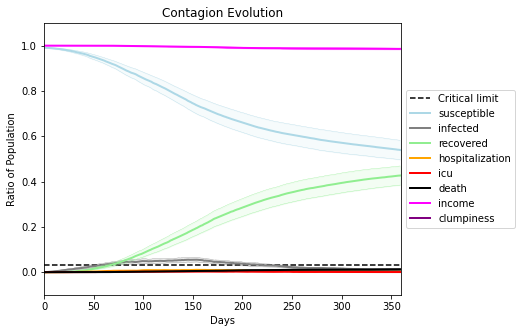

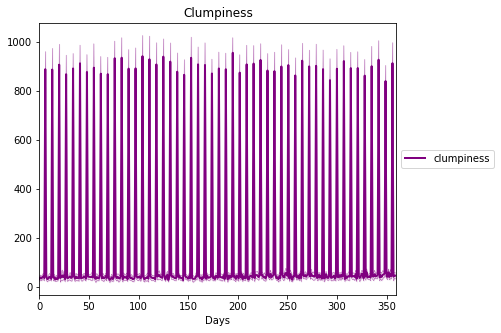

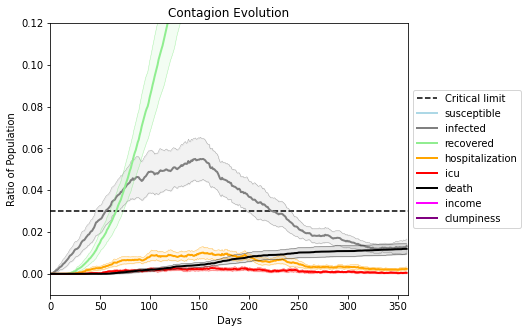

In [22]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.3
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6757, 2924, 5327, 9981, 5640, 2128, 1199, 9593, 429, 6543, 8736, 3120, 4642, 1454, 5622, 945, 4992, 7306, 7092, 6871]
Average similarity between family members is 0.18267637314027646 at temperature -0.2
Average similarity between family and home is 0.9998527199191439 at temperature -1
Average similarity between students and their classroom is 0.20284404040454357 at temperature -0.2
Average classroom occupancy is 1.550561797752809 and number classrooms is 178
Average similarity between workers is 0.15970511391483433 at temperature -0.2
Average office occupancy is 3.375 and number offices is 200
Average friend similarity for adults: 0.21598039302057992 for kids: 0.2064677208692263
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneous

avg restaurant similarity 0.05952646959203398
avg restaurant similarity 0.04004924038137337
avg restaurant similarity 0.07383453986106683
avg restaurant similarity 0.05521528085285959
avg restaurant similarity 0.07843537053421819
avg restaurant similarity 0.03314846077580971
avg restaurant similarity 0.07170321626589311
avg restaurant similarity 0.09449368243381089
avg restaurant similarity 0.073180304671442
avg restaurant similarity 0.05432638169270163
avg restaurant similarity 0.07199398489794048
avg restaurant similarity 0.06596813357144539
avg restaurant similarity 0.07525139356667614
avg restaurant similarity 0.08712429863418501
avg restaurant similarity 0.08725167200981973
avg restaurant similarity 0.061743032816997084
avg restaurant similarity 0.09397325213110211
avg restaurant similarity 0.07323935438209692
avg restaurant similarity 0.06604895375092655
avg restaurant similarity 0.06890874950193497
avg restaurant similarity 0.09065286208789616
avg restaurant similarity 0.0456854

avg restaurant similarity 0.1018935965820891
avg restaurant similarity 0.07781104320268656
avg restaurant similarity 0.053685948730328864
avg restaurant similarity 0.08404919239320036
avg restaurant similarity 0.03628079801030223
avg restaurant similarity 0.07259823755770246
avg restaurant similarity 0.05373257630274565
avg restaurant similarity 0.06653972830396399
avg restaurant similarity 0.04443385907571434
avg restaurant similarity 0.05704900930593268
avg restaurant similarity 0.028332705746188368
avg restaurant similarity 0.07901341491152737
avg restaurant similarity 0.0842109599503799
avg restaurant similarity 0.09017005343954689
avg restaurant similarity 0.0820858704225478
avg restaurant similarity 0.036217339811471565
avg restaurant similarity 0.027150893647738154
avg restaurant similarity 0.09265157872234088
avg restaurant similarity 0.020621941911971954
avg restaurant similarity 0.04559020077052667
avg restaurant similarity 0.04372188426257121
avg restaurant similarity 0.0469

avg restaurant similarity 0.042268869425566874
avg restaurant similarity 0.0799378219882635
avg restaurant similarity 0.04430443726551402
Average similarity between family members is 0.1750141273261551 at temperature -0.2
Average similarity between family and home is 0.9998631312425953 at temperature -1
Average similarity between students and their classroom is 0.19241934734422458 at temperature -0.2
Average classroom occupancy is 1.6171428571428572 and number classrooms is 175
Average similarity between workers is 0.15763111940251512 at temperature -0.2
Average office occupancy is 3.3737373737373737 and number offices is 198
Average friend similarity for adults: 0.21350557409975626 for kids: 0.2221056050201159
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.06277361455811717
avg restaurant similarity 0.05989670790874983
avg restaurant similarity 0.10053732533432162
avg restaurant similarity 0.042611533004923145
avg restaurant similarity 0.04506803316608184
avg restaurant similarity 0.07399801109486104
avg restaurant similarity 0.06873205767840412
avg restaurant similarity 0.07806508001895869
avg restaurant similarity 0.014226518625220164
avg restaurant similarity 0.04837550385261112
avg restaurant similarity 0.06772866413398668
avg restaurant similarity 0.04248885757695169
avg restaurant similarity 0.001403419192284945
avg restaurant similarity 0.04127237566803742
avg restaurant similarity 0.03262167550306032
avg restaurant similarity 0.02658859002078492
avg restaurant similarity 0.08976421861865944
avg restaurant similarity 0.010681169789388826
avg restaurant similarity 0.028767694515971897
avg restaurant similarity 0.022056937606706732
avg restaurant similarity 0.0710992423423553
avg restaurant similarity 0.0

avg restaurant similarity 0.026326598779031905
avg restaurant similarity 0.029700274355448253
avg restaurant similarity 0.06362902907688534
avg restaurant similarity 0.05787037587642455
avg restaurant similarity 0.030436697844128915
avg restaurant similarity 0.05814126154827703
avg restaurant similarity 0.048907508384001715
avg restaurant similarity 0.00259339027009027
avg restaurant similarity 0.013058790191393123
avg restaurant similarity 0.05000541530582268
avg restaurant similarity 0.04049756060737075
avg restaurant similarity 0.040395354544759704
avg restaurant similarity -0.020146571943635217
avg restaurant similarity 0.01447400635679393
avg restaurant similarity 0.051421074296714435
avg restaurant similarity 0.047918196290739
avg restaurant similarity -0.04104305310817268
avg restaurant similarity 0.0856889557249056
avg restaurant similarity 0.05379284608993407
avg restaurant similarity 0.024594438785568745
avg restaurant similarity 0.0850887547884476
avg restaurant similarity 0

avg restaurant similarity 0.05655221481447818
avg restaurant similarity 0.016281562887370954
avg restaurant similarity 0.04598695422174862
avg restaurant similarity 0.0506431344854179
avg restaurant similarity 0.0627798479931202
Average similarity between family members is 0.19175023578062603 at temperature -0.2
Average similarity between family and home is 0.9998511862186714 at temperature -1
Average similarity between students and their classroom is 0.17095166850603705 at temperature -0.2
Average classroom occupancy is 1.5953757225433527 and number classrooms is 173
Average similarity between workers is 0.15844427739203049 at temperature -0.2
Average office occupancy is 3.3383084577114426 and number offices is 201
Average friend similarity for adults: 0.21433941161737455 for kids: 0.21146950782328844
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people alloc

avg restaurant similarity 0.07036879570832455
avg restaurant similarity 0.0819620826971982
avg restaurant similarity 0.11818190664554597
avg restaurant similarity 0.03850070509301692
avg restaurant similarity 0.08031823293382591
avg restaurant similarity 0.061908594693683976
avg restaurant similarity 0.0796351165164623
avg restaurant similarity 0.09048616695707823
avg restaurant similarity 0.06927315514336257
avg restaurant similarity 0.047370881078473204
avg restaurant similarity 0.08814868303960614
avg restaurant similarity 0.051647196738334226
avg restaurant similarity 0.034186580602570134
avg restaurant similarity 0.07314602216513896
avg restaurant similarity 0.06414857917488563
avg restaurant similarity 0.07674758949306631
avg restaurant similarity 0.025417492331422497
avg restaurant similarity 0.03559618227062491
avg restaurant similarity 0.06254619793397943
avg restaurant similarity 0.04882586403109349
avg restaurant similarity 0.0844040188344772
avg restaurant similarity 0.0797

avg restaurant similarity 0.024466259959106694
avg restaurant similarity 0.04092320306620831
avg restaurant similarity 0.07051139696036182
avg restaurant similarity 0.0644501331918308
avg restaurant similarity 0.041115570593718696
avg restaurant similarity 0.04517378353449177
avg restaurant similarity 0.04743976795285995
avg restaurant similarity 0.08206676999371135
avg restaurant similarity 0.10750626276116128
avg restaurant similarity 0.055606377752700706
avg restaurant similarity 0.08628392064468415
avg restaurant similarity 0.04594968294860733
avg restaurant similarity 0.08853240649680037
avg restaurant similarity 0.056196802044443904
avg restaurant similarity 0.07063516068730848
avg restaurant similarity 0.05593690571520014
avg restaurant similarity 0.05823677225348274
avg restaurant similarity 0.06803068674316036
avg restaurant similarity 0.062067025975416565
avg restaurant similarity 0.0503688048523414
avg restaurant similarity 0.0569516190674916
avg restaurant similarity 0.0697

avg restaurant similarity 0.07085787740823886
avg restaurant similarity 0.09356765350740467
avg restaurant similarity 0.057257981693982794
avg restaurant similarity 0.06520128510039229
Average similarity between family members is 0.16385956459320197 at temperature -0.2
Average similarity between family and home is 0.999860018829921 at temperature -1
Average similarity between students and their classroom is 0.15199708657210412 at temperature -0.2
Average classroom occupancy is 1.5647058823529412 and number classrooms is 170
Average similarity between workers is 0.16296337463225397 at temperature -0.2
Average office occupancy is 3.310344827586207 and number offices is 203
Average friend similarity for adults: 0.21252005791637793 for kids: 0.20747036044453598
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity -0.00386716811297306
avg restaurant similarity 0.0363688366827075
avg restaurant similarity 0.05041486541353851
avg restaurant similarity 0.017812573850224774
avg restaurant similarity 0.06869538276363328
avg restaurant similarity 0.023125164999364765
avg restaurant similarity 0.04878420044105597
avg restaurant similarity 0.01633164351668986
avg restaurant similarity 0.07703014320042596
avg restaurant similarity 0.050248818822799655
avg restaurant similarity 0.02893200113225915
avg restaurant similarity 0.011859364546051708
avg restaurant similarity 0.0272772703707862
avg restaurant similarity 0.036835341166060166
avg restaurant similarity 0.015169979604572042
avg restaurant similarity -2.8879049111162415e-05
avg restaurant similarity 0.06474598976947052
avg restaurant similarity 0.07781306590841743
avg restaurant similarity 0.059717480056156964
avg restaurant similarity 0.04899228308177257
avg restaurant similarity 0.0012361349244746044
avg restaurant similar

avg restaurant similarity 0.040415317168166896
avg restaurant similarity 0.06418130563314307
avg restaurant similarity 0.0600079604237476
avg restaurant similarity 0.08524634155189625
avg restaurant similarity 0.03723123707260361
avg restaurant similarity 0.11407522095722933
avg restaurant similarity 0.04449454691034948
avg restaurant similarity 0.03378189138996983
avg restaurant similarity 0.04437593982974836
avg restaurant similarity 0.07300996264669496
avg restaurant similarity 0.029553913143253653
avg restaurant similarity 0.06447794595194747
avg restaurant similarity 0.025806458559787256
avg restaurant similarity 0.08082646643375391
avg restaurant similarity 0.05462970708294996
avg restaurant similarity 0.035248002475203426
avg restaurant similarity 0.024203303031518634
avg restaurant similarity 0.07528983899241022
avg restaurant similarity 0.04802209412102771
avg restaurant similarity 0.06537991315821585
avg restaurant similarity 0.018989180099732262
avg restaurant similarity 0.0

avg restaurant similarity 0.10890081175852456
avg restaurant similarity 0.10282833422645446
avg restaurant similarity 0.10026705434542943
avg restaurant similarity 0.059050946798779765
avg restaurant similarity 0.044278891141127416
avg restaurant similarity 0.036102570923159
Average similarity between family members is 0.17972020962212656 at temperature -0.2
Average similarity between family and home is 0.9998647192750566 at temperature -1
Average similarity between students and their classroom is 0.1763971370683152 at temperature -0.2
Average classroom occupancy is 1.6117021276595744 and number classrooms is 188
Average similarity between workers is 0.14086058460550593 at temperature -0.2
Average office occupancy is 3.17 and number offices is 200
Average friend similarity for adults: 0.20176298970634854 for kids: 0.20871824929024319
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 1

avg restaurant similarity 0.02572365404641211
avg restaurant similarity 0.053307248216716424
avg restaurant similarity 0.04481653501283305
avg restaurant similarity 0.04881606257378626
avg restaurant similarity 0.028990844582984607
avg restaurant similarity 0.04999001224343586
avg restaurant similarity 0.018696036118232517
avg restaurant similarity 0.048039938198623885
avg restaurant similarity 0.07501438949556333
avg restaurant similarity 0.0301866471838014
avg restaurant similarity 0.03780801086832611
avg restaurant similarity 0.07483997745917355
avg restaurant similarity 0.01924475738857808
avg restaurant similarity 0.04452737222713264
avg restaurant similarity 0.06493994339543922
avg restaurant similarity 0.10896568406595125
avg restaurant similarity 0.03795738644376697
avg restaurant similarity 0.04672365791119486
avg restaurant similarity 0.04671891513735222
avg restaurant similarity 0.02177593999571933
avg restaurant similarity 0.030815702945733128
avg restaurant similarity 0.06

avg restaurant similarity 0.015117034911715543
avg restaurant similarity 0.028702906606644377
avg restaurant similarity 0.04596335057052137
avg restaurant similarity 0.07667956520979236
avg restaurant similarity 0.0665796778984444
avg restaurant similarity 0.08120461323556077
avg restaurant similarity 0.027906370384215843
avg restaurant similarity 0.005602699626081167
avg restaurant similarity 0.004773044419079772
avg restaurant similarity 0.020082278944273772
avg restaurant similarity 0.07646483805228607
avg restaurant similarity 0.00819071668650902
avg restaurant similarity 0.03092536860356255
avg restaurant similarity 0.0632632383745825
avg restaurant similarity 0.060594149920064226
avg restaurant similarity 0.06577115154466788
avg restaurant similarity 0.06444782190103378
avg restaurant similarity 0.09020932667640685
avg restaurant similarity 0.03947349213891035
avg restaurant similarity 0.03681027485251705
avg restaurant similarity 0.06450885619901102
avg restaurant similarity 0.0

avg restaurant similarity 0.048952885228157904
avg restaurant similarity 0.07811314546083922
avg restaurant similarity 0.08184544865659309
avg restaurant similarity 0.044940823122527875
avg restaurant similarity 0.05600049754764074
Average similarity between family members is 0.16625041611671276 at temperature -0.2
Average similarity between family and home is 0.9998493883739321 at temperature -1
Average similarity between students and their classroom is 0.18801734848120877 at temperature -0.2
Average classroom occupancy is 1.5379746835443038 and number classrooms is 158
Average similarity between workers is 0.16841009159466097 at temperature -0.2
Average office occupancy is 3.3816425120772946 and number offices is 207
Average friend similarity for adults: 0.2217941625326524 for kids: 0.22741654328644756
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people all

avg restaurant similarity 0.09828781985049437
avg restaurant similarity 0.05634649258594611
avg restaurant similarity 0.09693552724992507
avg restaurant similarity 0.08887802614380085
avg restaurant similarity 0.01761518828002127
avg restaurant similarity 0.08133108376962733
avg restaurant similarity 0.06633719507631539
avg restaurant similarity 0.05722540901166057
avg restaurant similarity 0.06881568060040444
avg restaurant similarity 0.08517239916753526
avg restaurant similarity 0.09933866846314754
avg restaurant similarity 0.11852346590769662
avg restaurant similarity 0.08714370407858608
avg restaurant similarity 0.09415543585494245
avg restaurant similarity 0.06546160741161504
avg restaurant similarity 0.10735802208305771
avg restaurant similarity 0.057390569581351816
avg restaurant similarity 0.06400387689808665
avg restaurant similarity 0.03342887443356134
avg restaurant similarity 0.05875562265770052
avg restaurant similarity 0.07005797462466097
avg restaurant similarity 0.05144

avg restaurant similarity 0.031527789802519225
avg restaurant similarity 0.12097755928740364
avg restaurant similarity 0.05817146789863255
avg restaurant similarity 0.09469260882706038
avg restaurant similarity 0.05175004161385259
avg restaurant similarity 0.07498834168661736
avg restaurant similarity 0.06872477256843178
avg restaurant similarity 0.1080810156216742
avg restaurant similarity 0.047944820400403834
avg restaurant similarity 0.0754154969969431
avg restaurant similarity 0.07490486201670116
avg restaurant similarity 0.09080552894949408
avg restaurant similarity 0.06997272686012185
avg restaurant similarity 0.07591799212595146
avg restaurant similarity 0.0642528359509351
avg restaurant similarity 0.08820988755273883
avg restaurant similarity 0.06671418046323033
avg restaurant similarity 0.06822197236865743
avg restaurant similarity 0.08961920809032028
avg restaurant similarity 0.07299796925147181
avg restaurant similarity 0.06430248500133305
avg restaurant similarity 0.0926071

avg restaurant similarity 0.0695371207868326
avg restaurant similarity 0.0293867123998001
Average similarity between family members is 0.15478005117753785 at temperature -0.2
Average similarity between family and home is 0.9998560369354094 at temperature -1
Average similarity between students and their classroom is 0.21736848396061556 at temperature -0.2
Average classroom occupancy is 1.4651162790697674 and number classrooms is 172
Average similarity between workers is 0.15080251026389313 at temperature -0.2
Average office occupancy is 3.3737864077669903 and number offices is 206
Average friend similarity for adults: 0.20855262110045417 for kids: 0.21849066414638124
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated

avg restaurant similarity 0.0846691213530483
avg restaurant similarity 0.09206036565841816
avg restaurant similarity 0.039467958646983
avg restaurant similarity 0.037756956345569984
avg restaurant similarity 0.061004450680481215
avg restaurant similarity 0.05681507699257358
avg restaurant similarity 0.03933150599622798
avg restaurant similarity 0.10782803082246545
avg restaurant similarity 0.06199337080418918
avg restaurant similarity 0.07021889142808214
avg restaurant similarity 0.06512382469698344
avg restaurant similarity 0.04250825752880162
avg restaurant similarity 0.07407046981337947
avg restaurant similarity 0.0316183294083786
avg restaurant similarity 0.06168854100690706
avg restaurant similarity 0.04519174641110013
avg restaurant similarity 0.08218893271347964
avg restaurant similarity 0.034071490721438905
avg restaurant similarity 0.04000690095045884
avg restaurant similarity 0.04669333523708244
avg restaurant similarity 0.047094697697771144
avg restaurant similarity 0.040107

avg restaurant similarity 0.07598251981144608
avg restaurant similarity 0.07169861387316093
avg restaurant similarity 0.04378593503541416
avg restaurant similarity 0.06134945742854457
avg restaurant similarity 0.05179406974213609
avg restaurant similarity 0.06493380258505778
avg restaurant similarity 0.07061842345087786
avg restaurant similarity 0.08552950182194087
avg restaurant similarity 0.04601415598706739
avg restaurant similarity -0.011130719856761846
avg restaurant similarity 0.042524189209346606
avg restaurant similarity 0.07259479107789096
avg restaurant similarity 0.05147108057043807
avg restaurant similarity 0.0135281405012741
avg restaurant similarity 0.07571472612979357
avg restaurant similarity 0.05940147270151451
avg restaurant similarity 0.06427061181423174
avg restaurant similarity 0.06792228525021121
avg restaurant similarity 0.04018007149638147
avg restaurant similarity 0.07369246165429036
avg restaurant similarity 0.05675304346087964
avg restaurant similarity 0.0470

avg restaurant similarity 0.08401809464155467
avg restaurant similarity 0.04982503696492938
avg restaurant similarity 0.0765695679668589
avg restaurant similarity 0.01679492375273211
Average similarity between family members is 0.1617977032187177 at temperature -0.2
Average similarity between family and home is 0.9998560379973036 at temperature -1
Average similarity between students and their classroom is 0.13941328473310974 at temperature -0.2
Average classroom occupancy is 1.5806451612903225 and number classrooms is 186
Average similarity between workers is 0.12924489704675113 at temperature -0.2
Average office occupancy is 3.24 and number offices is 200
Average friend similarity for adults: 0.19919234968367855 for kids: 0.2168683576645017
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.05761439128093625
avg restaurant similarity 0.062327519660181144
avg restaurant similarity 0.04006072042026163
avg restaurant similarity 0.07305881209633656
avg restaurant similarity 0.04422527338738575
avg restaurant similarity 0.05585611090088049
avg restaurant similarity 0.12937803326859265
avg restaurant similarity 0.04884275135080746
avg restaurant similarity 0.008844476726801468
avg restaurant similarity 0.0974322222928983
avg restaurant similarity 0.05459399254532295
avg restaurant similarity 0.08583782657744186
avg restaurant similarity 0.07869609767244563
avg restaurant similarity 0.0910861359793435
avg restaurant similarity 0.07142376284896729
avg restaurant similarity 0.04059329661810169
avg restaurant similarity 0.0678636829981097
avg restaurant similarity 0.06434351163715847
avg restaurant similarity 0.043664610477473595
avg restaurant similarity 0.014693229781734136
avg restaurant similarity 0.11215940277561487
avg restaurant similarity 0.03904

avg restaurant similarity 0.11328190394994281
avg restaurant similarity 0.007986760804173649
avg restaurant similarity 0.04817436126652981
avg restaurant similarity 0.03341056211769773
avg restaurant similarity 0.06387413636730203
avg restaurant similarity 0.08845049613538195
avg restaurant similarity 0.024536830472353353
avg restaurant similarity 0.014145799907619638
avg restaurant similarity 0.0398658926435389
avg restaurant similarity 0.07653575295462059
avg restaurant similarity 0.06509760561403254
avg restaurant similarity 0.07711921999544698
avg restaurant similarity 0.09512699765536684
avg restaurant similarity 0.09672692769588491
avg restaurant similarity 0.07683430483463545
avg restaurant similarity 0.07334845894256643
avg restaurant similarity 0.011362187385776878
avg restaurant similarity 0.06956977760687426
avg restaurant similarity 0.008829301769968989
avg restaurant similarity 0.018055892757331122
avg restaurant similarity 0.04637059888252663
avg restaurant similarity 0.0

avg restaurant similarity 0.023055721321155482
avg restaurant similarity 0.04470447811195287
avg restaurant similarity 0.14559092853878908
avg restaurant similarity 0.05321256750227639
Average similarity between family members is 0.18929558867829677 at temperature -0.2
Average similarity between family and home is 0.9998470138500597 at temperature -1
Average similarity between students and their classroom is 0.21909151726056147 at temperature -0.2
Average classroom occupancy is 1.511111111111111 and number classrooms is 180
Average similarity between workers is 0.17431424675912907 at temperature -0.2
Average office occupancy is 3.3217821782178216 and number offices is 202
Average friend similarity for adults: 0.22232419546124393 for kids: 0.2153435161630945
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.048251057629342294
avg restaurant similarity 0.12395342951514265
avg restaurant similarity 0.07738035993427984
avg restaurant similarity 0.02452066125109869
avg restaurant similarity 0.07488643217489642
avg restaurant similarity 0.061340226527618155
avg restaurant similarity 0.05725146564851545
avg restaurant similarity 0.07006035827257014
avg restaurant similarity 0.05600844762699312
avg restaurant similarity 0.02635994678257994
avg restaurant similarity 0.0564273292607464
avg restaurant similarity 0.10106144301927418
avg restaurant similarity 0.10591507001732366
avg restaurant similarity 0.07745480418918713
avg restaurant similarity 0.08870339972617115
avg restaurant similarity 0.08895495256992748
avg restaurant similarity 0.0531322099871356
avg restaurant similarity 0.09623451462963885
avg restaurant similarity 0.07781242277351226
avg restaurant similarity 0.0505682135999967
avg restaurant similarity 0.09144110080756572
avg restaurant similarity 0.0424481

avg restaurant similarity 0.07990885732638899
avg restaurant similarity 0.04378126003524978
avg restaurant similarity 0.09677980283304019
avg restaurant similarity 0.052476213351772084
avg restaurant similarity 0.05578043642774593
avg restaurant similarity 0.05036390566716482
avg restaurant similarity 0.10817091057749588
avg restaurant similarity 0.07994001171299557
avg restaurant similarity 0.05934663331444595
avg restaurant similarity 0.10110851481979789
avg restaurant similarity 0.06848200138112064
avg restaurant similarity 0.04858801291729757
avg restaurant similarity 0.08342029181159906
avg restaurant similarity 0.10003100478675675
avg restaurant similarity 0.04635996997401262
avg restaurant similarity 0.0481070402038177
avg restaurant similarity 0.1012259933769915
avg restaurant similarity 0.04274116607173178
avg restaurant similarity 0.12068581089490013
avg restaurant similarity 0.09614167504770288
avg restaurant similarity 0.11028138757433059
avg restaurant similarity 0.0529991

avg restaurant similarity 0.09174432879714406
avg restaurant similarity 0.03960269533069451
Average similarity between family members is 0.181019194471094 at temperature -0.2
Average similarity between family and home is 0.9998583943796718 at temperature -1
Average similarity between students and their classroom is 0.1474146367710441 at temperature -0.2
Average classroom occupancy is 1.5136612021857923 and number classrooms is 183
Average similarity between workers is 0.1327756347100841 at temperature -0.2
Average office occupancy is 3.3877551020408165 and number offices is 196
Average friend similarity for adults: 0.21144093661347668 for kids: 0.2168044522690774
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated un

avg restaurant similarity 0.033102082628250665
avg restaurant similarity 0.036939947404207876
avg restaurant similarity -0.0027697291658250168
avg restaurant similarity 0.059654425302041646
avg restaurant similarity 0.06108629215326984
avg restaurant similarity 0.0722303850511516
avg restaurant similarity 0.036617030107884356
avg restaurant similarity 0.07471523497924154
avg restaurant similarity 0.05206757274581233
avg restaurant similarity 0.06322154078077968
avg restaurant similarity 0.11119794380668754
avg restaurant similarity 0.048089009143624455
avg restaurant similarity 0.06059422578455549
avg restaurant similarity 0.07534487388890644
avg restaurant similarity 0.035455683702402804
avg restaurant similarity 0.04113662069143735
avg restaurant similarity 0.09472765355421815
avg restaurant similarity 0.05788128919801861
avg restaurant similarity 0.06607442245572809
avg restaurant similarity 0.02500784837339205
avg restaurant similarity 0.0053047897864526945
avg restaurant similarit

avg restaurant similarity 0.03402980907572599
avg restaurant similarity 0.043213180962148726
avg restaurant similarity 0.05684599869100726
avg restaurant similarity 0.07403223434971354
avg restaurant similarity 0.037468702015780904
avg restaurant similarity 0.039862674443681995
avg restaurant similarity 0.042272308153761394
avg restaurant similarity 0.033869677962611436
avg restaurant similarity 0.039952111947256695
avg restaurant similarity 0.031001019585284357
avg restaurant similarity 0.0024829806467141294
avg restaurant similarity 0.030474197732654508
avg restaurant similarity 0.055195513883101587
avg restaurant similarity 0.027752187792153042
avg restaurant similarity 0.03907324940135105
avg restaurant similarity 0.10766375373681239
avg restaurant similarity 0.0380447630583259
avg restaurant similarity 0.03362734944534066
avg restaurant similarity 0.07858276721998544
avg restaurant similarity 0.03179540753411675
avg restaurant similarity 0.04019453447166494
avg restaurant similari

avg restaurant similarity 0.06499682594877738
avg restaurant similarity 0.010572227558184039
avg restaurant similarity 0.04810885983262257
avg restaurant similarity 0.044665313690035936
avg restaurant similarity 0.005816165369549982
avg restaurant similarity 0.02569453423867018
Average similarity between family members is 0.17713152438257837 at temperature -0.2
Average similarity between family and home is 0.9998583604537905 at temperature -1
Average similarity between students and their classroom is 0.1451879889635489 at temperature -0.2
Average classroom occupancy is 1.6312849162011174 and number classrooms is 179
Average similarity between workers is 0.16766502796552482 at temperature -0.2
Average office occupancy is 3.1911764705882355 and number offices is 204
Average friend similarity for adults: 0.21543643452270062 for kids: 0.21054085495827607
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units 

avg restaurant similarity 0.06329077126837074
avg restaurant similarity 0.036280854968333894
avg restaurant similarity 0.046157524136981876
avg restaurant similarity 0.05738831359546243
avg restaurant similarity 0.08303147080261264
avg restaurant similarity 0.07039012538140203
avg restaurant similarity 0.03967090021143853
avg restaurant similarity 0.043303578933231814
avg restaurant similarity 0.06606451928120573
avg restaurant similarity 0.10462444567960534
avg restaurant similarity 0.055021749909660085
avg restaurant similarity 0.0766325904360726
avg restaurant similarity 0.11265036652252843
avg restaurant similarity 0.07128318354790568
avg restaurant similarity 0.04401171998156396
avg restaurant similarity 0.059033353385400056
avg restaurant similarity 0.06910309460180515
avg restaurant similarity 0.05305832562546078
avg restaurant similarity 0.05794686359740671
avg restaurant similarity 0.09866148146615171
avg restaurant similarity 0.02218805527918254
avg restaurant similarity 0.03

avg restaurant similarity 0.06161103962430499
avg restaurant similarity 0.057069949219371856
avg restaurant similarity 0.04551888814622787
avg restaurant similarity 0.03816158406734493
avg restaurant similarity 0.04251388409796271
avg restaurant similarity 0.04970297732246186
avg restaurant similarity 0.06829799831275615
avg restaurant similarity 0.02745835937781588
avg restaurant similarity 0.06985865746621295
avg restaurant similarity 0.014731560465868659
avg restaurant similarity 0.04073631186098115
avg restaurant similarity 0.047268737118260476
avg restaurant similarity 0.07581729130098602
avg restaurant similarity 0.013804673127704862
avg restaurant similarity 0.08407000774049098
avg restaurant similarity 0.05076554195687746
avg restaurant similarity 0.02885763963915051
avg restaurant similarity 0.10468245634683576
avg restaurant similarity 0.033518366096457405
avg restaurant similarity 0.03889681763412348
avg restaurant similarity 0.09615741925455938
avg restaurant similarity 0.0

avg restaurant similarity 0.04760142370427688
avg restaurant similarity 0.07170697235291897
avg restaurant similarity 0.0613387092880548
avg restaurant similarity 0.05468362145839609
Average similarity between family members is 0.16690208214918723 at temperature -0.2
Average similarity between family and home is 0.9998565566282905 at temperature -1
Average similarity between students and their classroom is 0.16605123221715612 at temperature -0.2
Average classroom occupancy is 1.547872340425532 and number classrooms is 188
Average similarity between workers is 0.16384964028458285 at temperature -0.2
Average office occupancy is 3.207920792079208 and number offices is 202
Average friend similarity for adults: 0.20574566294612767 for kids: 0.20931577276448868
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.022091485084259545
avg restaurant similarity 0.017040718321375537
avg restaurant similarity 0.04912930572077254
avg restaurant similarity 0.07931859728988883
avg restaurant similarity 0.06489011779109878
avg restaurant similarity 0.08965093683382667
avg restaurant similarity 0.022566976416819668
avg restaurant similarity 0.07390754345259239
avg restaurant similarity 0.0929867561581196
avg restaurant similarity 0.1085550297149643
avg restaurant similarity 0.12037070140469543
avg restaurant similarity 0.08451757081479355
avg restaurant similarity 0.04469358374340679
avg restaurant similarity 0.12745907990783253
avg restaurant similarity 0.06781840478666544
avg restaurant similarity 0.11108045271990279
avg restaurant similarity 0.054150608445574976
avg restaurant similarity 0.08862202657852862
avg restaurant similarity 0.07155072570931383
avg restaurant similarity 0.06665863691052454
avg restaurant similarity 0.07448150751551923
avg restaurant similarity 0.0357

avg restaurant similarity 0.04376071583049311
avg restaurant similarity 0.10879236378863107
avg restaurant similarity 0.056070006690677875
avg restaurant similarity 0.027876616722329918
avg restaurant similarity 0.05646123403724026
avg restaurant similarity 0.0676791275235762
avg restaurant similarity 0.05676355608921581
avg restaurant similarity 0.05458860554395299
avg restaurant similarity 0.05361059957628452
avg restaurant similarity 0.05334984840356964
avg restaurant similarity 0.12441187832306609
avg restaurant similarity 0.0639886047640496
avg restaurant similarity 0.09051697307362742
avg restaurant similarity 0.016434718509635904
avg restaurant similarity 0.09733490334388235
avg restaurant similarity 0.09021452602685989
avg restaurant similarity 0.07842641500419285
avg restaurant similarity 0.12576476073976167
avg restaurant similarity 0.026309671834649564
avg restaurant similarity 0.09348673940781647
avg restaurant similarity 0.07921786278807262
avg restaurant similarity 0.0557

avg restaurant similarity 0.09907692966918033
avg restaurant similarity 0.06589523661622118
avg restaurant similarity 0.10098092997796873
avg restaurant similarity 0.12114609085864188
Average similarity between family members is 0.19673109657717364 at temperature -0.2
Average similarity between family and home is 0.9998577987199282 at temperature -1
Average similarity between students and their classroom is 0.17188292900759117 at temperature -0.2
Average classroom occupancy is 1.4623655913978495 and number classrooms is 186
Average similarity between workers is 0.13679860340837927 at temperature -0.2
Average office occupancy is 3.414141414141414 and number offices is 198
Average friend similarity for adults: 0.2148639073730409 for kids: 0.21846714235039055
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.0724024498931662
avg restaurant similarity 0.027333749896816823
avg restaurant similarity 0.07978819803826348
avg restaurant similarity 0.07311214163251109
avg restaurant similarity 0.09426953047507564
avg restaurant similarity 0.10921750536235537
avg restaurant similarity 0.06603461500793163
avg restaurant similarity 0.08511776867343639
avg restaurant similarity 0.08843548315403342
avg restaurant similarity 0.050483253087912315
avg restaurant similarity 0.09064656279577707
avg restaurant similarity 0.03853723676626428
avg restaurant similarity 0.061895417946185034
avg restaurant similarity 0.0686093579355491
avg restaurant similarity 0.05961731458389052
avg restaurant similarity 0.09632582663056938
avg restaurant similarity 0.11469134264898036
avg restaurant similarity 0.045739466951687645
avg restaurant similarity 0.10090546659304889
avg restaurant similarity 0.04699811086263192
avg restaurant similarity 0.029828544304925184
avg restaurant similarity 0.096

avg restaurant similarity 0.07099244414363119
avg restaurant similarity 0.0587274354916647
avg restaurant similarity 0.07496232971117092
avg restaurant similarity 0.040096884897533075
avg restaurant similarity 0.040021280610575326
avg restaurant similarity 0.023036728851350368
avg restaurant similarity 0.06792303193683727
avg restaurant similarity 0.05073485851974036
avg restaurant similarity 0.08644233142684075
avg restaurant similarity -0.01387536374026964
avg restaurant similarity 0.07171667510908113
avg restaurant similarity 0.1092812242260282
avg restaurant similarity 0.061146216166053
avg restaurant similarity 0.05664806761947776
avg restaurant similarity 0.10339858093299047
avg restaurant similarity 0.04705038427084294
avg restaurant similarity 0.05081409858803437
avg restaurant similarity 0.05116756461774447
avg restaurant similarity 0.06645230652226544
avg restaurant similarity 0.07276436811228773
avg restaurant similarity 0.06279950071749231
avg restaurant similarity 0.052627

avg restaurant similarity 0.058141011075913504
avg restaurant similarity 0.09614970940023153
Average similarity between family members is 0.18776593985743711 at temperature -0.2
Average similarity between family and home is 0.9998505672034596 at temperature -1
Average similarity between students and their classroom is 0.18118304837936144 at temperature -0.2
Average classroom occupancy is 1.5543478260869565 and number classrooms is 184
Average similarity between workers is 0.15729166259630567 at temperature -0.2
Average office occupancy is 3.2893401015228427 and number offices is 197
Average friend similarity for adults: 0.21425827995311525 for kids: 0.21518436836673044
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allo

avg restaurant similarity 0.12657947910431572
avg restaurant similarity 0.07841229580237209
avg restaurant similarity 0.05236468953364515
avg restaurant similarity 0.04933562224598451
avg restaurant similarity 0.11553918668391583
avg restaurant similarity 0.03763616981743549
avg restaurant similarity 0.07573707298863018
avg restaurant similarity 0.06661615585038093
avg restaurant similarity 0.027151386863845012
avg restaurant similarity 0.046014789776950164
avg restaurant similarity 0.08599573963628315
avg restaurant similarity 0.09581659180680628
avg restaurant similarity 0.13260732078242665
avg restaurant similarity 0.07946455442261041
avg restaurant similarity 0.038832792915173664
avg restaurant similarity 0.10052325830157138
avg restaurant similarity 0.07386739863077914
avg restaurant similarity 0.08548255337967074
avg restaurant similarity 0.0528528365896337
avg restaurant similarity 0.04706280279806457
avg restaurant similarity 0.03404875035690082
avg restaurant similarity 0.0914

avg restaurant similarity 0.04468035690457606
avg restaurant similarity 0.05148030910634218
avg restaurant similarity -0.01308821147379955
avg restaurant similarity 0.03570096234019265
avg restaurant similarity 0.07524193694401182
avg restaurant similarity 0.03612937916297941
avg restaurant similarity 0.03653902458730347
avg restaurant similarity 0.05769768783185993
avg restaurant similarity 0.042901445170864076
avg restaurant similarity 0.04632598012772361
avg restaurant similarity 0.061188751477584825
avg restaurant similarity 0.07063958590430652
avg restaurant similarity 0.10649762173712456
avg restaurant similarity 0.08352376778071448
avg restaurant similarity 0.08757211392356078
avg restaurant similarity 0.09563089654312312
avg restaurant similarity 0.05647813543438971
avg restaurant similarity 0.049682072773051596
avg restaurant similarity 0.056619092753242006
avg restaurant similarity 0.054664396456904185
avg restaurant similarity 0.023159760024736128
avg restaurant similarity 0

avg restaurant similarity 0.0810997955570625
avg restaurant similarity 0.06060908697673515
avg restaurant similarity 0.09108932718776529
avg restaurant similarity 0.07007703078098164
Average similarity between family members is 0.17771030894153414 at temperature -0.2
Average similarity between family and home is 0.9998541532838545 at temperature -1
Average similarity between students and their classroom is 0.15939769886701047 at temperature -0.2
Average classroom occupancy is 1.5786516853932584 and number classrooms is 178
Average similarity between workers is 0.16359286164363193 at temperature -0.2
Average office occupancy is 3.328358208955224 and number offices is 201
Average friend similarity for adults: 0.21330620065778477 for kids: 0.22183317226585225
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.13151803543206675
avg restaurant similarity 0.09310787210940817
avg restaurant similarity 0.1004673095897413
avg restaurant similarity 0.060706345843462094
avg restaurant similarity 0.018643855749161154
avg restaurant similarity 0.09825917474454943
avg restaurant similarity 0.1066226161535076
avg restaurant similarity 0.08574036727200765
avg restaurant similarity 0.10305805721871023
avg restaurant similarity 0.054632537440807954
avg restaurant similarity 0.07437957604997353
avg restaurant similarity 0.054296676039840897
avg restaurant similarity 0.07360708952020503
avg restaurant similarity 0.08375891269964028
avg restaurant similarity 0.06142359789468374
avg restaurant similarity 0.009555205048454026
avg restaurant similarity 0.044836032089636046
avg restaurant similarity 0.09051536201666628
avg restaurant similarity 0.05365750100983206
avg restaurant similarity 0.09495455840581135
avg restaurant similarity 0.02594684049457813
avg restaurant similarity 0.11

avg restaurant similarity 0.09253099139051084
avg restaurant similarity 0.0627642313648461
avg restaurant similarity 0.08918889778645918
avg restaurant similarity 0.1378783793697542
avg restaurant similarity 0.06504303056853215
avg restaurant similarity 0.06923606984338303
avg restaurant similarity 0.05081973532945637
avg restaurant similarity 0.07628150579771095
avg restaurant similarity 0.08050705102777607
avg restaurant similarity -0.01726596199691473
avg restaurant similarity 0.06878485896542828
avg restaurant similarity 0.09590132618158996
avg restaurant similarity 0.04900583191764351
avg restaurant similarity 0.039863700972245966
avg restaurant similarity 0.09642006048560874
avg restaurant similarity 0.1098096375561397
avg restaurant similarity 0.07459612891810707
avg restaurant similarity 0.09347800036561574
avg restaurant similarity 0.06584259262685699
avg restaurant similarity 0.0500453344492913
avg restaurant similarity 0.08196482601464883
avg restaurant similarity 0.07226489

avg restaurant similarity 0.03161171320922713
avg restaurant similarity 0.07231951018458874
avg restaurant similarity 0.04660590368831962
Average similarity between family members is 0.17719350277273802 at temperature -0.2
Average similarity between family and home is 0.9998569656331082 at temperature -1
Average similarity between students and their classroom is 0.18105009097869754 at temperature -0.2
Average classroom occupancy is 1.5769230769230769 and number classrooms is 182
Average similarity between workers is 0.1626441144093911 at temperature -0.2
Average office occupancy is 3.275 and number offices is 200
Average friend similarity for adults: 0.20591885700470375 for kids: 0.20762710283289587
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 21 people.
Total of 21 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with

avg restaurant similarity 0.03566900000726514
avg restaurant similarity 0.04785569878328842
avg restaurant similarity 0.02263072197728111
avg restaurant similarity 0.08886874224193275
avg restaurant similarity 0.04073387825738817
avg restaurant similarity 0.051577660066092705
avg restaurant similarity 0.007687614717646061
avg restaurant similarity 0.04634471077872201
avg restaurant similarity 0.07832979258120054
avg restaurant similarity 0.039656128370246284
avg restaurant similarity 0.0745405387471414
avg restaurant similarity 0.047060079940960876
avg restaurant similarity 0.03548525904698089
avg restaurant similarity 0.033329325618049306
avg restaurant similarity 0.07314315262804919
avg restaurant similarity 0.03108586671213134
avg restaurant similarity 0.023521825568189474
avg restaurant similarity 0.024902610779158424
avg restaurant similarity 0.016456410869816834
avg restaurant similarity 0.026488869500252324
avg restaurant similarity 0.08945500711829302
avg restaurant similarity 

avg restaurant similarity 0.07870770015202135
avg restaurant similarity 0.02728155994061624
avg restaurant similarity 0.08453053393495939
avg restaurant similarity 0.017781009904838545
avg restaurant similarity 0.07118729530408727
avg restaurant similarity 0.04944950274928653
avg restaurant similarity 0.04879171304556664
avg restaurant similarity 0.028752531510320565
avg restaurant similarity 0.04207722224918283
avg restaurant similarity 0.04871557917343393
avg restaurant similarity 0.01644083651561895
avg restaurant similarity 0.054967074740504225
avg restaurant similarity 0.0654169012502911
avg restaurant similarity 0.03710164370119923
avg restaurant similarity 0.0688815827853013
avg restaurant similarity 0.10310215629592981
avg restaurant similarity 0.076158430758496
avg restaurant similarity 0.0570901531267532
avg restaurant similarity 0.013208149777596413
avg restaurant similarity 0.034774448123244414
avg restaurant similarity 0.03544804791138308
avg restaurant similarity 0.035368

avg restaurant similarity 0.06565189094252243
avg restaurant similarity 0.08986591345902036
avg restaurant similarity 0.06310639517240599
avg restaurant similarity 0.036705906270941314
Average similarity between family members is 0.1710725998966997 at temperature -0.2
Average similarity between family and home is 0.9998507045906656 at temperature -1
Average similarity between students and their classroom is 0.190627726201453 at temperature -0.2
Average classroom occupancy is 1.588235294117647 and number classrooms is 170
Average similarity between workers is 0.16062152334486116 at temperature -0.2
Average office occupancy is 3.284313725490196 and number offices is 204
Average friend similarity for adults: 0.21653136946638585 for kids: 0.21576701782995775
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.04102578473432215
avg restaurant similarity 0.0449101694750057
avg restaurant similarity 0.03343333277592584
avg restaurant similarity 0.04439730288822446
avg restaurant similarity 0.04262197432707626
avg restaurant similarity 0.05608436195707254
avg restaurant similarity 0.011080906733440051
avg restaurant similarity 0.04535363358146642
avg restaurant similarity 0.017225877345600632
avg restaurant similarity 0.06970182251658259
avg restaurant similarity 0.0635404719746272
avg restaurant similarity 0.03182283198902094
avg restaurant similarity 0.047293150048836774
avg restaurant similarity 0.07083335614846847
avg restaurant similarity 0.044709940276031764
avg restaurant similarity 0.06306724160371326
avg restaurant similarity 0.04743522640229089
avg restaurant similarity 0.0464485139646564
avg restaurant similarity 0.04845830404699828
avg restaurant similarity 0.04736603750487153
avg restaurant similarity 0.09624791202756106
avg restaurant similarity 0.04966

avg restaurant similarity 0.058451523370982646
avg restaurant similarity 0.03949437652905474
avg restaurant similarity 0.03990196806878327
avg restaurant similarity 0.04661374509400509
avg restaurant similarity 0.027046711253836134
avg restaurant similarity 0.04489188841795803
avg restaurant similarity 0.07458047300236935
avg restaurant similarity -0.03693677879704253
avg restaurant similarity 0.05992347459321341
avg restaurant similarity 0.008626054269953666
avg restaurant similarity 0.06279871584297861
avg restaurant similarity -0.03798990221658121
avg restaurant similarity 0.05875287562761415
avg restaurant similarity 0.022074580928934096
avg restaurant similarity 0.04260372122401617
avg restaurant similarity 0.06894387051266002
avg restaurant similarity 0.024168481038842452
avg restaurant similarity 0.08497806141243316
avg restaurant similarity 0.07585614123063061
avg restaurant similarity 0.06730361867765507
avg restaurant similarity 0.036140873571507116
avg restaurant similarity 

avg restaurant similarity 0.0445600385556156
avg restaurant similarity 0.08579352158202114
avg restaurant similarity 0.029061412516913795
avg restaurant similarity 0.06561192258603675
avg restaurant similarity 0.05089432165497552
Average similarity between family members is 0.15146429894377952 at temperature -0.2
Average similarity between family and home is 0.9998630269540107 at temperature -1
Average similarity between students and their classroom is 0.16654824820705316 at temperature -0.2
Average classroom occupancy is 1.7541899441340782 and number classrooms is 179
Average similarity between workers is 0.14553221855375947 at temperature -0.2
Average office occupancy is 3.150753768844221 and number offices is 199
Average friend similarity for adults: 0.2093030339787604 for kids: 0.20473669023002952
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people alloca

avg restaurant similarity 0.013942829951800883
avg restaurant similarity 0.028468821633325595
avg restaurant similarity 0.0821768333819193
avg restaurant similarity 0.06552839271851016
avg restaurant similarity 0.04550574599632496
avg restaurant similarity 0.04851691168824738
avg restaurant similarity 0.07765984423178188
avg restaurant similarity 0.09187104817388722
avg restaurant similarity 0.11616550685146931
avg restaurant similarity 0.03764421082279139
avg restaurant similarity 0.06917432055398484
avg restaurant similarity 0.07065216144463837
avg restaurant similarity 0.031184963575811693
avg restaurant similarity 0.07108587458920299
avg restaurant similarity 0.10149968743595757
avg restaurant similarity 0.11826067798200303
avg restaurant similarity 0.051087941306523464
avg restaurant similarity 0.06944318807863256
avg restaurant similarity 0.03065670430532726
avg restaurant similarity 0.04588696975233742
avg restaurant similarity 0.08932382437112668
avg restaurant similarity 0.075

avg restaurant similarity 0.03723304161886373
avg restaurant similarity 0.05864922136104762
avg restaurant similarity 0.114140791333776
avg restaurant similarity 0.029031185509957525
avg restaurant similarity 0.057167312643339456
avg restaurant similarity 0.062416745880899
avg restaurant similarity 0.07639128186201223
avg restaurant similarity 0.04558658153286457
avg restaurant similarity 0.07030750920381677
avg restaurant similarity 0.06814059381815335
avg restaurant similarity 0.07292798348510318
avg restaurant similarity 0.08569282600488488
avg restaurant similarity 0.03863461545781201
avg restaurant similarity 0.04711902878332276
avg restaurant similarity 0.0654141806480543
avg restaurant similarity 0.10988945625957927
avg restaurant similarity 0.09994128104068016
avg restaurant similarity 0.07954175353327983
avg restaurant similarity 0.14489227515325034
avg restaurant similarity 0.11258337735200698
avg restaurant similarity 0.09709245315092294
avg restaurant similarity 0.043191543

avg restaurant similarity 0.11735817461811066
avg restaurant similarity 0.04706723769974391
avg restaurant similarity 0.05816465168980772
avg restaurant similarity 0.06814875651283107
Average similarity between family members is 0.16069556256104925 at temperature -0.2
Average similarity between family and home is 0.9998550025006493 at temperature -1
Average similarity between students and their classroom is 0.1462265317867318 at temperature -0.2
Average classroom occupancy is 1.5517241379310345 and number classrooms is 174
Average similarity between workers is 0.13293475162700255 at temperature -0.2
Average office occupancy is 3.3448275862068964 and number offices is 203
Average friend similarity for adults: 0.20556690223405263 for kids: 0.22009015768157827
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.02866749760868952
avg restaurant similarity 0.027539685971256896
avg restaurant similarity 0.01780861362370485
avg restaurant similarity 0.019185578060126992
avg restaurant similarity 0.02762431288841327
avg restaurant similarity 0.06513294743470621
avg restaurant similarity 0.041132193201041695
avg restaurant similarity 0.01780569239908875
avg restaurant similarity 0.01989167489084266
avg restaurant similarity 0.007179124732109342
avg restaurant similarity 0.0011358447546064472
avg restaurant similarity -0.00041940077447520386
avg restaurant similarity 0.03837763726662453
avg restaurant similarity 0.0327712682886228
avg restaurant similarity 0.039808786119095864
avg restaurant similarity 0.02630466354701523
avg restaurant similarity 0.010947898198648349
avg restaurant similarity 0.0423800641361357
avg restaurant similarity 0.02364760521289516
avg restaurant similarity 0.023713741994608382
avg restaurant similarity 0.051309345274477516
avg restaurant similar

avg restaurant similarity -0.023440169160931067
avg restaurant similarity 0.024898155419309436
avg restaurant similarity 0.0313733415794773
avg restaurant similarity 0.03000701404223649
avg restaurant similarity 0.044088997901797634
avg restaurant similarity 0.01566140769290167
avg restaurant similarity 0.001427102633754742
avg restaurant similarity 0.032401630396849075
avg restaurant similarity 0.015388420968027783
avg restaurant similarity 0.048141835348504185
avg restaurant similarity 0.03756393240168773
avg restaurant similarity 0.02549984521171824
avg restaurant similarity 0.029602421948794498
avg restaurant similarity 0.06952578407728664
avg restaurant similarity 0.05607597721792583
avg restaurant similarity -0.011957693045938595
avg restaurant similarity 0.01271093085566835
avg restaurant similarity 0.052341367545869266
avg restaurant similarity 0.07762284228080887
avg restaurant similarity 0.0009283257118939444
avg restaurant similarity 0.06102871111742967
avg restaurant simila

avg restaurant similarity 0.06714867663697188
avg restaurant similarity 0.023048022318375154
avg restaurant similarity 0.01772086518612846
avg restaurant similarity 0.05066034720504077
avg restaurant similarity 0.05325944869407135
avg restaurant similarity 0.055101220629296746
avg restaurant similarity 0.046259058331658526
avg restaurant similarity 0.055283149622480265
Average similarity between family members is 0.16451856992896122 at temperature -0.2
Average similarity between family and home is 0.9998623130724938 at temperature -1
Average similarity between students and their classroom is 0.15129441077476766 at temperature -0.2
Average classroom occupancy is 1.6436781609195403 and number classrooms is 174
Average similarity between workers is 0.128403293198571 at temperature -0.2
Average office occupancy is 3.297979797979798 and number offices is 198
Average friend similarity for adults: 0.20465211756066004 for kids: 0.20885475520141114
home_districts
[
Home (0,0) district with 1 Bu

avg restaurant similarity 0.02452524341533486
avg restaurant similarity 0.026892726433149244
avg restaurant similarity 0.030458455138902413
avg restaurant similarity 0.024871411052603865
avg restaurant similarity 0.04270122188149786
avg restaurant similarity 0.06183516223420837
avg restaurant similarity 0.0318421782580644
avg restaurant similarity 0.055785447916525434
avg restaurant similarity 0.04689087942334922
avg restaurant similarity 0.07253653402883993
avg restaurant similarity 0.09031486797661867
avg restaurant similarity 0.07688499502944882
avg restaurant similarity 0.0626223558091146
avg restaurant similarity 0.011258363765413757
avg restaurant similarity 0.041571609756211825
avg restaurant similarity 0.08254661583127057
avg restaurant similarity 0.030707044652059437
avg restaurant similarity 0.09983525488858325
avg restaurant similarity 0.03652483597537935
avg restaurant similarity 0.054986483938455295
avg restaurant similarity 0.02720335575208724
avg restaurant similarity 0.

avg restaurant similarity 0.08572368056388396
avg restaurant similarity 0.08847683162798096
avg restaurant similarity 0.003524018469106903
avg restaurant similarity 0.049781311447019354
avg restaurant similarity 0.0621480865608227
avg restaurant similarity 0.04125726798023194
avg restaurant similarity 0.086519331755416
avg restaurant similarity 0.051256474234091715
avg restaurant similarity 0.034270301235470306
avg restaurant similarity 0.087574594033048
avg restaurant similarity 0.02953434572464987
avg restaurant similarity 0.06775109108817727
avg restaurant similarity 0.08582636715710522
avg restaurant similarity 0.11973873399684565
avg restaurant similarity 0.0551497435872501
avg restaurant similarity 0.07990305222866743
avg restaurant similarity 0.03709156129066577
avg restaurant similarity 0.054575525229779466
avg restaurant similarity 0.03592114312381889
avg restaurant similarity 0.05558054999890679
avg restaurant similarity 0.09144486453285303
avg restaurant similarity 0.0592921

avg restaurant similarity 0.05808795176032299
avg restaurant similarity 0.040549325996620984
avg restaurant similarity 0.08673430170744365
avg restaurant similarity 0.09228114251708203
avg restaurant similarity 0.07223738274544098
using average of time series:
stats on susceptible:
data: [0.6764583333333333, 0.8355638888888889, 0.7242944444444444, 0.8785638888888889, 0.7766444444444444, 0.7008555555555556, 0.8132472222222222, 0.7574277777777777, 0.7684833333333333, 0.6403805555555556, 0.7927861111111112, 0.7652694444444444, 0.877175, 0.7739333333333333, 0.701625, 0.7472555555555556, 0.6959722222222222, 0.7626083333333333, 0.7575083333333332, 0.8071999999999999]
min:
0.6403805555555556
max:
0.8785638888888889
std:
0.06075139888443635
mean:
0.7626626388888889
median:
0.763938888888889
95% confidence interval for the mean:
(0.733491478728706,0.7918337990490717)
using average of time series:
stats on infected:
data: [0.03292222222222222, 0.019102777777777778, 0.031077777777777774, 0.013000

(<function dict.items>, <function dict.items>, <function dict.items>)

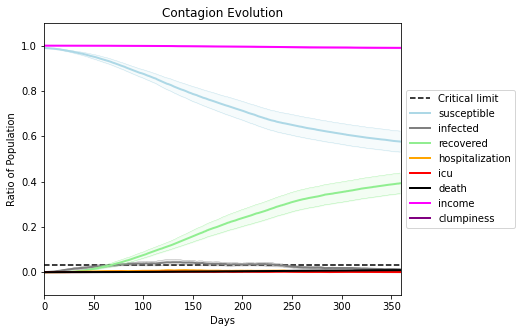

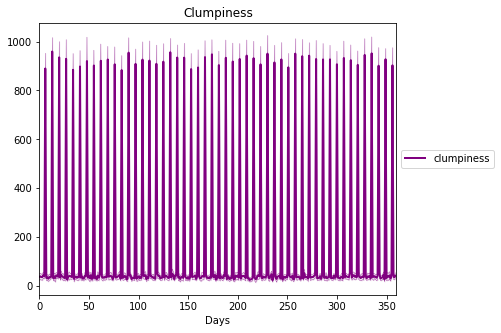

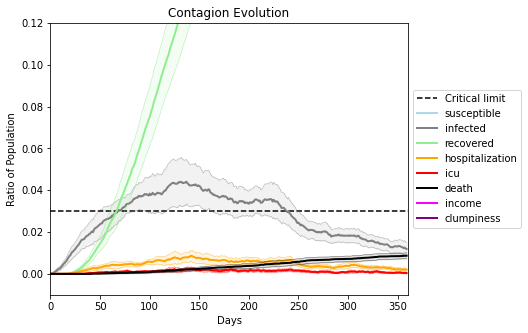

In [23]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.2
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3578, 4851, 7857, 4491, 3954, 4931, 2179, 2553, 2703, 9125, 3008, 4798, 9944, 7178, 4211, 4089, 2913, 5096, 6932, 7047]
Average similarity between family members is 0.15886771347890496 at temperature -0.1
Average similarity between family and home is 0.9998458724209763 at temperature -1
Average similarity between students and their classroom is 0.16274572749430807 at temperature -0.1
Average classroom occupancy is 1.554945054945055 and number classrooms is 182
Average similarity between workers is 0.18600141466419284 at temperature -0.1
Average office occupancy is 3.2475247524752477 and number offices is 202
Average friend similarity for adults: 0.21308960167404775 for kids: 0.20918729697254237
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.06639057275862408
avg restaurant similarity 0.013261819296495812
avg restaurant similarity 0.05609381395828012
avg restaurant similarity 0.02212124051469447
avg restaurant similarity 0.020354247639216165
avg restaurant similarity 0.10930191689295453
avg restaurant similarity 0.04444097380964508
avg restaurant similarity 0.04812211262686857
avg restaurant similarity 0.021864842152356154
avg restaurant similarity 0.053876595740887
avg restaurant similarity 0.03346517597943354
avg restaurant similarity 0.07530712715194071
avg restaurant similarity 0.08885846326649169
avg restaurant similarity 0.0813875590346836
avg restaurant similarity 0.057233323195002545
avg restaurant similarity -0.0019652258082786065
avg restaurant similarity 0.039233872829498764
avg restaurant similarity 0.0758905904474388
avg restaurant similarity 0.029833372200402497
avg restaurant similarity 0.08063523149413167
avg restaurant similarity 0.09572282683885784
avg restaurant similarity 0.0

avg restaurant similarity 0.02803154784330531
avg restaurant similarity 0.055739355275077215
avg restaurant similarity 0.04600463277757998
avg restaurant similarity 0.12179844770152383
avg restaurant similarity 0.04637650780677352
avg restaurant similarity 0.03439659203929923
avg restaurant similarity 0.08373464503095354
avg restaurant similarity 0.013606868635327183
avg restaurant similarity 0.08375273730877669
avg restaurant similarity 0.0729309406944572
avg restaurant similarity 0.03219980846970099
avg restaurant similarity 0.09835287196809626
avg restaurant similarity 0.06797029762250925
avg restaurant similarity 0.024974181433294648
avg restaurant similarity 0.025676637573650928
avg restaurant similarity 0.02429747452073625
avg restaurant similarity 0.08308921035594188
avg restaurant similarity 0.034833445966008174
avg restaurant similarity 0.06791021627019683
avg restaurant similarity 0.031056251565417123
avg restaurant similarity 0.04673461759366658
avg restaurant similarity 0.0

avg restaurant similarity 0.07049615559663955
avg restaurant similarity 0.07501304752900236
avg restaurant similarity 0.03455962027829717
avg restaurant similarity 0.10355455422632084
Average similarity between family members is 0.1930535937291468 at temperature -0.1
Average similarity between family and home is 0.9998544776167113 at temperature -1
Average similarity between students and their classroom is 0.18403863272719362 at temperature -0.1
Average classroom occupancy is 1.5480225988700564 and number classrooms is 177
Average similarity between workers is 0.15467890333095166 at temperature -0.1
Average office occupancy is 3.3465346534653464 and number offices is 202
Average friend similarity for adults: 0.2139381583223622 for kids: 0.21531488506830343
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.03208851340646729
avg restaurant similarity 0.09079772141846672
avg restaurant similarity 0.06666137705046932
avg restaurant similarity 0.0445182062691519
avg restaurant similarity 0.06578513937012619
avg restaurant similarity 0.06667942710496201
avg restaurant similarity 0.053237732071346876
avg restaurant similarity 0.030039812967902542
avg restaurant similarity 0.0656375186330861
avg restaurant similarity 0.031599131894941894
avg restaurant similarity 0.033995728942577436
avg restaurant similarity 0.013278702111303052
avg restaurant similarity 0.0392717387216343
avg restaurant similarity 0.046385208639575765
avg restaurant similarity 0.0510951189718555
avg restaurant similarity 0.041963847406516035
avg restaurant similarity 0.013376791213006724
avg restaurant similarity 0.029153597901855084
avg restaurant similarity 0.06067405285485501
avg restaurant similarity 0.02662252532252937
avg restaurant similarity 0.0298974751924924
avg restaurant similarity 0.04

avg restaurant similarity 0.02847247826999405
avg restaurant similarity 0.05673843999686563
avg restaurant similarity 0.07860599370224113
avg restaurant similarity 0.020671535881846337
avg restaurant similarity 0.07274539152453748
avg restaurant similarity 0.035827621888081626
avg restaurant similarity 0.009836831655798265
avg restaurant similarity 0.047320288020849366
avg restaurant similarity 0.08252491126619271
avg restaurant similarity 0.06715773748928444
avg restaurant similarity 0.03273285119741805
avg restaurant similarity 0.05390621876986713
avg restaurant similarity 0.0834519306019508
avg restaurant similarity 0.026294682196684356
avg restaurant similarity 0.04190315171506908
avg restaurant similarity 0.09018721600370609
avg restaurant similarity 0.04508491599723105
avg restaurant similarity 0.049943602735197795
avg restaurant similarity 0.07990201873609365
avg restaurant similarity 0.07771433996641333
avg restaurant similarity -0.0028269398603462254
avg restaurant similarity 

avg restaurant similarity 0.06405494572642072
avg restaurant similarity 0.03552067612386403
avg restaurant similarity 0.048447588707825
avg restaurant similarity 0.0387193982844539
Average similarity between family members is 0.1549730320594133 at temperature -0.1
Average similarity between family and home is 0.9998534235877251 at temperature -1
Average similarity between students and their classroom is 0.17454651538677757 at temperature -0.1
Average classroom occupancy is 1.668639053254438 and number classrooms is 169
Average similarity between workers is 0.13678739755629538 at temperature -0.1
Average office occupancy is 3.318407960199005 and number offices is 201
Average friend similarity for adults: 0.21364583648619734 for kids: 0.21494388921460936
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.09427309746224108
avg restaurant similarity 0.08500722652926972
avg restaurant similarity 0.06003877720642839
avg restaurant similarity 0.07271506748355554
avg restaurant similarity 0.09623853497103203
avg restaurant similarity 0.057873918578876346
avg restaurant similarity 0.06904354562939675
avg restaurant similarity 0.03506894004068618
avg restaurant similarity 0.017999710334765634
avg restaurant similarity 0.07001813523044495
avg restaurant similarity -0.015350264805852559
avg restaurant similarity 0.03149979284827071
avg restaurant similarity 0.03792723839828457
avg restaurant similarity 0.04631493130295628
avg restaurant similarity 0.04508696316158203
avg restaurant similarity 0.11995381004786805
avg restaurant similarity 0.05825145308907892
avg restaurant similarity 0.05169654541628347
avg restaurant similarity 0.08171535130394225
avg restaurant similarity 0.049950642229575494
avg restaurant similarity 0.0093389803824609
avg restaurant similarity 0.06

avg restaurant similarity 0.047532246908323014
avg restaurant similarity 0.09224642537596686
avg restaurant similarity 0.07034284712435647
avg restaurant similarity 0.06345035643280306
avg restaurant similarity 0.06849611744647377
avg restaurant similarity 0.07600518939751935
avg restaurant similarity 0.013059873251804192
avg restaurant similarity 0.022846727021087924
avg restaurant similarity 0.00047499338533953193
avg restaurant similarity 0.05519140534192826
avg restaurant similarity 0.09290800102679155
avg restaurant similarity 0.10796099687482187
avg restaurant similarity 0.11862682686658386
avg restaurant similarity 0.012192548477119147
avg restaurant similarity -0.0015193834518278677
avg restaurant similarity 0.07283202428475696
avg restaurant similarity 0.05821021077965144
avg restaurant similarity 0.06452591470799332
avg restaurant similarity 0.05428624347925194
avg restaurant similarity 0.0773170410644759
avg restaurant similarity 0.01894619327986966
avg restaurant similarity

avg restaurant similarity 0.07222466461399575
avg restaurant similarity 0.03390587201806978
avg restaurant similarity 0.03277411811271851
avg restaurant similarity 0.051664373827893004
avg restaurant similarity 0.033404439887994214
Average similarity between family members is 0.139709958936545 at temperature -0.1
Average similarity between family and home is 0.9998499237744742 at temperature -1
Average similarity between students and their classroom is 0.1237318471345741 at temperature -0.1
Average classroom occupancy is 1.5895953757225434 and number classrooms is 173
Average similarity between workers is 0.163018680156656 at temperature -0.1
Average office occupancy is 3.3366336633663365 and number offices is 202
Average friend similarity for adults: 0.2074630869586593 for kids: 0.20851831899708761
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people alloca

avg restaurant similarity 0.036024652491352574
avg restaurant similarity 0.07911561737243877
avg restaurant similarity -0.015966255433694232
avg restaurant similarity 0.059792590079666925
avg restaurant similarity 0.056533400521075215
avg restaurant similarity 0.07092437663527372
avg restaurant similarity 0.07718446344950926
avg restaurant similarity 0.10326210699816979
avg restaurant similarity 0.07253745949043204
avg restaurant similarity 0.05611643153379201
avg restaurant similarity 0.031332711026166325
avg restaurant similarity 0.06716954953838093
avg restaurant similarity 0.052127848382314795
avg restaurant similarity 0.016527736661803585
avg restaurant similarity 0.05806204280187675
avg restaurant similarity 0.06016218694729952
avg restaurant similarity 0.041049018805090175
avg restaurant similarity 0.058764362994390175
avg restaurant similarity 0.10769445717690518
avg restaurant similarity 0.10117936753404404
avg restaurant similarity 0.09044231844581081
avg restaurant similarit

avg restaurant similarity 0.08379570011427076
avg restaurant similarity 0.10161888862458449
avg restaurant similarity 0.06954223068650352
avg restaurant similarity 0.032132969591069774
avg restaurant similarity 0.07953042434038891
avg restaurant similarity 0.04850122425150802
avg restaurant similarity 0.024993191418167544
avg restaurant similarity 0.08302896085804087
avg restaurant similarity 0.06945074230284808
avg restaurant similarity 0.05287776633685669
avg restaurant similarity 0.051162841140341406
avg restaurant similarity 0.058606325524672334
avg restaurant similarity 0.02380975138116486
avg restaurant similarity 0.04823801099463627
avg restaurant similarity -0.01464674079952183
avg restaurant similarity 0.07060963378567632
avg restaurant similarity 0.08906075226169705
avg restaurant similarity 0.08598920939065333
avg restaurant similarity 0.10600182602514496
avg restaurant similarity 0.08530933279797483
avg restaurant similarity 0.08960512494853942
avg restaurant similarity 0.0

avg restaurant similarity 0.08850479460378542
avg restaurant similarity 0.012849608212844648
avg restaurant similarity 0.04648834668403218
avg restaurant similarity 0.046534503585624665
Average similarity between family members is 0.15584337855744687 at temperature -0.1
Average similarity between family and home is 0.9998530333609764 at temperature -1
Average similarity between students and their classroom is 0.12947765376877668 at temperature -0.1
Average classroom occupancy is 1.574585635359116 and number classrooms is 181
Average similarity between workers is 0.15989001628259086 at temperature -0.1
Average office occupancy is 3.2718446601941746 and number offices is 206
Average friend similarity for adults: 0.20295865566180807 for kids: 0.20371708960810195
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) distr

avg restaurant similarity 0.03246049398814437
avg restaurant similarity 0.03610284878977827
avg restaurant similarity 0.06644816803386011
avg restaurant similarity 0.0044459868087764025
avg restaurant similarity 0.05349398610147836
avg restaurant similarity 0.05350071819080886
avg restaurant similarity 0.014747468534817102
avg restaurant similarity 0.05959639253185049
avg restaurant similarity 0.04260828947068738
avg restaurant similarity 0.07022073426713782
avg restaurant similarity 0.04331709241751722
avg restaurant similarity -0.016885583652196185
avg restaurant similarity 0.04816665932212301
avg restaurant similarity 0.061332226558586216
avg restaurant similarity 0.08207482787738107
avg restaurant similarity 0.04792747853755881
avg restaurant similarity 0.07234355634842267
avg restaurant similarity 0.05556396199460662
avg restaurant similarity 0.04443896100797988
avg restaurant similarity 0.06121631735989614
avg restaurant similarity 0.04444573050556075
avg restaurant similarity 0.

avg restaurant similarity 0.08668918717719523
avg restaurant similarity 0.04536908563773861
avg restaurant similarity 0.05005645989284054
avg restaurant similarity 0.027687131373810063
avg restaurant similarity 0.02558486930197718
avg restaurant similarity 0.023632083446161623
avg restaurant similarity 0.015956218237481407
avg restaurant similarity -0.008056519424352244
avg restaurant similarity 0.06626836677170904
avg restaurant similarity 0.05387279696901195
avg restaurant similarity 0.046019269489780225
avg restaurant similarity 0.04527041609088053
avg restaurant similarity 0.05955052363684629
avg restaurant similarity 0.01928997109794171
avg restaurant similarity 0.05206852281372027
avg restaurant similarity 0.1027778780665299
avg restaurant similarity 0.07247186026589002
avg restaurant similarity 0.03173542269798645
avg restaurant similarity 0.05445268184176517
avg restaurant similarity 0.056923354753957274
avg restaurant similarity 0.06938887647312436
avg restaurant similarity 0.

avg restaurant similarity 0.04667463333668958
avg restaurant similarity 0.03874287354193718
avg restaurant similarity 0.10145957682659187
avg restaurant similarity 0.07670196233716062
avg restaurant similarity 0.06598541150339207
Average similarity between family members is 0.14713956302484021 at temperature -0.1
Average similarity between family and home is 0.9998541696077395 at temperature -1
Average similarity between students and their classroom is 0.18148256938982624 at temperature -0.1
Average classroom occupancy is 1.6272189349112427 and number classrooms is 169
Average similarity between workers is 0.15539884134778031 at temperature -0.1
Average office occupancy is 3.2233009708737863 and number offices is 206
Average friend similarity for adults: 0.21528448863136074 for kids: 0.2162497298941908
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people all

avg restaurant similarity 0.062200591345473046
avg restaurant similarity 0.09949343844660956
avg restaurant similarity 0.07325223533514044
avg restaurant similarity 0.06208821977130744
avg restaurant similarity 0.058571771114152904
avg restaurant similarity 0.07307899811459248
avg restaurant similarity 0.08210803385725621
avg restaurant similarity 0.040157734671859596
avg restaurant similarity 0.08323597933099607
avg restaurant similarity 0.02277769829816322
avg restaurant similarity 0.08925675531884235
avg restaurant similarity 0.059282417375189314
avg restaurant similarity 0.021425382294108834
avg restaurant similarity 0.09050576057564255
avg restaurant similarity 0.10407534229191603
avg restaurant similarity 0.062139119439429645
avg restaurant similarity 0.04256510216076067
avg restaurant similarity 0.07576722820993641
avg restaurant similarity 0.10450260656036364
avg restaurant similarity 0.04146647699072805
avg restaurant similarity 0.021914429296976307
avg restaurant similarity 0

avg restaurant similarity 0.009468674495056836
avg restaurant similarity 0.0715522372289792
avg restaurant similarity 0.10451998076322626
avg restaurant similarity 0.06685536740826638
avg restaurant similarity 0.0775049635204933
avg restaurant similarity 0.0469294301760002
avg restaurant similarity 0.10691570734021333
avg restaurant similarity 0.06158014584526734
avg restaurant similarity 0.07608849741597655
avg restaurant similarity 0.05562698158478661
avg restaurant similarity 0.09233232915169669
avg restaurant similarity 0.07943981556704721
avg restaurant similarity 0.1156498762527527
avg restaurant similarity 0.028854141215883124
avg restaurant similarity 0.050433940570821456
avg restaurant similarity 0.06412659770498005
avg restaurant similarity 0.09400197200490883
avg restaurant similarity 0.07034429897843547
avg restaurant similarity 0.04020183541029083
avg restaurant similarity 0.06701547184632765
avg restaurant similarity 0.07448619473313486
avg restaurant similarity 0.0678962

avg restaurant similarity 0.12179706857704083
avg restaurant similarity 0.0843068413366726
avg restaurant similarity 0.07764604282516038
Average similarity between family members is 0.15509076494477775 at temperature -0.1
Average similarity between family and home is 0.9998600665821258 at temperature -1
Average similarity between students and their classroom is 0.15316864095987387 at temperature -0.1
Average classroom occupancy is 1.5209580838323353 and number classrooms is 167
Average similarity between workers is 0.13370406359830894 at temperature -0.1
Average office occupancy is 3.3930348258706466 and number offices is 201
Average friend similarity for adults: 0.20173617819000023 for kids: 0.20432124949806865
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.06208699523369843
avg restaurant similarity 0.00907330031727869
avg restaurant similarity 0.05087545542511042
avg restaurant similarity 0.0695743219730699
avg restaurant similarity 0.060488329390985945
avg restaurant similarity 0.080784716799038
avg restaurant similarity 0.05118895955907256
avg restaurant similarity 0.06983880531997115
avg restaurant similarity 0.07197980336741551
avg restaurant similarity 0.018365336662961623
avg restaurant similarity 0.0527798609102451
avg restaurant similarity 0.01895455376464049
avg restaurant similarity 0.05211545189177753
avg restaurant similarity 0.06437106670938084
avg restaurant similarity 0.08512137569967894
avg restaurant similarity 0.059228700805021406
avg restaurant similarity -0.009640838975601774
avg restaurant similarity 0.043507347427256614
avg restaurant similarity 0.03750641524875721
avg restaurant similarity 0.057056965023034055
avg restaurant similarity 0.0756058938741514
avg restaurant similarity 0.0330

avg restaurant similarity 0.037263377698725224
avg restaurant similarity 0.041230462767959185
avg restaurant similarity 0.018670417734764282
avg restaurant similarity 0.0933506391964755
avg restaurant similarity 0.04132413593954087
avg restaurant similarity 0.01851760671401881
avg restaurant similarity 0.0573721074245834
avg restaurant similarity 0.021597636864874044
avg restaurant similarity 0.030518937750268007
avg restaurant similarity 0.014940868486140464
avg restaurant similarity 0.043349027697128666
avg restaurant similarity 0.07133211202126509
avg restaurant similarity 0.06509129390143481
avg restaurant similarity 0.009494009725478198
avg restaurant similarity 0.061332210976528016
avg restaurant similarity 0.04288020678811189
avg restaurant similarity 0.05477906251915153
avg restaurant similarity 0.048722303952724436
avg restaurant similarity 0.0343287796645443
avg restaurant similarity 0.05137863406651944
avg restaurant similarity 0.041229899213252215
avg restaurant similarity 

avg restaurant similarity 0.025422331041645537
avg restaurant similarity -0.004121497348999018
avg restaurant similarity 0.04369973346051728
avg restaurant similarity 0.008482823514829605
avg restaurant similarity 0.026825415613281126
avg restaurant similarity 0.07716792104098553
Average similarity between family members is 0.15804850170589674 at temperature -0.1
Average similarity between family and home is 0.999867951371334 at temperature -1
Average similarity between students and their classroom is 0.19465341025382918 at temperature -0.1
Average classroom occupancy is 1.6646706586826348 and number classrooms is 167
Average similarity between workers is 0.16017289487648237 at temperature -0.1
Average office occupancy is 3.3582089552238807 and number offices is 201
Average friend similarity for adults: 0.2056222906810773 for kids: 0.21453411407632825
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units

avg restaurant similarity 0.05524534620490972
avg restaurant similarity 0.018740375635945924
avg restaurant similarity 0.06021410779637798
avg restaurant similarity 0.06866797963563682
avg restaurant similarity 0.05668492737161323
avg restaurant similarity 0.08816152992287374
avg restaurant similarity 0.07728776336599703
avg restaurant similarity 0.06968569316696227
avg restaurant similarity 0.08494224269186773
avg restaurant similarity 0.04371042491367921
avg restaurant similarity 0.08863240846348622
avg restaurant similarity 0.04462016456122534
avg restaurant similarity 0.07613296018820923
avg restaurant similarity 0.07202908603520224
avg restaurant similarity 0.012926072837573629
avg restaurant similarity 0.07228874515063227
avg restaurant similarity 0.046893172100101556
avg restaurant similarity 0.1481048844994255
avg restaurant similarity 0.08938641056534907
avg restaurant similarity 0.08940595210008404
avg restaurant similarity 0.09826920568006402
avg restaurant similarity 0.0402

avg restaurant similarity 0.12482658200804654
avg restaurant similarity 0.11131207715419406
avg restaurant similarity 0.11437911657735866
avg restaurant similarity 0.055646281725942326
avg restaurant similarity 0.09798028910405522
avg restaurant similarity -0.00841084756916762
avg restaurant similarity 0.08101153939058651
avg restaurant similarity 0.07238373412085725
avg restaurant similarity 0.05168393382945482
avg restaurant similarity 0.10979786836789983
avg restaurant similarity 0.13058479764156836
avg restaurant similarity 0.08799191402334723
avg restaurant similarity 0.0916046001864554
avg restaurant similarity 0.1127290711651015
avg restaurant similarity 0.05164564774689046
avg restaurant similarity 0.07139010407530856
avg restaurant similarity 0.04270880511241307
avg restaurant similarity 0.058171470459751705
avg restaurant similarity 0.03792808289897811
avg restaurant similarity 0.12360940147605089
avg restaurant similarity 0.13548540508707582
avg restaurant similarity 0.12826

avg restaurant similarity 0.0392130746773407
avg restaurant similarity 0.06046147089164375
avg restaurant similarity 0.0343499210507941
Average similarity between family members is 0.1483089039446143 at temperature -0.1
Average similarity between family and home is 0.999861479302412 at temperature -1
Average similarity between students and their classroom is 0.15959729377373177 at temperature -0.1
Average classroom occupancy is 1.5757575757575757 and number classrooms is 198
Average similarity between workers is 0.13428947585581472 at temperature -0.1
Average office occupancy is 3.2436548223350252 and number offices is 197
Average friend similarity for adults: 0.20114751069795464 for kids: 0.20543287343518912
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.04511105611894161
avg restaurant similarity 0.03633244661984893
avg restaurant similarity 0.07494856832471818
avg restaurant similarity 0.03499214576086816
avg restaurant similarity 0.0576172640135581
avg restaurant similarity 0.047779832459321096
avg restaurant similarity 0.04618830427349318
avg restaurant similarity 0.07554171912304602
avg restaurant similarity 0.017284117581451236
avg restaurant similarity 0.08573618025446005
avg restaurant similarity 0.0710170485337247
avg restaurant similarity 0.06373151239228941
avg restaurant similarity 0.0758515837021933
avg restaurant similarity 0.06873172115868184
avg restaurant similarity 0.026607205211230146
avg restaurant similarity 0.0654693270336357
avg restaurant similarity 0.05589401044683456
avg restaurant similarity 0.09175580793276111
avg restaurant similarity 0.04312308663040587
avg restaurant similarity 0.06781572612751884
avg restaurant similarity 0.08015667890947606
avg restaurant similarity 0.0492349

avg restaurant similarity 0.06947385282411743
avg restaurant similarity 0.047329902972120114
avg restaurant similarity 0.0645610025526716
avg restaurant similarity 0.018097605177515397
avg restaurant similarity 0.09480515045358098
avg restaurant similarity 0.07988265599765772
avg restaurant similarity 0.07144973802314876
avg restaurant similarity 0.08751042186789595
avg restaurant similarity 0.09408845244671679
avg restaurant similarity 0.04073238426125041
avg restaurant similarity 0.067716097665772
avg restaurant similarity 0.05957613735080903
avg restaurant similarity 0.06810956068709298
avg restaurant similarity 0.06375967232377151
avg restaurant similarity 0.06858197130789914
avg restaurant similarity 0.07331802069055332
avg restaurant similarity 0.07086743132402439
avg restaurant similarity 0.05709597219673777
avg restaurant similarity 0.035891359884429305
avg restaurant similarity 0.07588546813645462
avg restaurant similarity 0.042615082673889894
avg restaurant similarity 0.04910

avg restaurant similarity 0.05982425214369698
avg restaurant similarity 0.02819229814652197
avg restaurant similarity 0.05165922676068322
avg restaurant similarity 0.026015990613279135
Average similarity between family members is 0.16550567322345966 at temperature -0.1
Average similarity between family and home is 0.9998670854331966 at temperature -1
Average similarity between students and their classroom is 0.19151633738463655 at temperature -0.1
Average classroom occupancy is 1.6486486486486487 and number classrooms is 185
Average similarity between workers is 0.16413273909758463 at temperature -0.1
Average office occupancy is 3.1921182266009853 and number offices is 203
Average friend similarity for adults: 0.20804835561676352 for kids: 0.22119536888308944
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) distr

avg restaurant similarity 0.11290740338708709
avg restaurant similarity 0.08279108320562097
avg restaurant similarity 0.04882738431236278
avg restaurant similarity 0.05864072124322441
avg restaurant similarity 0.043160214558816724
avg restaurant similarity 0.0405587479892267
avg restaurant similarity 0.10430168187267362
avg restaurant similarity 0.025993665258939473
avg restaurant similarity 0.08154417070084632
avg restaurant similarity 0.07342857524694821
avg restaurant similarity 0.060183237670695736
avg restaurant similarity 0.06381609382999226
avg restaurant similarity 0.10016048171872398
avg restaurant similarity 0.05770180677971878
avg restaurant similarity 0.015991423947699614
avg restaurant similarity 0.027578927689333673
avg restaurant similarity 0.0034736723442688228
avg restaurant similarity 0.06365712374819997
avg restaurant similarity 0.08831034441822076
avg restaurant similarity 0.0936613037329142
avg restaurant similarity 0.10208854670207179
avg restaurant similarity 0.0

avg restaurant similarity 0.08897290843560207
avg restaurant similarity 0.09193002170816802
avg restaurant similarity 0.026420496755228125
avg restaurant similarity 0.09169285853848226
avg restaurant similarity 0.06009627881558846
avg restaurant similarity 0.07802051595137122
avg restaurant similarity 0.07459872702269955
avg restaurant similarity 0.0526777111625644
avg restaurant similarity 0.03505307142079784
avg restaurant similarity 0.028706680993347854
avg restaurant similarity 0.0840634057126061
avg restaurant similarity 0.08644775214097628
avg restaurant similarity 0.07801564652143905
avg restaurant similarity 0.061710366502799166
avg restaurant similarity 0.044057699057892
avg restaurant similarity 0.06794706836727823
avg restaurant similarity 0.027788678513281668
avg restaurant similarity 0.07451578370481812
avg restaurant similarity 0.05473953541012502
avg restaurant similarity 0.06573349716777227
avg restaurant similarity 0.042867356786739814
avg restaurant similarity 0.04296

avg restaurant similarity 0.025728189314860466
avg restaurant similarity 0.05093479204272805
avg restaurant similarity 0.08359943515656999
avg restaurant similarity 0.06079967533070724
Average similarity between family members is 0.15746676956998207 at temperature -0.1
Average similarity between family and home is 0.9998447064967815 at temperature -1
Average similarity between students and their classroom is 0.19124117467872853 at temperature -0.1
Average classroom occupancy is 1.549738219895288 and number classrooms is 191
Average similarity between workers is 0.1585609247755567 at temperature -0.1
Average office occupancy is 3.1323529411764706 and number offices is 204
Average friend similarity for adults: 0.208267772605723 for kids: 0.21935888985153523
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.07041927770574681
avg restaurant similarity 0.09590766842724471
avg restaurant similarity 0.053887556422647816
avg restaurant similarity 0.05236136478829112
avg restaurant similarity 0.05469982243416286
avg restaurant similarity 0.07544366891785653
avg restaurant similarity 0.09363016395698588
avg restaurant similarity 0.07463592584120037
avg restaurant similarity 0.04584588433056504
avg restaurant similarity 0.020720320686408136
avg restaurant similarity 0.10587263462870541
avg restaurant similarity 0.06764627342950935
avg restaurant similarity -0.0012381812495521568
avg restaurant similarity 0.05575962350891224
avg restaurant similarity 0.050557388950412584
avg restaurant similarity 0.08193754608487377
avg restaurant similarity 0.07849756078181863
avg restaurant similarity 0.08912617690144284
avg restaurant similarity 0.09577326307049229
avg restaurant similarity 0.09752534512535606
avg restaurant similarity 0.05381374080406415
avg restaurant similarity 0.

avg restaurant similarity 0.08481098849257354
avg restaurant similarity 0.07285371821611439
avg restaurant similarity 0.08898627300990274
avg restaurant similarity 0.08590711011134633
avg restaurant similarity 0.05251174054933146
avg restaurant similarity 0.0552290822769362
avg restaurant similarity 0.06278000723288472
avg restaurant similarity 0.09150695323786132
avg restaurant similarity 0.05344334293812757
avg restaurant similarity 0.11169030784092365
avg restaurant similarity 0.05709585200763916
avg restaurant similarity 0.09372565009613666
avg restaurant similarity 0.08996813588323946
avg restaurant similarity 0.055094826889028385
avg restaurant similarity 0.10004959004080727
avg restaurant similarity 0.07066206701046698
avg restaurant similarity 0.07141809971453064
avg restaurant similarity 0.017816168326712085
avg restaurant similarity 0.08958592033860936
avg restaurant similarity 0.1262351349531774
avg restaurant similarity 0.10305618419644122
avg restaurant similarity 0.043037

avg restaurant similarity 0.034124666551330216
avg restaurant similarity 0.08777768539718399
avg restaurant similarity 0.09313801498699158
Average similarity between family members is 0.15036212017369 at temperature -0.1
Average similarity between family and home is 0.9998537415868602 at temperature -1
Average similarity between students and their classroom is 0.18520981156836044 at temperature -0.1
Average classroom occupancy is 1.6571428571428573 and number classrooms is 175
Average similarity between workers is 0.16961113888542548 at temperature -0.1
Average office occupancy is 3.232673267326733 and number offices is 202
Average friend similarity for adults: 0.20410187664480708 for kids: 0.2136190767828022
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (e

avg restaurant similarity 0.09849876943572608
avg restaurant similarity 0.08092061130342161
avg restaurant similarity 0.06663875101595601
avg restaurant similarity 0.05619169595897893
avg restaurant similarity 0.034158953889429404
avg restaurant similarity 0.07395575602411633
avg restaurant similarity 0.06280363417928438
avg restaurant similarity 0.05047035382034862
avg restaurant similarity 0.06810714191490276
avg restaurant similarity 0.03982193251245488
avg restaurant similarity 0.046821912634402905
avg restaurant similarity 0.08876659680227757
avg restaurant similarity 0.10493945470135764
avg restaurant similarity 0.028055398324001418
avg restaurant similarity 0.0705307924598204
avg restaurant similarity 0.09014234357662618
avg restaurant similarity 0.021851165871219512
avg restaurant similarity 0.09438109381819497
avg restaurant similarity 0.09149585386943719
avg restaurant similarity 0.09405825583576212
avg restaurant similarity 0.04482336319576823
avg restaurant similarity 0.071

avg restaurant similarity 0.06954614351974693
avg restaurant similarity -0.004755601029094361
avg restaurant similarity 0.10274532898761124
avg restaurant similarity 0.04910102296646623
avg restaurant similarity 0.1477961061176615
avg restaurant similarity 0.09189182624758799
avg restaurant similarity 0.053713296992608454
avg restaurant similarity 0.12122861403780927
avg restaurant similarity 0.03875551203124945
avg restaurant similarity 0.09542228284803786
avg restaurant similarity 0.0630399079162735
avg restaurant similarity 0.07495979781829042
avg restaurant similarity 0.02569611034463327
avg restaurant similarity 0.12008447600972179
avg restaurant similarity -0.009081239940470318
avg restaurant similarity 0.10745046315314026
avg restaurant similarity 0.070335984482576
avg restaurant similarity 0.10163072463593462
avg restaurant similarity 0.052571014839106894
avg restaurant similarity 0.10423065800339652
avg restaurant similarity 0.08049293620972948
avg restaurant similarity 0.0224

avg restaurant similarity 0.07806146698057757
avg restaurant similarity 0.06325691407963373
avg restaurant similarity 0.057449690388736104
Average similarity between family members is 0.16375297481490397 at temperature -0.1
Average similarity between family and home is 0.9998623681832393 at temperature -1
Average similarity between students and their classroom is 0.1704512113017995 at temperature -0.1
Average classroom occupancy is 1.6785714285714286 and number classrooms is 168
Average similarity between workers is 0.16591086057460294 at temperature -0.1
Average office occupancy is 3.32 and number offices is 200
Average friend similarity for adults: 0.2001541309003543 for kids: 0.2170539396455907
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with cap

avg restaurant similarity 0.04381158348222888
avg restaurant similarity 0.009558508984244587
avg restaurant similarity 0.01010419784335911
avg restaurant similarity 0.09206016827858587
avg restaurant similarity 0.04272367529966114
avg restaurant similarity 0.09500317922488839
avg restaurant similarity 0.03670436015876244
avg restaurant similarity 0.02712795234000139
avg restaurant similarity 0.03643352279163123
avg restaurant similarity 0.029812983157265497
avg restaurant similarity 0.04801032455111899
avg restaurant similarity 0.029867044811066296
avg restaurant similarity 0.04660283880044879
avg restaurant similarity 0.07863458617541744
avg restaurant similarity 0.036489797167394256
avg restaurant similarity 0.05317010271524761
avg restaurant similarity 0.06782306176239125
avg restaurant similarity 0.04490379889378533
avg restaurant similarity 0.10287343851246501
avg restaurant similarity 0.06883520775109446
avg restaurant similarity 0.06130885600008615
avg restaurant similarity 0.05

avg restaurant similarity 0.060230932930704
avg restaurant similarity 0.03903266901522188
avg restaurant similarity 0.05647007715366121
avg restaurant similarity 0.0794243872659196
avg restaurant similarity 0.042834963799723805
avg restaurant similarity 0.022452632175820646
avg restaurant similarity -0.00811785086129674
avg restaurant similarity 0.0253422822439393
avg restaurant similarity 0.07570984505654418
avg restaurant similarity 0.029893320456646506
avg restaurant similarity 0.005969265552927199
avg restaurant similarity 0.04322384254280571
avg restaurant similarity 0.07044201783863409
avg restaurant similarity 0.06043745685728912
avg restaurant similarity 0.053360100407466166
avg restaurant similarity 0.03243517679548144
avg restaurant similarity 0.04276318360824024
avg restaurant similarity 0.07327337178467618
avg restaurant similarity 0.10355030801835186
avg restaurant similarity 0.02478486882797689
avg restaurant similarity 0.03632662462348386
avg restaurant similarity 0.0259

avg restaurant similarity 0.0352463433912929
avg restaurant similarity 0.07096724690361862
avg restaurant similarity 0.046411394324422484
avg restaurant similarity 0.036740109023702915
avg restaurant similarity 0.015689922532812938
avg restaurant similarity 0.06789471021031478
Average similarity between family members is 0.16828283126584206 at temperature -0.1
Average similarity between family and home is 0.9998410703549021 at temperature -1
Average similarity between students and their classroom is 0.20614911448823703 at temperature -0.1
Average classroom occupancy is 1.6519337016574585 and number classrooms is 181
Average similarity between workers is 0.157130289032702 at temperature -0.1
Average office occupancy is 3.1782178217821784 and number offices is 202
Average friend similarity for adults: 0.20253578231292746 for kids: 0.22463206798232466
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units wi

avg restaurant similarity 0.06540134100092114
avg restaurant similarity 0.10202190397915564
avg restaurant similarity 0.10737603209599939
avg restaurant similarity 0.06609805090850968
avg restaurant similarity 0.06535835405163501
avg restaurant similarity 0.1121040556308659
avg restaurant similarity 0.03689692005521054
avg restaurant similarity 0.05623071596875069
avg restaurant similarity 0.03480803110030779
avg restaurant similarity 0.04721951083613743
avg restaurant similarity 0.04867548305702486
avg restaurant similarity 0.02694761512549657
avg restaurant similarity 0.03839848697000799
avg restaurant similarity 0.04381833890409732
avg restaurant similarity 0.06745071272892211
avg restaurant similarity 0.04307080857058719
avg restaurant similarity 0.08257872947493557
avg restaurant similarity 0.020234455108970036
avg restaurant similarity 0.06611190967430668
avg restaurant similarity 0.07590435860890114
avg restaurant similarity 0.08572685893934007
avg restaurant similarity 0.079698

avg restaurant similarity 0.03760445454980116
avg restaurant similarity 0.07215078206490279
avg restaurant similarity 0.0979266840749215
avg restaurant similarity 0.10842142468615097
avg restaurant similarity 0.09925730410178583
avg restaurant similarity 0.07744497018607269
avg restaurant similarity 0.07015562033439494
avg restaurant similarity 0.10551802113667592
avg restaurant similarity 0.03444456394525115
avg restaurant similarity 0.06127297016772567
avg restaurant similarity 0.13136213611501482
avg restaurant similarity 0.09284000542587799
avg restaurant similarity 0.03277858846469904
avg restaurant similarity 0.09037244129435337
avg restaurant similarity 0.12438909620196359
avg restaurant similarity 0.06758872792793577
avg restaurant similarity 0.028298019316403793
avg restaurant similarity 0.09195294065107959
avg restaurant similarity 0.06620148828126501
avg restaurant similarity 0.0914201217468958
avg restaurant similarity 0.06787370351361598
avg restaurant similarity 0.0548792

avg restaurant similarity 0.07284390614462091
avg restaurant similarity 0.05200550970354587
avg restaurant similarity 0.10901372496249444
avg restaurant similarity 0.017069002507019655
Average similarity between family members is 0.17183302144167695 at temperature -0.1
Average similarity between family and home is 0.9998621719158383 at temperature -1
Average similarity between students and their classroom is 0.17236517020387562 at temperature -0.1
Average classroom occupancy is 1.6235955056179776 and number classrooms is 178
Average similarity between workers is 0.15801929126802988 at temperature -0.1
Average office occupancy is 3.3401015228426396 and number offices is 197
Average friend similarity for adults: 0.20929337897165462 for kids: 0.21078409896004183
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.04597673207195715
avg restaurant similarity 0.011362651589247909
avg restaurant similarity 0.044335894658803957
avg restaurant similarity 0.05158691219168855
avg restaurant similarity 0.10384736114517679
avg restaurant similarity 0.06569503079880241
avg restaurant similarity 0.07097415072397249
avg restaurant similarity 0.07287973873276442
avg restaurant similarity 0.05531448654878579
avg restaurant similarity 0.02119502091843111
avg restaurant similarity 0.10017285150850322
avg restaurant similarity 0.046419247214924075
avg restaurant similarity 0.02675200528059019
avg restaurant similarity 0.043716336973949485
avg restaurant similarity 0.06233328748978247
avg restaurant similarity 0.03750927385085613
avg restaurant similarity 0.04044480922998988
avg restaurant similarity 0.06397467318218952
avg restaurant similarity 0.07445862787914634
avg restaurant similarity 0.030580439198356433
avg restaurant similarity 0.041509967999017544
avg restaurant similarity 0.

avg restaurant similarity 0.07091373484656578
avg restaurant similarity 0.02211959277821971
avg restaurant similarity 0.03048758528630551
avg restaurant similarity 0.044050359978327125
avg restaurant similarity -0.0031379807702822935
avg restaurant similarity 0.10591316030751768
avg restaurant similarity 0.06313039239791536
avg restaurant similarity 0.02138473968931304
avg restaurant similarity 0.033061988876233336
avg restaurant similarity 0.0527639399346638
avg restaurant similarity 0.05816491141309283
avg restaurant similarity 0.06778275718399944
avg restaurant similarity 0.006285485747975152
avg restaurant similarity -0.016502396487147998
avg restaurant similarity 0.10828821486073772
avg restaurant similarity 0.06772602833837851
avg restaurant similarity 0.036914961120894096
avg restaurant similarity 0.052066913056854264
avg restaurant similarity 0.061585586617405305
avg restaurant similarity 0.05572646730904918
avg restaurant similarity 0.027429568715138006
avg restaurant similari

avg restaurant similarity 0.07034622339633936
avg restaurant similarity 0.06064703867858921
avg restaurant similarity 0.07383348586021375
avg restaurant similarity 0.06251549768929347
Average similarity between family members is 0.1718306191024981 at temperature -0.1
Average similarity between family and home is 0.9998511982636799 at temperature -1
Average similarity between students and their classroom is 0.21320666683535947 at temperature -0.1
Average classroom occupancy is 1.5792349726775956 and number classrooms is 183
Average similarity between workers is 0.1451859011147435 at temperature -0.1
Average office occupancy is 3.306532663316583 and number offices is 199
Average friend similarity for adults: 0.21908367283344296 for kids: 0.20986551213690507
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.05794803168534694
avg restaurant similarity 0.10046809978198194
avg restaurant similarity 0.060956753135662206
avg restaurant similarity 0.07494113265403116
avg restaurant similarity 0.08395013017175318
avg restaurant similarity 0.09615092154987684
avg restaurant similarity 0.04590042302075764
avg restaurant similarity 0.06940883904008292
avg restaurant similarity 0.05412752964512987
avg restaurant similarity 0.07636412231642382
avg restaurant similarity 0.060557710995094716
avg restaurant similarity 0.07219298725479824
avg restaurant similarity 0.06972474318745445
avg restaurant similarity 0.046048898390646194
avg restaurant similarity 0.10202816189424416
avg restaurant similarity 0.06290274013794334
avg restaurant similarity 0.042855808287539
avg restaurant similarity 0.10521442792648439
avg restaurant similarity 0.09671876337073398
avg restaurant similarity 0.07907752130797469
avg restaurant similarity 0.10026588746624311
avg restaurant similarity 0.06832

avg restaurant similarity 0.07820320102328415
avg restaurant similarity 0.0991604669551495
avg restaurant similarity 0.03980220798376681
avg restaurant similarity 0.09724685077755339
avg restaurant similarity 0.10307698411767047
avg restaurant similarity 0.10748805858741126
avg restaurant similarity 0.061229312555484874
avg restaurant similarity 0.07010991725908935
avg restaurant similarity 0.049843281779341296
avg restaurant similarity 0.10505326214812834
avg restaurant similarity 0.09685596700916226
avg restaurant similarity 0.06416272954791676
avg restaurant similarity 0.0711842919953428
avg restaurant similarity 0.013712866916542622
avg restaurant similarity 0.07977683757943631
avg restaurant similarity 0.09299821926753303
avg restaurant similarity 0.08059602746832223
avg restaurant similarity 0.0766114908368835
avg restaurant similarity 0.07844291750712207
avg restaurant similarity 0.07548599665635904
avg restaurant similarity 0.08060402311359471
avg restaurant similarity 0.069696

avg restaurant similarity 0.09074447873608986
avg restaurant similarity 0.0954029829050351
Average similarity between family members is 0.1315872520067149 at temperature -0.1
Average similarity between family and home is 0.9998346617469902 at temperature -1
Average similarity between students and their classroom is 0.19252090541608208 at temperature -0.1
Average classroom occupancy is 1.5988372093023255 and number classrooms is 172
Average similarity between workers is 0.1865078199843217 at temperature -0.1
Average office occupancy is 3.2487804878048783 and number offices is 205
Average friend similarity for adults: 0.20142340354037214 for kids: 0.2089676369134309
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.04257694104524362
avg restaurant similarity 0.08492878415965348
avg restaurant similarity 0.03358265644185478
avg restaurant similarity 0.0830053125634934
avg restaurant similarity 0.04953414496452444
avg restaurant similarity 0.09213190128914439
avg restaurant similarity 0.061535259015832275
avg restaurant similarity 0.05512838023189395
avg restaurant similarity 0.0929610115493741
avg restaurant similarity 0.1061866849171212
avg restaurant similarity 0.061236242888086004
avg restaurant similarity 0.09057734812082747
avg restaurant similarity 0.058280267584222445
avg restaurant similarity 0.07913298236928788
avg restaurant similarity 0.07180116356852158
avg restaurant similarity 0.06666870467254137
avg restaurant similarity 0.06504858436018994
avg restaurant similarity 0.06907406685774309
avg restaurant similarity 0.07022241960506863
avg restaurant similarity 0.05448651235348205
avg restaurant similarity 0.05230582469295685
avg restaurant similarity 0.073246

avg restaurant similarity 0.09471525381020893
avg restaurant similarity 0.0335319469147073
avg restaurant similarity -0.011771689699901621
avg restaurant similarity 0.05737833942513413
avg restaurant similarity 0.04966392798752562
avg restaurant similarity 0.08462229526253497
avg restaurant similarity 0.031017471025070367
avg restaurant similarity 0.0762507042215308
avg restaurant similarity 0.06901695984259638
avg restaurant similarity 0.059552746695452796
avg restaurant similarity 0.023159220156258195
avg restaurant similarity 0.028550795394731012
avg restaurant similarity 0.07195513102019792
avg restaurant similarity 0.03554766360228816
avg restaurant similarity 0.05317547730873915
avg restaurant similarity 0.08671232567539608
avg restaurant similarity 0.03576794844749786
avg restaurant similarity 0.03947600051634344
avg restaurant similarity 0.05305685744187622
avg restaurant similarity 0.05170688471105606
avg restaurant similarity 0.07500287871811254
avg restaurant similarity 0.02

avg restaurant similarity 0.0756506547800799
avg restaurant similarity 0.09364598856803699
avg restaurant similarity 0.03563208111389801
avg restaurant similarity 0.039769698963898516
Average similarity between family members is 0.1449146924363593 at temperature -0.1
Average similarity between family and home is 0.9998510514245347 at temperature -1
Average similarity between students and their classroom is 0.15319666815500532 at temperature -0.1
Average classroom occupancy is 1.5731707317073171 and number classrooms is 164
Average similarity between workers is 0.15114025696913894 at temperature -0.1
Average office occupancy is 3.321951219512195 and number offices is 205
Average friend similarity for adults: 0.20916430662437105 for kids: 0.2228009677496399
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.06573257194717125
avg restaurant similarity 0.08682085205564334
avg restaurant similarity 0.029334967451325675
avg restaurant similarity 0.031236097842934536
avg restaurant similarity 0.02520323536551138
avg restaurant similarity 0.07798329079065215
avg restaurant similarity 0.12116621226007325
avg restaurant similarity 0.032971920996933926
avg restaurant similarity 0.0613975943579523
avg restaurant similarity 0.03883937324926169
avg restaurant similarity 0.06197808809619003
avg restaurant similarity 0.03200848589880454
avg restaurant similarity 0.03789167131389623
avg restaurant similarity 0.08084534574335565
avg restaurant similarity 0.11068190579505365
avg restaurant similarity 0.06094059204838773
avg restaurant similarity 0.04538781403745259
avg restaurant similarity 0.048799308343255896
avg restaurant similarity 0.07947508775184264
avg restaurant similarity 0.08278046220400628
avg restaurant similarity 0.016762447632956718
avg restaurant similarity 0.07

avg restaurant similarity 0.09293285042469465
avg restaurant similarity 0.055599697711161584
avg restaurant similarity 0.05065160181297406
avg restaurant similarity 0.10827720010236352
avg restaurant similarity 0.07665249319998033
avg restaurant similarity 0.08916051872593739
avg restaurant similarity 0.07825381324005982
avg restaurant similarity 0.007149364360085036
avg restaurant similarity 0.05054309899397268
avg restaurant similarity 0.06176235012948458
avg restaurant similarity 0.06892160777985461
avg restaurant similarity 0.08087939721557479
avg restaurant similarity 0.04350781835174006
avg restaurant similarity 0.07731372398237041
avg restaurant similarity 0.0712832112424321
avg restaurant similarity 0.04399749019275311
avg restaurant similarity 0.025366328309693986
avg restaurant similarity 0.01888886092912631
avg restaurant similarity 0.038918818772161974
avg restaurant similarity 0.10432261982358343
avg restaurant similarity 0.03264562473341052
avg restaurant similarity 0.048

avg restaurant similarity 0.08435323516439695
avg restaurant similarity 0.044353332483846396
avg restaurant similarity 0.0817557724041946
avg restaurant similarity 0.012401396278878136
Average similarity between family members is 0.15615359134034945 at temperature -0.1
Average similarity between family and home is 0.9998541204559721 at temperature -1
Average similarity between students and their classroom is 0.15223330680729297 at temperature -0.1
Average classroom occupancy is 1.5611111111111111 and number classrooms is 180
Average similarity between workers is 0.17301764514657395 at temperature -0.1
Average office occupancy is 3.341708542713568 and number offices is 199
Average friend similarity for adults: 0.20385477567496615 for kids: 0.2196924184144761
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.04997496571499474
avg restaurant similarity 0.022662948510903978
avg restaurant similarity 0.03232195696300267
avg restaurant similarity 0.09935605972441293
avg restaurant similarity 0.058273512660764845
avg restaurant similarity 0.023915196856534673
avg restaurant similarity 0.06433381192960091
avg restaurant similarity 0.04017484789116693
avg restaurant similarity 0.03607805724298753
avg restaurant similarity 0.04424139546889597
avg restaurant similarity 0.030131685512256597
avg restaurant similarity 0.006427784898141345
avg restaurant similarity 0.017767926190140212
avg restaurant similarity 0.07145307145901478
avg restaurant similarity 0.02325263696067398
avg restaurant similarity 0.02471516380479899
avg restaurant similarity 0.07026508714216347
avg restaurant similarity 0.026561727532950323
avg restaurant similarity 0.006763045311126013
avg restaurant similarity 0.0548012368327638
avg restaurant similarity 0.032481113022801426
avg restaurant similarity 

avg restaurant similarity 0.05056293697734
avg restaurant similarity 0.035671937529270045
avg restaurant similarity -0.007071377700653096
avg restaurant similarity 0.010943148702293064
avg restaurant similarity 0.018461125574423715
avg restaurant similarity 0.014857398085660214
avg restaurant similarity 0.030524726834071373
avg restaurant similarity 0.05748627375522061
avg restaurant similarity 0.027253569829436844
avg restaurant similarity 0.027974348180477622
avg restaurant similarity 0.043442693310260815
avg restaurant similarity 0.007445289896649074
avg restaurant similarity 0.03028296500002606
avg restaurant similarity 0.0031768880494232525
avg restaurant similarity 0.05179702580076995
avg restaurant similarity 0.026685223350306143
avg restaurant similarity 0.019014012216616142
avg restaurant similarity 0.03513371779426667
avg restaurant similarity 0.01991355939031294
avg restaurant similarity 0.00042294300177250646
avg restaurant similarity 0.06508445014779381
avg restaurant simi

avg restaurant similarity 0.01146666543085568
avg restaurant similarity 0.05648631167975532
avg restaurant similarity 0.044447080690597385
avg restaurant similarity 0.045956545509456506
avg restaurant similarity -0.017362325136755542
avg restaurant similarity 0.077430766765496
Average similarity between family members is 0.16533826781977531 at temperature -0.1
Average similarity between family and home is 0.9998388796445121 at temperature -1
Average similarity between students and their classroom is 0.1618766103977199 at temperature -0.1
Average classroom occupancy is 1.7294117647058824 and number classrooms is 170
Average similarity between workers is 0.14230619783835935 at temperature -0.1
Average office occupancy is 3.26 and number offices is 200
Average friend similarity for adults: 0.20208731864307647 for kids: 0.20709991514109274
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of

avg restaurant similarity 0.0494855620312163
avg restaurant similarity 0.05900638135333214
avg restaurant similarity 0.13868061185659103
avg restaurant similarity 0.01278159544182263
avg restaurant similarity 0.09475063102700296
avg restaurant similarity 0.0502218163176981
avg restaurant similarity 0.0709394071184146
avg restaurant similarity 0.009832668523242395
avg restaurant similarity 0.0556618464099636
avg restaurant similarity 0.03291092210618035
avg restaurant similarity 0.08419589841427962
avg restaurant similarity 0.05773231536958015
avg restaurant similarity 0.02384774129178693
avg restaurant similarity 0.06193986433625092
avg restaurant similarity 0.05467845670855428
avg restaurant similarity 0.07393767164055738
avg restaurant similarity 0.06231193730222886
avg restaurant similarity 0.09964787983092933
avg restaurant similarity 0.03133091081404486
avg restaurant similarity 0.03431997884396466
avg restaurant similarity 0.09950925171000367
avg restaurant similarity 0.120769245

avg restaurant similarity 0.05880140731971965
avg restaurant similarity 0.06116368491125063
avg restaurant similarity 0.057862507991790844
avg restaurant similarity -0.01975872118646405
avg restaurant similarity 0.08978559698313272
avg restaurant similarity 0.06312624435588268
avg restaurant similarity 0.05551981137678354
avg restaurant similarity 0.04904817163208415
avg restaurant similarity 0.07974978008056054
avg restaurant similarity 0.04513190234887943
avg restaurant similarity 0.07176230670069689
avg restaurant similarity 0.09836953213463251
avg restaurant similarity 0.07008065066965719
avg restaurant similarity 0.06780222726826823
avg restaurant similarity 0.05640671884147414
avg restaurant similarity 0.042984182688195725
avg restaurant similarity 0.00602486983441442
avg restaurant similarity 0.11436285453506706
avg restaurant similarity 0.05878568102090214
avg restaurant similarity 0.07698595740006668
avg restaurant similarity 0.07475771805739008
avg restaurant similarity 0.036

avg restaurant similarity 0.07601274172627578
avg restaurant similarity 0.07458589365647458
avg restaurant similarity 0.028548079935883063
using average of time series:
stats on susceptible:
data: [0.7848305555555555, 0.813833388833389, 0.7350777777777777, 0.6725027777777778, 0.7587194444444445, 0.7971527777777778, 0.8681916666666666, 0.8581833333333334, 0.7529805555555555, 0.8575444444444444, 0.8486596736596737, 0.6838106338106338, 0.7413694444444445, 0.7552916666666666, 0.7508150365934797, 0.673663888888889, 0.7182888888888889, 0.7212027777777779, 0.7363416666666666, 0.8089882339882339]
min:
0.6725027777777778
max:
0.8681916666666666
std:
0.059546597105714465
mean:
0.7668724316776039
median:
0.7541361111111111
95% confidence interval for the mean:
(0.738279784379573,0.7954650789756348)
using average of time series:
stats on infected:
data: [0.026752777777777778, 0.02036019536019536, 0.03337222222222222, 0.03136944444444444, 0.024769444444444448, 0.02438888888888889, 0.017180555555555

(<function dict.items>, <function dict.items>, <function dict.items>)

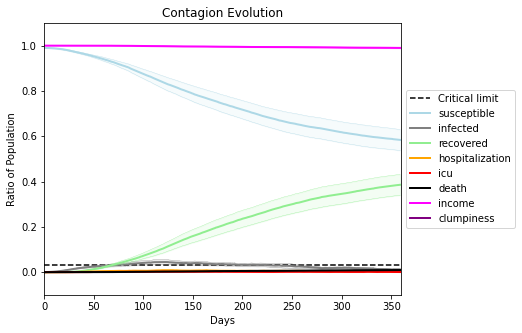

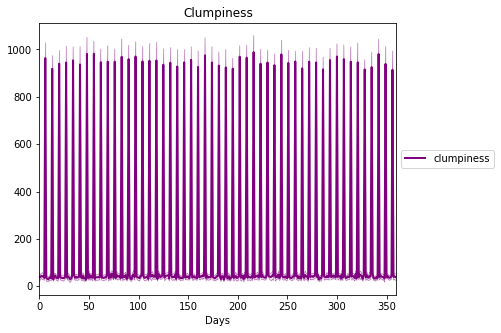

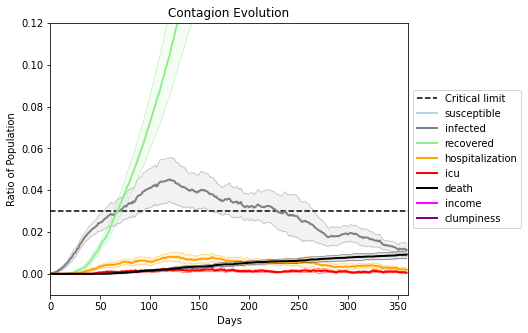

In [24]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1042, 3843, 1300, 1556, 4521, 9728, 9275, 7640, 6003, 5101, 3181, 3863, 1258, 4530, 618, 2631, 9493, 929, 5071, 5964]
Average similarity between family members is 0.15690451316489004 at temperature 0
Average similarity between family and home is 0.9998669708229593 at temperature -1
Average similarity between students and their classroom is 0.15585569563079626 at temperature 0
Average classroom occupancy is 1.5454545454545454 and number classrooms is 176
Average similarity between workers is 0.1682203232588079 at temperature 0
Average office occupancy is 3.4020100502512562 and number offices is 199
Average friend similarity for adults: 0.21251914640335876 for kids: 0.2091934107110376
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogen

avg restaurant similarity 0.05562497727856008
avg restaurant similarity 0.07603473141956207
avg restaurant similarity 0.07310562078038073
avg restaurant similarity 0.07333536945348669
avg restaurant similarity 0.04517142467175424
avg restaurant similarity 0.05854727170390009
avg restaurant similarity 0.08802569649624459
avg restaurant similarity 0.10802613221737263
avg restaurant similarity 0.044355873438726996
avg restaurant similarity 0.06981035040899837
avg restaurant similarity 0.029412359079768528
avg restaurant similarity 0.045131732831915676
avg restaurant similarity 0.05472972302840299
avg restaurant similarity 0.021053263727909482
avg restaurant similarity 0.07388431399461282
avg restaurant similarity 0.04517074864505934
avg restaurant similarity 0.07130445001411438
avg restaurant similarity 0.06658468681731625
avg restaurant similarity 0.010324601402077273
avg restaurant similarity 0.04803406626679574
avg restaurant similarity 0.06070874694682983
avg restaurant similarity 0.0

avg restaurant similarity 0.07816703120294369
avg restaurant similarity 0.07539040069124144
avg restaurant similarity 0.07491477768472428
avg restaurant similarity 0.07038743063238526
avg restaurant similarity 0.07190343308264041
avg restaurant similarity 0.10351761059251614
avg restaurant similarity 0.1015989712710538
avg restaurant similarity 0.04838074681416202
avg restaurant similarity 0.06529531514686367
avg restaurant similarity 0.07824160154199601
avg restaurant similarity 0.05556229633251343
avg restaurant similarity 0.049948969364350754
avg restaurant similarity 0.06872039114747254
avg restaurant similarity 0.06593361243250485
avg restaurant similarity 0.09441503321339831
avg restaurant similarity 0.05635541331071806
avg restaurant similarity 0.03945760514343289
avg restaurant similarity 0.048217873696997225
avg restaurant similarity 0.04727802066010227
avg restaurant similarity 0.048917230760295034
avg restaurant similarity 0.06578885886099162
avg restaurant similarity 0.0817

avg restaurant similarity 0.11336299403237521
avg restaurant similarity 0.0716393761518423
avg restaurant similarity 0.058818696904993646
avg restaurant similarity 0.04215641486312991
Average similarity between family members is 0.15977930576184535 at temperature 0
Average similarity between family and home is 0.9998638647306206 at temperature -1
Average similarity between students and their classroom is 0.16569089592885985 at temperature 0
Average classroom occupancy is 1.5138121546961325 and number classrooms is 181
Average similarity between workers is 0.16849808322902815 at temperature 0
Average office occupancy is 3.297029702970297 and number offices is 202
Average friend similarity for adults: 0.21458669429908378 for kids: 0.21335703976722467
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 

avg restaurant similarity 0.057643995899581885
avg restaurant similarity 0.022044288484672988
avg restaurant similarity 0.023976546846246463
avg restaurant similarity 0.07333567687836985
avg restaurant similarity 0.07244968360182902
avg restaurant similarity 0.06307526929431077
avg restaurant similarity 0.003859581721414941
avg restaurant similarity 0.056324113823355046
avg restaurant similarity 0.08701968962359273
avg restaurant similarity 0.12067847303047534
avg restaurant similarity 0.08873984526273834
avg restaurant similarity 0.009393976934992419
avg restaurant similarity 0.09972799992224458
avg restaurant similarity 0.10940669277440405
avg restaurant similarity 0.06812148030629826
avg restaurant similarity 0.10505550753551633
avg restaurant similarity 0.01698547071598525
avg restaurant similarity 0.09908043540817676
avg restaurant similarity 0.037591922129061595
avg restaurant similarity 0.07795970503010428
avg restaurant similarity 0.058909210041309355
avg restaurant similarity 

avg restaurant similarity 0.057057291396585864
avg restaurant similarity 0.03916241094253463
avg restaurant similarity 0.06606846386007341
avg restaurant similarity -0.013175873837802483
avg restaurant similarity 0.04397389905834178
avg restaurant similarity 0.03972876880827845
avg restaurant similarity 0.12224437621711476
avg restaurant similarity 0.06808471514936075
avg restaurant similarity 0.1420058679303167
avg restaurant similarity 0.10251513147975995
avg restaurant similarity 0.03036430268577505
avg restaurant similarity 0.05541683912605537
avg restaurant similarity 0.0969068034852612
avg restaurant similarity 0.06532200503100127
avg restaurant similarity 0.11802074371209288
avg restaurant similarity 0.0899356803709332
avg restaurant similarity 0.13478836855709825
avg restaurant similarity 0.06226193006763927
avg restaurant similarity 0.107800031065285
avg restaurant similarity 0.07063209776343318
avg restaurant similarity 0.04958549054953188
avg restaurant similarity 0.01833365

avg restaurant similarity 0.05714485329616451
avg restaurant similarity 0.10160131875187532
avg restaurant similarity 0.04800756260006533
avg restaurant similarity 0.10069446986384101
Average similarity between family members is 0.14004843778823298 at temperature 0
Average similarity between family and home is 0.9998546291325769 at temperature -1
Average similarity between students and their classroom is 0.14092919846168245 at temperature 0
Average classroom occupancy is 1.7065868263473054 and number classrooms is 167
Average similarity between workers is 0.1278580315641653 at temperature 0
Average office occupancy is 3.3004926108374386 and number offices is 203
Average friend similarity for adults: 0.20029106518751436 for kids: 0.21111203871182396
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 

avg restaurant similarity 0.028032538324776358
avg restaurant similarity 0.019335366477619645
avg restaurant similarity 0.02513950856620364
avg restaurant similarity 0.04511049248368529
avg restaurant similarity 0.01712536048317945
avg restaurant similarity 0.021395856316318126
avg restaurant similarity 0.06338128240401508
avg restaurant similarity 0.0676506163760303
avg restaurant similarity 0.05422137317499007
avg restaurant similarity 0.06330038303922508
avg restaurant similarity 0.05771781644568547
avg restaurant similarity 0.05955073262941282
avg restaurant similarity 0.09537364963454585
avg restaurant similarity 0.0255200047108342
avg restaurant similarity 0.05877890668912318
avg restaurant similarity 0.04710899823263298
avg restaurant similarity 0.07491567716211253
avg restaurant similarity 0.09283285139077735
avg restaurant similarity 0.07144469810153738
avg restaurant similarity 0.027152927412998934
avg restaurant similarity 0.06918541374800186
avg restaurant similarity 0.0505

avg restaurant similarity 0.060052418402785385
avg restaurant similarity 0.0642633292611186
avg restaurant similarity 0.03482797566408531
avg restaurant similarity 0.05352958541518067
avg restaurant similarity 0.0623824267432312
avg restaurant similarity 0.0490323011186581
avg restaurant similarity 0.04985610635244812
avg restaurant similarity 0.058802498655148965
avg restaurant similarity 0.05076814345054214
avg restaurant similarity 0.042966529313287934
avg restaurant similarity 0.0449183104426436
avg restaurant similarity 0.021050341818700625
avg restaurant similarity 0.06525623879027763
avg restaurant similarity 0.06305213599500303
avg restaurant similarity 0.039309560638600194
avg restaurant similarity 0.0241831428354359
avg restaurant similarity 0.03471930579117564
avg restaurant similarity 0.005646898903752912
avg restaurant similarity 0.08561733408859903
avg restaurant similarity 0.029615914771224775
avg restaurant similarity 0.07633537237710773
avg restaurant similarity 0.0313

avg restaurant similarity 0.03301643360128319
avg restaurant similarity 0.07111499689225613
avg restaurant similarity 0.045361391867779426
avg restaurant similarity 0.03861988964460802
Average similarity between family members is 0.15950881442154585 at temperature 0
Average similarity between family and home is 0.9998604168290148 at temperature -1
Average similarity between students and their classroom is 0.14124711406827412 at temperature 0
Average classroom occupancy is 1.55 and number classrooms is 180
Average similarity between workers is 0.15441587132827855 at temperature 0
Average office occupancy is 3.391959798994975 and number offices is 199
Average friend similarity for adults: 0.213956271642292 for kids: 0.21418148646828655
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogen

avg restaurant similarity 0.04532664800653819
avg restaurant similarity 0.03055023174442677
avg restaurant similarity 0.03703107601733894
avg restaurant similarity 0.09109090717858673
avg restaurant similarity 0.075751637691729
avg restaurant similarity 0.05077088185038487
avg restaurant similarity 0.05004962622226675
avg restaurant similarity 0.036178425366605316
avg restaurant similarity 0.06494206746081574
avg restaurant similarity 0.0749253184562728
avg restaurant similarity 0.08009319144345971
avg restaurant similarity 0.06640680362622073
avg restaurant similarity 0.04491784317395708
avg restaurant similarity 0.05870426231542242
avg restaurant similarity 0.05037140500356805
avg restaurant similarity 0.03273016864931098
avg restaurant similarity 0.059983491455902545
avg restaurant similarity 0.05109546154315452
avg restaurant similarity 0.06039427347956515
avg restaurant similarity 0.00793076012501776
avg restaurant similarity 0.041414101753705246
avg restaurant similarity 0.022310

avg restaurant similarity 0.039368149097240596
avg restaurant similarity 0.019509854385673833
avg restaurant similarity 0.04175993993672467
avg restaurant similarity -0.021879351076791127
avg restaurant similarity 0.09341188328262151
avg restaurant similarity 0.07713555085428561
avg restaurant similarity 0.05860007446703267
avg restaurant similarity -0.011680389474289513
avg restaurant similarity 0.045434129532942166
avg restaurant similarity -0.0036281335084351117
avg restaurant similarity 0.049153648021676176
avg restaurant similarity 0.10054605917012692
avg restaurant similarity 0.06077690952818339
avg restaurant similarity 0.020255864098929134
avg restaurant similarity 0.0765097267211058
avg restaurant similarity 0.048891621952118124
avg restaurant similarity 0.02244610932609903
avg restaurant similarity 0.02059195031196624
avg restaurant similarity 0.059686385241853164
avg restaurant similarity 0.04502791147334926
avg restaurant similarity 0.026525392151890526
avg restaurant simil

avg restaurant similarity 0.060752612481171
avg restaurant similarity 0.06822723523918564
avg restaurant similarity 0.041233295315006156
avg restaurant similarity 0.087089546772979
avg restaurant similarity 0.035993943709137693
avg restaurant similarity 0.031928634219556044
Average similarity between family members is 0.16008716834707 at temperature 0
Average similarity between family and home is 0.9998551642643109 at temperature -1
Average similarity between students and their classroom is 0.18226336790984285 at temperature 0
Average classroom occupancy is 1.6610169491525424 and number classrooms is 177
Average similarity between workers is 0.18639035435826518 at temperature 0
Average office occupancy is 3.3165829145728645 and number offices is 199
Average friend similarity for adults: 0.2197902857691422 for kids: 0.22512093818452222
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 

avg restaurant similarity 0.05952047878264705
avg restaurant similarity 0.0862869460033258
avg restaurant similarity 0.05643711166635721
avg restaurant similarity 0.16435994840903353
avg restaurant similarity 0.0935970642716397
avg restaurant similarity 0.09042861448025036
avg restaurant similarity 0.11981303450272716
avg restaurant similarity 0.08917618292676903
avg restaurant similarity 0.02366999515041226
avg restaurant similarity 0.0664197833364091
avg restaurant similarity 0.054055694710638515
avg restaurant similarity 0.10932198234435515
avg restaurant similarity 0.0465577333825982
avg restaurant similarity 0.06690429672256187
avg restaurant similarity 0.09768179926305649
avg restaurant similarity 0.07448706293119052
avg restaurant similarity 0.08362690417507526
avg restaurant similarity 0.03048814225654715
avg restaurant similarity 0.05477064922371434
avg restaurant similarity 0.05620496899645798
avg restaurant similarity 0.09058743406051656
avg restaurant similarity 0.073080656

avg restaurant similarity 0.11905848814842634
avg restaurant similarity 0.07098629200839485
avg restaurant similarity 0.07979261043332314
avg restaurant similarity 0.07600152320368704
avg restaurant similarity 0.03810272963765088
avg restaurant similarity 0.037282808163321246
avg restaurant similarity 0.0820693958453168
avg restaurant similarity 0.09823010968001519
avg restaurant similarity 0.06705030316581716
avg restaurant similarity 0.014836937529252588
avg restaurant similarity 0.08956068580863885
avg restaurant similarity 0.10065713616615506
avg restaurant similarity 0.05326853160834518
avg restaurant similarity 0.034759280382793654
avg restaurant similarity 0.0884897980197503
avg restaurant similarity 0.11599813529108165
avg restaurant similarity 0.06880606708360779
avg restaurant similarity 0.0813270995977289
avg restaurant similarity 0.06402435299574054
avg restaurant similarity 0.014345406681117697
avg restaurant similarity 0.0868570309343009
avg restaurant similarity 0.079117

avg restaurant similarity 0.03383937442798472
avg restaurant similarity 0.05675963289315258
Average similarity between family members is 0.15213909617326818 at temperature 0
Average similarity between family and home is 0.9998570410272992 at temperature -1
Average similarity between students and their classroom is 0.15850702792473564 at temperature 0
Average classroom occupancy is 1.6428571428571428 and number classrooms is 168
Average similarity between workers is 0.17053966045775973 at temperature 0
Average office occupancy is 3.305 and number offices is 200
Average friend similarity for adults: 0.21188587912056336 for kids: 0.22382278475985778
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total 

avg restaurant similarity 8.806853230498868e-06
avg restaurant similarity 0.08569112318533512
avg restaurant similarity 0.07227021717453891
avg restaurant similarity 0.1024811664637851
avg restaurant similarity 0.08869801493389984
avg restaurant similarity 0.07600062046196503
avg restaurant similarity 0.10695344972567687
avg restaurant similarity 0.058062566508626276
avg restaurant similarity 0.07639887329689009
avg restaurant similarity 0.045751589772700524
avg restaurant similarity 0.05373414435265002
avg restaurant similarity 0.10677804547774936
avg restaurant similarity 0.05307327299074461
avg restaurant similarity 0.040585909097257164
avg restaurant similarity 0.11159001251584008
avg restaurant similarity 0.0853852054607443
avg restaurant similarity 0.05153144478228705
avg restaurant similarity 0.06520768838440187
avg restaurant similarity 0.02433709153352659
avg restaurant similarity 0.076729819536489
avg restaurant similarity 0.0600039315007407
avg restaurant similarity 0.057627

avg restaurant similarity 0.08490693381578374
avg restaurant similarity 0.08016427966114965
avg restaurant similarity 0.04716400189320704
avg restaurant similarity 0.06269928030551793
avg restaurant similarity 0.05922789712210926
avg restaurant similarity 0.04213099137700657
avg restaurant similarity 0.15175921979007223
avg restaurant similarity 0.034936919696544534
avg restaurant similarity 0.06358502101927546
avg restaurant similarity 0.054164824225339026
avg restaurant similarity 0.04510957297810572
avg restaurant similarity 0.0165986204070493
avg restaurant similarity 0.07165508321388096
avg restaurant similarity 0.05211569590994034
avg restaurant similarity 0.07317546873569221
avg restaurant similarity 0.05234806900498991
avg restaurant similarity 0.07111915960227148
avg restaurant similarity 0.08579177334110856
avg restaurant similarity 0.0376053016130865
avg restaurant similarity 0.015238188761703365
avg restaurant similarity 0.10079681128430013
avg restaurant similarity 0.11393

avg restaurant similarity 0.07977022716484664
avg restaurant similarity 0.07919307077425969
avg restaurant similarity 0.06332150490308266
Average similarity between family members is 0.15284753663487063 at temperature 0
Average similarity between family and home is 0.9998505760798766 at temperature -1
Average similarity between students and their classroom is 0.14401711935820713 at temperature 0
Average classroom occupancy is 1.627659574468085 and number classrooms is 188
Average similarity between workers is 0.14099662158341697 at temperature 0
Average office occupancy is 3.2311557788944723 and number offices is 199
Average friend similarity for adults: 0.21051818217257037 for kids: 0.21246139098477604
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each 

avg restaurant similarity 0.06292344653390963
avg restaurant similarity 0.06361020640537048
avg restaurant similarity 0.09701123283756988
avg restaurant similarity 0.0678812494011022
avg restaurant similarity 0.048155330406069646
avg restaurant similarity 0.10300425072522963
avg restaurant similarity 0.09794806480474387
avg restaurant similarity 0.06345500905190837
avg restaurant similarity 0.0768266111870717
avg restaurant similarity 0.08089969644802353
avg restaurant similarity 0.08482554603422826
avg restaurant similarity 0.017072611206636733
avg restaurant similarity 0.06720362603212009
avg restaurant similarity 0.0431898119030022
avg restaurant similarity 0.08209202037938351
avg restaurant similarity 0.06599833120880072
avg restaurant similarity 0.06377886744431087
avg restaurant similarity 0.07331060652573461
avg restaurant similarity 0.04734545545495258
avg restaurant similarity 0.05605792609349807
avg restaurant similarity 0.08499614975397396
avg restaurant similarity 0.0665740

avg restaurant similarity 0.10145052234715703
avg restaurant similarity 0.08090618821714675
avg restaurant similarity 0.05547128886214155
avg restaurant similarity 0.09707973998099921
avg restaurant similarity 0.0953299166860454
avg restaurant similarity 0.07434748745301732
avg restaurant similarity 0.0750934484914065
avg restaurant similarity 0.060047443078273297
avg restaurant similarity 0.10800166800347609
avg restaurant similarity 0.07585195588377772
avg restaurant similarity 0.08412132378833163
avg restaurant similarity 0.07528213952649257
avg restaurant similarity 0.1193737525838814
avg restaurant similarity 0.07934459128484916
avg restaurant similarity 0.02539731560707982
avg restaurant similarity 0.09380343078993424
avg restaurant similarity 0.0634732534278273
avg restaurant similarity 0.07258003949164314
avg restaurant similarity 0.07821425420945798
avg restaurant similarity 0.07195756074486635
avg restaurant similarity 0.09984103683283438
avg restaurant similarity 0.103990735

avg restaurant similarity 0.07367813942037914
avg restaurant similarity 0.09010146506181121
avg restaurant similarity 0.06296346014820899
Average similarity between family members is 0.13478972925610405 at temperature 0
Average similarity between family and home is 0.9998537598106014 at temperature -1
Average similarity between students and their classroom is 0.16236913161175104 at temperature 0
Average classroom occupancy is 1.5689655172413792 and number classrooms is 174
Average similarity between workers is 0.14043768796829198 at temperature 0
Average office occupancy is 3.3233830845771144 and number offices is 201
Average friend similarity for adults: 0.20513466526978877 for kids: 0.21213549383727723
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each w

avg restaurant similarity 0.07414726999380397
avg restaurant similarity 0.05991359573735321
avg restaurant similarity 0.09107922092785788
avg restaurant similarity 0.07346841812307124
avg restaurant similarity 0.037652261992348064
avg restaurant similarity 0.07927050842967051
avg restaurant similarity 0.05092923807773228
avg restaurant similarity 0.051701628949730856
avg restaurant similarity 0.06140227659559296
avg restaurant similarity 0.11622468070573594
avg restaurant similarity 0.044812934501590324
avg restaurant similarity 0.057682378030725324
avg restaurant similarity 0.0715531176915298
avg restaurant similarity 0.07158897439606163
avg restaurant similarity 0.09213501498347526
avg restaurant similarity 0.003692387333673059
avg restaurant similarity 0.04190481668455104
avg restaurant similarity 0.05047729399814914
avg restaurant similarity 0.07523285008654088
avg restaurant similarity 0.08217313509503561
avg restaurant similarity 0.057071401274764
avg restaurant similarity 0.0732

avg restaurant similarity 0.04211429090662796
avg restaurant similarity -0.008070369308541917
avg restaurant similarity 0.07700040516822057
avg restaurant similarity 0.05959178918192057
avg restaurant similarity -0.006469918403573273
avg restaurant similarity 0.05818918683891178
avg restaurant similarity 0.09596304756277982
avg restaurant similarity 0.05396861976726041
avg restaurant similarity 0.05678408359053736
avg restaurant similarity 0.022378857208138182
avg restaurant similarity 0.030870359812098208
avg restaurant similarity 0.07735951320496508
avg restaurant similarity 0.07502686666825202
avg restaurant similarity 0.07346372128232662
avg restaurant similarity 0.007160078907334548
avg restaurant similarity 0.08059576099267841
avg restaurant similarity 0.03129819152244943
avg restaurant similarity 0.024042166997457745
avg restaurant similarity 0.0701264106643913
avg restaurant similarity 0.07802962475101292
avg restaurant similarity 0.06484037495562633
avg restaurant similarity 0

avg restaurant similarity 0.03886869521527941
avg restaurant similarity 0.09252900815128434
avg restaurant similarity 0.061197063916141964
avg restaurant similarity 0.07159760934669993
Average similarity between family members is 0.16266452337869228 at temperature 0
Average similarity between family and home is 0.999859896511831 at temperature -1
Average similarity between students and their classroom is 0.1782321671940009 at temperature 0
Average classroom occupancy is 1.5813953488372092 and number classrooms is 172
Average similarity between workers is 0.16868462856060965 at temperature 0
Average office occupancy is 3.3819095477386933 and number offices is 199
Average friend similarity for adults: 0.19836680458518827 for kids: 0.2060591732992003
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.059491688869711595
avg restaurant similarity 0.05834310563902952
avg restaurant similarity 0.08433480656300031
avg restaurant similarity 0.011541625478596785
avg restaurant similarity 0.052666550312827395
avg restaurant similarity 0.04907179459525098
avg restaurant similarity 0.036946990195057296
avg restaurant similarity 0.06798771895540891
avg restaurant similarity 0.027317464516211205
avg restaurant similarity 0.05398838690446378
avg restaurant similarity 0.052248283725865305
avg restaurant similarity 0.03631257441927829
avg restaurant similarity 0.04302760593950236
avg restaurant similarity 0.02523729365135761
avg restaurant similarity 0.026712558105180254
avg restaurant similarity 0.024683229280726852
avg restaurant similarity 0.07493549208935586
avg restaurant similarity 0.06253161519460498
avg restaurant similarity 0.07865985134527465
avg restaurant similarity 0.025294889084138766
avg restaurant similarity 0.09222655246840909
avg restaurant similarity

avg restaurant similarity 0.044324846344487835
avg restaurant similarity 0.04140746284581186
avg restaurant similarity 0.06759830295201266
avg restaurant similarity 0.03723165247750813
avg restaurant similarity 0.06729787970237686
avg restaurant similarity -0.008296849920363784
avg restaurant similarity 0.039119032756919345
avg restaurant similarity 0.06189629565452798
avg restaurant similarity 0.04181245521989606
avg restaurant similarity 0.048395299205321304
avg restaurant similarity 0.049194494027767446
avg restaurant similarity 0.06368583316267465
avg restaurant similarity 0.008423684341816451
avg restaurant similarity 0.017759362550883836
avg restaurant similarity 0.06795600797380816
avg restaurant similarity 0.05064244216135913
avg restaurant similarity -0.015624733983764703
avg restaurant similarity 0.0635843246415555
avg restaurant similarity 0.05023271987723575
avg restaurant similarity 0.04017723602850153
avg restaurant similarity 0.03919834147362814
avg restaurant similarity

avg restaurant similarity 0.023232281683228276
avg restaurant similarity 0.0076953970665979265
avg restaurant similarity 0.04477786662309716
avg restaurant similarity 0.015375808253366251
avg restaurant similarity 0.016160281425970834
avg restaurant similarity 0.04422026304363679
Average similarity between family members is 0.16894079846566848 at temperature 0
Average similarity between family and home is 0.9998452352644875 at temperature -1
Average similarity between students and their classroom is 0.15848747290900295 at temperature 0
Average classroom occupancy is 1.6242424242424243 and number classrooms is 165
Average similarity between workers is 0.13809942967433173 at temperature 0
Average office occupancy is 3.3768844221105527 and number offices is 199
Average friend similarity for adults: 0.2114542791843502 for kids: 0.2070401968424015
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a t

avg restaurant similarity 0.019631378090536045
avg restaurant similarity 0.09162195667394317
avg restaurant similarity 0.025784949675414455
avg restaurant similarity 0.03924199415203651
avg restaurant similarity 0.04269664741162199
avg restaurant similarity 0.06639587621398887
avg restaurant similarity 0.00037613968623516055
avg restaurant similarity 0.021008419770650873
avg restaurant similarity 0.10232033884651201
avg restaurant similarity 0.020407884607604065
avg restaurant similarity -0.008906328757948676
avg restaurant similarity 0.04530053717271078
avg restaurant similarity 0.011786443859010062
avg restaurant similarity 0.0790284156542992
avg restaurant similarity 0.09023030669408091
avg restaurant similarity 0.03208812195492095
avg restaurant similarity -0.001130409324156065
avg restaurant similarity 0.06792559372035663
avg restaurant similarity 0.01626747347555143
avg restaurant similarity 0.024202944562253446
avg restaurant similarity 0.023085911977892514
avg restaurant simila

avg restaurant similarity 0.04588564422554612
avg restaurant similarity 0.024021000652131985
avg restaurant similarity 0.022223592365367605
avg restaurant similarity 0.02298684667166367
avg restaurant similarity -0.005341814276787812
avg restaurant similarity 0.03718036232441505
avg restaurant similarity 0.040953331683012184
avg restaurant similarity 0.045776419522253184
avg restaurant similarity 0.039017992672039
avg restaurant similarity 0.04273206719555427
avg restaurant similarity 0.041724211631046684
avg restaurant similarity 0.05160469107811496
avg restaurant similarity 0.05672840843018669
avg restaurant similarity 0.0771058680886043
avg restaurant similarity 0.010251159446367841
avg restaurant similarity 0.010788708361279715
avg restaurant similarity 0.013950273098136736
avg restaurant similarity 0.05926623016140965
avg restaurant similarity -0.012261395190784535
avg restaurant similarity 0.03817899720662915
avg restaurant similarity 0.03237379657905884
avg restaurant similarity

avg restaurant similarity 0.036726577458135026
avg restaurant similarity 0.01768384359766721
avg restaurant similarity 0.05712490437800423
avg restaurant similarity 0.048180481223314135
avg restaurant similarity 0.07839345454338323
avg restaurant similarity 0.02119375061080395
Average similarity between family members is 0.15553681036058506 at temperature 0
Average similarity between family and home is 0.9998525211125617 at temperature -1
Average similarity between students and their classroom is 0.16509237969822138 at temperature 0
Average classroom occupancy is 1.6726190476190477 and number classrooms is 168
Average similarity between workers is 0.1500226550346934 at temperature 0
Average office occupancy is 3.29064039408867 and number offices is 203
Average friend similarity for adults: 0.2007958409181427 for kids: 0.19993954235999792
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total 

avg restaurant similarity 0.049814959140173254
avg restaurant similarity 0.027381723551592057
avg restaurant similarity 0.04295861977537252
avg restaurant similarity 0.08813583783839332
avg restaurant similarity 0.029481502685059974
avg restaurant similarity 0.07898175172783849
avg restaurant similarity 0.031090186980920757
avg restaurant similarity 0.059517480426474506
avg restaurant similarity 0.013064725967197174
avg restaurant similarity 0.03589689660119854
avg restaurant similarity 0.04545342542938914
avg restaurant similarity 0.04437784185353918
avg restaurant similarity 0.08311784611380543
avg restaurant similarity 0.09606143781208563
avg restaurant similarity 0.049502298736673944
avg restaurant similarity 0.07166658987879308
avg restaurant similarity 0.07684831535523272
avg restaurant similarity 0.06565026030973035
avg restaurant similarity 0.019215779898138958
avg restaurant similarity 0.06060832902255609
avg restaurant similarity 0.11385932193425242
avg restaurant similarity 

avg restaurant similarity 0.08069634935205067
avg restaurant similarity 0.019934225268021428
avg restaurant similarity 0.06588890127921618
avg restaurant similarity 0.020711920786727723
avg restaurant similarity 0.07676381408579588
avg restaurant similarity 0.07692516130266394
avg restaurant similarity 0.06502696170770261
avg restaurant similarity 0.019558893030404374
avg restaurant similarity 0.037754316161827915
avg restaurant similarity 0.020854454251306408
avg restaurant similarity 0.030040118816628682
avg restaurant similarity 0.06327530350075458
avg restaurant similarity 0.018007297212541146
avg restaurant similarity 0.030216698378428105
avg restaurant similarity 0.04669797216614828
avg restaurant similarity -0.0008978758116941601
avg restaurant similarity 0.020508297310192665
avg restaurant similarity 0.03330587798314909
avg restaurant similarity 0.07503984677221393
avg restaurant similarity 0.041054447567143264
avg restaurant similarity -0.005543135933546223
avg restaurant simi

avg restaurant similarity 0.0767806497539757
avg restaurant similarity 0.044588593183729125
avg restaurant similarity 0.04635322587446366
avg restaurant similarity 0.07768581479879008
avg restaurant similarity 0.04060270587807061
Average similarity between family members is 0.17853407775326685 at temperature 0
Average similarity between family and home is 0.999857207845878 at temperature -1
Average similarity between students and their classroom is 0.13723563649696285 at temperature 0
Average classroom occupancy is 1.688622754491018 and number classrooms is 167
Average similarity between workers is 0.1763371809182692 at temperature 0
Average office occupancy is 3.28 and number offices is 200
Average friend similarity for adults: 0.21000601939842642 for kids: 0.2147729375199797
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
,

avg restaurant similarity 0.07908798945214582
avg restaurant similarity 0.10033219518843664
avg restaurant similarity 0.04430955631083403
avg restaurant similarity 0.07513576002858241
avg restaurant similarity 0.07116561491216494
avg restaurant similarity 0.11576850771241307
avg restaurant similarity 0.06624410395763519
avg restaurant similarity 0.10498635692089824
avg restaurant similarity 0.07601986830810177
avg restaurant similarity 0.041223864206221573
avg restaurant similarity 0.1095023303378621
avg restaurant similarity 0.045252552077038405
avg restaurant similarity 0.10959005823517735
avg restaurant similarity 0.08355235912245684
avg restaurant similarity 0.04694252263279881
avg restaurant similarity 0.10949015526872834
avg restaurant similarity 0.06649974870869191
avg restaurant similarity 0.05368578040526635
avg restaurant similarity 0.12222523175937505
avg restaurant similarity 0.093761854094029
avg restaurant similarity 0.06079232612012676
avg restaurant similarity 0.0742021

avg restaurant similarity 0.06984030655360021
avg restaurant similarity 0.0456149919970105
avg restaurant similarity 0.08300645483451537
avg restaurant similarity 0.1068562326595514
avg restaurant similarity 0.05187649476201386
avg restaurant similarity 0.07103482895568934
avg restaurant similarity 0.04359007549780167
avg restaurant similarity 0.05849465267917856
avg restaurant similarity 0.08941486576892803
avg restaurant similarity 0.06073799347907999
avg restaurant similarity 0.061275411514676255
avg restaurant similarity 0.09128947212730656
avg restaurant similarity 0.09521177484953923
avg restaurant similarity 0.07798075766217083
avg restaurant similarity 0.062480262915420415
avg restaurant similarity 0.07737714455806545
avg restaurant similarity 0.08570066341271064
avg restaurant similarity 0.052439055428755856
avg restaurant similarity 0.07277269398129285
avg restaurant similarity 0.03971394571852016
avg restaurant similarity 0.05277322216635257
avg restaurant similarity 0.05006

avg restaurant similarity 0.05770555418420582
avg restaurant similarity 0.07380760064262591
Average similarity between family members is 0.15609374357499486 at temperature 0
Average similarity between family and home is 0.9998536432630742 at temperature -1
Average similarity between students and their classroom is 0.19728764595278223 at temperature 0
Average classroom occupancy is 1.6384180790960452 and number classrooms is 177
Average similarity between workers is 0.15292592986753115 at temperature 0
Average office occupancy is 3.2254901960784315 and number offices is 204
Average friend similarity for adults: 0.20982151943046917 for kids: 0.22487978076358098
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units 

avg restaurant similarity 0.05748690343235816
avg restaurant similarity 0.029107742806414816
avg restaurant similarity 0.048153129306760134
avg restaurant similarity 0.039114238195973684
avg restaurant similarity 0.04311941951555971
avg restaurant similarity 0.027751982257352592
avg restaurant similarity 0.07922953940385241
avg restaurant similarity 0.023230521827273667
avg restaurant similarity 0.03894441040719952
avg restaurant similarity 0.05136930205364567
avg restaurant similarity 0.01871017423388002
avg restaurant similarity 0.06834900359196391
avg restaurant similarity 0.01944061403992749
avg restaurant similarity 0.0045164234847067655
avg restaurant similarity 0.10770764089415677
avg restaurant similarity 0.030517466046729273
avg restaurant similarity 0.057842424547835856
avg restaurant similarity 0.047380969444310646
avg restaurant similarity 0.051320697987791215
avg restaurant similarity 0.007105070791735344
avg restaurant similarity 0.0038394019778075243
avg restaurant simil

avg restaurant similarity 0.037076408923995996
avg restaurant similarity 0.08576544470935966
avg restaurant similarity 0.035421672680167667
avg restaurant similarity 0.056978168826433216
avg restaurant similarity 0.03314480522507159
avg restaurant similarity 0.029386135931977055
avg restaurant similarity 0.0724610717694715
avg restaurant similarity 0.07568334989263249
avg restaurant similarity 0.032436509916494285
avg restaurant similarity 0.08105763339518547
avg restaurant similarity 0.022248936376619014
avg restaurant similarity 0.050198093798910236
avg restaurant similarity 0.05265009365511619
avg restaurant similarity -0.007709037945249568
avg restaurant similarity 0.05806051085946281
avg restaurant similarity 0.048556736068155665
avg restaurant similarity 0.0737503946756938
avg restaurant similarity 0.05793554494063096
avg restaurant similarity 0.09445801528265854
avg restaurant similarity 0.10257327751816726
avg restaurant similarity 0.003353510836479265
avg restaurant similarity

avg restaurant similarity 0.1113563597110454
avg restaurant similarity 0.05745682662281776
avg restaurant similarity 0.08241024839539501
avg restaurant similarity 0.06165447816488057
Average similarity between family members is 0.13744993420330454 at temperature 0
Average similarity between family and home is 0.9998574141841825 at temperature -1
Average similarity between students and their classroom is 0.1490825094720799 at temperature 0
Average classroom occupancy is 1.6594594594594594 and number classrooms is 185
Average similarity between workers is 0.15524718739802454 at temperature 0
Average office occupancy is 3.1365853658536587 and number offices is 205
Average friend similarity for adults: 0.19084378311914726 for kids: 0.19951592195270232
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 B

avg restaurant similarity 0.04771424811159421
avg restaurant similarity 0.10348824512770351
avg restaurant similarity 0.05557962625766924
avg restaurant similarity 0.11173903087153488
avg restaurant similarity 0.09377836943408907
avg restaurant similarity 0.03951000745565746
avg restaurant similarity 0.06445861389778704
avg restaurant similarity 0.107640024637304
avg restaurant similarity 0.09511944775400288
avg restaurant similarity 0.07273531603367975
avg restaurant similarity 0.021883958289818
avg restaurant similarity 0.11827606379302452
avg restaurant similarity 0.09468345126164485
avg restaurant similarity 0.08082428489564925
avg restaurant similarity 0.08414714473119776
avg restaurant similarity 0.0771362959282791
avg restaurant similarity 0.06626645023989122
avg restaurant similarity 0.02130974096456619
avg restaurant similarity 0.08767253094691971
avg restaurant similarity 0.06732081353529185
avg restaurant similarity 0.05217137903133844
avg restaurant similarity 0.03981440131

avg restaurant similarity 0.023818560937865076
avg restaurant similarity 0.07921702288054205
avg restaurant similarity 0.05456876871307899
avg restaurant similarity 0.09271255454307663
avg restaurant similarity 0.06536774108204634
avg restaurant similarity 0.11817710141174655
avg restaurant similarity 0.07499826886064592
avg restaurant similarity 0.1184983103915881
avg restaurant similarity 0.09789401838500109
avg restaurant similarity 0.09617903107274643
avg restaurant similarity 0.07123127141804825
avg restaurant similarity 0.11081169280412093
avg restaurant similarity 0.09629982025488604
avg restaurant similarity 0.09097709905850707
avg restaurant similarity 0.030486440639726584
avg restaurant similarity 0.07522931686422267
avg restaurant similarity 0.09731984216171788
avg restaurant similarity 0.09639095917930819
avg restaurant similarity 0.12680215172561968
avg restaurant similarity 0.05871969474958267
avg restaurant similarity 0.10675028135600899
avg restaurant similarity 0.08176

avg restaurant similarity 0.07662829635870647
avg restaurant similarity 0.1120339932619169
Average similarity between family members is 0.15109151031019652 at temperature 0
Average similarity between family and home is 0.9998461758555555 at temperature -1
Average similarity between students and their classroom is 0.19951857303581885 at temperature 0
Average classroom occupancy is 1.6944444444444444 and number classrooms is 180
Average similarity between workers is 0.15082329384333792 at temperature 0
Average office occupancy is 3.227272727272727 and number offices is 198
Average friend similarity for adults: 0.21646961672935083 for kids: 0.21018753569551035
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units 

avg restaurant similarity 0.12253430583986966
avg restaurant similarity 0.04600257718038762
avg restaurant similarity 0.08671700308805358
avg restaurant similarity 0.05673289096678679
avg restaurant similarity 0.04609693186774507
avg restaurant similarity 0.11852347687910188
avg restaurant similarity 0.07573669368602765
avg restaurant similarity 0.0695899245371353
avg restaurant similarity 0.09213349824711793
avg restaurant similarity 0.05627375752509266
avg restaurant similarity 0.07310449860921277
avg restaurant similarity 0.07631284005341399
avg restaurant similarity 0.05130740866423763
avg restaurant similarity 0.08130634821842161
avg restaurant similarity 0.12087921988738184
avg restaurant similarity 0.08165758094041578
avg restaurant similarity 0.09347609030403331
avg restaurant similarity 0.0842816116356265
avg restaurant similarity 0.12312753086322414
avg restaurant similarity 0.05583026773234076
avg restaurant similarity 0.08743119977683357
avg restaurant similarity 0.06500220

avg restaurant similarity 0.04667368688751669
avg restaurant similarity 0.09997763210911838
avg restaurant similarity 0.08378586607831076
avg restaurant similarity 0.11246646021011077
avg restaurant similarity 0.08033946292091157
avg restaurant similarity 0.051147527353068066
avg restaurant similarity 0.1137086394970689
avg restaurant similarity 0.08105088445306273
avg restaurant similarity 0.08753661367173224
avg restaurant similarity 0.08742361932301194
avg restaurant similarity 0.09782350644387779
avg restaurant similarity 0.09535926625031656
avg restaurant similarity 0.12622537991105787
avg restaurant similarity 0.06667066797307217
avg restaurant similarity 0.07646856989295941
avg restaurant similarity 0.10278004414447969
avg restaurant similarity 0.03645628872795431
avg restaurant similarity 0.0566019322787341
avg restaurant similarity 0.049278669878724965
avg restaurant similarity 0.1086572480344513
avg restaurant similarity 0.09121441898431196
avg restaurant similarity 0.0438429

avg restaurant similarity 0.12191306735511849
avg restaurant similarity 0.08242402339334018
Average similarity between family members is 0.15110694359508875 at temperature 0
Average similarity between family and home is 0.9998615247574181 at temperature -1
Average similarity between students and their classroom is 0.18971260851941954 at temperature 0
Average classroom occupancy is 1.7126436781609196 and number classrooms is 174
Average similarity between workers is 0.15859189726151499 at temperature 0
Average office occupancy is 3.2525252525252526 and number offices is 198
Average friend similarity for adults: 0.20873297441186578 for kids: 0.21396490576871555
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated unit

avg restaurant similarity 0.11273481914919052
avg restaurant similarity 0.02853303947180945
avg restaurant similarity 0.012834858139044997
avg restaurant similarity 0.035535045587111784
avg restaurant similarity 0.08928921371312817
avg restaurant similarity 0.08970646187363907
avg restaurant similarity 0.005158941980117385
avg restaurant similarity 0.01611700753456227
avg restaurant similarity 0.0696724448144141
avg restaurant similarity 0.03921810904792274
avg restaurant similarity 0.07804247065350145
avg restaurant similarity 0.08167524980021844
avg restaurant similarity 0.009847331669905547
avg restaurant similarity 0.09590259302422176
avg restaurant similarity 0.07608148527658222
avg restaurant similarity 0.056470757564394986
avg restaurant similarity 0.11154129350285281
avg restaurant similarity 0.04399760705006595
avg restaurant similarity 0.060267396625392995
avg restaurant similarity 0.08720046480872894
avg restaurant similarity 0.074383892522351
avg restaurant similarity 0.065

avg restaurant similarity 0.049905640450093096
avg restaurant similarity 0.06850460690189149
avg restaurant similarity 0.09134652921708454
avg restaurant similarity 0.06841491565942885
avg restaurant similarity 0.1084125716144151
avg restaurant similarity 0.07416007595107577
avg restaurant similarity 0.08061004276740172
avg restaurant similarity 0.0403025634851353
avg restaurant similarity 0.036337048999218906
avg restaurant similarity 0.07945958349547501
avg restaurant similarity 0.07560202025612403
avg restaurant similarity 0.07248947229653877
avg restaurant similarity 0.07261929789388175
avg restaurant similarity 0.10708294210795151
avg restaurant similarity 0.056646889919087465
avg restaurant similarity 0.07614189276280173
avg restaurant similarity 0.04606000073535657
avg restaurant similarity 0.1368780114654554
avg restaurant similarity 0.04921895058428067
avg restaurant similarity 0.07226479911120275
avg restaurant similarity 0.055611572638901305
avg restaurant similarity 0.01248

avg restaurant similarity 0.03885079345495777
avg restaurant similarity 0.055549082352188146
avg restaurant similarity 0.037556576823111844
avg restaurant similarity 0.1011936024710256
Average similarity between family members is 0.1510937054163435 at temperature 0
Average similarity between family and home is 0.9998426773553479 at temperature -1
Average similarity between students and their classroom is 0.2035149822917393 at temperature 0
Average classroom occupancy is 1.440217391304348 and number classrooms is 184
Average similarity between workers is 0.15015239997524488 at temperature 0
Average office occupancy is 3.3134328358208953 and number offices is 201
Average friend similarity for adults: 0.21105947792795726 for kids: 0.2081737235640396
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Bu

avg restaurant similarity 0.04139370778134384
avg restaurant similarity 0.05586164093902165
avg restaurant similarity 0.0722174479792745
avg restaurant similarity 0.043268791024097905
avg restaurant similarity 0.06177163278474167
avg restaurant similarity 0.05127557770403397
avg restaurant similarity 0.051717172078524866
avg restaurant similarity 0.005815908770252249
avg restaurant similarity 0.06806096168407241
avg restaurant similarity 0.028201907718491293
avg restaurant similarity 0.0614751123115462
avg restaurant similarity 0.07455970498553291
avg restaurant similarity 0.06130952122651363
avg restaurant similarity 0.06023675484936285
avg restaurant similarity 0.06398859601984326
avg restaurant similarity 0.032397334578430526
avg restaurant similarity 0.039497620656124284
avg restaurant similarity 0.047901375075776534
avg restaurant similarity 0.09779831681068644
avg restaurant similarity 0.05628742571652476
avg restaurant similarity 0.05551086157583507
avg restaurant similarity 0.0

avg restaurant similarity 0.07061108950300495
avg restaurant similarity 0.06684547065829632
avg restaurant similarity 0.08757567256429571
avg restaurant similarity 0.03905582559707154
avg restaurant similarity 0.025349610133364526
avg restaurant similarity 0.04533888945053992
avg restaurant similarity 0.06073794591004714
avg restaurant similarity 0.041964429277218086
avg restaurant similarity 0.0777382108355393
avg restaurant similarity 0.10575401503162138
avg restaurant similarity 0.06553915140106792
avg restaurant similarity 0.05202370703553095
avg restaurant similarity 0.05485082487278869
avg restaurant similarity 0.05158183598995356
avg restaurant similarity 0.060961293356824695
avg restaurant similarity 0.04970249397512016
avg restaurant similarity 0.029013167390346834
avg restaurant similarity 0.050646253060877916
avg restaurant similarity 0.045034625372694245
avg restaurant similarity 0.04981939411375055
avg restaurant similarity 0.03718362457640451
avg restaurant similarity 0.0

avg restaurant similarity 0.10240600236651143
avg restaurant similarity 0.0045429453859160245
avg restaurant similarity 0.11638862247668764
avg restaurant similarity 0.07163131320221566
Average similarity between family members is 0.1285420868073727 at temperature 0
Average similarity between family and home is 0.9998508811426398 at temperature -1
Average similarity between students and their classroom is 0.163050426801251 at temperature 0
Average classroom occupancy is 1.6545454545454545 and number classrooms is 165
Average similarity between workers is 0.12481404169870268 at temperature 0
Average office occupancy is 3.36318407960199 and number offices is 201
Average friend similarity for adults: 0.20477020628050402 for kids: 0.21628153782262363
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buil

avg restaurant similarity 0.031058311403685732
avg restaurant similarity 0.050148449804668746
avg restaurant similarity 0.09001000629996452
avg restaurant similarity 0.04734237791855566
avg restaurant similarity 0.11144783516114305
avg restaurant similarity 0.01404515089888539
avg restaurant similarity 0.034056530677615125
avg restaurant similarity 0.012497587839738694
avg restaurant similarity -0.008573401878224758
avg restaurant similarity 0.05079801282877337
avg restaurant similarity 0.0178641407723648
avg restaurant similarity 0.0070627068142754094
avg restaurant similarity -0.004841608907255927
avg restaurant similarity 0.044182467699993316
avg restaurant similarity 0.08859399818998456
avg restaurant similarity 0.020934055733645887
avg restaurant similarity 0.02083765462132227
avg restaurant similarity 0.05241267843661028
avg restaurant similarity 0.05542580503129687
avg restaurant similarity 0.0027758229624449135
avg restaurant similarity 0.1146772497582411
avg restaurant similar

avg restaurant similarity 0.060608977585213525
avg restaurant similarity 0.04392029550114574
avg restaurant similarity 0.06190376142964726
avg restaurant similarity 0.012719947561225737
avg restaurant similarity 0.02068889494982546
avg restaurant similarity 0.027513886797755908
avg restaurant similarity 0.049299155180892854
avg restaurant similarity 0.11790142730703532
avg restaurant similarity 0.04627830701314083
avg restaurant similarity 0.057639117359449994
avg restaurant similarity 0.02542774715531772
avg restaurant similarity 0.07681396014201543
avg restaurant similarity 0.004289350760210983
avg restaurant similarity -0.0006086108189249938
avg restaurant similarity 0.026476130902046712
avg restaurant similarity 0.02376989821325646
avg restaurant similarity 0.027439132819161882
avg restaurant similarity 0.016908312679096794
avg restaurant similarity 0.044580909178784066
avg restaurant similarity 0.017099132218446292
avg restaurant similarity 0.06328529226241067
avg restaurant simil

avg restaurant similarity 0.09922534634993362
avg restaurant similarity 0.019408734432701243
avg restaurant similarity 0.10032563086406243
avg restaurant similarity -0.0065877305510318816
avg restaurant similarity 0.05120658912747933
avg restaurant similarity 0.09163542297193464
Average similarity between family members is 0.15482946559749267 at temperature 0
Average similarity between family and home is 0.9998470830189343 at temperature -1
Average similarity between students and their classroom is 0.18410664611475347 at temperature 0
Average classroom occupancy is 1.53475935828877 and number classrooms is 187
Average similarity between workers is 0.17016956354179616 at temperature 0
Average office occupancy is 3.2475728155339807 and number offices is 206
Average friend similarity for adults: 0.2014463396428836 for kids: 0.2214622645041869
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a tota

avg restaurant similarity 0.054341775614000644
avg restaurant similarity 0.06637793551229794
avg restaurant similarity 0.07604903083369188
avg restaurant similarity 0.05375128294446901
avg restaurant similarity 0.03960080021475738
avg restaurant similarity 0.06897083062314721
avg restaurant similarity 0.05027754154044095
avg restaurant similarity 0.0822876225213874
avg restaurant similarity 0.03233289605945696
avg restaurant similarity 0.05146807001771054
avg restaurant similarity 0.054435225468395056
avg restaurant similarity 0.028241533851559412
avg restaurant similarity 0.0625927919020051
avg restaurant similarity 0.0521203154436644
avg restaurant similarity 0.0608625246969466
avg restaurant similarity 0.04272223705170554
avg restaurant similarity 0.08505663992332886
avg restaurant similarity -0.015187106527077653
avg restaurant similarity 0.08443123404133203
avg restaurant similarity 0.034001016201032984
avg restaurant similarity 0.07477790482095485
avg restaurant similarity 0.0685

avg restaurant similarity 0.04793543188758784
avg restaurant similarity 0.02412907120427987
avg restaurant similarity 0.01618084044992625
avg restaurant similarity 0.021936480595295238
avg restaurant similarity 0.05540500571507579
avg restaurant similarity 0.08229445158071312
avg restaurant similarity 0.025832439481623982
avg restaurant similarity 0.011412897490532406
avg restaurant similarity 0.018798901274223952
avg restaurant similarity 0.036148048619895894
avg restaurant similarity -0.0019841560193813975
avg restaurant similarity 0.03156434117185523
avg restaurant similarity 0.06641987675402054
avg restaurant similarity 0.032334526707610986
avg restaurant similarity 0.024064085225935804
avg restaurant similarity 0.07107609472095155
avg restaurant similarity 0.02512467448598819
avg restaurant similarity 0.04689647669199658
avg restaurant similarity 0.003210782013756763
avg restaurant similarity 0.029991467000906623
avg restaurant similarity 0.07070712514425777
avg restaurant similar

avg restaurant similarity 0.022704022131535495
avg restaurant similarity 0.054304448295347474
avg restaurant similarity 0.056188624382349006
avg restaurant similarity 0.014724686949537096
avg restaurant similarity -0.023705796131255247
avg restaurant similarity 0.006412877056098211
Average similarity between family members is 0.1360884339040665 at temperature 0
Average similarity between family and home is 0.9998566203019738 at temperature -1
Average similarity between students and their classroom is 0.14920980139332077 at temperature 0
Average classroom occupancy is 1.6559139784946237 and number classrooms is 186
Average similarity between workers is 0.15360612183198966 at temperature 0
Average office occupancy is 3.193877551020408 and number offices is 196
Average friend similarity for adults: 0.2024250441919163 for kids: 0.2162118582049889
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a t

avg restaurant similarity 0.012906725513197548
avg restaurant similarity 0.01405825794345328
avg restaurant similarity 0.049328417437968355
avg restaurant similarity 0.022020257868333466
avg restaurant similarity 0.03773011259750691
avg restaurant similarity 0.03136834515529457
avg restaurant similarity 0.026906217271686024
avg restaurant similarity 0.04023291176936871
avg restaurant similarity 0.0029327390828702295
avg restaurant similarity 0.07131282548013484
avg restaurant similarity 0.0852269971547742
avg restaurant similarity 0.042256676522788875
avg restaurant similarity 0.06975982750259262
avg restaurant similarity 0.053036324022445486
avg restaurant similarity 0.11932881405711693
avg restaurant similarity 0.03679995708559918
avg restaurant similarity 0.040751330367897985
avg restaurant similarity 0.02937351245535211
avg restaurant similarity 0.06488330101342994
avg restaurant similarity 0.031392488390665066
avg restaurant similarity 0.006039988072562817
avg restaurant similarit

avg restaurant similarity 0.07109500706099947
avg restaurant similarity 0.02967415547204137
avg restaurant similarity 0.04579173607038279
avg restaurant similarity 0.030850547896219715
avg restaurant similarity 0.024269747792474983
avg restaurant similarity 0.07190696588642735
avg restaurant similarity 0.056967611941553926
avg restaurant similarity 0.04055621642825357
avg restaurant similarity 0.06025116123054627
avg restaurant similarity 0.02547336454766331
avg restaurant similarity 0.031056768085167667
avg restaurant similarity 0.05882398634971618
avg restaurant similarity 0.06079795156423766
avg restaurant similarity 0.044617785200084546
avg restaurant similarity 0.05928120105743931
avg restaurant similarity 0.036078998899268695
avg restaurant similarity 0.006046070399178852
avg restaurant similarity -0.02277024743317664
avg restaurant similarity 0.05015014434420905
avg restaurant similarity 0.03543105564945914
avg restaurant similarity 0.060299225545278806
avg restaurant similarity

avg restaurant similarity 0.031154850187638486
avg restaurant similarity 0.04102304593441429
avg restaurant similarity 0.04660502208272049
avg restaurant similarity 0.0514360826830548
avg restaurant similarity 0.08834268367453017
avg restaurant similarity 0.01822389067275007
using average of time series:
stats on susceptible:
data: [0.736875, 0.8748, 0.7921472222222222, 0.7928250000000001, 0.7201243201243201, 0.6994944444444444, 0.8155078731426035, 0.8206555555555555, 0.7712583333333334, 0.8266666666666668, 0.8204111111111112, 0.8285388888888889, 0.6120111111111111, 0.7697916666666667, 0.6022111111111111, 0.7438555555555556, 0.8097138888888887, 0.7951416666666666, 0.8255, 0.7760555555555555]
min:
0.6022111111111111
max:
0.8748
std:
0.06835024678933337
mean:
0.7716792485522349
median:
0.7924861111111112
95% confidence interval for the mean:
(0.7388593294607839,0.8044991676436859)
using average of time series:
stats on infected:
data: [0.02908611111111111, 0.013844444444444444, 0.024425,

(<function dict.items>, <function dict.items>, <function dict.items>)

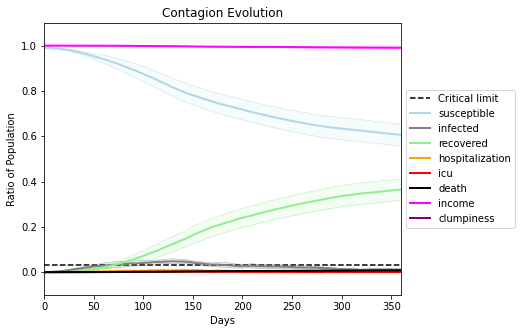

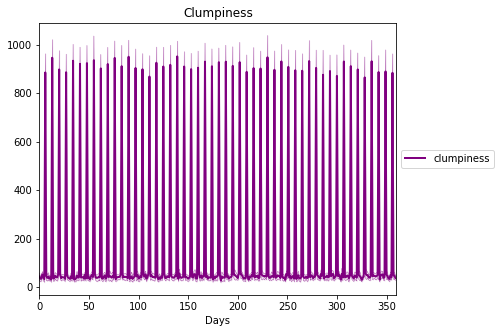

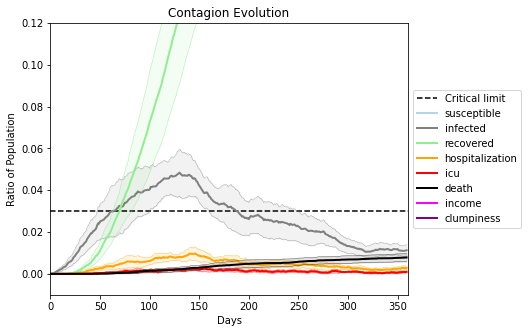

In [25]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8337, 2608, 5749, 4871, 7696, 3741, 4287, 8121, 2888, 2956, 6852, 7134, 3952, 6636, 9644, 5257, 2838, 9739, 7202, 6821]
Average similarity between family members is 0.11493657962764706 at temperature 0.33
Average similarity between family and home is 0.9998517379517186 at temperature -1
Average similarity between students and their classroom is 0.10932060659824756 at temperature 0.33
Average classroom occupancy is 1.5164835164835164 and number classrooms is 182
Average similarity between workers is 0.07148342827792892 at temperature 0.33
Average office occupancy is 3.355 and number offices is 200
Average friend similarity for adults: 0.162063777541167 for kids: 0.17322853705371272
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneous

avg restaurant similarity 0.012534904417754837
avg restaurant similarity 0.009252250533466864
avg restaurant similarity 0.046359618280127364
avg restaurant similarity -0.001696549789791102
avg restaurant similarity 0.011851889555699794
avg restaurant similarity 0.04957244031465313
avg restaurant similarity -0.0027615626160760803
avg restaurant similarity -0.019796847979958933
avg restaurant similarity 0.030492981385615407
avg restaurant similarity 0.030306452605035415
avg restaurant similarity -0.018573343575695532
avg restaurant similarity 0.026356413975737264
avg restaurant similarity 0.008473291362442015
avg restaurant similarity 0.028217857685196707
avg restaurant similarity 0.028895261221266455
avg restaurant similarity 0.0013729632081842435
avg restaurant similarity 0.05339955969024744
avg restaurant similarity 0.03597614679592085
avg restaurant similarity 0.006222261926800069
avg restaurant similarity 0.006088490559656071
avg restaurant similarity 0.042386953552539935
avg restau

avg restaurant similarity -0.004721246401329156
avg restaurant similarity 0.031927787065470115
avg restaurant similarity 0.03141782861469435
avg restaurant similarity 0.020788716123036035
avg restaurant similarity 0.03266274057570349
avg restaurant similarity 0.03648080909625887
avg restaurant similarity 0.02545894607408418
avg restaurant similarity 0.04751919094759413
avg restaurant similarity 0.0019739193686493877
avg restaurant similarity 0.01511053851189808
avg restaurant similarity 0.03787865494434635
avg restaurant similarity 0.03316616974782825
avg restaurant similarity 0.032525182177424665
avg restaurant similarity 0.007986285560234913
avg restaurant similarity 0.031626575009461484
avg restaurant similarity 0.03432878169429149
avg restaurant similarity 0.025798442307820153
avg restaurant similarity 0.027840345409679248
avg restaurant similarity 0.020180240750089593
avg restaurant similarity 0.04857390869539078
avg restaurant similarity 0.0545579850008869
avg restaurant similari

avg restaurant similarity 0.02667096295963003
avg restaurant similarity 0.04835867358478003
avg restaurant similarity 0.03150587281178689
avg restaurant similarity -0.004231076841856674
avg restaurant similarity 0.03735853962996682
avg restaurant similarity 0.02670880060201574
avg restaurant similarity -0.010414447633243722
avg restaurant similarity 0.04765272292286708
Average similarity between family members is 0.10086204187297475 at temperature 0.33
Average similarity between family and home is 0.9998523844034006 at temperature -1
Average similarity between students and their classroom is 0.10098308644754107 at temperature 0.33
Average classroom occupancy is 1.7261904761904763 and number classrooms is 168
Average similarity between workers is 0.1086610848070247 at temperature 0.33
Average office occupancy is 3.253731343283582 and number offices is 201
Average friend similarity for adults: 0.16680910945356794 for kids: 0.17905505042081335
home_districts
[
Home (0,0) district with 1 B

avg restaurant similarity 0.0034667836061220434
avg restaurant similarity 0.034937207001943256
avg restaurant similarity 0.055312945010984285
avg restaurant similarity 0.028358265566122132
avg restaurant similarity 0.06248118008227416
avg restaurant similarity -0.005964664222717744
avg restaurant similarity 0.03506453892946534
avg restaurant similarity -0.007936633089223715
avg restaurant similarity 0.00950626532100281
avg restaurant similarity 0.04237112355833498
avg restaurant similarity 0.002757692076441622
avg restaurant similarity 0.048585335237720934
avg restaurant similarity -0.010908900153623296
avg restaurant similarity 0.007983297611364595
avg restaurant similarity 0.02905995235998343
avg restaurant similarity 0.008737476048450713
avg restaurant similarity -0.013943049060920372
avg restaurant similarity 0.0015215609173570169
avg restaurant similarity 0.04736627750520598
avg restaurant similarity 0.03323858794213683
avg restaurant similarity 0.004638210040370699
avg restaurant

avg restaurant similarity 0.07288098426922501
avg restaurant similarity 0.014267840005255562
avg restaurant similarity 0.006636079264864925
avg restaurant similarity 0.006132578817713052
avg restaurant similarity 0.06310242388130749
avg restaurant similarity -0.012211963923815992
avg restaurant similarity -0.00034703009600369053
avg restaurant similarity 0.06874094795202007
avg restaurant similarity 0.018876455673265166
avg restaurant similarity -0.02512931847450427
avg restaurant similarity 0.027626884344958868
avg restaurant similarity -0.0022071755973082302
avg restaurant similarity -0.020839319008738717
avg restaurant similarity 0.00028305782711014505
avg restaurant similarity 0.059241334427658575
avg restaurant similarity 0.002778182491207361
avg restaurant similarity -0.021514920536210617
avg restaurant similarity 0.04858839085859421
avg restaurant similarity 0.03573791062230207
avg restaurant similarity 0.007349719401874714
avg restaurant similarity 0.015559270508438102
avg rest

avg restaurant similarity 0.08529883380914835
avg restaurant similarity 0.012742117896864275
avg restaurant similarity 0.05738318953264136
avg restaurant similarity 0.022386380818870358
avg restaurant similarity 0.00016634751800689003
avg restaurant similarity -0.03769613100416893
avg restaurant similarity 0.019740378176714504
avg restaurant similarity 0.023271007759893346
avg restaurant similarity -0.025591458806737123
Average similarity between family members is 0.10774785187903445 at temperature 0.33
Average similarity between family and home is 0.9998543752789576 at temperature -1
Average similarity between students and their classroom is 0.10469307931049068 at temperature 0.33
Average classroom occupancy is 1.6627906976744187 and number classrooms is 172
Average similarity between workers is 0.11690382375135654 at temperature 0.33
Average office occupancy is 3.308457711442786 and number offices is 201
Average friend similarity for adults: 0.17083414034464933 for kids: 0.1768691606

avg restaurant similarity 0.04174568742620686
avg restaurant similarity 0.049534427536092565
avg restaurant similarity 0.08922235762147762
avg restaurant similarity 0.04962062265961371
avg restaurant similarity 0.035162252480515375
avg restaurant similarity 0.010917389992234532
avg restaurant similarity 0.058740829834368034
avg restaurant similarity -0.0007004494590242332
avg restaurant similarity 0.016621683252998246
avg restaurant similarity 0.03739980426497012
avg restaurant similarity 0.005530690475595825
avg restaurant similarity 0.06509605159619561
avg restaurant similarity 0.03127543099886492
avg restaurant similarity 0.0011690646034571153
avg restaurant similarity 0.012387065936139838
avg restaurant similarity 0.01458258187140617
avg restaurant similarity -0.001107164794621702
avg restaurant similarity 0.021769027247941337
avg restaurant similarity 0.028761816673590644
avg restaurant similarity 0.0544060844783659
avg restaurant similarity 0.025643948227742793
avg restaurant sim

avg restaurant similarity 0.035623975369236095
avg restaurant similarity 0.10315111282459913
avg restaurant similarity 0.023200732525516344
avg restaurant similarity 0.037147286718119184
avg restaurant similarity -0.007732089555421878
avg restaurant similarity 0.03974030876683126
avg restaurant similarity 0.0055439546743342215
avg restaurant similarity 0.039603905379029976
avg restaurant similarity 0.013039257271827987
avg restaurant similarity 0.004529524599447172
avg restaurant similarity 0.051330663995751105
avg restaurant similarity 0.025854950989448747
avg restaurant similarity 0.056478223478095536
avg restaurant similarity 0.02356286979785236
avg restaurant similarity 0.034357366332014264
avg restaurant similarity 0.013763944088750464
avg restaurant similarity 0.013495547929326442
avg restaurant similarity 0.04737649384992619
avg restaurant similarity 0.020362415891799428
avg restaurant similarity -0.004605309113912591
avg restaurant similarity -0.0072584062716154205
avg restaura

avg restaurant similarity 0.014058723179557617
avg restaurant similarity 0.008314792546765964
avg restaurant similarity 0.041050035732716476
avg restaurant similarity 0.0353634479348309
avg restaurant similarity 0.004910891756511567
avg restaurant similarity 0.03061562924445171
avg restaurant similarity -0.001736536331509138
avg restaurant similarity 0.044675997045622556
Average similarity between family members is 0.12674762176256052 at temperature 0.33
Average similarity between family and home is 0.999845819466773 at temperature -1
Average similarity between students and their classroom is 0.13695140626997948 at temperature 0.33
Average classroom occupancy is 1.6242774566473988 and number classrooms is 173
Average similarity between workers is 0.12764893174350672 at temperature 0.33
Average office occupancy is 3.2401960784313726 and number offices is 204
Average friend similarity for adults: 0.164004859929283 for kids: 0.17554892329285035
home_districts
[
Home (0,0) district with 1 

avg restaurant similarity 0.09916654670698238
avg restaurant similarity -0.009227723271231026
avg restaurant similarity 0.028789453864772125
avg restaurant similarity 0.05664340244700882
avg restaurant similarity 0.03263023063178198
avg restaurant similarity 0.047426218430593484
avg restaurant similarity 0.06659451398546905
avg restaurant similarity 0.026574096434417126
avg restaurant similarity -0.009738736500269855
avg restaurant similarity 0.047075796220811365
avg restaurant similarity 0.05180444078412553
avg restaurant similarity 0.08923743929917718
avg restaurant similarity 0.08438954934023414
avg restaurant similarity 0.020111487016848187
avg restaurant similarity 0.07180978633247175
avg restaurant similarity 0.05178494100746763
avg restaurant similarity -0.005727565338067054
avg restaurant similarity 0.056819764933793364
avg restaurant similarity 0.06693169434965314
avg restaurant similarity 0.0467782315344937
avg restaurant similarity 0.04762766269420687
avg restaurant similari

avg restaurant similarity 0.05209468466964822
avg restaurant similarity 0.0507449790663784
avg restaurant similarity 0.026774345694310763
avg restaurant similarity 0.07401880248178666
avg restaurant similarity 0.011086306297332366
avg restaurant similarity 0.0891168741666822
avg restaurant similarity 0.018099954344767293
avg restaurant similarity 0.045215587505002854
avg restaurant similarity 0.07171371093115009
avg restaurant similarity 0.04158725673418574
avg restaurant similarity 0.04063904734358767
avg restaurant similarity 0.024550810955028486
avg restaurant similarity 0.011271981422726266
avg restaurant similarity 0.028400633332952566
avg restaurant similarity 0.041971749312589214
avg restaurant similarity 0.018923654556635274
avg restaurant similarity 0.038981459848338194
avg restaurant similarity 0.04943917008423717
avg restaurant similarity -0.0019263985772609705
avg restaurant similarity 0.07096774570627572
avg restaurant similarity 0.0690849263784386
avg restaurant similarit

avg restaurant similarity 0.022403333569118774
avg restaurant similarity 0.02493614714394904
avg restaurant similarity 0.012456803102495789
avg restaurant similarity 0.04951266101248109
avg restaurant similarity 0.042567733579993806
avg restaurant similarity 0.04275181960658875
Average similarity between family members is 0.11962713117513636 at temperature 0.33
Average similarity between family and home is 0.9998603378220157 at temperature -1
Average similarity between students and their classroom is 0.12238412248409704 at temperature 0.33
Average classroom occupancy is 1.6440677966101696 and number classrooms is 177
Average similarity between workers is 0.10531065531945238 at temperature 0.33
Average office occupancy is 3.2167487684729066 and number offices is 203
Average friend similarity for adults: 0.16381864266510734 for kids: 0.1631428410513736
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units 

avg restaurant similarity 0.030378291463933192
avg restaurant similarity 0.02724117562453344
avg restaurant similarity 0.04806466182370018
avg restaurant similarity 0.005224288911749989
avg restaurant similarity 0.04748111004366131
avg restaurant similarity 0.026104309166539386
avg restaurant similarity -0.03931124668460743
avg restaurant similarity 0.010812998491035522
avg restaurant similarity 0.02628983024393583
avg restaurant similarity 0.05739403519478662
avg restaurant similarity 0.013210965282468816
avg restaurant similarity 0.07482130974178311
avg restaurant similarity 0.026052428080953725
avg restaurant similarity 0.049376574874785514
avg restaurant similarity 0.012047477922488463
avg restaurant similarity 0.038474002701740714
avg restaurant similarity 0.025573109358401905
avg restaurant similarity 0.02499616576598782
avg restaurant similarity 0.07898479793170468
avg restaurant similarity 0.06193658140415112
avg restaurant similarity 0.05035702797213022
avg restaurant similari

avg restaurant similarity 0.04294383789706136
avg restaurant similarity 0.06017783595059195
avg restaurant similarity 0.03959889277608511
avg restaurant similarity 0.05923286634518776
avg restaurant similarity 0.05076147720315653
avg restaurant similarity 0.04650055660001058
avg restaurant similarity 0.003888909802887447
avg restaurant similarity 0.03375844422926231
avg restaurant similarity 0.02640741478124148
avg restaurant similarity 0.0760174183177017
avg restaurant similarity 0.034560833117811995
avg restaurant similarity 0.0321951156278553
avg restaurant similarity 0.07756523910599787
avg restaurant similarity 0.07018646708658433
avg restaurant similarity 0.057385904775890964
avg restaurant similarity 0.050189211320550056
avg restaurant similarity 0.050410609705035726
avg restaurant similarity -0.013235756856659571
avg restaurant similarity 0.027507861402985376
avg restaurant similarity 0.035598473554005035
avg restaurant similarity 0.018033959341651213
avg restaurant similarity 

avg restaurant similarity 0.06759743885755799
avg restaurant similarity 0.02734020517020918
avg restaurant similarity 0.040605324948897334
avg restaurant similarity 0.009455379249388328
avg restaurant similarity 0.03201043234079362
avg restaurant similarity 0.07311754921709901
avg restaurant similarity 0.030050043688835206
Average similarity between family members is 0.10929360487679747 at temperature 0.33
Average similarity between family and home is 0.9998564124293562 at temperature -1
Average similarity between students and their classroom is 0.0946170712481017 at temperature 0.33
Average classroom occupancy is 1.6114285714285714 and number classrooms is 175
Average similarity between workers is 0.09734480372934823 at temperature 0.33
Average office occupancy is 3.3762886597938144 and number offices is 194
Average friend similarity for adults: 0.1626935321195984 for kids: 0.17902877263646494
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each wi

avg restaurant similarity 0.016650005546276832
avg restaurant similarity 0.03347530033853182
avg restaurant similarity 0.06919481939371906
avg restaurant similarity 0.06297943827166537
avg restaurant similarity 0.03682506311917372
avg restaurant similarity 0.028152472767906972
avg restaurant similarity 0.07196533504521188
avg restaurant similarity -0.002269796863585952
avg restaurant similarity 0.05349057363411863
avg restaurant similarity -0.013358601715735486
avg restaurant similarity 0.04178935141357395
avg restaurant similarity 0.10291720193345383
avg restaurant similarity 0.0192930412198156
avg restaurant similarity 0.016576623939791566
avg restaurant similarity 0.04358599231753043
avg restaurant similarity 0.016389337684984084
avg restaurant similarity 0.0071129716053601215
avg restaurant similarity 0.08645022285265469
avg restaurant similarity 0.07971983535871036
avg restaurant similarity 0.07319154640223671
avg restaurant similarity 0.07318320556602423
avg restaurant similarity

avg restaurant similarity 0.04508150407608207
avg restaurant similarity 0.021091667470020656
avg restaurant similarity 0.025421521761591438
avg restaurant similarity 0.011440942981907927
avg restaurant similarity 0.005382459173348703
avg restaurant similarity 0.04429573199319548
avg restaurant similarity 0.06487210121303542
avg restaurant similarity 0.03665924127348966
avg restaurant similarity 0.07448664494485926
avg restaurant similarity 0.07153411185211833
avg restaurant similarity 0.007994723289913143
avg restaurant similarity 0.06440093148892831
avg restaurant similarity 0.05405965217992771
avg restaurant similarity 0.06565515355361293
avg restaurant similarity 0.0437464066555392
avg restaurant similarity 0.03358830827201048
avg restaurant similarity 0.07756246340836591
avg restaurant similarity 0.07677056922773318
avg restaurant similarity 0.042835395734098725
avg restaurant similarity -0.0066288020570527
avg restaurant similarity -0.012522043699925175
avg restaurant similarity 0

avg restaurant similarity 0.06017651576688451
avg restaurant similarity 0.03298753645022232
avg restaurant similarity 0.034953088261724385
avg restaurant similarity 0.038645639986039974
avg restaurant similarity 0.06217295235903025
avg restaurant similarity 0.03466615942743647
Average similarity between family members is 0.11440263675532734 at temperature 0.33
Average similarity between family and home is 0.9998531857138467 at temperature -1
Average similarity between students and their classroom is 0.08647689710196327 at temperature 0.33
Average classroom occupancy is 1.6766467065868262 and number classrooms is 167
Average similarity between workers is 0.11418071657646382 at temperature 0.33
Average office occupancy is 3.287128712871287 and number offices is 202
Average friend similarity for adults: 0.16587667981500007 for kids: 0.15399559570460725
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units w

avg restaurant similarity 0.044830651113658845
avg restaurant similarity 0.03398338655561976
avg restaurant similarity 0.06706143318780748
avg restaurant similarity 0.00313827847702266
avg restaurant similarity 0.035407077024338755
avg restaurant similarity 0.08221030901287647
avg restaurant similarity 0.05223388154079954
avg restaurant similarity 0.026844019895179358
avg restaurant similarity 0.05908314265246352
avg restaurant similarity 0.024650774580512368
avg restaurant similarity 0.03220205057573497
avg restaurant similarity 0.044311746967339354
avg restaurant similarity 0.03301425865582909
avg restaurant similarity 0.015326288833914532
avg restaurant similarity 0.010435408080069037
avg restaurant similarity 0.08556407163616792
avg restaurant similarity 0.05998592295684622
avg restaurant similarity 0.018508076683442443
avg restaurant similarity 0.09148944704888097
avg restaurant similarity 0.026399879646107363
avg restaurant similarity 0.07362215167964599
avg restaurant similarity

avg restaurant similarity 0.01848263347419334
avg restaurant similarity 0.03673597567888301
avg restaurant similarity 0.01257626608492252
avg restaurant similarity 0.06115199000273407
avg restaurant similarity 0.04921446718208117
avg restaurant similarity 0.06972227081039659
avg restaurant similarity 0.060109049334885194
avg restaurant similarity 0.05101900259825399
avg restaurant similarity 0.03873966673551435
avg restaurant similarity 0.046266114639009266
avg restaurant similarity 0.03191425453324603
avg restaurant similarity 0.0762418065615241
avg restaurant similarity 0.07333447177857727
avg restaurant similarity 0.013462310801191667
avg restaurant similarity 0.03227422654350231
avg restaurant similarity 0.03476527265808404
avg restaurant similarity 0.05487329044501344
avg restaurant similarity 0.047247879974352286
avg restaurant similarity 0.12068766752841292
avg restaurant similarity 0.03216346963997213
avg restaurant similarity 0.040684195300887016
avg restaurant similarity 0.00

avg restaurant similarity 0.026953407831121264
avg restaurant similarity 0.0411792226913956
avg restaurant similarity 0.051855611474618535
avg restaurant similarity 0.011307108568475298
avg restaurant similarity 0.049129145554677935
avg restaurant similarity 0.10804162366663166
Average similarity between family members is 0.09556098020836014 at temperature 0.33
Average similarity between family and home is 0.9998538930480463 at temperature -1
Average similarity between students and their classroom is 0.09796030847480013 at temperature 0.33
Average classroom occupancy is 1.6195652173913044 and number classrooms is 184
Average similarity between workers is 0.09886668693951223 at temperature 0.33
Average office occupancy is 3.2238805970149254 and number offices is 201
Average friend similarity for adults: 0.16825235256338075 for kids: 0.17024920830311024
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units

avg restaurant similarity 0.019008109511779232
avg restaurant similarity -0.006807962660066458
avg restaurant similarity 0.06052347156182893
avg restaurant similarity 0.04387476877793335
avg restaurant similarity 0.014667527251085208
avg restaurant similarity 0.008140908692103656
avg restaurant similarity 0.09263743877423952
avg restaurant similarity 0.06951399077812367
avg restaurant similarity 0.028028985528076145
avg restaurant similarity -0.013751222531255556
avg restaurant similarity 0.001309734432276575
avg restaurant similarity 0.08259411577313748
avg restaurant similarity 0.06722418021443922
avg restaurant similarity -0.006822100841420028
avg restaurant similarity -0.008408800075391194
avg restaurant similarity 0.04546326706355763
avg restaurant similarity 0.03252669856496237
avg restaurant similarity 0.04072957832837773
avg restaurant similarity 0.007030896863702746
avg restaurant similarity 0.06178987013384884
avg restaurant similarity 0.06917159847561138
avg restaurant simil

avg restaurant similarity 0.05033225241382922
avg restaurant similarity 0.04722381473599649
avg restaurant similarity 0.042790658426091796
avg restaurant similarity 0.03483973583376828
avg restaurant similarity 0.08821395173019189
avg restaurant similarity 0.08017828410407087
avg restaurant similarity 0.018469087975217995
avg restaurant similarity 0.05632684854236494
avg restaurant similarity 0.057784536311310225
avg restaurant similarity 0.050371831344354766
avg restaurant similarity 0.02156811020189949
avg restaurant similarity 0.023375605237927147
avg restaurant similarity 0.028086232639475434
avg restaurant similarity 0.014119570985120138
avg restaurant similarity 0.06472205814085766
avg restaurant similarity 0.02551249047757869
avg restaurant similarity 0.024755853276042947
avg restaurant similarity 0.01542211096848724
avg restaurant similarity 0.100929051962848
avg restaurant similarity 0.06341890785286476
avg restaurant similarity 0.05746173780769306
avg restaurant similarity 0.

avg restaurant similarity 0.011865884539921687
avg restaurant similarity 0.06693174724133939
avg restaurant similarity 0.09991984093612771
avg restaurant similarity 0.06013481907130221
avg restaurant similarity 0.04248318857076894
avg restaurant similarity 0.048356362220378264
Average similarity between family members is 0.09298825439211318 at temperature 0.33
Average similarity between family and home is 0.9998575870951688 at temperature -1
Average similarity between students and their classroom is 0.12023559613842114 at temperature 0.33
Average classroom occupancy is 1.6010928961748634 and number classrooms is 183
Average similarity between workers is 0.09612898441069352 at temperature 0.33
Average office occupancy is 3.180487804878049 and number offices is 205
Average friend similarity for adults: 0.16739877204519948 for kids: 0.17835569810192403
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units w

avg restaurant similarity 0.012696704383039584
avg restaurant similarity 0.06459656040039774
avg restaurant similarity 0.08745689350035743
avg restaurant similarity 0.0642224051954042
avg restaurant similarity 0.04754249639981356
avg restaurant similarity 0.026983817376676288
avg restaurant similarity 0.03550176013543169
avg restaurant similarity 0.01198432017290151
avg restaurant similarity 0.03127807899311775
avg restaurant similarity 0.05867466986996393
avg restaurant similarity 0.07981747566765755
avg restaurant similarity 0.06390452195429454
avg restaurant similarity 0.049872295522897236
avg restaurant similarity 0.059711490355686465
avg restaurant similarity 0.0791212848558305
avg restaurant similarity 0.0724762466840455
avg restaurant similarity 0.03756973968372764
avg restaurant similarity 0.03683566312579533
avg restaurant similarity 0.018625019976635307
avg restaurant similarity 0.03358966130875308
avg restaurant similarity 0.026297631037847616
avg restaurant similarity 0.028

avg restaurant similarity 0.04440509237682281
avg restaurant similarity 0.04956694502679195
avg restaurant similarity 0.02404223070238299
avg restaurant similarity 0.04326832934827112
avg restaurant similarity 0.06159028815470186
avg restaurant similarity 0.027974280809197675
avg restaurant similarity 0.05189210282292232
avg restaurant similarity 0.031344723571671146
avg restaurant similarity 0.06221405318610386
avg restaurant similarity 0.06171156382114408
avg restaurant similarity 0.07484294925685704
avg restaurant similarity -0.02565607803342135
avg restaurant similarity 0.008328638267327194
avg restaurant similarity 0.05248877952845792
avg restaurant similarity 0.02132882437216482
avg restaurant similarity 0.09523567980503557
avg restaurant similarity 0.03754275723029072
avg restaurant similarity 0.031218328343277594
avg restaurant similarity 0.03939237764541664
avg restaurant similarity 0.0542325145105538
avg restaurant similarity 0.03171729457618216
avg restaurant similarity 0.00

avg restaurant similarity 0.02393688700206274
avg restaurant similarity 0.03769362067770345
avg restaurant similarity 0.061480859432711976
avg restaurant similarity 0.044360498746225066
avg restaurant similarity 0.03133034347766158
avg restaurant similarity 0.06835714448326471
Average similarity between family members is 0.11381316868729184 at temperature 0.33
Average similarity between family and home is 0.9998538880546555 at temperature -1
Average similarity between students and their classroom is 0.10959773324328981 at temperature 0.33
Average classroom occupancy is 1.6204819277108433 and number classrooms is 166
Average similarity between workers is 0.09517375356757234 at temperature 0.33
Average office occupancy is 3.3969849246231156 and number offices is 199
Average friend similarity for adults: 0.16852042166841938 for kids: 0.17078489672441854
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units 

avg restaurant similarity 0.0336659945993736
avg restaurant similarity 0.051958652037325394
avg restaurant similarity 0.03116433109782185
avg restaurant similarity 0.035710565267020204
avg restaurant similarity 0.08083858491914675
avg restaurant similarity 0.02260084343611366
avg restaurant similarity 0.008932008829365862
avg restaurant similarity 0.06025905541576344
avg restaurant similarity 0.05931009080590025
avg restaurant similarity 0.10037296841348071
avg restaurant similarity -0.007956567597098204
avg restaurant similarity 0.005086876320649483
avg restaurant similarity -0.0039566016496067665
avg restaurant similarity 0.045679857193240345
avg restaurant similarity 0.011808797530421127
avg restaurant similarity 0.04499085298878497
avg restaurant similarity 0.028943166826729858
avg restaurant similarity 0.04038085174789633
avg restaurant similarity 0.02807356063829433
avg restaurant similarity 0.02158200419772999
avg restaurant similarity 0.010292831020374194
avg restaurant similar

avg restaurant similarity -0.004100691129603037
avg restaurant similarity 0.049993927323451814
avg restaurant similarity 0.07756401001391204
avg restaurant similarity 0.07357010024143024
avg restaurant similarity 0.04364672213850182
avg restaurant similarity 0.07706571774717182
avg restaurant similarity 0.028229775566512308
avg restaurant similarity 0.021067714973539313
avg restaurant similarity 0.017816767695390864
avg restaurant similarity 0.030321902276838085
avg restaurant similarity 0.06836781004966522
avg restaurant similarity 0.05832447394515247
avg restaurant similarity 0.07901334340761436
avg restaurant similarity 0.02419833747167625
avg restaurant similarity 0.07944028222835321
avg restaurant similarity 0.002871695638129507
avg restaurant similarity -0.024696916660923794
avg restaurant similarity 0.03870025688443012
avg restaurant similarity 0.05799473634830156
avg restaurant similarity 0.0707484292667291
avg restaurant similarity 0.03875232813444807
avg restaurant similarity

avg restaurant similarity -0.023267029991980933
avg restaurant similarity 0.0188625050682011
avg restaurant similarity 0.06913727692032562
avg restaurant similarity -0.022961240915785427
avg restaurant similarity 0.023786309606330377
avg restaurant similarity 0.04398285309717536
Average similarity between family members is 0.09800103148018138 at temperature 0.33
Average similarity between family and home is 0.9998477140142301 at temperature -1
Average similarity between students and their classroom is 0.17780196729820028 at temperature 0.33
Average classroom occupancy is 1.6256983240223464 and number classrooms is 179
Average similarity between workers is 0.10909412588982607 at temperature 0.33
Average office occupancy is 3.298507462686567 and number offices is 201
Average friend similarity for adults: 0.16780757224766613 for kids: 0.1840647904185233
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units 

avg restaurant similarity 0.06998703109261376
avg restaurant similarity 0.03376373965747423
avg restaurant similarity 0.06510435744115055
avg restaurant similarity 0.05420514369868038
avg restaurant similarity 0.051626269269075625
avg restaurant similarity 0.00467198679390372
avg restaurant similarity 0.0203679628550437
avg restaurant similarity 0.06747519423115575
avg restaurant similarity 0.004128084704599354
avg restaurant similarity 0.04903735051462009
avg restaurant similarity 0.050847666923255506
avg restaurant similarity 0.06310784152219313
avg restaurant similarity 0.072568209662122
avg restaurant similarity 0.0763377957715979
avg restaurant similarity 0.008487923897501325
avg restaurant similarity 0.04073702434982908
avg restaurant similarity 0.04156794914594126
avg restaurant similarity 0.037846993115808615
avg restaurant similarity 0.0354965895523661
avg restaurant similarity 0.054361646503872256
avg restaurant similarity 0.05661383037315319
avg restaurant similarity 0.04858

avg restaurant similarity 0.07442006190776906
avg restaurant similarity 0.0391729931885159
avg restaurant similarity 0.04768517180001604
avg restaurant similarity 0.0510281131242657
avg restaurant similarity 0.02093905136948773
avg restaurant similarity -0.00869695281407978
avg restaurant similarity 0.06858817237635532
avg restaurant similarity 0.07001988726077017
avg restaurant similarity 0.07730293707994698
avg restaurant similarity -0.021185564300315256
avg restaurant similarity 0.03538350114760876
avg restaurant similarity -0.014647069275689706
avg restaurant similarity 0.03601871636464398
avg restaurant similarity 0.06439891520892348
avg restaurant similarity 0.04170431931100139
avg restaurant similarity 0.03030558693825906
avg restaurant similarity 0.04669850040029833
avg restaurant similarity 0.02389287871065597
avg restaurant similarity 0.056077706070505905
avg restaurant similarity 0.050399900712195904
avg restaurant similarity 0.013015553786426602
avg restaurant similarity 0.

avg restaurant similarity 0.03185782923241928
avg restaurant similarity 0.09998959206151593
avg restaurant similarity 0.04068647112117716
avg restaurant similarity 0.07685143887580544
avg restaurant similarity 0.03993093073780273
Average similarity between family members is 0.1220435646754341 at temperature 0.33
Average similarity between family and home is 0.9998585599347809 at temperature -1
Average similarity between students and their classroom is 0.10707670253439082 at temperature 0.33
Average classroom occupancy is 1.6557377049180328 and number classrooms is 183
Average similarity between workers is 0.11934185770156633 at temperature 0.33
Average office occupancy is 3.265 and number offices is 200
Average friend similarity for adults: 0.17184827187369645 for kids: 0.1835878487865284
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this

avg restaurant similarity 0.04532231222402072
avg restaurant similarity 0.04103408241803333
avg restaurant similarity 0.07689356813610852
avg restaurant similarity 0.08591975978157354
avg restaurant similarity 0.06479683820469631
avg restaurant similarity 0.09597503257414311
avg restaurant similarity 0.049118311300810874
avg restaurant similarity 0.025069887324116937
avg restaurant similarity 0.06199297535765421
avg restaurant similarity 0.05224486684171676
avg restaurant similarity 0.07236019860667954
avg restaurant similarity 0.0668115798246541
avg restaurant similarity 0.023265650025993817
avg restaurant similarity 0.06777780488250214
avg restaurant similarity 0.08019362132351136
avg restaurant similarity 0.08103898569167868
avg restaurant similarity 0.041559290874795284
avg restaurant similarity 0.06704657196775049
avg restaurant similarity 0.04978090309102919
avg restaurant similarity 0.08631706819481133
avg restaurant similarity 0.0849126667579546
avg restaurant similarity 0.0698

avg restaurant similarity 0.05104951486038142
avg restaurant similarity 0.014757631228975231
avg restaurant similarity 0.03895525722319444
avg restaurant similarity 0.061085265002539434
avg restaurant similarity 0.053629922174577016
avg restaurant similarity 0.051157500000942366
avg restaurant similarity 0.04699059065212327
avg restaurant similarity 0.06123167210426538
avg restaurant similarity 0.07502856353585897
avg restaurant similarity 0.0775058680258077
avg restaurant similarity 0.043251166844800695
avg restaurant similarity 0.016135455873968856
avg restaurant similarity 0.03699267423414912
avg restaurant similarity 0.0995725022233862
avg restaurant similarity 0.06471429783465653
avg restaurant similarity 0.07726312779096331
avg restaurant similarity 0.009481869544857717
avg restaurant similarity 0.05788779058816277
avg restaurant similarity 0.05809770904096523
avg restaurant similarity 0.04065133141514522
avg restaurant similarity 0.10825574577826813
avg restaurant similarity 0.1

avg restaurant similarity 0.03694912127188954
avg restaurant similarity 0.08022531015975028
avg restaurant similarity 0.08371926313964095
avg restaurant similarity 0.036864342189473646
Average similarity between family members is 0.10684871629799146 at temperature 0.33
Average similarity between family and home is 0.9998538136313526 at temperature -1
Average similarity between students and their classroom is 0.11467568391780038 at temperature 0.33
Average classroom occupancy is 1.7325581395348837 and number classrooms is 172
Average similarity between workers is 0.07685447752231511 at temperature 0.33
Average office occupancy is 3.161764705882353 and number offices is 204
Average friend similarity for adults: 0.1632909218928255 for kids: 0.16307497417888586
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.05506791584557443
avg restaurant similarity -0.018882259779837953
avg restaurant similarity 0.03942825537010648
avg restaurant similarity 0.050777424288508045
avg restaurant similarity 0.002662319532291192
avg restaurant similarity 0.033922683160531444
avg restaurant similarity 0.01094497136620248
avg restaurant similarity 0.029851250626037995
avg restaurant similarity 0.029092906821477662
avg restaurant similarity 0.03944566429852625
avg restaurant similarity 0.042246290399469734
avg restaurant similarity 0.027562533505721472
avg restaurant similarity 0.028137504057422377
avg restaurant similarity 0.08000079093214611
avg restaurant similarity 0.0016040619020784872
avg restaurant similarity 0.026282041381029235
avg restaurant similarity 0.016061645290760505
avg restaurant similarity 0.01048881447014631
avg restaurant similarity 0.05965213372810841
avg restaurant similarity 0.06807461829152725
avg restaurant similarity 0.021419780684272447
avg restaurant simi

avg restaurant similarity -0.0023008794313603416
avg restaurant similarity 0.056614141993129856
avg restaurant similarity 0.040015794857091384
avg restaurant similarity 0.07424977868659831
avg restaurant similarity 0.021793765105080472
avg restaurant similarity 0.005981642526250661
avg restaurant similarity 0.058013201532329445
avg restaurant similarity 0.08623601984447071
avg restaurant similarity 0.03299503068355208
avg restaurant similarity 0.0231431559151393
avg restaurant similarity 0.015223626629085931
avg restaurant similarity 0.07325516925037814
avg restaurant similarity 0.0632154282277435
avg restaurant similarity 0.026336969075586105
avg restaurant similarity 0.02188346708036824
avg restaurant similarity 0.02241545536751525
avg restaurant similarity 0.06402019904960546
avg restaurant similarity -0.002754635352359944
avg restaurant similarity 0.023227023604523108
avg restaurant similarity 0.020245925776787296
avg restaurant similarity -0.006800300856770697
avg restaurant simil

avg restaurant similarity 0.031320499880966066
avg restaurant similarity 0.06756770852028444
avg restaurant similarity 0.028838674957071205
avg restaurant similarity 0.05121430052336258
avg restaurant similarity 0.04308818946237297
avg restaurant similarity 0.03532582634513986
avg restaurant similarity 0.09023165303312923
avg restaurant similarity 0.05182433223929661
Average similarity between family members is 0.1031716278053521 at temperature 0.33
Average similarity between family and home is 0.999865058923792 at temperature -1
Average similarity between students and their classroom is 0.10937987054847448 at temperature 0.33
Average classroom occupancy is 1.6631578947368422 and number classrooms is 190
Average similarity between workers is 0.10052099118426054 at temperature 0.33
Average office occupancy is 3.105 and number offices is 200
Average friend similarity for adults: 0.16290437058825116 for kids: 0.16524688555972825
home_districts
[
Home (0,0) district with 1 Buildings
Homoge

avg restaurant similarity 0.03961705973120815
avg restaurant similarity 0.024674010637927013
avg restaurant similarity 0.04981749392591738
avg restaurant similarity -0.03701333356421296
avg restaurant similarity 0.07825002602242973
avg restaurant similarity 0.004289886330100088
avg restaurant similarity 0.044293068266307266
avg restaurant similarity 0.07617113050750893
avg restaurant similarity 0.06383033719810537
avg restaurant similarity 0.044791954276397525
avg restaurant similarity 0.10570987472170273
avg restaurant similarity 0.06677933648496374
avg restaurant similarity 0.0496965694024633
avg restaurant similarity -0.005991432893972721
avg restaurant similarity 0.02731085461163128
avg restaurant similarity 0.058090595726441326
avg restaurant similarity 0.01662578907659773
avg restaurant similarity 0.04348742583415874
avg restaurant similarity 0.012045856307228096
avg restaurant similarity 0.06662077540173272
avg restaurant similarity 0.07350092200787632
avg restaurant similarity 

avg restaurant similarity 0.025297421188879288
avg restaurant similarity 0.0752347611723487
avg restaurant similarity 0.054294442492210424
avg restaurant similarity 0.041687973637291924
avg restaurant similarity 0.047456982294452485
avg restaurant similarity 0.02688440171180821
avg restaurant similarity 0.07465299320752317
avg restaurant similarity 0.03434930140125708
avg restaurant similarity 0.02512836161198986
avg restaurant similarity 0.08012313478078273
avg restaurant similarity 0.05663058285288812
avg restaurant similarity 0.05637456310403663
avg restaurant similarity 0.018963905513002272
avg restaurant similarity -0.0001724741846637222
avg restaurant similarity -0.0163334173774157
avg restaurant similarity 0.017849466603366764
avg restaurant similarity 0.026912789820943306
avg restaurant similarity 0.04155311817953142
avg restaurant similarity 0.05968066945078104
avg restaurant similarity 0.05298934737571438
avg restaurant similarity 0.008310048295765766
avg restaurant similarit

avg restaurant similarity 0.004908450024980039
avg restaurant similarity 0.033603416053730135
avg restaurant similarity 0.0012409938954893746
avg restaurant similarity 0.02605113031299482
avg restaurant similarity 0.09786047420684563
avg restaurant similarity 0.09244952700366886
Average similarity between family members is 0.11849945908053648 at temperature 0.33
Average similarity between family and home is 0.999834274411155 at temperature -1
Average similarity between students and their classroom is 0.1437042655544947 at temperature 0.33
Average classroom occupancy is 1.593939393939394 and number classrooms is 165
Average similarity between workers is 0.09779955571178045 at temperature 0.33
Average office occupancy is 3.45 and number offices is 200
Average friend similarity for adults: 0.1621234376163606 for kids: 0.1792866953805437
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 1

avg restaurant similarity -0.0005498619201097033
avg restaurant similarity 0.014502783363070978
avg restaurant similarity 0.0064788602029052615
avg restaurant similarity 0.044086469134891774
avg restaurant similarity 0.007043543069726843
avg restaurant similarity 0.002389373026401797
avg restaurant similarity 0.037963737354804336
avg restaurant similarity 0.00586845566292956
avg restaurant similarity 0.021310277609689537
avg restaurant similarity 0.022623643681946595
avg restaurant similarity -0.002994212240211939
avg restaurant similarity 0.0378280860154835
avg restaurant similarity 0.038774958851093694
avg restaurant similarity 0.033538978495517534
avg restaurant similarity -0.03848570031939245
avg restaurant similarity -0.01993242898563356
avg restaurant similarity 0.0918559477783214
avg restaurant similarity -0.032238006806656165
avg restaurant similarity 0.007717949114352254
avg restaurant similarity 0.02595469831899233
avg restaurant similarity 0.03526716209876719
avg restaurant 

avg restaurant similarity 0.0394905337300281
avg restaurant similarity 0.06269874876883272
avg restaurant similarity 0.016364914996321926
avg restaurant similarity 0.015658304763607495
avg restaurant similarity 0.042278310280009036
avg restaurant similarity 0.010744341032713324
avg restaurant similarity -0.005097557692150585
avg restaurant similarity 0.0635348655860137
avg restaurant similarity 0.011569777486977864
avg restaurant similarity 0.051332767558539265
avg restaurant similarity 0.011849368462245283
avg restaurant similarity 0.023686055859708923
avg restaurant similarity 0.05719781063127892
avg restaurant similarity 0.006204294268296846
avg restaurant similarity 0.07489742240499665
avg restaurant similarity 0.012484485602538916
avg restaurant similarity 0.052960102747938415
avg restaurant similarity 0.033120619433593436
avg restaurant similarity 0.000996627243594472
avg restaurant similarity 0.04102044468517707
avg restaurant similarity -0.016412667126778392
avg restaurant simi

avg restaurant similarity 0.014506210740819682
avg restaurant similarity 0.011976935717095289
avg restaurant similarity 0.03190388195780662
avg restaurant similarity 0.05799726574300304
avg restaurant similarity 0.00867897101725252
avg restaurant similarity -0.06291268481079641
avg restaurant similarity 0.006125436517737906
avg restaurant similarity 0.051947330924885425
Average similarity between family members is 0.11744357899087733 at temperature 0.33
Average similarity between family and home is 0.9998353183885245 at temperature -1
Average similarity between students and their classroom is 0.1271699651115987 at temperature 0.33
Average classroom occupancy is 1.6321243523316062 and number classrooms is 193
Average similarity between workers is 0.10067075124656255 at temperature 0.33
Average office occupancy is 3.144278606965174 and number offices is 201
Average friend similarity for adults: 0.16556765077873342 for kids: 0.17476646316804045
home_districts
[
Home (0,0) district with 1 

avg restaurant similarity 0.058422831677506136
avg restaurant similarity 0.0015905994460512203
avg restaurant similarity 0.02079363403699147
avg restaurant similarity 0.03667929769815741
avg restaurant similarity -0.019196439982181644
avg restaurant similarity 0.03636788791363569
avg restaurant similarity 0.06884643663411559
avg restaurant similarity 0.025688712259861777
avg restaurant similarity 0.05754858824721966
avg restaurant similarity 0.033471925963939705
avg restaurant similarity 0.053630970976176556
avg restaurant similarity 0.06253064205140187
avg restaurant similarity 0.018075923345199113
avg restaurant similarity 0.05188916193420615
avg restaurant similarity 0.05357494683298001
avg restaurant similarity -0.0019052738594584652
avg restaurant similarity 0.0452638894541221
avg restaurant similarity 0.08261124133259184
avg restaurant similarity 0.0160565762646192
avg restaurant similarity 0.042190803861839384
avg restaurant similarity 0.035642830703740205
avg restaurant similar

avg restaurant similarity 0.02567985804706156
avg restaurant similarity 0.009774144645629515
avg restaurant similarity 0.03755843513416943
avg restaurant similarity 0.0019172540602121633
avg restaurant similarity 0.021743336563267657
avg restaurant similarity -0.014555974340230631
avg restaurant similarity 0.05977836812284089
avg restaurant similarity 0.07112263330808227
avg restaurant similarity 0.03470235523625638
avg restaurant similarity 0.019146184897932267
avg restaurant similarity 0.038516508407785574
avg restaurant similarity 0.005280576697516275
avg restaurant similarity 0.03336412117229019
avg restaurant similarity 0.032421524369704184
avg restaurant similarity 0.026124520401740084
avg restaurant similarity 0.013393546042475786
avg restaurant similarity 0.0592837870911867
avg restaurant similarity 0.018801235341995293
avg restaurant similarity 0.028497195220891468
avg restaurant similarity 0.022288390933972536
avg restaurant similarity 0.04402428874313513
avg restaurant simil

avg restaurant similarity -0.006311435071517987
avg restaurant similarity 0.04302249245757935
avg restaurant similarity 0.02908627078363805
avg restaurant similarity 0.007946540218971645
avg restaurant similarity 0.0566303860783181
avg restaurant similarity 0.026503941926886068
Average similarity between family members is 0.09726272836458329 at temperature 0.33
Average similarity between family and home is 0.9998443096748977 at temperature -1
Average similarity between students and their classroom is 0.1467153426507901 at temperature 0.33
Average classroom occupancy is 1.601123595505618 and number classrooms is 178
Average similarity between workers is 0.0991481270214166 at temperature 0.33
Average office occupancy is 3.3168316831683167 and number offices is 202
Average friend similarity for adults: 0.1635714584140263 for kids: 0.18261522351374357
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units wit

avg restaurant similarity 0.06360710919979555
avg restaurant similarity 0.06109672630626508
avg restaurant similarity 0.08824842327402212
avg restaurant similarity -0.023323627414964056
avg restaurant similarity 0.08225191216780807
avg restaurant similarity 0.06624988553167407
avg restaurant similarity 0.054589522267712624
avg restaurant similarity -0.017254048261522586
avg restaurant similarity 0.018034794819479078
avg restaurant similarity 0.03234928615777224
avg restaurant similarity 0.0983996274278949
avg restaurant similarity 0.07732311131671138
avg restaurant similarity 0.09641155287050188
avg restaurant similarity 0.03138513584108075
avg restaurant similarity 0.05693431902186622
avg restaurant similarity 0.072920350607751
avg restaurant similarity 0.02857158355229493
avg restaurant similarity 0.02487361004624879
avg restaurant similarity 0.07939570483347765
avg restaurant similarity 0.01251297907435621
avg restaurant similarity 0.05248049599951674
avg restaurant similarity 0.050

avg restaurant similarity 0.06690948326587405
avg restaurant similarity 0.07253154106776087
avg restaurant similarity 0.025203879539966893
avg restaurant similarity 0.06139833998745234
avg restaurant similarity 0.0990226730517214
avg restaurant similarity 0.05929897661983496
avg restaurant similarity 0.009833079789677426
avg restaurant similarity 0.006629050733095705
avg restaurant similarity 0.03847609622878774
avg restaurant similarity 0.09199209824346556
avg restaurant similarity 0.02255758410833357
avg restaurant similarity 0.051711086537068164
avg restaurant similarity 0.08877077722644788
avg restaurant similarity 0.027808998110408392
avg restaurant similarity 0.05105893179725836
avg restaurant similarity 0.02507218342037001
avg restaurant similarity 0.03786842255810273
avg restaurant similarity 0.079478461100527
avg restaurant similarity 0.0397529516209109
avg restaurant similarity 0.004885279067621788
avg restaurant similarity 0.06463387397205356
avg restaurant similarity 0.0288

avg restaurant similarity 0.029239123429691104
avg restaurant similarity 0.08749931250646915
avg restaurant similarity 0.0892475935116482
avg restaurant similarity 0.09565728445082322
Average similarity between family members is 0.12701255665210537 at temperature 0.33
Average similarity between family and home is 0.9998611257623717 at temperature -1
Average similarity between students and their classroom is 0.1214396754708861 at temperature 0.33
Average classroom occupancy is 1.7 and number classrooms is 180
Average similarity between workers is 0.1275597300268628 at temperature 0.33
Average office occupancy is 3.2139303482587063 and number offices is 201
Average friend similarity for adults: 0.1705609618738414 for kids: 0.16835536950040006
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.013928255422167623
avg restaurant similarity -0.020500733791545513
avg restaurant similarity 0.030786657189858388
avg restaurant similarity 0.024635782867364293
avg restaurant similarity 0.046108145055693446
avg restaurant similarity 0.03073760704643581
avg restaurant similarity 0.02512594666907643
avg restaurant similarity 0.05110267326161747
avg restaurant similarity 0.01961125954561953
avg restaurant similarity 0.04193658286245309
avg restaurant similarity 0.005201190953909919
avg restaurant similarity 0.02098692568787341
avg restaurant similarity 0.025794424180370874
avg restaurant similarity 0.050335133647642694
avg restaurant similarity 0.021025095534774132
avg restaurant similarity 0.04711055741943455
avg restaurant similarity 0.02412145743717062
avg restaurant similarity 0.015987238575296058
avg restaurant similarity 0.02654854886125962
avg restaurant similarity 0.07530583684079335
avg restaurant similarity 0.044617928547457227
avg restaurant similar

avg restaurant similarity 0.021137450437563036
avg restaurant similarity 0.036215754005286455
avg restaurant similarity 0.026254736233872457
avg restaurant similarity 0.0399935527877412
avg restaurant similarity 0.039337201387295136
avg restaurant similarity 0.05304343374586168
avg restaurant similarity 0.022065561490572535
avg restaurant similarity 0.031939132988979727
avg restaurant similarity 0.017901804284029637
avg restaurant similarity 0.022257423685681364
avg restaurant similarity 0.0257041928330042
avg restaurant similarity 0.051459956603163194
avg restaurant similarity 0.05514301861094931
avg restaurant similarity 0.0437071044951329
avg restaurant similarity 0.014371020315430482
avg restaurant similarity 0.06679791149985291
avg restaurant similarity 0.021909428358879733
avg restaurant similarity 0.013080200542572699
avg restaurant similarity 0.020093955187914493
avg restaurant similarity 0.012240150612853818
avg restaurant similarity 0.005084015061515579
avg restaurant similar

avg restaurant similarity 0.03864211071148543
avg restaurant similarity 0.04151661237245781
avg restaurant similarity 0.035074309601854196
avg restaurant similarity -0.005452817832444676
avg restaurant similarity 0.028931738643595446
avg restaurant similarity 0.06710027068947333
avg restaurant similarity 0.012716445553449836
Average similarity between family members is 0.10296763521244391 at temperature 0.33
Average similarity between family and home is 0.9998674972985409 at temperature -1
Average similarity between students and their classroom is 0.11096159501353825 at temperature 0.33
Average classroom occupancy is 1.6111111111111112 and number classrooms is 180
Average similarity between workers is 0.09877069811981116 at temperature 0.33
Average office occupancy is 3.3384615384615386 and number offices is 195
Average friend similarity for adults: 0.1621131540513111 for kids: 0.17125941683654256
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each

avg restaurant similarity 0.07282288232067947
avg restaurant similarity 0.10226520521277646
avg restaurant similarity 0.10767165359566876
avg restaurant similarity 0.051310329442385075
avg restaurant similarity 0.1083989507405056
avg restaurant similarity 0.041731312840924656
avg restaurant similarity 0.11619407890676245
avg restaurant similarity 0.09098904947599434
avg restaurant similarity 0.10635886482375118
avg restaurant similarity 0.020492096988764513
avg restaurant similarity 0.10428770999567047
avg restaurant similarity 0.029026713350868122
avg restaurant similarity 0.055947015697854076
avg restaurant similarity 0.08869076426996256
avg restaurant similarity 0.10989461761317088
avg restaurant similarity 0.08924122466031569
avg restaurant similarity 0.0874498158887285
avg restaurant similarity 0.10261576074163789
avg restaurant similarity 0.05470704273011096
avg restaurant similarity 0.06946556146960658
avg restaurant similarity 0.1146625011050999
avg restaurant similarity 0.0567

avg restaurant similarity 0.09815634293209012
avg restaurant similarity 0.0581034590155745
avg restaurant similarity 0.12279607089176584
avg restaurant similarity 0.10225999052385258
avg restaurant similarity 0.17025211788353822
avg restaurant similarity 0.11436604275163366
avg restaurant similarity 0.026699635248288795
avg restaurant similarity 0.0069912703870348295
avg restaurant similarity 0.12164585733606029
avg restaurant similarity 0.10201620717518356
avg restaurant similarity 0.0985692755185752
avg restaurant similarity 0.04311285790166911
avg restaurant similarity 0.0995757406957044
avg restaurant similarity 0.04178338487502076
avg restaurant similarity 0.07065529359739417
avg restaurant similarity 0.07254706112136661
avg restaurant similarity 0.1107791395123165
avg restaurant similarity 0.06569655432785011
avg restaurant similarity 0.09681876096072994
avg restaurant similarity 0.0959183837172691
avg restaurant similarity 0.04713734589994124
avg restaurant similarity 0.05188548

avg restaurant similarity 0.094247268859143
avg restaurant similarity 0.09139057923808719
avg restaurant similarity 0.12181144228754187
Average similarity between family members is 0.11066809892121902 at temperature 0.33
Average similarity between family and home is 0.9998439684815139 at temperature -1
Average similarity between students and their classroom is 0.12372993176003601 at temperature 0.33
Average classroom occupancy is 1.5714285714285714 and number classrooms is 175
Average similarity between workers is 0.10181122450856332 at temperature 0.33
Average office occupancy is 3.4205128205128204 and number offices is 195
Average friend similarity for adults: 0.15968424824807784 for kids: 0.1663506365995433
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.05402270817878903
avg restaurant similarity 0.055651594345633895
avg restaurant similarity 0.06278616924784317
avg restaurant similarity 0.0529349126390991
avg restaurant similarity 0.0806249886759198
avg restaurant similarity 0.04803443282872666
avg restaurant similarity 0.04968053489041456
avg restaurant similarity 0.014380328649727138
avg restaurant similarity 0.03649291511987801
avg restaurant similarity 0.030353580878435992
avg restaurant similarity 0.04519209133607407
avg restaurant similarity 0.03219338305087602
avg restaurant similarity 0.024796750015916472
avg restaurant similarity -0.0015379799861879042
avg restaurant similarity 0.022813648502789104
avg restaurant similarity 0.03638412178328426
avg restaurant similarity 0.043517533420194855
avg restaurant similarity 0.020199743358974807
avg restaurant similarity 0.03522659505246876
avg restaurant similarity 0.017005706845957383
avg restaurant similarity 0.027591399951060244
avg restaurant similarit

avg restaurant similarity 0.06119943975546243
avg restaurant similarity 0.06101716146367482
avg restaurant similarity 0.01959185692916563
avg restaurant similarity 0.026403308038885697
avg restaurant similarity 0.02833276208644416
avg restaurant similarity 0.03405919724294863
avg restaurant similarity 0.03960699942349045
avg restaurant similarity 0.05484873805694233
avg restaurant similarity 0.039665064658834535
avg restaurant similarity 0.04016061347912412
avg restaurant similarity 0.019724541898206372
avg restaurant similarity 0.06026014380329775
avg restaurant similarity 0.03698688417014305
avg restaurant similarity 0.046130719828832094
avg restaurant similarity 0.03128600133648338
avg restaurant similarity 0.03625145964989287
avg restaurant similarity 0.04245136401087264
avg restaurant similarity 0.026379677766167876
avg restaurant similarity 0.008579892755891272
avg restaurant similarity 0.04412894624154508
avg restaurant similarity 0.023630950409897065
avg restaurant similarity 0

avg restaurant similarity 0.04370015387161923
avg restaurant similarity 0.042424187984039324
avg restaurant similarity 0.026734788489199794
avg restaurant similarity 0.001853232342758061
avg restaurant similarity 0.05537809170989911
avg restaurant similarity 0.03152433500145953
using average of time series:
stats on susceptible:
data: [0.6559805555555556, 0.8614361111111112, 0.731138888888889, 0.7885805555555556, 0.7204333333333334, 0.6312361111111111, 0.7524638888888889, 0.7106111111111112, 0.7836972222222222, 0.8862470862470863, 0.7167694444444446, 0.7132111111111112, 0.7644416666666667, 0.6931611111111111, 0.7437166666666667, 0.8005249999999999, 0.7110944444444445, 0.8231250000000001, 0.7035555555555556, 0.8629027777777777]
min:
0.6312361111111111
max:
0.8862470862470863
std:
0.06687445897306458
mean:
0.7527163820901321
median:
0.7374277777777778
95% confidence interval for the mean:
(0.7206050959444462,0.7848276682358181)
using average of time series:
stats on infected:
data: [0.03

(<function dict.items>, <function dict.items>, <function dict.items>)

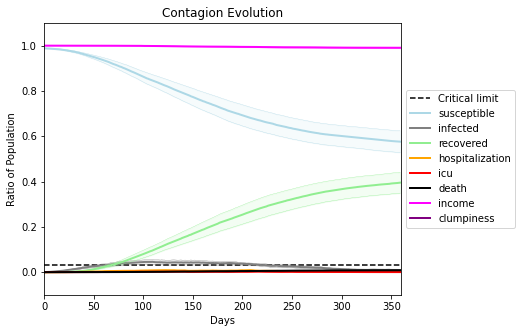

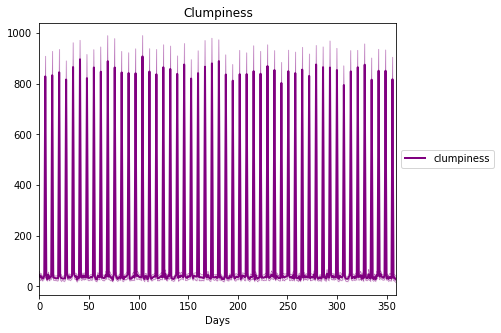

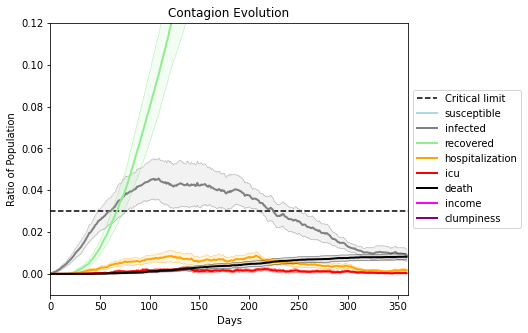

In [26]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.33
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7669, 2509, 7202, 3772, 1948, 511, 8221, 3665, 4328, 6859, 2055, 2261, 4672, 6712, 7529, 2996, 4260, 3958, 2367, 8557]
Average similarity between family members is 0.06706771818087036 at temperature 0.66
Average similarity between family and home is 0.9998475790220016 at temperature -1
Average similarity between students and their classroom is 0.07263255479282063 at temperature 0.66
Average classroom occupancy is 1.553191489361702 and number classrooms is 188
Average similarity between workers is 0.05137333725108463 at temperature 0.66
Average office occupancy is 3.236180904522613 and number offices is 199
Average friend similarity for adults: 0.12768323409939647 for kids: 0.12021937859156134
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.04580348858477584
avg restaurant similarity -0.0027116148672787824
avg restaurant similarity 0.018017691182339285
avg restaurant similarity 0.0504150522977841
avg restaurant similarity 0.022096283770991182
avg restaurant similarity 0.013685373309671227
avg restaurant similarity 0.017035118312451816
avg restaurant similarity 0.019845452585217995
avg restaurant similarity 0.03570665353743722
avg restaurant similarity 0.04064997879414594
avg restaurant similarity 0.000829686811053442
avg restaurant similarity 0.049280835298378615
avg restaurant similarity 0.043837647149045325
avg restaurant similarity 0.07967138035387046
avg restaurant similarity 0.04043021332795874
avg restaurant similarity -0.013196345607584805
avg restaurant similarity 0.04813069343223191
avg restaurant similarity 0.023108694501198422
avg restaurant similarity -0.05248530424767542
avg restaurant similarity 0.028053940110251762
avg restaurant similarity 0.07210732566806471
avg restaurant simi

avg restaurant similarity 0.013780514772547658
avg restaurant similarity 0.050581082301781294
avg restaurant similarity 0.0502861091546591
avg restaurant similarity -0.006888827233614019
avg restaurant similarity 0.03919446929555103
avg restaurant similarity 0.03509882322506393
avg restaurant similarity 0.04068979928190561
avg restaurant similarity 0.040947377970562034
avg restaurant similarity 0.01436234318178986
avg restaurant similarity -0.0016187119452664705
avg restaurant similarity 0.020298492422000294
avg restaurant similarity -0.029834536911951173
avg restaurant similarity 0.019605459012766738
avg restaurant similarity 0.013887060347423794
avg restaurant similarity 0.07283920805122156
avg restaurant similarity 0.016737605897913087
avg restaurant similarity 0.02559093969480345
avg restaurant similarity -0.01270584922398302
avg restaurant similarity 0.021958280531448215
avg restaurant similarity 0.03426325212837319
avg restaurant similarity 0.008568830495153874
avg restaurant sim

avg restaurant similarity -0.015372140755995665
avg restaurant similarity -0.015366084954079895
avg restaurant similarity 0.03179975932504619
avg restaurant similarity 0.014358585190475209
avg restaurant similarity 0.01916342102046632
avg restaurant similarity -0.005831898587881144
avg restaurant similarity 0.03994493573201037
avg restaurant similarity 0.04978748594769898
avg restaurant similarity 0.00381547979099268
Average similarity between family members is 0.06477768292779439 at temperature 0.66
Average similarity between family and home is 0.9998497991823303 at temperature -1
Average similarity between students and their classroom is 0.07470196718193933 at temperature 0.66
Average classroom occupancy is 1.5549738219895288 and number classrooms is 191
Average similarity between workers is 0.06356675198065657 at temperature 0.66
Average office occupancy is 3.25 and number offices is 200
Average friend similarity for adults: 0.12154868173161958 for kids: 0.1198436060065416
home_dist

avg restaurant similarity 0.03814758881649489
avg restaurant similarity -0.020160181504647292
avg restaurant similarity 0.04723674019092693
avg restaurant similarity 0.020617889338571088
avg restaurant similarity 0.031498177765053564
avg restaurant similarity 0.06479228744033666
avg restaurant similarity 0.023130528258314683
avg restaurant similarity -0.03164265962160877
avg restaurant similarity 0.016500223385659363
avg restaurant similarity 0.02863649379743742
avg restaurant similarity 0.054190282388545945
avg restaurant similarity 0.005136462315839531
avg restaurant similarity -0.03169366539909533
avg restaurant similarity 0.05342031002710051
avg restaurant similarity 0.04402051025589563
avg restaurant similarity 0.06549950199659318
avg restaurant similarity -0.010113331445726136
avg restaurant similarity 0.017978074518717038
avg restaurant similarity -0.006648602727791545
avg restaurant similarity 0.023440060137746094
avg restaurant similarity -0.02698054685050433
avg restaurant si

avg restaurant similarity 0.051072620091298856
avg restaurant similarity 0.02434130296741542
avg restaurant similarity -0.005018651958441799
avg restaurant similarity 0.02010606614345853
avg restaurant similarity 0.05521620084169371
avg restaurant similarity 0.03523463470096737
avg restaurant similarity -0.0077160293743913835
avg restaurant similarity 0.011565524270740946
avg restaurant similarity 0.03335645352976806
avg restaurant similarity 0.009157388250806135
avg restaurant similarity 0.03942225549815455
avg restaurant similarity 0.045417143028062094
avg restaurant similarity 0.02334656390635732
avg restaurant similarity 0.032751790171883996
avg restaurant similarity 0.014886442690249156
avg restaurant similarity 0.02281727263881002
avg restaurant similarity 0.016879828477777324
avg restaurant similarity 0.00862369304850025
avg restaurant similarity 0.006232692100936793
avg restaurant similarity 0.01295627720611481
avg restaurant similarity 0.04529979960483534
avg restaurant simila

avg restaurant similarity -0.006819378378750747
avg restaurant similarity 0.0006035344717306192
avg restaurant similarity 0.02928279552464246
avg restaurant similarity 0.011685489905604977
avg restaurant similarity 0.02829173723548499
avg restaurant similarity 0.0348552895756195
avg restaurant similarity 0.02706548444339358
avg restaurant similarity 0.03973350110268993
Average similarity between family members is 0.05411509556815388 at temperature 0.66
Average similarity between family and home is 0.9998593796391458 at temperature -1
Average similarity between students and their classroom is 0.049543190422469637 at temperature 0.66
Average classroom occupancy is 1.6292134831460674 and number classrooms is 178
Average similarity between workers is 0.04394074664984017 at temperature 0.66
Average office occupancy is 3.3214285714285716 and number offices is 196
Average friend similarity for adults: 0.12229919810317413 for kids: 0.1241177504806082
home_districts
[
Home (0,0) district with 1

avg restaurant similarity -0.021528116692649348
avg restaurant similarity 0.05059771947786518
avg restaurant similarity -0.0031111117682709674
avg restaurant similarity 0.008126051707215184
avg restaurant similarity 0.05052461079208837
avg restaurant similarity -0.022651597528420588
avg restaurant similarity 0.022839794656478313
avg restaurant similarity -0.015923588628508806
avg restaurant similarity 0.05009837777252107
avg restaurant similarity 0.058188673448536087
avg restaurant similarity 0.03868102892715967
avg restaurant similarity 0.063797682394305
avg restaurant similarity 0.01739139258815569
avg restaurant similarity 0.02701406778958389
avg restaurant similarity -0.034911647949720535
avg restaurant similarity 0.013969807774690911
avg restaurant similarity 0.022170498209375254
avg restaurant similarity 0.019094970021247736
avg restaurant similarity 0.03885921556328817
avg restaurant similarity 0.06550650931540285
avg restaurant similarity 0.026325051396097983
avg restaurant sim

avg restaurant similarity 0.01034975232377729
avg restaurant similarity -0.006401819593926857
avg restaurant similarity 0.04958468920478785
avg restaurant similarity 0.01825173458546234
avg restaurant similarity 0.039705699665347066
avg restaurant similarity 0.039830289760401975
avg restaurant similarity -0.03196863679800889
avg restaurant similarity 0.08297346505968865
avg restaurant similarity 0.028018777997259926
avg restaurant similarity 0.018731012214234122
avg restaurant similarity 0.051371771662150095
avg restaurant similarity 0.045980129026402285
avg restaurant similarity 0.03630181029605034
avg restaurant similarity 0.01177737277314296
avg restaurant similarity -0.02118986436555838
avg restaurant similarity 0.06682630738555397
avg restaurant similarity -0.006697043021494732
avg restaurant similarity 0.03222222966103991
avg restaurant similarity 0.023003510200263803
avg restaurant similarity 0.05919563288494008
avg restaurant similarity 0.04423281375015941
avg restaurant simila

avg restaurant similarity -0.0055059914607659055
avg restaurant similarity 0.06513364240542847
avg restaurant similarity -0.005084684322223503
avg restaurant similarity 0.06351722881884733
avg restaurant similarity 0.02197626844191845
avg restaurant similarity 0.005332223137970591
avg restaurant similarity 0.014040534431328387
avg restaurant similarity 0.052210071261169125
Average similarity between family members is 0.06088909600191038 at temperature 0.66
Average similarity between family and home is 0.9998544492247569 at temperature -1
Average similarity between students and their classroom is 0.04950348181591668 at temperature 0.66
Average classroom occupancy is 1.6590909090909092 and number classrooms is 176
Average similarity between workers is 0.07647403905162803 at temperature 0.66
Average office occupancy is 3.3214285714285716 and number offices is 196
Average friend similarity for adults: 0.12910591127395127 for kids: 0.1295989876912866
home_districts
[
Home (0,0) district wit

avg restaurant similarity -0.004228040165286237
avg restaurant similarity 0.07476006029818591
avg restaurant similarity 0.05289104251143503
avg restaurant similarity 0.04424263835599689
avg restaurant similarity 0.07188172852261779
avg restaurant similarity 0.06860858510248066
avg restaurant similarity 0.03147176859673437
avg restaurant similarity -0.0038147532315666787
avg restaurant similarity 0.04139341472832134
avg restaurant similarity 0.018351493188316623
avg restaurant similarity 0.00681408286157767
avg restaurant similarity 0.03304727067036231
avg restaurant similarity 0.0006214148594208686
avg restaurant similarity 0.04215983495143468
avg restaurant similarity 0.029582993528743752
avg restaurant similarity 0.029185844502641126
avg restaurant similarity -0.004120539268106139
avg restaurant similarity 0.08891995261402812
avg restaurant similarity 0.057177231289334086
avg restaurant similarity 0.016031745738121186
avg restaurant similarity 0.024428091755280178
avg restaurant simi

avg restaurant similarity 0.057641731119792684
avg restaurant similarity 0.05258076629668964
avg restaurant similarity 0.023076576522192298
avg restaurant similarity 0.0068556513161812625
avg restaurant similarity 0.07642416698268845
avg restaurant similarity 0.008065485382816033
avg restaurant similarity 0.030234841226219354
avg restaurant similarity 0.06865188935299242
avg restaurant similarity 0.0620845221442422
avg restaurant similarity 0.0315847775146238
avg restaurant similarity 0.006815971171844911
avg restaurant similarity 0.020660265545549113
avg restaurant similarity 0.05511474181782198
avg restaurant similarity 0.07119673658917225
avg restaurant similarity -0.009901323811571992
avg restaurant similarity 0.008478685943279923
avg restaurant similarity 0.07848269633981728
avg restaurant similarity 0.062237124006755025
avg restaurant similarity 0.015609056401605325
avg restaurant similarity 0.0455113985365724
avg restaurant similarity 0.031887410309120956
avg restaurant similari

avg restaurant similarity 0.03328545608844888
avg restaurant similarity 0.030639929827240148
avg restaurant similarity 0.025474675495253285
avg restaurant similarity 0.03476710579898463
avg restaurant similarity -0.022056741130590425
avg restaurant similarity 0.03585567168598111
Average similarity between family members is 0.06603289770172706 at temperature 0.66
Average similarity between family and home is 0.9998616093753233 at temperature -1
Average similarity between students and their classroom is 0.07025288281356194 at temperature 0.66
Average classroom occupancy is 1.4821428571428572 and number classrooms is 168
Average similarity between workers is 0.05499189046015375 at temperature 0.66
Average office occupancy is 3.4554455445544554 and number offices is 202
Average friend similarity for adults: 0.11913884586344663 for kids: 0.1236302819642561
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units

avg restaurant similarity 0.030238547927504557
avg restaurant similarity 0.02567297328446943
avg restaurant similarity -0.018630805092147432
avg restaurant similarity 0.04354180716307263
avg restaurant similarity 0.03783855930022326
avg restaurant similarity 0.03584460868259605
avg restaurant similarity 0.04215418166234443
avg restaurant similarity -0.013827002937380843
avg restaurant similarity 0.0322876592894008
avg restaurant similarity 0.05444422003151135
avg restaurant similarity 0.027818403153054908
avg restaurant similarity 0.03152953505126389
avg restaurant similarity 0.021624220295053266
avg restaurant similarity 0.009254122930817456
avg restaurant similarity 0.021151103876940348
avg restaurant similarity 0.003493903814958026
avg restaurant similarity 0.03371159124825811
avg restaurant similarity 0.020718677608793368
avg restaurant similarity 0.04024848296980483
avg restaurant similarity -0.028237202115744073
avg restaurant similarity -0.011591101106939162
avg restaurant simil

avg restaurant similarity 0.04245111700999598
avg restaurant similarity 0.06134206982786347
avg restaurant similarity 0.001672002429913288
avg restaurant similarity 0.03667607687983083
avg restaurant similarity 0.03180053462016077
avg restaurant similarity 0.011769949478434572
avg restaurant similarity 0.049233968218837916
avg restaurant similarity 0.040025074445152985
avg restaurant similarity -0.01612074613118917
avg restaurant similarity 0.05342063959012713
avg restaurant similarity 0.04742862421313961
avg restaurant similarity -0.005371517103410024
avg restaurant similarity 0.050286632323134045
avg restaurant similarity 0.04899201695415186
avg restaurant similarity 0.027214735689109686
avg restaurant similarity 0.004883879408147158
avg restaurant similarity 0.0462087339598411
avg restaurant similarity 0.05765207172696907
avg restaurant similarity 0.01960170993378042
avg restaurant similarity 0.04302852611737916
avg restaurant similarity 0.07306769848631597
avg restaurant similarity

avg restaurant similarity -0.023352519902081797
avg restaurant similarity 0.047781542458679674
avg restaurant similarity 0.0081740580283252
avg restaurant similarity 0.05229346881927587
avg restaurant similarity 0.002959280117715804
avg restaurant similarity 0.01641784892445309
avg restaurant similarity -0.004273099426859314
avg restaurant similarity 0.028754413643583252
Average similarity between family members is 0.038491794169286185 at temperature 0.66
Average similarity between family and home is 0.9998610744416512 at temperature -1
Average similarity between students and their classroom is 0.06607708227202365 at temperature 0.66
Average classroom occupancy is 1.68 and number classrooms is 175
Average similarity between workers is 0.07539828801925447 at temperature 0.66
Average office occupancy is 3.209756097560976 and number offices is 205
Average friend similarity for adults: 0.12982204926372762 for kids: 0.1441437552732496
home_districts
[
Home (0,0) district with 1 Buildings
Ho

avg restaurant similarity 0.06916791710951044
avg restaurant similarity 0.041643670016313666
avg restaurant similarity 0.05230332556406288
avg restaurant similarity 0.06690933139458151
avg restaurant similarity -0.006629401778789056
avg restaurant similarity 0.00215487457684653
avg restaurant similarity 0.04420103975166202
avg restaurant similarity 0.04343537506624873
avg restaurant similarity 0.041282064096498455
avg restaurant similarity 0.040128948066200244
avg restaurant similarity 0.05866515028300121
avg restaurant similarity 0.03624131939331563
avg restaurant similarity 0.0807586720117545
avg restaurant similarity 0.06043012916573247
avg restaurant similarity 0.06812483363196999
avg restaurant similarity 0.05672619000245454
avg restaurant similarity 0.0855646628068681
avg restaurant similarity 0.0458876820707925
avg restaurant similarity 0.08325988478642099
avg restaurant similarity 0.03676472490420347
avg restaurant similarity 0.10521802931371901
avg restaurant similarity 0.0622

avg restaurant similarity 0.010005243308553909
avg restaurant similarity 0.023998849143177507
avg restaurant similarity 0.05759595548127733
avg restaurant similarity 0.032542523119665316
avg restaurant similarity 0.03627796394738607
avg restaurant similarity 0.039065157718300235
avg restaurant similarity -0.007405670330071294
avg restaurant similarity 0.046029989979552176
avg restaurant similarity 0.04441047920002304
avg restaurant similarity 0.06718283676379118
avg restaurant similarity 0.04409353685618445
avg restaurant similarity 0.04375859701544721
avg restaurant similarity 0.0923818482693699
avg restaurant similarity 0.038248316751053994
avg restaurant similarity 0.013741836146063642
avg restaurant similarity 0.010337874614250366
avg restaurant similarity 0.07664161769508045
avg restaurant similarity 0.043293110777440635
avg restaurant similarity 0.028772572502006915
avg restaurant similarity 0.03362984914723558
avg restaurant similarity 0.08608060600790299
avg restaurant similari

avg restaurant similarity -0.01620768772391241
avg restaurant similarity 0.021754061044054113
avg restaurant similarity 0.08831638001023402
avg restaurant similarity 0.08666473816174701
avg restaurant similarity 0.014143416682500097
avg restaurant similarity 0.061932839642053275
avg restaurant similarity 0.0026734156531133617
Average similarity between family members is 0.052389231770946905 at temperature 0.66
Average similarity between family and home is 0.9998617555934791 at temperature -1
Average similarity between students and their classroom is 0.09279434941695215 at temperature 0.66
Average classroom occupancy is 1.6214689265536724 and number classrooms is 177
Average similarity between workers is 0.057735273812762083 at temperature 0.66
Average office occupancy is 3.2935323383084576 and number offices is 201
Average friend similarity for adults: 0.12849371751972063 for kids: 0.1316569787763538
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (e

avg restaurant similarity 0.023622501783757983
avg restaurant similarity -0.04238166279958882
avg restaurant similarity 0.01061787736740098
avg restaurant similarity -0.008626297308049997
avg restaurant similarity 0.018713744572947114
avg restaurant similarity 0.07778596427016582
avg restaurant similarity -0.008197433944321965
avg restaurant similarity 0.0005896557548425543
avg restaurant similarity 0.0005272631000396629
avg restaurant similarity -0.021840376610750615
avg restaurant similarity 0.016897255054704824
avg restaurant similarity -0.012601829705787198
avg restaurant similarity -0.01814042571132074
avg restaurant similarity -0.005265656188328581
avg restaurant similarity 0.01458026076305166
avg restaurant similarity 0.004212215327627094
avg restaurant similarity -0.01576006914389527
avg restaurant similarity -0.03342314775004014
avg restaurant similarity 0.0009382020100499617
avg restaurant similarity -0.01126235321302013
avg restaurant similarity 0.0129530843727976
avg restau

avg restaurant similarity -0.03392395208123812
avg restaurant similarity -0.05127335708457189
avg restaurant similarity 0.027314924258981087
avg restaurant similarity 0.027061871343533456
avg restaurant similarity 0.0005965130222610778
avg restaurant similarity 0.009800174811245852
avg restaurant similarity 0.03890594917162208
avg restaurant similarity 0.007058227574300905
avg restaurant similarity -0.0015597957027175156
avg restaurant similarity -0.04810023663192427
avg restaurant similarity 0.010563114572800484
avg restaurant similarity -0.01779528565181615
avg restaurant similarity -0.012540430382886481
avg restaurant similarity 0.021592615057097322
avg restaurant similarity 0.024060285315984604
avg restaurant similarity 0.026998567821711325
avg restaurant similarity -0.012039464140603596
avg restaurant similarity -0.01685215366152068
avg restaurant similarity 0.009855205506988153
avg restaurant similarity 0.033941367003976625
avg restaurant similarity 0.016623638650897807
avg resta

avg restaurant similarity 0.01591167720323372
avg restaurant similarity -0.018376627994492974
avg restaurant similarity 0.019813656887597626
avg restaurant similarity -0.006742405404353665
avg restaurant similarity 0.02686794816836443
avg restaurant similarity 0.003951643389645155
avg restaurant similarity 0.02156659278044422
avg restaurant similarity 0.028517899295544272
avg restaurant similarity -0.015725219013370543
avg restaurant similarity 0.013080189823880834
avg restaurant similarity 0.010352360417823725
Average similarity between family members is 0.05649075832980597 at temperature 0.66
Average similarity between family and home is 0.9998610990980663 at temperature -1
Average similarity between students and their classroom is 0.06323388666853082 at temperature 0.66
Average classroom occupancy is 1.6503067484662577 and number classrooms is 163
Average similarity between workers is 0.05853979149477978 at temperature 0.66
Average office occupancy is 3.262135922330097 and number of

avg restaurant similarity 0.05637762830207789
avg restaurant similarity 0.024631485845954443
avg restaurant similarity 0.05929433989756312
avg restaurant similarity 0.011277520519217906
avg restaurant similarity 0.06158412941888379
avg restaurant similarity 0.042222850379918665
avg restaurant similarity 0.015393026222255518
avg restaurant similarity 0.03181855195446195
avg restaurant similarity 0.020126464189277143
avg restaurant similarity 0.004136991965078496
avg restaurant similarity 0.024379514409716627
avg restaurant similarity 0.03675109203363216
avg restaurant similarity 0.012110761782462214
avg restaurant similarity 0.021968480649411596
avg restaurant similarity 0.011100311108885316
avg restaurant similarity 0.015743507269751763
avg restaurant similarity 0.0284211509506621
avg restaurant similarity -0.0024152193141631566
avg restaurant similarity 0.01461946426727778
avg restaurant similarity -0.017579531907043495
avg restaurant similarity 0.013995739342893701
avg restaurant sim

avg restaurant similarity 0.015972203068030186
avg restaurant similarity 0.037521393216928066
avg restaurant similarity 0.03357302320038314
avg restaurant similarity 0.019238577076169355
avg restaurant similarity 0.030647596073964913
avg restaurant similarity -0.008714665273503697
avg restaurant similarity -0.021507431978601502
avg restaurant similarity 0.04344899019158266
avg restaurant similarity 0.008406434154728923
avg restaurant similarity 0.020867999567566266
avg restaurant similarity 0.04002040803937426
avg restaurant similarity 0.00015964223669936227
avg restaurant similarity 0.02344151864533349
avg restaurant similarity 0.0652185860571098
avg restaurant similarity 0.04681271635894068
avg restaurant similarity 0.027121768582598328
avg restaurant similarity 0.006977827320363865
avg restaurant similarity 0.026621494168602974
avg restaurant similarity 0.041326130019830896
avg restaurant similarity 0.0411649171649627
avg restaurant similarity 0.02661332930186019
avg restaurant simi

avg restaurant similarity 0.0201735273044091
avg restaurant similarity 0.03605121571856097
avg restaurant similarity 0.03794320998688409
avg restaurant similarity 0.023161921881664035
avg restaurant similarity 0.04853456549689678
avg restaurant similarity 0.002908951518834137
avg restaurant similarity 0.0017414722162481194
avg restaurant similarity 0.04200227742328286
Average similarity between family members is 0.06852610879815489 at temperature 0.66
Average similarity between family and home is 0.9998516468698453 at temperature -1
Average similarity between students and their classroom is 0.08002200706559995 at temperature 0.66
Average classroom occupancy is 1.5647058823529412 and number classrooms is 170
Average similarity between workers is 0.0400424615200874 at temperature 0.66
Average office occupancy is 3.4744897959183674 and number offices is 196
Average friend similarity for adults: 0.1260797750966725 for kids: 0.12334914370191807
home_districts
[
Home (0,0) district with 1 Bu

avg restaurant similarity -0.051039084307549346
avg restaurant similarity 0.003368290134193146
avg restaurant similarity -0.02621933085392445
avg restaurant similarity -0.016917233923708343
avg restaurant similarity -0.01787704082071696
avg restaurant similarity 0.0020850773991211635
avg restaurant similarity 0.006877162733859162
avg restaurant similarity 0.01713748423012777
avg restaurant similarity 0.009317856844804129
avg restaurant similarity -0.015398850472841591
avg restaurant similarity -0.03210459392003864
avg restaurant similarity -0.02139968858351391
avg restaurant similarity -0.018431067452238596
avg restaurant similarity 0.06575408153491959
avg restaurant similarity 0.030978512431192144
avg restaurant similarity 0.0014153005803689204
avg restaurant similarity -0.01375886507469045
avg restaurant similarity -0.028041260580909805
avg restaurant similarity 0.00636201296041086
avg restaurant similarity -0.0339564023527746
avg restaurant similarity -0.011476166913214498
avg resta

avg restaurant similarity 0.02592165881879648
avg restaurant similarity -0.011136868807748706
avg restaurant similarity -0.010858391203079335
avg restaurant similarity 0.003008379568075839
avg restaurant similarity -0.02648791805969833
avg restaurant similarity -0.038332622983012696
avg restaurant similarity 0.0013767896875041972
avg restaurant similarity 0.030225405264109852
avg restaurant similarity -0.02073517262539097
avg restaurant similarity -0.013027608500406145
avg restaurant similarity 0.03113754969404647
avg restaurant similarity 0.026489086338539046
avg restaurant similarity 0.008990075548709137
avg restaurant similarity 0.004430168485055693
avg restaurant similarity 0.0015929359467895335
avg restaurant similarity -0.02327195805199531
avg restaurant similarity -0.03016762546133431
avg restaurant similarity -0.013738540850650745
avg restaurant similarity -0.02488466779779328
avg restaurant similarity 0.007828304631087956
avg restaurant similarity 0.0033905609143502734
avg res

avg restaurant similarity -0.015332157311936594
avg restaurant similarity 0.015238810390985017
avg restaurant similarity -0.0001534028462733472
avg restaurant similarity 0.018251185303980594
avg restaurant similarity 0.017693639836430183
avg restaurant similarity 0.001909357142558754
avg restaurant similarity 0.00909815880585818
avg restaurant similarity 0.01476767154258947
avg restaurant similarity 0.01445954102157162
avg restaurant similarity -0.03179992934072989
avg restaurant similarity -0.016859073983536286
avg restaurant similarity -0.0023846938731785054
Average similarity between family members is 0.05996792060331528 at temperature 0.66
Average similarity between family and home is 0.9998583511354964 at temperature -1
Average similarity between students and their classroom is 0.06293111978266085 at temperature 0.66
Average classroom occupancy is 1.723529411764706 and number classrooms is 170
Average similarity between workers is 0.034654055107679375 at temperature 0.66
Average o

avg restaurant similarity -0.014990303868153677
avg restaurant similarity 0.04391004861419178
avg restaurant similarity -0.023736746113167714
avg restaurant similarity 0.028924910763960227
avg restaurant similarity 0.044853336663689125
avg restaurant similarity 0.013942675317698484
avg restaurant similarity 0.03742263782054175
avg restaurant similarity 0.025989995178242055
avg restaurant similarity 0.007319165486358434
avg restaurant similarity 0.023647838566617684
avg restaurant similarity 0.038145486447320104
avg restaurant similarity 0.03462587740200409
avg restaurant similarity 0.007386684338941973
avg restaurant similarity 0.020083463142050256
avg restaurant similarity -0.010965137521795251
avg restaurant similarity 0.06122062492393543
avg restaurant similarity 0.05839881935078346
avg restaurant similarity 0.0010191580871552496
avg restaurant similarity -0.021328915444514346
avg restaurant similarity -0.00046093735239025903
avg restaurant similarity 0.04893032167400689
avg restaur

avg restaurant similarity 0.010508733662856888
avg restaurant similarity 0.0105648439155708
avg restaurant similarity 0.043995023029887205
avg restaurant similarity 0.06356480229251274
avg restaurant similarity 0.013798512123283434
avg restaurant similarity 0.0373921164432633
avg restaurant similarity 0.02018004017223164
avg restaurant similarity 0.026419499291388718
avg restaurant similarity 0.018615855198189618
avg restaurant similarity 0.013258232098977514
avg restaurant similarity 0.006411563453785173
avg restaurant similarity 0.010210401469226908
avg restaurant similarity 0.060742919947223674
avg restaurant similarity 0.029508807430430748
avg restaurant similarity 0.05885682264972483
avg restaurant similarity 0.03240387446498047
avg restaurant similarity 0.030911967936959616
avg restaurant similarity -0.014108981737948317
avg restaurant similarity -0.012958367581850509
avg restaurant similarity 0.024419419704224326
avg restaurant similarity 0.016474007090003216
avg restaurant simi

avg restaurant similarity -0.010689127687433566
avg restaurant similarity 0.002168128541669267
avg restaurant similarity 0.03715211337108874
avg restaurant similarity 0.06337632296330736
avg restaurant similarity 0.033552805471072304
avg restaurant similarity 0.05664093663793506
avg restaurant similarity -0.002394415985123512
avg restaurant similarity 0.013164004952078933
Average similarity between family members is 0.043540934880276376 at temperature 0.66
Average similarity between family and home is 0.9998558161863674 at temperature -1
Average similarity between students and their classroom is 0.059634949889982546 at temperature 0.66
Average classroom occupancy is 1.6369047619047619 and number classrooms is 168
Average similarity between workers is 0.07672347171526656 at temperature 0.66
Average office occupancy is 3.2955665024630543 and number offices is 203
Average friend similarity for adults: 0.12581519584546494 for kids: 0.13640209040588167
home_districts
[
Home (0,0) district w

avg restaurant similarity 0.02564713301540668
avg restaurant similarity -0.01671182582880999
avg restaurant similarity 0.009805569989544297
avg restaurant similarity 0.038841495998429905
avg restaurant similarity 0.04470130535148272
avg restaurant similarity 0.03200791443072429
avg restaurant similarity 0.0205636310373979
avg restaurant similarity 0.010143710757367821
avg restaurant similarity 0.028376193214590725
avg restaurant similarity 0.015831823767129466
avg restaurant similarity 0.03910492670423512
avg restaurant similarity 0.006492160650568953
avg restaurant similarity 0.0065492011832028775
avg restaurant similarity 0.019833476291605444
avg restaurant similarity 0.06143096065991991
avg restaurant similarity -0.025726852251492776
avg restaurant similarity 0.01242160545194635
avg restaurant similarity -0.005777042022972883
avg restaurant similarity -0.01590004924864286
avg restaurant similarity 0.021087090884144233
avg restaurant similarity 0.021951264732807525
avg restaurant sim

avg restaurant similarity 0.022085952666779415
avg restaurant similarity -0.004813430295282301
avg restaurant similarity 0.034129999258015825
avg restaurant similarity 0.029038259778455023
avg restaurant similarity 0.015331202109272024
avg restaurant similarity 0.04322371536810921
avg restaurant similarity 0.04911068696606116
avg restaurant similarity 0.03839832299255037
avg restaurant similarity -0.018395947787552176
avg restaurant similarity 0.014878761083293736
avg restaurant similarity 0.0152187699148774
avg restaurant similarity 0.03372008471903116
avg restaurant similarity 0.009321111267682477
avg restaurant similarity 0.005560571210452314
avg restaurant similarity 0.04927656697519776
avg restaurant similarity 0.03476311013765586
avg restaurant similarity 0.0515125223062995
avg restaurant similarity 0.019794905265001737
avg restaurant similarity 0.01609358433832837
avg restaurant similarity 0.022405031368669222
avg restaurant similarity 0.024443656672133544
avg restaurant similar

avg restaurant similarity 0.012560016768785511
avg restaurant similarity 0.024641892141619326
avg restaurant similarity 0.03491180086330473
avg restaurant similarity 0.02485332408412598
avg restaurant similarity 0.01154544653423394
avg restaurant similarity 0.0315670174459649
avg restaurant similarity 0.02202565606435162
avg restaurant similarity 0.0307411936383092
avg restaurant similarity 0.04076336346025051
avg restaurant similarity 0.003144269828083352
Average similarity between family members is 0.06729722462888223 at temperature 0.66
Average similarity between family and home is 0.9998602201720929 at temperature -1
Average similarity between students and their classroom is 0.06568817789792997 at temperature 0.66
Average classroom occupancy is 1.6089385474860336 and number classrooms is 179
Average similarity between workers is 0.0479090812886622 at temperature 0.66
Average office occupancy is 3.283582089552239 and number offices is 201
Average friend similarity for adults: 0.1367

avg restaurant similarity 0.046267131773437775
avg restaurant similarity 0.025764654869422834
avg restaurant similarity 0.018353829572150582
avg restaurant similarity 0.02181667370919674
avg restaurant similarity 0.04294525970953078
avg restaurant similarity 0.018967576772546742
avg restaurant similarity 0.019342336989599647
avg restaurant similarity 0.06055440263350948
avg restaurant similarity 0.023709089694479903
avg restaurant similarity 0.028922076350021995
avg restaurant similarity 0.012641117841220092
avg restaurant similarity 0.00739108740187893
avg restaurant similarity 0.04125072663771768
avg restaurant similarity 0.00996750551520924
avg restaurant similarity 0.027314486348152436
avg restaurant similarity 0.01690998754123355
avg restaurant similarity 0.04858930604764055
avg restaurant similarity 0.03485684743315194
avg restaurant similarity 0.023684059003475044
avg restaurant similarity -0.008212968957702176
avg restaurant similarity 0.04288133704005904
avg restaurant similar

avg restaurant similarity -0.003540171436463141
avg restaurant similarity 0.0056298195371085775
avg restaurant similarity 0.03167176515511235
avg restaurant similarity 0.03641743922229787
avg restaurant similarity 0.06235658830671569
avg restaurant similarity 0.018275112479697136
avg restaurant similarity 0.06075426639683582
avg restaurant similarity 0.054383068481694476
avg restaurant similarity 0.03227193764483929
avg restaurant similarity -0.006720351204843781
avg restaurant similarity 0.032628491881006146
avg restaurant similarity 0.03644198293128928
avg restaurant similarity 0.06248022175409378
avg restaurant similarity 0.022489831569983857
avg restaurant similarity 0.022310711354913353
avg restaurant similarity 0.05685788575377191
avg restaurant similarity -0.005054937419606749
avg restaurant similarity 0.041123925909876693
avg restaurant similarity 0.023404123582701126
avg restaurant similarity 0.020753672643047383
avg restaurant similarity 0.03425693120341145
avg restaurant sim

avg restaurant similarity 0.05205427051907484
avg restaurant similarity 0.028590665188949562
avg restaurant similarity 0.039374384892808804
avg restaurant similarity 0.02523136029893915
avg restaurant similarity 0.08154498862431855
avg restaurant similarity 0.02399549272202929
Average similarity between family members is 0.07023695514464096 at temperature 0.66
Average similarity between family and home is 0.9998486158378369 at temperature -1
Average similarity between students and their classroom is 0.05317623874323098 at temperature 0.66
Average classroom occupancy is 1.566137566137566 and number classrooms is 189
Average similarity between workers is 0.0589475058755404 at temperature 0.66
Average office occupancy is 3.257575757575758 and number offices is 198
Average friend similarity for adults: 0.1264608672427015 for kids: 0.13119001996760998
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with

avg restaurant similarity 0.02540549969631114
avg restaurant similarity 0.0336673661055254
avg restaurant similarity 0.034193244082530716
avg restaurant similarity 0.05874352743684227
avg restaurant similarity 0.018448906789549767
avg restaurant similarity 0.042729584355814226
avg restaurant similarity -0.0009842182304876758
avg restaurant similarity 0.008951098543825793
avg restaurant similarity 0.018067691594613303
avg restaurant similarity -0.04422783805390659
avg restaurant similarity 0.06077987674149564
avg restaurant similarity 0.019396685429666577
avg restaurant similarity 0.0376551188427076
avg restaurant similarity 0.036245127702583826
avg restaurant similarity 0.05957997082887593
avg restaurant similarity 0.05697651414006799
avg restaurant similarity 0.02942818146831857
avg restaurant similarity 0.03070003606988619
avg restaurant similarity 0.03585866668265788
avg restaurant similarity 0.022683657870256436
avg restaurant similarity 0.047192370263256726
avg restaurant similari

avg restaurant similarity 0.03483590231945005
avg restaurant similarity 0.04086080437740407
avg restaurant similarity 0.016112981489580475
avg restaurant similarity 0.016774036761734386
avg restaurant similarity 0.06284350506362237
avg restaurant similarity 0.03798734438690342
avg restaurant similarity 0.02334112726691373
avg restaurant similarity 0.035413267114865116
avg restaurant similarity 0.05174666476039252
avg restaurant similarity 0.0714948974372363
avg restaurant similarity 0.04322611340382824
avg restaurant similarity 0.01712455836358736
avg restaurant similarity 0.0441964221998778
avg restaurant similarity 0.031396095362924197
avg restaurant similarity 0.015038632782160161
avg restaurant similarity 0.02745982966799284
avg restaurant similarity 0.00958170715174744
avg restaurant similarity 0.03208907070648841
avg restaurant similarity 0.055126559665247724
avg restaurant similarity 0.030323420451016308
avg restaurant similarity 0.030063064890877338
avg restaurant similarity 0.

avg restaurant similarity 0.03815391449921305
avg restaurant similarity 0.06443364134749727
avg restaurant similarity 0.015514819031236846
avg restaurant similarity 0.01656023818354125
avg restaurant similarity 0.017042757585656303
avg restaurant similarity 0.03139104440264073
Average similarity between family members is 0.07087161966741294 at temperature 0.66
Average similarity between family and home is 0.9998513092593017 at temperature -1
Average similarity between students and their classroom is 0.060532606763493674 at temperature 0.66
Average classroom occupancy is 1.5625 and number classrooms is 176
Average similarity between workers is 0.06178514478903946 at temperature 0.66
Average office occupancy is 3.402061855670103 and number offices is 194
Average friend similarity for adults: 0.12712631867480165 for kids: 0.12591018346437843
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total

avg restaurant similarity 0.0678696406086631
avg restaurant similarity -0.0029943151540229897
avg restaurant similarity 0.016946560888853882
avg restaurant similarity 0.0021480866694430748
avg restaurant similarity 0.008653323962509063
avg restaurant similarity 0.02758868436597211
avg restaurant similarity 0.02085542018865888
avg restaurant similarity 0.047665954176298916
avg restaurant similarity -0.03567291464935298
avg restaurant similarity -0.019516534152892263
avg restaurant similarity 0.011525843509409196
avg restaurant similarity -0.007225997532511148
avg restaurant similarity 0.03504926105299434
avg restaurant similarity 0.033014519552272005
avg restaurant similarity 0.02382023586203589
avg restaurant similarity 0.004281214924440288
avg restaurant similarity 0.007272344285870644
avg restaurant similarity 0.04894461314994806
avg restaurant similarity 0.030446115048880857
avg restaurant similarity -0.008142088624012583
avg restaurant similarity -0.02920662404939385
avg restaurant

avg restaurant similarity 0.03257736980216969
avg restaurant similarity 0.04041442674922967
avg restaurant similarity 0.019123105667881782
avg restaurant similarity 0.04441010718387593
avg restaurant similarity 0.03899600509037099
avg restaurant similarity 0.0009972428433058422
avg restaurant similarity 0.017864893959439
avg restaurant similarity 0.01816020391710907
avg restaurant similarity -0.015731978799208228
avg restaurant similarity 0.027292457180292273
avg restaurant similarity -0.013126791853687328
avg restaurant similarity 0.02324792803228944
avg restaurant similarity 0.006984911730713887
avg restaurant similarity 0.07605310136341566
avg restaurant similarity 0.015803607280060385
avg restaurant similarity -0.001515848734719871
avg restaurant similarity -0.008853573028727324
avg restaurant similarity -0.043536081776176454
avg restaurant similarity -0.003991774512280337
avg restaurant similarity -0.00555672961696578
avg restaurant similarity 0.03381230192115593
avg restaurant si

avg restaurant similarity 0.021201444122892533
avg restaurant similarity 0.03312980177595181
avg restaurant similarity 0.02303239658282752
avg restaurant similarity 0.01465083488037882
avg restaurant similarity 0.05500064377079369
avg restaurant similarity -0.005979034746026156
avg restaurant similarity 0.026389605276513267
avg restaurant similarity 0.037547428010029034
avg restaurant similarity -0.04350405601847896
avg restaurant similarity -0.017624816990991277
Average similarity between family members is 0.05217885034729737 at temperature 0.66
Average similarity between family and home is 0.9998725001051025 at temperature -1
Average similarity between students and their classroom is 0.04052918795096101 at temperature 0.66
Average classroom occupancy is 1.6408839779005524 and number classrooms is 181
Average similarity between workers is 0.0679999445416737 at temperature 0.66
Average office occupancy is 3.1176470588235294 and number offices is 204
Average friend similarity for adults

avg restaurant similarity -0.004393598772089403
avg restaurant similarity -0.0082224428218582
avg restaurant similarity 0.043599355145331586
avg restaurant similarity 0.001652376030569357
avg restaurant similarity 0.00754694166263339
avg restaurant similarity -0.0068005899873031595
avg restaurant similarity 0.03228050324112285
avg restaurant similarity -0.013350572632799358
avg restaurant similarity 0.007663960090469851
avg restaurant similarity -0.005256120492846583
avg restaurant similarity -0.01673603732284388
avg restaurant similarity -0.0483617101948334
avg restaurant similarity -0.026436971918487085
avg restaurant similarity 0.031062601888004266
avg restaurant similarity -0.0022341922103765806
avg restaurant similarity -0.008447796413135651
avg restaurant similarity 0.06632199989727619
avg restaurant similarity -0.023505651945030487
avg restaurant similarity -0.00034424579387647706
avg restaurant similarity 0.05170514234765407
avg restaurant similarity -0.01872330252560259
avg re

avg restaurant similarity -0.0051653342587220106
avg restaurant similarity 0.0009385702902203121
avg restaurant similarity -0.010758324588935846
avg restaurant similarity 0.009902863260004585
avg restaurant similarity -0.016461401199372745
avg restaurant similarity 0.024972619734313178
avg restaurant similarity -0.013362633903782485
avg restaurant similarity -0.0001268726151616502
avg restaurant similarity -0.0009074389913668207
avg restaurant similarity -0.03264312048665742
avg restaurant similarity 0.030570362076449826
avg restaurant similarity 0.02511728406606278
avg restaurant similarity -0.009180848491754276
avg restaurant similarity -0.003006837325227949
avg restaurant similarity -0.002237609541359183
avg restaurant similarity 0.031020390792848265
avg restaurant similarity 0.026109202214346452
avg restaurant similarity -0.014702212390609082
avg restaurant similarity 0.003810182253657492
avg restaurant similarity 0.033499550810955306
avg restaurant similarity -0.001217227193239390

avg restaurant similarity -0.01682845825219048
avg restaurant similarity -0.00740242309403019
avg restaurant similarity 0.001936149180719626
avg restaurant similarity 0.0271547429361183
avg restaurant similarity 0.0030352768686883517
avg restaurant similarity 0.01823242910335096
avg restaurant similarity 0.007131485528300025
avg restaurant similarity 0.08000001185744783
avg restaurant similarity -0.0022519335432298507
avg restaurant similarity -0.03931972491464816
avg restaurant similarity 0.05032973941132389
avg restaurant similarity 0.03076474063181019
Average similarity between family members is 0.053600502131333515 at temperature 0.66
Average similarity between family and home is 0.9998561710135488 at temperature -1
Average similarity between students and their classroom is 0.08480384882432886 at temperature 0.66
Average classroom occupancy is 1.6363636363636365 and number classrooms is 187
Average similarity between workers is 0.05233641849496416 at temperature 0.66
Average office

avg restaurant similarity -0.011934384729136136
avg restaurant similarity 0.045817198561892106
avg restaurant similarity 0.01807971412352074
avg restaurant similarity 0.001368870340085179
avg restaurant similarity -0.03301289944622788
avg restaurant similarity 0.012507373271124776
avg restaurant similarity 0.03896540379917172
avg restaurant similarity -0.011170290361936648
avg restaurant similarity -0.014381355139050622
avg restaurant similarity 0.001874968423024505
avg restaurant similarity 0.031212338764468387
avg restaurant similarity 0.01680257292662744
avg restaurant similarity -0.022984225334786
avg restaurant similarity 0.0007710097791429596
avg restaurant similarity 0.012653035066612734
avg restaurant similarity -0.018267685534168607
avg restaurant similarity -0.0347026373006842
avg restaurant similarity 0.00749228890622376
avg restaurant similarity 0.013636347943156431
avg restaurant similarity 0.03175445643436797
avg restaurant similarity -0.020380444114894126
avg restaurant 

avg restaurant similarity 0.036405088490990466
avg restaurant similarity 0.02188702588076005
avg restaurant similarity -0.005382881991036585
avg restaurant similarity -0.00334699986539921
avg restaurant similarity -0.009937998857988808
avg restaurant similarity -0.004372477186422017
avg restaurant similarity 0.004206756756350106
avg restaurant similarity -0.0008367056851347956
avg restaurant similarity 0.004326448413163664
avg restaurant similarity 0.0033871100784572863
avg restaurant similarity 0.007205726608605795
avg restaurant similarity -0.00043513578644849716
avg restaurant similarity 0.009895181086446079
avg restaurant similarity 0.02456791728457206
avg restaurant similarity 0.03031196827839994
avg restaurant similarity -0.007189479101140024
avg restaurant similarity 0.05473123317267044
avg restaurant similarity -0.0034642298812228903
avg restaurant similarity 0.0348189490616185
avg restaurant similarity -0.011070923326231047
avg restaurant similarity 0.017467257074733553
avg re

avg restaurant similarity -0.03194241110901465
avg restaurant similarity 0.014661069717271224
avg restaurant similarity 0.03866988486060386
avg restaurant similarity 0.05163377227418023
avg restaurant similarity 0.025430310453808988
avg restaurant similarity -0.004378490381954625
avg restaurant similarity -0.0186725007192404
avg restaurant similarity 0.015044907972512997
avg restaurant similarity 0.0285824287994296
avg restaurant similarity 0.0018262527767729296
avg restaurant similarity -0.0316740634566246
avg restaurant similarity 0.04345920932247346
Average similarity between family members is 0.05109683645878023 at temperature 0.66
Average similarity between family and home is 0.9998574885586845 at temperature -1
Average similarity between students and their classroom is 0.03941912968425302 at temperature 0.66
Average classroom occupancy is 1.586021505376344 and number classrooms is 186
Average similarity between workers is 0.08112042772289105 at temperature 0.66
Average office occ

avg restaurant similarity 0.001966528645073256
avg restaurant similarity 0.02303758382820706
avg restaurant similarity 0.018532664050487604
avg restaurant similarity -0.030675667468816375
avg restaurant similarity 0.01399095750332864
avg restaurant similarity 0.03270780791208913
avg restaurant similarity 0.044237500113997894
avg restaurant similarity 0.018668586155661967
avg restaurant similarity -0.007492757712246305
avg restaurant similarity 0.07674774154460318
avg restaurant similarity 0.01807309423453104
avg restaurant similarity 0.022127097584757286
avg restaurant similarity -0.01975361784364586
avg restaurant similarity 0.018962772120355735
avg restaurant similarity 0.018224427297216364
avg restaurant similarity 0.0029791347363015324
avg restaurant similarity 0.002343026166181722
avg restaurant similarity 0.007542163644622279
avg restaurant similarity 0.01688056094447698
avg restaurant similarity 0.028366679976225245
avg restaurant similarity 0.004256362429330561
avg restaurant s

avg restaurant similarity 0.004794520730650676
avg restaurant similarity 0.029142115054148435
avg restaurant similarity 0.04492246158745896
avg restaurant similarity 0.01019602602312448
avg restaurant similarity 0.04559613665716435
avg restaurant similarity 0.0006194438738290024
avg restaurant similarity -0.0011170647338722781
avg restaurant similarity 0.014566428740651066
avg restaurant similarity -0.027046189248482354
avg restaurant similarity 0.029539206855812676
avg restaurant similarity 0.04190251674313811
avg restaurant similarity 0.021541721783170893
avg restaurant similarity 0.034576752993035594
avg restaurant similarity 0.031113069527511715
avg restaurant similarity 0.007255440522053349
avg restaurant similarity 0.024119750004199948
avg restaurant similarity 0.02288913409812406
avg restaurant similarity -0.011607202917962052
avg restaurant similarity -0.022045933873543394
avg restaurant similarity 0.008226180752038147
avg restaurant similarity 0.03329628263498479
avg restauran

avg restaurant similarity 0.04183410088337539
avg restaurant similarity 0.006850341236871769
avg restaurant similarity 0.03038760655562001
avg restaurant similarity 0.021097490184629284
avg restaurant similarity 0.027289826825118192
avg restaurant similarity 0.01862847717485531
avg restaurant similarity 0.022192014290488605
avg restaurant similarity 0.030817578575163044
avg restaurant similarity 0.020229495605064117
avg restaurant similarity -0.0016791246550565807
avg restaurant similarity 0.0406610244914367
avg restaurant similarity -0.007694860666789996
Average similarity between family members is 0.059047154102381386 at temperature 0.66
Average similarity between family and home is 0.9998539713208291 at temperature -1
Average similarity between students and their classroom is 0.07465320637425783 at temperature 0.66
Average classroom occupancy is 1.718562874251497 and number classrooms is 167
Average similarity between workers is 0.04747383088766513 at temperature 0.66
Average office

avg restaurant similarity 0.012551232950051396
avg restaurant similarity -0.010218547244280889
avg restaurant similarity 0.042337589372989745
avg restaurant similarity 0.07858758296633775
avg restaurant similarity 0.03940181503851528
avg restaurant similarity 0.03158376203744848
avg restaurant similarity 0.027000352665997786
avg restaurant similarity 0.054043249177545966
avg restaurant similarity 0.0844002122482778
avg restaurant similarity 0.015072954401342016
avg restaurant similarity 0.0319810414269538
avg restaurant similarity 0.06330765078189965
avg restaurant similarity 0.0056987913187091154
avg restaurant similarity 0.006560517267862335
avg restaurant similarity 0.0056249322555539
avg restaurant similarity -0.02106662224229022
avg restaurant similarity 0.03745295078824455
avg restaurant similarity -0.0013930648812130286
avg restaurant similarity 0.0011060352136243981
avg restaurant similarity 0.08729100497954509
avg restaurant similarity 0.057804856643065075
avg restaurant simil

avg restaurant similarity 7.321726780880859e-05
avg restaurant similarity 0.09891729151456205
avg restaurant similarity -0.022337622760603866
avg restaurant similarity 0.11644621161767023
avg restaurant similarity 0.01861992540028152
avg restaurant similarity 0.007688829027196229
avg restaurant similarity 0.05785665560013965
avg restaurant similarity -0.0017137502233940656
avg restaurant similarity 0.01957352758465661
avg restaurant similarity 0.06092728819556106
avg restaurant similarity 0.05677669384582481
avg restaurant similarity 0.029968742123479476
avg restaurant similarity 0.039422029219985694
avg restaurant similarity 0.06798949470610696
avg restaurant similarity 0.046278341830680546
avg restaurant similarity 0.012978670483486464
avg restaurant similarity 0.04365560689994527
avg restaurant similarity 0.07074720203311632
avg restaurant similarity 0.03549555405911477
avg restaurant similarity 0.0075538280641874326
avg restaurant similarity 0.04561540885606838
avg restaurant simil

avg restaurant similarity 0.01140038117481467
avg restaurant similarity 0.05899742026523606
avg restaurant similarity 0.01492813942730665
avg restaurant similarity 0.0011553510276013092
avg restaurant similarity 0.008808742904907492
avg restaurant similarity 0.026818635575042774
avg restaurant similarity 0.09039919281150999
Average similarity between family members is 0.059403175593137375 at temperature 0.66
Average similarity between family and home is 0.999853180813513 at temperature -1
Average similarity between students and their classroom is 0.06696851601962847 at temperature 0.66
Average classroom occupancy is 1.6666666666666667 and number classrooms is 189
Average similarity between workers is 0.08837817869789105 at temperature 0.66
Average office occupancy is 3.150753768844221 and number offices is 199
Average friend similarity for adults: 0.12951872157558839 for kids: 0.13525453475584845
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each 

avg restaurant similarity 0.00032767613543910015
avg restaurant similarity -0.02205259850150924
avg restaurant similarity 0.05685610639263781
avg restaurant similarity 0.024680895231921615
avg restaurant similarity -0.044187988861535174
avg restaurant similarity 0.03809937805263454
avg restaurant similarity -0.061386486744433956
avg restaurant similarity -0.0500242909973979
avg restaurant similarity 0.05270001003366847
avg restaurant similarity 0.04521360812524876
avg restaurant similarity 0.004991064204477961
avg restaurant similarity 0.01854809805129567
avg restaurant similarity 0.01609636879836792
avg restaurant similarity -0.010030193573477062
avg restaurant similarity 0.04712580939713042
avg restaurant similarity -0.01515771956049667
avg restaurant similarity 0.016871429044543734
avg restaurant similarity -0.018205571062901237
avg restaurant similarity 0.0133962703845784
avg restaurant similarity 0.05535725675011516
avg restaurant similarity -0.015568504518524576
avg restaurant si

avg restaurant similarity -0.025793655708351532
avg restaurant similarity 0.02933244360556456
avg restaurant similarity 0.06517827501693385
avg restaurant similarity 0.009556269824467818
avg restaurant similarity 0.011759099340973293
avg restaurant similarity 0.03144252809024951
avg restaurant similarity 0.07664109029263629
avg restaurant similarity 0.04455698814891502
avg restaurant similarity -0.02644838257081386
avg restaurant similarity 0.036175856732229374
avg restaurant similarity -0.012056443011196486
avg restaurant similarity -0.010668625960495408
avg restaurant similarity -0.007138679606972247
avg restaurant similarity 0.027339154186029852
avg restaurant similarity 0.010274147777991433
avg restaurant similarity 0.01677103558984393
avg restaurant similarity -0.016401904191344976
avg restaurant similarity 0.051470109378747596
avg restaurant similarity 0.004864717300416373
avg restaurant similarity 0.007239628997265584
avg restaurant similarity 0.0230199988549438
avg restaurant s

avg restaurant similarity 0.05290080590902886
avg restaurant similarity 0.0632074038952646
avg restaurant similarity 0.009090162608985836
avg restaurant similarity 0.06439977842904382
avg restaurant similarity -0.00959599554492269
avg restaurant similarity -0.025606501621053605
avg restaurant similarity 0.03318774638380825
avg restaurant similarity 0.08542978095309244
avg restaurant similarity -0.004677512832768196
avg restaurant similarity -0.017832644582076562
Average similarity between family members is 0.051010065319386566 at temperature 0.66
Average similarity between family and home is 0.999833078931258 at temperature -1
Average similarity between students and their classroom is 0.08230453018528648 at temperature 0.66
Average classroom occupancy is 1.6032608695652173 and number classrooms is 184
Average similarity between workers is 0.0582967814075577 at temperature 0.66
Average office occupancy is 3.2587064676616917 and number offices is 201
Average friend similarity for adults:

avg restaurant similarity -0.033265784578389246
avg restaurant similarity 0.012651589146722738
avg restaurant similarity 0.02040455026098575
avg restaurant similarity 0.02641539492714997
avg restaurant similarity 0.002314656661639222
avg restaurant similarity 0.002591754496252523
avg restaurant similarity 0.052150951049171265
avg restaurant similarity 0.03357826279559513
avg restaurant similarity 0.01749426926698713
avg restaurant similarity -0.014704973049543579
avg restaurant similarity 0.030779605362360494
avg restaurant similarity 0.008412597167750852
avg restaurant similarity 0.03288755731008856
avg restaurant similarity 0.02754858032856123
avg restaurant similarity 0.0191490247006764
avg restaurant similarity 0.010903366325388759
avg restaurant similarity 0.042788368642621075
avg restaurant similarity 0.034633159211454496
avg restaurant similarity 0.009843192759323159
avg restaurant similarity 0.01919898775607206
avg restaurant similarity 0.01475239064072902
avg restaurant simila

avg restaurant similarity 0.024024186389520835
avg restaurant similarity 0.03461470435709691
avg restaurant similarity 0.0013846194367985584
avg restaurant similarity 0.022714007483579275
avg restaurant similarity 0.040324638705458396
avg restaurant similarity 0.0021224143819583876
avg restaurant similarity 0.0032922786748180053
avg restaurant similarity 0.009218424445684912
avg restaurant similarity 0.022338772637557184
avg restaurant similarity 0.03873966260153506
avg restaurant similarity 0.040673693018984006
avg restaurant similarity 0.0042213104143965004
avg restaurant similarity -0.010058632333736404
avg restaurant similarity 0.049610176251110735
avg restaurant similarity 0.033111617216967267
avg restaurant similarity 0.018661005790020647
avg restaurant similarity 0.023645990612248223
avg restaurant similarity -0.007957956457596484
avg restaurant similarity 0.006240151715022435
avg restaurant similarity 0.05144458574704474
avg restaurant similarity 0.007766944836560199
avg restau

avg restaurant similarity 0.02595699529626168
avg restaurant similarity 0.018810490240191092
avg restaurant similarity 0.007524941976140408
avg restaurant similarity 0.021464516421513424
avg restaurant similarity 0.009792496822755696
avg restaurant similarity -0.023429502337036525
avg restaurant similarity 0.05976725973130061
avg restaurant similarity 0.0007494258251650606
avg restaurant similarity -0.010931591257525726
using average of time series:
stats on susceptible:
data: [0.7047055555555556, 0.7721527777777778, 0.7597972222222223, 0.777286111111111, 0.7679320679320679, 0.7984614105123088, 0.7857222222222222, 0.6372333333333333, 0.830211111111111, 0.6782277777777778, 0.793144090305445, 0.7367111111111111, 0.7663083333333333, 0.6023444444444445, 0.8583333333333333, 0.7722582972582971, 0.8711555555555555, 0.8217388888888889, 0.7859584859584859, 0.8074628520736306]
min:
0.6023444444444445
max:
0.8711555555555555
std:
0.06596855361643375
mean:
0.7663572490909007
median:
0.774772204184

(<function dict.items>, <function dict.items>, <function dict.items>)

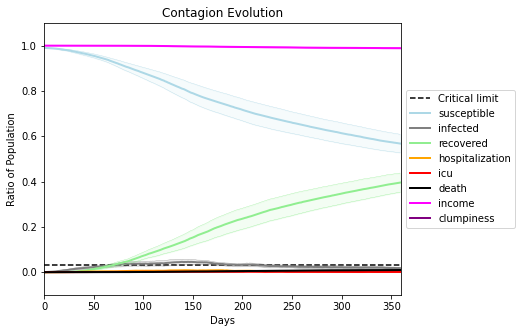

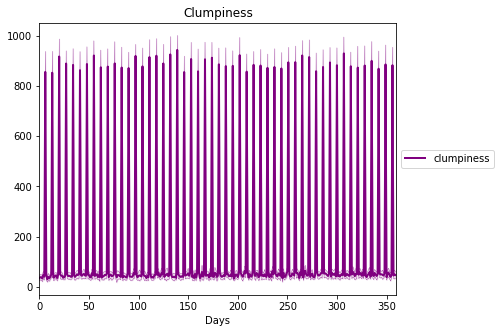

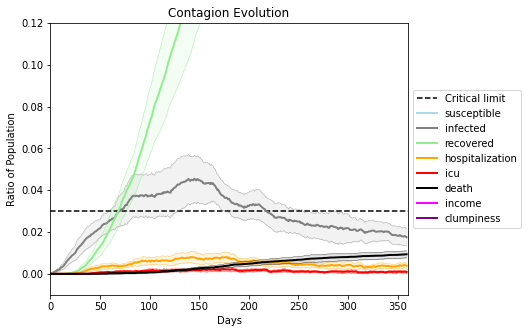

In [27]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.66
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6788, 7692, 4698, 569, 5086, 1446, 7931, 2043, 6414, 2906, 5558, 3319, 8818, 1040, 5319, 7221, 9157, 36, 3742, 7371]
Average similarity between family members is 0.004266312109604319 at temperature 1
Average similarity between family and home is 0.9998468864928484 at temperature -1
Average similarity between students and their classroom is 0.02983148168100513 at temperature 1
Average classroom occupancy is 1.6432748538011697 and number classrooms is 171
Average similarity between workers is 0.007296578365266105 at temperature 1
Average office occupancy is 3.3233830845771144 and number offices is 201
Average friend similarity for adults: 0.08834179702968632 for kids: 0.0907926027479853
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homog

avg restaurant similarity 0.01628610213965421
avg restaurant similarity 0.013299481997675352
avg restaurant similarity -0.004730558776672359
avg restaurant similarity 0.01629256804268812
avg restaurant similarity -0.021595961960017614
avg restaurant similarity 0.02070987906727069
avg restaurant similarity 0.03696883516275912
avg restaurant similarity -0.006303352384566239
avg restaurant similarity -0.031557219569050124
avg restaurant similarity 0.02897256392011757
avg restaurant similarity 0.0453948262714835
avg restaurant similarity -0.002586902666291446
avg restaurant similarity 0.015446451917803415
avg restaurant similarity 0.04802415672375718
avg restaurant similarity 0.028270218167174514
avg restaurant similarity 0.005682765098502787
avg restaurant similarity 0.009449477636369994
avg restaurant similarity -0.008875182455372521
avg restaurant similarity 0.021294662202140106
avg restaurant similarity 0.022973114811713796
avg restaurant similarity -0.03774291496495165
avg restaurant 

avg restaurant similarity 0.012499378972501373
avg restaurant similarity 0.018305687258889026
avg restaurant similarity 0.03199377941980633
avg restaurant similarity -0.011499576785627378
avg restaurant similarity -0.0051575343120377004
avg restaurant similarity -0.011965964832825932
avg restaurant similarity 0.05575409779682298
avg restaurant similarity -0.007158255385487758
avg restaurant similarity -0.0009408388238903997
avg restaurant similarity 0.003887849016984051
avg restaurant similarity 0.0299247213156056
avg restaurant similarity 0.02230237741484985
avg restaurant similarity 0.029619994446528183
avg restaurant similarity -0.007648785982870208
avg restaurant similarity 0.012179107750123154
avg restaurant similarity -0.002497752169265317
avg restaurant similarity 0.030541743928811926
avg restaurant similarity -0.01606778911035827
avg restaurant similarity 0.006798177629776746
avg restaurant similarity -0.009749735383289574
avg restaurant similarity -0.005600103746993954
avg res

avg restaurant similarity 0.015834366295231522
avg restaurant similarity 0.016161486205515465
avg restaurant similarity 0.021628303388573484
avg restaurant similarity 0.04500441167749021
avg restaurant similarity 0.010432526194424668
avg restaurant similarity 0.03873231589672227
avg restaurant similarity -0.004604558237513152
avg restaurant similarity -0.02058768794330991
avg restaurant similarity 0.047659017441156575
avg restaurant similarity 0.009204017673699742
Average similarity between family members is -0.009072323585013557 at temperature 1
Average similarity between family and home is 0.9998489491050071 at temperature -1
Average similarity between students and their classroom is 0.03198083514945695 at temperature 1
Average classroom occupancy is 1.5738636363636365 and number classrooms is 176
Average similarity between workers is 0.012202807884401312 at temperature 1
Average office occupancy is 3.272277227722772 and number offices is 202
Average friend similarity for adults: 0.0

avg restaurant similarity -0.011187974847701796
avg restaurant similarity 0.012252885342947252
avg restaurant similarity -0.02047116114962755
avg restaurant similarity -0.008813872697415558
avg restaurant similarity 0.025942898248339907
avg restaurant similarity 0.02619103339211592
avg restaurant similarity 0.013188478441647925
avg restaurant similarity -0.019629813203785235
avg restaurant similarity -0.0049483298567463505
avg restaurant similarity -0.004384711428891901
avg restaurant similarity 0.006616932291438283
avg restaurant similarity 0.006584481573236297
avg restaurant similarity -0.006165405151750681
avg restaurant similarity -0.029161075588949283
avg restaurant similarity 0.024706049146529564
avg restaurant similarity 0.0011571261758813243
avg restaurant similarity -0.07737903208186891
avg restaurant similarity 0.000412638981938166
avg restaurant similarity 0.04055009782035967
avg restaurant similarity -0.023651633726812397
avg restaurant similarity -0.012565308496308115
avg 

avg restaurant similarity 0.0036836292416237908
avg restaurant similarity 0.048204725061173626
avg restaurant similarity -0.0020737612928597273
avg restaurant similarity 0.008261158447777433
avg restaurant similarity 0.03340412680028702
avg restaurant similarity 0.03364894937498528
avg restaurant similarity 0.023007730022151774
avg restaurant similarity -0.003060958614252471
avg restaurant similarity -0.020717849528693325
avg restaurant similarity -0.015372783395669836
avg restaurant similarity -0.02608527775923955
avg restaurant similarity 0.017838254195104708
avg restaurant similarity -0.012066108667151548
avg restaurant similarity 0.0003218763860382453
avg restaurant similarity 0.010726247033921242
avg restaurant similarity 0.053536077995082094
avg restaurant similarity -0.03894075202626767
avg restaurant similarity 0.017420696239818727
avg restaurant similarity -0.027229253196781506
avg restaurant similarity -0.030269360656137372
avg restaurant similarity 0.03682401339416459
avg re

avg restaurant similarity 0.014682217362146505
avg restaurant similarity 0.007030824119098001
avg restaurant similarity -0.004720539494745771
avg restaurant similarity -0.032583234961825455
avg restaurant similarity -0.047467279885135556
avg restaurant similarity -0.016029115457611043
avg restaurant similarity 0.020452445505017614
avg restaurant similarity 0.021262714248827776
avg restaurant similarity -0.020514643341530185
avg restaurant similarity -0.023808601468890585
avg restaurant similarity 0.02251004956645979
avg restaurant similarity -0.010644517343145195
avg restaurant similarity 0.04788192275338676
avg restaurant similarity 0.01429876336538233
Average similarity between family members is 0.010161829348998072 at temperature 1
Average similarity between family and home is 0.9998511202670798 at temperature -1
Average similarity between students and their classroom is 0.020354455839480628 at temperature 1
Average classroom occupancy is 1.5222222222222221 and number classrooms is 

avg restaurant similarity 0.009518775061982631
avg restaurant similarity 0.04533437514793105
avg restaurant similarity 0.0045816547912435794
avg restaurant similarity -0.010708052842737799
avg restaurant similarity -0.019121412548725594
avg restaurant similarity 0.0029987673369226524
avg restaurant similarity 0.005978830505805147
avg restaurant similarity 0.003024140843948316
avg restaurant similarity 0.004641386574780913
avg restaurant similarity 0.007056459578954341
avg restaurant similarity -0.015443261920526244
avg restaurant similarity -0.04105239143150367
avg restaurant similarity -0.057341118866553596
avg restaurant similarity 0.03282729251047286
avg restaurant similarity 0.0022842423192695966
avg restaurant similarity -0.031840679145139064
avg restaurant similarity -0.058860675904955986
avg restaurant similarity -0.009040289663982782
avg restaurant similarity -0.014798053961405669
avg restaurant similarity -0.05636010402265526
avg restaurant similarity -0.05117801331037965
avg 

avg restaurant similarity -0.041480604487288374
avg restaurant similarity -0.022144592169879705
avg restaurant similarity -0.004387460389045579
avg restaurant similarity 0.00391706228762446
avg restaurant similarity -0.02013371480130789
avg restaurant similarity 0.016550458337125276
avg restaurant similarity -0.019100921849356897
avg restaurant similarity 0.00788614160747977
avg restaurant similarity 0.003714117595320826
avg restaurant similarity 0.03401793320076294
avg restaurant similarity 0.018579122271334996
avg restaurant similarity -0.02319818648365053
avg restaurant similarity -0.017930505728944286
avg restaurant similarity -0.049701751345183544
avg restaurant similarity 0.011727645846804902
avg restaurant similarity 0.010522340548948822
avg restaurant similarity 0.009924330951489896
avg restaurant similarity 0.031334134089222955
avg restaurant similarity -0.030472199340599946
avg restaurant similarity 0.0046828270241306025
avg restaurant similarity -0.019827863429179103
avg res

avg restaurant similarity 0.03387479058653582
avg restaurant similarity 0.043207088431099064
avg restaurant similarity -0.005202452367970641
avg restaurant similarity -0.01822924219301451
avg restaurant similarity -0.033845002221629894
avg restaurant similarity -0.013038649242733428
avg restaurant similarity 0.04029107824324964
avg restaurant similarity -0.043166933731142096
avg restaurant similarity -0.011522591844491241
avg restaurant similarity -0.019936418286996035
avg restaurant similarity -0.036239219368212214
avg restaurant similarity -0.012942216897353823
avg restaurant similarity -0.0017805155360535367
avg restaurant similarity 0.0026783720143431613
Average similarity between family members is -0.013679799999263829 at temperature 1
Average similarity between family and home is 0.9998638472235423 at temperature -1
Average similarity between students and their classroom is -0.006671971348741624 at temperature 1
Average classroom occupancy is 1.6045197740112995 and number classro

avg restaurant similarity 0.001986975529974432
avg restaurant similarity 0.026328658825234892
avg restaurant similarity 0.05572414615092564
avg restaurant similarity 0.00298497966173011
avg restaurant similarity -0.03560889574589126
avg restaurant similarity 0.013729667693055683
avg restaurant similarity 0.01890026076174514
avg restaurant similarity 0.004453527650531206
avg restaurant similarity 0.024386385048977305
avg restaurant similarity 0.022983717853692263
avg restaurant similarity 0.03345460016410357
avg restaurant similarity -0.02824620320390899
avg restaurant similarity 0.007612879202072668
avg restaurant similarity -0.010687122041823073
avg restaurant similarity -0.002085106921909492
avg restaurant similarity 0.025556634934674492
avg restaurant similarity 0.022619732322830547
avg restaurant similarity -0.010501233610440273
avg restaurant similarity 0.001037865020056033
avg restaurant similarity 0.024762781367549967
avg restaurant similarity 0.023557262423572874
avg restaurant

avg restaurant similarity 0.02979028154767822
avg restaurant similarity -0.021174201827335405
avg restaurant similarity 0.009103327235012641
avg restaurant similarity 0.007679713089756694
avg restaurant similarity 0.008141761828856613
avg restaurant similarity 0.027990377186395205
avg restaurant similarity 0.06615810589903391
avg restaurant similarity 0.02159350120603238
avg restaurant similarity 0.03011119124331547
avg restaurant similarity 0.04127781326706283
avg restaurant similarity 0.02166835320360878
avg restaurant similarity 0.04120210554549676
avg restaurant similarity 0.0022190867971843466
avg restaurant similarity 0.01803207698138846
avg restaurant similarity -0.041292162671329555
avg restaurant similarity 0.020676570254316514
avg restaurant similarity -0.0320212576511855
avg restaurant similarity 0.0061616032213757214
avg restaurant similarity 0.009677824118534219
avg restaurant similarity -0.015297166725886824
avg restaurant similarity 0.04763377734160253
avg restaurant sim

avg restaurant similarity 0.001963283702848481
avg restaurant similarity 0.0048884553985967475
avg restaurant similarity 0.016260153964149718
avg restaurant similarity 0.009328730239230214
avg restaurant similarity -0.005004600435271104
avg restaurant similarity 0.011272295273736589
avg restaurant similarity 0.025090023575027126
avg restaurant similarity 0.040660291291743186
avg restaurant similarity -0.031272138234241936
avg restaurant similarity 0.011984313897749524
avg restaurant similarity 0.03980608103756296
Average similarity between family members is -0.0015969296195567511 at temperature 1
Average similarity between family and home is 0.9998667768555022 at temperature -1
Average similarity between students and their classroom is 0.0055293540452583615 at temperature 1
Average classroom occupancy is 1.6741573033707866 and number classrooms is 178
Average similarity between workers is 0.033963271225534684 at temperature 1
Average office occupancy is 3.1323529411764706 and number of

avg restaurant similarity 0.08119899946609328
avg restaurant similarity -0.0344118405283654
avg restaurant similarity 0.0318164388329288
avg restaurant similarity 0.018671913105564267
avg restaurant similarity 0.03522922284408205
avg restaurant similarity 0.044586561961174546
avg restaurant similarity 0.008143644363863252
avg restaurant similarity -0.004060281584168572
avg restaurant similarity 0.03741423873538984
avg restaurant similarity -0.00016889227348638116
avg restaurant similarity 0.0265441510355433
avg restaurant similarity -0.017596655448366156
avg restaurant similarity 0.026153522610716917
avg restaurant similarity 0.012474801814193491
avg restaurant similarity 0.009915526781429903
avg restaurant similarity 0.011300578828909629
avg restaurant similarity -0.0018996236660594032
avg restaurant similarity 0.04637422699791072
avg restaurant similarity 0.02980769663169526
avg restaurant similarity -0.005227431218942351
avg restaurant similarity 0.02311695084334342
avg restaurant s

avg restaurant similarity 0.014112919799819944
avg restaurant similarity 0.030093316872940395
avg restaurant similarity 0.05930965239279681
avg restaurant similarity 0.010718774830164946
avg restaurant similarity -0.0079896238436793
avg restaurant similarity 0.013039356562266242
avg restaurant similarity 0.034612188768439536
avg restaurant similarity 0.016689777985088024
avg restaurant similarity 0.004763398881369557
avg restaurant similarity 0.008129835259972708
avg restaurant similarity 0.00429292381767921
avg restaurant similarity 0.013595539659474808
avg restaurant similarity 0.01570271388158649
avg restaurant similarity 0.004441675667807043
avg restaurant similarity 0.0344811933702639
avg restaurant similarity -0.023504437839193728
avg restaurant similarity 0.0367621533411173
avg restaurant similarity 0.01793686008923484
avg restaurant similarity -0.003365085332565741
avg restaurant similarity 0.0065370161967909
avg restaurant similarity 0.03603662863689383
avg restaurant similari

avg restaurant similarity 0.0268706681229659
avg restaurant similarity 0.015492297773738837
avg restaurant similarity 0.01729454109850516
avg restaurant similarity 0.04309580179125643
avg restaurant similarity 0.0010490437969541643
avg restaurant similarity 0.011018701315686632
avg restaurant similarity -0.0017824207745227715
avg restaurant similarity 0.022185590893761074
avg restaurant similarity -0.006657898391003536
avg restaurant similarity 0.007861755162280168
avg restaurant similarity 0.023825037963066575
Average similarity between family members is 0.004903409077163935 at temperature 1
Average similarity between family and home is 0.999865214292667 at temperature -1
Average similarity between students and their classroom is 0.021444834076023222 at temperature 1
Average classroom occupancy is 1.6703296703296704 and number classrooms is 182
Average similarity between workers is 0.019314806131146722 at temperature 1
Average office occupancy is 3.1940298507462686 and number offices 

avg restaurant similarity 0.020827152058044956
avg restaurant similarity -0.00991389649559244
avg restaurant similarity -0.007208373265321066
avg restaurant similarity 0.018133937075919596
avg restaurant similarity -0.007745877237474897
avg restaurant similarity -0.035230973044424976
avg restaurant similarity -0.008079428537476625
avg restaurant similarity 0.010049189176393046
avg restaurant similarity -0.011698331141934202
avg restaurant similarity -0.0051611068255511885
avg restaurant similarity -0.0009704164551975628
avg restaurant similarity 0.0013945129544153236
avg restaurant similarity 0.008016871645047304
avg restaurant similarity -0.009371706964762656
avg restaurant similarity 0.024163405242597028
avg restaurant similarity 0.0262791688378687
avg restaurant similarity -0.01580332285640564
avg restaurant similarity -0.01014753726057821
avg restaurant similarity 0.015084672726106623
avg restaurant similarity 0.020125740581459207
avg restaurant similarity 0.011940538834384912
avg 

avg restaurant similarity 0.005429471963043078
avg restaurant similarity -0.014111304824570748
avg restaurant similarity 0.014306901138871309
avg restaurant similarity 0.013096954817869867
avg restaurant similarity 0.0324627401565862
avg restaurant similarity 0.03659981808377906
avg restaurant similarity 0.04946620676020001
avg restaurant similarity -0.008155270548978532
avg restaurant similarity 0.014059816361536913
avg restaurant similarity -0.004043756018261724
avg restaurant similarity -0.01455058889543415
avg restaurant similarity 0.021405956778349368
avg restaurant similarity 0.024444171260172894
avg restaurant similarity 0.004932864232840299
avg restaurant similarity 0.04939863654399579
avg restaurant similarity 0.050910506379830606
avg restaurant similarity 0.0383362021603467
avg restaurant similarity 0.0092964098847502
avg restaurant similarity 0.013809212629461911
avg restaurant similarity 0.05365944472610023
avg restaurant similarity -0.047435428731378744
avg restaurant simi

avg restaurant similarity -0.009504977356809226
avg restaurant similarity -0.02721050904041022
avg restaurant similarity -0.01143943864710189
avg restaurant similarity 0.002940409986433594
avg restaurant similarity 0.027536502853802023
avg restaurant similarity 0.01425302312384233
avg restaurant similarity 0.011177325223014739
avg restaurant similarity 0.014797535110981822
avg restaurant similarity 0.006367694208394543
avg restaurant similarity -0.0006029320791719299
avg restaurant similarity 0.0013223032056093747
avg restaurant similarity -0.013206403230639829
Average similarity between family members is 0.012469836148083974 at temperature 1
Average similarity between family and home is 0.9998586642541363 at temperature -1
Average similarity between students and their classroom is 0.00042694568444550957 at temperature 1
Average classroom occupancy is 1.6382978723404256 and number classrooms is 188
Average similarity between workers is 0.007734722646097021 at temperature 1
Average offi

avg restaurant similarity -0.0007295842227085829
avg restaurant similarity 0.05048739604170116
avg restaurant similarity 0.03545506747290815
avg restaurant similarity 0.03863562141262143
avg restaurant similarity 0.02628440956629099
avg restaurant similarity -0.019444521369179103
avg restaurant similarity 0.06174137868218005
avg restaurant similarity 0.024811388426956488
avg restaurant similarity 0.00030764117971152685
avg restaurant similarity 0.04356431440539167
avg restaurant similarity 0.030953017262877386
avg restaurant similarity -0.006630042688278611
avg restaurant similarity 0.051316820264168755
avg restaurant similarity 0.02181471527206893
avg restaurant similarity 0.027750135259779964
avg restaurant similarity -0.03542784891383412
avg restaurant similarity 0.025029443196525787
avg restaurant similarity 0.034143367682503124
avg restaurant similarity 0.03547670534207733
avg restaurant similarity 0.044940610590106435
avg restaurant similarity 0.0038222907934291456
avg restaurant

avg restaurant similarity 0.020233085560688042
avg restaurant similarity 0.053514846458925194
avg restaurant similarity 0.028883170066492738
avg restaurant similarity 0.010945044883477868
avg restaurant similarity -0.0037611433569573055
avg restaurant similarity 0.03789187083097228
avg restaurant similarity 0.012606332462527703
avg restaurant similarity 0.02006949537885582
avg restaurant similarity 0.018385013020180238
avg restaurant similarity 0.04667419834626683
avg restaurant similarity 0.01857808413254043
avg restaurant similarity 0.044158107894451806
avg restaurant similarity -0.008801466841061876
avg restaurant similarity 0.050398025943166176
avg restaurant similarity 0.028444164305861396
avg restaurant similarity -0.03252161331960923
avg restaurant similarity 0.061959179291672314
avg restaurant similarity -0.015239706369822434
avg restaurant similarity 0.00956220053102882
avg restaurant similarity 0.03555544143666986
avg restaurant similarity 0.011506378263354928
avg restaurant 

avg restaurant similarity 0.04909441821896445
avg restaurant similarity 0.002515438229822286
avg restaurant similarity 0.042851155796762984
avg restaurant similarity 0.030411860101304276
avg restaurant similarity -0.01574040420378234
avg restaurant similarity 0.019361515304724936
avg restaurant similarity 0.018112057708567313
avg restaurant similarity 0.03576499041754939
avg restaurant similarity -0.00673006043134982
avg restaurant similarity 0.02574826065593467
Average similarity between family members is 0.009833220671841681 at temperature 1
Average similarity between family and home is 0.9998576516140508 at temperature -1
Average similarity between students and their classroom is 0.04574491254915949 at temperature 1
Average classroom occupancy is 1.6363636363636365 and number classrooms is 176
Average similarity between workers is 0.021753278932488605 at temperature 1
Average office occupancy is 3.323232323232323 and number offices is 198
Average friend similarity for adults: 0.0930

avg restaurant similarity 0.018766442599337664
avg restaurant similarity -0.030235160994937556
avg restaurant similarity -0.026628172516379035
avg restaurant similarity 0.010095624295560686
avg restaurant similarity 0.02016035034579633
avg restaurant similarity 0.030456658565975205
avg restaurant similarity -0.016708998434431438
avg restaurant similarity 0.031220475215205733
avg restaurant similarity -0.054690904245117467
avg restaurant similarity 0.014568887517149328
avg restaurant similarity 0.03276443580150897
avg restaurant similarity -0.01425448805532317
avg restaurant similarity 0.032601122364547104
avg restaurant similarity 0.006092055874684457
avg restaurant similarity 0.05388650726027853
avg restaurant similarity 0.005142760482498029
avg restaurant similarity -0.0062207466720162604
avg restaurant similarity -0.01870835280302555
avg restaurant similarity 0.012638927236173436
avg restaurant similarity 0.00766336569546782
avg restaurant similarity 0.062250352607497436
avg restaur

avg restaurant similarity 0.01889482707778268
avg restaurant similarity 0.017211891401473958
avg restaurant similarity -4.476782865720279e-05
avg restaurant similarity 0.018914259863506932
avg restaurant similarity -0.023688067687754878
avg restaurant similarity 0.03902079938601926
avg restaurant similarity 0.006700703148261305
avg restaurant similarity 0.04849841351299264
avg restaurant similarity 0.006024278498734535
avg restaurant similarity 0.0043557796510636055
avg restaurant similarity 0.048639570897860834
avg restaurant similarity 0.0202598776915684
avg restaurant similarity -0.0014135908103521506
avg restaurant similarity 0.023703794803924462
avg restaurant similarity 0.02406660377848315
avg restaurant similarity -0.0052565046242151895
avg restaurant similarity 0.006513459014303498
avg restaurant similarity -0.0036477506678790706
avg restaurant similarity 0.0533760059700878
avg restaurant similarity -0.03483512677508866
avg restaurant similarity 0.03265425086078204
avg restaura

avg restaurant similarity 0.049831185100016655
avg restaurant similarity 0.026713097660244205
avg restaurant similarity 0.04637176325670616
avg restaurant similarity -0.00850437640766526
avg restaurant similarity -0.05230722732899271
avg restaurant similarity 0.015581661388920224
avg restaurant similarity -0.007687019754999959
avg restaurant similarity 0.005862331426353518
avg restaurant similarity -0.00022741686347543992
avg restaurant similarity 0.007462210145885303
avg restaurant similarity -0.009798713863950818
Average similarity between family members is -0.0009595059600704977 at temperature 1
Average similarity between family and home is 0.9998516842768826 at temperature -1
Average similarity between students and their classroom is -0.0011593653050536003 at temperature 1
Average classroom occupancy is 1.5721649484536082 and number classrooms is 194
Average similarity between workers is -0.004436095325745065 at temperature 1
Average office occupancy is 3.18407960199005 and number 

avg restaurant similarity -0.03401486063849011
avg restaurant similarity -0.027724236203793832
avg restaurant similarity -0.010012212584471072
avg restaurant similarity 0.021774596978736696
avg restaurant similarity -0.045520283060174686
avg restaurant similarity -0.049554293247807434
avg restaurant similarity -0.03504536128292264
avg restaurant similarity -0.05261990241844031
avg restaurant similarity -0.0009278609900641444
avg restaurant similarity -0.0017413486389696638
avg restaurant similarity 0.0020575159610869472
avg restaurant similarity -0.04444638877583012
avg restaurant similarity -0.03620461490995185
avg restaurant similarity -0.004700827807351713
avg restaurant similarity -0.02883275365098098
avg restaurant similarity -0.029899328587631502
avg restaurant similarity -0.029667611553466644
avg restaurant similarity -0.01334448479750979
avg restaurant similarity 0.009058501620575338
avg restaurant similarity -0.041210475936486156
avg restaurant similarity -0.008051245258220494

avg restaurant similarity -0.02615594482107804
avg restaurant similarity -0.018393563515665394
avg restaurant similarity -0.08722236644304963
avg restaurant similarity -0.0388572911144377
avg restaurant similarity -0.016737305870751694
avg restaurant similarity -0.022258935067450372
avg restaurant similarity -0.023762309561385343
avg restaurant similarity 0.002841440607416155
avg restaurant similarity -0.03525967589980009
avg restaurant similarity -0.03437005425540806
avg restaurant similarity -0.04687131424356064
avg restaurant similarity -0.023261791539822156
avg restaurant similarity -0.05472016184356054
avg restaurant similarity -0.04806930993176559
avg restaurant similarity -0.03329141233929603
avg restaurant similarity -0.018527615089576177
avg restaurant similarity -0.007919798342172338
avg restaurant similarity -0.029761753391907494
avg restaurant similarity -0.04785725445239495
avg restaurant similarity -0.028161284842517828
avg restaurant similarity -0.03966261780443194
avg r

avg restaurant similarity 0.008359975141169576
avg restaurant similarity 0.015007617940058044
avg restaurant similarity -0.04592542274487247
avg restaurant similarity 0.017240899355929238
avg restaurant similarity -0.002693074489326384
avg restaurant similarity -0.07669902097380787
avg restaurant similarity -0.058976788332623264
avg restaurant similarity -0.022114044388745157
avg restaurant similarity -0.00974038877231972
avg restaurant similarity -0.025189566629636423
avg restaurant similarity -0.007275922860345987
avg restaurant similarity -0.016903829928573737
avg restaurant similarity 0.013469087633465571
avg restaurant similarity -0.07025960641554735
Average similarity between family members is 0.02880981171927657 at temperature 1
Average similarity between family and home is 0.9998605554503895 at temperature -1
Average similarity between students and their classroom is 0.008116510295805367 at temperature 1
Average classroom occupancy is 1.6157894736842104 and number classrooms is

avg restaurant similarity 0.027180067039590184
avg restaurant similarity 0.02452437601002588
avg restaurant similarity 0.03476673760952998
avg restaurant similarity 0.01608564520555732
avg restaurant similarity 0.04472095551297588
avg restaurant similarity 0.003458800250375567
avg restaurant similarity 0.012667378038856663
avg restaurant similarity -0.01756574553550503
avg restaurant similarity -0.0032235773436858728
avg restaurant similarity -0.024140081876043475
avg restaurant similarity 0.03536001353577732
avg restaurant similarity 0.011357430425414377
avg restaurant similarity -6.505381277736294e-05
avg restaurant similarity 0.024294129031440986
avg restaurant similarity -0.021571187976392615
avg restaurant similarity -0.010666599167055254
avg restaurant similarity 0.05901667884125536
avg restaurant similarity -0.0056131964264998675
avg restaurant similarity 0.032108961240772615
avg restaurant similarity 0.023348942526204557
avg restaurant similarity 0.027502614326247163
avg restau

avg restaurant similarity -0.015250906467521603
avg restaurant similarity 0.0440283732532858
avg restaurant similarity 0.04477082093191363
avg restaurant similarity 0.014973059555801662
avg restaurant similarity 0.0430692398957385
avg restaurant similarity 0.05158749102482793
avg restaurant similarity 0.013976062100702543
avg restaurant similarity 0.007706171390410064
avg restaurant similarity 0.000660334165605279
avg restaurant similarity 0.031954572918195215
avg restaurant similarity 0.030322331135323267
avg restaurant similarity 0.028038042411128866
avg restaurant similarity 0.07377751017439813
avg restaurant similarity 0.04077840318584614
avg restaurant similarity 0.03302522809094218
avg restaurant similarity -0.0331577720159875
avg restaurant similarity 0.005647074281509773
avg restaurant similarity -0.012425515000752157
avg restaurant similarity 0.008490329373536722
avg restaurant similarity 0.020357592912650404
avg restaurant similarity 0.002149330818034637
avg restaurant simila

avg restaurant similarity 0.03214583290800593
avg restaurant similarity -0.0030727100881309003
avg restaurant similarity 0.00016892293783834773
avg restaurant similarity -0.001243020515725108
avg restaurant similarity 0.007483646800689755
avg restaurant similarity -0.02773803198265574
avg restaurant similarity 0.000330899391028627
avg restaurant similarity -0.014678103738497254
avg restaurant similarity 0.017493713028832406
avg restaurant similarity 0.020819055020401045
Average similarity between family members is 0.03049947114412408 at temperature 1
Average similarity between family and home is 0.999842538104882 at temperature -1
Average similarity between students and their classroom is 0.006215547373715434 at temperature 1
Average classroom occupancy is 1.5372340425531914 and number classrooms is 188
Average similarity between workers is 0.02396885352963789 at temperature 1
Average office occupancy is 3.263681592039801 and number offices is 201
Average friend similarity for adults: 

avg restaurant similarity 0.0390136137402452
avg restaurant similarity -0.02068308173211217
avg restaurant similarity 0.0012438340813652588
avg restaurant similarity -0.008266355710227696
avg restaurant similarity -0.029846879249828304
avg restaurant similarity 0.017565341502883622
avg restaurant similarity 0.011220393062555963
avg restaurant similarity -0.0031862501522505965
avg restaurant similarity 0.03130179939769555
avg restaurant similarity -0.05251482000905262
avg restaurant similarity 0.002984327615420485
avg restaurant similarity -0.03646531743772853
avg restaurant similarity 0.005332518684314233
avg restaurant similarity -0.04220606048903249
avg restaurant similarity -0.0067270480278061795
avg restaurant similarity 0.01990858875222766
avg restaurant similarity -0.015551116815532872
avg restaurant similarity 0.00028806191110918185
avg restaurant similarity 0.013274259411150938
avg restaurant similarity 0.008205830816464336
avg restaurant similarity 0.03348659610329751
avg rest

avg restaurant similarity 0.03548606475656734
avg restaurant similarity -0.00616806074308364
avg restaurant similarity 0.02649340378975795
avg restaurant similarity 0.01945107313058913
avg restaurant similarity 0.016093153466113293
avg restaurant similarity 0.036217688637532566
avg restaurant similarity 0.008567670604769335
avg restaurant similarity 0.027035104614354356
avg restaurant similarity 0.015011561626748571
avg restaurant similarity 0.0206332439882174
avg restaurant similarity 0.010160635326450843
avg restaurant similarity 0.008480462874737858
avg restaurant similarity 0.04339755756019526
avg restaurant similarity 0.0570521458055562
avg restaurant similarity 0.029649493202499846
avg restaurant similarity 0.016623416886204823
avg restaurant similarity 0.015502619633155822
avg restaurant similarity 0.009852097898161036
avg restaurant similarity 0.06442526634289378
avg restaurant similarity 0.06580142440443157
avg restaurant similarity 0.005836447625773076
avg restaurant similari

avg restaurant similarity -0.0059609316781660485
avg restaurant similarity 0.014566541404557728
avg restaurant similarity -0.0221382911607161
avg restaurant similarity 0.006342875612522367
avg restaurant similarity -0.0009597575226539849
avg restaurant similarity 0.046399291244034684
avg restaurant similarity 0.05617920744605711
avg restaurant similarity 0.005082935054643086
avg restaurant similarity 0.02558104749410768
Average similarity between family members is 0.02306499962439478 at temperature 1
Average similarity between family and home is 0.9998743097446459 at temperature -1
Average similarity between students and their classroom is 0.028186005724049796 at temperature 1
Average classroom occupancy is 1.7159763313609468 and number classrooms is 169
Average similarity between workers is 0.0067248782705037185 at temperature 1
Average office occupancy is 3.255 and number offices is 200
Average friend similarity for adults: 0.08482274749426619 for kids: 0.09671736165105159
home_distr

avg restaurant similarity -0.03918758977181612
avg restaurant similarity 0.010806920165732445
avg restaurant similarity 0.004240189748362433
avg restaurant similarity 0.013021333702727218
avg restaurant similarity -0.006493273225012516
avg restaurant similarity 0.023786496932772547
avg restaurant similarity 0.041399825859745616
avg restaurant similarity 0.019228732938417974
avg restaurant similarity 0.03707209733026569
avg restaurant similarity 0.025739144938446704
avg restaurant similarity 0.03630876210442626
avg restaurant similarity 0.017053236135727897
avg restaurant similarity 0.021180105282163384
avg restaurant similarity 0.019160632828632264
avg restaurant similarity 0.00028687967891765097
avg restaurant similarity -0.01831539498960613
avg restaurant similarity -0.020465205658056845
avg restaurant similarity 0.0029278737028240157
avg restaurant similarity 0.016382065188136813
avg restaurant similarity -0.002097692666817188
avg restaurant similarity 0.033651145928952
avg restaura

avg restaurant similarity 0.03379110931234867
avg restaurant similarity 0.015467233177594871
avg restaurant similarity -0.013141996854924062
avg restaurant similarity 0.01217975767657546
avg restaurant similarity -0.022995546704567892
avg restaurant similarity -0.01770261482794943
avg restaurant similarity 0.0189430004737449
avg restaurant similarity -0.03324318471310322
avg restaurant similarity 0.021056757223186444
avg restaurant similarity -0.013751496101367087
avg restaurant similarity 0.031040436218574868
avg restaurant similarity 0.003184495018101323
avg restaurant similarity 0.007681358717597444
avg restaurant similarity 0.029234380239105344
avg restaurant similarity 0.02163967359972248
avg restaurant similarity 0.012127280861546295
avg restaurant similarity -0.007116431938446125
avg restaurant similarity 0.0321143086444038
avg restaurant similarity -0.04226303066936368
avg restaurant similarity 0.019026633390166962
avg restaurant similarity 0.03337028331708691
avg restaurant si

avg restaurant similarity 0.020945486193463043
avg restaurant similarity 0.011745515564168918
avg restaurant similarity -0.0112359007578478
avg restaurant similarity 0.0029387884257585585
avg restaurant similarity 0.019554336286108847
avg restaurant similarity 0.028977001508693957
avg restaurant similarity 0.005235462718808127
avg restaurant similarity 0.03150782745768121
avg restaurant similarity 0.022796020799315864
avg restaurant similarity -0.022467534318912907
avg restaurant similarity 0.029747866692777555
Average similarity between family members is 0.03004492509667296 at temperature 1
Average similarity between family and home is 0.9998582937637088 at temperature -1
Average similarity between students and their classroom is 0.03969467692994684 at temperature 1
Average classroom occupancy is 1.5977653631284916 and number classrooms is 179
Average similarity between workers is 0.01892062375464662 at temperature 1
Average office occupancy is 3.212871287128713 and number offices is 

avg restaurant similarity 0.02971813305976981
avg restaurant similarity -0.0037002212611149184
avg restaurant similarity -0.00019253727433412104
avg restaurant similarity 0.010062358373165665
avg restaurant similarity -0.005491900681320569
avg restaurant similarity 0.014112110839658444
avg restaurant similarity 0.013843017412769863
avg restaurant similarity 0.04620363207423556
avg restaurant similarity -0.022032007620891667
avg restaurant similarity 0.006353836556311929
avg restaurant similarity -0.01526639063040613
avg restaurant similarity 0.006865192608981697
avg restaurant similarity -0.02820870066292379
avg restaurant similarity -0.025905962574237874
avg restaurant similarity -0.03458790530506594
avg restaurant similarity 0.04437366008861034
avg restaurant similarity 0.023123085038702137
avg restaurant similarity -0.018095978345861585
avg restaurant similarity -0.022746612102032427
avg restaurant similarity -0.02756026003427725
avg restaurant similarity 0.019851922633054415
avg re

avg restaurant similarity 0.01764527231157251
avg restaurant similarity -0.020495975596327036
avg restaurant similarity -0.009335949645493688
avg restaurant similarity -0.039853684635554006
avg restaurant similarity -0.019353223641989954
avg restaurant similarity 0.0035279588904333936
avg restaurant similarity -0.042161943833881915
avg restaurant similarity 0.0021370280873949273
avg restaurant similarity -0.007628316272027512
avg restaurant similarity 0.0016455516716541638
avg restaurant similarity 0.015615849964929264
avg restaurant similarity 0.01569741199984741
avg restaurant similarity 0.02884896877701283
avg restaurant similarity -0.02777175695700619
avg restaurant similarity -0.00018926634980070872
avg restaurant similarity -0.01334155782548927
avg restaurant similarity 0.039831559721500855
avg restaurant similarity -0.021296572696691572
avg restaurant similarity -0.02156033098916072
avg restaurant similarity 0.009772489849719313
avg restaurant similarity 0.037310766544870484
avg

avg restaurant similarity -0.021100439278952717
avg restaurant similarity 0.014386926890702636
avg restaurant similarity -0.005407393189349534
avg restaurant similarity 0.026197279590855726
avg restaurant similarity 0.002022938275602538
avg restaurant similarity -0.02330435291424151
avg restaurant similarity 0.030204030850121123
avg restaurant similarity -0.022517966889099475
avg restaurant similarity 0.013114088423479053
avg restaurant similarity 0.006672235129785117
avg restaurant similarity -0.008300742611500085
avg restaurant similarity -0.05376397678562211
avg restaurant similarity 0.008364895727154887
Average similarity between family members is 0.013408657998859201 at temperature 1
Average similarity between family and home is 0.99986569830432 at temperature -1
Average similarity between students and their classroom is 0.01028822972971396 at temperature 1
Average classroom occupancy is 1.618279569892473 and number classrooms is 186
Average similarity between workers is 0.0098700

avg restaurant similarity 0.03123231239330914
avg restaurant similarity -0.00867703778328999
avg restaurant similarity -0.027151955325774534
avg restaurant similarity -0.01313882668909257
avg restaurant similarity 0.02841474561016433
avg restaurant similarity -0.04735324571364569
avg restaurant similarity 0.03019757406302417
avg restaurant similarity 0.0028467665413211478
avg restaurant similarity -0.06186731243671346
avg restaurant similarity -0.004187917238264457
avg restaurant similarity -0.033487406650882914
avg restaurant similarity -0.012136980066588726
avg restaurant similarity -0.018046008586637945
avg restaurant similarity -0.03758211110670253
avg restaurant similarity -0.025398855761472966
avg restaurant similarity -0.009319217758895736
avg restaurant similarity 0.04569908214122179
avg restaurant similarity -0.037477948038699145
avg restaurant similarity 0.005556688111091553
avg restaurant similarity 0.005520918283723554
avg restaurant similarity -0.02233722153090242
avg rest

avg restaurant similarity -0.006138853986039901
avg restaurant similarity 0.00115877057470197
avg restaurant similarity 0.008447045363446162
avg restaurant similarity 0.013056443611357193
avg restaurant similarity -0.0024478780998836345
avg restaurant similarity -0.025468743191047506
avg restaurant similarity -0.0034121666019951737
avg restaurant similarity -0.011614812178648964
avg restaurant similarity -0.0023536736066204246
avg restaurant similarity -0.009019376804073245
avg restaurant similarity -0.025449945571126682
avg restaurant similarity 0.00010629422418778384
avg restaurant similarity -0.0025346351302405618
avg restaurant similarity 0.060623753852770385
avg restaurant similarity 0.01784007275849917
avg restaurant similarity -0.0027842689088753295
avg restaurant similarity -0.03484633861526869
avg restaurant similarity 0.00617705250255287
avg restaurant similarity -0.0056603586609270335
avg restaurant similarity 0.041814413591810366
avg restaurant similarity -0.021600715316989

avg restaurant similarity -0.024901134914957285
avg restaurant similarity -0.01863936235323077
avg restaurant similarity 0.019517929674282553
avg restaurant similarity -0.006843547864866929
avg restaurant similarity -0.04090953436814986
avg restaurant similarity 0.010527207616352448
avg restaurant similarity -0.03445002791520448
avg restaurant similarity 0.0019757154400958455
avg restaurant similarity -0.014184244041950051
avg restaurant similarity -0.0393252692070587
avg restaurant similarity -0.01689778557393831
avg restaurant similarity 0.002798329258883188
avg restaurant similarity 0.049552405615550625
Average similarity between family members is 0.028295186466225017 at temperature 1
Average similarity between family and home is 0.9998537731243243 at temperature -1
Average similarity between students and their classroom is 0.02811343138790169 at temperature 1
Average classroom occupancy is 1.5176470588235293 and number classrooms is 170
Average similarity between workers is 0.04099

avg restaurant similarity 0.006894648425816399
avg restaurant similarity 0.005289943796736599
avg restaurant similarity 0.040628955472646965
avg restaurant similarity 0.04987007910304415
avg restaurant similarity 0.04632939111318827
avg restaurant similarity 0.05211911340362283
avg restaurant similarity 0.009776053138348534
avg restaurant similarity 0.05964171375776612
avg restaurant similarity 0.0425900302951255
avg restaurant similarity 0.016442330259347354
avg restaurant similarity 0.06319872199129778
avg restaurant similarity 0.028686030424570186
avg restaurant similarity 0.017275025628765768
avg restaurant similarity 0.013805540985032944
avg restaurant similarity -0.029026545154499792
avg restaurant similarity 0.03681435992063191
avg restaurant similarity 0.002695833679942416
avg restaurant similarity 0.015803041278604216
avg restaurant similarity -0.004427909235842446
avg restaurant similarity 0.0548952514030504
avg restaurant similarity 0.014186587993789484
avg restaurant simila

avg restaurant similarity -0.002335937209905071
avg restaurant similarity 0.08911732900766396
avg restaurant similarity 0.027181935081442732
avg restaurant similarity 0.04312710158874375
avg restaurant similarity 0.02266123610973203
avg restaurant similarity 0.017429127807699646
avg restaurant similarity 0.04247831002694497
avg restaurant similarity 0.015133792744647682
avg restaurant similarity -0.0020310114791232824
avg restaurant similarity 0.01489686146934423
avg restaurant similarity 0.041533592329414254
avg restaurant similarity 0.022671512901528156
avg restaurant similarity 0.03176338853438967
avg restaurant similarity 0.0322223556655717
avg restaurant similarity 0.00338740728699608
avg restaurant similarity 0.09402094580287304
avg restaurant similarity 0.0049625690002188935
avg restaurant similarity 0.019058608121796893
avg restaurant similarity 0.04453718836392462
avg restaurant similarity 0.037668524721668005
avg restaurant similarity 0.06649309498833655
avg restaurant simila

avg restaurant similarity 0.02541216226058828
avg restaurant similarity 0.03885522777127037
avg restaurant similarity 0.0915310727187512
avg restaurant similarity 0.011647392018874287
avg restaurant similarity 0.01568463341326201
avg restaurant similarity 0.07150267095937056
avg restaurant similarity 0.0033118633662441955
avg restaurant similarity 0.011606718218151568
Average similarity between family members is 0.02380924028034808 at temperature 1
Average similarity between family and home is 0.9998578310587571 at temperature -1
Average similarity between students and their classroom is 0.01314050569278224 at temperature 1
Average classroom occupancy is 1.5977011494252873 and number classrooms is 174
Average similarity between workers is 0.012475570929135564 at temperature 1
Average office occupancy is 3.2524271844660193 and number offices is 206
Average friend similarity for adults: 0.08783356664061907 for kids: 0.07950303720510123
home_districts
[
Home (0,0) district with 1 Building

avg restaurant similarity 0.0811269783818743
avg restaurant similarity 0.07181081925976635
avg restaurant similarity 0.011250236266071722
avg restaurant similarity 0.05847780108268177
avg restaurant similarity -0.013095515239686056
avg restaurant similarity 0.036627620610877036
avg restaurant similarity 0.023648146521939615
avg restaurant similarity 0.02888761246185154
avg restaurant similarity 0.004247270368789891
avg restaurant similarity 0.03596719356931703
avg restaurant similarity 0.005520949678726737
avg restaurant similarity 0.04583002768459013
avg restaurant similarity -0.011540018871289496
avg restaurant similarity 0.026755556542287846
avg restaurant similarity 0.022365826650907562
avg restaurant similarity -0.04254082245583257
avg restaurant similarity 0.023741081399477306
avg restaurant similarity 0.046028490081538934
avg restaurant similarity 0.045624183433133264
avg restaurant similarity 0.023749953748235953
avg restaurant similarity 0.012109538211422495
avg restaurant sim

avg restaurant similarity 0.05710997449574327
avg restaurant similarity 0.030032613766484726
avg restaurant similarity 0.016368342934182784
avg restaurant similarity 0.02140615368714309
avg restaurant similarity 0.03086704465352151
avg restaurant similarity 0.012439615390869666
avg restaurant similarity 0.03005354094831189
avg restaurant similarity 0.02301641327074763
avg restaurant similarity -0.011066971564067227
avg restaurant similarity 0.029640538893182713
avg restaurant similarity 0.06768781529992024
avg restaurant similarity 0.059731179237069026
avg restaurant similarity 0.06255045981421746
avg restaurant similarity -0.0014215871129570291
avg restaurant similarity 0.015434567486076283
avg restaurant similarity 0.05686070466798941
avg restaurant similarity -0.0016591525710442476
avg restaurant similarity -0.0004312834006826512
avg restaurant similarity 0.06380856893631509
avg restaurant similarity 0.028495995443144868
avg restaurant similarity -0.0020026766458217105
avg restauran

avg restaurant similarity 0.02147459656739996
avg restaurant similarity 0.02489314973055477
avg restaurant similarity 0.09858537128507078
avg restaurant similarity 0.0010352947351773753
avg restaurant similarity 0.02955457437506849
avg restaurant similarity 0.0285966411496143
avg restaurant similarity -0.0003601179582192699
avg restaurant similarity 0.05473061168360097
Average similarity between family members is 0.012881828526803505 at temperature 1
Average similarity between family and home is 0.9998552120490443 at temperature -1
Average similarity between students and their classroom is 0.023866556071071937 at temperature 1
Average classroom occupancy is 1.6927374301675977 and number classrooms is 179
Average similarity between workers is 0.010900937948296757 at temperature 1
Average office occupancy is 3.14070351758794 and number offices is 199
Average friend similarity for adults: 0.08233404380380632 for kids: 0.0796151350411433
home_districts
[
Home (0,0) district with 1 Building

avg restaurant similarity 0.006717688475116493
avg restaurant similarity 0.015680737999801696
avg restaurant similarity -0.001730678633827973
avg restaurant similarity -0.02209979627750797
avg restaurant similarity 0.02507007489233054
avg restaurant similarity 0.02377477695096225
avg restaurant similarity 0.026479246030325154
avg restaurant similarity 0.030892307995745237
avg restaurant similarity -0.020959969519323517
avg restaurant similarity 0.008901774364962183
avg restaurant similarity 0.014240104411627543
avg restaurant similarity -0.025716881135188604
avg restaurant similarity 0.0008151251406754581
avg restaurant similarity -0.03379264680648145
avg restaurant similarity -0.004496468529411404
avg restaurant similarity -0.012654049150760663
avg restaurant similarity 0.09060338197733711
avg restaurant similarity 0.0013328091383967568
avg restaurant similarity -0.025323064931134967
avg restaurant similarity 0.026146858186024677
avg restaurant similarity -0.026892812947729227
avg res

avg restaurant similarity 0.05342503875841439
avg restaurant similarity 0.04097112112501115
avg restaurant similarity -0.022466650004149456
avg restaurant similarity 0.004202637341787359
avg restaurant similarity 0.01657033508245208
avg restaurant similarity -0.030994622883518983
avg restaurant similarity 0.021417754958417523
avg restaurant similarity 0.007939966208087772
avg restaurant similarity -0.005344786553536047
avg restaurant similarity 0.025504909534192165
avg restaurant similarity 0.02819752907297996
avg restaurant similarity 0.016482912296303227
avg restaurant similarity 0.021338713912958277
avg restaurant similarity 0.02609065588108856
avg restaurant similarity -0.011979110577826595
avg restaurant similarity 0.015198856969217096
avg restaurant similarity -0.05673694720374073
avg restaurant similarity -0.019023673982915008
avg restaurant similarity -0.022834364411097607
avg restaurant similarity 0.029692367415457995
avg restaurant similarity 0.0023412400792006973
avg restaur

avg restaurant similarity 0.019416771954230153
avg restaurant similarity 0.008498233497716319
avg restaurant similarity -0.0598517764462294
avg restaurant similarity 0.012744517924399085
avg restaurant similarity 0.02005921640919387
avg restaurant similarity 0.048559897177901594
avg restaurant similarity 0.04563679484847765
avg restaurant similarity -0.037807106980601274
avg restaurant similarity 0.009953885081400063
avg restaurant similarity 0.018588937672700926
avg restaurant similarity 0.07019432063582601
Average similarity between family members is 0.03040787121303791 at temperature 1
Average similarity between family and home is 0.999857095747181 at temperature -1
Average similarity between students and their classroom is 0.01822286624678491 at temperature 1
Average classroom occupancy is 1.5771428571428572 and number classrooms is 175
Average similarity between workers is 0.005801199393156167 at temperature 1
Average office occupancy is 3.3737373737373737 and number offices is 19

avg restaurant similarity 0.03101804851161905
avg restaurant similarity -0.012202595275132013
avg restaurant similarity -0.0008999180261693216
avg restaurant similarity 0.021319554877317612
avg restaurant similarity -0.0010042381719065133
avg restaurant similarity -0.043537347287322156
avg restaurant similarity 0.0038191934602013963
avg restaurant similarity 0.03101410636974064
avg restaurant similarity 0.04280559778883875
avg restaurant similarity 0.023920993242894876
avg restaurant similarity 0.04493255933661044
avg restaurant similarity 0.029406664923881144
avg restaurant similarity 0.04458511275434507
avg restaurant similarity -0.05251414511838801
avg restaurant similarity -0.009386049529805625
avg restaurant similarity 0.025004655989655962
avg restaurant similarity 0.031891427329500996
avg restaurant similarity 0.05144537951910428
avg restaurant similarity 0.012698281088734133
avg restaurant similarity 0.04387250619326425
avg restaurant similarity 0.04199883528816503
avg restauran

avg restaurant similarity 0.04487771996447917
avg restaurant similarity 0.011969695592003013
avg restaurant similarity 0.03260756327900455
avg restaurant similarity 0.030088490259136572
avg restaurant similarity -0.0010245919821643193
avg restaurant similarity -0.010006060952839641
avg restaurant similarity 0.03659933024759471
avg restaurant similarity 0.05498004798140613
avg restaurant similarity 0.007194727479166959
avg restaurant similarity -0.04265801253833154
avg restaurant similarity 0.01014803123553836
avg restaurant similarity -0.012115896861614893
avg restaurant similarity -0.029611120083528147
avg restaurant similarity 0.00683857640049118
avg restaurant similarity -0.002715021087681017
avg restaurant similarity -0.006579789824435944
avg restaurant similarity 0.007320881003330506
avg restaurant similarity 0.0074856540238221955
avg restaurant similarity 0.015595891597480835
avg restaurant similarity 0.055592412385616644
avg restaurant similarity 0.05481735893911072
avg restaura

avg restaurant similarity 0.044591866999248976
avg restaurant similarity 0.0014983342203155805
avg restaurant similarity -0.001672838537097573
avg restaurant similarity 0.07394357076275303
avg restaurant similarity -0.007659957279059009
avg restaurant similarity 0.043865350705876195
avg restaurant similarity 0.0063127797263328915
avg restaurant similarity 0.04746099272352059
avg restaurant similarity 0.0030198330312561803
avg restaurant similarity 0.0038133366675650432
Average similarity between family members is 0.016749131856470683 at temperature 1
Average similarity between family and home is 0.9998564722699359 at temperature -1
Average similarity between students and their classroom is 0.03860808774468078 at temperature 1
Average classroom occupancy is 1.5632183908045978 and number classrooms is 174
Average similarity between workers is -0.01770154576833031 at temperature 1
Average office occupancy is 3.3482587064676617 and number offices is 201
Average friend similarity for adults

avg restaurant similarity 0.0017790902718879975
avg restaurant similarity 0.050675801579318655
avg restaurant similarity 0.029956528457048485
avg restaurant similarity 0.004490804033147456
avg restaurant similarity 0.016660748218214737
avg restaurant similarity -0.0069341992156831305
avg restaurant similarity 0.011834731702055986
avg restaurant similarity 0.025472021587503432
avg restaurant similarity 0.055244254389444
avg restaurant similarity -0.03042352997571435
avg restaurant similarity 0.03556902887211463
avg restaurant similarity -0.005052651752137078
avg restaurant similarity 0.028403011246504652
avg restaurant similarity 0.037672945352888655
avg restaurant similarity -0.008576585191951038
avg restaurant similarity 0.030677898652537318
avg restaurant similarity -0.0010912324534038782
avg restaurant similarity 0.009873304766599507
avg restaurant similarity 0.01864939667336736
avg restaurant similarity 0.006049172691137076
avg restaurant similarity 0.02461262142253172
avg restaura

avg restaurant similarity 0.01209795393654853
avg restaurant similarity 0.048567367431262956
avg restaurant similarity 0.02611597093192148
avg restaurant similarity -0.026180414507514738
avg restaurant similarity 0.029782451508055693
avg restaurant similarity 0.021500633565711795
avg restaurant similarity 0.006269602127182908
avg restaurant similarity -0.0274168251219047
avg restaurant similarity 0.018991764240655542
avg restaurant similarity 0.01137483620537309
avg restaurant similarity 0.013415488900890343
avg restaurant similarity 0.04767032399324058
avg restaurant similarity 0.016220467105692245
avg restaurant similarity 0.03650495314540584
avg restaurant similarity -0.00980052384620835
avg restaurant similarity 0.011813729090562736
avg restaurant similarity 0.05668852152097037
avg restaurant similarity 0.04922791007446444
avg restaurant similarity 0.04980274117211793
avg restaurant similarity 0.027974972829818465
avg restaurant similarity 0.025153883161900162
avg restaurant simila

avg restaurant similarity 0.03014636743156021
avg restaurant similarity 0.041387854597859396
avg restaurant similarity -0.00032335215071105117
avg restaurant similarity -0.04052446908101988
avg restaurant similarity 0.013347577601398167
avg restaurant similarity 0.016256059252303338
avg restaurant similarity -0.011273616475207034
avg restaurant similarity 0.06545238552666005
avg restaurant similarity 0.03467842946297079
avg restaurant similarity 0.026984648018679176
Average similarity between family members is 0.025478425546425272 at temperature 1
Average similarity between family and home is 0.999856101048637 at temperature -1
Average similarity between students and their classroom is 0.020070531196209055 at temperature 1
Average classroom occupancy is 1.6956521739130435 and number classrooms is 184
Average similarity between workers is 0.02499750617287956 at temperature 1
Average office occupancy is 3.1 and number offices is 200
Average friend similarity for adults: 0.084446644732394

avg restaurant similarity 0.004284730810828217
avg restaurant similarity -0.03378949304862725
avg restaurant similarity -0.005925619499579099
avg restaurant similarity -0.033020950753858073
avg restaurant similarity -0.03199412683673703
avg restaurant similarity -0.006587866035452005
avg restaurant similarity -0.017231658350462403
avg restaurant similarity -0.0030894008686960144
avg restaurant similarity -0.026545282743164082
avg restaurant similarity 0.008479958603708398
avg restaurant similarity -0.009691397083778478
avg restaurant similarity 0.009151925758959472
avg restaurant similarity 0.0167828210891116
avg restaurant similarity -0.025377449289719096
avg restaurant similarity 0.014060695824714533
avg restaurant similarity -0.02766789777614742
avg restaurant similarity -0.0062135230332542755
avg restaurant similarity -0.008990647528208457
avg restaurant similarity 0.0038978439493926775
avg restaurant similarity 0.017080615631149605
avg restaurant similarity -0.012748707917009678
a

avg restaurant similarity -0.00899247264756341
avg restaurant similarity 0.002487636728517087
avg restaurant similarity 0.005828445052118522
avg restaurant similarity 0.01006881117615202
avg restaurant similarity -0.02696767346364294
avg restaurant similarity -0.01515117483233917
avg restaurant similarity -0.01626293607083161
avg restaurant similarity 0.009153863403315868
avg restaurant similarity 0.020792382003243903
avg restaurant similarity -0.027361712858773316
avg restaurant similarity -0.035533097835826755
avg restaurant similarity -0.026816367057141115
avg restaurant similarity -0.0009621941649575866
avg restaurant similarity -0.025627180823425987
avg restaurant similarity 0.0027067856834468314
avg restaurant similarity -0.034872080705450725
avg restaurant similarity 0.036478827754514234
avg restaurant similarity 0.01143134351540676
avg restaurant similarity 0.0010973850376528864
avg restaurant similarity -0.023101270151938424
avg restaurant similarity 0.01682891517073852
avg re

avg restaurant similarity -0.01903185723145427
avg restaurant similarity -0.023989836931240693
avg restaurant similarity -0.062443609803262655
avg restaurant similarity -0.027790415074652658
avg restaurant similarity -0.018386403134766766
avg restaurant similarity -0.029606691492770034
avg restaurant similarity 0.029488681227847188
avg restaurant similarity 0.00787542821357755
avg restaurant similarity -0.05539112916496665
avg restaurant similarity 0.004040502366972808
avg restaurant similarity -0.0031950087001683084
avg restaurant similarity -0.010781145614907168
avg restaurant similarity -0.005975844068879527
avg restaurant similarity -0.021277450156649617
using average of time series:
stats on susceptible:
data: [0.7278722222222224, 0.7974027777777778, 0.8304333333333334, 0.6845277777777778, 0.5970027777777779, 0.6686416666666666, 0.5483571983571983, 0.7473638888888888, 0.6144333333333333, 0.7913222222222223, 0.7979916666666667, 0.8389166666666666, 0.7756805555555556, 0.737058333333

(<function dict.items>, <function dict.items>, <function dict.items>)

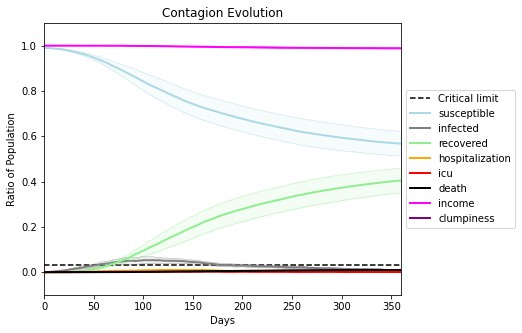

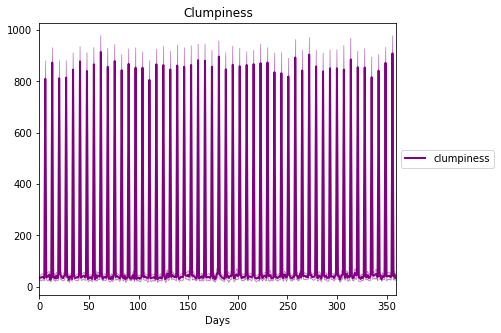

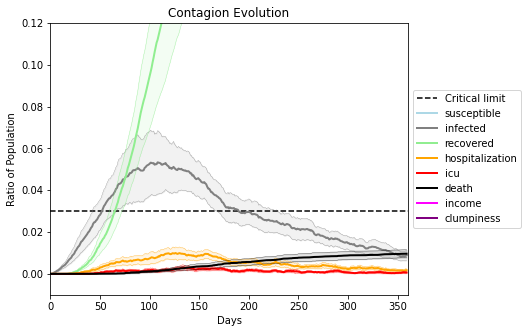

In [28]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)